In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Patch
import rebound
from rebound.plotting import fading_line
import astropy.units as u
from astropy import constants as c
import garnets as gar
import stellar_system
%matplotlib notebook

In [2]:
def randsyspars(massrange, agerange, numtimes):
    m = np.random.uniform(massrange[0], massrange[1], numtimes)
    s = np.random.uniform(agerange[0], agerange[1], numtimes)
    m = np.round(m, 3)
    s = np.round(s, 3)
    return m, s   

### Here, I will be creating functions to run a bunch of simulations of garnets systems
### with the stellar mass and stellar age drawn randomly from a range and generate the histogram. 
### Couldn't I just do it at all ranges and make a similar histogram?

def sys2hist(m, a):
    systems = []
    for i in np.arange(len(m)):
        star = stellar_system.Star(mass_ratio=m[i], age=a[i])
        systems.append(gar.generate_stellar_system(star))
        
    typ_planets = []
    radii_planets = []
    sma_planets = []
    per_planets = []
    mass_planets = []
    
    kep_plans = []
    kep_typs = []
    ages_star = []
    masses_star = []
    
    for i in np.arange(len(systems)):
        n_planets = len(systems[i].planets)
        for q in np.arange(n_planets):
            plan_rad = systems[i].planets[q].radius / (1*u.earthRad.to(u.km))
            plan_a = systems[i].planets[q].orbit.a
            plan_typ = systems[i].planets[q].type.value
            plan_per = systems[i].planets[q].orb_period
            plan_m   = systems[i].planets[q].mass
            
            typ_planets.append(plan_typ)
            radii_planets.append(plan_rad)
            sma_planets.append(plan_a)
            per_planets.append(plan_per)
            mass_planets.append(plan_m)
            
            
            ages_star.append(a[i])
            masses_star.append(m[i])
    
    return radii_planets, per_planets, ages_star, masses_star, typ_planets, mass_planets, sma_planets

In [3]:
keppops = np.genfromtxt('kepler_popstat.csv', delimiter=',', dtype=float)
exopops = np.genfromtxt('exopop_stats.csv', delimiter=',', dtype=float)

kP = np.zeros_like(keppops[:,0])
ka = np.zeros_like(keppops[:,0])
krad_e = np.zeros_like(keppops[:,0])
kmass_e = np.zeros_like(keppops[:,0])
ke = np.zeros_like(keppops[:,0])
kinsol = np.zeros_like(keppops[:,0])
ktemp = np.zeros_like(keppops[:,0])
kstar_rad = np.zeros_like(keppops[:,0])
kstar_mass = np.zeros_like(keppops[:,0])
kstar_age = np.zeros_like(keppops[:,0])

P = np.zeros_like(exopops[:,0])
a = np.zeros_like(exopops[:,0])
rad_e = np.zeros_like(exopops[:,0])
mass_e = np.zeros_like(exopops[:,0])
e = np.zeros_like(exopops[:,0])
insol = np.zeros_like(exopops[:,0])
temp = np.zeros_like(exopops[:,0])
star_rad = np.zeros_like(exopops[:,0])
star_mass = np.zeros_like(exopops[:,0])
star_age = np.zeros_like(exopops[:,0])

k_colnames = [kP, ka, krad_e, kmass_e, ke, kinsol, ktemp, kstar_rad, kstar_mass, kstar_age]
colnames = [P, a, rad_e, mass_e, e, insol, temp, star_rad, star_mass, star_age]

for i in np.arange(len(k_colnames)):
    for v in np.arange(len(keppops)):
        k_colnames[i][v] = keppops[v,i]

for i in np.arange(len(colnames)):
    for v in np.arange(len(exopops)):
        colnames[i][v] = exopops[v,i]

In [16]:
class garnets_knob:
    def __init__(self, name):
        self.name = name
        self.rad = []
        self.per = []
        self.mass = []
        self.sma = []
        self.solarmass = []
        self.typs = []
        self.typcolorkey=[]
        
    def makesystems(self, massrange, agerange, NUM):
        
        planettypesname = ['Unknown', 'Rock', 'Venusian', 'Terrestrial', 'SubSubGasGiant',
                       'SubGasGiant', 'Gas Giant', 'Martian', 'Water','Ice','Asteroids',
                       'One-Face']

        typcols = ['lightgrey', 'khaki', 'darkorange', 'olivedrab', 'purple', 'plum', 'violet',
          'firebrick', 'dodgerblue', 'steelblue', 'black', 'indigo' ]  
        
        typinds = np.arange(len(typcols))
        typdic = dict(zip(typinds, typcols))
        
        masses, ages = randsyspars(massrange, agerange, NUM)
        radtest, pertest, agetest, masstest, typtest, pmass, smatest = sys2hist(masses, ages)
        pmass_sols = pmass*u.M_sun
        pmass_earths = pmass_sols.to(u.M_earth)
        
        self.rad = radtest
        self.per = pertest
        self.mass = pmass_earths
        self.sma = smatest
        self.solarmass = massrange
        self.typs = typtest

        for i in np.arange(len(typtest)):
            self.typcolorkey.append(typdic[typtest[i]])
        
        
def garnets_plotter(aknob):
 
    
    fig, axes = plt.subplots(2,1, figsize=(9,6), sharex=True)
    ax1 = axes[0]
    ax2 = axes[1]
    
    ax1.scatter(aknob.per, aknob.rad, s=2, linewidth=0.5, facecolor=aknob.typcolorkey, marker='x')
    ax1.scatter(P, rad_e, label="Full Pop", s=2)
    ax1.scatter(kP, krad_e, label="Kepler", s=1, marker="x")
    ax1.set_ylabel('Radius')
    
    ax1.legend()
    
    ax2.scatter(aknob.per, aknob.mass, s=2, linewidth=0.5, facecolor=aknob.typcolorkey, marker='x')
    ax2.scatter(P, mass_e, label="Full Pop", s=2)
    ax2.scatter(kP, kmass_e, label="Kepler", s=1, marker="x")
    ax2.set_ylabel('Mass')
    ax2.set_xlabel('Period (days)')
    
    
    ax1.set_yscale('log')
    ax1.set_xscale('log')
    ax2.set_yscale('log')
    ax2.set_xscale('log')
    
    planettypesname = ['Unknown', 'Rock', 'Venusian', 'Terrestrial', 'SubSubGasGiant',
                       'SubGasGiant', 'Gas Giant', 'Martian', 'Water','Ice','Asteroids',
                       'One-Face']

    typcols = ['lightgrey', 'khaki', 'darkorange', 'olivedrab', 'purple', 'plum', 'violet',
          'firebrick', 'dodgerblue', 'steelblue', 'black', 'indigo' ]  
        
    legend_elements = []
    for i in np.arange(len(typcols)):
        legend_elements.append(Patch(facecolor=typcols[i], label=planettypesname[i]))
    fig.legend(handles=legend_elements, loc='center right', framealpha=1)
    
    fig.suptitle(('garnets comparison to observations', aknob.name, "solar mass range"))

In [5]:
run1 = garnets_knob('Low M Dwarf')
run2 = garnets_knob('High M Dwarf')
run3 = garnets_knob('K Star')
run4 = garnets_knob('G Star')
run5 = garnets_knob('F Star')
run6 = garnets_knob('A Star')

mr = ([0.25,0.5], [0.5,0.75], [0.75,1.0], [1.0,1.5], [1.5,3.0],[3.0,15])
ar = [0.8, 1.2]

run1.makesystems(mr[0], ar, 200)
run2.makesystems(mr[1], ar, 200)
run3.makesystems(mr[2], ar, 200)
run4.makesystems(mr[3], ar, 200)
run5.makesystems(mr[4], ar, 200)
run6.makesystems(mr[5], ar, 200)



INFO:root:Injecting planetesimal at 23.3888750523273 AU ...
INFO:root:New Protoplanet at 23.3888750523273AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.557206119576513 AU ...
INFO:root:Moon captured at 23.3888750523273 AU. Planet Mass: 0.7599268994890284 earth masses Moon Mass: 0.003618687654231293 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.5235867423765908 AU ...
INFO:root:New Protoplanet at 2.5235867423765908AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.657024549994093 AU ...
INFO:root:New Protoplanet at 1.657024549994093AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6832573117065119 AU ...
INFO:root:New Protoplanet at 0.6832573117065119AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4703777776936968 AU ...
INFO:root:New Protoplanet at 0.4703777776936968AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.34104365875858783 AU ...
INFO:root:New Protoplanet at 0.34104365875858783AU.
INFO:

10446413.358862828
55.85148763793848
1.7459122234544229
0.287282250160895
0.06517116780677698
0.015909753983913956
0.003954094337920042
0.0009871034845568278
0.0002466951690965677
6.167073708936509e-05
Accretion halted at  2.2836013462073978e-06
OUTER
189366.02445912256
19.860566347098256
1.137133475311858
0.20908841225518798
0.048611394561507766
0.011937428422606589
0.0029710994682037046
0.0007419511569669032
0.00018543681133987357
4.6356131563951676e-05
Accretion halted at  1.0874256463698162e-08
Out of order 	Mass: 0.7599268994890284 M_earth = attrib() Orbit: 23.3888750523273 AU, Moons: 0
 Planetesimal(orbit=a = 25.557206119576513 e = 0.09853135588961981, dust_mass=1.0874256463698162e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e70bd990>)
Capturing a protomoon.
46239335.47978346
81.46182572227063
2.013471664584412
0.3175729719121274
0.07138959366120814
0.01739117916919604
0.004320395253342986
0.001078522379603457
0.00026956397120428405
6.73947778956231e-05
Accr

INFO:root:New Protoplanet at 0.13000349157937452AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.390486878002567 AU ...
INFO:root:New Protoplanet at 3.390486878002567AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8881033358500643 AU ...
INFO:root:New Protoplanet at 0.8881033358500643AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3453976436527373 AU ...
INFO:root:New Protoplanet at 0.3453976436527373AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16839050164510955 AU ...
INFO:root:New Protoplanet at 0.16839050164510955AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05215582639077393 AU ...
INFO:root:New Protoplanet at 0.05215582639077393AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04828136360331388 AU ...
INFO:root:Did not capture potential moon at 0.05215582639077393 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root

	Mass: 0.7599268994890284 M_earth = attrib() Orbit: 23.3888750523273 AU, Moons: 1
 Planetesimal(orbit=a = 0.13000349157937452 e = 0.041514146143011854, dust_mass=4.2211282791407075e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e70bd990>)
Out of order 	Mass: 5.523062994909957 M_earth = attrib() Orbit: 2.5235867423765908 AU, Moons: 0
 Planetesimal(orbit=a = 0.13000349157937452 e = 0.041514146143011854, dust_mass=4.2211282791407075e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e70bd990>)
Out of order 	Mass: 45.02527287000396 M_moon = attrib() Orbit: 1.657024549994093 AU, Moons: 0
 Planetesimal(orbit=a = 0.13000349157937452 e = 0.041514146143011854, dust_mass=4.2211282791407075e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e70bd990>)
Out of order 	Mass: 0.8795336734928287 M_earth = attrib() Orbit: 0.6832573117065119 AU, Moons: 0
 Planetesimal(orbit=a = 0.13000349157937452 e = 0.041514146143011854, dust_mass=4.2211282791407075e-

INFO:root:	success.
INFO:root:Injecting planetesimal at 12.731973724243483 AU ...
INFO:root:New Protoplanet at 12.731973724243483AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.867148615684467 AU ...
INFO:root:	failed due to large neighbor.
INFO:root:Injecting planetesimal at 1.6604783101790066 AU ...
INFO:root:New Protoplanet at 1.6604783101790066AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1820241095515447 AU ...
INFO:root:New Protoplanet at 1.1820241095515447AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.126066071684962 AU ...
INFO:root:Moon captured at 1.1820241095515447 AU. Planet Mass: 0.5166645757429074 earth masses Moon Mass: 0.06814897607350526 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.28552174880544723 AU ...
INFO:root:New Protoplanet at 0.28552174880544723AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.26791490671903234 AU ...
INFO:root:Moon captured at 0.28552174880544723 AU. Planet M

25143870.116724532
69.81219865824659
1.9008819998051543
0.3050837550091424
1.118020472389098
0.4706659743421451
0.2337586816563083
0.12469636782887086
0.06890874631838947
0.03879831606170387
0.02207049614823219
0.01262739279308179
0.007248290576563952
0.004168396687828681
0.0023997608462566255
0.0013824023131528945
0.0007966268493932206
0.00045916008411202547
0.0002646820096073745
0.00015258582039136406
8.796722878796255e-05
Accretion halted at  3.405409675521282e-05
OUTER
Out of order 	Mass: 0.8858821894625084 M_earth = attrib() Orbit: 21.042925160486188 AU, Moons: 0
 Planetesimal(orbit=a = 12.731973724243483 e = 0.037490513797994285, dust_mass=1.0802492334153207e-05, gas_mass=2.3251604421059614e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e723be10>)
-1777732.1551820328
Accretion halted at  -1.7777311551820332e-09
OUTER
17685925.433054745
63.84955257766748
1.8377798109546835
0.29792115427875565
0.06736694944888355
0.016433402989622398
0.004083568534181191
0.0010194069529273343

INFO:root:New Protoplanet at 0.024107422107253945AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.87982337092941 AU ...
INFO:root:New Protoplanet at 4.87982337092941AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.5469888655487036 AU ...
INFO:root:New Protoplanet at 2.5469888655487036AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.5300529833174297 AU ...
INFO:root:Moon captured at 2.5469888655487036 AU. Planet Mass: 1.7327044148562 earth masses Moon Mass: 0.03205228903822073 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7059577633550544 AU ...
INFO:root:New Protoplanet at 0.7059577633550544AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1385975599273993 AU ...
INFO:root:New Protoplanet at 0.1385975599273993AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11101291643947145 AU ...
INFO:root:Moon captured at 0.1385975599273993 AU. Planet Mass: 0.004910160001434359 earth masses Moon Mass: 0.0018185


0.7195588599490295
0.14512860023188665
0.034459674044346945
0.008505779401430073
0.002119695657335695
0.0005295032055304561
0.0001323495245047496
3.3085739099716704e-05
Accretion halted at  1.0525082981194681e-10
OUTER
Out of order 	Mass: 7.338105739284049 M_earth = attrib() Orbit: 17.024908912173743 AU, Moons: 0
 Planetesimal(orbit=a = 0.024107422107253945 e = 0.18081678413068425, dust_mass=1.0525082981194681e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e70bee50>)
Out of order 	Mass: 13.446150795855035 M_earth = attrib() Orbit: 10.369831340315335 AU, Moons: 0
 Planetesimal(orbit=a = 0.024107422107253945 e = 0.18081678413068425, dust_mass=1.0525082981194681e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e70bee50>)
Out of order 	Mass: 16.835960186726496 M_earth = attrib() Orbit: 5.3108072610912895 AU, Moons: 0
 Planetesimal(orbit=a = 0.024107422107253945 e = 0.18081678413068425, dust_mass=1.0525082981194681e-10, gas_mass=0.0, disk=<accrete.Circ

INFO:root:Injecting planetesimal at 11.224422475712915 AU ...
INFO:root:New Protoplanet at 11.224422475712915AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.453939649886302 AU ...
INFO:root:New Protoplanet at 6.453939649886302AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3404025276647558 AU ...
INFO:root:New Protoplanet at 1.3404025276647558AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.213395482172919 AU ...
INFO:root:Moon captured at 1.3404025276647558 AU. Planet Mass: 1.1806503631226952 earth masses Moon Mass: 0.03716249265277754 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.31345668982376146 AU ...
INFO:root:New Protoplanet at 0.31345668982376146AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16898913187946182 AU ...
INFO:root:New Protoplanet at 0.16898913187946182AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13615727251895954 AU ...
INFO:root:New Protoplanet at 0.13615727251895954A


Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                   4.87982
Surface Temp C    -227.829
Effective Temp C  -229.54
Greenhouse Temp      1.71104
Water Cover          0
water_raw            0.00305787
Cloud Cover          8.67609e-11
clouds_raw           8.67609e-11
Ice Cover            0.00458681
Albedo               0.152523
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   4.87982
Surface Temp C    -227.829
Effective Temp C  -229.54
Greenhouse Temp      1.71104
Water Cover          0
water_raw            0.00305787
Cloud Cover          9.1362e-11
clouds_raw           1.00564e-10
Ice Cover            0.00458681
Albedo               0.152523
----------------  --------------
---------------  --------
Initial temp     72.2615
Solar Ecosphere   0.13495
AU                2.54699
Albedo            0
---------------  --------


INFO:root:New Protoplanet at 0.2763614583334178AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09487805513172282 AU ...
INFO:root:New Protoplanet at 0.09487805513172282AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08461742753257255 AU ...
INFO:root:New Protoplanet at 0.08461742753257255AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03237358551203131 AU ...
INFO:root:New Protoplanet at 0.03237358551203131AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.025054868564388922 AU ...
INFO:root:New Protoplanet at 0.025054868564388922AU.
INFO:root:	success.



32.68021276697679
1.4090386683216913
0.24583645949991986
0.05648977562866759
0.013832795937953706
0.003440410394810705
0.0008589968491838653
0.00021468049510485658
5.366590963472162e-05
Accretion halted at  1.399560190895523e-07
OUTER
Out of order 	Mass: 24.731922577867508 M_moon = attrib() Orbit: 36.75049828052342 AU, Moons: 0
 Planetesimal(orbit=a = 0.2763614583334178 e = 0.06815193070723691, dust_mass=1.399560190895523e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e721dcd0>)
Out of order 	Mass: 1.4242371981459414 M_earth = attrib() Orbit: 16.214570124576774 AU, Moons: 0
 Planetesimal(orbit=a = 0.2763614583334178 e = 0.06815193070723691, dust_mass=1.399560190895523e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e721dcd0>)
Out of order 	Mass: 1.043337475595828 M_earth = attrib() Orbit: 1.285303955731312 AU, Moons: 0
 Planetesimal(orbit=a = 0.2763614583334178 e = 0.06815193070723691, dust_mass=1.399560190895523e-07, gas_mass=0.0, disk=<accrete.

INFO:root:Injecting planetesimal at 10.631512443477316 AU ...
INFO:root:New Protoplanet at 10.631512443477316AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.448938443869868 AU ...
INFO:root:New Protoplanet at 4.448938443869868AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7835836784391532 AU ...
INFO:root:New Protoplanet at 1.7835836784391532AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4700592025616174 AU ...
INFO:root:New Protoplanet at 0.4700592025616174AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12836575106734605 AU ...
INFO:root:New Protoplanet at 0.12836575106734605AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04001812836020372 AU ...
INFO:root:New Protoplanet at 0.04001812836020372AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.80554738437479 AU ...
INFO:root:New Protoplanet at 22.80554738437479AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.185177285191626 AU ...
INFO:ro


---------------  -----------
Initial temp     442.554
Solar Ecosphere    0.16816
AU                 0.0846174
Albedo             0
---------------  -----------
Gas lifetimes:
---  ----------
H2   0.314188
H2O  0.0119765
N    0.0173348
N2   0.00628514
---  ----------
calculate_surface_temp readout
----------------  -----------
AU                  0.0846174
Surface Temp C    105.221
Effective Temp C  105.221
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  0.0846174
Surface Temp C    105.221
Effective Temp C  105.221
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
---------------  -----------
Initial temp     715.486
Solar Ecosphere   

INFO:root:New Protoplanet at 4.503381685516475AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.02320789025214 AU ...
INFO:root:New Protoplanet at 2.02320789025214AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.6577631507839587 AU ...
INFO:root:New Protoplanet at 1.6577631507839587AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4580742976262093 AU ...
INFO:root:New Protoplanet at 0.4580742976262093AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.25102642849189766 AU ...
INFO:root:New Protoplanet at 0.25102642849189766AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08142106747275235 AU ...
INFO:root:New Protoplanet at 0.08142106747275235AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.833601236255218 AU ...
INFO:root:New Protoplanet at 13.833601236255218AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7043597619751478 AU ...
INFO:root:New Protoplanet at 0.7043597619751478AU.
INFO:root:	success.

16197251.870036094
62.43959093041307
1.8222285004146808
0.2961399413840095
0.06700078648128355
0.01634628202262357
0.004062068315523456
0.0010140523038007984
0.0002534363864676186
6.335799271781386e-05
Accretion halted at  4.0981754536105335e-06
OUTER
Out of order 	Mass: 1.0566815115737922 M_earth = attrib() Orbit: 22.80554738437479 AU, Moons: 0
 Planetesimal(orbit=a = 2.02320789025214 e = 0.0006178152236472334, dust_mass=4.0981754536105335e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e723b2d0>)
Out of order 	Mass: 0.9422178778632633 M_earth = attrib() Orbit: 15.185177285191626 AU, Moons: 0
 Planetesimal(orbit=a = 2.02320789025214 e = 0.0006178152236472334, dust_mass=4.0981754536105335e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e723b2d0>)
Out of order 	Mass: 3.3227182926630867 M_earth = attrib() Orbit: 9.698100920397888 AU, Moons: 2
 Planetesimal(orbit=a = 2.02320789025214 e = 0.0006178152236472334, dust_mass=4.0981754536105335e-06, gas_mas

INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4294502266783997 AU ...
INFO:root:New Protoplanet at 1.4294502266783997AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.277015843641129 AU ...
INFO:root:New Protoplanet at 0.277015843641129AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.18261529066698087 AU ...
INFO:root:New Protoplanet at 0.18261529066698087AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.048825148814647126 AU ...
INFO:root:New Protoplanet at 0.048825148814647126AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.919712110760106 AU ...
INFO:root:New Protoplanet at 15.919712110760106AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.596133632778979 AU ...
INFO:root:New Protoplanet at 6.596133632778979AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5096995094079269 AU ...
INFO:root:New Protoplanet at 1.5096995094079269AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.241027575

13787570.470466385
59.93572305812396
1.7939553929386678
0.2928780399200601
0.06632751957984787
0.01618554735606112
0.004022272568269235
0.0010041093897561056
0.0002509465177395539
6.273413742150863e-05
Accretion halted at  3.306098788902654e-06
OUTER
Out of order 	Mass: 2.9148024948576596 M_earth = attrib() Orbit: 5.353053369991502 AU, Moons: 0
 Planetesimal(orbit=a = 1.4294502266783997 e = 0.03063697975610491, dust_mass=3.306098788902654e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7230690>)
1072510.2582101435
31.18106902407353
1.3817719520851481
0.24229612246375104
0.055738399633227895
0.013652485788493145
0.0033957913174625033
0.0008478704306521191
0.00021190062950527115
5.297104436357477e-05
Accretion halted at  1.0978130959075439e-07
OUTER
Out of order 	Mass: 2.9148024948576596 M_earth = attrib() Orbit: 5.353053369991502 AU, Moons: 0
 Planetesimal(orbit=a = 0.277015843641129 e = 0.029752343535613623, dust_mass=1.0978130959075439e-07, gas_mass=0.0, disk=<accr

INFO:root:Injecting planetesimal at 0.3366305603128669 AU ...
INFO:root:New Protoplanet at 0.3366305603128669AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23689890601741387 AU ...
INFO:root:New Protoplanet at 0.23689890601741387AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02294744904552956 AU ...
INFO:root:New Protoplanet at 0.02294744904552956AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.083905356461009 AU ...
INFO:root:New Protoplanet at 4.083905356461009AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3016412823618406 AU ...
INFO:root:New Protoplanet at 0.3016412823618406AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1355528825468459 AU ...
INFO:root:New Protoplanet at 0.1355528825468459AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06007663003431022 AU ...
INFO:root:New Protoplanet at 0.06007663003431022AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0193605684696469 AU ...
INF

2069982.60167586
36.930776132988036
1.4816929280825624
0.2551255760560408
0.05845370367340363
0.014303647991686989
0.0035569021627888304
0.0008880450323449393
0.00022193814402608135
5.548011417054879e-05
Accretion halted at  2.6380418756227404e-07
OUTER
Out of order 	Mass: 0.6181883224162913 M_earth = attrib() Orbit: 29.243896757171242 AU, Moons: 0
 Planetesimal(orbit=a = 0.3366305603128669 e = 0.08338648183387398, dust_mass=2.6380418756227404e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72144d0>)
Out of order 	Mass: 12.632778750021796 M_earth = attrib() Orbit: 14.495267903340785 AU, Moons: 0
 Planetesimal(orbit=a = 0.3366305603128669 e = 0.08338648183387398, dust_mass=2.6380418756227404e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72144d0>)
Out of order 	Mass: 4.675630194309557 M_earth = attrib() Orbit: 4.45810224303615 AU, Moons: 0
 Planetesimal(orbit=a = 0.3366305603128669 e = 0.08338648183387398, dust_mass=2.6380418756227404e-07, gas_ma

INFO:root:Injecting planetesimal at 14.685540608240068 AU ...
INFO:root:New Protoplanet at 14.685540608240068AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.068729752090348 AU ...
INFO:root:New Protoplanet at 10.068729752090348AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.476639351777018 AU ...
INFO:root:New Protoplanet at 7.476639351777018AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.678195818633437 AU ...
INFO:root:New Protoplanet at 2.678195818633437AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5794108847968396 AU ...
INFO:root:New Protoplanet at 0.5794108847968396AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5104593469233165 AU ...
INFO:root:New Protoplanet at 0.5104593469233165AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4699319714143647 AU ...
INFO:root:Moon captured at 0.5104593469233165 AU. Planet Mass: 0.027845613605147545 earth masses Moon Mass: 0.002795410569102214 earth masses.
I


calculate_surface_temp readout
----------------  -----------
AU                  0.0600766
Surface Temp C    125.627
Effective Temp C  125.627
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  0.0600766
Surface Temp C    125.627
Effective Temp C  125.627
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
---------------  -----------
Initial temp     821.622
Solar Ecosphere    0.132615
AU                 0.0193606
Albedo             0
---------------  -----------
Gas lifetimes:
---  --------
H2   62.4069
H2O   2.31332
N     3.37179
N2    1.19299
---  --------
calculate_surface_temp readout
----------------  -----------
AU                 

INFO:root:Moon captured at 30.19536392013192 AU. Planet Mass: 0.5623309136605733 earth masses Moon Mass: 0.026828570295381896 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.786894262166236 AU ...
INFO:root:New Protoplanet at 12.786894262166236AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.46789009812065 AU ...
INFO:root:Moon captured at 12.786894262166236 AU. Planet Mass: 13.016057469926102 earth masses Moon Mass: 0.6922770367360129 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.5780404573229907 AU ...
INFO:root:New Protoplanet at 2.5780404573229907AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.21737531937737212 AU ...
INFO:root:New Protoplanet at 0.21737531937737212AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05555438507605354 AU ...
INFO:root:New Protoplanet at 0.05555438507605354AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.676223779641573 AU ...
INFO:root:New Protopla


Accretion halted at  8.062059559221912e-08
Out of order 	Mass: 45.74173608945072 M_moon = attrib() Orbit: 30.19536392013192 AU, Moons: 0
 Planetesimal(orbit=a = 29.197515856239196 e = 0.14819762272553116, dust_mass=8.062059559221912e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72bffd0>)
Capturing a protomoon.
27209815.31809842
71.22398459752574
1.9152336722102163
0.3066948800651507
1.1406776167221215
0.48171218172708297
0.24020088726538957
0.12870155564020416
0.0714593973930073
0.04043435220868879
0.023119281870385675
0.013296965044008019
0.007673395528302597
0.004436692335353862
0.00256810895758163
0.0014874636353953523
0.0008618676652592971
0.0004994916570495345
0.00028951429631977486
0.00016781978313505077
9.728244482651793e-05
Accretion halted at  3.911361261276847e-05
OUTER
Out of order 	Mass: 45.74173608945072 M_moon = attrib() Orbit: 30.19536392013192 AU, Moons: 1
 Planetesimal(orbit=a = 12.786894262166236 e = 0.06469770650766216, dust_mass=1.210201754495

INFO:root:New Protoplanet at 8.705081957871924AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13652063696661623 AU ...
INFO:root:New Protoplanet at 0.13652063696661623AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03443609835268803 AU ...
INFO:root:New Protoplanet at 0.03443609835268803AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.148735098451528 AU ...
INFO:root:New Protoplanet at 18.148735098451528AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.872747261290867 AU ...
INFO:root:New Protoplanet at 6.872747261290867AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.136868537426808 AU ...
INFO:root:New Protoplanet at 4.136868537426808AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.0205307882973376 AU ...
INFO:root:New Protoplanet at 3.0205307882973376AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7374715045919797 AU ...
INFO:root:New Protoplanet at 1.7374715045919797AU.
INFO:root:	success.


1.8890152540013818
0.30374829031739964
0.06856602431312177
0.016719611436766712
0.004154466518954352
0.0010371329964491964
0.0002592151675365524
6.480567306967962e-05
Accretion halted at  6.749450236171303e-06
OUTER
Out of order 	Mass: 20.038524358407834 M_moon = attrib() Orbit: 32.58103177559736 AU, Moons: 0
 Planetesimal(orbit=a = 8.705081957871924 e = 0.00310723754022435, dust_mass=6.749450236171303e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e721d3d0>)
Out of order 	Mass: 43.692411215926654 M_moon = attrib() Orbit: 22.234025215709348 AU, Moons: 1
 Planetesimal(orbit=a = 8.705081957871924 e = 0.00310723754022435, dust_mass=6.749450236171303e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e721d3d0>)
Out of order 	Mass: 0.6234538992304148 M_earth = attrib() Orbit: 16.64300304353819 AU, Moons: 0
 Planetesimal(orbit=a = 8.705081957871924 e = 0.00310723754022435, dust_mass=6.749450236171303e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk obje

INFO:root:Injecting planetesimal at 31.438242071651185 AU ...
INFO:root:New Protoplanet at 31.438242071651185AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.789059171099183 AU ...
INFO:root:New Protoplanet at 23.789059171099183AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5057798063791774 AU ...
INFO:root:New Protoplanet at 1.5057798063791774AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8568544215911424 AU ...
INFO:root:New Protoplanet at 0.8568544215911424AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4934304196726398 AU ...
INFO:root:New Protoplanet at 0.4934304196726398AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4640536117764512 AU ...
INFO:root:Moon captured at 0.4934304196726398 AU. Planet Mass: 0.12425489401102209 earth masses Moon Mass: 0.007098159859525995 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.010412149711790365 AU ...
INFO:root:New Protoplanet at 0.0104121497117903


Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                   3.02053
Surface Temp C    -204.441
Effective Temp C  -213.643
Greenhouse Temp      9.20224
Water Cover          0
water_raw            0.465559
Cloud Cover          1.30953e-07
clouds_raw           1.30953e-07
Ice Cover            0.698339
Albedo               0.534086
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   3.02053
Surface Temp C    -204.441
Effective Temp C  -213.643
Greenhouse Temp      9.20224
Water Cover          0
water_raw            0.465559
Cloud Cover          1.13416e-07
clouds_raw           7.83404e-08
Ice Cover            0.698339
Albedo               0.534086
----------------  --------------
---------------  ----------
Initial temp     109.079
Solar Ecosphere    0.209764
AU                 1.73747
Albedo             0
---------------  --------

INFO:root:New Protoplanet at 4.411442847665155AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7514556414618738 AU ...
INFO:root:New Protoplanet at 0.7514556414618738AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6302392349189221 AU ...
INFO:root:New Protoplanet at 0.6302392349189221AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.009931242042956912 AU ...
INFO:root:New Protoplanet at 0.009931242042956912AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.522147693973066 AU ...
INFO:root:New Protoplanet at 12.522147693973066AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.667280918416514 AU ...
INFO:root:New Protoplanet at 3.667280918416514AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4522176913953448 AU ...
INFO:root:New Protoplanet at 1.4522176913953448AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8741028774625184 AU ...
INFO:root:New Protoplanet at 0.8741028774625184AU.
INFO:root:	succes

6552070.870683972
49.593494253554724
1.6670076520223327
0.2779300244855378
0.06322998710370968
0.015446237076103153
0.0038394694944117362
0.000958508140413183
0.0002395458843492901
5.988232599556172e-05
Accretion halted at  1.226024600380609e-06
OUTER
Out of order 	Mass: 16.055094403765366 M_earth = attrib() Orbit: 17.146956276836125 AU, Moons: 0
 Planetesimal(orbit=a = 0.7514556414618738 e = 0.025783082056003326, dust_mass=1.226024600380609e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72bebd0>)
Out of order 	Mass: 0.9261375987426715 M_earth = attrib() Orbit: 12.504000211258552 AU, Moons: 0
 Planetesimal(orbit=a = 0.7514556414618738 e = 0.025783082056003326, dust_mass=1.226024600380609e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72bebd0>)
Out of order 	Mass: 15.548221403136676 M_earth = attrib() Orbit: 5.627629929123558 AU, Moons: 0
 Planetesimal(orbit=a = 0.7514556414618738 e = 0.025783082056003326, dust_mass=1.226024600380609e-06, gas_ma

INFO:root:Moon captured at 0.8741028774625184 AU. Planet Mass: 0.7057726836659007 earth masses Moon Mass: 0.033492793674247456 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5572054306436398 AU ...
INFO:root:New Protoplanet at 0.5572054306436398AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.45096792443129347 AU ...
INFO:root:New Protoplanet at 0.45096792443129347AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3714292980122341 AU ...
INFO:root:New Protoplanet at 0.3714292980122341AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.060945840542068336 AU ...
INFO:root:New Protoplanet at 0.060945840542068336AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03821488945030897 AU ...
INFO:root:New Protoplanet at 0.03821488945030897AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 28.64407189585032 AU ...
INFO:root:New Protoplanet at 28.64407189585032AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at

Out of order 	Mass: 1.9836728713202207 M_earth = attrib() Orbit: 12.522147693973066 AU, Moons: 0
 Planetesimal(orbit=a = 0.8301355573789895 e = 0.15988650764118206, dust_mass=1.0064677112257212e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7296890>)
Out of order 	Mass: 4.847198385423351 M_earth = attrib() Orbit: 3.667280918416514 AU, Moons: 0
 Planetesimal(orbit=a = 0.8301355573789895 e = 0.15988650764118206, dust_mass=1.0064677112257212e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7296890>)
Out of order 	Mass: 1.1500030173577667 M_earth = attrib() Orbit: 1.4522176913953448 AU, Moons: 0
 Planetesimal(orbit=a = 0.8301355573789895 e = 0.15988650764118206, dust_mass=1.0064677112257212e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7296890>)
Out of order 	Mass: 0.7057726836659007 M_earth = attrib() Orbit: 0.8741028774625184 AU, Moons: 0
 Planetesimal(orbit=a = 0.8301355573789895 e = 0.15988650764118206, dust_mass=1.006467711

INFO:root:New Protoplanet at 3.733406085904278AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.6410955572654473 AU ...
INFO:root:New Protoplanet at 1.6410955572654473AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7585234679347075 AU ...
INFO:root:New Protoplanet at 0.7585234679347075AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5169186348678458 AU ...
INFO:root:New Protoplanet at 0.5169186348678458AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13448029661632385 AU ...
INFO:root:New Protoplanet at 0.13448029661632385AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04147412713396443 AU ...
INFO:root:New Protoplanet at 0.04147412713396443AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.033805732486272784 AU ...
INFO:root:New Protoplanet at 0.033805732486272784AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03159416140209016 AU ...
INFO:root:New Protoplanet at 0.03159416140209016AU.
INFO:root

37159972.16366421
77.07623750338998
1.9725688447466152
0.31306849554588745
0.07046857280228393
0.01717129118064731
0.004265824107466316
0.001064847502655452
0.0002661289929032084
6.653145127794736e-05
Accretion halted at  1.2400435513042814e-05
OUTER
Out of order 	Mass: 1.021555286696659 M_earth = attrib() Orbit: 28.64407189585032 AU, Moons: 0
 Planetesimal(orbit=a = 1.6410955572654473 e = 0.32726721485175136, dust_mass=1.2400435513042814e-05, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72bff50>)
Out of order 	Mass: 24.524017055892724 M_earth = attrib() Orbit: 8.146759083201221 AU, Moons: 0
 Planetesimal(orbit=a = 1.6410955572654473 e = 0.32726721485175136, dust_mass=1.2400435513042814e-05, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72bff50>)
Out of order 	Mass: 4.314776538076381 M_earth = attrib() Orbit: 3.733406085904278 AU, Moons: 0
 Planetesimal(orbit=a = 1.6410955572654473 e = 0.32726721485175136, dust_mass=1.2400435513042814e-05, gas_mass=0.

INFO:root:Injecting planetesimal at 0.9126852016174406 AU ...
INFO:root:New Protoplanet at 0.9126852016174406AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.25395975927228526 AU ...
INFO:root:New Protoplanet at 0.25395975927228526AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19257257476842002 AU ...
INFO:root:New Protoplanet at 0.19257257476842002AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.021624989377428943 AU ...
INFO:root:New Protoplanet at 0.021624989377428943AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.012540931617939266 AU ...
INFO:root:New Protoplanet at 0.012540931617939266AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.006911046921948231 AU ...
INFO:root:New Protoplanet at 0.006911046921948231AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.949692999620933 AU ...
INFO:root:New Protoplanet at 0.949692999620933AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1502465749372759 


calculate_surface_temp readout
----------------  --------------
AU                  14.0557
Surface Temp C    -245.525
Effective Temp C  -246.269
Greenhouse Temp      0.743494
Water Cover          0
water_raw            0.00243962
Cloud Cover          2.19876e-11
clouds_raw           2.33301e-11
Ice Cover            0.00365944
Albedo               0.152013
----------------  --------------
---------------  ---------
Initial temp     59.9601
Solar Ecosphere   0.147646
AU                4.04731
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                   4.04731
Surface Temp C    -221.104
Effective Temp C  -223.061
Greenhouse Temp      1.95671
Water Cover          0
water_raw            0.00286394
Cloud Cover          1.27104e-10
clouds_raw           1.27104e-10
Ice Cover            0.00429591
Albedo               0.152363
----------------  ---------

INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0080222630754292 AU ...
INFO:root:New Protoplanet at 1.0080222630754292AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.20156911507254638 AU ...
INFO:root:New Protoplanet at 0.20156911507254638AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13240716106002692 AU ...
INFO:root:New Protoplanet at 0.13240716106002692AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10580010136117429 AU ...
INFO:root:New Protoplanet at 0.10580010136117429AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.024400243719611487 AU ...
INFO:root:New Protoplanet at 0.024400243719611487AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.59502253848333 AU ...
INFO:root:New Protoplanet at 22.59502253848333AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.23468860530865 AU ...
INFO:root:New Protoplanet at 18.23468860530865AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.0581

7728748.617513066
51.726303287412804
1.694682183353524
0.28123304592536164
0.06391660980896338
0.015610212415982748
0.003880011321996363
0.0009686191442254542
0.0002420730093619221
6.051429312869392e-05
Accretion halted at  1.528060537198234e-06
OUTER
Out of order 	Mass: 43.64385793888392 M_moon = attrib() Orbit: 25.137894351239517 AU, Moons: 0
 Planetesimal(orbit=a = 1.0080222630754292 e = 0.028720310556216933, dust_mass=1.528060537198234e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72bfad0>)
Out of order 	Mass: 1.6596279215472478 M_earth = attrib() Orbit: 11.92188329641317 AU, Moons: 0
 Planetesimal(orbit=a = 1.0080222630754292 e = 0.028720310556216933, dust_mass=1.528060537198234e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72bfad0>)
Out of order 	Mass: 2.62951039353584 M_earth = attrib() Orbit: 3.3059901638534224 AU, Moons: 0
 Planetesimal(orbit=a = 1.0080222630754292 e = 0.028720310556216933, dust_mass=1.528060537198234e-06, gas_mass=0

INFO:root:Injecting planetesimal at 1.8689236801094107 AU ...
INFO:root:New Protoplanet at 1.8689236801094107AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7407089261424324 AU ...
INFO:root:New Protoplanet at 0.7407089261424324AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11803759761154412 AU ...
INFO:root:New Protoplanet at 0.11803759761154412AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.056300630131744425 AU ...
INFO:root:New Protoplanet at 0.056300630131744425AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.97701259248153 AU ...
INFO:root:New Protoplanet at 19.97701259248153AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.54864527023365 AU ...
INFO:root:New Protoplanet at 16.54864527023365AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.714209317444976 AU ...
INFO:root:Moon captured at 16.54864527023365 AU. Planet Mass: 0.449947676018616 earth masses Moon Mass: 0.0024391772812245123 earth masses

18301808.56606552
64.40689614348507
1.8438583934265833
0.29861642316898807
0.06751016349278764
0.01646758088085153
0.004092030870720939
0.001021521562372357
0.00025530263871463706
6.3824557291236e-05
Accretion halted at  4.823113658365826e-06
OUTER
Out of order 	Mass: 0.9962825715061233 M_earth = attrib() Orbit: 22.59502253848333 AU, Moons: 1
 Planetesimal(orbit=a = 1.8689236801094107 e = 0.03314516026182068, dust_mass=4.823113658365826e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72be550>)
Out of order 	Mass: 20.460214403399558 M_moon = attrib() Orbit: 18.23468860530865 AU, Moons: 0
 Planetesimal(orbit=a = 1.8689236801094107 e = 0.03314516026182068, dust_mass=4.823113658365826e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72be550>)
Out of order 	Mass: 2.4481311747888235 M_earth = attrib() Orbit: 10.306829673260973 AU, Moons: 0
 Planetesimal(orbit=a = 1.8689236801094107 e = 0.03314516026182068, dust_mass=4.823113658365826e-06, gas_mass=0.0, 

INFO:root:New Protoplanet at 0.05805891954153874AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.26856324417114 AU ...
INFO:root:New Protoplanet at 18.26856324417114AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.47402441346083 AU ...
INFO:root:Moon captured at 18.26856324417114 AU. Planet Mass: 1.283654677692594 earth masses Moon Mass: 0.03789473886532993 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.9931707172186286 AU ...
INFO:root:New Protoplanet at 2.9931707172186286AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8197889648922931 AU ...
INFO:root:New Protoplanet at 0.8197889648922931AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8618958019634354 AU ...
INFO:root:Moon captured at 0.8197889648922931 AU. Planet Mass: 0.3409077023444506 earth masses Moon Mass: 0.008375824923525496 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7526303582515319 AU ...
INFO:root:Moon captured at 

0.0025823125353378667
0.0006449539319200298
0.00016119950456137432
4.029744117224539e-05
Accretion halted at  1.3088732758103221e-09
OUTER
Out of order 	Mass: 1.227720375935644 M_earth = attrib() Orbit: 19.97701259248153 AU, Moons: 0
 Planetesimal(orbit=a = 0.05805891954153874 e = 0.01703406171455102, dust_mass=1.3088732758103221e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7264c10>)
Out of order 	Mass: 36.60013588178485 M_moon = attrib() Orbit: 16.54864527023365 AU, Moons: 1
 Planetesimal(orbit=a = 0.05805891954153874 e = 0.01703406171455102, dust_mass=1.3088732758103221e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7264c10>)
Out of order 	Mass: 3.417198415895738 M_earth = attrib() Orbit: 2.2401313913270617 AU, Moons: 0
 Planetesimal(orbit=a = 0.05805891954153874 e = 0.01703406171455102, dust_mass=1.3088732758103221e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7264c10>)
Out of order 	Mass: 28.032259748475433 M_moon = 

INFO:root:Injecting planetesimal at 0.04853537897518447 AU ...
INFO:root:Did not capture potential moon at 0.04552481617396362 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 4.2786750838993226e-06 earth masses at 0.04558661803228523 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.025293168924581805 AU ...
INFO:root:New Protoplanet at 0.025293168924581805AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 32.23658146941123 AU ...
INFO:root:New Protoplanet at 32.23658146941123AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.383972259027448 AU ...
INFO:root:New Protoplanet at 11.383972259027448AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.5475896017147948 AU ...
INFO:root:New Protoplanet at 3.5475896017147948AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7544687135079103 AU ...
INFO:root:New Protoplanet at 0.75446871

1206.4558904956018
4.894782949199539
0.5581775927261845
0.1172599697088512
0.028107576628620123
0.006954019709545957
0.0017339896332806825
0.00043321581355729757
0.00010828636333016504
2.7070491620854757e-05
Accretion halted at  1.2857536939600876e-11
Out of order 	Mass: 1.283654677692594 M_earth = attrib() Orbit: 18.26856324417114 AU, Moons: 1
 Planetesimal(orbit=a = 0.04853537897518447 e = 0.16849859796244515, dust_mass=1.2857536939600876e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7264d50>)
Out of order 	Mass: 1.7363168174486188 M_earth = attrib() Orbit: 2.9931707172186286 AU, Moons: 0
 Planetesimal(orbit=a = 0.04853537897518447 e = 0.16849859796244515, dust_mass=1.2857536939600876e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7264d50>)
Out of order 	Mass: 27.730487107655875 M_moon = attrib() Orbit: 0.8197889648922931 AU, Moons: 2
 Planetesimal(orbit=a = 0.04853537897518447 e = 0.16849859796244515, dust_mass=1.2857536939600876e-11, gas_m

INFO:root:Injecting planetesimal at 30.009591794484944 AU ...
INFO:root:New Protoplanet at 30.009591794484944AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.705550656053443 AU ...
INFO:root:New Protoplanet at 20.705550656053443AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.247653556454182 AU ...
INFO:root:New Protoplanet at 15.247653556454182AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.33180400748871 AU ...
INFO:root:New Protoplanet at 5.33180400748871AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.209070380479712 AU ...
INFO:root:New Protoplanet at 4.209070380479712AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.086434744864881 AU ...
INFO:root:Moon captured at 4.209070380479712 AU. Planet Mass: 0.8376853066468186 earth masses Moon Mass: 0.0432720507103509 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.3637020275178666 AU ...
INFO:root:New Protoplanet at 3.3637020275178666AU.
INFO:root


---------------  ----------
Initial temp     138.207
Solar Ecosphere    0.146228
AU                 0.754469
Albedo             0
---------------  ----------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                   0.754469
Surface Temp C    -164.187
Effective Temp C  -176.063
Greenhouse Temp     11.8763
Water Cover          0
water_raw            0.516565
Cloud Cover          3.98853e-06
clouds_raw           3.98853e-06
Ice Cover            0.774847
Albedo               0.576166
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   0.754469
Surface Temp C    -164.187
Effective Temp C  -176.063
Greenhouse Temp     11.8763
Water Cover          0
water_raw            0.516565
Cloud Cover          3.14015e-06
clouds_raw           1.4434e-06
Ice Cover            0.774847
Albedo               0.576166
----------------  ------------

INFO:root:New Protoplanet at 15.459997180355671AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.771243557104144 AU ...
INFO:root:New Protoplanet at 11.771243557104144AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5991220850961845 AU ...
INFO:root:New Protoplanet at 0.5991220850961845AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.20917097981232138 AU ...
INFO:root:New Protoplanet at 0.20917097981232138AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17618450771201066 AU ...
INFO:root:Moon captured at 0.20917097981232138 AU. Planet Mass: 0.03645807136740023 earth masses Moon Mass: 0.00041983839743034267 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12493041851976545 AU ...
INFO:root:New Protoplanet at 0.12493041851976545AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08104699638367871 AU ...
INFO:root:New Protoplanet at 0.08104699638367871AU.
INFO:root:	success.
INFO:root:Injecting planetesim


OUTER
11066503.495553313
56.676996042864445
1.7558249127687493
0.28844126975123363
0.0654104107716502
0.015966672716041113
0.003968125161244991
0.0009905929767717234
0.00024756493504440657
6.188764786552173e-05
Accretion halted at  2.46609637728344e-06
Out of order 	Mass: 9.02170579177239 M_earth = attrib() Orbit: 15.459997180355671 AU, Moons: 0
 Planetesimal(orbit=a = 11.771243557104144 e = 0.027802747927549443, dust_mass=2.46609637728344e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7289310>)
4354534.566716992
44.68098587647946
1.59976569703685
0.2697964592158341
0.061533668614215664
0.015040835265906941
0.003739226840561028
0.0009335094865080449
0.0002332984029859727
5.8320170182125476e-05
Accretion halted at  7.110754427428067e-07
OUTER
Out of order 	Mass: 9.02170579177239 M_earth = attrib() Orbit: 15.459997180355671 AU, Moons: 0
 Planetesimal(orbit=a = 0.5991220850961845 e = 0.034258704341781465, dust_mass=7.110754427428067e-07, gas_mass=0.0, disk=<accrete.C

INFO:root:Injecting planetesimal at 29.491794820509114 AU ...
INFO:root:New Protoplanet at 29.491794820509114AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.391679689539346 AU ...
INFO:root:New Protoplanet at 14.391679689539346AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.590523343141369 AU ...
INFO:root:New Protoplanet at 9.590523343141369AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7784968775904175 AU ...
INFO:root:New Protoplanet at 1.7784968775904175AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5735836200551658 AU ...
INFO:root:Moon captured at 1.7784968775904175 AU. Planet Mass: 1.7108102680895023 earth masses Moon Mass: 0.012454484037071164 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9231074470957563 AU ...
INFO:root:New Protoplanet at 0.9231074470957563AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.334373775401504 AU ...
INFO:root:New Protoplanet at 0.334373775401504AU.
INF


---------------  ----------
Initial temp     232.164
Solar Ecosphere    0.139635
AU                 0.255312
Albedo             0
---------------  ----------
Gas lifetimes:
---  ---------------
H2       0.000317657
H2O      6.14219e+06
N    10534.3
N2     inf
---  ---------------
calculate_surface_temp readout
----------------  ----------
AU                  0.255312
Surface Temp C    -74.6558
Effective Temp C  -74.6558
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  -----------
AU                   0.255312
Surface Temp C     -84.7395
Effective Temp C  -104.907
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0.333333
clouds_raw           0
Ice Cover            0
Albedo               0.22
----------------  -----------
calculate_surface_temp readout
-----------

INFO:root:Injecting planetesimal at 24.813389535313476 AU ...
INFO:root:New Protoplanet at 24.813389535313476AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.823761048203814 AU ...
INFO:root:New Protoplanet at 12.823761048203814AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.353008594326555 AU ...
INFO:root:New Protoplanet at 6.353008594326555AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.19415535515962 AU ...
INFO:root:New Protoplanet at 5.19415535515962AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.113892124226526 AU ...
INFO:root:Moon captured at 5.19415535515962 AU. Planet Mass: 0.6183265876414089 earth masses Moon Mass: 0.16048345498360966 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.3010255537562565 AU ...
INFO:root:New Protoplanet at 3.3010255537562565AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06780889081001881 AU ...
INFO:root:New Protoplanet at 0.06780889081001881AU.
INFO:ro

---------------  ---------
Initial temp     19.1753
Solar Ecosphere   0.110031
AU               29.4918
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  29.4918
Surface Temp C    -256.987
Effective Temp C  -257.127
Greenhouse Temp      0.140103
Water Cover          0
water_raw            0.00180878
Cloud Cover          7.37087e-12
clouds_raw           7.37087e-12
Ice Cover            0.00271317
Albedo               0.151492
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  29.4918
Surface Temp C    -256.987
Effective Temp C  -257.127
Greenhouse Temp      0.140103
Water Cover          0
water_raw            0.00180878
Cloud Cover          7.50455e-12
clouds_raw           7.77191e-12
Ice Cover            0.00271317
Albedo               0.151492
----------------  -----------

INFO:root:Injecting planetesimal at 0.7104052415314231 AU ...
INFO:root:New Protoplanet at 0.7104052415314231AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6755847364345965 AU ...
INFO:root:Moon captured at 0.7104052415314231 AU. Planet Mass: 0.35736493346120857 earth masses Moon Mass: 0.008612423896439653 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.21918513746752788 AU ...
INFO:root:New Protoplanet at 0.21918513746752788AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11538605507804384 AU ...
INFO:root:New Protoplanet at 0.11538605507804384AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08154066580343419 AU ...
INFO:root:New Protoplanet at 0.08154066580343419AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07506847301899476 AU ...
INFO:root:Did not capture potential moon at 0.08154066580343419 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating add


---------------  ---------
Initial temp     65.0158
Solar Ecosphere   0.222784
AU                5.19416
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                   5.19416
Surface Temp C    -218.611
Effective Temp C  -218.81
Greenhouse Temp      0.19902
Water Cover          0
water_raw            0.000803655
Cloud Cover          4.20257e-11
clouds_raw           4.20257e-11
Ice Cover            0.00120548
Albedo               0.150663
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   5.19416
Surface Temp C    -218.611
Effective Temp C  -218.81
Greenhouse Temp      0.19902
Water Cover          0
water_raw            0.000803655
Cloud Cover          4.47827e-11
clouds_raw           5.02967e-11
Ice Cover            0.00120548
Albedo               0.150663
----------------  ---------

INFO:root:New Protoplanet at 0.8496152660220359AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.383755856470454 AU ...
INFO:root:New Protoplanet at 0.383755856470454AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13427265808075137 AU ...
INFO:root:New Protoplanet at 0.13427265808075137AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03317283745662989 AU ...
INFO:root:New Protoplanet at 0.03317283745662989AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03255651513979483 AU ...
INFO:root:New Protoplanet at 0.03255651513979483AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.011786715284015288 AU ...
INFO:root:New Protoplanet at 0.011786715284015288AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.16817359641707 AU ...
INFO:root:New Protoplanet at 18.16817359641707AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3061263329463472 AU ...
INFO:root:New Protoplanet at 0.3061263329463472AU.
INFO:root:	s


5.575448513512212e-05
Accretion halted at  2.9025533076600186e-07
OUTER
Out of order 	Mass: 4.452563741854239 M_earth = attrib() Orbit: 3.1865698324689746 AU, Moons: 0
 Planetesimal(orbit=a = 0.8496152660220359 e = 0.0006350686278988604, dust_mass=2.9025533076600186e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72cf710>)
Out of order 	Mass: 1.381400121401568 M_earth = attrib() Orbit: 1.8596040867298298 AU, Moons: 0
 Planetesimal(orbit=a = 0.8496152660220359 e = 0.0006350686278988604, dust_mass=2.9025533076600186e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72cf710>)
Out of order 	Mass: 1.0767589098754686 M_earth = attrib() Orbit: 1.1383598682590546 AU, Moons: 0
 Planetesimal(orbit=a = 0.8496152660220359 e = 0.0006350686278988604, dust_mass=2.9025533076600186e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72cf710>)
1807893.7656085147
35.6685123117656
1.4607837543870683
0.2524735282301232
0.05789416301664697
0.01416957772

INFO:root:Moon captured at 0.3061263329463472 AU. Planet Mass: 0.04174902225699779 earth masses Moon Mass: 0.0008035536341945181 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14957767457026067 AU ...
INFO:root:New Protoplanet at 0.14957767457026067AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05819148076811427 AU ...
INFO:root:New Protoplanet at 0.05819148076811427AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.019697695751161395 AU ...
INFO:root:New Protoplanet at 0.019697695751161395AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.903904920886324 AU ...
INFO:root:New Protoplanet at 14.903904920886324AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.505181729288049 AU ...
INFO:root:Moon captured at 14.903904920886324 AU. Planet Mass: 1.643873528774571 earth masses Moon Mass: 0.332059263572401 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.964065785217399 AU ...
INFO:root:New Pro


14.732147539139346
0.9915766000894256
0.18795302210673964
0.0439983723387914
0.010822631260183525
0.00269474655908178
0.0006730071302420535
0.0001682093869992317
4.204970710990667e-05
Accretion halted at  2.41470089034918e-09
Out of order 	Mass: 1.9501827766293465 M_earth = attrib() Orbit: 18.16817359641707 AU, Moons: 0
 Planetesimal(orbit=a = 0.39059115743035483 e = 0.2533051685555686, dust_mass=2.41470089034918e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72cf050>)
Out of order 	Mass: 3.395994621104697 M_moon = attrib() Orbit: 0.3061263329463472 AU, Moons: 0
 Planetesimal(orbit=a = 0.39059115743035483 e = 0.2533051685555686, dust_mass=2.41470089034918e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72cf050>)
Capturing a protomoon.
346692.2276229042
23.265337717574962
1.219456295370071
0.22056711611989366
0.05109125470128172
0.012535147337328491
0.00311916377274478
0.0007788807580440981
0.00019466340892332262
4.8662316970328764e-05
Accretion

INFO:root:New Protoplanet at 0.816769478075825AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.24262639168429287 AU ...
INFO:root:New Protoplanet at 0.24262639168429287AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1176376522963299 AU ...
INFO:root:New Protoplanet at 0.1176376522963299AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03213787684525786 AU ...
INFO:root:New Protoplanet at 0.03213787684525786AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 32.48028195422748 AU ...
INFO:root:New Protoplanet at 32.48028195422748AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 24.443159890909968 AU ...
INFO:root:New Protoplanet at 24.443159890909968AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.212250652424444 AU ...
INFO:root:Moon captured at 24.443159890909968 AU. Planet Mass: 0.3462003089673657 earth masses Moon Mass: 0.001610121085582448 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.6

5736780.913854911
47.94035289147191
1.6449491383279922
0.27527914158988714
0.06267808292317559
0.015314409519768014
0.0038068808232597675
0.0009503825174418522
0.00023751549614746355
5.9374710831878294e-05
Accretion halted at  1.0269562321678475e-06
OUTER
Out of order 	Mass: 1.643873528774571 M_earth = attrib() Orbit: 14.903904920886324 AU, Moons: 1
 Planetesimal(orbit=a = 0.816769478075825 e = 0.0058910073517219885, dust_mass=1.0269562321678475e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72cf050>)
Out of order 	Mass: 2.8058524158405134 M_earth = attrib() Orbit: 5.964065785217399 AU, Moons: 0
 Planetesimal(orbit=a = 0.816769478075825 e = 0.0058910073517219885, dust_mass=1.0269562321678475e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72cf050>)
Out of order 	Mass: 2.160832165202339 M_earth = attrib() Orbit: 4.256503065759482 AU, Moons: 0
 Planetesimal(orbit=a = 0.816769478075825 e = 0.0058910073517219885, dust_mass=1.0269562321678475e-06, ga

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04065726394800273 AU ...
INFO:root:New Protoplanet at 0.04065726394800273AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4376461311577206 AU ...
INFO:root:New Protoplanet at 0.4376461311577206AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.18150546770754505 AU ...
INFO:root:New Protoplanet at 0.18150546770754505AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1531386337259313 AU ...
INFO:root:Moon captured at 0.18150546770754505 AU. Planet Mass: 0.02541378754232208 earth masses Moon Mass: 0.0001470814206780423 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14641035669408878 AU ...
INFO:root:New Protoplanet at 0.14641035669408878AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12420671812679007 AU ...
INFO:root:Did not capture potential moon at 0.14641035669408878 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbi

28090.38118628751
11.946228656592302
0.8968623595771545
0.17356988092858242
0.040823858542357455
0.010053341566354205
0.002503915317123873
0.0006253919175005299
0.00015631132706717964
3.907554169967451e-05
Accretion halted at  8.539356311213747e-10
OUTER
Out of order 	Mass: 28.16387083034105 M_moon = attrib() Orbit: 32.48028195422748 AU, Moons: 0
 Planetesimal(orbit=a = 0.04065726394800273 e = 0.17017396776462224, dust_mass=8.539356311213747e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7268cd0>)
Out of order 	Mass: 28.161004103057607 M_moon = attrib() Orbit: 24.443159890909968 AU, Moons: 1
 Planetesimal(orbit=a = 0.04065726394800273 e = 0.17017396776462224, dust_mass=8.539356311213747e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7268cd0>)
Out of order 	Mass: 9.200195118492122 M_moon = attrib() Orbit: 21.61132067902612 AU, Moons: 0
 Planetesimal(orbit=a = 0.04065726394800273 e = 0.17017396776462224, dust_mass=8.539356311213747e-10, gas_mass=

INFO:root:Injecting planetesimal at 0.008814370797026063 AU ...
INFO:root:New Protoplanet at 0.008814370797026063AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 35.55932022930164 AU ...
INFO:root:New Protoplanet at 35.55932022930164AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 33.28910354964696 AU ...
INFO:root:Moon captured at 35.55932022930164 AU. Planet Mass: 0.33189791032561683 earth masses Moon Mass: 0.003010942341816838 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 36.440003591222 AU ...
INFO:root:Moon captured at 35.55932022930164 AU. Planet Mass: 0.33189791032561683 earth masses Moon Mass: 0.0019952812493579503 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.947732490314063 AU ...
INFO:root:New Protoplanet at 25.947732490314063AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.612198921425543 AU ...
INFO:root:New Protoplanet at 14.612198921425543AU.
INFO:root:	success.
INFO:root:Injecting pla

442.67267414914386
3.5895031294206188
0.46366408911567525
0.09991811428285984
0.024094629397178224
0.0059699832081539774
0.0014891660750277927
0.00037208379771331776
9.300797289995867e-05
Accretion halted at  3.3837903280479795e-12
OUTER
Out of order 	Mass: 8.954476278576545 M_moon = attrib() Orbit: 0.4376461311577206 AU, Moons: 0
 Planetesimal(orbit=a = 0.008814370797026063 e = 0.1340144848376873, dust_mass=3.3837903280479795e-12, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7268990>)
Out of order 	Mass: 2.0672360963173757 M_moon = attrib() Orbit: 0.18150546770754505 AU, Moons: 1
 Planetesimal(orbit=a = 0.008814370797026063 e = 0.1340144848376873, dust_mass=3.3837903280479795e-12, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7268990>)
Out of order 	Mass: 0.14576630071026625 M_moon = attrib() Orbit: 0.12705741290342304 AU, Moons: 0
 Planetesimal(orbit=a = 0.008814370797026063 e = 0.1340144848376873, dust_mass=3.3837903280479795e-12, gas_mass=0.0, dis

INFO:root:New Protoplanet at 1.1829501590018632AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3028372001914007 AU ...
INFO:root:New Protoplanet at 0.3028372001914007AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08681345072971207 AU ...
INFO:root:New Protoplanet at 0.08681345072971207AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03486848034290421 AU ...
INFO:root:New Protoplanet at 0.03486848034290421AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.011798223561380269 AU ...
INFO:root:New Protoplanet at 0.011798223561380269AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.013947544671012 AU ...
INFO:root:New Protoplanet at 17.013947544671012AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.558622886865084 AU ...
INFO:root:New Protoplanet at 13.558622886865084AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.4718558126188888 AU ...
INFO:root:New Protoplanet at 3.4718558126188888AU.
INFO:root:


Out of order 	Mass: 1.2940056038920882 M_earth = attrib() Orbit: 1.5896375894281494 AU, Moons: 0
 Planetesimal(orbit=a = 1.1829501590018632 e = 0.02505024282046464, dust_mass=1.2594200356612847e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7268310>)
1447004.7175936
33.68307253394984
1.4267747688504735
0.24812328399926747
0.056974283250592984
0.013949019070039332
0.003469168858411582
0.0008661683339944218
0.0002164723179135734
5.411382058661354e-05
Accretion halted at  1.6366388409251427e-07
OUTER
Out of order 	Mass: 26.9976027530264 M_moon = attrib() Orbit: 35.55932022930164 AU, Moons: 2
 Planetesimal(orbit=a = 0.3028372001914007 e = 0.05100097424112193, dust_mass=1.6366388409251427e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7268310>)
Out of order 	Mass: 13.419040617320695 M_moon = attrib() Orbit: 25.947732490314063 AU, Moons: 0
 Planetesimal(orbit=a = 0.3028372001914007 e = 0.05100097424112193, dust_mass=1.6366388409251427e-07, gas_mass=

INFO:root:New Protoplanet at 0.5618092876071639AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.551540936739729 AU ...
INFO:root:Moon captured at 0.5618092876071639 AU. Planet Mass: 0.22648235750447984 earth masses Moon Mass: 0.01387611050794655 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2943283545752595 AU ...
INFO:root:New Protoplanet at 0.2943283545752595AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17976868927585124 AU ...
INFO:root:New Protoplanet at 0.17976868927585124AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.025117504876788807 AU ...
INFO:root:New Protoplanet at 0.025117504876788807AU.
INFO:root:	success.


	Mass: 4.035676918211846 M_earth = attrib() Orbit: 3.4718558126188888 AU, Moons: 0
 Planetesimal(orbit=a = 0.5618092876071639 e = 0.04468700326199382, dust_mass=6.805857469148879e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7268310>)
518909.4706372745
25.839419029453904
1.276110470538084
0.22828291857663233
0.05274850867376971
0.012934044078305514
0.003217950298552125
0.0008035199457270194
0.00020081982440337012
5.020126045966719e-05
Accretion halted at  4.169809577391707e-08
Out of order 	Mass: 1.6462961029165166 M_earth = attrib() Orbit: 17.013947544671012 AU, Moons: 0
 Planetesimal(orbit=a = 0.551540936739729 e = 0.11322847742306541, dust_mass=4.169809577391707e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7268310>)
Out of order 	Mass: 47.21460134816062 M_moon = attrib() Orbit: 13.558622886865084 AU, Moons: 0
 Planetesimal(orbit=a = 0.551540936739729 e = 0.11322847742306541, dust_mass=4.169809577391707e-08, gas_mass=0.0, disk=<accrete.Cir

INFO:root:Injecting planetesimal at 28.23738128181026 AU ...
INFO:root:New Protoplanet at 28.23738128181026AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 27.694290940688965 AU ...
INFO:root:Moon captured at 28.23738128181026 AU. Planet Mass: 0.7639204797989918 earth masses Moon Mass: 0.01824867252971815 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.60785959807023 AU ...
INFO:root:New Protoplanet at 20.60785959807023AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.433549924937909 AU ...
INFO:root:New Protoplanet at 9.433549924937909AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.135487195426506 AU ...
INFO:root:New Protoplanet at 7.135487195426506AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.0249147114001476 AU ...
INFO:root:New Protoplanet at 3.0249147114001476AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.657200857563075 AU ...
INFO:root:Moon captured at 3.0249147114001476 AU. Planet Mass


Gas lifetimes:
---  ---------
H2   22.2827
H2O   0.826669
N     1.20467
N2    0.426539
---  ---------
calculate_surface_temp readout
----------------  -----------
AU                  0.0251175
Surface Temp C    436.114
Effective Temp C  436.114
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  0.0251175
Surface Temp C    436.114
Effective Temp C  436.114
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
10487602.03149702
55.9074431846668
1.7465848211746693
0.2873587298437268
0.06518611321237015
0.01591307378275669
0.003954851885253191
0.0009872765437213835
0.00024673445282206573
6.167956844344806e-05
Accretion halted at  2.2956021654679

INFO:root:New Protoplanet at 0.2061432433074513AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03910028701288755 AU ...
INFO:root:New Protoplanet at 0.03910028701288755AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.024635065577570038 AU ...
INFO:root:New Protoplanet at 0.024635065577570038AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 29.047256496381806 AU ...
INFO:root:New Protoplanet at 29.047256496381806AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.634079559767947 AU ...
INFO:root:New Protoplanet at 17.634079559767947AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.270996693072257 AU ...
INFO:root:New Protoplanet at 1.270996693072257AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11867292575219023 AU ...
INFO:root:New Protoplanet at 0.11867292575219023AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.021455495406408842 AU ...



Out of order 	Mass: 21.940572401409742 M_moon = attrib() Orbit: 20.60785959807023 AU, Moons: 0
 Planetesimal(orbit=a = 0.2061432433074513 e = 0.012336875315433593, dust_mass=1.5040519610529263e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7268f50>)
Out of order 	Mass: 25.16990405005788 M_earth = attrib() Orbit: 9.433549924937909 AU, Moons: 0
 Planetesimal(orbit=a = 0.2061432433074513 e = 0.012336875315433593, dust_mass=1.5040519610529263e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7268f50>)
Out of order 	Mass: 1.2890756173113043 M_earth = attrib() Orbit: 7.135487195426506 AU, Moons: 0
 Planetesimal(orbit=a = 0.2061432433074513 e = 0.012336875315433593, dust_mass=1.5040519610529263e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7268f50>)
Out of order 	Mass: 3.6150700207416033 M_earth = attrib() Orbit: 3.0249147114001476 AU, Moons: 1
 Planetesimal(orbit=a = 0.2061432433074513 e = 0.012336875315433593, dust_mass=1.5040519

INFO:root:New Protoplanet at 0.021455495406408842AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.016338325487652832 AU ...
INFO:root:New Protoplanet at 0.016338325487652832AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.292387344215175 AU ...
INFO:root:New Protoplanet at 8.292387344215175AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.792903542136561 AU ...
INFO:root:New Protoplanet at 5.792903542136561AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.728117157214105 AU ...
INFO:root:New Protoplanet at 2.728117157214105AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06960664075761994 AU ...
INFO:root:New Protoplanet at 0.06960664075761994AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06304258842370158 AU ...
INFO:root:New Protoplanet at 0.06304258842370158AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05897282361745644 AU ...
INFO:root:Did not capture potential moon at 0.06960664075761994 

6.4144631775251675
0.6501367184157428
0.1333915803947114
0.03179874555831582
0.00785661097951214
0.0019583922812820543
0.0004892389215187574
0.00012228729737640367
3.057042251442226e-05
Accretion halted at  4.369388979285516e-11
OUTER
Out of order 	Mass: 49.8790890078956 M_moon = attrib() Orbit: 29.047256496381806 AU, Moons: 0
 Planetesimal(orbit=a = 0.021455495406408842 e = 0.003943452482724985, dust_mass=4.369388979285516e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72f9bd0>)
Out of order 	Mass: 1.2032625404483115 M_earth = attrib() Orbit: 17.634079559767947 AU, Moons: 0
 Planetesimal(orbit=a = 0.021455495406408842 e = 0.003943452482724985, dust_mass=4.369388979285516e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72f9bd0>)
Out of order 	Mass: 0.8199077905065076 M_earth = attrib() Orbit: 1.270996693072257 AU, Moons: 0
 Planetesimal(orbit=a = 0.021455495406408842 e = 0.003943452482724985, dust_mass=4.369388979285516e-11, gas_mass=0.0, disk=<

INFO:root:New Protoplanet at 1.4381500986242026AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17173607778886943 AU ...
INFO:root:New Protoplanet at 0.17173607778886943AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08589853659723123 AU ...
INFO:root:New Protoplanet at 0.08589853659723123AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07485357526254025 AU ...
INFO:root:Did not capture potential moon at 0.08589853659723123 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 8.66499224064187e-05 earth masses at 0.0854540811913764 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03569206955076619 AU ...
INFO:root:New Protoplanet at 0.03569206955076619AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.014609183437143944 AU ...
INFO:root:New Protoplanet at 0.014609183437143944AU.
INFO:root:	success.
INFO:root:Injecting plane

 	Mass: 31.919036174575474 M_earth = attrib() Orbit: 11.31126525038474 AU, Moons: 0
 Planetesimal(orbit=a = 1.4381500986242026 e = 0.31319706778189405, dust_mass=1.0678081046623773e-05, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72f4fd0>)
454079.9836443853
24.95872331325445
1.2572042131879722
0.22572413903171384
0.05219975246588325
0.012802003554030017
0.003185251600499407
0.0007953639395574131
0.00019878181776848436
4.969177841957802e-05
Accretion halted at  3.490095474112801e-08
OUTER
Out of order 	Mass: 31.919036174575474 M_earth = attrib() Orbit: 11.31126525038474 AU, Moons: 0
 Planetesimal(orbit=a = 0.17173607778886943 e = 0.03486013558095158, dust_mass=3.490095474112801e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72f4fd0>)
Out of order 	Mass: 3.553405254262096 M_earth = attrib() Orbit: 1.4381500986242026 AU, Moons: 0
 Planetesimal(orbit=a = 0.17173607778886943 e = 0.03486013558095158, dust_mass=3.490095474112801e-08, gas_mass=0.0, disk=

INFO:root:Did not capture potential moon at 0.02955980218050267 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 2.298094882798357e-06 earth masses at 0.029645220556386413 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.147666884479925 AU ...
INFO:root:New Protoplanet at 16.147666884479925AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.003585093871122 AU ...
INFO:root:New Protoplanet at 4.003585093871122AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1301243506150599 AU ...
INFO:root:New Protoplanet at 0.1301243506150599AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08646235411552002 AU ...
INFO:root:New Protoplanet at 0.08646235411552002AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05813033314774319 AU ...
INFO:root:New Protoplanet at 0.05813033314774319AU.
INFO:root:	success.
INFO:root:Injecting planetesima


4.246307797920218
0.5134338444205491
0.10915147336167698
0.026237109734359637
0.006495711507360497
0.0016199870871060323
0.00040475097060234237
0.00010117238787705023
2.5292137425727256e-05
Accretion halted at  6.905838668955326e-12
Out of order 	Mass: 25.97017471746025 M_moon = attrib() Orbit: 34.44613860485073 AU, Moons: 0
 Planetesimal(orbit=a = 0.031239540162637774 e = 0.1212559065459915, dust_mass=6.905838668955326e-12, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72f68d0>)
Out of order 	Mass: 3.0082859848166623 M_earth = attrib() Orbit: 4.492565158981626 AU, Moons: 0
 Planetesimal(orbit=a = 0.031239540162637774 e = 0.1212559065459915, dust_mass=6.905838668955326e-12, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72f68d0>)
Out of order 	Mass: 41.909773054559786 M_moon = attrib() Orbit: 3.833273085833569 AU, Moons: 0
 Planetesimal(orbit=a = 0.031239540162637774 e = 0.1212559065459915, dust_mass=6.905838668955326e-12, gas_mass=0.0, disk=<accrete.C

INFO:root:New Protoplanet at 0.08131282214864312AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0780786243926638 AU ...
INFO:root:Did not capture potential moon at 0.08131282214864312 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 4.108051075917187e-05 earth masses at 0.08121634577266432 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05165282180767483 AU ...
INFO:root:New Protoplanet at 0.05165282180767483AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04391964903776034 AU ...
INFO:root:Did not capture potential moon at 0.05165282180767483 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 4.532339454540211e-05 earth masses at 0.05000525409863116 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.010792523029185448 AU ...
IN

 	Mass: 5.203631186367163 M_moon = attrib() Orbit: 0.331985672857521 AU, Moons: 0
 Planetesimal(orbit=a = 0.08131282214864312 e = 0.07124989830903339, dust_mass=4.181235067786379e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72f4e90>)
Out of order 	Mass: 1.0620303724270506 M_moon = attrib() Orbit: 0.23760874078524094 AU, Moons: 0
 Planetesimal(orbit=a = 0.08131282214864312 e = 0.07124989830903339, dust_mass=4.181235067786379e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72f4e90>)
6584.926374270426
8.008535988720375
0.7324613509540294
0.14727066477377398
0.03494309743146759
0.008623582476774142
0.002148958671399982
0.0005368072741957139
0.00013417481284533591
3.3542015832883546e-05
Accretion halted at  1.2344807077576912e-10
OUTER
Out of order 	Mass: 2.4910248767602403 M_earth = attrib() Orbit: 14.0014992716841 AU, Moons: 0
 Planetesimal(orbit=a = 0.0780786243926638 e = 0.0905875028711366, dust_mass=1.2344807077576912e-10, gas_mass=0.0, disk=<

INFO:root:Injecting planetesimal at 32.380832514521096 AU ...
INFO:root:New Protoplanet at 32.380832514521096AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 24.19653893393232 AU ...
INFO:root:New Protoplanet at 24.19653893393232AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.6450745795376867 AU ...
INFO:root:New Protoplanet at 1.6450745795376867AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.169903885497268 AU ...
INFO:root:New Protoplanet at 1.169903885497268AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6264892873315794 AU ...
INFO:root:New Protoplanet at 0.6264892873315794AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.32600463372971294 AU ...
INFO:root:New Protoplanet at 0.32600463372971294AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.18907248751087322 AU ...
INFO:root:New Protoplanet at 0.18907248751087322AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07117795745032925 AU ...
INFO:r

---------------  ----------
Initial temp     131.992
Solar Ecosphere    0.151911
AU                 0.859332
Albedo             0
---------------  ----------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                   0.859332
Surface Temp C    -168.373
Effective Temp C  -187.012
Greenhouse Temp     18.6384
Water Cover          0
water_raw            0.647641
Cloud Cover          6.76589e-06
clouds_raw           6.76589e-06
Ice Cover            0.971461
Albedo               0.684304
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   0.859332
Surface Temp C    -168.373
Effective Temp C  -187.012
Greenhouse Temp     18.6384
Water Cover          0
water_raw            0.647641
Cloud Cover          4.96097e-06
clouds_raw           1.35113e-06
Ice Cover            0.971461
Albedo               0.684304
----------------  ------------

INFO:root:Injecting planetesimal at 9.207676517075285 AU ...
INFO:root:New Protoplanet at 9.207676517075285AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.061931303975451 AU ...
INFO:root:New Protoplanet at 7.061931303975451AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0241862262216257 AU ...
INFO:root:New Protoplanet at 1.0241862262216257AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7394187696953228 AU ...
INFO:root:New Protoplanet at 0.7394187696953228AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7329601191759144 AU ...
INFO:root:Moon captured at 0.7394187696953228 AU. Planet Mass: 0.2582182058400224 earth masses Moon Mass: 0.0009680961929450743 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03898437927067889 AU ...
INFO:root:New Protoplanet at 0.03898437927067889AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 24.66504603766555 AU ...
INFO:root:New Protoplanet at 24.66504603766555AU.
IN


Gas lifetimes:
---  ---------
H2   20076.9
H2O    743.601
N     1084.06
N2     383.28
---  ---------
calculate_surface_temp readout
----------------  ------------
AU                  0.00769962
Surface Temp C    862.15
Effective Temp C  862.15
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ------------
calculate_surface_temp readout
----------------  ------------
AU                  0.00769962
Surface Temp C    862.15
Effective Temp C  862.15
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ------------
34386667.111110926
75.57686486884141
1.9582083292555414
1.6407905745335143
0.6626325211728187
0.3304828348632691
0.17989487393994455
0.10221521752426108
0.05942557260440103
0.034996092621854206
0.020762898322748045
0.0123721229930538
0.

INFO:root:New Protoplanet at 0.9772951156388081AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.28838776448305053 AU ...
INFO:root:New Protoplanet at 0.28838776448305053AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.21313959167777305 AU ...
INFO:root:New Protoplanet at 0.21313959167777305AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05264100534779317 AU ...
INFO:root:New Protoplanet at 0.05264100534779317AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.035819323243958624 AU ...
INFO:root:New Protoplanet at 0.035819323243958624AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.03551748148723 AU ...
INFO:root:New Protoplanet at 20.03551748148723AU.


 4.5848296631933706e-07
OUTER
Out of order 	Mass: 0.9218948159676873 M_earth = attrib() Orbit: 24.66504603766555 AU, Moons: 0
 Planetesimal(orbit=a = 0.9772951156388081 e = 0.03981884053478513, dust_mass=4.5848296631933706e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72f4190>)
Out of order 	Mass: 1.7188876675230753 M_earth = attrib() Orbit: 2.620602244211693 AU, Moons: 0
 Planetesimal(orbit=a = 0.9772951156388081 e = 0.03981884053478513, dust_mass=4.5848296631933706e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72f4190>)
Out of order 	Mass: 46.21894415376069 M_moon = attrib() Orbit: 1.1906364972297143 AU, Moons: 0
 Planetesimal(orbit=a = 0.9772951156388081 e = 0.03981884053478513, dust_mass=4.5848296631933706e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72f4190>)
879129.4049517099
29.62057395485783
1.352357823446244
0.23844270498053838
0.05491874686949903
0.013455680351191091
0.0033470833363200593
0.0008357239032703098

INFO:root:	success.
INFO:root:Injecting planetesimal at 18.804030725238732 AU ...
INFO:root:Moon captured at 20.03551748148723 AU. Planet Mass: 1.037211173670114 earth masses Moon Mass: 0.0360665009945694 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6324927945672546 AU ...
INFO:root:New Protoplanet at 0.6324927945672546AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.322169893137911 AU ...
INFO:root:New Protoplanet at 0.322169893137911AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1614990064447958 AU ...
INFO:root:New Protoplanet at 0.1614990064447958AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03632026708055648 AU ...
INFO:root:New Protoplanet at 0.03632026708055648AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.030110134630751406 AU ...
INFO:root:New Protoplanet at 0.030110134630751406AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.795318541881333 AU ...
INFO:root:New Protoplanet at 1

1062230.1585549735
31.103676438221267
1.3803401373646909
0.24211046645281595
0.05569934000119436
0.013643216064689934
0.003393524472542675
0.0008473119845780617
0.0002117628158673343
5.2937023890870725e-05
Accretion halted at  1.0838083278742819e-07
OUTER
Out of order 	Mass: 1.037211173670114 M_earth = attrib() Orbit: 20.03551748148723 AU, Moons: 0
 Planetesimal(orbit=a = 18.804030725238732 e = 0.011181333998218967, dust_mass=1.0838083278742819e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72d7190>)
Capturing a protomoon.
6228880.977187924
48.9577112451645
1.6585878885374674
0.27691918823881934
0.06301928932362573
0.015395819735501
0.003826981656086425
0.0009553882441790563
0.0002387647461477345
5.9686645400946144e-05
Accretion halted at  1.1460584726973064e-06
OUTER
Out of order 	Mass: 1.037211173670114 M_earth = attrib() Orbit: 20.03551748148723 AU, Moons: 1
 Planetesimal(orbit=a = 0.6324927945672546 e = 0.12170934059938421, dust_mass=1.1460584726973064e-06, gas

INFO:root:Injecting planetesimal at 4.349911156456068 AU ...
INFO:root:New Protoplanet at 4.349911156456068AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1642693760847214 AU ...
INFO:root:New Protoplanet at 1.1642693760847214AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7924834919939434 AU ...
INFO:root:New Protoplanet at 0.7924834919939434AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6144676578301348 AU ...
INFO:root:New Protoplanet at 0.6144676578301348AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23552020868367513 AU ...
INFO:root:New Protoplanet at 0.23552020868367513AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01564887366044395 AU ...
INFO:root:New Protoplanet at 0.01564887366044395AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.013429552307889208 AU ...
INFO:root:New Protoplanet at 0.013429552307889208AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.131548968497217 AU ...
I


calculate_surface_temp readout
----------------  --------------
AU                   0.518533
Surface Temp C    -163.988
Effective Temp C  -170.496
Greenhouse Temp      6.50738
Water Cover          0
water_raw            1
Cloud Cover          1.23446e-05
clouds_raw           2.83331e-06
Ice Cover            1
Albedo               0.699998
----------------  --------------
---------------  ----------
Initial temp     191.564
Solar Ecosphere    0.133549
AU                 0.358658
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----------
H2     0.0302985
H2O  inf
N    inf
N2   inf
---  -----------
calculate_surface_temp readout
----------------  --------------
AU                   0.358658
Surface Temp C    -147.658
Effective Temp C  -149.718
Greenhouse Temp      2.06021
Water Cover          0
water_raw            0.708676
Cloud Cover          4.95744e-05
clouds_raw           4.95744e-05
Ice Cover            1
Albedo               0.699991
----------------  ------

INFO:root:	success.
INFO:root:Injecting planetesimal at 1.9252802324894864 AU ...
INFO:root:New Protoplanet at 1.9252802324894864AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1653966404983643 AU ...
INFO:root:New Protoplanet at 0.1653966404983643AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06367925243283643 AU ...
INFO:root:New Protoplanet at 0.06367925243283643AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.030454277545010414 AU ...
INFO:root:New Protoplanet at 0.030454277545010414AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.214913066349819 AU ...
INFO:root:New Protoplanet at 11.214913066349819AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.0069490069956695 AU ...
INFO:root:New Protoplanet at 4.0069490069956695AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.9841006750427086 AU ...
INFO:root:New Protoplanet at 2.9841006750427086AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.14201

9004273.178421153
53.778758950208974
1.7205307871839113
0.2842940157331544
0.06455127808908957
0.015761583837234527
0.003917400241064459
0.0009779354212538888
0.00024439944989067865
6.109556456513907e-05
Accretion halted at  1.8732361056217284e-06
OUTER
Out of order 	Mass: 0.7864744771303505 M_earth = attrib() Orbit: 21.131548968497217 AU, Moons: 0
 Planetesimal(orbit=a = 1.9252802324894864 e = 0.024840807500092876, dust_mass=1.8732361056217284e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72d75d0>)
Out of order 	Mass: 2.806397697884303 M_earth = attrib() Orbit: 11.194925664359523 AU, Moons: 0
 Planetesimal(orbit=a = 1.9252802324894864 e = 0.024840807500092876, dust_mass=1.8732361056217284e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72d75d0>)
Out of order 	Mass: 0.8227066739617794 M_earth = attrib() Orbit: 8.626692616327592 AU, Moons: 0
 Planetesimal(orbit=a = 1.9252802324894864 e = 0.024840807500092876, dust_mass=1.8732361056217284e-06, ga

INFO:root:New Protoplanet at 0.1045693452582378AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04315945195711103 AU ...
INFO:root:New Protoplanet at 0.04315945195711103AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.027619478583503505 AU ...
INFO:root:New Protoplanet at 0.027619478583503505AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.019240902628460118 AU ...
INFO:root:New Protoplanet at 0.019240902628460118AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.6417344980596065 AU ...
INFO:root:New Protoplanet at 5.6417344980596065AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3166505311185681 AU ...
INFO:root:New Protoplanet at 1.3166505311185681AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1493019513031149 AU ...
INFO:root:New Protoplanet at 1.1493019513031149AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04376360771595153 AU ...
INFO:root:New Protoplanet at 0.04376360771595153AU.
INFO:r

Planetesimal(orbit=a = 0.1045693452582378 e = 0.21424797007760887, dust_mass=1.692397654524869e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72d7310>)
Out of order 	Mass: 24.379894127842043 M_moon = attrib() Orbit: 0.626053974083513 AU, Moons: 0
 Planetesimal(orbit=a = 0.1045693452582378 e = 0.21424797007760887, dust_mass=1.692397654524869e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72d7310>)
Out of order 	Mass: 2.8772161239482945 M_moon = attrib() Orbit: 0.2761970347059465 AU, Moons: 0
 Planetesimal(orbit=a = 0.1045693452582378 e = 0.21424797007760887, dust_mass=1.692397654524869e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72d7310>)
16940.104169263905
10.40868077243116
0.8378448997427439
0.16433302169182634
0.03876977326702791
0.009554632552751796
0.002380147015659624
0.0005945063917295295
0.00014859347580442738
3.714629942561172e-05
Accretion halted at  4.3509448083558916e-10
OUTER
Out of order 	Mass: 2.18123270896

INFO:root:Injecting planetesimal at 19.41458198528368 AU ...
INFO:root:New Protoplanet at 19.41458198528368AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.55042474892004 AU ...
INFO:root:New Protoplanet at 11.55042474892004AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.606096043126458 AU ...
INFO:root:Moon captured at 11.55042474892004 AU. Planet Mass: 1.438912135663115 earth masses Moon Mass: 0.34481747209133207 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.51815820426447 AU ...
INFO:root:New Protoplanet at 9.51815820426447AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4834809994869704 AU ...
INFO:root:New Protoplanet at 0.4834809994869704AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05674651873240145 AU ...
INFO:root:New Protoplanet at 0.05674651873240145AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.019139381201214712 AU ...
INFO:root:New Protoplanet at 0.019139381201214712AU.
INFO


26397787.445433218
70.67899595214155
1.9097113366186607
1.6446205784965588
0.6659014884792656
0.33270799222610115
0.18138268146507888
0.10320784142443647
0.06008639267847933
0.03543441351386632
0.02105225433676823
0.012562128863796875
0.00751532628011656
0.00450297355875321
0.002700532959508986
0.0016204594985786893
0.0009726798485442797
0.0005839658684225839
0.0003506360038800001
0.00021055059199475464
0.0001264372341623629
7.592847067946533e-05
Accretion halted at  4.8710562892634725e-05
OUTER
16862195.088046473
63.080892616152624
1.8293281716976684
0.2969494054852113
0.06716548509829808
0.016384982416459335
0.0040714933248563534
0.0010163679026190422
0.00025400645689599606
6.349838480533759e-05
Accretion halted at  4.323970755981762e-06
Out of order 	Mass: 16.20968874135677 M_earth = attrib() Orbit: 19.41458198528368 AU, Moons: 0
 Planetesimal(orbit=a = 11.55042474892004 e = 0.001510153703449646, dust_mass=4.323970755981762e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object 

INFO:root:Did not capture potential moon at 0.03308471159936091 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 6.143201567946867e-06 earth masses at 0.03288830294768091 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 31.543429968083984 AU ...
INFO:root:New Protoplanet at 31.543429968083984AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.123384067745506 AU ...
INFO:root:New Protoplanet at 7.123384067745506AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.333373761761997 AU ...
INFO:root:New Protoplanet at 4.333373761761997AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.341304582669002 AU ...
INFO:root:New Protoplanet at 2.341304582669002AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7343018303673965 AU ...
INFO:root:New Protoplanet at 1.7343018303673965AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.28


5.308431185575239
0.5848214570362995
0.12200575792876783
0.029197615674864643
0.007220816462027538
0.0018003364613637521
0.00044978057070045824
0.00011242618183425906
2.8105360583236026e-05
Accretion halted at  1.8460490581422566e-11
OUTER
Out of order 	Mass: 30.21468663149706 M_moon = attrib() Orbit: 29.168296237796692 AU, Moons: 0
 Planetesimal(orbit=a = 0.030298013438884573 e = 0.13953913913861626, dust_mass=1.8460490581422566e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72d7710>)
Out of order 	Mass: 2.8546017917164495 M_earth = attrib() Orbit: 5.019226757635794 AU, Moons: 0
 Planetesimal(orbit=a = 0.030298013438884573 e = 0.13953913913861626, dust_mass=1.8460490581422566e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72d7710>)
Out of order 	Mass: 0.8562967160934585 M_earth = attrib() Orbit: 0.8457618850880222 AU, Moons: 0
 Planetesimal(orbit=a = 0.030298013438884573 e = 0.13953913913861626, dust_mass=1.8460490581422566e-11, gas_mass=0.0,

INFO:root:New Protoplanet at 0.05051396825058954AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04455348282656943 AU ...
INFO:root:New Protoplanet at 0.04455348282656943AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.011145309264960598 AU ...
INFO:root:New Protoplanet at 0.011145309264960598AU.
INFO:root:	success.



3.8786146545673685e-05
Accretion halted at  7.717869174282128e-10
OUTER
Out of order 	Mass: 28.207103508200284 M_moon = attrib() Orbit: 31.543429968083984 AU, Moons: 0
 Planetesimal(orbit=a = 0.05051396825058954 e = 0.018354261682630546, dust_mass=7.717869174282128e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e710c610>)
Out of order 	Mass: 17.00450774892292 M_earth = attrib() Orbit: 7.123384067745506 AU, Moons: 0
 Planetesimal(orbit=a = 0.05051396825058954 e = 0.018354261682630546, dust_mass=7.717869174282128e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e710c610>)
Out of order 	Mass: 4.1323179226585784 M_earth = attrib() Orbit: 4.333373761761997 AU, Moons: 0
 Planetesimal(orbit=a = 0.05051396825058954 e = 0.018354261682630546, dust_mass=7.717869174282128e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e710c610>)
Out of order 	Mass: 2.0217222831832857 M_earth = attrib() Orbit: 2.341304582669002 AU, Moons: 0
 Planetesimal(or

INFO:root:Injecting planetesimal at 11.101447655357749 AU ...
INFO:root:New Protoplanet at 11.101447655357749AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.05563737167093 AU ...
INFO:root:Moon captured at 11.101447655357749 AU. Planet Mass: 14.086980082705413 earth masses Moon Mass: 0.37516601542932704 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.202551416746552 AU ...
INFO:root:New Protoplanet at 7.202551416746552AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.907708104335825 AU ...
INFO:root:New Protoplanet at 5.907708104335825AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.163593224279005 AU ...
INFO:root:New Protoplanet at 5.163593224279005AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.9535372386395733 AU ...
INFO:root:New Protoplanet at 3.9535372386395733AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.0110657660506925 AU ...
INFO:root:Moon captured at 3.9535372386395733 AU. Planet M


calculate_surface_temp readout
----------------  ----------
AU                  0.283622
Surface Temp C    -98.438
Effective Temp C  -98.9811
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.982658
clouds_raw          0
Ice Cover           0
Albedo              0.512196
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.283622
Surface Temp C    -98.6191
Effective Temp C  -98.9811
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.988439
clouds_raw          0
Ice Cover           0
Albedo              0.514798
----------------  ----------
---------------  ----------
Initial temp     397.247
Solar Ecosphere    0.166238
AU                 0.103819
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----------
H2   0.00350225
H2O  0.00023759
N    0.000297737
N2   0.000178763
---  -----------
calculate_surface_temp readout
----------------

INFO:root:New Protoplanet at 0.17299985594731848AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14541216475498384 AU ...
INFO:root:Moon captured at 0.17299985594731848 AU. Planet Mass: 0.020095567139160317 earth masses Moon Mass: 0.0009246464624466335 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03675315704113624 AU ...
INFO:root:New Protoplanet at 0.03675315704113624AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02542385879457112 AU ...
INFO:root:New Protoplanet at 0.02542385879457112AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.08350757285396 AU ...
INFO:root:New Protoplanet at 18.08350757285396AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.3721031937955814 AU ...
INFO:root:New Protoplanet at 3.3721031937955814AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8863562120918305 AU ...
INFO:root:New Protoplanet at 0.8863562120918305AU.
INFO:root:	success.
INFO:root:Injecting planetesimal 

 Planetesimal(orbit=a = 0.17299985594731848 e = 0.14699072528576018, dust_mass=6.038773492903602e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72f4e90>)
Out of order 	Mass: 33.22314327995157 M_moon = attrib() Orbit: 0.5012915235739929 AU, Moons: 0
 Planetesimal(orbit=a = 0.17299985594731848 e = 0.14699072528576018, dust_mass=6.038773492903602e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72f4e90>)
Out of order 	Mass: 1.2807464430640354 M_moon = attrib() Orbit: 0.34688007399636905 AU, Moons: 0
 Planetesimal(orbit=a = 0.17299985594731848 e = 0.14699072528576018, dust_mass=6.038773492903602e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72f4e90>)
68055.99047217642
15.151697984524155
1.004723812683985
0.18990870097199933
0.04442777129441259
0.010926551212723444
0.0027205160297535894
0.0006794362898063568
0.00016981582307306543
4.2451255438948684e-05
Accretion halted at  2.7785881876649188e-09
OUTER
Out of order 	Mass: 14.0869

INFO:root:New Protoplanet at 0.01754017355637103AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 28.92634702406585 AU ...
INFO:root:New Protoplanet at 28.92634702406585AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.659709799074697 AU ...
INFO:root:New Protoplanet at 17.659709799074697AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.051771936433287 AU ...
INFO:root:New Protoplanet at 7.051771936433287AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.279242821956329 AU ...
INFO:root:New Protoplanet at 5.279242821956329AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.2018503877044595 AU ...
INFO:root:New Protoplanet at 3.2018503877044595AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5102109484499658 AU ...
INFO:root:New Protoplanet at 0.5102109484499658AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1297229208411256 AU ...
INFO:root:New Protoplanet at 0.1297229208411256AU.
INFO:root:	success.
INF


6.417976343868472
0.6503321530963789
0.13342513730401512
0.03180638271216022
0.007858475956301118
0.0019588557958609104
0.0004893546300515768
0.00012231621385258175
3.057765095915427e-05
Accretion halted at  4.380442073458237e-11
OUTER
Out of order 	Mass: 1.8853211385342463 M_earth = attrib() Orbit: 18.08350757285396 AU, Moons: 0
 Planetesimal(orbit=a = 0.01754017355637103 e = 0.1728952849635369, dust_mass=4.380442073458237e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72e1b90>)
Out of order 	Mass: 2.417020799639644 M_earth = attrib() Orbit: 3.3721031937955814 AU, Moons: 0
 Planetesimal(orbit=a = 0.01754017355637103 e = 0.1728952849635369, dust_mass=4.380442073458237e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72e1b90>)
Out of order 	Mass: 48.93052330423349 M_moon = attrib() Orbit: 0.8863562120918305 AU, Moons: 0
 Planetesimal(orbit=a = 0.01754017355637103 e = 0.1728952849635369, dust_mass=4.380442073458237e-11, gas_mass=0.0, disk=<accrete

INFO:root:New Protoplanet at 0.5356297737296993AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23656121148557208 AU ...
INFO:root:New Protoplanet at 0.23656121148557208AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.031739537966177435 AU ...
INFO:root:New Protoplanet at 0.031739537966177435AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02106510714348419 AU ...
INFO:root:New Protoplanet at 0.02106510714348419AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.37028736636105 AU ...
INFO:root:New Protoplanet at 7.37028736636105AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.1290707983800825 AU ...
INFO:root:New Protoplanet at 4.1290707983800825AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.0547200219518915 AU ...
INFO:root:Moon captured at 4.1290707983800825 AU. Planet Mass: 3.15200332439814 earth masses Moon Mass: 0.3290664160875492 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.214

4475607.493099139
44.99525463181738
1.6042249083433047
0.27034008377157054
0.06164707395228012
0.01506789058938252
0.003745901647149436
0.0009351700852924117
0.00023371240202941143
5.842343673721189e-05
Accretion halted at  7.375567790851873e-07
OUTER
Out of order 	Mass: 31.247420796287823 M_moon = attrib() Orbit: 28.196548332204223 AU, Moons: 0
 Planetesimal(orbit=a = 0.5356297737296993 e = 0.15585606764086002, dust_mass=7.375567790851873e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72dc510>)
Out of order 	Mass: 2.7125773690483093 M_earth = attrib() Orbit: 6.225729481215143 AU, Moons: 0
 Planetesimal(orbit=a = 0.5356297737296993 e = 0.15585606764086002, dust_mass=7.375567790851873e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e72dc510>)
Out of order 	Mass: 1.875008365297028 M_earth = attrib() Orbit: 2.4120256209430346 AU, Moons: 0
 Planetesimal(orbit=a = 0.5356297737296993 e = 0.15585606764086002, dust_mass=7.375567790851873e-07, gas_mass=0.

INFO:root:Injecting planetesimal at 28.05192648553232 AU ...
INFO:root:New Protoplanet at 28.05192648553232AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.167877999916437 AU ...
INFO:root:New Protoplanet at 9.167877999916437AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.415816925652084 AU ...
INFO:root:New Protoplanet at 4.415816925652084AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.229507376414108 AU ...
INFO:root:New Protoplanet at 3.229507376414108AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.160244146541941 AU ...
INFO:root:New Protoplanet at 2.160244146541941AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7094348764995101 AU ...
INFO:root:New Protoplanet at 0.7094348764995101AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0087591421171872 AU ...
INFO:root:New Protoplanet at 0.0087591421171872AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.880705681981825 AU ...
INFO:root:New Pro


Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                   4.12907
Surface Temp C    -208.355
Effective Temp C  -210.805
Greenhouse Temp      2.44964
Water Cover          0
water_raw            0.00225813
Cloud Cover          2.33923e-10
clouds_raw           2.33923e-10
Ice Cover            0.00338719
Albedo               0.151863
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   4.12907
Surface Temp C    -208.355
Effective Temp C  -210.805
Greenhouse Temp      2.44964
Water Cover          0
water_raw            0.00225813
Cloud Cover          2.52329e-10
clouds_raw           2.8914e-10
Ice Cover            0.00338719
Albedo               0.151863
----------------  --------------
---------------  ---------
Initial temp     74.62
Solar Ecosphere   0.233289
AU                4.12907
Albedo            0
---------------  -------

INFO:root:Injecting planetesimal at 0.06436710536319933 AU ...
INFO:root:New Protoplanet at 0.06436710536319933AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.052585965601726806 AU ...
INFO:root:New Protoplanet at 0.052585965601726806AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.022654877891235783 AU ...
INFO:root:New Protoplanet at 0.022654877891235783AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.266903697791776 AU ...
INFO:root:New Protoplanet at 10.266903697791776AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.254425362020488 AU ...
INFO:root:New Protoplanet at 8.254425362020488AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.497953831491007 AU ...
INFO:root:New Protoplanet at 6.497953831491007AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.663303593830503 AU ...
INFO:root:New Protoplanet at 0.663303593830503AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.21898358962198342 AU ...
IN

82630.47876551967
15.95455444672124
1.0291847828046863
0.1935219233920192
0.04521973425509225
0.011118136377799542
0.002768020071764627
0.0006912878948304049
0.0001727771970400942
4.319150252787206e-05
Accretion halted at  3.599049220885493e-09
OUTER
Out of order 	Mass: 10.783624641639538 M_earth = attrib() Orbit: 13.880705681981825 AU, Moons: 0
 Planetesimal(orbit=a = 0.06436710536319933 e = 0.16433019779146407, dust_mass=3.599049220885493e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e70f7b90>)
Out of order 	Mass: 2.0370636989769992 M_earth = attrib() Orbit: 1.9989967591790405 AU, Moons: 0
 Planetesimal(orbit=a = 0.06436710536319933 e = 0.16433019779146407, dust_mass=3.599049220885493e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e70f7b90>)
Out of order 	Mass: 1.859986853459621 M_moon = attrib() Orbit: 0.16896518820599715 AU, Moons: 0
 Planetesimal(orbit=a = 0.06436710536319933 e = 0.16433019779146407, dust_mass=3.599049220885493e-09, gas_mas

INFO:root:Injecting planetesimal at 20.391930322710795 AU ...
INFO:root:New Protoplanet at 20.391930322710795AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.143331895963172 AU ...
INFO:root:Moon captured at 20.391930322710795 AU. Planet Mass: 10.348989793364844 earth masses Moon Mass: 0.005022260849936631 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7297323770987101 AU ...
INFO:root:New Protoplanet at 0.7297323770987101AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08621777429875441 AU ...
INFO:root:New Protoplanet at 0.08621777429875441AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.790473177746108 AU ...
INFO:root:New Protoplanet at 19.790473177746108AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.613693722240422 AU ...
INFO:root:New Protoplanet at 12.613693722240422AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.559827006846674 AU ...
INFO:root:New Protoplanet at 6.559827006846674AU.

---------------  ---------
Initial temp     51.2464
Solar Ecosphere   0.219961
AU                8.25443
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                   8.25443
Surface Temp C    -229.736
Effective Temp C  -230.325
Greenhouse Temp      0.589335
Water Cover          0
water_raw            0.00143166
Cloud Cover          3.57408e-11
clouds_raw           3.57408e-11
Ice Cover            0.0021475
Albedo               0.151181
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   8.25443
Surface Temp C    -229.736
Effective Temp C  -230.325
Greenhouse Temp      0.589335
Water Cover          0
water_raw            0.00143166
Cloud Cover          3.75664e-11
clouds_raw           4.12176e-11
Ice Cover            0.0021475
Albedo               0.151181
----------------  ----------

INFO:root:New Protoplanet at 1.319402629691798AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8969723724389805 AU ...
INFO:root:New Protoplanet at 0.8969723724389805AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7289466368484839 AU ...
INFO:root:New Protoplanet at 0.7289466368484839AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.31386197607959404 AU ...
INFO:root:New Protoplanet at 0.31386197607959404AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1325608988140847 AU ...
INFO:root:New Protoplanet at 0.1325608988140847AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12019007991165911 AU ...
INFO:root:Moon captured at 0.1325608988140847 AU. Planet Mass: 0.003971499383620998 earth masses Moon Mass: 0.0007876465126262203 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04939728267505504 AU ...
INFO:root:New Protoplanet at 0.04939728267505504AU.
INFO:root:	success.
INFO:root:Injecting planetesimal a


0.0034715056180680366
0.0008667566536024779
0.00021662071586536137
5.4151267576904844e-05
Accretion halted at  1.6569027155462585e-07
OUTER
Out of order 	Mass: 1.1003214326388762 M_earth = attrib() Orbit: 19.790473177746108 AU, Moons: 0
 Planetesimal(orbit=a = 1.319402629691798 e = 0.021333608283804706, dust_mass=1.6569027155462585e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e70fe750>)
Out of order 	Mass: 1.8383585224331682 M_earth = attrib() Orbit: 12.613693722240422 AU, Moons: 0
 Planetesimal(orbit=a = 1.319402629691798 e = 0.021333608283804706, dust_mass=1.6569027155462585e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e70fe750>)
Out of order 	Mass: 3.2694747666236346 M_earth = attrib() Orbit: 6.559827006846674 AU, Moons: 0
 Planetesimal(orbit=a = 1.319402629691798 e = 0.021333608283804706, dust_mass=1.6569027155462585e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e70fe750>)
Out of order 	Mass: 2.7626295440670297 M_ear

INFO:root:Injecting planetesimal at 20.183806501251564 AU ...
INFO:root:New Protoplanet at 20.183806501251564AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.90719112686356 AU ...
INFO:root:New Protoplanet at 9.90719112686356AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.6416579846682313 AU ...
INFO:root:New Protoplanet at 1.6416579846682313AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19161032587533408 AU ...
INFO:root:New Protoplanet at 0.19161032587533408AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12037074950406147 AU ...
INFO:root:New Protoplanet at 0.12037074950406147AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10178185636474314 AU ...
INFO:root:New Protoplanet at 0.10178185636474314AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.00891355822650049 AU ...
INFO:root:New Protoplanet at 0.00891355822650049AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.892578231890653 AU ...
INF

---------------  ---------
Initial temp     26.6786
Solar Ecosphere   0.142927
AU               19.7905
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  19.7905
Surface Temp C    -250.429
Effective Temp C  -250.859
Greenhouse Temp      0.429754
Water Cover          0
water_raw            0.00212066
Cloud Cover          1.33692e-11
clouds_raw           1.33692e-11
Ice Cover            0.00318098
Albedo               0.15175
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  19.7905
Surface Temp C    -250.429
Effective Temp C  -250.859
Greenhouse Temp      0.429754
Water Cover          0
water_raw            0.00212066
Cloud Cover          1.37132e-11
clouds_raw           1.44013e-11
Ice Cover            0.00318098
Albedo               0.15175
----------------  -------------

INFO:root:New Protoplanet at 0.4447892490108853AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3771049006692843 AU ...
INFO:root:New Protoplanet at 0.3771049006692843AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11727718869727456 AU ...
INFO:root:New Protoplanet at 0.11727718869727456AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.028989119163148697 AU ...
INFO:root:New Protoplanet at 0.028989119163148697AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.994793232860566 AU ...
INFO:root:New Protoplanet at 18.994793232860566AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.434987422139969 AU ...
INFO:root:New Protoplanet at 5.434987422139969AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0223517931820914 AU ...
INFO:root:New Protoplanet at 1.0223517931820914AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3750852298720397 AU ...
INFO:root:New Protoplanet at 0.3750852298720397AU.
INFO:root:	suc

 	Mass: 3.442264398088386 M_earth = attrib() Orbit: 5.580512077841648 AU, Moons: 0
 Planetesimal(orbit=a = 0.4447892490108853 e = 0.037861934944621534, dust_mass=3.660680635941291e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e70f77d0>)
Out of order 	Mass: 3.495371113818252 M_earth = attrib() Orbit: 3.6722324705938303 AU, Moons: 0
 Planetesimal(orbit=a = 0.4447892490108853 e = 0.037861934944621534, dust_mass=3.660680635941291e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e70f77d0>)
Out of order 	Mass: 0.8503914452218629 M_earth = attrib() Orbit: 1.1088866024494368 AU, Moons: 0
 Planetesimal(orbit=a = 0.4447892490108853 e = 0.037861934944621534, dust_mass=3.660680635941291e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e70f77d0>)
501753.7877506899
25.614780125318763
1.2713327093334785
0.22763774957737967
0.052610207411367224
0.01290076597136207
0.0032097082277596006
0.0008014638166134881
0.00020030596006148782
5.0072778376768

INFO:root:Did not capture potential moon at 0.13035720630285308 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 1.1577135217435674e-05 earth masses at 0.13035551013136507 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.045123251866906536 AU ...
INFO:root:New Protoplanet at 0.045123251866906536AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 35.115264797182405 AU ...
INFO:root:New Protoplanet at 35.115264797182405AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.465155467407678 AU ...
INFO:root:New Protoplanet at 9.465155467407678AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.404399010720049 AU ...
INFO:root:Moon captured at 9.465155467407678 AU. Planet Mass: 20.924181199498204 earth masses Moon Mass: 0.924932104974623 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5457194252768011 AU ...
INFO:root:New Pro

2546.3606131826605
6.104321511978487
0.6326032361916024
0.130368806040121
0.031110100947103137
0.0076884027653921
0.001916583752949273
0.000478801962764849
0.0001196790071861633
2.991840982622646e-05
Accretion halted at  3.478961145544089e-11
OUTER
Out of order 	Mass: 19.418862054349866 M_earth = attrib() Orbit: 18.994793232860566 AU, Moons: 0
 Planetesimal(orbit=a = 0.12966448222192395 e = 0.009319623401469412, dust_mass=3.478961145544089e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e70f7950>)
Out of order 	Mass: 28.981673487077042 M_earth = attrib() Orbit: 5.434987422139969 AU, Moons: 0
 Planetesimal(orbit=a = 0.12966448222192395 e = 0.009319623401469412, dust_mass=3.478961145544089e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e70f7950>)
Out of order 	Mass: 0.804999309950408 M_earth = attrib() Orbit: 1.0223517931820914 AU, Moons: 0
 Planetesimal(orbit=a = 0.12966448222192395 e = 0.009319623401469412, dust_mass=3.478961145544089e-11, gas_mas

INFO:root:Injecting planetesimal at 35.20414715271509 AU ...
INFO:root:New Protoplanet at 35.20414715271509AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.078538135860228 AU ...
INFO:root:New Protoplanet at 5.078538135860228AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.025911758687989 AU ...
INFO:root:Moon captured at 5.078538135860228 AU. Planet Mass: 3.3222667610930245 earth masses Moon Mass: 0.04182510816079655 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.155601299626314 AU ...
INFO:root:New Protoplanet at 4.155601299626314AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.311504783372308 AU ...
INFO:root:Moon captured at 4.155601299626314 AU. Planet Mass: 0.9915039439811957 earth masses Moon Mass: 0.04911698097915627 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.161514123246867 AU ...
INFO:root:New Protoplanet at 1.161514123246867AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 


Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  35.1153
Surface Temp C    -250.777
Effective Temp C  -251.103
Greenhouse Temp      0.326007
Water Cover          0
water_raw            0.00140682
Cloud Cover          8.66416e-12
clouds_raw           8.66416e-12
Ice Cover            0.00211023
Albedo               0.151161
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  35.1153
Surface Temp C    -250.777
Effective Temp C  -251.103
Greenhouse Temp      0.326007
Water Cover          0
water_raw            0.00140682
Cloud Cover          8.88437e-12
clouds_raw           9.3248e-12
Ice Cover            0.00211023
Albedo               0.151161
----------------  --------------
---------------  ---------
Initial temp     50.8159
Solar Ecosphere   0.248004
AU                9.46516
Albedo            0
---------------  -----

INFO:root:Injecting planetesimal at 12.542450970959905 AU ...
INFO:root:New Protoplanet at 12.542450970959905AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.151816992051762 AU ...
INFO:root:New Protoplanet at 7.151816992051762AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.218515804099824 AU ...
INFO:root:New Protoplanet at 6.218515804099824AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.683510674707726 AU ...
INFO:root:New Protoplanet at 2.683510674707726AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7775656269561908 AU ...
INFO:root:New Protoplanet at 1.7775656269561908AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.925025707376113 AU ...
INFO:root:New Protoplanet at 0.925025707376113AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08099067620028778 AU ...
INFO:root:New Protoplanet at 0.08099067620028778AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.174831799605275 AU ...
INFO:root:New 


Gas lifetimes:
---  ---------
H2   178.133
H2O    6.60027
N      9.62128
N2     3.40289
---  ---------
calculate_surface_temp readout
----------------  -----------
AU                  0.0183254
Surface Temp C    684.499
Effective Temp C  684.499
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  0.0183254
Surface Temp C    684.499
Effective Temp C  684.499
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
22358104.492550462
67.763630194641
1.879670540177231
0.30269162854557263
0.06834900885747743
1.0284974275226662
0.43877294737685646
0.2185277221412468
0.11645215777094034
0.06417357092142631
0.03599783546979734
0.020390369275684304
0.01

INFO:root:New Protoplanet at 0.7540305821832196AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6510334276044231 AU ...
INFO:root:Moon captured at 0.7540305821832196 AU. Planet Mass: 0.2572648413819938 earth masses Moon Mass: 0.06635387954346073 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8877187760098271 AU ...
INFO:root:Did not capture potential moon at 0.7540305821832196 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 0.00033210755903412785 earth masses at 0.7541770118204576 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17715045339547572 AU ...
INFO:root:New Protoplanet at 0.17715045339547572AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13067858696232562 AU ...
INFO:root:New Protoplanet at 0.13067858696232562AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07954053704126109 AU ...
INFO:root:Ne

0.00023425782275067572
5.856009261050143e-05
Accretion halted at  7.730879621537014e-07
OUTER
Out of order 	Mass: 3.410958496321387 M_earth = attrib() Orbit: 5.174831799605275 AU, Moons: 0
 Planetesimal(orbit=a = 0.7540305821832196 e = 0.02003035871259362, dust_mass=7.730879621537014e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e70feb90>)
Out of order 	Mass: 2.0962222108172397 M_earth = attrib() Orbit: 3.1369068360634693 AU, Moons: 0
 Planetesimal(orbit=a = 0.7540305821832196 e = 0.02003035871259362, dust_mass=7.730879621537014e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e70feb90>)
1677998.322957107
34.991334295711674
1.449342737671911
0.25101495022402537
0.05758594722754833
0.014095676652118696
0.003505451830189145
0.0008752152980639283
0.00021873255138922645
5.467877882482069e-05
Accretion halted at  1.993952428232449e-07
OUTER
Out of order 	Mass: 3.410958496321387 M_earth = attrib() Orbit: 5.174831799605275 AU, Moons: 0
 Planetesimal(orbi

INFO:root:Injecting planetesimal at 5.228825126693785 AU ...
INFO:root:New Protoplanet at 5.228825126693785AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.681530068092466 AU ...
INFO:root:New Protoplanet at 2.681530068092466AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9455133236826821 AU ...
INFO:root:New Protoplanet at 0.9455133236826821AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.49801190809905876 AU ...
INFO:root:New Protoplanet at 0.49801190809905876AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.30530096971696874 AU ...
INFO:root:New Protoplanet at 0.30530096971696874AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09640658199665648 AU ...
INFO:root:New Protoplanet at 0.09640658199665648AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06945199018031528 AU ...
INFO:root:New Protoplanet at 0.06945199018031528AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0631752522760751 AU ...



calculate_surface_temp readout
----------------  -----------
AU                   0.754177
Surface Temp C    -189.465
Effective Temp C  -191.4
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0.868313
clouds_raw           0
Ice Cover            0
Albedo               0.460741
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                   0.754177
Surface Temp C    -190.11
Effective Temp C  -191.4
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0.912209
clouds_raw           0
Ice Cover            0
Albedo               0.480494
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                   0.754177
Surface Temp C    -190.54
Effective Temp C  -191.4
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0.941472
clouds_raw           0
Ice Cover            0
Albedo           

INFO:root:New Protoplanet at 0.0631752522760751AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01819059299351381 AU ...
INFO:root:New Protoplanet at 0.01819059299351381AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.7657468433590084 AU ...
INFO:root:New Protoplanet at 5.7657468433590084AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.367905654334733 AU ...
INFO:root:New Protoplanet at 3.367905654334733AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6351196495186144 AU ...
INFO:root:New Protoplanet at 0.6351196495186144AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7545166203634955 AU ...
INFO:root:Moon captured at 0.6351196495186144 AU. Planet Mass: 0.2410280246005681 earth masses Moon Mass: 0.006876437564592302 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.43390281669583985 AU ...
INFO:root:New Protoplanet at 0.43390281669583985AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2

Out of order 	Mass: 0.15113297549061333 M_moon = attrib() Orbit: 0.09640658199665648 AU, Moons: 0
 Planetesimal(orbit=a = 0.0631752522760751 e = 0.0021991140914023877, dust_mass=5.933432888296939e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7205cd0>)
Out of order 	Mass: 0.026017672758585922 M_moon = attrib() Orbit: 0.06945199018031528 AU, Moons: 0
 Planetesimal(orbit=a = 0.0631752522760751 e = 0.0021991140914023877, dust_mass=5.933432888296939e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7205cd0>)
1755.5688726101157
5.473904604842489
0.5951134386392184
0.1238229416130662
0.02961408107277873
0.00732269412190954
0.001825667848677015
0.0004561048200352282
0.00011400670727547623
2.8500458391850053e-05
Accretion halted at  2.1194155560466655e-11
OUTER
Out of order 	Mass: 4.3982945795925374 M_earth = attrib() Orbit: 5.228825126693785 AU, Moons: 0
 Planetesimal(orbit=a = 0.01819059299351381 e = 0.014933093033408062, dust_mass=2.1194155560466655e-1

INFO:root:Injecting planetesimal at 11.867204199113948 AU ...
INFO:root:New Protoplanet at 11.867204199113948AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.0651935422079 AU ...
INFO:root:Moon captured at 11.867204199113948 AU. Planet Mass: 31.653513802723758 earth masses Moon Mass: 0.2867787557835147 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9686455110399644 AU ...
INFO:root:New Protoplanet at 0.9686455110399644AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.29798151404826506 AU ...
INFO:root:New Protoplanet at 0.29798151404826506AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08404981739536807 AU ...
INFO:root:New Protoplanet at 0.08404981739536807AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.029117783607846 AU ...
INFO:root:New Protoplanet at 14.029117783607846AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.078696475378669 AU ...
INFO:root:New Protoplanet at 10.078696475378669AU.


calculate_surface_temp readout
----------------  --------------
AU                   0.433903
Surface Temp C    -140.933
Effective Temp C  -145.253
Greenhouse Temp      4.32008
Water Cover          0
water_raw            0.788483
Cloud Cover          9.85142e-05
clouds_raw           9.85142e-05
Ice Cover            1
Albedo               0.699982
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   0.433903
Surface Temp C    -140.934
Effective Temp C  -145.255
Greenhouse Temp      4.32002
Water Cover          0
water_raw            0.788483
Cloud Cover          6.93987e-05
clouds_raw           1.11677e-05
Ice Cover            1
Albedo               0.699988
----------------  --------------
---------------  ----------
Initial temp     276.061
Solar Ecosphere    0.173463
AU                 0.224318
Albedo             0
---------------  ----------
Gas lifetimes:
---  --------------
H2       0.00016824
H2O      8.82082
N    

INFO:root:Injecting planetesimal at 0.02470800412941951 AU ...
INFO:root:New Protoplanet at 0.02470800412941951AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.00850571576789714 AU ...
INFO:root:New Protoplanet at 0.00850571576789714AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.675180420635225 AU ...
INFO:root:New Protoplanet at 25.675180420635225AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.866068511655378 AU ...
INFO:root:New Protoplanet at 6.866068511655378AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.4908264772344175 AU ...
INFO:root:New Protoplanet at 3.4908264772344175AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.39458563184914835 AU ...
INFO:root:New Protoplanet at 0.39458563184914835AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3026088936003913 AU ...
INFO:root:New Protoplanet at 0.3026088936003913AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.263093134794627 AU ...
INFO

4694.825768929067
7.278049017457788
0.6962192925036408
0.14122295772323837
0.03357649654373668
0.008290455667340602
0.002066201312448184
0.0005161505742038926
0.000129012675183509
3.225160855878299e-05
Accretion halted at  7.8634168302538e-11
OUTER
Out of order 	Mass: 14.185121508304903 M_earth = attrib() Orbit: 14.029117783607846 AU, Moons: 0
 Planetesimal(orbit=a = 0.02470800412941951 e = 0.008120203402268267, dust_mass=7.8634168302538e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7205a90>)
Out of order 	Mass: 1.6753931619100735 M_earth = attrib() Orbit: 10.078696475378669 AU, Moons: 1
 Planetesimal(orbit=a = 0.02470800412941951 e = 0.008120203402268267, dust_mass=7.8634168302538e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7205a90>)
Out of order 	Mass: 28.265988641298545 M_moon = attrib() Orbit: 0.48170640886914234 AU, Moons: 0
 Planetesimal(orbit=a = 0.02470800412941951 e = 0.008120203402268267, dust_mass=7.8634168302538e-11, gas_mass=0.

INFO:root:Injecting planetesimal at 13.430311023816547 AU ...
INFO:root:New Protoplanet at 13.430311023816547AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.766042163149527 AU ...
INFO:root:New Protoplanet at 4.766042163149527AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.9471461721827374 AU ...
INFO:root:New Protoplanet at 2.9471461721827374AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.4832569640169493 AU ...
INFO:root:New Protoplanet at 2.4832569640169493AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3214884564811162 AU ...
INFO:root:New Protoplanet at 0.3214884564811162AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03619932195117725 AU ...
INFO:root:New Protoplanet at 0.03619932195117725AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.185061085685206 AU ...
INFO:root:New Protoplanet at 23.185061085685206AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.0399082055044366 AU ...
INFO:ro

calculate_surface_temp readout
----------------  ----------
AU                  0.263093
Surface Temp C    -97.4299
Effective Temp C  -97.4299
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.263093
Surface Temp C    -97.4299
Effective Temp C  -97.4299
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  ----------
Initial temp     313.168
Solar Ecosphere    0.112766
AU                 0.113316
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----------
H2   0.000834845
H2O  0.000174189
N    0.000164833
N2   0.000264503
---  -----------
calculate_surface_temp readout
----------------  ---------
AU      

INFO:root:New Protoplanet at 5.670292776399272AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.2325497848518054 AU ...
INFO:root:New Protoplanet at 2.2325497848518054AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.2314344736845153 AU ...
INFO:root:Moon captured at 2.2325497848518054 AU. Planet Mass: 1.5135854395917725 earth masses Moon Mass: 0.06597656913473425 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3247948762586116 AU ...
INFO:root:New Protoplanet at 0.3247948762586116AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2503440935555304 AU ...
INFO:root:New Protoplanet at 0.2503440935555304AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10694381111382326 AU ...
INFO:root:New Protoplanet at 0.10694381111382326AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03579466462560651 AU ...
INFO:root:New Protoplanet at 0.03579466462560651AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.8

35582642.53190374
76.23419082940907
1.9645316421699173
0.31218892086914424
0.07029267062510305
0.017130459320383554
0.004255991886184401
0.0010624593390588088
0.00026554797666296663
6.639011608935443e-05
Accretion halted at  1.1703862971692498e-05
OUTER
Out of order 	Mass: 2.6166744007299787 M_earth = attrib() Orbit: 11.57975286914147 AU, Moons: 0
 Planetesimal(orbit=a = 5.670292776399272 e = 0.10167626540976404, dust_mass=1.1703862971692498e-05, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7205b90>)
17514192.31305881
63.69155147816501
1.836050340932095
0.2977238765494078
0.06732658391454628
0.016423847532975974
0.004081222702064518
0.0010188258130090333
0.0002546287256817533
6.365598844300347e-05
Accretion halted at  4.548366099128447e-06
OUTER
Out of order 	Mass: 2.6166744007299787 M_earth = attrib() Orbit: 11.57975286914147 AU, Moons: 0
 Planetesimal(orbit=a = 2.2325497848518054 e = 0.024894748542747536, dust_mass=4.548366099128447e-06, gas_mass=0.0, disk=<accrete.

INFO:root:Injecting planetesimal at 19.185430498305145 AU ...
INFO:root:New Protoplanet at 19.185430498305145AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.402377584628614 AU ...
INFO:root:New Protoplanet at 7.402377584628614AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.092359057179601 AU ...
INFO:root:New Protoplanet at 6.092359057179601AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.8188543562214754 AU ...
INFO:root:New Protoplanet at 3.8188543562214754AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.35315792089731557 AU ...
INFO:root:New Protoplanet at 0.35315792089731557AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05777695042397193 AU ...
INFO:root:New Protoplanet at 0.05777695042397193AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05353863846134477 AU ...
INFO:root:Did not capture potential moon at 0.05777695042397193 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Comp

Gas lifetimes:
---  ---------
H2   3.63486
H2O  0.135383
N    0.197093
N2   0.0700262
---  ---------
calculate_surface_temp readout
----------------  -----------
AU                  0.0353674
Surface Temp C    366.236
Effective Temp C  366.236
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  0.0353674
Surface Temp C    366.236
Effective Temp C  366.236
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
26927875.25373975
71.03615982974712
1.9133292964617754
1.6190592098707794
0.6534948478949946
0.3254217640836552
0.17680028224619584
0.10024323255133472
0.05814692901757539
0.0341619730680243
0.020218534102666757
0.012017705744669592
0.0071

INFO:root:Injecting planetesimal at 1.241569337803661 AU ...
INFO:root:New Protoplanet at 1.241569337803661AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6874314736978291 AU ...
INFO:root:New Protoplanet at 0.6874314736978291AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0856727277987619 AU ...
INFO:root:New Protoplanet at 0.0856727277987619AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.026328927425339006 AU ...
INFO:root:New Protoplanet at 0.026328927425339006AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.015878578041724278 AU ...
INFO:root:New Protoplanet at 0.015878578041724278AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.094461140044621 AU ...
INFO:root:New Protoplanet at 2.094461140044621AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6365689798326286 AU ...
INFO:root:New Protoplanet at 0.6365689798326286AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08098862767261986 AU ...
IN

6903000.0858236225
50.25774443343143
1.6757169698947376
0.2789705850357126
0.0634458176754633
0.015497616436643944
0.0038521289219190626
0.000961654246987613
0.00024032942792273827
6.007757207454867e-05
Accretion halted at  1.31434711127005e-06
OUTER
Out of order 	Mass: 4.5681233792400615 M_earth = attrib() Orbit: 3.457108907242561 AU, Moons: 1
 Planetesimal(orbit=a = 1.241569337803661 e = 0.08024181219357263, dust_mass=1.31434711127005e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e710db10>)
Out of order 	Mass: 1.0110471124578542 M_earth = attrib() Orbit: 2.0311528729849075 AU, Moons: 0
 Planetesimal(orbit=a = 1.241569337803661 e = 0.08024181219357263, dust_mass=1.31434711127005e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e710db10>)
Out of order 	Mass: 4.666582871477474 M_moon = attrib() Orbit: 1.6664810433458732 AU, Moons: 0
 Planetesimal(orbit=a = 1.241569337803661 e = 0.08024181219357263, dust_mass=1.31434711127005e-06, gas_mass=0.0, disk

INFO:root:New Protoplanet at 14.252724568291708AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.84692495292202 AU ...
INFO:root:New Protoplanet at 6.84692495292202AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.386170856351349 AU ...
INFO:root:New Protoplanet at 5.386170856351349AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.3074843720109834 AU ...
INFO:root:New Protoplanet at 2.3074843720109834AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5312689496915033 AU ...
INFO:root:New Protoplanet at 0.5312689496915033AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5926125944112246 AU ...
INFO:root:Moon captured at 0.5312689496915033 AU. Planet Mass: 0.13888601596548164 earth masses Moon Mass: 0.053198545830534606 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17683706473608185 AU ...
INFO:root:New Protoplanet at 0.17683706473608185AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.162424

	Mass: 1.135516825580036 M_earth = attrib() Orbit: 16.91122569661436 AU, Moons: 0
 Planetesimal(orbit=a = 14.252724568291708 e = 0.048820429938562726, dust_mass=1.4689846612891857e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7201050>)
26649692.52381604
70.84939375530557
1.911451456031945
0.3062752800215101
0.06908464485760468
0.016843294669504065
0.004185091832491371
0.0010447876542718122
0.00026113289794381053
6.528640282970777e-05
Accretion halted at  7.960397124331087e-06
OUTER
Out of order 	Mass: 1.135516825580036 M_earth = attrib() Orbit: 16.91122569661436 AU, Moons: 0
 Planetesimal(orbit=a = 6.84692495292202 e = 0.00621723928895912, dust_mass=7.960397124331087e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7201050>)
Out of order 	Mass: 39.76394579643697 M_moon = attrib() Orbit: 14.252724568291708 AU, Moons: 0
 Planetesimal(orbit=a = 6.84692495292202 e = 0.00621723928895912, dust_mass=7.960397124331087e-06, gas_mass=0.0, disk=<accrete.Ci

INFO:root:Injecting planetesimal at 15.169524544092273 AU ...
INFO:root:New Protoplanet at 15.169524544092273AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9394304615955404 AU ...
INFO:root:New Protoplanet at 0.9394304615955404AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3554309012196241 AU ...
INFO:root:New Protoplanet at 0.3554309012196241AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3348448803873649 AU ...
INFO:root:Moon captured at 0.3554309012196241 AU. Planet Mass: 0.08088846672243116 earth masses Moon Mass: 0.0017908577842752785 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03497545104641474 AU ...
INFO:root:New Protoplanet at 0.03497545104641474AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.3545852902395 AU ...
INFO:root:New Protoplanet at 26.3545852902395AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.22675351413833 AU ...
INFO:root:New Protoplanet at 20.22675351413833AU.
I


Gas lifetimes:
---  ---------
H2   2.55337
H2O  0.0952441
N    0.138606
N2   0.0493105
---  ---------
calculate_surface_temp readout
----------------  ----------
AU                  0.029784
Surface Temp C    296.191
Effective Temp C  296.191
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.029784
Surface Temp C    296.191
Effective Temp C  296.191
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
16449184.959060967
62.684850724958714
1.8249520233089322
0.29645234151982197
0.06706500468381019
0.016361554946729077
0.004065835471761307
0.0010149899983989148
0.00025367032281792767
6.34163883698452e-05
Accretion halted at  4.183384179358011

INFO:root:Injecting planetesimal at 0.05053710664970836 AU ...
INFO:root:New Protoplanet at 0.05053710664970836AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03672460733476432 AU ...
INFO:root:New Protoplanet at 0.03672460733476432AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.012803157673697642 AU ...
INFO:root:New Protoplanet at 0.012803157673697642AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.81727651348624 AU ...
INFO:root:New Protoplanet at 9.81727651348624AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.9168275265510224 AU ...
INFO:root:New Protoplanet at 2.9168275265510224AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.318252868675602 AU ...
INFO:root:New Protoplanet at 1.318252868675602AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5263041647890121 AU ...
INFO:root:New Protoplanet at 0.5263041647890121AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.25367510316320596 AU ...
INFO

31253.406839133277
12.296208456494764
0.9095540447115222
0.17552803000172656
0.04125775156423104
0.010158591556787075
0.0025300301395999596
0.0006319083288840798
0.0001579396630140453
3.948257791493366e-05
Accretion halted at  9.844854481644372e-10
OUTER
Out of order 	Mass: 38.63720960374717 M_moon = attrib() Orbit: 26.3545852902395 AU, Moons: 0
 Planetesimal(orbit=a = 0.05053710664970836 e = 0.07527186988819412, dust_mass=9.844854481644372e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71f7590>)
Out of order 	Mass: 42.67021210662672 M_moon = attrib() Orbit: 20.22675351413833 AU, Moons: 1
 Planetesimal(orbit=a = 0.05053710664970836 e = 0.07527186988819412, dust_mass=9.844854481644372e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71f7590>)
Out of order 	Mass: 5.2151167884993725 M_earth = attrib() Orbit: 5.373027316389764 AU, Moons: 2
 Planetesimal(orbit=a = 0.05053710664970836 e = 0.07527186988819412, dust_mass=9.844854481644372e-10, gas_mass=0

INFO:root:New Protoplanet at 0.09091016008481696AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 30.69307471646812 AU ...
INFO:root:New Protoplanet at 30.69307471646812AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.350743473456457 AU ...
INFO:root:New Protoplanet at 7.350743473456457AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9193723738509217 AU ...
INFO:root:New Protoplanet at 0.9193723738509217AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6251611916096002 AU ...
INFO:root:New Protoplanet at 0.6251611916096002AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6108036362612335 AU ...
INFO:root:Moon captured at 0.6251611916096002 AU. Planet Mass: 0.1721009126679172 earth masses Moon Mass: 0.010892497733888513 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4595463073737126 AU ...
INFO:root:New Protoplanet at 0.4595463073737126AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.472688

Accretion halted at  2.6327813499046485e-09
OUTER
Out of order 	Mass: 2.018863798619184 M_earth = attrib() Orbit: 9.81727651348624 AU, Moons: 0
 Planetesimal(orbit=a = 0.09091016008481696 e = 0.000972704442888328, dust_mass=2.6327813499046485e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e720cd50>)
Out of order 	Mass: 3.5241695774411896 M_earth = attrib() Orbit: 2.9168275265510224 AU, Moons: 0
 Planetesimal(orbit=a = 0.09091016008481696 e = 0.000972704442888328, dust_mass=2.6327813499046485e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e720cd50>)
Out of order 	Mass: 0.7108537343057207 M_earth = attrib() Orbit: 1.318252868675602 AU, Moons: 0
 Planetesimal(orbit=a = 0.09091016008481696 e = 0.000972704442888328, dust_mass=2.6327813499046485e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e720cd50>)
Out of order 	Mass: 21.850729167985754 M_moon = attrib() Orbit: 0.5263041647890121 AU, Moons: 0
 Planetesimal(orbit=a = 0.0909101600

INFO:root:Injecting planetesimal at 4.318355015424081 AU ...
INFO:root:New Protoplanet at 4.318355015424081AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.839633057330595 AU ...
INFO:root:New Protoplanet at 2.839633057330595AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.4689015308475337 AU ...
INFO:root:New Protoplanet at 2.4689015308475337AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.0684756010743643 AU ...
INFO:root:Moon captured at 4.318355015424081 AU. Planet Mass: 31.33398519945697 earth masses Moon Mass: 0.5063526966400841 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1860377804152684 AU ...
INFO:root:New Protoplanet at 1.1860377804152684AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2716252977256465 AU ...
INFO:root:New Protoplanet at 0.2716252977256465AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0744724767584446 AU ...
INFO:root:New Protoplanet at 0.0744724767584446AU.
INFO:ro


---------------  ----------
Initial temp     113.9
Solar Ecosphere    0.121024
AU                 0.919372
Albedo             0
---------------  ----------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                   0.919372
Surface Temp C    -186.264
Effective Temp C  -194.22
Greenhouse Temp      7.95525
Water Cover          0
water_raw            0.543787
Cloud Cover          8.04165e-07
clouds_raw           8.04165e-07
Ice Cover            0.81568
Albedo               0.598624
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   0.919372
Surface Temp C    -186.264
Effective Temp C  -194.22
Greenhouse Temp      7.95525
Water Cover          0
water_raw            0.543787
Cloud Cover          6.44582e-07
clouds_raw           3.25417e-07
Ice Cover            0.81568
Albedo               0.598624
----------------  --------------


INFO:root:Injecting planetesimal at 28.987834792875663 AU ...
INFO:root:New Protoplanet at 28.987834792875663AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.3749105985286265 AU ...
INFO:root:New Protoplanet at 7.3749105985286265AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.0416922686995855 AU ...
INFO:root:New Protoplanet at 2.0416922686995855AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5758518018048051 AU ...
INFO:root:New Protoplanet at 0.5758518018048051AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3802867764599616 AU ...
INFO:root:New Protoplanet at 0.3802867764599616AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.25897794010757297 AU ...
INFO:root:New Protoplanet at 0.25897794010757297AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.027457889816405227 AU ...
INFO:root:New Protoplanet at 0.027457889816405227AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 28.232917984436813 AU ...
I

calculate_surface_temp readout
----------------  ----------
AU                  0.271625
Surface Temp C    -40.2837
Effective Temp C  -57.5158
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.555556
clouds_raw          0
Ice Cover           0
Albedo              0.32
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.271625
Surface Temp C    -46.0277
Effective Temp C  -57.5158
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.703704
clouds_raw          0
Ice Cover           0
Albedo              0.386667
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.271625
Surface Temp C    -49.8571
Effective Temp C  -57.5158
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.802469
clouds_raw          0
Ice Cover           0
Albedo              0.431111
-------------

INFO:root:New Protoplanet at 0.10233122113490704AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01616974034869044 AU ...
INFO:root:New Protoplanet at 0.01616974034869044AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.174798836194547 AU ...
INFO:root:New Protoplanet at 20.174798836194547AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.66739781559334 AU ...
INFO:root:New Protoplanet at 17.66739781559334AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.007153847762112 AU ...
INFO:root:New Protoplanet at 9.007153847762112AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9313319027418563 AU ...
INFO:root:New Protoplanet at 0.9313319027418563AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8771031490505904 AU ...
INFO:root:Moon captured at 0.9313319027418563 AU. Planet Mass: 0.7413793891290348 earth masses Moon Mass: 0.009606047602885845 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6698

4.5335383398323444e-05
Accretion halted at  7.613829870926393e-09
OUTER
Out of order 	Mass: 0.7390817235644495 M_earth = attrib() Orbit: 28.232917984436813 AU, Moons: 0
 Planetesimal(orbit=a = 0.10233122113490704 e = 0.013857096439410022, dust_mass=7.613829870926393e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71d32d0>)
Out of order 	Mass: 25.300914774015734 M_earth = attrib() Orbit: 10.258489422412957 AU, Moons: 0
 Planetesimal(orbit=a = 0.10233122113490704 e = 0.013857096439410022, dust_mass=7.613829870926393e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71d32d0>)
Out of order 	Mass: 2.0954593027355854 M_earth = attrib() Orbit: 7.242724448049841 AU, Moons: 0
 Planetesimal(orbit=a = 0.10233122113490704 e = 0.013857096439410022, dust_mass=7.613829870926393e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71d32d0>)
Out of order 	Mass: 6.203338077422516 M_moon = attrib() Orbit: 0.3157358794634437 AU, Moons: 0
 Planetesimal(o

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0872549080882451 AU ...
INFO:root:New Protoplanet at 0.0872549080882451AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.016461268995467435 AU ...
INFO:root:New Protoplanet at 0.016461268995467435AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.7623007236003 AU ...
INFO:root:New Protoplanet at 15.7623007236003AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.37548759813647 AU ...
INFO:root:New Protoplanet at 12.37548759813647AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.997064256273916 AU ...
INFO:root:New Protoplanet at 5.997064256273916AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.102979284928635 AU ...
INFO:root:New Protoplanet at 5.102979284928635AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.050832279391585 AU ...
INFO:root:New Protoplanet at 1.050832279391585AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.017257341942024 AU 

81356.38763764019
15.888817740364553
1.02721501778999
0.19323217815130964
0.04515629394074971
0.011102793709553232
0.002764216136798658
0.0006903388987331763
0.0001725400757448027
4.313223110068604e-05
Accretion halted at  3.5252486830552304e-09
OUTER
Out of order 	Mass: 0.8665702620840133 M_earth = attrib() Orbit: 20.174798836194547 AU, Moons: 0
 Planetesimal(orbit=a = 0.0872549080882451 e = 0.004231786036160035, dust_mass=3.5252486830552304e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71f7610>)
Out of order 	Mass: 24.736471101404433 M_moon = attrib() Orbit: 17.66739781559334 AU, Moons: 0
 Planetesimal(orbit=a = 0.0872549080882451 e = 0.004231786036160035, dust_mass=3.5252486830552304e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71f7610>)
Out of order 	Mass: 20.432259131197693 M_earth = attrib() Orbit: 9.007153847762112 AU, Moons: 0
 Planetesimal(orbit=a = 0.0872549080882451 e = 0.004231786036160035, dust_mass=3.5252486830552304e-09, gas_m

INFO:root:Injecting planetesimal at 0.1100329169552338 AU ...
INFO:root:New Protoplanet at 0.1100329169552338AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07682509552260978 AU ...
INFO:root:New Protoplanet at 0.07682509552260978AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04722356907707782 AU ...
INFO:root:New Protoplanet at 0.04722356907707782AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01314825242821144 AU ...
INFO:root:New Protoplanet at 0.01314825242821144AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.978180222087627 AU ...
INFO:root:New Protoplanet at 18.978180222087627AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.340566417595888 AU ...
INFO:root:New Protoplanet at 10.340566417595888AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7502308196746459 AU ...
INFO:root:New Protoplanet at 1.7502308196746459AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9276681832921326 AU ...
I


Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  15.7623
Surface Temp C    -249.871
Effective Temp C  -250.433
Greenhouse Temp      0.561873
Water Cover          0
water_raw            0.0027151
Cloud Cover          1.77684e-11
clouds_raw           1.77684e-11
Ice Cover            0.00407265
Albedo               0.15224
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  15.7623
Surface Temp C    -249.871
Effective Temp C  -250.433
Greenhouse Temp      0.561873
Water Cover          0
water_raw            0.0027151
Cloud Cover          1.82358e-11
clouds_raw           1.91707e-11
Ice Cover            0.00407265
Albedo               0.15224
----------------  --------------
---------------  ---------
Initial temp     30.6887
Solar Ecosphere   0.118263
AU               12.3755
Albedo            0
---------------  ---------

INFO:root:Injecting planetesimal at 0.2514321610600012 AU ...
INFO:root:New Protoplanet at 0.2514321610600012AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2496788683845091 AU ...
INFO:root:Moon captured at 0.2514321610600012 AU. Planet Mass: 0.008462090483792404 earth masses Moon Mass: 0.0027364450788141294 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.036636249097939014 AU ...
INFO:root:New Protoplanet at 0.036636249097939014AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02873588295950568 AU ...
INFO:root:New Protoplanet at 0.02873588295950568AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 31.23481127500138 AU ...
INFO:root:New Protoplanet at 31.23481127500138AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 28.468078114138063 AU ...
INFO:root:Moon captured at 31.23481127500138 AU. Planet Mass: 0.4098863212618706 earth masses Moon Mass: 0.012639470497128507 earth masses.
INFO:root:	success.
INFO:root:Inject

358095.31999950367
23.46245079382791
1.2239499289314921
0.22118445949617818
0.05122413755339849
0.012567148411333166
0.0031270896721098695
0.0007808576350605803
0.00019515734702216738
4.8785785375921417e-05
Accretion halted at  2.5428815894674272e-08
OUTER
Out of order 	Mass: 1.0767829575188455 M_earth = attrib() Orbit: 18.978180222087627 AU, Moons: 0
 Planetesimal(orbit=a = 0.2514321610600012 e = 0.0006322470722102125, dust_mass=2.5428815894674272e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71d3050>)
Out of order 	Mass: 2.5586678887135226 M_earth = attrib() Orbit: 10.340566417595888 AU, Moons: 0
 Planetesimal(orbit=a = 0.2514321610600012 e = 0.0006322470722102125, dust_mass=2.5428815894674272e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71d3050>)
Out of order 	Mass: 1.667865083273678 M_earth = attrib() Orbit: 1.7502308196746459 AU, Moons: 0
 Planetesimal(orbit=a = 0.2514321610600012 e = 0.0006322470722102125, dust_mass=2.5428815894674272e

INFO:root:New Protoplanet at 1.5194705971235996AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.224554970654421 AU ...
INFO:root:New Protoplanet at 1.224554970654421AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3608948594958769 AU ...
INFO:root:New Protoplanet at 0.3608948594958769AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.013943331888997606 AU ...
INFO:root:New Protoplanet at 0.013943331888997606AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.981208920217918 AU ...
INFO:root:New Protoplanet at 8.981208920217918AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.969519750610823 AU ...
INFO:root:New Protoplanet at 4.969519750610823AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.886726826967008 AU ...
INFO:root:New Protoplanet at 1.886726826967008AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9214041709096437 AU ...


	Mass: 1.2094395838141594 M_earth = attrib() Orbit: 17.88850685700468 AU, Moons: 0
 Planetesimal(orbit=a = 1.5194705971235996 e = 0.03559637245301228, dust_mass=2.3637763080064156e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71d3e50>)
Out of order 	Mass: 1.2864225584600704 M_earth = attrib() Orbit: 12.405874186156407 AU, Moons: 0
 Planetesimal(orbit=a = 1.5194705971235996 e = 0.03559637245301228, dust_mass=2.3637763080064156e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71d3e50>)
Out of order 	Mass: 5.131209981288584 M_earth = attrib() Orbit: 5.8020051254511795 AU, Moons: 0
 Planetesimal(orbit=a = 1.5194705971235996 e = 0.03559637245301228, dust_mass=2.3637763080064156e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71d3e50>)
Out of order 	Mass: 1.7587596234677685 M_earth = attrib() Orbit: 2.2399981061299656 AU, Moons: 0
 Planetesimal(orbit=a = 1.5194705971235996 e = 0.03559637245301228, dust_mass=2.3637763080064156e-06, 

INFO:root:New Protoplanet at 0.9214041709096437AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16087282458182173 AU ...
INFO:root:New Protoplanet at 0.16087282458182173AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1601687745924584 AU ...
INFO:root:Moon captured at 0.16087282458182173 AU. Planet Mass: 0.006423438800827634 earth masses Moon Mass: 0.001113605835894196 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1299890048972282 AU ...
INFO:root:New Protoplanet at 0.1299890048972282AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07304874215080624 AU ...
INFO:root:New Protoplanet at 0.07304874215080624AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03369934570569118 AU ...
INFO:root:New Protoplanet at 0.03369934570569118AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.017790690254076924 AU ...
INFO:root:New Protoplanet at 0.017790690254076924AU.
INFO:root:	success.
INFO:root:Injecting planetes

 Planetesimal(orbit=a = 0.9214041709096437 e = 0.13272924029474276, dust_mass=2.1417167052025143e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7365e10>)
Out of order 	Mass: 2.6578770794681392 M_earth = attrib() Orbit: 4.969519750610823 AU, Moons: 0
 Planetesimal(orbit=a = 0.9214041709096437 e = 0.13272924029474276, dust_mass=2.1417167052025143e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7365e10>)
Out of order 	Mass: 1.1097082702620502 M_earth = attrib() Orbit: 1.886726826967008 AU, Moons: 0
 Planetesimal(orbit=a = 0.9214041709096437 e = 0.13272924029474276, dust_mass=2.1417167052025143e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7365e10>)
291216.33379993227
22.230272588149486
1.1953996415449508
0.21724615905565706
0.05037556323101451
0.012362743581171792
0.003076460892966598
0.0007682297676458782
0.00019200220337507162
4.7997111600928444e-05
Accretion halted at  1.930261121525492e-08
OUTER
Out of order 	Mass: 2.21641

INFO:root:Injecting planetesimal at 9.944593391274491 AU ...
INFO:root:New Protoplanet at 9.944593391274491AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.064305324423345 AU ...
INFO:root:New Protoplanet at 2.064305324423345AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08494534776430052 AU ...
INFO:root:New Protoplanet at 0.08494534776430052AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0840254622192651 AU ...
INFO:root:Did not capture potential moon at 0.08494534776430052 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 1.9235509570992743e-05 earth masses at 0.08493118487313671 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.025122223772858585 AU ...
INFO:root:New Protoplanet at 0.025122223772858585AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 30.35673189720182 AU ...
INFO:root:New Protoplanet at 30.356731897


Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                   0.921404
Surface Temp C    -192.137
Effective Temp C  -202.386
Greenhouse Temp     10.2488
Water Cover          0
water_raw            0.670221
Cloud Cover          1.01064e-06
clouds_raw           1.01064e-06
Ice Cover            1
Albedo               0.7
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   0.921404
Surface Temp C    -192.137
Effective Temp C  -202.386
Greenhouse Temp     10.2488
Water Cover          0
water_raw            0.670221
Cloud Cover          7.62488e-07
clouds_raw           2.66193e-07
Ice Cover            1
Albedo               0.7
----------------  --------------
---------------  ----------
Initial temp     262.835
Solar Ecosphere    0.112766
AU                 0.160873
Albedo             0
---------------  ----------
Gas lifetimes:
---  

INFO:root:New Protoplanet at 12.43716241468883AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.877416246380111 AU ...
INFO:root:New Protoplanet at 6.877416246380111AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1025003253837806 AU ...
INFO:root:New Protoplanet at 1.1025003253837806AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5290297868278012 AU ...
INFO:root:New Protoplanet at 0.5290297868278012AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1754243172312936 AU ...
INFO:root:New Protoplanet at 0.1754243172312936AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04415552753043256 AU ...
INFO:root:New Protoplanet at 0.04415552753043256AU.
INFO:root:	success.



71.98285627001019
1.9228601180708358
0.307547578038203
0.06934278350327157
0.01690408687888732
0.004199950250224941
0.0010484528158837194
0.0002620389988864353
6.551051423795478e-05
Accretion halted at  8.653347062482113e-06
OUTER
Out of order 	Mass: 38.040795491819416 M_moon = attrib() Orbit: 30.35673189720182 AU, Moons: 1
 Planetesimal(orbit=a = 12.43716241468883 e = 0.09752886351335388, dust_mass=8.653347062482113e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71d37d0>)
25990413.428408165
70.40084543843682
1.9068965191809946
0.30576376589824406
0.0689798490701615
0.01681834034396883
0.004178921889373649
0.0010432477277439204
0.00026074765090876886
6.518996816306482e-05
Accretion halted at  7.698907683669737e-06
OUTER
Out of order 	Mass: 38.040795491819416 M_moon = attrib() Orbit: 30.35673189720182 AU, Moons: 1
 Planetesimal(orbit=a = 6.877416246380111 e = 0.0021862458555397257, dust_mass=7.698907683669737e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk objec

INFO:root:Injecting planetesimal at 15.219581797349997 AU ...
INFO:root:New Protoplanet at 15.219581797349997AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.871066478875658 AU ...
INFO:root:New Protoplanet at 11.871066478875658AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.041561235690473 AU ...
INFO:root:New Protoplanet at 7.041561235690473AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.9965899980315305 AU ...
INFO:root:Moon captured at 7.041561235690473 AU. Planet Mass: 23.780186305989034 earth masses Moon Mass: 0.03398235437913647 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.9684972327290584 AU ...
INFO:root:New Protoplanet at 1.9684972327290584AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.639947444573645 AU ...
INFO:root:New Protoplanet at 1.639947444573645AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5887778120131737 AU ...
INFO:root:New Protoplanet at 0.5887778120131737AU.
INFO:


Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  12.4372
Surface Temp C    -244.915
Effective Temp C  -246.072
Greenhouse Temp      1.15684
Water Cover          0
water_raw            0.00322269
Cloud Cover          2.93356e-11
clouds_raw           2.93356e-11
Ice Cover            0.00483404
Albedo               0.152659
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  12.4372
Surface Temp C    -244.915
Effective Temp C  -246.072
Greenhouse Temp      1.15684
Water Cover          0
water_raw            0.00322269
Cloud Cover          3.02768e-11
clouds_raw           3.21594e-11
Ice Cover            0.00483404
Albedo               0.152659
----------------  --------------
---------------  ---------
Initial temp     43.5932
Solar Ecosphere   0.132615
AU                6.87742
Albedo            0
---------------  ------

INFO:root:Injecting planetesimal at 0.16997403153286542 AU ...
INFO:root:New Protoplanet at 0.16997403153286542AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13070263578418423 AU ...
INFO:root:New Protoplanet at 0.13070263578418423AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13414435573953198 AU ...
INFO:root:Did not capture potential moon at 0.13070263578418423 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 1.0099347285410567e-06 earth masses at 0.1307080317196807 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1257517771564458 AU ...
INFO:root:Did not capture potential moon at 0.1307080317196807 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 0.0005598000286496748 earth masses at 0.1257612387792876 AU.
INFO:root:	success.
INFO:

414316.0070607876
24.370743253779125
1.244312363616909
0.22397016320672827
0.05182311345049208
0.012711351817770746
0.003162801706557369
0.0007897644388832781
0.00019738268631919425
4.9342025550235284e-05
Accretion halted at  3.088658474651218e-08
OUTER
Out of order 	Mass: 23.93686094059619 M_earth = attrib() Orbit: 13.360832771833351 AU, Moons: 0
 Planetesimal(orbit=a = 0.16997403153286542 e = 0.14697017059571238, dust_mass=3.088658474651218e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7367750>)
Out of order 	Mass: 4.20015691363696 M_earth = attrib() Orbit: 4.310921302154118 AU, Moons: 0
 Planetesimal(orbit=a = 0.16997403153286542 e = 0.14697017059571238, dust_mass=3.088658474651218e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7367750>)
Out of order 	Mass: 1.6155746399850786 M_earth = attrib() Orbit: 2.145055206182858 AU, Moons: 0
 Planetesimal(orbit=a = 0.16997403153286542 e = 0.14697017059571238, dust_mass=3.088658474651218e-08, gas_mass

INFO:root:Injecting planetesimal at 2.4902541926124533 AU ...
INFO:root:Moon captured at 2.3901519167236036 AU. Planet Mass: 0.9586844032674221 earth masses Moon Mass: 0.24676454341259607 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9198957501301309 AU ...
INFO:root:New Protoplanet at 0.9198957501301309AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5829958609010986 AU ...
INFO:root:New Protoplanet at 0.5829958609010986AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19065709984256562 AU ...
INFO:root:New Protoplanet at 0.19065709984256562AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10840723921370088 AU ...
INFO:root:New Protoplanet at 0.10840723921370088AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1064576104288775 AU ...
INFO:root:Moon captured at 0.10840723921370088 AU. Planet Mass: 0.0026994836518897916 earth masses Moon Mass: 0.0001828582009656088 earth masses.
INFO:root:	success.
INFO:root:Inje

4493683.570468089
45.04162669913346
1.604883236770072
0.270422109077894
0.06166485294624371
0.01507231809739615
0.0037470417997613114
0.0009354658061348312
0.00023378915544730903
5.8443340800447456e-05
Accretion halted at  7.415342764049558e-07
Out of order 	Mass: 17.68558339792367 M_earth = attrib() Orbit: 10.783728669614193 AU, Moons: 0
 Planetesimal(orbit=a = 2.4902541926124533 e = 0.1815084387282918, dust_mass=7.415342764049558e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7367750>)
Out of order 	Mass: 3.354164231475594 M_earth = attrib() Orbit: 3.1511935809234473 AU, Moons: 0
 Planetesimal(orbit=a = 2.4902541926124533 e = 0.1815084387282918, dust_mass=7.415342764049558e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7367750>)
Out of order 	Mass: 0.9586844032674221 M_earth = attrib() Orbit: 2.3901519167236036 AU, Moons: 0
 Planetesimal(orbit=a = 2.4902541926124533 e = 0.1815084387282918, dust_mass=7.415342764049558e-07, gas_mass=0.0, disk=<

INFO:root:New Protoplanet at 0.05839623567994462AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06605659801665563 AU ...
INFO:root:Did not capture potential moon at 0.05839623567994462 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 2.5974617155511875e-06 earth masses at 0.058438590220333944 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.017264805198457876 AU ...
INFO:root:New Protoplanet at 0.017264805198457876AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.224622182261495 AU ...
INFO:root:New Protoplanet at 23.224622182261495AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.487476191710865 AU ...
INFO:root:New Protoplanet at 13.487476191710865AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.838988297172676 AU ...
INFO:root:New Protoplanet at 11.838988297172676AU.
INFO:root:	success.
INFO:root:Injecting planet

Out of order 	Mass: 0.6681778708346068 M_earth = attrib() Orbit: 0.9198957501301309 AU, Moons: 0
 Planetesimal(orbit=a = 0.05839623567994462 e = 0.002451087224843107, dust_mass=1.2411026889695776e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7367750>)
Out of order 	Mass: 20.402632140513248 M_moon = attrib() Orbit: 0.5829958609010986 AU, Moons: 0
 Planetesimal(orbit=a = 0.05839623567994462 e = 0.002451087224843107, dust_mass=1.2411026889695776e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7367750>)
Out of order 	Mass: 1.7859680619949136 M_moon = attrib() Orbit: 0.19065709984256562 AU, Moons: 0
 Planetesimal(orbit=a = 0.05839623567994462 e = 0.002451087224843107, dust_mass=1.2411026889695776e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7367750>)
Out of order 	Mass: 0.016406306816311483 M_moon = attrib() Orbit: 0.10789000516941043 AU, Moons: 1
 Planetesimal(orbit=a = 0.05839623567994462 e = 0.002451087224843107, dust_mass=

INFO:root:New Protoplanet at 0.09865583175055462AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08862601457550344 AU ...
INFO:root:Moon captured at 0.09865583175055462 AU. Planet Mass: 0.003076701669278729 earth masses Moon Mass: 0.00013295889930173624 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02488111042344132 AU ...
INFO:root:New Protoplanet at 0.02488111042344132AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02653864129149989 AU ...
INFO:root:Did not capture potential moon at 0.02488111042344132 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 5.630462704393793e-06 earth masses at 0.02519305933628306 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.018468053130859877 AU ...
INFO:root:New Protoplanet at 0.018468053130859877AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01641867610769969 AU ...



1.120940398447399
0.20679116148180363
0.04811281738476475
0.011817085269938455
0.002941269560489337
0.000734507817761054
0.00018357641693999776
4.5890949953326684e-05
Accretion halted at  9.24557359210166e-09
OUTER
Out of order 	Mass: 0.7875313404167391 M_earth = attrib() Orbit: 23.224622182261495 AU, Moons: 0
 Planetesimal(orbit=a = 0.09865583175055462 e = 0.13463005369430392, dust_mass=9.24557359210166e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7365d50>)
Out of order 	Mass: 1.9953943056375572 M_earth = attrib() Orbit: 13.487476191710865 AU, Moons: 0
 Planetesimal(orbit=a = 0.09865583175055462 e = 0.13463005369430392, dust_mass=9.24557359210166e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7365d50>)
Out of order 	Mass: 23.880024032331722 M_moon = attrib() Orbit: 11.838988297172676 AU, Moons: 0
 Planetesimal(orbit=a = 0.09865583175055462 e = 0.13463005369430392, dust_mass=9.24557359210166e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk

INFO:root:Injecting planetesimal at 21.700711711743295 AU ...
INFO:root:New Protoplanet at 21.700711711743295AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.6110897977370344 AU ...
INFO:root:New Protoplanet at 3.6110897977370344AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.269364964933281 AU ...
INFO:root:New Protoplanet at 1.269364964933281AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3246717375685811 AU ...
INFO:root:New Protoplanet at 0.3246717375685811AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1483339539664933 AU ...
INFO:root:New Protoplanet at 0.1483339539664933AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05374815078962375 AU ...
INFO:root:New Protoplanet at 0.05374815078962375AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.045437271876911864 AU ...
INFO:root:New Protoplanet at 0.045437271876911864AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03316229684465626 AU ...



Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  -------------
AU                  11.839
Surface Temp C    -245.587
Effective Temp C  -245.777
Greenhouse Temp      0.190101
Water Cover          0
water_raw            0.00146171
Cloud Cover          1.2714e-11
clouds_raw           1.2714e-11
Ice Cover            0.00219257
Albedo               0.151206
----------------  -------------
calculate_surface_temp readout
----------------  --------------
AU                  11.839
Surface Temp C    -245.587
Effective Temp C  -245.777
Greenhouse Temp      0.190101
Water Cover          0
water_raw            0.00146171
Cloud Cover          1.31154e-11
clouds_raw           1.39183e-11
Ice Cover            0.00219257
Albedo               0.151206
----------------  --------------
---------------  ---------
Initial temp     40.136
Solar Ecosphere   0.128891
AU                7.88539
Albedo            0
---------------  ---------
G

INFO:root:New Protoplanet at 0.03316229684465626AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.919695225924222 AU ...
INFO:root:New Protoplanet at 17.919695225924222AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.96280684721608 AU ...
INFO:root:New Protoplanet at 9.96280684721608AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.473716147549465 AU ...


	Mass: 0.8117237693586975 M_earth = attrib() Orbit: 1.269364964933281 AU, Moons: 0
 Planetesimal(orbit=a = 0.03316229684465626 e = 0.000789612672468909, dust_mass=5.1544791055954306e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7365310>)
Out of order 	Mass: 3.6283258106511567 M_moon = attrib() Orbit: 0.3246717375685811 AU, Moons: 0
 Planetesimal(orbit=a = 0.03316229684465626 e = 0.000789612672468909, dust_mass=5.1544791055954306e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7365310>)
Out of order 	Mass: 0.7096890027272083 M_moon = attrib() Orbit: 0.1483339539664933 AU, Moons: 0
 Planetesimal(orbit=a = 0.03316229684465626 e = 0.000789612672468909, dust_mass=5.1544791055954306e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7365310>)
Out of order 	Mass: 0.021244552104882193 M_moon = attrib() Orbit: 0.05374815078962375 AU, Moons: 0
 Planetesimal(orbit=a = 0.03316229684465626 e = 0.000789612672468909, dust_mass=5.1544791055954

INFO:root:New Protoplanet at 2.473716147549465AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06396911715015147 AU ...
INFO:root:New Protoplanet at 0.06396911715015147AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.58076075437019 AU ...
INFO:root:New Protoplanet at 10.58076075437019AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.649948615691822 AU ...
INFO:root:New Protoplanet at 5.649948615691822AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.7992463087418877 AU ...
INFO:root:New Protoplanet at 2.7992463087418877AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5368391880871239 AU ...
INFO:root:New Protoplanet at 0.5368391880871239AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4138409070902054 AU ...
INFO:root:New Protoplanet at 0.4138409070902054AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2316310106051095 AU ...
INFO:root:New Protoplanet at 0.2316310106051095AU.
INFO:root:	success.
I

1.9203487011702494
0.3072689960153231
0.06928672814229195
0.016891014019973928
0.004196788233990817
0.0010476812608021075
0.0002618503873188928
6.546440275150036e-05
Accretion halted at  8.49598003616035e-06
OUTER
Out of order 	Mass: 6.985072578865869 M_earth = attrib() Orbit: 17.919695225924222 AU, Moons: 0
 Planetesimal(orbit=a = 2.473716147549465 e = 0.0558738277078743, dust_mass=8.49598003616035e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7365310>)
Out of order 	Mass: 36.99758079131505 M_earth = attrib() Orbit: 9.96280684721608 AU, Moons: 0
 Planetesimal(orbit=a = 2.473716147549465 e = 0.0558738277078743, dust_mass=8.49598003616035e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7365310>)
67976.2040702481
15.146962050283483
1.0045768359115554
0.18988688669776116
0.044422983105065476
0.010925392195366661
0.002720228534406761
0.0006793645389243362
0.0001697978886468423
4.244677094133555e-05
Accretion halted at  2.7742457165129064e-09
OUTER


INFO:root:Injecting planetesimal at 8.225948893577794 AU ...
INFO:root:New Protoplanet at 8.225948893577794AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8211602700938693 AU ...
INFO:root:New Protoplanet at 0.8211602700938693AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6524519923355507 AU ...
INFO:root:Moon captured at 0.8211602700938693 AU. Planet Mass: 1.229880190702663 earth masses Moon Mass: 0.0019711257452914503 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.398592651699765 AU ...
INFO:root:New Protoplanet at 0.398592651699765AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1326823920724968 AU ...
INFO:root:New Protoplanet at 0.1326823920724968AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08087804317421039 AU ...
INFO:root:New Protoplanet at 0.08087804317421039AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 27.089916245056006 AU ...
INFO:root:New Protoplanet at 27.089916245056006AU.
I

calculate_surface_temp readout
----------------  --------------
AU                   0.536839
Surface Temp C    -154.137
Effective Temp C  -160.914
Greenhouse Temp      6.77743
Water Cover          0
water_raw            1
Cloud Cover          2.85471e-05
clouds_raw           5.63556e-06
Ice Cover            1
Albedo               0.699995
----------------  --------------
---------------  ----------
Initial temp     198.392
Solar Ecosphere    0.165277
AU                 0.413841
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----------
H2     0.0174101
H2O  inf
N    inf
N2   inf
---  -----------
calculate_surface_temp readout
----------------  --------------
AU                   0.413841
Surface Temp C    -138.308
Effective Temp C  -140.537
Greenhouse Temp      2.22884
Water Cover          0
water_raw            0.609115
Cloud Cover          6.27558e-05
clouds_raw           6.27558e-05
Ice Cover            0.913673
Albedo               0.652526
----------------  

INFO:root:New Protoplanet at 0.21460704467816244AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08901163416633977 AU ...
INFO:root:New Protoplanet at 0.08901163416633977AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07749866659573387 AU ...
INFO:root:New Protoplanet at 0.07749866659573387AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.017340408340995372 AU ...
INFO:root:New Protoplanet at 0.017340408340995372AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.019040357804394566 AU ...
INFO:root:Did not capture potential moon at 0.017340408340995372 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 3.4570634366479424e-07 earth masses at 0.017432680533693692 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.751651363335753 AU ...
INFO:root:New Protoplanet at 19.751651363335753AU.
INFO:root:	success.
INFO:root:Injecting 


28.81920228042746
1.3368133963647968
0.23639160537009574
0.054481653826000453
0.013350676278896403
0.0033210907326315354
0.0008292413471547253
0.00020724607544899212
5.180753617901508e-05
Accretion halted at  7.310909293302584e-08
OUTER
Out of order 	Mass: 44.222421263839145 M_moon = attrib() Orbit: 27.089916245056006 AU, Moons: 0
 Planetesimal(orbit=a = 0.21460704467816244 e = 0.12873487502071967, dust_mass=7.310909293302584e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e737ee90>)
Out of order 	Mass: 32.533041541238156 M_moon = attrib() Orbit: 19.385539974009316 AU, Moons: 0
 Planetesimal(orbit=a = 0.21460704467816244 e = 0.12873487502071967, dust_mass=7.310909293302584e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e737ee90>)
Out of order 	Mass: 2.9338578189232463 M_earth = attrib() Orbit: 6.3713877562021555 AU, Moons: 1
 Planetesimal(orbit=a = 0.21460704467816244 e = 0.12873487502071967, dust_mass=7.310909293302584e-08, gas_mass=0.0, disk=<a

INFO:root:New Protoplanet at 0.4248999683501295AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08777725877883555 AU ...
INFO:root:New Protoplanet at 0.08777725877883555AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.038564094702737806 AU ...
INFO:root:New Protoplanet at 0.038564094702737806AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.264701055982307 AU ...
INFO:root:New Protoplanet at 25.264701055982307AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 28.79178571762545 AU ...
INFO:root:Moon captured at 25.264701055982307 AU. Planet Mass: 0.6232800726588906 earth masses Moon Mass: 0.007821933347963614 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.08070017428326 AU ...
INFO:root:New Protoplanet at 21.08070017428326AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.714017629930204 AU ...
INFO:root:Moon captured at 21.08070017428326 AU. Planet Mass: 0.0851890074354548 earth masses Moon Mass: 0.03


Out of order 	Mass: 8.952718365542104 M_moon = attrib() Orbit: 17.742675599619673 AU, Moons: 0
 Planetesimal(orbit=a = 0.4248999683501295 e = 0.13453023625766358, dust_mass=3.215787934314983e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e735f790>)
Out of order 	Mass: 3.974531577105547 M_earth = attrib() Orbit: 5.107303778115433 AU, Moons: 0
 Planetesimal(orbit=a = 0.4248999683501295 e = 0.13453023625766358, dust_mass=3.215787934314983e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e735f790>)
Out of order 	Mass: 1.5781235467383004 M_earth = attrib() Orbit: 3.538676120215035 AU, Moons: 0
 Planetesimal(orbit=a = 0.4248999683501295 e = 0.13453023625766358, dust_mass=3.215787934314983e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e735f790>)
Out of order 	Mass: 1.3409045295881774 M_earth = attrib() Orbit: 2.034719304674594 AU, Moons: 0
 Planetesimal(orbit=a = 0.4248999683501295 e = 0.13453023625766358, dust_mass=3.215787934314983

INFO:root:New Protoplanet at 1.749650398108289AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.451584929916084 AU ...
INFO:root:New Protoplanet at 0.451584929916084AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04593762189723393 AU ...
INFO:root:New Protoplanet at 0.04593762189723393AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.532534671990483 AU ...
INFO:root:New Protoplanet at 5.532534671990483AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.908296342528237 AU ...
INFO:root:Moon captured at 5.532534671990483 AU. Planet Mass: 23.79542619565029 earth masses Moon Mass: 0.26703755904240456 earth masses.


51.87308560882421
1.6965543460144374
0.2814544754620314
0.06396218509971566
0.015620980450418069
0.0038826444176215382
0.0009692685085304105
0.0002422334795622423
6.055396494021455e-05
Accretion halted at  1.550881560150175e-06
OUTER
Out of order 	Mass: 0.6232800726588906 M_earth = attrib() Orbit: 25.264701055982307 AU, Moons: 1
 Planetesimal(orbit=a = 1.749650398108289 e = 0.019238110035738276, dust_mass=1.550881560150175e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e73659d0>)
Out of order 	Mass: 6.92953739723955 M_moon = attrib() Orbit: 21.08070017428326 AU, Moons: 1
 Planetesimal(orbit=a = 1.749650398108289 e = 0.019238110035738276, dust_mass=1.550881560150175e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e73659d0>)
Out of order 	Mass: 3.2364421265018586 M_earth = attrib() Orbit: 9.6346991849083 AU, Moons: 0
 Planetesimal(orbit=a = 1.749650398108289 e = 0.019238110035738276, dust_mass=1.550881560150175e-06, gas_mass=0.0, disk=<accrete.Circu

INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1316231477206131 AU ...
INFO:root:New Protoplanet at 1.1316231477206131AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9956822821597522 AU ...
INFO:root:New Protoplanet at 0.9956822821597522AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6296354166783916 AU ...
INFO:root:New Protoplanet at 0.6296354166783916AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13652494304529575 AU ...
INFO:root:New Protoplanet at 0.13652494304529575AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08635441936991767 AU ...
INFO:root:New Protoplanet at 0.08635441936991767AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06956710156676532 AU ...
INFO:root:New Protoplanet at 0.06956710156676532AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.013397163094192904 AU ...
INFO:root:New Protoplanet at 0.013397163094192904AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.9

10350055.792598197
55.71993238856541
1.7443222801216944
0.2870958282245511
0.06513258585123746
0.01590054998831264
0.003951819260359609
0.0009865361058038335
0.0002465533567090524
6.163527239075808e-05
Accretion halted at  2.2555592298325375e-06
OUTER
Out of order 	Mass: 23.79542619565029 M_earth = attrib() Orbit: 5.532534671990483 AU, Moons: 1
 Planetesimal(orbit=a = 1.1316231477206131 e = 0.0007179485013695253, dust_mass=2.2555592298325375e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7383f10>)
2587994.0819126572
39.108910835879485
1.516578581946575
0.2595141699203714
0.05937800368570928
0.01452508930185372
0.0036116912888061914
0.000901710598416025
0.00022535349410153656
5.633412105411985e-05
Accretion halted at  3.553129851026373e-07
OUTER
Out of order 	Mass: 23.79542619565029 M_earth = attrib() Orbit: 5.532534671990483 AU, Moons: 1
 Planetesimal(orbit=a = 0.9956822821597522 e = 0.01397368226166218, dust_mass=3.553129851026373e-07, gas_mass=0.0, disk=<accrete.

INFO:root:	success.
INFO:root:Injecting planetesimal at 19.267370159547642 AU ...
INFO:root:New Protoplanet at 19.267370159547642AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.135681655579951 AU ...
INFO:root:New Protoplanet at 6.135681655579951AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.933506513458122 AU ...
INFO:root:New Protoplanet at 1.933506513458122AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.25471979232283354 AU ...
INFO:root:New Protoplanet at 0.25471979232283354AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19705608171923317 AU ...
INFO:root:Moon captured at 0.25471979232283354 AU. Planet Mass: 0.052248268973325754 earth masses Moon Mass: 0.005938954558870248 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10817466424739317 AU ...
INFO:root:New Protoplanet at 0.10817466424739317AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08470424089651026 AU ...
INFO:root:New Protoplanet

---------------  ---------
Initial temp     49.716
Solar Ecosphere   0.124256
AU                4.95442
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                   4.95442
Surface Temp C    -229.96
Effective Temp C  -231.622
Greenhouse Temp      1.66224
Water Cover          0
water_raw            0.00327202
Cloud Cover          8.05762e-11
clouds_raw           8.05762e-11
Ice Cover            0.00490803
Albedo               0.152699
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   4.95442
Surface Temp C    -229.96
Effective Temp C  -231.622
Greenhouse Temp      1.66224
Water Cover          0
water_raw            0.00327202
Cloud Cover          8.46293e-11
clouds_raw           9.27355e-11
Ice Cover            0.00490803
Albedo               0.152699
----------------  -------------

INFO:root:Injecting planetesimal at 12.842232022776198 AU ...
INFO:root:New Protoplanet at 12.842232022776198AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13091468839247455 AU ...
INFO:root:New Protoplanet at 0.13091468839247455AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09306952193074959 AU ...
INFO:root:New Protoplanet at 0.09306952193074959AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05478669138362179 AU ...
INFO:root:New Protoplanet at 0.05478669138362179AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02349139639614392 AU ...
INFO:root:New Protoplanet at 0.02349139639614392AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02301187242812203 AU ...
INFO:root:Did not capture potential moon at 0.02349139639614392 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 3.1939593568240557e-07 earth masses at 0.0234


26748726.172635775
70.91604803592428
1.91211708680729
0.3063417935870629
0.0690951458018038
0.016844920634120665
0.004185269052222029
0.0010447753442399928
0.000261115674565237
6.527855829791141e-05
Accretion halted at  7.999719423028299e-06
OUTER
221729.91809272073
20.69984162310492
1.1583116161140254
0.2120723541753187
0.049257639206107616
0.012093267484914369
0.003009702697301835
0.0007515780887742892
0.0001878416247148359
4.695710758509794e-05
Accretion halted at  1.3420279794195791e-08
OUTER
Out of order 	Mass: 2.662111750818673 M_earth = attrib() Orbit: 12.842232022776198 AU, Moons: 0
 Planetesimal(orbit=a = 0.13091468839247455 e = 0.06618904522842428, dust_mass=1.3420279794195791e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e735f6d0>)
51322.17898728569
14.051451631241102
0.9696751133844079
0.18467343588042093
0.04327707169524206
0.010647988188956115
0.0026514333026083983
0.0006622002852280406
0.00016550898039572787
4.1374678095570465e-05
Accretion halted a

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3250766027998466 AU ...
INFO:root:New Protoplanet at 0.3250766027998466AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09562425564242344 AU ...
INFO:root:New Protoplanet at 0.09562425564242344AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.046720870086653675 AU ...
INFO:root:New Protoplanet at 0.046720870086653675AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.497830608545568 AU ...
INFO:root:New Protoplanet at 13.497830608545568AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.543539805405429 AU ...
INFO:root:Moon captured at 13.497830608545568 AU. Planet Mass: 1.968312659525052 earth masses Moon Mass: 0.023435137246622127 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.947751932565449 AU ...


1647414.5622829637
34.826203772638266
1.4465281793069036
0.2506551964598607
0.05750983091392166
0.01407740875177887
0.003500927177012895
0.0008740857543420978
0.0002184500142034763
5.46080719853632e-05
Accretion halted at  1.9456427090363605e-07
OUTER
Out of order 	Mass: 0.7252879139205948 M_earth = attrib() Orbit: 30.567562793853607 AU, Moons: 0
 Planetesimal(orbit=a = 0.3250766027998466 e = 0.06978704720284323, dust_mass=1.9456427090363605e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e735f6d0>)
Out of order 	Mass: 1.9411327196886072 M_earth = attrib() Orbit: 15.114792295184868 AU, Moons: 0
 Planetesimal(orbit=a = 0.3250766027998466 e = 0.06978704720284323, dust_mass=1.9456427090363605e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e735f6d0>)
Out of order 	Mass: 24.101560746979015 M_moon = attrib() Orbit: 13.167910078563361 AU, Moons: 0
 Planetesimal(orbit=a = 0.3250766027998466 e = 0.06978704720284323, dust_mass=1.9456427090363605e-07, gas_ma

INFO:root:New Protoplanet at 4.947751932565449AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.470035136041345 AU ...
INFO:root:Moon captured at 4.947751932565449 AU. Planet Mass: 4.428364373943004 earth masses Moon Mass: 0.06694477453421697 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0166081486855028 AU ...
INFO:root:New Protoplanet at 1.0166081486855028AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8436117439083194 AU ...
INFO:root:New Protoplanet at 0.8436117439083194AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7192908686708674 AU ...
INFO:root:New Protoplanet at 0.7192908686708674AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4955700424251487 AU ...
INFO:root:New Protoplanet at 0.4955700424251487AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3578576394400259 AU ...
INFO:root:New Protoplanet at 0.3578576394400259AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.33116385


Accretion halted at  1.3307357395340007e-05
OUTER
Out of order 	Mass: 1.968312659525052 M_earth = attrib() Orbit: 13.497830608545568 AU, Moons: 1
 Planetesimal(orbit=a = 4.947751932565449 e = 0.089913109167013, dust_mass=1.3307357395340007e-05, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e737e5d0>)
1689184.0192964885
35.05116694429921
1.4503639408288096
0.2511482809704437
0.05761518483773175
0.014102977096808009
0.0035073326022650483
0.0008757030548796646
0.00021885911705424565
5.4711592139927916e-05
Accretion halted at  2.0117089860969683e-07
OUTER
Out of order 	Mass: 1.968312659525052 M_earth = attrib() Orbit: 13.497830608545568 AU, Moons: 1
 Planetesimal(orbit=a = 4.470035136041345 e = 0.025359534338955658, dust_mass=2.0117089860969683e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e737e5d0>)
Out of order 	Mass: 4.428364373943004 M_earth = attrib() Orbit: 4.947751932565449 AU, Moons: 0
 Planetesimal(orbit=a = 4.470035136041345 e = 0.02535953433

INFO:root:New Protoplanet at 13.288313547295802AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.891809397503733 AU ...
INFO:root:New Protoplanet at 5.891809397503733AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.6865754669299473 AU ...
INFO:root:New Protoplanet at 1.6865754669299473AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5535326926837759 AU ...
INFO:root:New Protoplanet at 0.5535326926837759AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14661412070053484 AU ...
INFO:root:New Protoplanet at 0.14661412070053484AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0419678238725803 AU ...
INFO:root:New Protoplanet at 0.0419678238725803AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.148795303507494 AU ...
INFO:root:New Protoplanet at 7.148795303507494AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.151767881144015 AU ...
INFO:root:Moon captured at 7.148795303507494 AU. Planet Mass: 16.2424745


0.004138044768787863
0.0010330034088047346
0.0002581743348167533
6.454320467446532e-05
Accretion halted at  6.188749668399601e-06
OUTER
33610295.90215024
75.14092319992636
1.953985579993963
0.3110211217473311
0.07005473632676645
0.01707400162863018
0.004242075317970533
0.0010589961473536338
0.000264684095342017
6.617449603096002e-05
Accretion halted at  1.0846980352253774e-05
OUTER
Out of order 	Mass: 2.059465131701465 M_earth = attrib() Orbit: 13.288313547295802 AU, Moons: 0
 Planetesimal(orbit=a = 5.891809397503733 e = 0.07059260569873194, dust_mass=1.0846980352253774e-05, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e739a590>)
22665677.863162152
67.99890660406464
1.8821216923911237
0.302961080653023
0.06840133499467083
0.01667949549965146
0.004144319632611071
0.0010345432626173866
0.00025855298644404125
6.463634492145298e-05
Accretion halted at  6.414439722404475e-06
OUTER
Out of order 	Mass: 2.059465131701465 M_earth = attrib() Orbit: 13.288313547295802 AU, Moons:

INFO:root:New Protoplanet at 0.028188738408098067AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.028334324052965328 AU ...
INFO:root:Did not capture potential moon at 0.028188738408098067 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 6.585981744408321e-07 earth masses at 0.028190678039077616 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.098241262328003 AU ...
INFO:root:New Protoplanet at 19.098241262328003AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.677674990341917 AU ...
INFO:root:New Protoplanet at 16.677674990341917AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.23785371790908 AU ...
INFO:root:Did not capture potential moon at 16.677674990341917 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 0.6245031262067

8.294255225273412
0.7460378287488807
0.14951174307703144
0.03544814186546716
0.008746610096964045
0.002179516730372596
0.0005444344091769718
0.00013608082309356188
3.4018469925636285e-05
Accretion halted at  1.4581635741798393e-10
OUTER
Out of order 	Mass: 16.242474522718947 M_earth = attrib() Orbit: 7.148795303507494 AU, Moons: 1
 Planetesimal(orbit=a = 0.028188738408098067 e = 0.046762243216423305, dust_mass=1.4581635741798393e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e739a890>)
Out of order 	Mass: 2.7979228828271774 M_earth = attrib() Orbit: 4.327259066223747 AU, Moons: 0
 Planetesimal(orbit=a = 0.028188738408098067 e = 0.046762243216423305, dust_mass=1.4581635741798393e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e739a890>)
Out of order 	Mass: 1.7473708300373705 M_earth = attrib() Orbit: 1.6077897497571092 AU, Moons: 0
 Planetesimal(orbit=a = 0.028188738408098067 e = 0.046762243216423305, dust_mass=1.4581635741798393e-10, gas_mass=0.0,

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.023147316634751624 AU ...
INFO:root:New Protoplanet at 0.023147316634751624AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.813035387263067 AU ...
INFO:root:New Protoplanet at 23.813035387263067AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.109357883274285 AU ...
INFO:root:New Protoplanet at 13.109357883274285AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.904294716228806 AU ...
INFO:root:New Protoplanet at 10.904294716228806AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4102098328503372 AU ...
INFO:root:New Protoplanet at 0.4102098328503372AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11156319126926989 AU ...
INFO:root:New Protoplanet at 0.11156319126926989AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.013427935217743006 AU ...
INFO:root:New Protoplanet at 0.013427935217743006AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.

2158.093410710582
5.816600749900158
0.6158162242107045
0.12745181774083775
0.030444244349981837
0.007525680269060759
0.0018761336447605883
0.0004687037834900503
0.00011715535623116033
2.928755240032289e-05
Accretion halted at  2.790557675326555e-11
OUTER
Out of order 	Mass: 0.9307908679410093 M_earth = attrib() Orbit: 19.098241262328003 AU, Moons: 0
 Planetesimal(orbit=a = 0.023147316634751624 e = 0.0012096592469691414, dust_mass=2.790557675326555e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7383490>)
Out of order 	Mass: 0.6245031262067562 M_earth = attrib() Orbit: 14.689325092814165 AU, Moons: 0
 Planetesimal(orbit=a = 0.023147316634751624 e = 0.0012096592469691414, dust_mass=2.790557675326555e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7383490>)
Out of order 	Mass: 0.7170947233552893 M_earth = attrib() Orbit: 10.060497936015528 AU, Moons: 0
 Planetesimal(orbit=a = 0.023147316634751624 e = 0.0012096592469691414, dust_mass=2.79055767532655

INFO:root:New Protoplanet at 5.4631917898925115AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.344789480552323 AU ...
INFO:root:Moon captured at 5.4631917898925115 AU. Planet Mass: 1.848603343374096 earth masses Moon Mass: 0.029980500642151842 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.37536705486092287 AU ...
INFO:root:New Protoplanet at 0.37536705486092287AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13621564988717533 AU ...
INFO:root:New Protoplanet at 0.13621564988717533AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10019882232264628 AU ...
INFO:root:New Protoplanet at 0.10019882232264628AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09973705164255099 AU ...
INFO:root:Moon captured at 0.10019882232264628 AU. Planet Mass: 0.0006618806550820005 earth masses Moon Mass: 0.00014577022089088627 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08244156044231825 AU ...
INFO:root:

0.016571482860957838
0.004117548074480973
0.0010278457778775262
0.0002568735826755688
6.421499262281191e-05
Accretion halted at  5.555104163796653e-06
OUTER
Out of order 	Mass: 1.0483226559403174 M_earth = attrib() Orbit: 17.743371739030664 AU, Moons: 0
 Planetesimal(orbit=a = 5.4631917898925115 e = 0.0880306181017525, dust_mass=5.555104163796653e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e739a850>)
Out of order 	Mass: 2.210914057530015 M_earth = attrib() Orbit: 10.605908134223817 AU, Moons: 0
 Planetesimal(orbit=a = 5.4631917898925115 e = 0.0880306181017525, dust_mass=5.555104163796653e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e739a850>)
Out of order 	Mass: 2.2007006372843207 M_earth = attrib() Orbit: 7.2545861496319635 AU, Moons: 0
 Planetesimal(orbit=a = 5.4631917898925115 e = 0.0880306181017525, dust_mass=5.555104163796653e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e739a850>)
924738.3856495576
30.0102207457362

INFO:root:Injecting planetesimal at 17.010303279176757 AU ...
INFO:root:New Protoplanet at 17.010303279176757AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.247864697428245 AU ...
INFO:root:New Protoplanet at 4.247864697428245AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.7626374976986843 AU ...
INFO:root:Moon captured at 4.247864697428245 AU. Planet Mass: 31.879998879215428 earth masses Moon Mass: 0.18507777994278707 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.8587076428118667 AU ...
INFO:root:New Protoplanet at 1.8587076428118667AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0088922608493487 AU ...
INFO:root:New Protoplanet at 1.0088922608493487AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.432125513904582 AU ...
INFO:root:New Protoplanet at 0.432125513904582AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04224716442409432 AU ...
INFO:root:New Protoplanet at 0.04224716442409432AU.
INF


calculate_surface_temp readout
----------------  --------------
AU                  10.6059
Surface Temp C    -242.448
Effective Temp C  -243.465
Greenhouse Temp      1.01789
Water Cover          0
water_raw            0.00285724
Cloud Cover          3.17206e-11
clouds_raw           3.38719e-11
Ice Cover            0.00428586
Albedo               0.152357
----------------  --------------
---------------  ---------
Initial temp     42.9649
Solar Ecosphere   0.135885
AU                7.25459
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                   7.25459
Surface Temp C    -236.032
Effective Temp C  -237.258
Greenhouse Temp      1.22619
Water Cover          0
water_raw            0.00285233
Cloud Cover          4.68827e-11
clouds_raw           4.68827e-11
Ice Cover            0.00427849
Albedo               0.152353
----------------  ----------

INFO:root:New Protoplanet at 1.5601840368235778AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2624405987533519 AU ...
INFO:root:New Protoplanet at 0.2624405987533519AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23903885487227927 AU ...
INFO:root:New Protoplanet at 0.23903885487227927AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2633976776639078 AU ...
INFO:root:Moon captured at 0.2624405987533519 AU. Planet Mass: 0.024844989028538326 earth masses Moon Mass: 0.0010583208750596163 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.22330937777907436 AU ...
INFO:root:Moon captured at 0.23903885487227927 AU. Planet Mass: 0.0020132982438394943 earth masses Moon Mass: 0.0011910946126165466 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.017018459558325007 AU ...
INFO:root:New Protoplanet at 0.017018459558325007AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.190792850160393 AU ...
INFO:roo

11744894.88886086
57.54129376710138
1.766093905131798
0.2896419121842938
0.06565929540191609
0.016026215731887113
0.003982889976888325
0.0009942871080696114
0.00024849126120245386
6.212005682760418e-05
Accretion halted at  2.6697071858992806e-06
OUTER
Out of order 	Mass: 2.3583484988859684 M_earth = attrib() Orbit: 20.33238641568641 AU, Moons: 0
 Planetesimal(orbit=a = 1.5601840368235778 e = 0.00788618003102537, dust_mass=2.6697071858992806e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e739a850>)
803193.9225661297
28.93679063501127
1.339113810566718
0.2366958344507148
0.054546535325939075
0.01336626922005816
0.0033249517999526827
0.0008302045765761155
0.0002074868235217463
5.1867736461855235e-05
Accretion halted at  7.465987903603258e-08
OUTER
Out of order 	Mass: 2.3583484988859684 M_earth = attrib() Orbit: 20.33238641568641 AU, Moons: 0
 Planetesimal(orbit=a = 0.2624405987533519 e = 0.022317245557074705, dust_mass=7.465987903603258e-08, gas_mass=0.0, disk=<accrete

INFO:root:Injecting planetesimal at 0.008517642805148419 AU ...
INFO:root:New Protoplanet at 0.008517642805148419AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0078423359475774 AU ...
INFO:root:New Protoplanet at 1.0078423359475774AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.25544520869383536 AU ...
INFO:root:New Protoplanet at 0.25544520869383536AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06009719478683648 AU ...
INFO:root:New Protoplanet at 0.06009719478683648AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.53739692429496 AU ...
INFO:root:New Protoplanet at 25.53739692429496AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.974428455566817 AU ...
INFO:root:New Protoplanet at 5.974428455566817AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1978966436506582 AU ...
INFO:root:New Protoplanet at 1.1978966436506582AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8534188908762912 AU ...
INF

269.52180298126706
3.0555575473938648
0.4190988302968063
0.09144827929101132
0.022117420180213933
0.005484077230293131
0.0013682087526696186
0.0003418768285664284
8.5458251851158e-05
Accretion halted at  1.7495404723702853e-12
OUTER
Out of order 	Mass: 2.354426537293836 M_earth = attrib() Orbit: 4.190792850160393 AU, Moons: 0
 Planetesimal(orbit=a = 0.008517642805148419 e = 0.03220325864239115, dust_mass=1.7495404723702853e-12, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e739a850>)
Out of order 	Mass: 1.027631396597374 M_earth = attrib() Orbit: 1.2955780807721091 AU, Moons: 0
 Planetesimal(orbit=a = 0.008517642805148419 e = 0.03220325864239115, dust_mass=1.7495404723702853e-12, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e739a850>)
Out of order 	Mass: 2.754981865485277 M_moon = attrib() Orbit: 0.2794168752490816 AU, Moons: 0
 Planetesimal(orbit=a = 0.008517642805148419 e = 0.03220325864239115, dust_mass=1.7495404723702853e-12, gas_mass=0.0, disk=<acc

INFO:root:New Protoplanet at 0.0443610973386088AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.020552750389825437 AU ...
INFO:root:New Protoplanet at 0.020552750389825437AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 31.14239307913951 AU ...
INFO:root:New Protoplanet at 31.14239307913951AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.986745560242527 AU ...
INFO:root:New Protoplanet at 9.986745560242527AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.9636335911402463 AU ...
INFO:root:New Protoplanet at 3.9636335911402463AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.858345051212818 AU ...
INFO:root:Moon captured at 3.9636335911402463 AU. Planet Mass: 4.1239238821931865 earth masses Moon Mass: 0.48681462960362015 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8166684752656819 AU ...


Planetesimal(orbit=a = 0.0443610973386088 e = 0.1111123165030794, dust_mass=8.984707283065847e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e731a490>)
Out of order 	Mass: 28.4738789878036 M_moon = attrib() Orbit: 0.8534188908762912 AU, Moons: 1
 Planetesimal(orbit=a = 0.0443610973386088 e = 0.1111123165030794, dust_mass=8.984707283065847e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e731a490>)
Out of order 	Mass: 9.942597515393441 M_moon = attrib() Orbit: 0.4139901459950785 AU, Moons: 0
 Planetesimal(orbit=a = 0.0443610973386088 e = 0.1111123165030794, dust_mass=8.984707283065847e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e731a490>)
Out of order 	Mass: 0.10737219945889911 M_moon = attrib() Orbit: 0.08433443365725424 AU, Moons: 0
 Planetesimal(orbit=a = 0.0443610973386088 e = 0.1111123165030794, dust_mass=8.984707283065847e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e731a490>)
4929.052966933783
7.37

INFO:root:New Protoplanet at 0.8166684752656819AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10739492772754525 AU ...
INFO:root:New Protoplanet at 0.10739492772754525AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.045932758738798894 AU ...
INFO:root:New Protoplanet at 0.045932758738798894AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 37.26085617547914 AU ...
INFO:root:New Protoplanet at 37.26085617547914AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.1751669713573247 AU ...
INFO:root:New Protoplanet at 3.1751669713573247AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.37577020284665746 AU ...
INFO:root:New Protoplanet at 0.37577020284665746AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.30128580994088777 AU ...
INFO:root:New Protoplanet at 0.30128580994088777AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12688413400026632 AU ...
INFO:root:New Protoplanet at 0.12688413400026632AU.
INFO:roo


53.18578119088613
1.713138979550297
0.2834213001911968
0.0643705851334296
0.015718534152234693
0.003906777509821352
0.0009752911191710847
0.00024373976356869984
6.093089962212165e-05
Accretion halted at  1.767596824919486e-06
OUTER
Out of order 	Mass: 32.184540017133806 M_moon = attrib() Orbit: 31.14239307913951 AU, Moons: 0
 Planetesimal(orbit=a = 0.8166684752656819 e = 0.06693121736104202, dust_mass=1.767596824919486e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e731b150>)
Out of order 	Mass: 21.41676645328881 M_earth = attrib() Orbit: 9.986745560242527 AU, Moons: 0
 Planetesimal(orbit=a = 0.8166684752656819 e = 0.06693121736104202, dust_mass=1.767596824919486e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e731b150>)
Out of order 	Mass: 4.1239238821931865 M_earth = attrib() Orbit: 3.9636335911402463 AU, Moons: 1
 Planetesimal(orbit=a = 0.8166684752656819 e = 0.06693121736104202, dust_mass=1.767596824919486e-06, gas_mass=0.0, disk=<accrete.Cir

INFO:root:Injecting planetesimal at 0.07120346576198738 AU ...
INFO:root:New Protoplanet at 0.07120346576198738AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.011962288956434686 AU ...
INFO:root:New Protoplanet at 0.011962288956434686AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.121664137476821 AU ...
INFO:root:New Protoplanet at 7.121664137476821AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3004227912890054 AU ...
INFO:root:New Protoplanet at 1.3004227912890054AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6197730864849376 AU ...
INFO:root:New Protoplanet at 0.6197730864849376AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.38252241690168326 AU ...
INFO:root:New Protoplanet at 0.38252241690168326AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.25668674456792034 AU ...
INFO:root:New Protoplanet at 0.25668674456792034AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09170419775459429 AU ..

67380.43842006147
15.11146638309173
1.0034742627113666
0.18972323216968065
0.04438706831516967
0.010916701087176038
0.0027180733167344318
0.0006788268133846723
0.00016966352135244653
4.241318230870594e-05
Accretion halted at  2.7418744534847162e-09
OUTER
Out of order 	Mass: 22.729142709630196 M_moon = attrib() Orbit: 37.26085617547914 AU, Moons: 0
 Planetesimal(orbit=a = 0.07120346576198738 e = 0.21146077668272745, dust_mass=2.7418744534847162e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7349110>)
Out of order 	Mass: 2.795391015334284 M_earth = attrib() Orbit: 3.1751669713573247 AU, Moons: 0
 Planetesimal(orbit=a = 0.07120346576198738 e = 0.21146077668272745, dust_mass=2.7418744534847162e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7349110>)
Out of order 	Mass: 6.493803663772614 M_moon = attrib() Orbit: 0.37577020284665746 AU, Moons: 0
 Planetesimal(orbit=a = 0.07120346576198738 e = 0.21146077668272745, dust_mass=2.7418744534847162e-09, gas

INFO:root:New Protoplanet at 0.09170419775459429AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.788986106505966 AU ...
INFO:root:New Protoplanet at 22.788986106505966AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.771295623196206 AU ...
INFO:root:New Protoplanet at 13.771295623196206AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.665917910798505 AU ...
INFO:root:Moon captured at 13.771295623196206 AU. Planet Mass: 1.6081215198537429 earth masses Moon Mass: 0.008499719360907824 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.5312107880976766 AU ...
INFO:root:New Protoplanet at 2.5312107880976766AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7728887579976285 AU ...
INFO:root:New Protoplanet at 1.7728887579976285AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3720749260589929 AU ...
INFO:root:New Protoplanet at 0.3720749260589929AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.26


0.00018023091986427088
4.5054689201679714e-05
Accretion halted at  6.9023740791910265e-09
OUTER
Out of order 	Mass: 15.285174572364255 M_earth = attrib() Orbit: 7.121664137476821 AU, Moons: 0
 Planetesimal(orbit=a = 0.09170419775459429 e = 0.07920556710878601, dust_mass=6.9023740791910265e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e731b250>)
Out of order 	Mass: 0.8540675349499695 M_earth = attrib() Orbit: 1.3004227912890054 AU, Moons: 0
 Planetesimal(orbit=a = 0.09170419775459429 e = 0.07920556710878601, dust_mass=6.9023740791910265e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e731b250>)
Out of order 	Mass: 37.70039112286145 M_moon = attrib() Orbit: 0.6197730864849376 AU, Moons: 0
 Planetesimal(orbit=a = 0.09170419775459429 e = 0.07920556710878601, dust_mass=6.9023740791910265e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e731b250>)
Out of order 	Mass: 4.411895723511769 M_moon = attrib() Orbit: 0.38252241690168326 AU, 

INFO:root:Injecting planetesimal at 0.054702854829694225 AU ...
INFO:root:New Protoplanet at 0.054702854829694225AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03994296319087721 AU ...
INFO:root:New Protoplanet at 0.03994296319087721AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04034177157612588 AU ...
INFO:root:Did not capture potential moon at 0.03994296319087721 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 3.178496017844974e-06 earth masses at 0.03996150097052208 AU.
INFO:root:	success.


26165.244966378352
11.718484082218643
0.8884645569775486
0.17226881032179459
0.0405352631032929
0.0099833184648094
0.002486539948005693
0.0006210561903953895
0.00015522790259659983
3.880471745334739e-05
Accretion halted at  7.768125891989225e-10
OUTER
Out of order 	Mass: 0.7169895146035965 M_earth = attrib() Orbit: 22.788986106505966 AU, Moons: 0
 Planetesimal(orbit=a = 0.054702854829694225 e = 2.6098207068891988e-05, dust_mass=7.768125891989225e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e731b7d0>)
Out of order 	Mass: 1.6081215198537429 M_earth = attrib() Orbit: 13.771295623196206 AU, Moons: 1
 Planetesimal(orbit=a = 0.054702854829694225 e = 2.6098207068891988e-05, dust_mass=7.768125891989225e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e731b7d0>)
Out of order 	Mass: 3.9024149740121676 M_earth = attrib() Orbit: 2.5312107880976766 AU, Moons: 0
 Planetesimal(orbit=a = 0.054702854829694225 e = 2.6098207068891988e-05, dust_mass=7.76812589198922

INFO:root:Injecting planetesimal at 22.826727420522687 AU ...
INFO:root:New Protoplanet at 22.826727420522687AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.626571129219709 AU ...
INFO:root:New Protoplanet at 9.626571129219709AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0115430545253952 AU ...
INFO:root:New Protoplanet at 1.0115430545253952AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.33977960706510557 AU ...
INFO:root:New Protoplanet at 0.33977960706510557AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07263177508049198 AU ...
INFO:root:New Protoplanet at 0.07263177508049198AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04378731080699397 AU ...
INFO:root:New Protoplanet at 0.04378731080699397AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.978503045866422 AU ...
INFO:root:New Protoplanet at 9.978503045866422AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.6769467765323 AU ...
INFO:roo


---------------  ----------
Initial temp     224.266
Solar Ecosphere    0.133082
AU                 0.260772
Albedo             0
---------------  ----------
Gas lifetimes:
---  -------------
H2     0.000164938
H2O    0.653847
N      0.0527003
N2   468.919
---  -------------
calculate_surface_temp readout
----------------  ----------
AU                  0.260772
Surface Temp C    -81.4089
Effective Temp C  -81.4089
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.260772
Surface Temp C    -81.4089
Effective Temp C  -81.4089
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  -----------
Initial temp     489.653
Solar Ecosp

INFO:root:Injecting planetesimal at 16.753985622373808 AU ...
INFO:root:New Protoplanet at 16.753985622373808AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.719045675368156 AU ...
INFO:root:Moon captured at 16.753985622373808 AU. Planet Mass: 14.928427125318386 earth masses Moon Mass: 0.031037997419413262 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.072251932316274 AU ...
INFO:root:New Protoplanet at 4.072251932316274AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7076899835157878 AU ...
INFO:root:New Protoplanet at 0.7076899835157878AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1969679157274541 AU ...
INFO:root:New Protoplanet at 0.1969679157274541AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12161079218779926 AU ...
INFO:root:New Protoplanet at 0.12161079218779926AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03175007587238579 AU ...
INFO:root:New Protoplanet at 0.03175007587238579A


calculate_surface_temp readout
----------------  -----------
AU                   0.216522
Surface Temp C    -111.2
Effective Temp C  -116.754
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0.802469
clouds_raw           0
Ice Cover            0
Albedo               0.431111
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                   0.216522
Surface Temp C    -113.051
Effective Temp C  -116.754
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0.868313
clouds_raw           0
Ice Cover            0
Albedo               0.460741
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                   0.216522
Surface Temp C    -114.286
Effective Temp C  -116.754
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0.912209
clouds_raw           0
Ice Cover            0
Albedo     

INFO:root:New Protoplanet at 0.031006673297673742AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.628963235107744 AU ...
INFO:root:New Protoplanet at 26.628963235107744AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.6847878979315 AU ...
INFO:root:New Protoplanet at 12.6847878979315AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.075472231740223 AU ...
INFO:root:New Protoplanet at 4.075472231740223AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5512819575459946 AU ...
INFO:root:New Protoplanet at 1.5512819575459946AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.31722447902146944 AU ...
INFO:root:New Protoplanet at 0.31722447902146944AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14728817956777462 AU ...
INFO:root:New Protoplanet at 0.14728817956777462AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06410607622677997 AU ...
INFO:root:New Protoplanet at 0.06410607622677997AU.
INFO:root:	succe

8849.853631249234
8.699431710526559
0.7647637427281857
0.15258149675847757
0.03613873782783997
0.00891476487115788
0.0022212791366110073
0.000554857814110204
0.00013868560071458205
3.46695972651214e-05
Accretion halted at  1.8308040308212821e-10
OUTER
Out of order 	Mass: 1.3404672625408882 M_earth = attrib() Orbit: 19.60650989519311 AU, Moons: 0
 Planetesimal(orbit=a = 0.031006673297673742 e = 0.0416348544900742, dust_mass=1.8308040308212821e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e734c590>)
Out of order 	Mass: 3.164291530159508 M_earth = attrib() Orbit: 7.955747607495938 AU, Moons: 0
 Planetesimal(orbit=a = 0.031006673297673742 e = 0.0416348544900742, dust_mass=1.8308040308212821e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e734c590>)
Out of order 	Mass: 1.248511186685261 M_earth = attrib() Orbit: 0.9814938845574062 AU, Moons: 0
 Planetesimal(orbit=a = 0.031006673297673742 e = 0.0416348544900742, dust_mass=1.8308040308212821e-10, gas_ma

INFO:root:	success.
INFO:root:Injecting planetesimal at 37.92625574809604 AU ...
INFO:root:New Protoplanet at 37.92625574809604AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.330939002326686 AU ...
INFO:root:New Protoplanet at 3.330939002326686AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.56691274908831 AU ...
INFO:root:New Protoplanet at 2.56691274908831AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.746172003849151 AU ...
INFO:root:New Protoplanet at 0.746172003849151AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5357875118951272 AU ...
INFO:root:New Protoplanet at 0.5357875118951272AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4425390910161125 AU ...
INFO:root:New Protoplanet at 0.4425390910161125AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.38301778928300656 AU ...
INFO:root:New Protoplanet at 0.38301778928300656AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09811554234388206 A

---------------  ---------
Initial temp     20.594
Solar Ecosphere   0.114595
AU               26.629
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  26.629
Surface Temp C    -255.75
Effective Temp C  -255.942
Greenhouse Temp      0.192585
Water Cover          0
water_raw            0.00195492
Cloud Cover          8.65022e-12
clouds_raw           8.65022e-12
Ice Cover            0.00293239
Albedo               0.151613
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  26.629
Surface Temp C    -255.75
Effective Temp C  -255.942
Greenhouse Temp      0.192585
Water Cover          0
water_raw            0.00195492
Cloud Cover          8.81934e-12
clouds_raw           9.15756e-12
Ice Cover            0.00293239
Albedo               0.151613
----------------  --------------
--

INFO:root:Injecting planetesimal at 12.1387603236899 AU ...
INFO:root:New Protoplanet at 12.1387603236899AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.293819796420026 AU ...
INFO:root:New Protoplanet at 2.293819796420026AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.463857396248594 AU ...
INFO:root:Moon captured at 2.293819796420026 AU. Planet Mass: 2.7037906646483654 earth masses Moon Mass: 0.01600880370230546 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06210754283882186 AU ...
INFO:root:New Protoplanet at 0.06210754283882186AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03567038469824274 AU ...
INFO:root:New Protoplanet at 0.03567038469824274AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.020373122454130792 AU ...
INFO:root:New Protoplanet at 0.020373122454130792AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.18824926113884 AU ...
INFO:root:New Protoplanet at 16.18824926113884AU.
IN

calculate_surface_temp readout
----------------  -----------
AU                   0.442539
Surface Temp C    -115.093
Effective Temp C  -117.549
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0.912209
clouds_raw           0
Ice Cover            0
Albedo               0.480494
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                   0.442539
Surface Temp C    -115.912
Effective Temp C  -117.549
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0.941472
clouds_raw           0
Ice Cover            0
Albedo               0.493663
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                   0.442539
Surface Temp C    -116.458
Effective Temp C  -117.549
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0.960982
clouds_raw           0
Ice Cover            0
Albedo    

INFO:root:New Protoplanet at 2.562614926931574AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6816649018666563 AU ...
INFO:root:New Protoplanet at 0.6816649018666563AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09324417990247229 AU ...
INFO:root:New Protoplanet at 0.09324417990247229AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02157522304190649 AU ...
INFO:root:New Protoplanet at 0.02157522304190649AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.224606099006035 AU ...
INFO:root:New Protoplanet at 20.224606099006035AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.533386594638879 AU ...
INFO:root:New Protoplanet at 13.533386594638879AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.617032285302244 AU ...
INFO:root:Moon captured at 20.224606099006035 AU. Planet Mass: 19.41579524679278 earth masses Moon Mass: 0.057875989637576127 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.2


Out of order 	Mass: 1.6363044463655714 M_earth = attrib() Orbit: 16.18824926113884 AU, Moons: 1
 Planetesimal(orbit=a = 2.562614926931574 e = 0.12500647384042407, dust_mass=1.1754148759809344e-05, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e731b2d0>)
6866908.290381879
50.19061384870727
1.674841632148362
0.27886692391511714
0.06342462158356296
0.015492654265739614
0.0038509277599664015
0.0009613611527353345
0.00024025779278967957
6.006006310417834e-05
Accretion halted at  1.3051953737127317e-06
OUTER
Out of order 	Mass: 1.6363044463655714 M_earth = attrib() Orbit: 16.18824926113884 AU, Moons: 1
 Planetesimal(orbit=a = 0.6816649018666563 e = 0.08899295798449358, dust_mass=1.3051953737127317e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e731b2d0>)
Out of order 	Mass: 3.911494376200761 M_earth = attrib() Orbit: 2.562614926931574 AU, Moons: 0
 Planetesimal(orbit=a = 0.6816649018666563 e = 0.08899295798449358, dust_mass=1.3051953737127317e-06, gas_mas

INFO:root:Injecting planetesimal at 12.297593556861022 AU ...
INFO:root:New Protoplanet at 12.297593556861022AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.570818645308977 AU ...
INFO:root:New Protoplanet at 3.570818645308977AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5179591054440779 AU ...
INFO:root:New Protoplanet at 0.5179591054440779AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.34953724016225557 AU ...
INFO:root:New Protoplanet at 0.34953724016225557AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06078600872808779 AU ...
INFO:root:New Protoplanet at 0.06078600872808779AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 31.074664293404954 AU ...
INFO:root:New Protoplanet at 31.074664293404954AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.95501764257103 AU ...
INFO:root:New Protoplanet at 19.95501764257103AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.939380240443436 AU ...
INFO:ro

Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  20.2246
Surface Temp C    -246.325
Effective Temp C  -246.369
Greenhouse Temp      0.0438646
Water Cover          0
water_raw            0.000585257
Cloud Cover          4.8449e-12
clouds_raw           4.8449e-12
Ice Cover            0.000877885
Albedo               0.150483
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  20.2246
Surface Temp C    -246.325
Effective Temp C  -246.369
Greenhouse Temp      0.0438646
Water Cover          0
water_raw            0.000585257
Cloud Cover          4.99427e-12
clouds_raw           5.29301e-12
Ice Cover            0.000877885
Albedo               0.150483
----------------  --------------
---------------  ---------
Initial temp     39.1691
Solar Ecosphere   0.210681
AU               13.5334
Albedo            0
---------------  --

INFO:root:Injecting planetesimal at 18.364432575213986 AU ...
INFO:root:New Protoplanet at 18.364432575213986AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8486023775503916 AU ...
INFO:root:New Protoplanet at 0.8486023775503916AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.44429538892285103 AU ...
INFO:root:New Protoplanet at 0.44429538892285103AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.39334861453745174 AU ...
INFO:root:New Protoplanet at 0.39334861453745174AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10523635790794553 AU ...
INFO:root:New Protoplanet at 0.10523635790794553AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11069155024437964 AU ...
INFO:root:Did not capture potential moon at 0.10523635790794553 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 2.8744289621870223e-05 earth masses at 0.105270


calculate_surface_temp readout
----------------  --------------
AU                  15.9394
Surface Temp C    -251.923
Effective Temp C  -252.133
Greenhouse Temp      0.210305
Water Cover          0
water_raw            0.00202005
Cloud Cover          1.1807e-11
clouds_raw           1.23603e-11
Ice Cover            0.00303008
Albedo               0.151667
----------------  --------------
---------------  ---------
Initial temp     90.4374
Solar Ecosphere   0.102329
AU                1.23303
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                   1.23303
Surface Temp C    -200.324
Effective Temp C  -214.878
Greenhouse Temp     14.5536
Water Cover          0
water_raw            0.915635
Cloud Cover          6.81346e-07
clouds_raw           6.81346e-07
Ice Cover            1
Albedo               0.7
----------------  --------------
calculate_su

INFO:root:Injecting planetesimal at 12.653134438762924 AU ...
INFO:root:New Protoplanet at 12.653134438762924AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.558053276879996 AU ...
INFO:root:New Protoplanet at 2.558053276879996AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.972250101461196 AU ...
INFO:root:New Protoplanet at 1.972250101461196AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.80393436919142 AU ...
INFO:root:New Protoplanet at 0.80393436919142AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.45655809729837094 AU ...
INFO:root:New Protoplanet at 0.45655809729837094AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2923206181658136 AU ...
INFO:root:New Protoplanet at 0.2923206181658136AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.016490136114290226 AU ...
INFO:root:New Protoplanet at 0.016490136114290226AU.
INFO:root:	success.



---------------  ----------
Initial temp     244.267
Solar Ecosphere    0.238144
AU                 0.393349
Albedo             0
---------------  ----------
Gas lifetimes:
---  --------------
H2      0.000166097
H2O     3.69612
N       0.193542
N2   7791.78
---  --------------
calculate_surface_temp readout
----------------  ----------
AU                  0.393349
Surface Temp C    -64.3083
Effective Temp C  -64.3083
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.393349
Surface Temp C    -74.9176
Effective Temp C  -96.1363
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.333333
clouds_raw          0
Ice Cover           0
Albedo              0.22
----------------  ----------
calculate_surface_temp readout
----------------  ------

INFO:root:Injecting planetesimal at 30.408335315215723 AU ...
INFO:root:New Protoplanet at 30.408335315215723AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.382119264218293 AU ...
INFO:root:New Protoplanet at 16.382119264218293AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.448531886095264 AU ...
INFO:root:New Protoplanet at 7.448531886095264AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.9163360165493075 AU ...
INFO:root:New Protoplanet at 3.9163360165493075AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.6495007671321262 AU ...
INFO:root:New Protoplanet at 1.6495007671321262AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1925963172148588 AU ...
INFO:root:New Protoplanet at 1.1925963172148588AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1689002397451342 AU ...
INFO:root:New Protoplanet at 0.1689002397451342AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06390491048401488 AU ...



Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                   0.803934
Surface Temp C    -144.02
Effective Temp C  -162.445
Greenhouse Temp     18.4255
Water Cover          0
water_raw            0.492585
Cloud Cover          1.67072e-05
clouds_raw           1.67072e-05
Ice Cover            0.738877
Albedo               0.556384
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   0.803934
Surface Temp C    -144.02
Effective Temp C  -162.445
Greenhouse Temp     18.4255
Water Cover          0
water_raw            0.492585
Cloud Cover          1.3013e-05
clouds_raw           5.62464e-06
Ice Cover            0.738877
Albedo               0.556384
----------------  --------------
---------------  ----------
Initial temp     206.75
Solar Ecosphere    0.198025
AU                 0.456558
Albedo             0
---------------  ----------


INFO:root:New Protoplanet at 0.06390491048401488AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02942370007780725 AU ...
INFO:root:New Protoplanet at 0.02942370007780725AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03278023186779337 AU ...
INFO:root:Did not capture potential moon at 0.02942370007780725 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 4.4838791030196825e-07 earth masses at 0.029443813136265474 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.012255082640902417 AU ...
INFO:root:New Protoplanet at 0.012255082640902417AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 31.110229207730576 AU ...
INFO:root:New Protoplanet at 31.110229207730576AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.22973514043343 AU ...
INFO:root:New Protoplanet at 13.22973514043343AU.
INFO:root:	success.
INFO:root:Injecting planet

54715.125574931444
14.294272876391835
0.9775715698892368
0.18585899958847
0.043537989490200685
0.010711171737544151
0.0026671038693726642
0.0006661101387618185
0.00016648595898675623
4.161889279384482e-05
Accretion halted at  2.0772133091725453e-09
OUTER
Out of order 	Mass: 34.47781339648203 M_moon = attrib() Orbit: 30.408335315215723 AU, Moons: 0
 Planetesimal(orbit=a = 0.06390491048401488 e = 0.04861013892463251, dust_mass=2.0772133091725453e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e734cb50>)
Out of order 	Mass: 9.265047056140965 M_earth = attrib() Orbit: 16.382119264218293 AU, Moons: 0
 Planetesimal(orbit=a = 0.06390491048401488 e = 0.04861013892463251, dust_mass=2.0772133091725453e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e734cb50>)
Out of order 	Mass: 19.489157803266373 M_earth = attrib() Orbit: 7.448531886095264 AU, Moons: 0
 Planetesimal(orbit=a = 0.06390491048401488 e = 0.04861013892463251, dust_mass=2.0772133091725453e-09, gas

INFO:root:Injecting planetesimal at 18.444959262730393 AU ...
INFO:root:New Protoplanet at 18.444959262730393AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.9686732126763795 AU ...
INFO:root:New Protoplanet at 1.9686732126763795AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15532062412631673 AU ...
INFO:root:New Protoplanet at 0.15532062412631673AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.031150470139941936 AU ...
INFO:root:New Protoplanet at 0.031150470139941936AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.016991183781397648 AU ...
INFO:root:New Protoplanet at 0.016991183781397648AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 27.619153526583645 AU ...
INFO:root:New Protoplanet at 27.619153526583645AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7637900188955892 AU ...
INFO:root:New Protoplanet at 0.7637900188955892AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3036392273206316 AU .

---------------  ---------
Initial temp     20.819
Solar Ecosphere   0.136821
AU               31.1102
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  31.1102
Surface Temp C    -255.637
Effective Temp C  -255.752
Greenhouse Temp      0.1146
Water Cover          0
water_raw            0.00136874
Cloud Cover          6.10094e-12
clouds_raw           6.10094e-12
Ice Cover            0.00205311
Albedo               0.151129
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  31.1102
Surface Temp C    -255.637
Effective Temp C  -255.752
Greenhouse Temp      0.1146
Water Cover          0
water_raw            0.00136874
Cloud Cover          6.22137e-12
clouds_raw           6.46222e-12
Ice Cover            0.00205311
Albedo               0.151129
----------------  --------------
-

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.027707066865243452 AU ...
INFO:root:Did not capture potential moon at 0.027637509577455723 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 9.483913940895133e-08 earth masses at 0.027637663910963516 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 33.03023181117632 AU ...
INFO:root:New Protoplanet at 33.03023181117632AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.633693378113895 AU ...
INFO:root:New Protoplanet at 10.633693378113895AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.230497623534299 AU ...
INFO:root:New Protoplanet at 1.230497623534299AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3389490415401529 AU ...
INFO:root:New Protoplanet at 0.3389490415401529AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0638584274700412 AU ...
INFO:root:New Protoplan

68.36399227030402
1.8859148989834456
0.30337948229916467
0.06848325407682003
0.016697908168071332
0.004148589377438161
0.001035537726218278
0.00025878396056306583
6.46897127554268e-05
Accretion halted at  2.849942363838631e-13
Out of order 	Mass: 0.8052973487346756 M_earth = attrib() Orbit: 27.619153526583645 AU, Moons: 0
 Planetesimal(orbit=a = 0.027707066865243452 e = 0.04576832779308637, dust_mass=2.849942363838631e-13, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e734cb50>)
Out of order 	Mass: 1.0217885285244825 M_earth = attrib() Orbit: 0.7637900188955892 AU, Moons: 0
 Planetesimal(orbit=a = 0.027707066865243452 e = 0.04576832779308637, dust_mass=2.849942363838631e-13, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e734cb50>)
Out of order 	Mass: 3.9162208893255723 M_moon = attrib() Orbit: 0.3036392273206316 AU, Moons: 0
 Planetesimal(orbit=a = 0.027707066865243452 e = 0.04576832779308637, dust_mass=2.849942363838631e-13, gas_mass=0.0, disk=<accrete.

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12152714302872403 AU ...
INFO:root:New Protoplanet at 0.12152714302872403AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.009638355641904893 AU ...
INFO:root:New Protoplanet at 0.009638355641904893AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.8787142418513705 AU ...
INFO:root:New Protoplanet at 6.8787142418513705AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4894034417693475 AU ...
INFO:root:New Protoplanet at 0.4894034417693475AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3976613283776559 AU ...
INFO:root:New Protoplanet at 0.3976613283776559AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2838600178462672 AU ...
INFO:root:New Protoplanet at 0.2838600178462672AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.31755139441109176 AU ...
INFO:root:Moon captured at 0.2838600178462672 AU. Planet Mass: 0.015624211616617815 earth masses Moon Mass: 0.003

182531.78102677586
19.669749721357217
1.1322288321297902
0.20839372492117741
0.04846060931531686
0.011901012815782402
0.002962066993910303
0.0007396957585548447
0.00018487270133284256
4.621498021934366e-05
Accretion halted at  1.0354151090822795e-08
OUTER
Out of order 	Mass: 4.668663133599244 M_earth = attrib() Orbit: 5.00321493307498 AU, Moons: 0
 Planetesimal(orbit=a = 0.12152714302872403 e = 0.008417534517597636, dust_mass=1.0354151090822795e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7400810>)
Out of order 	Mass: 1.3779676870609798 M_earth = attrib() Orbit: 3.5155635476565643 AU, Moons: 0
 Planetesimal(orbit=a = 0.12152714302872403 e = 0.008417534517597636, dust_mass=1.0354151090822795e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7400810>)
Out of order 	Mass: 1.7619023127809288 M_earth = attrib() Orbit: 1.5602418443352202 AU, Moons: 0
 Planetesimal(orbit=a = 0.12152714302872403 e = 0.008417534517597636, dust_mass=1.0354151090822795e-08

INFO:root:New Protoplanet at 0.18357613105413442AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.022845796599097287 AU ...
INFO:root:New Protoplanet at 0.022845796599097287AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.981573393754523 AU ...
INFO:root:New Protoplanet at 26.981573393754523AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.443988272095574 AU ...
INFO:root:New Protoplanet at 14.443988272095574AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.569347131190792 AU ...
INFO:root:Moon captured at 14.443988272095574 AU. Planet Mass: 2.243739267623687 earth masses Moon Mass: 0.038628797195689776 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.571839676293951 AU ...


324436.5806719316
22.866173243881864
1.2102719060667146
0.21930241483823132
0.05081886686633952
0.012469539854250757
0.003102913503483688
0.0007748275105102494
0.0001936506535908883
4.8409156636067334e-05
Accretion halted at  2.2292967864618975e-08
OUTER
Out of order 	Mass: 3.6759121073213405 M_earth = attrib() Orbit: 6.8787142418513705 AU, Moons: 0
 Planetesimal(orbit=a = 0.18357613105413442 e = 0.05880175121084985, dust_mass=2.2292967864618975e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e73f70d0>)
Out of order 	Mass: 10.871276639551748 M_moon = attrib() Orbit: 0.4894034417693475 AU, Moons: 0
 Planetesimal(orbit=a = 0.18357613105413442 e = 0.05880175121084985, dust_mass=2.2292967864618975e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e73f70d0>)
Out of order 	Mass: 2.64555724280467 M_moon = attrib() Orbit: 0.3976613283776559 AU, Moons: 0
 Planetesimal(orbit=a = 0.18357613105413442 e = 0.05880175121084985, dust_mass=2.2292967864618975e-08, gas

INFO:root:New Protoplanet at 4.571839676293951AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.479031263679809 AU ...
INFO:root:New Protoplanet at 3.479031263679809AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7815571318899244 AU ...
INFO:root:New Protoplanet at 1.7815571318899244AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7290533901478671 AU ...
INFO:root:New Protoplanet at 0.7290533901478671AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.36331889928066746 AU ...
INFO:root:New Protoplanet at 0.36331889928066746AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.30842444802868496 AU ...
INFO:root:New Protoplanet at 0.30842444802868496AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0596560612862327 AU ...
INFO:root:New Protoplanet at 0.0596560612862327AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.018478596360323 AU ...
INFO:root:New Protoplanet at 0.018478596360323AU.
INFO:root:	success.


0.004305438640888404
0.0010748116053189414
0.00026864111713856064
6.716513451452158e-05
Accretion halted at  1.528297431489263e-05
OUTER
Out of order 	Mass: 34.33471378697833 M_moon = attrib() Orbit: 26.981573393754523 AU, Moons: 0
 Planetesimal(orbit=a = 4.571839676293951 e = 0.13320150219894478, dust_mass=1.528297431489263e-05, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e73f7150>)
Out of order 	Mass: 2.243739267623687 M_earth = attrib() Orbit: 14.443988272095574 AU, Moons: 1
 Planetesimal(orbit=a = 4.571839676293951 e = 0.13320150219894478, dust_mass=1.528297431489263e-05, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e73f7150>)
6956631.111996751
50.35701562657001
1.6770157551409162
0.27912919698716243
0.06348006082431631
0.015506144986034654
0.003854327468829868
0.0009622251717059217
0.0002404777838657304
6.01160869542283e-05
Accretion halted at  1.3279905337164697e-06
OUTER
Out of order 	Mass: 34.33471378697833 M_moon = attrib() Orbit: 26.9815733

INFO:root:Injecting planetesimal at 5.026708179407413 AU ...
INFO:root:New Protoplanet at 5.026708179407413AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.785882793291624 AU ...
INFO:root:New Protoplanet at 2.785882793291624AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23250332783159053 AU ...
INFO:root:New Protoplanet at 0.23250332783159053AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.22051384518585923 AU ...
INFO:root:New Protoplanet at 0.22051384518585923AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1344332907300138 AU ...
INFO:root:New Protoplanet at 0.1344332907300138AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0514360390702164 AU ...
INFO:root:New Protoplanet at 0.0514360390702164AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.006869143429920873 AU ...
INFO:root:New Protoplanet at 0.006869143429920873AU.
INFO:root:	success.



---------------  ---------
Initial temp     88.6249
Solar Ecosphere   0.141985
AU                1.78156
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                   1.78156
Surface Temp C    -203.819
Effective Temp C  -216.046
Greenhouse Temp     12.2268
Water Cover          0
water_raw            0.67638
Cloud Cover          3.72313e-07
clouds_raw           3.72313e-07
Ice Cover            1
Albedo               0.7
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   1.78156
Surface Temp C    -203.819
Effective Temp C  -216.046
Greenhouse Temp     12.2268
Water Cover          0
water_raw            0.67638
Cloud Cover          2.87831e-07
clouds_raw           1.18866e-07
Ice Cover            1
Albedo               0.7
----------------  --------------
---------------  ----------
In

INFO:root:Injecting planetesimal at 6.941026281798431 AU ...
INFO:root:New Protoplanet at 6.941026281798431AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.293679129475577 AU ...
INFO:root:New Protoplanet at 5.293679129475577AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.730524711230042 AU ...
INFO:root:Moon captured at 5.293679129475577 AU. Planet Mass: 2.261911754127047 earth masses Moon Mass: 0.12593542550211276 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.571501424148082 AU ...
INFO:root:New Protoplanet at 1.571501424148082AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.46475192781030644 AU ...
INFO:root:New Protoplanet at 0.46475192781030644AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2021474004798306 AU ...
INFO:root:New Protoplanet at 0.2021474004798306AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0312079255479159 AU ...
INFO:root:New Protoplanet at 0.0312079255479159AU.
INFO:ro


calculate_surface_temp readout
----------------  -----------
AU                   0.232503
Surface Temp C     -94.0995
Effective Temp C  -103.156
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0.703704
clouds_raw           0
Ice Cover            0
Albedo               0.386667
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                   0.232503
Surface Temp C     -97.1183
Effective Temp C  -103.156
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0.802469
clouds_raw           0
Ice Cover            0
Albedo               0.431111
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                   0.232503
Surface Temp C     -99.1309
Effective Temp C  -103.156
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0.868313
clouds_raw           0
Ice Cover            0
Albedo

INFO:root:	success.
INFO:root:Injecting planetesimal at 3.06951403983031 AU ...
INFO:root:Moon captured at 3.197684161700335 AU. Planet Mass: 3.1253199311763287 earth masses Moon Mass: 0.06405861079633937 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.4036126515445817 AU ...
INFO:root:New Protoplanet at 2.4036126515445817AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.32736835699063804 AU ...
INFO:root:New Protoplanet at 0.32736835699063804AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.18504588593110885 AU ...
INFO:root:New Protoplanet at 0.18504588593110885AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15657236395723106 AU ...
INFO:root:New Protoplanet at 0.15657236395723106AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0844313350316005 AU ...
INFO:root:New Protoplanet at 0.0844313350316005AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.059283239535954504 AU ...
INFO:root:New Protoplanet 

1634266.4196400652
34.75450749605558
1.4453069221852848
0.25050188655345124
0.05747842269235022
0.014070154700603741
0.0034992031720789793
0.0008736736391080278
0.00021835149926365726
5.458455933225185e-05
Accretion halted at  1.9249789677014629e-07
OUTER
Out of order 	Mass: 27.58683206375629 M_moon = attrib() Orbit: 33.756272872021114 AU, Moons: 0
 Planetesimal(orbit=a = 3.06951403983031 e = 0.037275339489046266, dust_mass=1.9249789677014629e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e734c910>)
Out of order 	Mass: 30.489376852472773 M_moon = attrib() Orbit: 25.38359972854442 AU, Moons: 0
 Planetesimal(orbit=a = 3.06951403983031 e = 0.037275339489046266, dust_mass=1.9249789677014629e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e734c910>)
Out of order 	Mass: 27.118253086720806 M_earth = attrib() Orbit: 11.369697222076702 AU, Moons: 0
 Planetesimal(orbit=a = 3.06951403983031 e = 0.037275339489046266, dust_mass=1.9249789677014629e-07, gas_mass

INFO:root:Injecting planetesimal at 4.722983727794358 AU ...
INFO:root:New Protoplanet at 4.722983727794358AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.021513260126161 AU ...
INFO:root:New Protoplanet at 4.021513260126161AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.165889165106442 AU ...
INFO:root:Moon captured at 4.021513260126161 AU. Planet Mass: 0.808024125421545 earth masses Moon Mass: 0.041415777737228196 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.96358773330666 AU ...
INFO:root:Did not capture potential moon at 4.021513260126161 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 0.23981450223901413 earth masses at 4.008107177831713 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.3060275467560647 AU ...
INFO:root:New Protoplanet at 2.3060275467560647AU.
INFO:root:	success.
INFO:root:Injecting planetesim

---------------  --------
Initial temp     22.6603
Solar Ecosphere   0.17588
AU               33.7563
Albedo            0
---------------  --------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  33.7563
Surface Temp C    -254.08
Effective Temp C  -254.212
Greenhouse Temp      0.132486
Water Cover          0
water_raw            0.0011723
Cloud Cover          5.79538e-12
clouds_raw           5.79538e-12
Ice Cover            0.00175845
Albedo               0.150967
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  33.7563
Surface Temp C    -254.08
Effective Temp C  -254.212
Greenhouse Temp      0.132486
Water Cover          0
water_raw            0.0011723
Cloud Cover          5.92039e-12
clouds_raw           6.17042e-12
Ice Cover            0.00175845
Albedo               0.150967
----------------  --------------
---

INFO:root:New Protoplanet at 13.437858743781518AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.423061204462474 AU ...
INFO:root:Moon captured at 13.437858743781518 AU. Planet Mass: 1.8618867126865948 earth masses Moon Mass: 0.32324638519382215 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.333659256740429 AU ...
INFO:root:New Protoplanet at 9.333659256740429AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8904314989469121 AU ...
INFO:root:New Protoplanet at 0.8904314989469121AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6398560745352376 AU ...
INFO:root:New Protoplanet at 0.6398560745352376AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19867353817562936 AU ...
INFO:root:New Protoplanet at 0.19867353817562936AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.022619885325926507 AU ...
INFO:root:New Protoplanet at 0.022619885325926507AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.


66.25331691603792
1.863711551128962
0.3008700495230213
0.06797040278509817
0.016576395262212693
0.004118715431781962
0.0010281252121477995
0.00025694050531574437
6.423099915277403e-05
Accretion halted at  5.595021055887969e-06
OUTER
Out of order 	Mass: 1.2406062628623697 M_earth = attrib() Orbit: 20.86201445903319 AU, Moons: 0
 Planetesimal(orbit=a = 13.437858743781518 e = 0.06772621843623006, dust_mass=5.595021055887969e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e734c910>)
5502260.753735465
47.43232544143064
1.6380578356110664
0.27444730879510454
0.06250462104457852
0.01527293818766021
0.0037966210603964227
0.000947822529582902
0.0002368753692754072
5.921456123547979e-05
Accretion halted at  9.713643258076887e-07
Out of order 	Mass: 1.2406062628623697 M_earth = attrib() Orbit: 20.86201445903319 AU, Moons: 0
 Planetesimal(orbit=a = 13.423061204462474 e = 0.2392684751154891, dust_mass=9.713643258076887e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at

INFO:root:Injecting planetesimal at 30.75158910835956 AU ...
INFO:root:New Protoplanet at 30.75158910835956AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7492772396151405 AU ...
INFO:root:New Protoplanet at 0.7492772396151405AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09808207202912474 AU ...
INFO:root:New Protoplanet at 0.09808207202912474AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05675820760161738 AU ...
INFO:root:New Protoplanet at 0.05675820760161738AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02863456230698149 AU ...
INFO:root:New Protoplanet at 0.02863456230698149AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.658969387203589 AU ...
INFO:root:New Protoplanet at 13.658969387203589AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.207546752784999 AU ...
INFO:root:New Protoplanet at 6.207546752784999AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.728099210270775 AU ...
INFO:r

Gas lifetimes:
---  ---------
H2   31.6953
H2O   1.17546
N     1.71309
N2    0.606371
---  ---------
calculate_surface_temp readout
----------------  -----------
AU                  0.0226199
Surface Temp C    469.081
Effective Temp C  469.081
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  0.0226199
Surface Temp C    469.081
Effective Temp C  469.081
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
---------------  ------------
Initial temp     1238.76
Solar Ecosphere     0.17298
AU                  0.0111095
Albedo              0
---------------  ------------
Gas lifetimes:
---  ---------
H2   4030.25
H2O   149.276
N     217.622
N2 

INFO:root:New Protoplanet at 0.162613085231273AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.18791690478503892 AU ...
INFO:root:	failed due to large neighbor.
INFO:root:Injecting planetesimal at 0.11871015295474098 AU ...
INFO:root:New Protoplanet at 0.11871015295474098AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03129453490947215 AU ...
INFO:root:New Protoplanet at 0.03129453490947215AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.921481337785195 AU ...
INFO:root:New Protoplanet at 19.921481337785195AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.107010551042008 AU ...
INFO:root:New Protoplanet at 6.107010551042008AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.837362368921318 AU ...
INFO:root:New Protoplanet at 4.837362368921318AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6654105633482427 AU ...


-225622.8821233696
Accretion halted at  -2.2562188212336963e-10
OUTER
49130.33212255476
13.888112266001407
0.9643094695511693
0.18386581230110774
0.04309921938688365
0.010604913137888259
0.002640749618560935
0.0006595346635862238
0.0001648429078488817
4.1208181273156956e-05
Accretion halted at  1.799445756063625e-09
OUTER
Out of order 	Mass: 1.748029236472909 M_earth = attrib() Orbit: 13.658969387203589 AU, Moons: 0
 Planetesimal(orbit=a = 0.11871015295474098 e = 0.023428680729442375, dust_mass=1.799445756063625e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e73f7710>)
Out of order 	Mass: 3.0425368725747504 M_earth = attrib() Orbit: 6.207546752784999 AU, Moons: 0
 Planetesimal(orbit=a = 0.11871015295474098 e = 0.023428680729442375, dust_mass=1.799445756063625e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e73f7710>)
Out of order 	Mass: 0.952450503097649 M_earth = attrib() Orbit: 4.728099210270775 AU, Moons: 0
 Planetesimal(orbit=a = 0.11871015295

INFO:root:New Protoplanet at 0.6654105633482427AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3253265423366163 AU ...
INFO:root:New Protoplanet at 0.3253265423366163AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.22947038970854794 AU ...
INFO:root:New Protoplanet at 0.22947038970854794AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15248254721761928 AU ...
INFO:root:New Protoplanet at 0.15248254721761928AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05574268416161879 AU ...
INFO:root:New Protoplanet at 0.05574268416161879AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.016021416475771457 AU ...
INFO:root:New Protoplanet at 0.016021416475771457AU.
INFO:root:	success.



0.015075119625094589
0.0037477109235609343
0.0009356267190779899
0.0002338278781697402
5.8452650290863e-05
Accretion halted at  7.445545454982511e-07
OUTER
Out of order 	Mass: 1.6333560354236172 M_earth = attrib() Orbit: 19.921481337785195 AU, Moons: 0
 Planetesimal(orbit=a = 0.6654105633482427 e = 0.005129457469835286, dust_mass=7.445545454982511e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7400b90>)
Out of order 	Mass: 3.283912936147585 M_earth = attrib() Orbit: 6.107010551042008 AU, Moons: 0
 Planetesimal(orbit=a = 0.6654105633482427 e = 0.005129457469835286, dust_mass=7.445545454982511e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7400b90>)
Out of order 	Mass: 1.8908859051277165 M_earth = attrib() Orbit: 4.837362368921318 AU, Moons: 0
 Planetesimal(orbit=a = 0.6654105633482427 e = 0.005129457469835286, dust_mass=7.445545454982511e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7400b90>)
1556968.4735844529
34.32401228

INFO:root:Injecting planetesimal at 0.05921818370998023 AU ...
INFO:root:New Protoplanet at 0.05921818370998023AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.055617500514374064 AU ...
INFO:root:New Protoplanet at 0.055617500514374064AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 38.6126725137993 AU ...
INFO:root:New Protoplanet at 38.6126725137993AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.108659944246753 AU ...
INFO:root:New Protoplanet at 17.108659944246753AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.345623734126995 AU ...
INFO:root:New Protoplanet at 7.345623734126995AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4317140608171438 AU ...
INFO:root:New Protoplanet at 0.4317140608171438AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14181105938531208 AU ...
INFO:root:New Protoplanet at 0.14181105938531208AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13751685237049943 AU ...
INFO


---------------  ----------
Initial temp     327.311
Solar Ecosphere    0.165757
AU                 0.152483
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----------
H2   0.000443418
H2O  0.00030064
N    0.000211892
N2   0.000953543
---  -----------
calculate_surface_temp readout
----------------  --------
AU                0.152483
Surface Temp C    6.69185
Effective Temp C  6.69185
Greenhouse Temp   0
Water Cover       0
water_raw         0
Cloud Cover       0
clouds_raw        0
Ice Cover         0
Albedo            0.07
----------------  --------
calculate_surface_temp readout
----------------  --------
AU                0.152483
Surface Temp C    6.69185
Effective Temp C  6.69185
Greenhouse Temp   0
Water Cover       0
water_raw         0
Cloud Cover       0
clouds_raw        0
Ice Cover         0
Albedo            0.07
----------------  --------
---------------  -----------
Initial temp     541.348
Solar Ecosphere    0.165757
AU                 0.0557427


INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6143548948831289 AU ...
INFO:root:New Protoplanet at 0.6143548948831289AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6733993466918484 AU ...
INFO:root:Moon captured at 0.6143548948831289 AU. Planet Mass: 0.25382986534712765 earth masses Moon Mass: 0.0016048691980267364 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07347276654050511 AU ...
INFO:root:New Protoplanet at 0.07347276654050511AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.63946933706029 AU ...
INFO:root:New Protoplanet at 15.63946933706029AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.497481898958958 AU ...
INFO:root:New Protoplanet at 12.497481898958958AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.524029036427002 AU ...
INFO:root:New Protoplanet at 8.524029036427002AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.064801472732528 AU ...
INFO:root:New Protoplanet at 4.

4589846.743580097
45.285992285512584
1.6083315518292687
0.27084140667948425
0.061752098745832776
0.015093076749740626
0.003752149165079847
0.000936732939361244
0.00023410418169944117
5.852169966977552e-05
Accretion halted at  7.627657641861275e-07
OUTER
Out of order 	Mass: 1.9529723653266842 M_earth = attrib() Orbit: 1.6905756753679684 AU, Moons: 0
 Planetesimal(orbit=a = 0.6143548948831289 e = 0.014117741838923337, dust_mass=7.627657641861275e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7400e90>)
102912.11112306049
16.910911180022286
1.0572140292871353
0.19762246386779328
0.046116393853416114
0.01133493354696502
0.0028217714402280123
0.0007046986404460668
0.00017612838042102493
4.402925155308874e-05
Accretion halted at  4.82267631737328e-09
Out of order 	Mass: 1.9529723653266842 M_earth = attrib() Orbit: 1.6905756753679684 AU, Moons: 0
 Planetesimal(orbit=a = 0.6733993466918484 e = 0.11225495120534923, dust_mass=4.82267631737328e-09, gas_mass=0.0, disk=<accrete.

INFO:root:New Protoplanet at 0.11293238990574547AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02014816512609824 AU ...
INFO:root:New Protoplanet at 0.02014816512609824AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.927442958658983 AU ...
INFO:root:New Protoplanet at 22.927442958658983AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.555395731824753 AU ...
INFO:root:New Protoplanet at 15.555395731824753AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.282637885340847 AU ...
INFO:root:New Protoplanet at 9.282637885340847AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2740568080336293 AU ...
INFO:root:New Protoplanet at 0.2740568080336293AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14932623722413296 AU ...
INFO:root:New Protoplanet at 0.14932623722413296AU.
INFO:root:	success.


85320.5348751496
16.090889448577123
1.0332518113446385
0.19411950910070042
0.04535054288301278
0.011149770142749087
0.002775863121221174
0.000693244593358441
0.0001732661185074233
4.3313717200838686e-05
Accretion halted at  3.756112704757834e-09
OUTER
Out of order 	Mass: 1.6355556578854857 M_earth = attrib() Orbit: 15.63946933706029 AU, Moons: 0
 Planetesimal(orbit=a = 0.11293238990574547 e = 0.09053247167551481, dust_mass=3.756112704757834e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7400e90>)
Out of order 	Mass: 0.7749890970465462 M_earth = attrib() Orbit: 12.497481898958958 AU, Moons: 0
 Planetesimal(orbit=a = 0.11293238990574547 e = 0.09053247167551481, dust_mass=3.756112704757834e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7400e90>)
Out of order 	Mass: 2.3216562700564443 M_earth = attrib() Orbit: 8.524029036427002 AU, Moons: 0
 Planetesimal(orbit=a = 0.11293238990574547 e = 0.09053247167551481, dust_mass=3.756112704757834e-09, gas_mas

INFO:root:Injecting planetesimal at 0.029301721951679842 AU ...
INFO:root:New Protoplanet at 0.029301721951679842AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.007550624825716601 AU ...
INFO:root:New Protoplanet at 0.007550624825716601AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 32.564420802034974 AU ...
INFO:root:New Protoplanet at 32.564420802034974AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.279559548849397 AU ...
INFO:root:New Protoplanet at 8.279559548849397AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.318309552263192 AU ...
INFO:root:New Protoplanet at 6.318309552263192AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.699176368132733 AU ...
INFO:root:Moon captured at 6.318309552263192 AU. Planet Mass: 1.5471937302415764 earth masses Moon Mass: 0.7775087807438404 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.7919549454581905 AU ...
INFO:root:Did not capture potential moon at 6.3183

7272.746970978251
8.235056299152545
0.7432508552303033
0.14905276416300547
0.035344767531481386
0.008721432009830629
0.0021732631282893313
0.0005428735557187966
0.00013569076875481604
3.392096627766252e-05
Accretion halted at  1.4093082977138116e-10
OUTER
Out of order 	Mass: 0.7104285199134477 M_earth = attrib() Orbit: 22.927442958658983 AU, Moons: 0
 Planetesimal(orbit=a = 0.029301721951679842 e = 0.040756307883547116, dust_mass=1.4093082977138116e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e73c9790>)
Out of order 	Mass: 1.2344703873729126 M_earth = attrib() Orbit: 15.555395731824753 AU, Moons: 0
 Planetesimal(orbit=a = 0.029301721951679842 e = 0.040756307883547116, dust_mass=1.4093082977138116e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e73c9790>)
Out of order 	Mass: 19.85481115164846 M_earth = attrib() Orbit: 9.282637885340847 AU, Moons: 0
 Planetesimal(orbit=a = 0.029301721951679842 e = 0.040756307883547116, dust_mass=1.4093082977138116

INFO:root:New Protoplanet at 1.796492344132083AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.18906625921357825 AU ...
INFO:root:New Protoplanet at 0.18906625921357825AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16436389622644712 AU ...
INFO:root:New Protoplanet at 0.16436389622644712AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08453122079812608 AU ...
INFO:root:New Protoplanet at 0.08453122079812608AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06552414643035723 AU ...
INFO:root:New Protoplanet at 0.06552414643035723AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.029567357398242972 AU ...
INFO:root:New Protoplanet at 0.029567357398242972AU.
INFO:root:	success.


16838364.793792322
63.05824207360405
1.8290832746425536
0.2969257300665898
0.0671622738910511
0.016384681346617094
0.004071538188400384
0.0010164091050216153
0.0002540242690491177
6.350471790303106e-05
Accretion halted at  4.3158675471173816e-06
OUTER
Out of order 	Mass: 38.3463485449466 M_moon = attrib() Orbit: 32.564420802034974 AU, Moons: 0
 Planetesimal(orbit=a = 1.796492344132083 e = 0.021324324455932242, dust_mass=4.3158675471173816e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e73c9850>)
Out of order 	Mass: 2.965530434148255 M_earth = attrib() Orbit: 8.279559548849397 AU, Moons: 0
 Planetesimal(orbit=a = 1.796492344132083 e = 0.021324324455932242, dust_mass=4.3158675471173816e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e73c9850>)
Out of order 	Mass: 7.310968537760065 M_moon = attrib() Orbit: 6.2869421040180065 AU, Moons: 1
 Planetesimal(orbit=a = 1.796492344132083 e = 0.021324324455932242, dust_mass=4.3158675471173816e-06, gas_mass=0.0

INFO:root:Injecting planetesimal at 16.94017230476647 AU ...
INFO:root:New Protoplanet at 16.94017230476647AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.982165897524362 AU ...
INFO:root:New Protoplanet at 5.982165897524362AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.0392405655400423 AU ...
INFO:root:New Protoplanet at 2.0392405655400423AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.552332452596442 AU ...
INFO:root:New Protoplanet at 1.552332452596442AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8524324099547219 AU ...
INFO:root:New Protoplanet at 0.8524324099547219AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2960448125321127 AU ...
INFO:root:New Protoplanet at 0.2960448125321127AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10219769291702903 AU ...
INFO:root:New Protoplanet at 0.10219769291702903AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.030720246923816613 AU ...
INFO:root

calculate_surface_temp readout
----------------  -------------
AU                   6.28694
Surface Temp C    -231.154
Effective Temp C  -231.74
Greenhouse Temp      0.585712
Water Cover          0
water_raw            0.00173075
Cloud Cover          3.9325e-11
clouds_raw           3.9325e-11
Ice Cover            0.00259613
Albedo               0.151428
----------------  -------------
calculate_surface_temp readout
----------------  --------------
AU                   6.28694
Surface Temp C    -231.154
Effective Temp C  -231.74
Greenhouse Temp      0.585712
Water Cover          0
water_raw            0.00173075
Cloud Cover          4.12604e-11
clouds_raw           4.51311e-11
Ice Cover            0.00259613
Albedo               0.151428
----------------  --------------
---------------  ---------
Initial temp     57.6919
Solar Ecosphere   0.156668
AU                4.63893
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---

INFO:root:Injecting planetesimal at 11.948825754458587 AU ...
INFO:root:New Protoplanet at 11.948825754458587AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09944584168997589 AU ...
INFO:root:New Protoplanet at 0.09944584168997589AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0843751185168528 AU ...
INFO:root:New Protoplanet at 0.0843751185168528AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05840958668655805 AU ...
INFO:root:New Protoplanet at 0.05840958668655805AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 34.43299033579525 AU ...
INFO:root:New Protoplanet at 34.43299033579525AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 29.85528945476488 AU ...
INFO:root:New Protoplanet at 29.85528945476488AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 28.798747192236522 AU ...
INFO:root:Moon captured at 29.85528945476488 AU. Planet Mass: 0.040793753972155296 earth masses Moon Mass: 0.006129486775080418 earth masses


calculate_surface_temp readout
----------------  --------------
AU                   1.55233
Surface Temp C    -189.104
Effective Temp C  -200.27
Greenhouse Temp     11.1665
Water Cover          0
water_raw            0.514032
Cloud Cover          4.49516e-07
clouds_raw           2.52311e-07
Ice Cover            0.771048
Albedo               0.574077
----------------  --------------
---------------  ----------
Initial temp     139.832
Solar Ecosphere    0.169123
AU                 0.852432
Albedo             0
---------------  ----------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                   0.852432
Surface Temp C    -160.832
Effective Temp C  -169.777
Greenhouse Temp      8.94499
Water Cover          0
water_raw            0.400174
Cloud Cover          2.58898e-06
clouds_raw           2.58898e-06
Ice Cover            0.600261
Albedo               0.480144
----------------  ------------

INFO:root:New Protoplanet at 0.6835770554992052AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4913659647289529 AU ...
INFO:root:New Protoplanet at 0.4913659647289529AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11810279065808112 AU ...
INFO:root:New Protoplanet at 0.11810279065808112AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02839268188575831 AU ...
INFO:root:New Protoplanet at 0.02839268188575831AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.00909208275500318 AU ...
INFO:root:New Protoplanet at 0.00909208275500318AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.496029477215232 AU ...
INFO:root:New Protoplanet at 7.496029477215232AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.4447255706238598 AU ...
INFO:root:New Protoplanet at 3.4447255706238598AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.949209564012227 AU ...
INFO:root:New Protoplanet at 2.949209564012227AU.
INFO:root:	succe


38.04265704125946
1.4996831273121745
0.25739410585949185
0.05893165866219606
0.014418136941181124
0.003585220890761878
0.0008951060504920305
0.00022370227883794296
5.592108912856116e-05
Accretion halted at  3.0775306294555805e-07
OUTER
Out of order 	Mass: 23.01596522893896 M_moon = attrib() Orbit: 34.43299033579525 AU, Moons: 0
 Planetesimal(orbit=a = 0.6835770554992052 e = 0.0670851669604321, dust_mass=3.0775306294555805e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e73c9a10>)
Out of order 	Mass: 3.31829014369042 M_moon = attrib() Orbit: 29.85528945476488 AU, Moons: 1
 Planetesimal(orbit=a = 0.6835770554992052 e = 0.0670851669604321, dust_mass=3.0775306294555805e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e73c9a10>)
Out of order 	Mass: 29.705556648775723 M_moon = attrib() Orbit: 23.658872263613873 AU, Moons: 0
 Planetesimal(orbit=a = 0.6835770554992052 e = 0.0670851669604321, dust_mass=3.0775306294555805e-07, gas_mass=0.0, disk=<accrete.Cir

INFO:root:New Protoplanet at 2.2460974852768567AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1796507463949968 AU ...
INFO:root:New Protoplanet at 1.1796507463949968AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0231623720391387 AU ...
INFO:root:Moon captured at 1.1796507463949968 AU. Planet Mass: 0.9097320468640977 earth masses Moon Mass: 0.02529233572771999 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3116944237581317 AU ...
INFO:root:New Protoplanet at 0.3116944237581317AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.30407053830266734 AU ...
INFO:root:New Protoplanet at 0.30407053830266734AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07040504218690627 AU ...
INFO:root:New Protoplanet at 0.07040504218690627AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07241940534850994 AU ...
INFO:root:Moon captured at 0.07040504218690627 AU. Planet Mass: 0.0010472957247185171 earth masses Moon Mass

Out of order 	Mass: 3.416033239821831 M_earth = attrib() Orbit: 3.4447255706238598 AU, Moons: 0
 Planetesimal(orbit=a = 2.2460974852768567 e = 0.22149431139468567, dust_mass=3.138653152312673e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7463850>)
Out of order 	Mass: 0.7726523337836064 M_earth = attrib() Orbit: 2.949209564012227 AU, Moons: 0
 Planetesimal(orbit=a = 2.2460974852768567 e = 0.22149431139468567, dust_mass=3.138653152312673e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7463850>)
11955751.761731151
57.80228965615243
1.7691653439599129
0.2899943650357733
0.06573007476800179
0.016042522178219627
0.003986773324714832
0.0009952185697152001
0.0002487148156330263
6.217364953526234e-05
Accretion halted at  2.7337699564309986e-06
OUTER
Out of order 	Mass: 46.92889235534387 M_earth = attrib() Orbit: 7.496029477215232 AU, Moons: 0
 Planetesimal(orbit=a = 1.1796507463949968 e = 0.11063883112612416, dust_mass=2.7337699564309986e-06, gas_mass=0

INFO:root:New Protoplanet at 0.01747155005578108AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.906799560591035 AU ...
INFO:root:New Protoplanet at 2.906799560591035AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9982629574577202 AU ...
INFO:root:New Protoplanet at 0.9982629574577202AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5548546610618698 AU ...
INFO:root:New Protoplanet at 0.5548546610618698AU.
INFO:root:	success.


177.46862815152818
2.6550260057166173
0.3826829827559454
0.08437789135054741
0.020458067868336403
0.0050757413096896055
0.0012665271586844516
0.0003164815171670025
7.911099098277081e-05
Accretion halted at  1.004780184720716e-12
OUTER
Out of order 	Mass: 46.92889235534387 M_earth = attrib() Orbit: 7.496029477215232 AU, Moons: 0
 Planetesimal(orbit=a = 0.01747155005578108 e = 0.03101750900205158, dust_mass=1.004780184720716e-12, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7463850>)
Out of order 	Mass: 3.416033239821831 M_earth = attrib() Orbit: 3.4447255706238598 AU, Moons: 0
 Planetesimal(orbit=a = 0.01747155005578108 e = 0.03101750900205158, dust_mass=1.004780184720716e-12, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7463850>)
Out of order 	Mass: 0.7726523337836064 M_earth = attrib() Orbit: 2.949209564012227 AU, Moons: 0
 Planetesimal(orbit=a = 0.01747155005578108 e = 0.03101750900205158, dust_mass=1.004780184720716e-12, gas_mass=0.0, disk=<accret

INFO:root:Injecting planetesimal at 0.4551185437701386 AU ...
INFO:root:New Protoplanet at 0.4551185437701386AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06772806885259053 AU ...
INFO:root:New Protoplanet at 0.06772806885259053AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.261206916605536 AU ...
INFO:root:New Protoplanet at 10.261206916605536AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.334413490176452 AU ...
INFO:root:New Protoplanet at 8.334413490176452AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7972978611806082 AU ...
INFO:root:New Protoplanet at 0.7972978611806082AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.36527713738395 AU ...
INFO:root:New Protoplanet at 0.36527713738395AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23562760803298166 AU ...
INFO:root:New Protoplanet at 0.23562760803298166AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2354928728573914 AU ...
INFO:root

925612.2464496467
30.017542925958963
1.3599450845183547
0.2394401012789916
0.05513107687018284
0.01350667150900386
0.0033597034523887488
0.0008388709491098158
0.00020965210521435687
5.2408983139887104e-05
Accretion halted at  9.020529702590334e-08
OUTER
Out of order 	Mass: 2.3170647465234278 M_earth = attrib() Orbit: 2.906799560591035 AU, Moons: 0
 Planetesimal(orbit=a = 0.4551185437701386 e = 0.022257912097762955, dust_mass=9.020529702590334e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7463710>)
Out of order 	Mass: 49.37008313924835 M_moon = attrib() Orbit: 0.9982629574577202 AU, Moons: 0
 Planetesimal(orbit=a = 0.4551185437701386 e = 0.022257912097762955, dust_mass=9.020529702590334e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7463710>)
Out of order 	Mass: 12.094106227728759 M_moon = attrib() Orbit: 0.5548546610618698 AU, Moons: 0
 Planetesimal(orbit=a = 0.4551185437701386 e = 0.022257912097762955, dust_mass=9.020529702590334e-08, gas_mas

INFO:root:Moon captured at 0.13881017170462867 AU. Planet Mass: 0.0024238591194284194 earth masses Moon Mass: 0.00012341587327705357 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13929755920360157 AU ...
INFO:root:Did not capture potential moon at 0.13881017170462867 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 0.00020509435157807084 earth masses at 0.1388480719073094 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10685494100399855 AU ...
INFO:root:New Protoplanet at 0.10685494100399855AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07810204196478077 AU ...
INFO:root:New Protoplanet at 0.07810204196478077AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0686332138682497 AU ...
INFO:root:New Protoplanet at 0.0686332138682497AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.382935015150121 AU ...
INFO:

10.072091089966595
0.8241368384937434
0.16215580233767612
0.038283827001502936
0.009436542285418027
0.0023508330280735856
0.0005871908847877681
0.00014676541289190305
3.66893352561971e-05
Accretion halted at  3.7086811185173757e-10
OUTER
Out of order 	Mass: 1.91495268098504 M_earth = attrib() Orbit: 10.261206916605536 AU, Moons: 0
 Planetesimal(orbit=a = 0.14178026965527252 e = 0.07819365459667948, dust_mass=3.7086811185173757e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7463710>)
Out of order 	Mass: 0.7114154105704892 M_earth = attrib() Orbit: 8.334413490176452 AU, Moons: 0
 Planetesimal(orbit=a = 0.14178026965527252 e = 0.07819365459667948, dust_mass=3.7086811185173757e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7463710>)
Out of order 	Mass: 30.86564178186568 M_moon = attrib() Orbit: 0.7972978611806082 AU, Moons: 0
 Planetesimal(orbit=a = 0.14178026965527252 e = 0.07819365459667948, dust_mass=3.7086811185173757e-10, gas_mass=0.0, disk=<a

INFO:root:New Protoplanet at 0.07577655239625267AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02837806044337019 AU ...
INFO:root:New Protoplanet at 0.02837806044337019AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.014441463635003735 AU ...
INFO:root:New Protoplanet at 0.014441463635003735AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.327265320066804 AU ...
INFO:root:New Protoplanet at 25.327265320066804AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.241560654660763 AU ...
INFO:root:New Protoplanet at 20.241560654660763AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.851294357784123 AU ...
INFO:root:New Protoplanet at 13.851294357784123AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.0464376216509015 AU ...
INFO:root:New Protoplanet at 2.0464376216509015AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.2642682426076184 AU ...
INFO:root:Moon captured at 2.0464376216509015 AU. Planet Mass:

14.685347014138571
0.9900937443059159
0.18773180316237179
0.04394975585208708
0.010810860438076646
0.0026918268089217135
0.0006722784894160061
0.00016802727501718674
4.200417394317919e-05
Accretion halted at  2.376635745904907e-09
OUTER
Out of order 	Mass: 20.372458184185888 M_earth = attrib() Orbit: 9.382935015150121 AU, Moons: 0
 Planetesimal(orbit=a = 0.07577655239625267 e = 0.011960731523500634, dust_mass=2.376635745904907e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e746e910>)
Out of order 	Mass: 2.621298096129977 M_earth = attrib() Orbit: 5.039509813754844 AU, Moons: 0
 Planetesimal(orbit=a = 0.07577655239625267 e = 0.011960731523500634, dust_mass=2.376635745904907e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e746e910>)
Out of order 	Mass: 0.9229467796840594 M_moon = attrib() Orbit: 0.19489794433753735 AU, Moons: 0
 Planetesimal(orbit=a = 0.07577655239625267 e = 0.011960731523500634, dust_mass=2.376635745904907e-09, gas_mass=0.0, disk=<

INFO:root:New Protoplanet at 0.0997483755099825AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.061143951007230954 AU ...
INFO:root:New Protoplanet at 0.061143951007230954AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04293439993662596 AU ...
INFO:root:New Protoplanet at 0.04293439993662596AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.871018154297463 AU ...
INFO:root:New Protoplanet at 21.871018154297463AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.678887385935296 AU ...
INFO:root:New Protoplanet at 11.678887385935296AU.
INFO:root:	success.


0.047620808332565275
0.011698321670183264
0.002911837831400243
0.0007271659975904977
0.00018174196814662599
4.543240077959405e-05
Accretion halted at  7.876450398103962e-09
OUTER
Out of order 	Mass: 0.6666812715090431 M_earth = attrib() Orbit: 25.327265320066804 AU, Moons: 0
 Planetesimal(orbit=a = 0.0997483755099825 e = 0.07142229324983329, dust_mass=7.876450398103962e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7480f10>)
Out of order 	Mass: 21.16420692726542 M_moon = attrib() Orbit: 20.241560654660763 AU, Moons: 0
 Planetesimal(orbit=a = 0.0997483755099825 e = 0.07142229324983329, dust_mass=7.876450398103962e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7480f10>)
Out of order 	Mass: 1.3259828000821405 M_earth = attrib() Orbit: 13.851294357784123 AU, Moons: 0
 Planetesimal(orbit=a = 0.0997483755099825 e = 0.07142229324983329, dust_mass=7.876450398103962e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7480f10>)
Out of ord

INFO:root:Injecting planetesimal at 8.74562967472676 AU ...
INFO:root:New Protoplanet at 8.74562967472676AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.368222792683694 AU ...
INFO:root:New Protoplanet at 7.368222792683694AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.393804098043802 AU ...
INFO:root:New Protoplanet at 4.393804098043802AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5715545790804295 AU ...
INFO:root:New Protoplanet at 1.5715545790804295AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.207744424645597 AU ...
INFO:root:New Protoplanet at 1.207744424645597AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8703371493386616 AU ...
INFO:root:New Protoplanet at 0.8703371493386616AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.448867652600787 AU ...
INFO:root:New Protoplanet at 0.448867652600787AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10086604830584642 AU ...
INFO:root:New Prot

16257159.93713861
62.498167680624235
1.8228731774658682
0.2962083692531446
0.06701276067284569
0.016348544568755997
0.004062475668994422
0.0010141156980341462
0.00025344267120909936
6.335717432123981e-05
Accretion halted at  4.118346444651413e-06
Out of order 	Mass: 0.933202710925294 M_earth = attrib() Orbit: 21.871018154297463 AU, Moons: 0
 Planetesimal(orbit=a = 8.74562967472676 e = 0.08772537155030424, dust_mass=4.118346444651413e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e746e750>)
Out of order 	Mass: 12.590477587301855 M_earth = attrib() Orbit: 11.678887385935296 AU, Moons: 0
 Planetesimal(orbit=a = 8.74562967472676 e = 0.08772537155030424, dust_mass=4.118346444651413e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e746e750>)
5600884.449554767
47.647910831243735
1.640991995278394
0.27480426401534214
0.06258001816580971
0.015291228364935655
0.0038012135841463237
0.0009489854446073497
0.00023717041026299215
5.928943861606223e-05
Accretion h

INFO:root:	success.
INFO:root:Injecting planetesimal at 17.1005535570632 AU ...
INFO:root:New Protoplanet at 17.1005535570632AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.127213114615275 AU ...
INFO:root:New Protoplanet at 11.127213114615275AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7186300932766527 AU ...
INFO:root:New Protoplanet at 1.7186300932766527AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4951955576063319 AU ...
INFO:root:New Protoplanet at 0.4951955576063319AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17862715795283918 AU ...
INFO:root:New Protoplanet at 0.17862715795283918AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10321136293346632 AU ...
INFO:root:New Protoplanet at 0.10321136293346632AU.
INFO:root:	success.


---------------  ---------
Initial temp     26.0815
Solar Ecosphere   0.150962
AU               21.871
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  21.871
Surface Temp C    -250.996
Effective Temp C  -251.357
Greenhouse Temp      0.36134
Water Cover          0
water_raw            0.00190682
Cloud Cover          1.15759e-11
clouds_raw           1.15759e-11
Ice Cover            0.00286023
Albedo               0.151573
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  21.871
Surface Temp C    -250.996
Effective Temp C  -251.357
Greenhouse Temp      0.36134
Water Cover          0
water_raw            0.00190682
Cloud Cover          1.18664e-11
clouds_raw           1.24474e-11
Ice Cover            0.00286023
Albedo               0.151573
----------------  --------------
-

INFO:root:Injecting planetesimal at 19.493318897384942 AU ...
INFO:root:New Protoplanet at 19.493318897384942AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.697903249870111 AU ...
INFO:root:New Protoplanet at 4.697903249870111AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.7031171677728127 AU ...
INFO:root:New Protoplanet at 3.7031171677728127AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.51716929130418 AU ...
INFO:root:New Protoplanet at 2.51716929130418AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5665285087252885 AU ...
INFO:root:New Protoplanet at 0.5665285087252885AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3302744894138235 AU ...
INFO:root:New Protoplanet at 0.3302744894138235AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2560608746734665 AU ...
INFO:root:New Protoplanet at 0.2560608746734665AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.22869946806628969 AU ...


Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                   1.71863
Surface Temp C    -175.361
Effective Temp C  -196.01
Greenhouse Temp     20.649
Water Cover          0
water_raw            0.580271
Cloud Cover          2.40105e-06
clouds_raw           2.40105e-06
Ice Cover            0.870406
Albedo               0.628724
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   1.71863
Surface Temp C    -175.361
Effective Temp C  -196.01
Greenhouse Temp     20.649
Water Cover          0
water_raw            0.580271
Cloud Cover          1.84846e-06
clouds_raw           7.43283e-07
Ice Cover            0.870406
Albedo               0.628724
----------------  --------------
---------------  ----------
Initial temp     211.458
Solar Ecosphere    0.224676
AU                 0.495196
Albedo             0
---------------  ----------
Gas

INFO:root:Moon captured at 0.2560608746734665 AU. Planet Mass: 0.009439436733187173 earth masses Moon Mass: 0.00659831969371497 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13339974978544852 AU ...
INFO:root:New Protoplanet at 0.13339974978544852AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04880356974237672 AU ...
INFO:root:New Protoplanet at 0.04880356974237672AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.030567559944129668 AU ...
INFO:root:New Protoplanet at 0.030567559944129668AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.898311055968538 AU ...
INFO:root:New Protoplanet at 15.898311055968538AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.526364057146242 AU ...
INFO:root:Moon captured at 15.898311055968538 AU. Planet Mass: 1.2677015800174805 earth masses Moon Mass: 0.010315954248358543 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.469289404698095 AU ...
INFO:root:New

199899.89749185706
20.144805084354335
1.1443759314444135
0.21011107050593048
0.04883291875207806
0.011990831234710576
0.002984322142631347
0.0007452470819471783
0.00018625973750819767
4.656168541982214e-05
Accretion halted at  1.1688163049099118e-08
OUTER
Out of order 	Mass: 1.05689863889086 M_earth = attrib() Orbit: 19.493318897384942 AU, Moons: 0
 Planetesimal(orbit=a = 0.13339974978544852 e = 0.09311229228938067, dust_mass=1.1688163049099118e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e746eb90>)
Out of order 	Mass: 4.126137308435948 M_earth = attrib() Orbit: 4.697903249870111 AU, Moons: 0
 Planetesimal(orbit=a = 0.13339974978544852 e = 0.09311229228938067, dust_mass=1.1688163049099118e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e746eb90>)
Out of order 	Mass: 0.6163238587757622 M_earth = attrib() Orbit: 3.7031171677728127 AU, Moons: 0
 Planetesimal(orbit=a = 0.13339974978544852 e = 0.09311229228938067, dust_mass=1.1688163049099118e-08, ga

INFO:root:New Protoplanet at 2.215109101963438AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4318460472798669 AU ...
INFO:root:New Protoplanet at 1.4318460472798669AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.41933123774984615 AU ...
INFO:root:New Protoplanet at 0.41933123774984615AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13045732800395204 AU ...
INFO:root:New Protoplanet at 0.13045732800395204AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04732470227785726 AU ...
INFO:root:New Protoplanet at 0.04732470227785726AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02228220989951696 AU ...
INFO:root:New Protoplanet at 0.02228220989951696AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.490287760701085 AU ...
INFO:root:New Protoplanet at 9.490287760701085AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.6195541418711015 AU ...
INFO:root:New Protoplanet at 1.6195541418711015AU.
INFO:root:	su

5889400.662792992
48.262654239758646
1.649293821591121
0.27580314265292066
0.06278745680011617
0.01534059700408364
0.0038133697939115013
0.0009520042586175665
0.0002379216739239477
5.947649516321805e-05
Accretion halted at  1.063546107597468e-06
OUTER
Out of order 	Mass: 1.2677015800174805 M_earth = attrib() Orbit: 15.898311055968538 AU, Moons: 1
 Planetesimal(orbit=a = 2.215109101963438 e = 0.004774306912970094, dust_mass=1.063546107597468e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74794d0>)
Out of order 	Mass: 2.032477192838546 M_earth = attrib() Orbit: 10.469289404698095 AU, Moons: 0
 Planetesimal(orbit=a = 2.215109101963438 e = 0.004774306912970094, dust_mass=1.063546107597468e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74794d0>)
Out of order 	Mass: 0.8411123845926269 M_earth = attrib() Orbit: 8.379933365878538 AU, Moons: 1
 Planetesimal(orbit=a = 2.215109101963438 e = 0.004774306912970094, dust_mass=1.063546107597468e-06, gas_mass=0

INFO:root:New Protoplanet at 0.017844778012207962AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 35.33654296354197 AU ...
INFO:root:New Protoplanet at 35.33654296354197AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9230841645954336 AU ...
INFO:root:New Protoplanet at 0.9230841645954336AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7907792520249212 AU ...
INFO:root:New Protoplanet at 0.7907792520249212AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1705919247540178 AU ...
INFO:root:New Protoplanet at 0.1705919247540178AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03178404598680056 AU ...
INFO:root:New Protoplanet at 0.03178404598680056AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.010389811360797686 AU ...
INFO:root:New Protoplanet at 0.010389811360797686AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 29.018743779656653 AU ...
INFO:root:New Protoplanet at 29.018743779656653AU.
INFO:root:	s

1751.8124193554754
5.470440686179224
0.5949000260020246
0.12378535023424869
0.029605470931105236
0.0073205881827556555
0.0018251442365328156
0.00045597409592445804
0.00011397403742076015
2.8492291627241918e-05
Accretion halted at  2.1133745070955795e-11
OUTER
Out of order 	Mass: 2.1797300249708322 M_earth = attrib() Orbit: 9.490287760701085 AU, Moons: 0
 Planetesimal(orbit=a = 0.017844778012207962 e = 0.016647777238645856, dust_mass=2.1133745070955795e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7496810>)
Out of order 	Mass: 2.0514860006540485 M_earth = attrib() Orbit: 1.6195541418711015 AU, Moons: 0
 Planetesimal(orbit=a = 0.017844778012207962 e = 0.016647777238645856, dust_mass=2.1133745070955795e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7496810>)
Out of order 	Mass: 3.003045144902922 M_moon = attrib() Orbit: 0.27832211381385735 AU, Moons: 0
 Planetesimal(orbit=a = 0.017844778012207962 e = 0.016647777238645856, dust_mass=2.113374507095

INFO:root:New Protoplanet at 1.7130446980971863AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3557071173374882 AU ...
INFO:root:New Protoplanet at 1.3557071173374882AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09006978881918598 AU ...
INFO:root:New Protoplanet at 0.09006978881918598AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0194411860778311 AU ...
INFO:root:New Protoplanet at 0.0194411860778311AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.019504662154966955 AU ...
INFO:root:Did not capture potential moon at 0.0194411860778311 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 5.415238877660901e-07 earth masses at 0.019444757752106977 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.009508223943273225 AU ...
INFO:root:New Protoplanet at 0.009508223943273225AU.
INFO:root:	success.
INFO:root:Injecting planet


0.2611625079941504
0.05972466998141404
0.014608140424390043
0.0036322465322905445
0.0009068396310169784
0.00022663591926270867
5.665493211135778e-05
Accretion halted at  3.972454013055296e-07
OUTER
Out of order 	Mass: 27.845656835958223 M_moon = attrib() Orbit: 29.018743779656653 AU, Moons: 0
 Planetesimal(orbit=a = 1.7130446980971863 e = 0.05632470274291823, dust_mass=3.972454013055296e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7480a90>)
Out of order 	Mass: 1.8168569451319754 M_earth = attrib() Orbit: 13.138321095316188 AU, Moons: 1
 Planetesimal(orbit=a = 1.7130446980971863 e = 0.05632470274291823, dust_mass=3.972454013055296e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7480a90>)
Out of order 	Mass: 0.6693646381784575 M_earth = attrib() Orbit: 10.792123759516963 AU, Moons: 0
 Planetesimal(orbit=a = 1.7130446980971863 e = 0.05632470274291823, dust_mass=3.972454013055296e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9

INFO:root:New Protoplanet at 0.1636967985153165AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10246510803161714 AU ...
INFO:root:New Protoplanet at 0.10246510803161714AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07573778193183202 AU ...
INFO:root:New Protoplanet at 0.07573778193183202AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04916383507783286 AU ...
INFO:root:New Protoplanet at 0.04916383507783286AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.021066875125852837 AU ...
INFO:root:New Protoplanet at 0.021066875125852837AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.643454403486494 AU ...
INFO:root:New Protoplanet at 26.643454403486494AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.833668976790904 AU ...
INFO:root:New Protoplanet at 12.833668976790904AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.435409265534267 AU ...
INFO:root:New Protoplanet at 4.435409265534267AU.
INFO:root:

Out of order 	Mass: 1.3525311309813697 M_earth = attrib() Orbit: 2.1867731159713264 AU, Moons: 0
 Planetesimal(orbit=a = 0.1636967985153165 e = 0.008009013556428357, dust_mass=1.8740454611813384e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74966d0>)
Out of order 	Mass: 32.46335004536293 M_moon = attrib() Orbit: 1.8113237400585855 AU, Moons: 0
 Planetesimal(orbit=a = 0.1636967985153165 e = 0.008009013556428357, dust_mass=1.8740454611813384e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74966d0>)
Out of order 	Mass: 16.133688502708548 M_moon = attrib() Orbit: 1.530071863960838 AU, Moons: 0
 Planetesimal(orbit=a = 0.1636967985153165 e = 0.008009013556428357, dust_mass=1.8740454611813384e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74966d0>)
Out of order 	Mass: 11.706885874768034 M_moon = attrib() Orbit: 1.2058982600686565 AU, Moons: 0
 Planetesimal(orbit=a = 0.1636967985153165 e = 0.008009013556428357, dust_mass=1.87404546

INFO:root:New Protoplanet at 0.01869230205298061AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.577673158068116 AU ...
INFO:root:New Protoplanet at 16.577673158068116AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.5150689512864055 AU ...
INFO:root:New Protoplanet at 4.5150689512864055AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.4176316028593687 AU ...
INFO:root:New Protoplanet at 3.4176316028593687AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.04207356342117 AU ...
INFO:root:Moon captured at 3.4176316028593687 AU. Planet Mass: 0.932576273975275 earth masses Moon Mass: 0.5932892473828674 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3938822567531224 AU ...
INFO:root:New Protoplanet at 0.3938822567531224AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17578544304174126 AU ...
INFO:root:New Protoplanet at 0.17578544304174126AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10830


Out of order 	Mass: 1.2096636513205739 M_moon = attrib() Orbit: 0.14792006367456356 AU, Moons: 0
 Planetesimal(orbit=a = 0.01869230205298061 e = 0.06807303094264361, dust_mass=3.5192016982115293e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7164710>)
Out of order 	Mass: 0.021767342825811956 M_moon = attrib() Orbit: 0.04796038162760723 AU, Moons: 0
 Planetesimal(orbit=a = 0.01869230205298061 e = 0.06807303094264361, dust_mass=3.5192016982115293e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7164710>)
---------------  ---------
Initial temp     23.1442
Solar Ecosphere   0.144812
AU               26.6435
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  26.6435
Surface Temp C    -253.555
Effective Temp C  -253.811
Greenhouse Temp      0.255428
Water Cover          0
water_raw            0.00177677


INFO:root:Injecting planetesimal at 0.6407688458667596 AU ...
INFO:root:New Protoplanet at 0.6407688458667596AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5627060720261928 AU ...
INFO:root:New Protoplanet at 0.5627060720261928AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03551131428264764 AU ...
INFO:root:New Protoplanet at 0.03551131428264764AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.008622222168654936 AU ...
INFO:root:New Protoplanet at 0.008622222168654936AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.540035847802112 AU ...
INFO:root:New Protoplanet at 3.540035847802112AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.220873188567802 AU ...
INFO:root:Moon captured at 3.540035847802112 AU. Planet Mass: 2.2159758638279157 earth masses Moon Mass: 0.48967870036587147 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7376555916795922 AU ...
INFO:root:New Protoplanet at 1.7376555916795922AU

3851703.112947531
43.300970120538786
1.5799044848108272
0.2673641597182319
0.061024909740527884
0.014919180155844806
0.003709146698226274
0.0009260094693289948
0.00023142447522019128
5.785171236977005e-05
Accretion halted at  6.037591396011509e-07
OUTER
Out of order 	Mass: 2.8942374394094332 M_earth = attrib() Orbit: 12.368559299593722 AU, Moons: 0
 Planetesimal(orbit=a = 0.6407688458667596 e = 0.01599500698669154, dust_mass=6.037591396011509e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7479150>)
Out of order 	Mass: 3.474641404446704 M_earth = attrib() Orbit: 3.442997959200079 AU, Moons: 0
 Planetesimal(orbit=a = 0.6407688458667596 e = 0.01599500698669154, dust_mass=6.037591396011509e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7479150>)
Out of order 	Mass: 0.9179530440394431 M_earth = attrib() Orbit: 1.448347872681346 AU, Moons: 0
 Planetesimal(orbit=a = 0.6407688458667596 e = 0.01599500698669154, dust_mass=6.037591396011509e-07, gas_mass=

INFO:root:New Protoplanet at 0.20873084692320779AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11868962971936911 AU ...
INFO:root:New Protoplanet at 0.11868962971936911AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06556163621707639 AU ...
INFO:root:New Protoplanet at 0.06556163621707639AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.84657322004352 AU ...
INFO:root:New Protoplanet at 10.84657322004352AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.989477581359267 AU ...
INFO:root:Moon captured at 10.84657322004352 AU. Planet Mass: 19.46212138336092 earth masses Moon Mass: 0.015000084601593355 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.0895650214818815 AU ...
INFO:root:New Protoplanet at 3.0895650214818815AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.520574967337281 AU ...
INFO:root:New Protoplanet at 0.520574967337281AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5361


5.110780264189193e-05
Accretion halted at  5.7252091639856174e-08
OUTER
Out of order 	Mass: 2.2159758638279157 M_earth = attrib() Orbit: 3.540035847802112 AU, Moons: 1
 Planetesimal(orbit=a = 0.20873084692320779 e = 0.07856277334191408, dust_mass=5.7252091639856174e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e748a8d0>)
Out of order 	Mass: 1.4604533865325824 M_earth = attrib() Orbit: 1.7376555916795922 AU, Moons: 0
 Planetesimal(orbit=a = 0.20873084692320779 e = 0.07856277334191408, dust_mass=5.7252091639856174e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e748a8d0>)
Out of order 	Mass: 11.831637494196178 M_moon = attrib() Orbit: 0.4031202891080754 AU, Moons: 0
 Planetesimal(orbit=a = 0.20873084692320779 e = 0.07856277334191408, dust_mass=5.7252091639856174e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e748a8d0>)
192139.06442931326
19.93651937173267
1.139075565298696
0.2093626141554431
0.04867070866614677
0.01195170198166

INFO:root:Injecting planetesimal at 0.2566861371282913 AU ...
INFO:root:Moon captured at 0.2298675043350456 AU. Planet Mass: 0.0293580069468029 earth masses Moon Mass: 0.001334963506919563 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09606154868858517 AU ...
INFO:root:New Protoplanet at 0.09606154868858517AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04672164048533068 AU ...
INFO:root:New Protoplanet at 0.04672164048533068AU.
INFO:root:	success.


89637.19571698095
16.303074470297823
1.0395334162535628
0.19504074551949852
0.045552105238817045
0.011198509800872605
0.0027879472191093585
0.0006962594083611002
0.00017401944938824914
4.3502030303823644e-05
Accretion halted at  4.0116022522548914e-09
Out of order 	Mass: 19.46212138336092 M_earth = attrib() Orbit: 10.84657322004352 AU, Moons: 1
 Planetesimal(orbit=a = 0.2566861371282913 e = 0.2624227382884222, dust_mass=4.0116022522548914e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71644d0>)
Out of order 	Mass: 3.3234569647103895 M_earth = attrib() Orbit: 3.0895650214818815 AU, Moons: 0
 Planetesimal(orbit=a = 0.2566861371282913 e = 0.2624227382884222, dust_mass=4.0116022522548914e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71644d0>)
Out of order 	Mass: 11.616790756845996 M_moon = attrib() Orbit: 0.520574967337281 AU, Moons: 1
 Planetesimal(orbit=a = 0.2566861371282913 e = 0.2624227382884222, dust_mass=4.0116022522548914e-09, gas_mass=0.0

INFO:root:Injecting planetesimal at 27.987892298374916 AU ...
INFO:root:New Protoplanet at 27.987892298374916AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.251550795546606 AU ...
INFO:root:New Protoplanet at 4.251550795546606AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.6077020434225173 AU ...
INFO:root:New Protoplanet at 2.6077020434225173AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8599654999325832 AU ...
INFO:root:New Protoplanet at 0.8599654999325832AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6702712140089352 AU ...
INFO:root:Moon captured at 0.8599654999325832 AU. Planet Mass: 0.44350822114332883 earth masses Moon Mass: 0.16868169091607554 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.125380241860112 AU ...
INFO:root:New Protoplanet at 0.125380241860112AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1679710679924593 AU ...
INFO:root:Did not capture potential moon at 0.12538024


Gas lifetimes:
---  ----------
H2   0.0749131
H2O  0.00299112
N    0.00427948
N2   0.00161587
---  ----------
calculate_surface_temp readout
----------------  -----------
AU                  0.0467216
Surface Temp C    197.067
Effective Temp C  197.067
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  0.0467216
Surface Temp C    197.067
Effective Temp C  197.067
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
7202443.350542254
50.804798628815924
1.682829722297229
0.2798212793708672
0.0636231956372274
0.015540122047625598
0.003862675202247287
0.0009642937623133719
0.00024099147194719055
6.0243713857311634e-05
Accretion halted at  1.390

INFO:root:New Protoplanet at 11.045042253654914AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.793928327854692 AU ...
INFO:root:New Protoplanet at 8.793928327854692AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.854039784845947 AU ...
INFO:root:New Protoplanet at 6.854039784845947AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.416577253294734 AU ...
INFO:root:Moon captured at 6.854039784845947 AU. Planet Mass: 1.1750834850064715 earth masses Moon Mass: 0.06235242486497675 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.2072499753791495 AU ...
INFO:root:New Protoplanet at 3.2072499753791495AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0797838574503016 AU ...
INFO:root:New Protoplanet at 1.0797838574503016AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.40284685010442106 AU ...
INFO:root:New Protoplanet at 0.40284685010442106AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.25214972

1.8816114978353078
0.3029094797155445
0.0683930639052092
0.016678173651844423
0.004144159441109408
0.0010345451963059162
0.0002585639546527384
6.464170937873648e-05
Accretion halted at  6.390012204999824e-06
OUTER
Out of order 	Mass: 38.66050176627425 M_moon = attrib() Orbit: 26.605556416164774 AU, Moons: 0
 Planetesimal(orbit=a = 11.045042253654914 e = 0.024281525367075396, dust_mass=6.390012204999824e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7179810>)
11080735.868227534
56.69553152019819
1.756046715953533
0.2884675473737375
0.06541597530531763
0.015968036168425924
0.003968471477750587
0.0009906816855613804
0.0002475876934705791
6.189348591423092e-05
Accretion halted at  2.470328050418119e-06
OUTER
Out of order 	Mass: 38.66050176627425 M_moon = attrib() Orbit: 26.605556416164774 AU, Moons: 0
 Planetesimal(orbit=a = 8.793928327854692 e = 0.018147906173005324, dust_mass=2.470328050418119e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e717981

INFO:root:Injecting planetesimal at 15.459351608914396 AU ...
INFO:root:New Protoplanet at 15.459351608914396AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.374373613390542 AU ...
INFO:root:Moon captured at 15.459351608914396 AU. Planet Mass: 10.572438381450608 earth masses Moon Mass: 0.03260429892462516 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.01375187588413 AU ...
INFO:root:New Protoplanet at 8.01375187588413AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.4371378321777275 AU ...
INFO:root:New Protoplanet at 2.4371378321777275AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.554150306941236 AU ...
INFO:root:New Protoplanet at 0.554150306941236AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1345955498150017 AU ...
INFO:root:New Protoplanet at 0.1345955498150017AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03406827641699191 AU ...
INFO:root:New Protoplanet at 0.03406827641699191AU.
INFO


Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                   3.20725
Surface Temp C    -219.823
Effective Temp C  -222.118
Greenhouse Temp      2.29487
Water Cover          0
water_raw            0.00351235
Cloud Cover          1.69845e-10
clouds_raw           1.69845e-10
Ice Cover            0.00526853
Albedo               0.152898
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   3.20725
Surface Temp C    -219.823
Effective Temp C  -222.118
Greenhouse Temp      2.29487
Water Cover          0
water_raw            0.00351235
Cloud Cover          1.8056e-10
clouds_raw           2.01989e-10
Ice Cover            0.00526853
Albedo               0.152898
----------------  --------------
---------------  ----------
Initial temp     105.3
Solar Ecosphere    0.121485
AU                 1.07978
Albedo             0
---------------  ---

INFO:root:Injecting planetesimal at 37.89851172859807 AU ...
INFO:root:New Protoplanet at 37.89851172859807AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.347252236442078 AU ...
INFO:root:New Protoplanet at 20.347252236442078AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0735281450176477 AU ...
INFO:root:New Protoplanet at 1.0735281450176477AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3296160883883233 AU ...
INFO:root:New Protoplanet at 0.3296160883883233AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.29311973671027153 AU ...
INFO:root:New Protoplanet at 0.29311973671027153AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09926861809495677 AU ...
INFO:root:New Protoplanet at 0.09926861809495677AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03703877271309985 AU ...
INFO:root:New Protoplanet at 0.03703877271309985AU.
INFO:root:	success.



calculate_surface_temp readout
----------------  ---------
AU                 0.134596
Surface Temp C    78.0157
Effective Temp C  78.0157
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0
clouds_raw         0
Ice Cover          0
Albedo             0.07
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                 0.134596
Surface Temp C    78.0157
Effective Temp C  78.0157
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0
clouds_raw         0
Ice Cover          0
Albedo             0.07
----------------  ---------
---------------  -----------
Initial temp     816.395
Solar Ecosphere    0.2304
AU                 0.0340683
Albedo             0
---------------  -----------
Gas lifetimes:
---  --------
H2   6.94135
H2O  0.258027
N    0.375825
N2   0.133299
---  --------
calculate_surface_temp readout
----------------  -----------
AU                  0.0340683
Surface Temp C   

INFO:root:Injecting planetesimal at 31.774310521626706 AU ...
INFO:root:New Protoplanet at 31.774310521626706AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.188469847656917 AU ...
INFO:root:New Protoplanet at 12.188469847656917AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.4808645959010622 AU ...
INFO:root:New Protoplanet at 2.4808645959010622AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8904968081935363 AU ...
INFO:root:New Protoplanet at 0.8904968081935363AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5694425179670499 AU ...
INFO:root:New Protoplanet at 0.5694425179670499AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10334330612090686 AU ...
INFO:root:New Protoplanet at 0.10334330612090686AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08688357217323399 AU ...
INFO:root:Moon captured at 0.10334330612090686 AU. Planet Mass: 0.0032744655409323443 earth masses Moon Mass: 0.0011112422982631307 earth

calculate_surface_temp readout
----------------  --------
AU                 0.29312
Surface Temp C    85.7738
Effective Temp C  85.7738
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0
clouds_raw         0
Ice Cover          0
Albedo             0.07
----------------  --------
---------------  -----------
Initial temp     721.385
Solar Ecosphere    0.524176
AU                 0.0992686
Albedo             0
---------------  -----------
Gas lifetimes:
---  ----------
H2   0.0718592
H2O  0.00287526
N    0.00411154
N2   0.00155533
---  ----------
calculate_surface_temp readout
----------------  -----------
AU                  0.0992686
Surface Temp C    343.614
Effective Temp C  343.614
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  0.09

INFO:root:Injecting planetesimal at 25.332824292272793 AU ...
INFO:root:New Protoplanet at 25.332824292272793AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9397746180346295 AU ...
INFO:root:New Protoplanet at 0.9397746180346295AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.31728510759008277 AU ...
INFO:root:New Protoplanet at 0.31728510759008277AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12239010591292314 AU ...
INFO:root:New Protoplanet at 0.12239010591292314AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10376449721273104 AU ...
INFO:root:Moon captured at 0.12239010591292314 AU. Planet Mass: 0.009278660691700908 earth masses Moon Mass: 0.0010933965148641931 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.702292084666208 AU ...
INFO:root:New Protoplanet at 16.702292084666208AU.
INFO:root:	success.



calculate_surface_temp readout
----------------  -----------
AU                  0.569443
Surface Temp C    -36.816
Effective Temp C  -61.5861
Greenhouse Temp    12.1579
Water Cover         0
water_raw           0.619785
Cloud Cover         0.0305073
clouds_raw          0.0195326
Ice Cover           0.565154
Albedo              0.463733
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  0.569443
Surface Temp C    -45.2403
Effective Temp C  -73.5587
Greenhouse Temp    11.4698
Water Cover         0
water_raw           0.619785
Cloud Cover         0.0245307
clouds_raw          0.0125776
Ice Cover           0.686662
Albedo              0.529994
----------------  -----------
calculate_surface_temp readout
----------------  ------------
AU                  0.569443
Surface Temp C    -50.8288
Effective Temp C  -73.4802
Greenhouse Temp    11.4743
Water Cover         0
water_raw           0.619785
Cloud Cover         0.0186825
clouds_

INFO:root:Injecting planetesimal at 15.192068240794727 AU ...
INFO:root:Moon captured at 16.702292084666208 AU. Planet Mass: 17.026432537787556 earth masses Moon Mass: 0.03503215622813829 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.049590122427151 AU ...
INFO:root:Moon captured at 16.702292084666208 AU. Planet Mass: 17.026432537787556 earth masses Moon Mass: 0.700314221381281 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.287244489085511 AU ...
INFO:root:New Protoplanet at 2.287244489085511AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11445216747672451 AU ...
INFO:root:New Protoplanet at 0.11445216747672451AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.050593541854788385 AU ...
INFO:root:New Protoplanet at 0.050593541854788385AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.039582207325474156 AU ...
INFO:root:New Protoplanet at 0.039582207325474156AU.
INFO:root:	success.


1039298.2271870528
30.9289890024335
1.3770963913348209
0.24168778927771783
0.055609766516662947
0.013621782336533734
0.0033882376462687136
0.0008459980214517208
0.000211435633188876
5.285551622178816e-05
Accretion halted at  1.0527259816294932e-07
Out of order 	Mass: 17.026432537787556 M_earth = attrib() Orbit: 16.702292084666208 AU, Moons: 0
 Planetesimal(orbit=a = 15.192068240794727 e = 0.02378292121325909, dust_mass=1.0527259816294932e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7179210>)
Capturing a protomoon.
9825627.303656666
54.98737347293582
1.735414471699038
0.28604710113104637
0.06491442535369672
0.0158482128784737
0.003938807944424215
0.000983272556419024
0.0002457329843059238
6.14289447072976e-05
Accretion halted at  2.1044636001039047e-06
Out of order 	Mass: 17.026432537787556 M_earth = attrib() Orbit: 16.702292084666208 AU, Moons: 1
 Planetesimal(orbit=a = 14.049590122427151 e = 0.2183032112041038, dust_mass=2.1044636001039047e-06, gas_mass=0.0, dis

INFO:root:Injecting planetesimal at 15.686646252858946 AU ...
INFO:root:New Protoplanet at 15.686646252858946AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5826352448789842 AU ...
INFO:root:New Protoplanet at 1.5826352448789842AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5390569372208113 AU ...
INFO:root:New Protoplanet at 0.5390569372208113AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15079025841083227 AU ...
INFO:root:New Protoplanet at 0.15079025841083227AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10012845008002558 AU ...
INFO:root:New Protoplanet at 0.10012845008002558AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.029525930543668304 AU ...
INFO:root:New Protoplanet at 0.029525930543668304AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.613063304008449 AU ...
INFO:root:New Protoplanet at 14.613063304008449AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.312316822958612 AU ...



calculate_surface_temp readout
----------------  -----------
AU                  0.0395822
Surface Temp C    424.322
Effective Temp C  424.322
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
22397707.095137365
67.7940596169945
1.879987971766284
1.8427536784229184
0.7618214568706195
0.3888153083076088
0.21655268600705205
0.1259232619239179
0.07495151070880346
0.04520951055255338
0.027483499304499694
0.01678587038064831
0.010281184596373926
0.006307971471747412
0.0038742984231528847
0.002381092861501488
0.0014639673345249059
0.0009003097854169147
0.000553754692319035
0.0003406298878332989
0.0002095427369792367
0.0001289073142394043
7.930339656119401e-05
Accretion halted at  5.095753264294273e-05
OUTER
22569447.11074727
67.9255548041278
1.8813598039327932
0.3028787596963031
0.06838590299362104
0.01667622838823132
0.004143616921667879
0.001034394320775

INFO:root:Injecting planetesimal at 0.009165020441325345 AU ...
INFO:root:New Protoplanet at 0.009165020441325345AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 27.38307205333342 AU ...
INFO:root:New Protoplanet at 27.38307205333342AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.51201568572284 AU ...
INFO:root:New Protoplanet at 20.51201568572284AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.842040507354755 AU ...
INFO:root:New Protoplanet at 10.842040507354755AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.139125497433303 AU ...
INFO:root:Moon captured at 10.842040507354755 AU. Planet Mass: 25.207408071121304 earth masses Moon Mass: 0.45082413533620713 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.457834201906353 AU ...
INFO:root:	failed due to large neighbor.
INFO:root:Injecting planetesimal at 11.633387311975353 AU ...
INFO:root:Moon captured at 10.842040507354755 AU. Planet Mass: 25.207408071121304

565.2907439366124
3.878202964403829
0.4861579411762827
0.10411991067280925
0.02507126722726153
0.006209735755735597
0.0015488319017381202
0.00038698328340765247
9.673178439517192e-05
Accretion halted at  4.68495346515665e-12
OUTER
Out of order 	Mass: 17.474942919402853 M_earth = attrib() Orbit: 14.613063304008449 AU, Moons: 0
 Planetesimal(orbit=a = 0.009165020441325345 e = 0.08967450073425876, dust_mass=4.68495346515665e-12, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7179310>)
Out of order 	Mass: 20.422034673756844 M_earth = attrib() Orbit: 4.312316822958612 AU, Moons: 0
 Planetesimal(orbit=a = 0.009165020441325345 e = 0.08967450073425876, dust_mass=4.68495346515665e-12, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7179310>)
Out of order 	Mass: 2.0770926462151937 M_earth = attrib() Orbit: 1.8840113368881786 AU, Moons: 0
 Planetesimal(orbit=a = 0.009165020441325345 e = 0.08967450073425876, dust_mass=4.68495346515665e-12, gas_mass=0.0, disk=<accrete

INFO:root:Injecting planetesimal at 19.989091265880525 AU ...
INFO:root:New Protoplanet at 19.989091265880525AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.123924409356917 AU ...
INFO:root:New Protoplanet at 18.123924409356917AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.46379878042459 AU ...
INFO:root:Moon captured at 19.989091265880525 AU. Planet Mass: 6.829738459695965 earth masses Moon Mass: 0.09651105186974779 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.8716375232001186 AU ...
INFO:root:New Protoplanet at 3.8716375232001186AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.7574434955518923 AU ...
INFO:root:Moon captured at 3.8716375232001186 AU. Planet Mass: 19.307176257072616 earth masses Moon Mass: 0.04846697744464262 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8922915141199438 AU ...
INFO:root:New Protoplanet at 0.8922915141199438AU.


---------------  ---------
Initial temp     41.3813
Solar Ecosphere   0.356409
AU               20.512
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  20.512
Surface Temp C    -238.322
Effective Temp C  -238.564
Greenhouse Temp      0.242332
Water Cover          0
water_raw            0.000873486
Cloud Cover          1.23142e-11
clouds_raw           1.23142e-11
Ice Cover            0.00131023
Albedo               0.150721
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  20.512
Surface Temp C    -238.322
Effective Temp C  -238.564
Greenhouse Temp      0.242332
Water Cover          0
water_raw            0.000873486
Cloud Cover          1.2813e-11
clouds_raw           1.38107e-11
Ice Cover            0.00131023
Albedo               0.150721
----------------  -------------

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9576572524360532 AU ...
INFO:root:Moon captured at 0.8922915141199438 AU. Planet Mass: 0.6281178812399296 earth masses Moon Mass: 0.023306771536253743 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5876663741561816 AU ...
INFO:root:New Protoplanet at 0.5876663741561816AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4906230471910914 AU ...
INFO:root:New Protoplanet at 0.4906230471910914AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2351437529585348 AU ...
INFO:root:New Protoplanet at 0.2351437529585348AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07194559404650078 AU ...
INFO:root:New Protoplanet at 0.07194559404650078AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.048112308137119975 AU ...
INFO:root:New Protoplanet at 0.048112308137119975AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.856868940534913 AU ...
INFO:root:New Protoplane

765600.9134477996
28.58017632806915
1.3321171353246297
0.23577050340093864
0.05434939493132938
0.013318953413023102
0.0033132521387823815
0.0008272900100839954
0.00020675940778945438
5.168610417692857e-05
Accretion halted at  7.003749293744501e-08
Out of order 	Mass: 6.829738459695965 M_earth = attrib() Orbit: 19.989091265880525 AU, Moons: 1
 Planetesimal(orbit=a = 0.9576572524360532 e = 0.13378045692921425, dust_mass=7.003749293744501e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7496a90>)
Out of order 	Mass: 17.5378520234163 M_moon = attrib() Orbit: 18.123924409356917 AU, Moons: 0
 Planetesimal(orbit=a = 0.9576572524360532 e = 0.13378045692921425, dust_mass=7.003749293744501e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7496a90>)
Out of order 	Mass: 19.307176257072616 M_earth = attrib() Orbit: 3.8716375232001186 AU, Moons: 1
 Planetesimal(orbit=a = 0.9576572524360532 e = 0.13378045692921425, dust_mass=7.003749293744501e-08, gas_mass=0.0, di

INFO:root:New Protoplanet at 9.602403595126349AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.839270858294119 AU ...
INFO:root:New Protoplanet at 7.839270858294119AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.354856950744859 AU ...
INFO:root:New Protoplanet at 4.354856950744859AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04790559014662929 AU ...
INFO:root:New Protoplanet at 0.04790559014662929AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.025619848890521785 AU ...
INFO:root:New Protoplanet at 0.025619848890521785AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 33.61124805846168 AU ...
INFO:root:New Protoplanet at 33.61124805846168AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.035544321837585 AU ...
INFO:root:New Protoplanet at 3.035544321837585AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15396814366182818 AU ...
INFO:root:New Protoplanet at 0.15396814366182818AU.
INFO:root:	success.

 0.0001063303709293139
OUTER
Out of order 	Mass: 12.23692832288882 M_earth = attrib() Orbit: 16.856868940534913 AU, Moons: 0
 Planetesimal(orbit=a = 9.602403595126349 e = 0.058198322114592416, dust_mass=2.1599854161999195e-05, gas_mass=8.47305167673147e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e7496990>)
13012648.874516854
59.06084802114976
1.7838720208751322
0.2917095142055916
0.06608632301610476
0.016128029933059305
0.004008052434732282
0.0010005618522841246
0.00025005950491410284
6.251222710860697e-05
Accretion halted at  3.060690273176084e-06
Out of order 	Mass: 12.23692832288882 M_earth = attrib() Orbit: 16.856868940534913 AU, Moons: 0
 Planetesimal(orbit=a = 7.839270858294119 e = 0.0586351068204658, dust_mass=3.060690273176084e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7496990>)
Out of order 	Mass: 35.38415723743983 M_earth = attrib() Orbit: 9.602403595126349 AU, Moons: 0
 Planetesimal(orbit=a = 7.839270858294119 e = 0.0586351068204658, dust_ma

INFO:root:New Protoplanet at 0.03187542313187942AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02650397907795728 AU ...
INFO:root:Did not capture potential moon at 0.03187542313187942 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 3.817059111876671e-06 earth masses at 0.03167861050401488 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01168834224800683 AU ...
INFO:root:New Protoplanet at 0.01168834224800683AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.215216280961761 AU ...
INFO:root:New Protoplanet at 7.215216280961761AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.061863373549528 AU ...
INFO:root:New Protoplanet at 6.061863373549528AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.8750097919113313 AU ...
INFO:root:New Protoplanet at 1.8750097919113313AU.
INFO:root:	success.
INFO:root:Injecting planetesimal a


0.0023467458049617495
0.0005861708559044385
0.0001465105129626797
3.6625616069723545e-05
Accretion halted at  3.627009543416012e-10
OUTER
Out of order 	Mass: 7.006584186560033 M_earth = attrib() Orbit: 33.61124805846168 AU, Moons: 0
 Planetesimal(orbit=a = 0.03187542313187942 e = 0.18045827827058514, dust_mass=3.627009543416012e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e716dfd0>)
Out of order 	Mass: 41.48794393436678 M_earth = attrib() Orbit: 3.035544321837585 AU, Moons: 0
 Planetesimal(orbit=a = 0.03187542313187942 e = 0.18045827827058514, dust_mass=3.627009543416012e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e716dfd0>)
Out of order 	Mass: 0.9063346567332848 M_moon = attrib() Orbit: 0.15396814366182818 AU, Moons: 0
 Planetesimal(orbit=a = 0.03187542313187942 e = 0.18045827827058514, dust_mass=3.627009543416012e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e716dfd0>)
Out of order 	Mass: 0.19642260322145177 M_moon = 

INFO:root:New Protoplanet at 0.36107959968242237AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2270244924549558 AU ...
INFO:root:New Protoplanet at 0.2270244924549558AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03724724493950453 AU ...
INFO:root:New Protoplanet at 0.03724724493950453AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.028965132838976317 AU ...
INFO:root:New Protoplanet at 0.028965132838976317AU.
INFO:root:	success.


2152146.603519451
37.30169709247645
1.4877380566580605
0.25588937098095454
0.058614751275060356
0.014342243832718506
0.003566452737918003
0.0008904273201620411
0.0002225335700402596
5.562900863198171e-05
Accretion halted at  2.7785743608128704e-07
OUTER
Out of order 	Mass: 26.81676520712733 M_earth = attrib() Orbit: 7.215216280961761 AU, Moons: 0
 Planetesimal(orbit=a = 0.36107959968242237 e = 0.02718644498920897, dust_mass=2.7785743608128704e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7164390>)
Out of order 	Mass: 1.0277976722221216 M_earth = attrib() Orbit: 6.061863373549528 AU, Moons: 0
 Planetesimal(orbit=a = 0.36107959968242237 e = 0.02718644498920897, dust_mass=2.7785743608128704e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7164390>)
Out of order 	Mass: 5.09693460201742 M_earth = attrib() Orbit: 1.8750097919113313 AU, Moons: 0
 Planetesimal(orbit=a = 0.36107959968242237 e = 0.02718644498920897, dust_mass=2.7785743608128704e-07, gas_m

INFO:root:Injecting planetesimal at 23.311366401571163 AU ...
INFO:root:New Protoplanet at 23.311366401571163AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.970566234873253 AU ...
INFO:root:Moon captured at 23.311366401571163 AU. Planet Mass: 7.340735331445856 earth masses Moon Mass: 0.06743715695570261 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.76686796828261 AU ...
INFO:root:Moon captured at 23.311366401571163 AU. Planet Mass: 7.340735331445856 earth masses Moon Mass: 0.029398975094785115 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.263915390085835 AU ...
INFO:root:New Protoplanet at 14.263915390085835AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.381500963995679 AU ...
INFO:root:New Protoplanet at 5.381500963995679AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.376077646029547 AU ...
INFO:root:New Protoplanet at 3.376077646029547AU.
INFO:root:	success.
INFO:root:Injecting planetesim


calculate_surface_temp readout
----------------  -----------
AU                  0.0372472
Surface Temp C    530.685
Effective Temp C  530.685
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
---------------  ------------
Initial temp     1066.16
Solar Ecosphere     0.334084
AU                  0.0289651
Albedo              0
---------------  ------------
Gas lifetimes:
---  ---------
H2   150.014
H2O    5.5587
N      8.10287
N2     2.86598
---  ---------
calculate_surface_temp readout
----------------  -----------
AU                  0.0289651
Surface Temp C    638.391
Effective Temp C  638.391
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU        

INFO:root:New Protoplanet at 0.7117611523845035AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6417148151752904 AU ...
INFO:root:Moon captured at 0.7117611523845035 AU. Planet Mass: 0.5599689638554641 earth masses Moon Mass: 0.0010150074496553488 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5430549004814831 AU ...
INFO:root:New Protoplanet at 0.5430549004814831AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.18976755465225956 AU ...
INFO:root:New Protoplanet at 0.18976755465225956AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1412556671865621 AU ...
INFO:root:New Protoplanet at 0.1412556671865621AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13893766889613934 AU ...
INFO:root:Moon captured at 0.1412556671865621 AU. Planet Mass: 0.0019224522874075943 earth masses Moon Mass: 0.0005155655352429982 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.117280697513993 AU ...
INFO:root:New P

Planetesimal(orbit=a = 0.7117611523845035 e = 0.09551640679571904, dust_mass=1.682722220458998e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e716db10>)
Out of order 	Mass: 43.48527518076728 M_moon = attrib() Orbit: 2.7137327354266962 AU, Moons: 0
 Planetesimal(orbit=a = 0.7117611523845035 e = 0.09551640679571904, dust_mass=1.682722220458998e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e716db10>)
72985.53439334524
15.436550930058678
1.0135051096673946
0.19120978625538135
0.04471321724655338
0.010995632803891545
0.0027376499225249254
0.0006837120522931408
0.00017088447683699667
4.27184495909883e-05
Accretion halted at  3.050125452858715e-09
OUTER
Out of order 	Mass: 7.340735331445856 M_earth = attrib() Orbit: 23.311366401571163 AU, Moons: 2
 Planetesimal(orbit=a = 0.6417148151752904 e = 0.004433216728146894, dust_mass=3.050125452858715e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e716db10>)
Out of order 	Mass: 1.29061509159

INFO:root:Injecting planetesimal at 7.52961068396466 AU ...
INFO:root:New Protoplanet at 7.52961068396466AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.483394870569041 AU ...
INFO:root:New Protoplanet at 4.483394870569041AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2991005728098242 AU ...
INFO:root:New Protoplanet at 1.2991005728098242AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5865931652822459 AU ...
INFO:root:New Protoplanet at 0.5865931652822459AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.530072728927275 AU ...
INFO:root:Moon captured at 0.5865931652822459 AU. Planet Mass: 0.34677498063229145 earth masses Moon Mass: 0.0842124515171505 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0984855376886292 AU ...
INFO:root:New Protoplanet at 0.0984855376886292AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07677092752022123 AU ...
INFO:root:New Protoplanet at 0.07677092752022123AU.
INFO:

---------------  ---------
Initial temp     34.3959
Solar Ecosphere   0.279841
AU               23.3114
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  23.3114
Surface Temp C    -244.35
Effective Temp C  -244.4
Greenhouse Temp      0.0502784
Water Cover          0
water_raw            0.000534664
Cloud Cover          5.0472e-12
clouds_raw           5.0472e-12
Ice Cover            0.000801996
Albedo               0.150441
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  23.3114
Surface Temp C    -244.35
Effective Temp C  -244.4
Greenhouse Temp      0.0502784
Water Cover          0
water_raw            0.000534664
Cloud Cover          5.21486e-12
clouds_raw           5.55018e-12
Ice Cover            0.000801996
Albedo               0.150441
----------------  -------------

INFO:root:New Protoplanet at 32.87308501571172AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.234787898117695 AU ...
INFO:root:New Protoplanet at 18.234787898117695AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5865231605917116 AU ...
INFO:root:New Protoplanet at 0.5865231605917116AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5546574793948171 AU ...
INFO:root:Moon captured at 0.5865231605917116 AU. Planet Mass: 0.2330152903381399 earth masses Moon Mass: 0.03534988881727855 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4752376609367759 AU ...
INFO:root:New Protoplanet at 0.4752376609367759AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08008592590355512 AU ...
INFO:root:New Protoplanet at 0.08008592590355512AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.008823608187290336 AU ...
INFO:root:New Protoplanet at 0.008823608187290336AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9

6432503.458805091
49.36108003249122
1.6639392608679073
0.2775621297627781
0.06315339316694035
0.015427930811355675
0.0038349406198112217
0.0009573780140493224
0.0002392632662635564
5.981161179544256e-05
Accretion halted at  1.1962839630800578e-06
OUTER
20247261.637793418
66.0797773976341
1.8618714816663482
1.6791162519674296
0.6839585989238135
0.3436134251742069
0.18834024972641925
0.10775084878753781
0.06307952362335145
0.03741011376896742
0.02235405183368189
0.013416811513036883
0.008074003737124132
0.0048664828474048166
0.0029359866969538664
0.0017723172898383853
0.001070233928014938
0.0006464074970746983
0.00039047088065235645
0.0002358869371346692
0.00014250793490906655
8.609664595281063e-05
Accretion halted at  3.616207776075408e-05
OUTER
Out of order 	Mass: 32.38221059661409 M_moon = attrib() Orbit: 32.87308501571172 AU, Moons: 0
 Planetesimal(orbit=a = 18.234787898117695 e = 0.04760625441831012, dust_mass=8.830400635659007e-06, gas_mass=2.733167712509507e-05, disk=<accrete.Circ

INFO:root:Moon captured at 0.386432275146827 AU. Planet Mass: 0.21604434102257447 earth masses Moon Mass: 0.001574457724219658 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02908301689612087 AU ...
INFO:root:New Protoplanet at 0.02908301689612087AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.014685842878217488 AU ...
INFO:root:New Protoplanet at 0.014685842878217488AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6116599184690049 AU ...
INFO:root:New Protoplanet at 0.6116599184690049AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5104974116313521 AU ...
INFO:root:New Protoplanet at 0.5104974116313521AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1762798902573951 AU ...
INFO:root:New Protoplanet at 0.1762798902573951AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.014947432451276353 AU ...
INFO:root:New Protoplanet at 0.014947432451276353AU.
INFO:root:	success.
INFO:root:Injecting planetesima


Out of order 	Mass: 0.1942845806611362 M_jupiter = attrib() Orbit: 9.847947439836698 AU, Moons: 0
 Planetesimal(orbit=a = 0.33407293581997155 e = 0.045964456683332267, dust_mass=4.731288997655171e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e748a990>)
Out of order 	Mass: 28.522900936966387 M_earth = attrib() Orbit: 3.4107018065067183 AU, Moons: 0
 Planetesimal(orbit=a = 0.33407293581997155 e = 0.045964456683332267, dust_mass=4.731288997655171e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e748a990>)
Out of order 	Mass: 2.7769165070946626 M_earth = attrib() Orbit: 2.245731741030566 AU, Moons: 0
 Planetesimal(orbit=a = 0.33407293581997155 e = 0.045964456683332267, dust_mass=4.731288997655171e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e748a990>)
Out of order 	Mass: 1.0439094938519173 M_earth = attrib() Orbit: 1.4665923832278125 AU, Moons: 0
 Planetesimal(orbit=a = 0.33407293581997155 e = 0.045964456683332267, dust_mass=4.7

INFO:root:Injecting planetesimal at 0.11417494490746517 AU ...
INFO:root:New Protoplanet at 0.11417494490746517AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0692516265680754 AU ...
INFO:root:New Protoplanet at 0.0692516265680754AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.011364549242934431 AU ...
INFO:root:New Protoplanet at 0.011364549242934431AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 41.31955100776158 AU ...
INFO:root:New Protoplanet at 41.31955100776158AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.3234266196391 AU ...
INFO:root:New Protoplanet at 23.3234266196391AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.5993101289891 AU ...
INFO:root:New Protoplanet at 14.5993101289891AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.3666904854635447 AU ...
INFO:root:New Protoplanet at 3.3666904854635447AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.412714832466464 AU ...
INFO:root:Ne


calculate_surface_temp readout
----------------  ---------
AU                  0.17628
Surface Temp C    123.198
Effective Temp C  123.198
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ---------
---------------  ------------
Initial temp     1592
Solar Ecosphere     0.3844
AU                  0.0149474
Albedo              0
---------------  ------------
Gas lifetimes:
---  ---------
H2   2525.5
H2O    93.5436
N     136.371
N2     48.2176
---  ---------
calculate_surface_temp readout
----------------  ------------
AU                   0.0149474
Surface Temp C    1087.96
Effective Temp C  1087.96
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
calculate_surface_temp readout
----------------  ------------
AU         

INFO:root:New Protoplanet at 0.04577271661093476AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.837881564683046 AU ...
INFO:root:New Protoplanet at 9.837881564683046AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.426509873266489 AU ...
INFO:root:New Protoplanet at 5.426509873266489AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23511516126431894 AU ...
INFO:root:New Protoplanet at 0.23511516126431894AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02024147281362624 AU ...
INFO:root:New Protoplanet at 0.02024147281362624AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.60975274488337 AU ...
INFO:root:New Protoplanet at 17.60975274488337AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.211978028278705 AU ...
INFO:root:New Protoplanet at 7.211978028278705AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.704949219379637 AU ...
INFO:root:New Protoplanet at 3.704949219379637AU.
INFO:root:	success.
INF


---------------  ---------
Initial temp     32.4772
Solar Ecosphere   0.442225
AU               41.3196
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  41.3196
Surface Temp C    -245.904
Effective Temp C  -246.004
Greenhouse Temp      0.100692
Water Cover          0
water_raw            0.000607991
Cloud Cover          5.17613e-12
clouds_raw           5.17613e-12
Ice Cover            0.000911987
Albedo               0.150502
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  41.3196
Surface Temp C    -245.904
Effective Temp C  -246.004
Greenhouse Temp      0.100692
Water Cover          0
water_raw            0.000607991
Cloud Cover          5.33831e-12
clouds_raw           5.66267e-12
Ice Cover            0.000911987
Albedo               0.150502
----------------  ------

INFO:root:Moon captured at 28.422972658069405 AU. Planet Mass: 0.791443951958877 earth masses Moon Mass: 0.054776139789379286 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.793439770514347 AU ...
INFO:root:New Protoplanet at 22.793439770514347AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.394701710143316 AU ...
INFO:root:New Protoplanet at 16.394701710143316AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.675888432781376 AU ...
INFO:root:New Protoplanet at 11.675888432781376AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.161955818001605 AU ...
INFO:root:New Protoplanet at 2.161955818001605AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.531574434586661 AU ...
INFO:root:New Protoplanet at 0.531574434586661AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.18114551827833522 AU ...
INFO:root:New Protoplanet at 0.18114551827833522AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.046104


Accretion halted at  1.6460381471846703e-07
OUTER
Out of order 	Mass: 0.791443951958877 M_earth = attrib() Orbit: 28.422972658069405 AU, Moons: 0
 Planetesimal(orbit=a = 24.614819051700568 e = 0.040570302156687, dust_mass=1.6460381471846703e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74288d0>)
Capturing a protomoon.
1451669.9857152298
33.710994595893744
1.427264254781619
0.24818712852862732
0.056988125662954484
0.013952428412313799
0.003470035336703036
0.000866390164816945
0.00021652918512831334
5.412839660361893e-05
Accretion halted at  1.6436818184317585e-07
OUTER
Out of order 	Mass: 0.791443951958877 M_earth = attrib() Orbit: 28.422972658069405 AU, Moons: 1
 Planetesimal(orbit=a = 22.793439770514347 e = 0.032388411045125465, dust_mass=1.6436818184317585e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74288d0>)
15086651.828587867
61.322983468742905
1.8097180663665622
0.29469343590256647
0.06670004420287788
0.016273841674878196
0.0040439666

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.27810778146126036 AU ...
INFO:root:New Protoplanet at 0.27810778146126036AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09178391499053692 AU ...
INFO:root:New Protoplanet at 0.09178391499053692AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01291166418270011 AU ...
INFO:root:New Protoplanet at 0.01291166418270011AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 40.65069546826974 AU ...
INFO:root:New Protoplanet at 40.65069546826974AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.32013207033279 AU ...
INFO:root:New Protoplanet at 21.32013207033279AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.193618574048417 AU ...
INFO:root:New Protoplanet at 3.193618574048417AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.263503528945581 AU ...
INFO:root:New Protoplanet at 1.263503528945581AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8758759744670

2095984.3789950863
37.049334473632065
1.483629816099078
0.2553703488552059
0.05850528552485462
0.014316000129933882
0.003559956131512198
0.0008888061577831405
0.00022212821470529763
5.55276029231456e-05
Accretion halted at  2.682316872673298e-07
OUTER
Out of order 	Mass: 20.41192741699689 M_earth = attrib() Orbit: 2.1823578211719945 AU, Moons: 0
 Planetesimal(orbit=a = 0.27810778146126036 e = 0.12246505179156131, dust_mass=2.682316872673298e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e717d490>)
Out of order 	Mass: 0.8665723835387257 M_earth = attrib() Orbit: 1.4788166544304304 AU, Moons: 0
 Planetesimal(orbit=a = 0.27810778146126036 e = 0.12246505179156131, dust_mass=2.682316872673298e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e717d490>)
235329.62158293222
21.02518732256959
1.166356408438164
0.21320022944940462
0.049501644930623194
0.012152102651273044
0.0030242790361209313
0.0007552139185995875
0.0001887500611563779
4.718418268940831e-05


INFO:root:New Protoplanet at 12.972488936057552AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.508564525143571 AU ...
INFO:root:New Protoplanet at 9.508564525143571AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.943171873268636 AU ...
INFO:root:New Protoplanet at 4.943171873268636AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.482032591859754 AU ...
INFO:root:New Protoplanet at 4.482032591859754AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.1197928817021716 AU ...
INFO:root:New Protoplanet at 2.1197928817021716AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5667584999996467 AU ...
INFO:root:New Protoplanet at 1.5667584999996467AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5315565537077989 AU ...
INFO:root:Moon captured at 1.5667584999996467 AU. Planet Mass: 1.1288839275635398 earth masses Moon Mass: 0.04715768203984692 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6096658785


1.9534805029427638
1.98312455784528
0.8263629413581838
0.4255394167203648
0.2391319006628
0.14029657836923398
0.08425741949991254
0.05128401895362035
0.03146240904226161
0.019394214693801388
0.011989869742995303
0.007425600500761028
0.004603906851185473
0.0028563863476756147
0.0017729250913827647
0.0011007211329578076
0.0006834938835867644
0.0004244589193947834
0.0002636111826860037
0.00016372267963575554
0.00010168673947180282
6.31576989268147e-05
Accretion halted at  0.0001022281925171526
OUTER
Out of order 	Mass: 20.928222558151035 M_moon = attrib() Orbit: 40.22422770435803 AU, Moons: 0
 Planetesimal(orbit=a = 12.972488936057552 e = 0.0776177827484037, dust_mass=1.8959331086037254e-05, gas_mass=8.326886143111534e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e74247d0>)
23259258.10666539
68.44627982691385
1.886778044874089
0.3034835192136494
1.1250747942111006
0.4741801277787574
0.23581847562339636
0.12597586986878925
0.06972110263871291
0.03931741095853408
0.02240196249119189

INFO:root:Injecting planetesimal at 2.1209391789424137 AU ...
INFO:root:New Protoplanet at 2.1209391789424137AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3266258610028911 AU ...
INFO:root:New Protoplanet at 1.3266258610028911AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2881517233248203 AU ...
INFO:root:New Protoplanet at 0.2881517233248203AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16374798887180708 AU ...
INFO:root:New Protoplanet at 0.16374798887180708AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13786723046018853 AU ...
INFO:root:New Protoplanet at 0.13786723046018853AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03953189039571733 AU ...
INFO:root:New Protoplanet at 0.03953189039571733AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 37.10452769995998 AU ...
INFO:root:New Protoplanet at 37.10452769995998AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 36.99192117051793 AU ...
INFO


calculate_surface_temp readout
----------------  --------------
AU                   1.56676
Surface Temp C    -157.285
Effective Temp C  -158.719
Greenhouse Temp      1.43359
Water Cover          0
water_raw            0.133135
Cloud Cover          5.38432e-07
clouds_raw           5.38432e-07
Ice Cover            0.199703
Albedo               0.259837
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   1.56676
Surface Temp C    -157.285
Effective Temp C  -158.719
Greenhouse Temp      1.43359
Water Cover          0
water_raw            0.133135
Cloud Cover          5.59705e-07
clouds_raw           6.02253e-07
Ice Cover            0.199703
Albedo               0.259837
----------------  --------------
---------------  ----------
Initial temp     227.163
Solar Ecosphere    0.319225
AU                 0.609666
Albedo             0
---------------  ----------
Gas lifetimes:
---  -------
H2   1825.82
H2O   inf
N     inf
N2  

INFO:root:New Protoplanet at 2.8310912876452283AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4599511997323984 AU ...
INFO:root:New Protoplanet at 0.4599511997323984AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23189924495858927 AU ...
INFO:root:New Protoplanet at 0.23189924495858927AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.009872370588397242 AU ...
INFO:root:New Protoplanet at 0.009872370588397242AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 29.75912583441919 AU ...
INFO:root:New Protoplanet at 29.75912583441919AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.05345493465166 AU ...
INFO:root:New Protoplanet at 11.05345493465166AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.603305021247712 AU ...
INFO:root:New Protoplanet at 2.603305021247712AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8903960236109347 AU ...
INFO:root:New Protoplanet at 0.8903960236109347AU.
INFO:root:	success


0.004200560900446623
0.0010486487684691905
0.00026209891378340387
6.552823330267912e-05
Accretion halted at  8.655527494673771e-06
OUTER
Out of order 	Mass: 36.928348057010616 M_earth = attrib() Orbit: 12.735231550965173 AU, Moons: 0
 Planetesimal(orbit=a = 2.8310912876452283 e = 0.01647501268205298, dust_mass=8.655527494673771e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7424ad0>)
2815580.231175639
39.96302505765324
1.5298701788441385
0.2611737430315433
0.05972672343171598
0.014608547247732018
0.00363232542539657
0.0009068538379998174
0.00022663810071233686
5.6655135269872207e-05
Accretion halted at  3.975730764397459e-07
OUTER
Out of order 	Mass: 36.928348057010616 M_earth = attrib() Orbit: 12.735231550965173 AU, Moons: 0
 Planetesimal(orbit=a = 0.4599511997323984 e = 0.0013947598272943118, dust_mass=3.975730764397459e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7424ad0>)
Out of order 	Mass: 2.880348701577661 M_earth = attrib() Orbit: 2.

INFO:root:New Protoplanet at 0.055860965527501395AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.033262541585747915 AU ...
INFO:root:New Protoplanet at 0.033262541585747915AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 37.00144021586073 AU ...
INFO:root:New Protoplanet at 37.00144021586073AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 34.251279251118575 AU ...
INFO:root:New Protoplanet at 34.251279251118575AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 27.791370700679195 AU ...
INFO:root:New Protoplanet at 27.791370700679195AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.955070681399533 AU ...
INFO:root:Moon captured at 27.791370700679195 AU. Planet Mass: 0.2042097084446192 earth masses Moon Mass: 0.035084641545846625 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8827814905326584 AU ...
INFO:root:New Protoplanet at 0.8827814905326584AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0


17027.534248289005
10.42337192280342
0.8384362697221104
0.16442667301857855
0.038790660506593466
0.009559707438073764
0.0023814067121878317
0.0005948207531630215
0.00014867203074424732
3.716593587354279e-05
Accretion halted at  4.3809097863811625e-10
OUTER
Out of order 	Mass: 3.1332171226447687 M_earth = attrib() Orbit: 29.75912583441919 AU, Moons: 0
 Planetesimal(orbit=a = 0.033262541585747915 e = 0.10822956654781046, dust_mass=4.3809097863811625e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7424ad0>)
Out of order 	Mass: 0.2612756309487902 M_jupiter = attrib() Orbit: 11.05345493465166 AU, Moons: 0
 Planetesimal(orbit=a = 0.033262541585747915 e = 0.10822956654781046, dust_mass=4.3809097863811625e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7424ad0>)
Out of order 	Mass: 2.772261586327289 M_earth = attrib() Orbit: 2.603305021247712 AU, Moons: 0
 Planetesimal(orbit=a = 0.033262541585747915 e = 0.10822956654781046, dust_mass=4.3809097863811625e

INFO:root:Injecting planetesimal at 27.57431605133082 AU ...
INFO:root:New Protoplanet at 27.57431605133082AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.559974572753287 AU ...
INFO:root:New Protoplanet at 21.559974572753287AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.50271944701865 AU ...
INFO:root:New Protoplanet at 16.50271944701865AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.86893030421862 AU ...
INFO:root:New Protoplanet at 11.86893030421862AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.5420430031409924 AU ...
INFO:root:New Protoplanet at 3.5420430031409924AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.8266857483709957 AU ...
INFO:root:Moon captured at 3.5420430031409924 AU. Planet Mass: 67.7047373688816 earth masses Moon Mass: 0.28924628501439753 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.1343123320171804 AU ...
INFO:root:New Protoplanet at 2.1343123320171804AU.
INFO:roo

calculate_surface_temp readout
----------------  --------------
AU                  34.2513
Surface Temp C    -244.075
Effective Temp C  -244.095
Greenhouse Temp      0.0195287
Water Cover          0
water_raw            0.000302207
Cloud Cover          2.90509e-12
clouds_raw           2.90509e-12
Ice Cover            0.000453311
Albedo               0.150249
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  34.2513
Surface Temp C    -244.075
Effective Temp C  -244.095
Greenhouse Temp      0.0195287
Water Cover          0
water_raw            0.000302207
Cloud Cover          3.00268e-12
clouds_raw           3.19784e-12
Ice Cover            0.000453311
Albedo               0.150249
----------------  --------------
---------------  ---------
Initial temp     38.5882
Solar Ecosphere   0.419904
AU               27.7914
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf

INFO:root:New Protoplanet at 0.16534850534257528AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11281526169166517 AU ...
INFO:root:New Protoplanet at 0.11281526169166517AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06703861685157497 AU ...
INFO:root:New Protoplanet at 0.06703861685157497AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.367010958794487 AU ...
INFO:root:New Protoplanet at 7.367010958794487AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9657032626703999 AU ...
INFO:root:New Protoplanet at 0.9657032626703999AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4608986218267343 AU ...
INFO:root:New Protoplanet at 0.4608986218267343AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.224721389870838 AU ...
INFO:root:New Protoplanet at 0.224721389870838AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12500251231593182 AU ...
INFO:root:New Protoplanet at 0.12500251231593182AU.
INFO:root:	succ

 Planetesimal(orbit=a = 0.16534850534257528 e = 0.026387022434867013, dust_mass=4.035306590562932e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7428750>)
Out of order 	Mass: 35.12895808924772 M_moon = attrib() Orbit: 21.559974572753287 AU, Moons: 0
 Planetesimal(orbit=a = 0.16534850534257528 e = 0.026387022434867013, dust_mass=4.035306590562932e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7428750>)
Out of order 	Mass: 0.8383711489760082 M_earth = attrib() Orbit: 16.50271944701865 AU, Moons: 0
 Planetesimal(orbit=a = 0.16534850534257528 e = 0.026387022434867013, dust_mass=4.035306590562932e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7428750>)
Out of order 	Mass: 14.467506969897588 M_earth = attrib() Orbit: 11.86893030421862 AU, Moons: 0
 Planetesimal(orbit=a = 0.16534850534257528 e = 0.026387022434867013, dust_mass=4.035306590562932e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7428750>)
Out of or

INFO:root:Injecting planetesimal at 39.735654631157566 AU ...
INFO:root:New Protoplanet at 39.735654631157566AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.061531389074194 AU ...
INFO:root:New Protoplanet at 26.061531389074194AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.986246745626735 AU ...
INFO:root:New Protoplanet at 8.986246745626735AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.0681644535717343 AU ...
INFO:root:New Protoplanet at 2.0681644535717343AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11325110412898641 AU ...
INFO:root:New Protoplanet at 0.11325110412898641AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10690458954803819 AU ...
INFO:root:Did not capture potential moon at 0.11325110412898641 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 3.775649401144506e-05 earth masses at 0.1132094634904

---------------  ----------
Initial temp     213.078
Solar Ecosphere    0.444889
AU                 0.965703
Albedo             0
---------------  ----------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  -------------
AU                   0.965703
Surface Temp C    -115.862
Effective Temp C  -135.835
Greenhouse Temp     19.9728
Water Cover          0
water_raw            0.986438
Cloud Cover          0.00106961
clouds_raw           0.00106961
Ice Cover            1
Albedo               0.699807
----------------  -------------
calculate_surface_temp readout
----------------  --------------
AU                   0.965703
Surface Temp C    -115.87
Effective Temp C  -135.855
Greenhouse Temp     19.9698
Water Cover          0
water_raw            0.986438
Cloud Cover          0.000739873
clouds_raw           8.03994e-05
Ice Cover            1
Albedo               0.699867
----------------  --------------
--------------- 

INFO:root:Injecting planetesimal at 8.284835961635432 AU ...
INFO:root:New Protoplanet at 8.284835961635432AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.5426910266984635 AU ...
INFO:root:New Protoplanet at 6.5426910266984635AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.280743075797278 AU ...
INFO:root:Moon captured at 8.284835961635432 AU. Planet Mass: 32.440023389928584 earth masses Moon Mass: 0.5307636927514745 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.079001121536107 AU ...
INFO:root:New Protoplanet at 4.079001121536107AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.0071273269538983 AU ...
INFO:root:New Protoplanet at 3.0071273269538983AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4557340786102473 AU ...
INFO:root:New Protoplanet at 1.4557340786102473AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9310256768018903 AU ...
INFO:root:New Protoplanet at 0.9310256768018903AU.
INFO:ro


calculate_surface_temp readout
----------------  --------------
AU                   1.54778
Surface Temp C    -145.305
Effective Temp C  -168.117
Greenhouse Temp     22.812
Water Cover          0
water_raw            1
Cloud Cover          6.06108e-05
clouds_raw           1.04394e-05
Ice Cover            1
Albedo               0.699989
----------------  --------------
---------------  ----------
Initial temp     336.099
Solar Ecosphere    0.417316
AU                 0.364083
Albedo             0
---------------  ----------
Gas lifetimes:
---  ----------------
H2        0.000262582
H2O  307201
N      1062.33
N2      inf
---  ----------------
calculate_surface_temp readout
----------------  ---------
AU                 0.364083
Surface Temp C    14.2049
Effective Temp C  14.2049
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0
clouds_raw         0
Ice Cover          0
Albedo             0.07
----------------  ---------
calculate_surface_temp readout
-

INFO:root:New Protoplanet at 3.129609856394972AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16532767284746647 AU ...
INFO:root:New Protoplanet at 0.16532767284746647AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12628942244006644 AU ...
INFO:root:New Protoplanet at 0.12628942244006644AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07590366987014499 AU ...
INFO:root:New Protoplanet at 0.07590366987014499AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.050261118790054765 AU ...
INFO:root:New Protoplanet at 0.050261118790054765AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0372762296822681 AU ...
INFO:root:New Protoplanet at 0.0372762296822681AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.022578092089097737 AU ...
INFO:root:New Protoplanet at 0.022578092089097737AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.22219355614974 AU ...
INFO:root:New Protoplanet at 17.22219355614974AU.
INFO:ro


0.0004796897548773313
0.0002929046079234857
0.00017886061984883565
0.00010922376926230656
6.670034437474524e-05
Accretion halted at  0.00013564899719381408
OUTER
492848.669702175
25.495896484362568
1.268791979126045
0.22729425303515838
0.05253655446671734
0.012883042976132329
0.0032053188374833695
0.0008003688489489443
0.00020003231924411113
5.0004362628611056e-05
Accretion halted at  3.892949933265021e-08
OUTER
Out of order 	Mass: 45.14068185652969 M_earth = attrib() Orbit: 3.129609856394972 AU, Moons: 0
 Planetesimal(orbit=a = 0.16532767284746647 e = 0.019945777142909904, dust_mass=3.892949933265021e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7444510>)
149468.02416506776
18.662457639211137
1.1057628215199464
0.20462637505538805
0.047642464677153655
0.011703549921877951
0.0029131335025888577
0.0007274892002005232
0.00018182272238997883
4.5452585997774134e-05
Accretion halted at  7.932225155380812e-09
OUTER
Out of order 	Mass: 45.14068185652969 M_earth = attrib

INFO:root:New Protoplanet at 0.22381871287954963AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19529562889498242 AU ...
INFO:root:New Protoplanet at 0.19529562889498242AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0725861224827345 AU ...
INFO:root:New Protoplanet at 0.0725861224827345AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 28.468723165926363 AU ...
INFO:root:New Protoplanet at 28.468723165926363AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.260281008359021 AU ...
INFO:root:New Protoplanet at 14.260281008359021AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.116178793673255 AU ...
INFO:root:New Protoplanet at 9.116178793673255AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.238314770788953 AU ...
INFO:root:	failed due to large neighbor.
INFO:root:Injecting planetesimal at 2.0520522406381647 AU ...
INFO:root:New Protoplanet at 2.0520522406381647AU.
INFO:root:	success.
INFO:root:Injecting planete

20.722678408865047
1.1588792671494188
0.21215206019724342
0.04927489476893083
0.012097430226628476
0.0030107344681497426
0.0007518355580277667
0.0001879059826381072
4.697320152124402e-05
Accretion halted at  1.3495777204408078e-08
OUTER
Out of order 	Mass: 22.633124628868803 M_earth = attrib() Orbit: 17.22219355614974 AU, Moons: 0
 Planetesimal(orbit=a = 0.22381871287954963 e = 0.054183934845023485, dust_mass=1.3495777204408078e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7435810>)
Out of order 	Mass: 1.5999114522313571 M_earth = attrib() Orbit: 0.9833199852725365 AU, Moons: 0
 Planetesimal(orbit=a = 0.22381871287954963 e = 0.054183934845023485, dust_mass=1.3495777204408078e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7435810>)
Out of order 	Mass: 12.302448048708392 M_moon = attrib() Orbit: 0.41367225015388914 AU, Moons: 0
 Planetesimal(orbit=a = 0.22381871287954963 e = 0.054183934845023485, dust_mass=1.3495777204408078e-08, gas_mass=0.0, d

INFO:root:New Protoplanet at 0.15564443684719378AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07280727467607379 AU ...
INFO:root:New Protoplanet at 0.07280727467607379AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.041061446779782525 AU ...
INFO:root:New Protoplanet at 0.041061446779782525AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 43.67697312394792 AU ...
INFO:root:New Protoplanet at 43.67697312394792AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.94314434714655 AU ...
INFO:root:New Protoplanet at 18.94314434714655AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.992769337159544 AU ...
INFO:root:New Protoplanet at 2.992769337159544AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.31507732678879274 AU ...
INFO:root:New Protoplanet at 0.31507732678879274AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11381194699629908 AU ...
INFO:root:New Protoplanet at 0.11381194699629908AU.
INFO:root:	su


0.012640756386864429
0.003145320017530104
0.0007854046332759664
0.0001962934550679365
4.9069777129602464e-05
Accretion halted at  2.808192181751949e-08
OUTER
Out of order 	Mass: 0.6899402620752676 M_earth = attrib() Orbit: 28.468723165926363 AU, Moons: 0
 Planetesimal(orbit=a = 0.15564443684719378 e = 0.007337709165406436, dust_mass=2.808192181751949e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7435e10>)
Out of order 	Mass: 16.97038425731746 M_earth = attrib() Orbit: 14.260281008359021 AU, Moons: 0
 Planetesimal(orbit=a = 0.15564443684719378 e = 0.007337709165406436, dust_mass=2.808192181751949e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7435e10>)
Out of order 	Mass: 33.427599829169964 M_earth = attrib() Orbit: 9.116178793673255 AU, Moons: 0
 Planetesimal(orbit=a = 0.15564443684719378 e = 0.007337709165406436, dust_mass=2.808192181751949e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7435e10>)
Out of order 	Mass: 2.65

INFO:root:New Protoplanet at 0.03895373467691463AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 35.75300645061454 AU ...
INFO:root:New Protoplanet at 35.75300645061454AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.993743383225834 AU ...
INFO:root:New Protoplanet at 12.993743383225834AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.294488183523134 AU ...
INFO:root:New Protoplanet at 9.294488183523134AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.743137759310985 AU ...
INFO:root:New Protoplanet at 5.743137759310985AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.305753783696725 AU ...
INFO:root:New Protoplanet at 3.305753783696725AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9214846943526774 AU ...
INFO:root:New Protoplanet at 0.9214846943526774AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8010121827745544 AU ...
INFO:root:Moon captured at 0.9214846943526774 AU. Planet Mass: 1.23154163364

Planetesimal(orbit=a = 0.03895373467691463 e = 0.16181294124625134, dust_mass=9.621355462537887e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e744d110>)
Out of order 	Mass: 9.103894422689836 M_moon = attrib() Orbit: 0.31507732678879274 AU, Moons: 0
 Planetesimal(orbit=a = 0.03895373467691463 e = 0.16181294124625134, dust_mass=9.621355462537887e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e744d110>)
Out of order 	Mass: 0.46099816320207054 M_moon = attrib() Orbit: 0.11381194699629908 AU, Moons: 0
 Planetesimal(orbit=a = 0.03895373467691463 e = 0.16181294124625134, dust_mass=9.621355462537887e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e744d110>)
---------------  ---------
Initial temp     33.5361
Solar Ecosphere   0.498436
AU               43.677
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------

INFO:root:New Protoplanet at 4.229957284688239AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7278004268189682 AU ...
INFO:root:New Protoplanet at 1.7278004268189682AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.30736554317383863 AU ...
INFO:root:New Protoplanet at 0.30736554317383863AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.014646103688616406 AU ...
INFO:root:New Protoplanet at 0.014646103688616406AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.012163314965437266 AU ...
INFO:root:Did not capture potential moon at 0.014646103688616406 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 3.9600383899212307e-07 earth masses at 0.014552222040649675 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.747443423099213 AU ...
INFO:root:New Protoplanet at 18.747443423099213AU.
INFO:root:	success.
INFO:root:Injecting plan

28151794.29367952
71.84111112399827
1.9214393075790643
0.3073881113088834
0.06930997111937567
0.016896227794493887
0.004197995036569163
0.0010479617715830507
0.0002619153886236125
6.54793811797285e-05
Accretion halted at  8.564080008531414e-06
OUTER
Out of order 	Mass: 23.00887010058434 M_moon = attrib() Orbit: 37.91624017741608 AU, Moons: 0
 Planetesimal(orbit=a = 1.7278004268189682 e = 0.10421095141876502, dust_mass=8.564080008531414e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7434350>)
Out of order 	Mass: 26.043923992434493 M_earth = attrib() Orbit: 4.229957284688239 AU, Moons: 0
 Planetesimal(orbit=a = 1.7278004268189682 e = 0.10421095141876502, dust_mass=8.564080008531414e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7434350>)
3451448.081385744
42.102292581346596
1.5622719118675714
0.265192185724022
0.06056968906601249
0.014810208757123494
0.0036821795488298265
0.0009192802389011266
0.0002297418109645383
5.7430738920334815e-05
Accretio

INFO:root:New Protoplanet at 17.440161017368965AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.855814187914072 AU ...
INFO:root:New Protoplanet at 9.855814187914072AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.090641040728356 AU ...
INFO:root:Moon captured at 9.855814187914072 AU. Planet Mass: 21.61640245240646 earth masses Moon Mass: 1.329888819897897 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1381858961641305 AU ...
INFO:root:New Protoplanet at 1.1381858961641305AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7746873892059826 AU ...
INFO:root:New Protoplanet at 0.7746873892059826AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6439157668316448 AU ...
INFO:root:New Protoplanet at 0.6439157668316448AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4484521577261724 AU ...
INFO:root:New Protoplanet at 0.4484521577261724AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11744668602


Out of order 	Mass: 18.929576925956354 M_moon = attrib() Orbit: 41.1848509985482 AU, Moons: 0
 Planetesimal(orbit=a = 17.440161017368965 e = 0.1729698520242935, dust_mass=1.867246537300004e-05, gas_mass=9.04270501190587e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e7434ad0>)
29946572.248119604
72.97531166785433
1.9327373525246074
1.738706868148707
0.7103782476337069
0.35851604690661304
0.1975037021864725
0.11359737440197677
0.06687161406499001
0.039885923588072546
0.023972873837190684
0.014474019257927333
0.008762670962893298
0.005313656538442568
0.003225368887646057
0.0019589581812305807
0.0011902236622500734
0.0007233153918516812
0.00043962762417941047
0.0002672252970291517
0.00016243949613813872
9.87458264547159e-05
Accretion halted at  6.495788709896692e-05
Out of order 	Mass: 18.929576925956354 M_moon = attrib() Orbit: 41.1848509985482 AU, Moons: 0
 Planetesimal(orbit=a = 9.855814187914072 e = 0.044434932684728756, dust_mass=1.5119522081540662e-05, gas_mass=4.983836501742

INFO:root:New Protoplanet at 0.33113318136490566AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.21113055456131397 AU ...
INFO:root:New Protoplanet at 0.21113055456131397AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10373145851857425 AU ...
INFO:root:New Protoplanet at 0.10373145851857425AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 38.54242084303665 AU ...
INFO:root:New Protoplanet at 38.54242084303665AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.979951343335397 AU ...
INFO:root:New Protoplanet at 26.979951343335397AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.859455030677804 AU ...
INFO:root:New Protoplanet at 5.859455030677804AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.9871037392730608 AU ...
INFO:root:New Protoplanet at 1.9871037392730608AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5084046485954693 AU ...
INFO:root:New Protoplanet at 0.5084046485954693AU.
INFO:root:	succes

2666501.710990365
39.409689246049886
1.5212824910599116
0.2601016495709144
0.05950127233451442
0.014554533616451043
0.003618955982002958
0.0009035175552016888
0.0002258038491444164
5.644642101428206e-05
Accretion halted at  3.6975592825228193e-07
OUTER
Out of order 	Mass: 18.152331423055003 M_moon = attrib() Orbit: 38.784660496210584 AU, Moons: 0
 Planetesimal(orbit=a = 0.33113318136490566 e = 0.13067119170852814, dust_mass=3.6975592825228193e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7434850>)
Out of order 	Mass: 21.980933043708692 M_earth = attrib() Orbit: 11.732310589264541 AU, Moons: 1
 Planetesimal(orbit=a = 0.33113318136490566 e = 0.13067119170852814, dust_mass=3.6975592825228193e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7434850>)
Out of order 	Mass: 1.3050319278663067 M_earth = attrib() Orbit: 1.3316702677240786 AU, Moons: 0
 Planetesimal(orbit=a = 0.33113318136490566 e = 0.13067119170852814, dust_mass=3.6975592825228193e-07, ga

INFO:root:Injecting planetesimal at 21.41179965437066 AU ...
INFO:root:New Protoplanet at 21.41179965437066AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.724699500122345 AU ...
INFO:root:New Protoplanet at 11.724699500122345AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.572830184349406 AU ...
INFO:root:New Protoplanet at 5.572830184349406AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.2790807673008135 AU ...
INFO:root:New Protoplanet at 4.2790807673008135AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.5415383096332045 AU ...
INFO:root:New Protoplanet at 2.5415383096332045AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3550618355315655 AU ...
INFO:root:New Protoplanet at 0.3550618355315655AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08534090745430653 AU ...
INFO:root:New Protoplanet at 0.08534090745430653AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04976668463594004 AU ...
INFO:roo


calculate_surface_temp readout
----------------  --------------
AU                  38.5424
Surface Temp C    -245.356
Effective Temp C  -245.509
Greenhouse Temp      0.153462
Water Cover          0
water_raw            0.000732647
Cloud Cover          6.46924e-12
clouds_raw           6.46924e-12
Ice Cover            0.00109897
Albedo               0.150604
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  38.5424
Surface Temp C    -245.356
Effective Temp C  -245.509
Greenhouse Temp      0.153462
Water Cover          0
water_raw            0.000732647
Cloud Cover          6.67607e-12
clouds_raw           7.08974e-12
Ice Cover            0.00109897
Albedo               0.150604
----------------  --------------
---------------  ---------
Initial temp     39.5268
Solar Ecosphere   0.427716
AU               26.98
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
--- 

INFO:root:Injecting planetesimal at 39.872581560120196 AU ...
INFO:root:New Protoplanet at 39.872581560120196AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 37.560734342192355 AU ...
INFO:root:Moon captured at 39.872581560120196 AU. Planet Mass: 0.21416869065264243 earth masses Moon Mass: 0.043379324140700046 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.982939328147989 AU ...
INFO:root:New Protoplanet at 15.982939328147989AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.606599292250842 AU ...
INFO:root:New Protoplanet at 6.606599292250842AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5998980346547157 AU ...
INFO:root:New Protoplanet at 0.5998980346547157AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4611746412205641 AU ...
INFO:root:New Protoplanet at 0.4611746412205641AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3483515316651608 AU ...
INFO:root:New Protoplanet at 0.3483515316651608AU.



Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  11.7247
Surface Temp C    -232.149
Effective Temp C  -233.005
Greenhouse Temp      0.85609
Water Cover          0
water_raw            0.00159048
Cloud Cover          3.38208e-11
clouds_raw           3.38208e-11
Ice Cover            0.00238572
Albedo               0.151312
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  11.7247
Surface Temp C    -232.149
Effective Temp C  -233.005
Greenhouse Temp      0.85609
Water Cover          0
water_raw            0.00159048
Cloud Cover          3.54443e-11
clouds_raw           3.86914e-11
Ice Cover            0.00238572
Albedo               0.151312
----------------  --------------
---------------  ---------
Initial temp     79.5226
Solar Ecosphere   0.274576
AU                4.27908
Albedo            0
---------------  ------

INFO:root:New Protoplanet at 1.9148489113043046AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2961741704173253 AU ...
INFO:root:New Protoplanet at 1.2961741704173253AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10249949260987103 AU ...
INFO:root:New Protoplanet at 0.10249949260987103AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08638339305187549 AU ...
INFO:root:New Protoplanet at 0.08638339305187549AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 40.90776144568366 AU ...
INFO:root:New Protoplanet at 40.90776144568366AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 32.75564067918141 AU ...
INFO:root:New Protoplanet at 32.75564067918141AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 32.25648039384741 AU ...
INFO:root:Moon captured at 32.75564067918141 AU. Planet Mass: 0.17533654244524058 earth masses Moon Mass: 0.09312647772126588 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.1737

0.0002487393875742921
6.218122443056001e-05
Accretion halted at  2.732469031474461e-06
Out of order 	Mass: 0.27431872696485027 M_jupiter = attrib() Orbit: 3.1945752981739406 AU, Moons: 0
 Planetesimal(orbit=a = 1.9148489113043046 e = 0.01847044272587972, dust_mass=2.732469031474461e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71146d0>)
13023155.818616316
59.07296641161309
1.7840074138086925
0.2917209936239013
0.06608710391360498
0.01612777316874261
0.004007875166185252
0.0010004890053935801
0.00025003412814338945
6.250408851123298e-05
Accretion halted at  3.063956487753985e-06
OUTER
Out of order 	Mass: 0.27431872696485027 M_jupiter = attrib() Orbit: 3.1945752981739406 AU, Moons: 0
 Planetesimal(orbit=a = 1.2961741704173253 e = 0.013332792583797382, dust_mass=3.063956487753985e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71146d0>)
Out of order 	Mass: 0.909299130729094 M_earth = attrib() Orbit: 1.9148489113043046 AU, Moons: 0
 Planetesimal(or

INFO:root:Injecting planetesimal at 16.45277370278265 AU ...
INFO:root:New Protoplanet at 16.45277370278265AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.089320934998171 AU ...
INFO:root:New Protoplanet at 2.089320934998171AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0471681210102033 AU ...
INFO:root:New Protoplanet at 1.0471681210102033AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.00838971779448338 AU ...
INFO:root:New Protoplanet at 0.00838971779448338AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.041923679017499 AU ...
INFO:root:New Protoplanet at 14.041923679017499AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.590582603571319 AU ...
INFO:root:Moon captured at 14.041923679017499 AU. Planet Mass: 13.62480892031791 earth masses Moon Mass: 0.17707700574769192 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.939054922249891 AU ...
INFO:root:New Protoplanet at 4.939054922249891AU.
INFO:


---------------  ----------
Initial temp     311.015
Solar Ecosphere    0.561001
AU                 0.57157
Albedo             0
---------------  ----------
Gas lifetimes:
---  -------------
H2     0.00120387
H2O  inf
N      8.84148e+09
N2   inf
---  -------------
calculate_surface_temp readout
----------------  -----------
AU                  0.57157
Surface Temp C     -6.67529
Effective Temp C  -22.3787
Greenhouse Temp    15.7034
Water Cover         0
water_raw           0.624249
Cloud Cover         0.0825549
clouds_raw          0.0825549
Ice Cover           0.19368
Albedo              0.264366
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  0.57157
Surface Temp C     -6.00709
Effective Temp C  -20.4922
Greenhouse Temp    15.8215
Water Cover         0
water_raw           0.624249
Cloud Cover         0.0896521
clouds_raw          0.103847
Ice Cover           0.178886
Albedo              0.256904
----------------  --------

INFO:root:New Protoplanet at 0.030394160569004153AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.013395511152156233 AU ...
INFO:root:New Protoplanet at 0.013395511152156233AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.65706808538855 AU ...
INFO:root:New Protoplanet at 10.65706808538855AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.882644537012155 AU ...
INFO:root:New Protoplanet at 2.882644537012155AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.3352406715596143 AU ...
INFO:root:New Protoplanet at 2.3352406715596143AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3460633012194068 AU ...
INFO:root:New Protoplanet at 1.3460633012194068AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2859200276344579 AU ...
INFO:root:New Protoplanet at 0.2859200276344579AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.008883044514132729 AU ...
INFO:root:New Protoplanet at 0.008883044514132729AU.
INFO:root:	s

 Planetesimal(orbit=a = 0.030394160569004153 e = 0.04968267636153012, dust_mass=2.0784190291962554e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e744d790>)
Out of order 	Mass: 0.8166178588905767 M_earth = attrib() Orbit: 0.8175096273676037 AU, Moons: 0
 Planetesimal(orbit=a = 0.030394160569004153 e = 0.04968267636153012, dust_mass=2.0784190291962554e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e744d790>)
Out of order 	Mass: 2.536884433069228 M_moon = attrib() Orbit: 0.22339919251094487 AU, Moons: 1
 Planetesimal(orbit=a = 0.030394160569004153 e = 0.04968267636153012, dust_mass=2.0784190291962554e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e744d790>)
1965.0354466794292
5.658828596043313
0.6063843299032451
0.125802904443566
0.03006727793357022
0.007433522089767736
0.0018532225046689818
0.0004629839957481149
0.00011572590868501885
2.893022171664903e-05
Accretion halted at  2.462923581395491e-11
OUTER
Out of order 	Mass: 13.

INFO:root:New Protoplanet at 14.522459389076122AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.18012305559762 AU ...
INFO:root:New Protoplanet at 11.18012305559762AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.81096399236307 AU ...
INFO:root:New Protoplanet at 8.81096399236307AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.386020068394328 AU ...
INFO:root:New Protoplanet at 5.386020068394328AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.0843912945064536 AU ...
INFO:root:New Protoplanet at 3.0843912945064536AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.33328296072206515 AU ...
INFO:root:New Protoplanet at 0.33328296072206515AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03665911746534615 AU ...
INFO:root:New Protoplanet at 0.03665911746534615AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.820687449232405 AU ...
INFO:root:New Protoplanet at 9.820687449232405AU.
INFO:root:	success.
INFO

74.15834037286498
1.944407272268967
2.2273613057027606
0.9414358312180583
0.4907997709942543
0.2787326963212471
0.16508492330990282
0.10002462363522042
0.06140074255353788
0.037984224076557535
0.023608586364935447
0.014715883693678397
0.009189149157238532
0.005744394145948897
0.0035934553243683253
0.002248883679742719
0.001407791849670964
0.0008814200059741013
0.0005519160780185279
0.00034561436545209285
0.00021643546727582379
0.0001355427478202221
8.488504081449997e-05
Accretion halted at  0.00012674429496765203
OUTER
Out of order 	Mass: 31.31503509487805 M_moon = attrib() Orbit: 36.9938428101172 AU, Moons: 0
 Planetesimal(orbit=a = 14.522459389076122 e = 0.07120331251269163, dust_mass=1.9046862662841853e-05, gas_mass=0.00010769743230481018, disk=<accrete.CircumstellarDisk object at 0x7fb9e71145d0>)
13765808.072481848
59.91166326028214
1.793678978583571
0.2928455685634661
0.06632063849672051
0.0161838561533284
0.004021841503805498
0.0010039985926643127
0.0002509179990132154
6.27267988

INFO:root:New Protoplanet at 2.7935969601532737AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.6658689478183457 AU ...
INFO:root:New Protoplanet at 1.6658689478183457AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.22822076249939205 AU ...
INFO:root:New Protoplanet at 0.22822076249939205AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.140192463371643 AU ...
INFO:root:New Protoplanet at 0.140192463371643AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13501306861787996 AU ...
INFO:root:Moon captured at 0.140192463371643 AU. Planet Mass: 0.006807017454062565 earth masses Moon Mass: 0.00019127088541969452 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08466311690976291 AU ...
INFO:root:New Protoplanet at 0.08466311690976291AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07263222878138656 AU ...
INFO:root:New Protoplanet at 0.07263222878138656AU.
INFO:root:	success.
INFO:root:Injecting planetesimal 

OUTER
Out of order 	Mass: 21.645831033019522 M_earth = attrib() Orbit: 9.820687449232405 AU, Moons: 0
 Planetesimal(orbit=a = 2.7935969601532737 e = 0.09886059390696555, dust_mass=2.7924898237847273e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e711c450>)
Out of order 	Mass: 3.157620473594975 M_earth = attrib() Orbit: 3.245450727075963 AU, Moons: 0
 Planetesimal(orbit=a = 2.7935969601532737 e = 0.09886059390696555, dust_mass=2.7924898237847273e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e711c450>)
18378249.179978196
64.47508207824995
1.8445905860705856
0.29869257463332727
0.06752300128247257
0.016469850860438888
0.004092389274428429
0.001021559976675379
0.00025529948267850975
6.38205786021869e-05
Accretion halted at  4.849910936505681e-06
OUTER
Out of order 	Mass: 21.645831033019522 M_earth = attrib() Orbit: 9.820687449232405 AU, Moons: 0
 Planetesimal(orbit=a = 1.6658689478183457 e = 0.030165901863110856, dust_mass=4.849910936505681e-06, gas

INFO:root:Injecting planetesimal at 0.15361005194612828 AU ...
INFO:root:Moon captured at 0.1707163984873463 AU. Planet Mass: 0.012761025918535177 earth masses Moon Mass: 0.0033348245204780132 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11439530686471842 AU ...
INFO:root:New Protoplanet at 0.11439530686471842AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14520908734845173 AU ...
INFO:root:Did not capture potential moon at 0.1707163984873463 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 0.0007675343870910035 earth masses at 0.16903184165649343 AU.
INFO:root:Did not capture potential moon at 0.11439530686471842 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 0.0007675343870910035 earth masses at 0.13735433473683506 AU.
INFO:root:	suc

178112.19445094097
19.54348046139125
1.128964937030316
0.20793101063029776
0.04836022201711183
0.011876788999878646
0.002956064166105943
0.0007381982938301373
0.0001844985225467641
4.6121443489676e-05
Accretion halted at  1.0021239897481718e-08
Out of order 	Mass: 26.62114020489003 M_moon = attrib() Orbit: 33.64535664975031 AU, Moons: 0
 Planetesimal(orbit=a = 0.15361005194612828 e = 0.25554818066048524, dust_mass=1.0021239897481718e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71145d0>)
Out of order 	Mass: 24.09398899480983 M_moon = attrib() Orbit: 0.5520143751006955 AU, Moons: 0
 Planetesimal(orbit=a = 0.15361005194612828 e = 0.25554818066048524, dust_mass=1.0021239897481718e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71145d0>)
Out of order 	Mass: 3.8972303470134584 M_moon = attrib() Orbit: 0.4096511543040754 AU, Moons: 0
 Planetesimal(orbit=a = 0.15361005194612828 e = 0.25554818066048524, dust_mass=1.0021239897481718e-08, gas_mass=0.0, d

INFO:root:New Protoplanet at 1.2529083151631875AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4763378643701401 AU ...
INFO:root:New Protoplanet at 0.4763378643701401AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.20028455268920803 AU ...
INFO:root:New Protoplanet at 0.20028455268920803AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.20320647663772298 AU ...
INFO:root:Moon captured at 0.20028455268920803 AU. Planet Mass: 0.024787565036882533 earth masses Moon Mass: 0.0013809746312012348 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.042081567744063735 AU ...
INFO:root:New Protoplanet at 0.042081567744063735AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 30.58539531722815 AU ...
INFO:root:New Protoplanet at 30.58539531722815AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.917477856122789 AU ...
INFO:root:New Protoplanet at 8.917477856122789AU.
INFO:root:	success.
INFO:root:Injecting planetesimal a


Out of order 	Mass: 12.869660663461577 M_moon = attrib() Orbit: 41.20869622643998 AU, Moons: 1
 Planetesimal(orbit=a = 1.2529083151631875 e = 0.010577566784646164, dust_mass=3.170009756819515e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e711e790>)
Out of order 	Mass: 27.016317221175417 M_earth = attrib() Orbit: 12.600336276873241 AU, Moons: 0
 Planetesimal(orbit=a = 1.2529083151631875 e = 0.010577566784646164, dust_mass=3.170009756819515e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e711e790>)
Out of order 	Mass: 1.3857166282619322 M_earth = attrib() Orbit: 9.602238859742805 AU, Moons: 0
 Planetesimal(orbit=a = 1.2529083151631875 e = 0.010577566784646164, dust_mass=3.170009756819515e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e711e790>)
Out of order 	Mass: 1.6067133834611664 M_earth = attrib() Orbit: 7.4409556988381675 AU, Moons: 0
 Planetesimal(orbit=a = 1.2529083151631875 e = 0.010577566784646164, dust_mass=3.17000975

INFO:root:New Protoplanet at 1.6827246131884166AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23279489277569626 AU ...
INFO:root:New Protoplanet at 0.23279489277569626AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06051280990587985 AU ...
INFO:root:New Protoplanet at 0.06051280990587985AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.041699747302636155 AU ...
INFO:root:New Protoplanet at 0.041699747302636155AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.016069469341620464 AU ...
INFO:root:New Protoplanet at 0.016069469341620464AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.009539143868730298 AU ...
INFO:root:New Protoplanet at 0.009539143868730298AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 32.58709520868061 AU ...
INFO:root:New Protoplanet at 32.58709520868061AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.6048927358986647 AU ...
INFO:root:New Protoplanet at 2.6048927358986647AU.
INFO

Out of order 	Mass: 0.3394285067819421 M_jupiter = attrib() Orbit: 8.917477856122789 AU, Moons: 1
 Planetesimal(orbit=a = 1.6827246131884166 e = 0.05429987384912627, dust_mass=2.0805957663150464e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e711ef90>)
Out of order 	Mass: 34.102221704199245 M_moon = attrib() Orbit: 6.439159160555989 AU, Moons: 0
 Planetesimal(orbit=a = 1.6827246131884166 e = 0.05429987384912627, dust_mass=2.0805957663150464e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e711ef90>)
Out of order 	Mass: 0.19083210210120374 M_jupiter = attrib() Orbit: 4.0514774815300365 AU, Moons: 0
 Planetesimal(orbit=a = 1.6827246131884166 e = 0.05429987384912627, dust_mass=2.0805957663150464e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e711ef90>)
Out of order 	Mass: 2.2961668106657456 M_earth = attrib() Orbit: 2.525794903568796 AU, Moons: 0
 Planetesimal(orbit=a = 1.6827246131884166 e = 0.05429987384912627, dust_mass=2.080595

INFO:root:New Protoplanet at 0.16941304523520853AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04671289488066445 AU ...
INFO:root:New Protoplanet at 0.04671289488066445AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03243507130502867 AU ...
INFO:root:New Protoplanet at 0.03243507130502867AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.452588245908448 AU ...
INFO:root:New Protoplanet at 18.452588245908448AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.45985729445857 AU ...
INFO:root:New Protoplanet at 9.45985729445857AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.784343982635955 AU ...
INFO:root:Moon captured at 9.45985729445857 AU. Planet Mass: 100.92397295912401 earth masses Moon Mass: 0.46968360367989487 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.9480055154633344 AU ...
INFO:root:New Protoplanet at 3.9480055154633344AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.137255

 Planetesimal(orbit=a = 0.16941304523520853 e = 0.044549636659653724, dust_mass=4.121122687736162e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7143e10>)
25766.313836459733
11.6697278679528
0.886652095330527
0.17198743637792455
0.040472818771248635
0.009968165392247909
0.0024827797733729907
0.0006201178935931411
0.00015499343723943246
3.874610786399385e-05
Accretion halted at  7.61061797146805e-10
OUTER
Out of order 	Mass: 0.6621524503269247 M_earth = attrib() Orbit: 32.58709520868061 AU, Moons: 0
 Planetesimal(orbit=a = 0.04671289488066445 e = 0.022439319020986725, dust_mass=7.61061797146805e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7143e10>)
Out of order 	Mass: 3.323557163820886 M_earth = attrib() Orbit: 2.6048927358986647 AU, Moons: 0
 Planetesimal(orbit=a = 0.04671289488066445 e = 0.022439319020986725, dust_mass=7.61061797146805e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7143e10>)
Out of order 	Mass: 1.9722033

INFO:root:Injecting planetesimal at 37.46957786117402 AU ...
INFO:root:New Protoplanet at 37.46957786117402AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9767710467251125 AU ...
INFO:root:New Protoplanet at 0.9767710467251125AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.39342142185328394 AU ...
INFO:root:New Protoplanet at 0.39342142185328394AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.027164388930991008 AU ...
INFO:root:New Protoplanet at 0.027164388930991008AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 29.40440598106093 AU ...
INFO:root:New Protoplanet at 29.40440598106093AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.8500396114819173 AU ...
INFO:root:New Protoplanet at 3.8500396114819173AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.785884779204278 AU ...
INFO:root:Moon captured at 3.8500396114819173 AU. Planet Mass: 23.847472957543275 earth masses Moon Mass: 0.039705162980791506 earth masses

Gas lifetimes:
---  -------------
H2     0.000165173
H2O    0.386261
N      0.035524
N2   199.179
---  -------------
calculate_surface_temp readout
----------------  ---------
AU                 0.309923
Surface Temp C    24.3207
Effective Temp C  24.3207
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0
clouds_raw         0
Ice Cover          0
Albedo             0.07
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                 0.309923
Surface Temp C    24.3207
Effective Temp C  24.3207
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0
clouds_raw         0
Ice Cover          0
Albedo             0.07
----------------  ---------
---------------  ----------
Initial temp     527.945
Solar Ecosphere    0.380689
AU                 0.134605
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----------
H2   0.00480251
H2O  0.000288988
N    0.000373166
N2   0.00

INFO:root:Injecting planetesimal at 0.008656188088260516 AU ...
INFO:root:New Protoplanet at 0.008656188088260516AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.395762435893029 AU ...
INFO:root:New Protoplanet at 6.395762435893029AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.449087746480347 AU ...
INFO:root:New Protoplanet at 2.449087746480347AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.60558461426016 AU ...
INFO:root:New Protoplanet at 1.60558461426016AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4469937798847442 AU ...
INFO:root:New Protoplanet at 0.4469937798847442AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3865311373621785 AU ...
INFO:root:New Protoplanet at 0.3865311373621785AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3221717992012301 AU ...
INFO:root:New Protoplanet at 0.3221717992012301AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1905670340820923 AU ...
INFO:root:N

574.7199063100965
3.898383815638632
0.4876926003722374
0.10440483866791998
0.025137393025105956
0.006225962630392368
0.001552869804683095
0.00038799158657138003
9.698378695356043e-05
Accretion halted at  4.789251260801829e-12
OUTER
Out of order 	Mass: 4.041893625550603 M_earth = attrib() Orbit: 29.40440598106093 AU, Moons: 0
 Planetesimal(orbit=a = 0.008656188088260516 e = 0.14271403776967484, dust_mass=4.789251260801829e-12, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e713e950>)
Out of order 	Mass: 23.847472957543275 M_earth = attrib() Orbit: 3.8500396114819173 AU, Moons: 1
 Planetesimal(orbit=a = 0.008656188088260516 e = 0.14271403776967484, dust_mass=4.789251260801829e-12, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e713e950>)
Out of order 	Mass: 31.35837770463683 M_moon = attrib() Orbit: 0.6244511996120085 AU, Moons: 0
 Planetesimal(orbit=a = 0.008656188088260516 e = 0.14271403776967484, dust_mass=4.789251260801829e-12, gas_mass=0.0, disk=<accret

INFO:root:New Protoplanet at 0.029842644421857512AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.971573934625501 AU ...
INFO:root:New Protoplanet at 4.971573934625501AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8002763729607469 AU ...
INFO:root:New Protoplanet at 0.8002763729607469AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.41380147527730843 AU ...
INFO:root:New Protoplanet at 0.41380147527730843AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.25522556513513645 AU ...
INFO:root:New Protoplanet at 0.25522556513513645AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12270579588094707 AU ...
INFO:root:New Protoplanet at 0.12270579588094707AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04663174348678978 AU ...
INFO:root:New Protoplanet at 0.04663174348678978AU.
INFO:root:	success.



Out of order 	Mass: 0.8893561760718042 M_moon = attrib() Orbit: 0.3221717992012301 AU, Moons: 0
 Planetesimal(orbit=a = 0.029842644421857512 e = 0.0032408641867023302, dust_mass=1.0712515376133384e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71278d0>)
Out of order 	Mass: 1.8544698231464825 M_moon = attrib() Orbit: 0.1905670340820923 AU, Moons: 0
 Planetesimal(orbit=a = 0.029842644421857512 e = 0.0032408641867023302, dust_mass=1.0712515376133384e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71278d0>)
Out of order 	Mass: 0.11185065495141996 M_moon = attrib() Orbit: 0.06871114384905394 AU, Moons: 0
 Planetesimal(orbit=a = 0.029842644421857512 e = 0.0032408641867023302, dust_mass=1.0712515376133384e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71278d0>)
Out of order 	Mass: 0.014867124564692805 M_moon = attrib() Orbit: 0.041748918202889174 AU, Moons: 0
 Planetesimal(orbit=a = 0.029842644421857512 e = 0.0032408641867023302, 

INFO:root:Injecting planetesimal at 33.15031932247188 AU ...
INFO:root:New Protoplanet at 33.15031932247188AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.608986408721881 AU ...
INFO:root:New Protoplanet at 15.608986408721881AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.7791538443969195 AU ...
INFO:root:New Protoplanet at 4.7791538443969195AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5200221786592819 AU ...
INFO:root:New Protoplanet at 0.5200221786592819AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19544061608202254 AU ...
INFO:root:New Protoplanet at 0.19544061608202254AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.026878883417154692 AU ...
INFO:root:New Protoplanet at 0.026878883417154692AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 27.023617150266496 AU ...
INFO:root:New Protoplanet at 27.023617150266496AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.779258088319107 AU ...
INF


Gas lifetimes:
---  ------------
H2     0.00600548
H2O  inf
N    inf
N2   inf
---  ------------
calculate_surface_temp readout
----------------  ----------
AU                  0.413801
Surface Temp C    -84.8051
Effective Temp C  -95.1735
Greenhouse Temp    10.3684
Water Cover         0
water_raw           0.765017
Cloud Cover         0.011774
clouds_raw          0.011774
Ice Cover           1
Albedo              0.697881
----------------  ----------
calculate_surface_temp readout
----------------  -------------
AU                  0.413801
Surface Temp C    -84.9104
Effective Temp C  -95.472
Greenhouse Temp    10.351
Water Cover         0
water_raw           0.765017
Cloud Cover         0.00803095
clouds_raw          0.000544876
Ice Cover           1
Albedo              0.698554
----------------  -------------
---------------  ----------
Initial temp     351.092
Solar Ecosphere    0.319225
AU                 0.255226
Albedo             0
---------------  ----------
Gas lifetimes:
---

INFO:root:New Protoplanet at 0.22087970582351907AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03421007572044413 AU ...
INFO:root:New Protoplanet at 0.03421007572044413AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03145585609150363 AU ...
INFO:root:New Protoplanet at 0.03145585609150363AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.024554477777598758 AU ...
INFO:root:New Protoplanet at 0.024554477777598758AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.473646732895467 AU ...
INFO:root:New Protoplanet at 10.473646732895467AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.944734205008573 AU ...
INFO:root:New Protoplanet at 7.944734205008573AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.0184823856920033 AU ...
INFO:root:New Protoplanet at 3.0184823856920033AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4769522376397686 AU ...
INFO:root:New Protoplanet at 1.4769522376397686AU.
INFO:root:	


29.98456892584953
1.3593176422442197
0.23935771595973854
0.055113544912039236
0.013502461964851468
0.003358661745439374
0.0008386112128974134
0.0002095872210748314
5.2392766928996725e-05
Accretion halted at  8.969503501453042e-08
OUTER
Out of order 	Mass: 3.988194650407476 M_earth = attrib() Orbit: 27.023617150266496 AU, Moons: 0
 Planetesimal(orbit=a = 0.22087970582351907 e = 0.02488016569970597, dust_mass=8.969503501453042e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7143090>)
Out of order 	Mass: 13.712810224383272 M_earth = attrib() Orbit: 17.779258088319107 AU, Moons: 0
 Planetesimal(orbit=a = 0.22087970582351907 e = 0.02488016569970597, dust_mass=8.969503501453042e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7143090>)
Out of order 	Mass: 0.3824090016589286 M_jupiter = attrib() Orbit: 10.492396083654254 AU, Moons: 0
 Planetesimal(orbit=a = 0.22087970582351907 e = 0.02488016569970597, dust_mass=8.969503501453042e-08, gas_mass=0.0, disk=

INFO:root:New Protoplanet at 2.833044890633447AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1584381472960006 AU ...
INFO:root:New Protoplanet at 1.1584381472960006AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0927465416993734 AU ...
INFO:root:Moon captured at 1.1584381472960006 AU. Planet Mass: 1.1483734489192967 earth masses Moon Mass: 0.1673749104700856 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.550589864726839 AU ...
INFO:root:New Protoplanet at 0.550589864726839AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09573294580984261 AU ...
INFO:root:New Protoplanet at 0.09573294580984261AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.029485114914309253 AU ...
INFO:root:New Protoplanet at 0.029485114914309253AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.9026662101658816 AU ...
INFO:root:New Protoplanet at 3.9026662101658816AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.73


51.84425545280279
1.6961911402697807
0.2814149849362956
0.06395534812395591
0.015619726965231923
0.0038824317834318116
0.0009692399495211499
0.00024223246705446194
6.0555243116455785e-05
Accretion halted at  1.546389521236631e-06
Out of order 	Mass: 39.30558233616017 M_moon = attrib() Orbit: 32.68926878510559 AU, Moons: 0
 Planetesimal(orbit=a = 2.833044890633447 e = 0.021168824318564816, dust_mass=1.546389521236631e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e713e290>)
Out of order 	Mass: 6.2020672292936245 M_earth = attrib() Orbit: 21.42427202359359 AU, Moons: 0
 Planetesimal(orbit=a = 2.833044890633447 e = 0.021168824318564816, dust_mass=1.546389521236631e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e713e290>)
Out of order 	Mass: 18.277694167663363 M_earth = attrib() Orbit: 3.2072238436639715 AU, Moons: 0
 Planetesimal(orbit=a = 2.833044890633447 e = 0.021168824318564816, dust_mass=1.546389521236631e-06, gas_mass=0.0, disk=<accrete.Circu

INFO:root:New Protoplanet at 0.028450157073578154AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.018690306601695413 AU ...
INFO:root:New Protoplanet at 0.018690306601695413AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01834985087839861 AU ...
INFO:root:Did not capture potential moon at 0.018690306601695413 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 1.3455710370810462e-06 earth masses at 0.018646149423324432 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01149435144671 AU ...
INFO:root:New Protoplanet at 0.01149435144671AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.695950427028613 AU ...
INFO:root:New Protoplanet at 25.695950427028613AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.044024852581843 AU ...
INFO:root:New Protoplanet at 2.044024852581843AU.
INFO:root:	success.
INFO:root:Injecting planetesim

0.1544357360227391
0.036555214053333514
0.009016132979739468
0.002246452087901148
0.0005611405288765777
0.00014025562241475197
3.506206164174953e-05
Accretion halted at  2.0999773340134328e-10
OUTER
Out of order 	Mass: 3.6140944936818498 M_earth = attrib() Orbit: 34.238602554807585 AU, Moons: 0
 Planetesimal(orbit=a = 0.028450157073578154 e = 0.06933533856438845, dust_mass=2.0999773340134328e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7143210>)
Out of order 	Mass: 2.0563410579544517 M_earth = attrib() Orbit: 2.012320285429155 AU, Moons: 0
 Planetesimal(orbit=a = 0.028450157073578154 e = 0.06933533856438845, dust_mass=2.0999773340134328e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7143210>)
Out of order 	Mass: 12.110713514489932 M_moon = attrib() Orbit: 0.2989590050063386 AU, Moons: 0
 Planetesimal(orbit=a = 0.028450157073578154 e = 0.06933533856438845, dust_mass=2.0999773340134328e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object a

INFO:root:Injecting planetesimal at 27.064089883213693 AU ...
INFO:root:New Protoplanet at 27.064089883213693AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.647119953509822 AU ...
INFO:root:New Protoplanet at 19.647119953509822AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.095674088835284 AU ...
INFO:root:New Protoplanet at 4.095674088835284AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.40606978160485924 AU ...
INFO:root:New Protoplanet at 0.40606978160485924AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23074731789281067 AU ...
INFO:root:New Protoplanet at 0.23074731789281067AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12209802075256034 AU ...
INFO:root:New Protoplanet at 0.12209802075256034AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11007004605766785 AU ...
INFO:root:New Protoplanet at 0.11007004605766785AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01082852595551477 AU ...



calculate_surface_temp readout
----------------  ----------
AU                  0.028409
Surface Temp C    532.616
Effective Temp C  532.616
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  -----------
Initial temp     1576.95
Solar Ecosphere     0.256036
AU                  0.010147
Albedo              0
---------------  -----------
Gas lifetimes:
---  --------
H2   7191.02
H2O   266.343
N     388.289
N2    137.285
---  --------
calculate_surface_temp readout
----------------  -----------
AU                   0.010147
Surface Temp C    1075.1
Effective Temp C  1075.1
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU             

INFO:root:Injecting planetesimal at 38.84297309211652 AU ...
INFO:root:New Protoplanet at 38.84297309211652AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.76866542113574 AU ...
INFO:root:New Protoplanet at 9.76866542113574AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.106453406399755 AU ...
INFO:root:Moon captured at 9.76866542113574 AU. Planet Mass: 38.24174318397781 earth masses Moon Mass: 0.021332137952372158 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.4305683265863793 AU ...
INFO:root:New Protoplanet at 2.4305683265863793AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.8595509817268443 AU ...
INFO:root:New Protoplanet at 1.8595509817268443AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0969062772023035 AU ...
INFO:root:New Protoplanet at 1.0969062772023035AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9838226918290133 AU ...
INFO:root:Moon captured at 1.0969062772023035 AU. Planet Ma


calculate_surface_temp readout
----------------  ----------
AU                  0.40607
Surface Temp C    -49.9152
Effective Temp C  -50.3783
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.988439
clouds_raw          0
Ice Cover           0
Albedo              0.514798
----------------  ----------
---------------  ----------
Initial temp     407.803
Solar Ecosphere    0.389376
AU                 0.230747
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----------
H2   0.000307128
H2O  0.000683876
N    0.000358046
N2   0.00456077
---  -----------
calculate_surface_temp readout
----------------  ---------
AU                 0.230747
Surface Temp C    75.5103
Effective Temp C  75.5103
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0
clouds_raw         0
Ice Cover          0
Albedo             0.07
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU        

INFO:root:Injecting planetesimal at 3.3755714354722723 AU ...
INFO:root:New Protoplanet at 3.3755714354722723AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.944869383961548 AU ...
INFO:root:Moon captured at 3.3755714354722723 AU. Planet Mass: 22.75867772434428 earth masses Moon Mass: 0.5970668426218229 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01606880845174717 AU ...
INFO:root:New Protoplanet at 0.01606880845174717AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 31.967917698169067 AU ...
INFO:root:New Protoplanet at 31.967917698169067AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.491548031812208 AU ...
INFO:root:New Protoplanet at 15.491548031812208AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.343901142486075 AU ...
INFO:root:Moon captured at 15.491548031812208 AU. Planet Mass: 22.119907606526787 earth masses Moon Mass: 0.27938060524679925 earth masses.
INFO:root:	success.
INFO:root:Injecting plane


calculate_surface_temp readout
----------------  --------------
AU                  38.843
Surface Temp C    -244.671
Effective Temp C  -244.816
Greenhouse Temp      0.145326
Water Cover          0
water_raw            0.000691523
Cloud Cover          6.6002e-12
clouds_raw           7.01947e-12
Ice Cover            0.00103728
Albedo               0.150571
----------------  --------------
---------------  ---------
Initial temp     67.5977
Solar Ecosphere   0.452929
AU                9.76867
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                   9.76867
Surface Temp C    -216.609
Effective Temp C  -216.645
Greenhouse Temp      0.035737
Water Cover          0
water_raw            0.000285464
Cloud Cover          1.70454e-11
clouds_raw           1.70454e-11
Ice Cover            0.000428196
Albedo               0.150236
----------------  -------

INFO:root:Injecting planetesimal at 0.4545578607679392 AU ...
INFO:root:New Protoplanet at 0.4545578607679392AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06282920231442016 AU ...
INFO:root:New Protoplanet at 0.06282920231442016AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 39.77144117126365 AU ...
INFO:root:New Protoplanet at 39.77144117126365AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 29.4016561107363 AU ...
INFO:root:New Protoplanet at 29.4016561107363AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.391209463831736 AU ...
INFO:root:New Protoplanet at 16.391209463831736AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.4240774394014695 AU ...
INFO:root:New Protoplanet at 7.4240774394014695AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1988724196300855 AU ...
INFO:root:New Protoplanet at 1.1988724196300855AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.24742330231437198 AU ...
INFO:root:

3502445.4593215054
42.26063425454438
1.5646226964412486
0.26548292016591235
0.06063084679450599
0.014824903091056787
0.0036858294756814173
0.0009201943960161542
0.0002299712415480078
5.7488348994917156e-05
Accretion halted at  5.31889725000147e-07
OUTER
Out of order 	Mass: 13.688812387659004 M_earth = attrib() Orbit: 20.40463237810312 AU, Moons: 0
 Planetesimal(orbit=a = 0.4545578607679392 e = 0.0337735278073531, dust_mass=5.31889725000147e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e714ec10>)
Out of order 	Mass: 1.033853708285697 M_earth = attrib() Orbit: 1.0380453568246952 AU, Moons: 0
 Planetesimal(orbit=a = 0.4545578607679392 e = 0.0337735278073531, dust_mass=5.31889725000147e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e714ec10>)
63944.28451418264
14.902013986840958
0.9969308868301956
0.1887506303482667
0.04417355673081181
0.010865030190449229
0.0027052601907993313
0.0006756300512272994
0.00016886474152154823
4.221351395532704e-05
Accre

INFO:root:New Protoplanet at 0.021811042250392237AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 39.49214762559821 AU ...
INFO:root:New Protoplanet at 39.49214762559821AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.952175305666348 AU ...
INFO:root:New Protoplanet at 16.952175305666348AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.734871774565703 AU ...
INFO:root:New Protoplanet at 2.734871774565703AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5767525685027168 AU ...
INFO:root:New Protoplanet at 1.5767525685027168AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.39251548987375 AU ...
INFO:root:New Protoplanet at 1.39251548987375AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8773194494395282 AU ...
INFO:root:New Protoplanet at 0.8773194494395282AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11370116161685072 AU ...
INFO:root:New Protoplanet at 0.11370116161685072AU.
INFO:root:	success.
IN


Out of order 	Mass: 2.283997540995142 M_moon = attrib() Orbit: 0.24742330231437198 AU, Moons: 0
 Planetesimal(orbit=a = 0.021811042250392237 e = 0.0896442641012628, dust_mass=8.441537747142603e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e714e990>)
Out of order 	Mass: 0.25059935983589615 M_moon = attrib() Orbit: 0.10718813440380184 AU, Moons: 0
 Planetesimal(orbit=a = 0.021811042250392237 e = 0.0896442641012628, dust_mass=8.441537747142603e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e714e990>)
---------------  ---------
Initial temp     25.487
Solar Ecosphere   0.262144
AU               39.7714
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  39.7714
Surface Temp C    -251.719
Effective Temp C  -251.849
Greenhouse Temp      0.129699
Water Cover          0
water_raw            0.000933582
Clou

INFO:root:New Protoplanet at 2.409779830948332AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15673231122505812 AU ...
INFO:root:New Protoplanet at 0.15673231122505812AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0655522301568291 AU ...
INFO:root:New Protoplanet at 0.0655522301568291AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0409225804750525 AU ...
INFO:root:New Protoplanet at 0.0409225804750525AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.012380073873584205 AU ...
INFO:root:New Protoplanet at 0.012380073873584205AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.691512213126673 AU ...
INFO:root:New Protoplanet at 8.691512213126673AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.039215657604407 AU ...
INFO:root:Moon captured at 8.691512213126673 AU. Planet Mass: 100.75473800091287 earth masses Moon Mass: 0.37404711266187696 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.806

28787877.726142064
72.24912988207525
1.925529752246545
0.3078524383708099
0.06940755789345342
0.01692017311312406
0.004204098464399487
0.0010495311813134326
0.000262319543818227
6.558343006787258e-05
Accretion halted at  8.823186489646772e-06
OUTER
Out of order 	Mass: 10.064389186892901 M_earth = attrib() Orbit: 24.445649259285496 AU, Moons: 1
 Planetesimal(orbit=a = 2.409779830948332 e = 0.019709253670445848, dust_mass=8.823186489646772e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e714ef50>)
473204.04010677035
25.227828863241783
1.263031535437157
0.22651447648737405
0.05236932512278498
0.0128428072146754
0.0031953555799337174
0.0007978839264906069
0.00019941144318437421
4.984916248059194e-05
Accretion halted at  3.687443297542572e-08
OUTER
Out of order 	Mass: 10.064389186892901 M_earth = attrib() Orbit: 24.445649259285496 AU, Moons: 1
 Planetesimal(orbit=a = 0.15673231122505812 e = 0.03859785513786307, dust_mass=3.687443297542572e-08, gas_mass=0.0, disk=<accrete.

INFO:root:Injecting planetesimal at 0.9592914811383327 AU ...
INFO:root:New Protoplanet at 0.9592914811383327AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7328481293703037 AU ...
INFO:root:New Protoplanet at 0.7328481293703037AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1719040435920619 AU ...
INFO:root:New Protoplanet at 0.1719040435920619AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10881743054403255 AU ...
INFO:root:New Protoplanet at 0.10881743054403255AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0986403413066146 AU ...
INFO:root:Did not capture potential moon at 0.10881743054403255 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 9.264628513403808e-05 earth masses at 0.10852689372175152 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09820895442124257 AU ...
INFO:root:Did not capture potential moon

18157632.80091413
64.27769838342712
1.842447781347762
0.2984508985697065
0.06747445573289101
0.016458608338915943
0.004089693532081591
0.0010209084158972223
0.0002551418051786041
6.378243944744663e-05
Accretion halted at  4.772472694087068e-06
OUTER
Out of order 	Mass: 0.3450416723814479 M_jupiter = attrib() Orbit: 2.815733189065882 AU, Moons: 0
 Planetesimal(orbit=a = 0.9592914811383327 e = 0.1708794586483099, dust_mass=4.772472694087068e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71a4d50>)
1232810.4270757798
32.32147122995925
1.4025986152598762
0.24500348288766904
0.05631330734410181
0.01379050429955258
0.003429957683862903
0.0008563933977359225
0.0002140308052187426
5.350370199394737e-05
Accretion halted at  1.321869516183413e-07
OUTER
Out of order 	Mass: 0.3450416723814479 M_jupiter = attrib() Orbit: 2.815733189065882 AU, Moons: 0
 Planetesimal(orbit=a = 0.7328481293703037 e = 0.007751750461826523, dust_mass=1.321869516183413e-07, gas_mass=0.0, disk=<accrete

INFO:root:	success.
INFO:root:Injecting planetesimal at 28.178782654446923 AU ...
INFO:root:New Protoplanet at 28.178782654446923AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.2670693679578 AU ...
INFO:root:New Protoplanet at 21.2670693679578AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.3556802090313247 AU ...
INFO:root:New Protoplanet at 3.3556802090313247AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2667803045377077 AU ...
INFO:root:New Protoplanet at 1.2667803045377077AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0120617059616954 AU ...
INFO:root:New Protoplanet at 1.0120617059616954AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.30925299532455514 AU ...


---------------  ---------
Initial temp     31.3345
Solar Ecosphere   0.414736
AU               41.6289
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  41.6289
Surface Temp C    -246.825
Effective Temp C  -246.96
Greenhouse Temp      0.135073
Water Cover          0
water_raw            0.000718919
Cloud Cover          5.757e-12
clouds_raw           5.757e-12
Ice Cover            0.00107838
Albedo               0.150593
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  41.6289
Surface Temp C    -246.825
Effective Temp C  -246.96
Greenhouse Temp      0.135073
Water Cover          0
water_raw            0.000718919
Cloud Cover          5.93092e-12
clouds_raw           6.27875e-12
Ice Cover            0.00107838
Albedo               0.150593
----------------  --------------


INFO:root:New Protoplanet at 0.30925299532455514AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2322321069980946 AU ...
INFO:root:New Protoplanet at 0.2322321069980946AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.221977644771064 AU ...
INFO:root:Moon captured at 0.2322321069980946 AU. Planet Mass: 0.012869923171174994 earth masses Moon Mass: 0.0022201916506254912 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05417368824708746 AU ...
INFO:root:New Protoplanet at 0.05417368824708746AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04478272545235539 AU ...
INFO:root:New Protoplanet at 0.04478272545235539AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 34.22169068881127 AU ...
INFO:root:New Protoplanet at 34.22169068881127AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.866660589321468 AU ...
INFO:root:New Protoplanet at 11.866660589321468AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 


1.4849734271874264
0.2555401803380907
0.058541112730259796
0.014324590989161008
0.003562083136940782
0.0008893370146777488
0.0002222609710350692
5.556081912178093e-05
Accretion halted at  2.7134425316444135e-07
OUTER
Out of order 	Mass: 5.285917897910773 M_earth = attrib() Orbit: 28.178782654446923 AU, Moons: 0
 Planetesimal(orbit=a = 0.30925299532455514 e = 0.07560923332635605, dust_mass=2.7134425316444135e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71a43d0>)
Out of order 	Mass: 41.54573050074804 M_moon = attrib() Orbit: 21.2670693679578 AU, Moons: 0
 Planetesimal(orbit=a = 0.30925299532455514 e = 0.07560923332635605, dust_mass=2.7134425316444135e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71a43d0>)
Out of order 	Mass: 0.1651395485981718 M_jupiter = attrib() Orbit: 3.3556802090313247 AU, Moons: 0
 Planetesimal(orbit=a = 0.30925299532455514 e = 0.07560923332635605, dust_mass=2.7134425316444135e-07, gas_mass=0.0, disk=<accrete.Circumstell

INFO:root:New Protoplanet at 1.7889862338090174AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.42841477015075247 AU ...
INFO:root:New Protoplanet at 0.42841477015075247AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09102857157203242 AU ...
INFO:root:New Protoplanet at 0.09102857157203242AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02823003223981821 AU ...
INFO:root:New Protoplanet at 0.02823003223981821AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.67836106563853 AU ...
INFO:root:New Protoplanet at 19.67836106563853AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.253322819824493 AU ...
INFO:root:New Protoplanet at 15.253322819824493AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.156075299618777 AU ...
INFO:root:New Protoplanet at 11.156075299618777AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1145547790868962 AU ...
INFO:root:New Protoplanet at 1.1145547790868962AU.
INFO:root:	suc

Planetesimal(orbit=a = 1.7889862338090174 e = 0.12676969919961, dust_mass=9.187484461570409e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71addd0>)
Out of order 	Mass: 9.980344143420913 M_earth = attrib() Orbit: 8.542950290801315 AU, Moons: 0
 Planetesimal(orbit=a = 1.7889862338090174 e = 0.12676969919961, dust_mass=9.187484461570409e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71addd0>)
Out of order 	Mass: 21.28349664968712 M_earth = attrib() Orbit: 5.8719798207702 AU, Moons: 0
 Planetesimal(orbit=a = 1.7889862338090174 e = 0.12676969919961, dust_mass=9.187484461570409e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71addd0>)
3534275.7058666567
42.358589148857995
1.5660729704870169
0.2656615818768546
0.06066820511421496
0.01483381851442774
0.0036880285544277453
0.0009207413155535707
0.00023010754287122279
5.752233485231584e-05
Accretion halted at  5.383442874453178e-07
OUTER
Out of order 	Mass: 35.95705248656775 M_moon =

INFO:root:Injecting planetesimal at 21.91064704919475 AU ...
INFO:root:New Protoplanet at 21.91064704919475AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.161697227412805 AU ...
INFO:root:New Protoplanet at 5.161697227412805AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0587764270415434 AU ...
INFO:root:New Protoplanet at 1.0587764270415434AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.597698156812999 AU ...
INFO:root:New Protoplanet at 0.597698156812999AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3320785248271581 AU ...
INFO:root:New Protoplanet at 0.3320785248271581AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.24101429437955224 AU ...
INFO:root:New Protoplanet at 0.24101429437955224AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.040939747454516534 AU ...
INFO:root:New Protoplanet at 0.040939747454516534AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03334502303902961 AU ...
INFO:r


calculate_surface_temp readout
----------------  --------------
AU                   0.705862
Surface Temp C    -126.617
Effective Temp C  -139.76
Greenhouse Temp     13.1428
Water Cover          0
water_raw            0.972669
Cloud Cover          0.000417599
clouds_raw           0.000417599
Ice Cover            1
Albedo               0.699925
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   0.705862
Surface Temp C    -126.62
Effective Temp C  -139.768
Greenhouse Temp     13.1421
Water Cover          0
water_raw            0.972669
Cloud Cover          0.000290873
clouds_raw           3.74204e-05
Ice Cover            1
Albedo               0.699948
----------------  --------------
---------------  ----------
Initial temp     255.992
Solar Ecosphere    0.306916
AU                 0.461566
Albedo             0
---------------  ----------
Gas lifetimes:
---  ------------
H2     0.00286256
H2O  inf
N    inf
N2   inf
---

INFO:root:Moon captured at 0.9172255158156762 AU. Planet Mass: 0.6794863060199046 earth masses Moon Mass: 0.01705563659238019 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5715467684740551 AU ...
INFO:root:New Protoplanet at 0.5715467684740551AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5725318261555051 AU ...
INFO:root:Moon captured at 0.5715467684740551 AU. Planet Mass: 0.27215181201476973 earth masses Moon Mass: 0.06312634393809378 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3528318753540628 AU ...
INFO:root:New Protoplanet at 0.3528318753540628AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09151101722988791 AU ...
INFO:root:New Protoplanet at 0.09151101722988791AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.017052375108700057 AU ...
INFO:root:New Protoplanet at 0.017052375108700057AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 37.906028932800155 AU ...
INFO:root:New Pro

Planetesimal(orbit=a = 0.8851194950738384 e = 0.015026198622825504, dust_mass=5.1252659576825364e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71a4310>)
Out of order 	Mass: 0.6794863060199046 M_earth = attrib() Orbit: 0.9172255158156762 AU, Moons: 0
 Planetesimal(orbit=a = 0.8851194950738384 e = 0.015026198622825504, dust_mass=5.1252659576825364e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71a4310>)
Capturing a protomoon.
4836158.710452149
45.89485115360209
1.6168656764005198
0.2718783938944659
0.06196816895977945
0.01514459002101075
0.003764850896496443
0.0009398912813216257
0.00023489116633831447
5.8717899602271406e-05
Accretion halted at  8.178237205546948e-07
OUTER
Out of order 	Mass: 3.745521655960716 M_earth = attrib() Orbit: 26.59790047330914 AU, Moons: 0
 Planetesimal(orbit=a = 0.5715467684740551 e = 0.024775956483836237, dust_mass=8.178237205546948e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71a4310>)
Out of 

INFO:root:	success.
INFO:root:Injecting planetesimal at 3.558458171640415 AU ...
INFO:root:New Protoplanet at 3.558458171640415AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.011516544185814371 AU ...
INFO:root:New Protoplanet at 0.011516544185814371AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 28.556627874946635 AU ...
INFO:root:New Protoplanet at 28.556627874946635AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.0740484536800294 AU ...
INFO:root:New Protoplanet at 2.0740484536800294AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7611727482088508 AU ...
INFO:root:Moon captured at 2.0740484536800294 AU. Planet Mass: 2.060609347692636 earth masses Moon Mass: 0.7161741957443842 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05739258461202081 AU ...
INFO:root:New Protoplanet at 0.05739258461202081AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.015757479057645574 AU ...
INFO:root:New Protoplanet a

60172287.95635309
87.07430080159953
2.0635042361356595
2.1152129238925728
0.8854618324170103
0.4586031850654275
0.2591858260576486
0.15291391141618957
0.09234460766000303
0.05651823198908
0.034866867012320744
0.021613394627216415
0.013437249818644505
0.008369239299364948
0.0052185541611330195
0.0032562533354072
0.002032709804512864
0.0012692598878077722
0.0007926826328591368
0.0004951013204177716
0.0003092555626198805
0.0001931785383374607
0.00012067336520951577
7.53825741688866e-05
Accretion halted at  0.000255261491640636
OUTER
Out of order 	Mass: 3.9910333280727306 M_earth = attrib() Orbit: 37.906028932800155 AU, Moons: 1
 Planetesimal(orbit=a = 3.558458171640415 e = 0.1468484167056474, dust_mass=4.279921657896877e-05, gas_mass=0.0002124622750616672, disk=<accrete.CircumstellarDisk object at 0x7fb9e71ad950>)
Out of order 	Mass: 0.33572044083571334 M_moon = attrib() Orbit: 24.15974598919348 AU, Moons: 0
 Planetesimal(orbit=a = 3.558458171640415 e = 0.1468484167056474, dust_mass=4.279

INFO:root:New Protoplanet at 0.009527477096822163AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 40.3584733899374 AU ...
INFO:root:New Protoplanet at 40.3584733899374AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 31.46654193844142 AU ...
INFO:root:New Protoplanet at 31.46654193844142AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.093823831771307 AU ...
INFO:root:New Protoplanet at 6.093823831771307AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.66031664142652 AU ...
INFO:root:Moon captured at 6.093823831771307 AU. Planet Mass: 46.61423665965063 earth masses Moon Mass: 0.25454831126899297 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.022418944902281 AU ...
INFO:root:New Protoplanet at 5.022418944902281AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.9984286920954295 AU ...
INFO:root:New Protoplanet at 3.9984286920954295AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1720837762787669

Planetesimal(orbit=a = 0.009527477096822163 e = 0.0022429901023371945, dust_mass=3.7384211982595914e-12, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71adb10>)
Out of order 	Mass: 37.30834821286405 M_earth = attrib() Orbit: 3.4285729542484096 AU, Moons: 0
 Planetesimal(orbit=a = 0.009527477096822163 e = 0.0022429901023371945, dust_mass=3.7384211982595914e-12, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71adb10>)
Out of order 	Mass: 20.471594831408943 M_moon = attrib() Orbit: 0.3633559548758709 AU, Moons: 0
 Planetesimal(orbit=a = 0.009527477096822163 e = 0.0022429901023371945, dust_mass=3.7384211982595914e-12, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71adb10>)
---------------  ----------
Initial temp     373.932
Solar Ecosphere    0.515524
AU                 0.363356
Albedo             0
---------------  ----------
Gas lifetimes:
---  -------------
H2     0.000193473
H2O  844.451
N     11.8158
N2     4.82302e+07
---  ----------

INFO:root:Injecting planetesimal at 30.1291360352256 AU ...
INFO:root:New Protoplanet at 30.1291360352256AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.642654996825183 AU ...
INFO:root:New Protoplanet at 10.642654996825183AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.8844056449278073 AU ...
INFO:root:New Protoplanet at 2.8844056449278073AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0720417723211382 AU ...
INFO:root:New Protoplanet at 1.0720417723211382AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09706867383742875 AU ...
INFO:root:New Protoplanet at 0.09706867383742875AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09586662072610194 AU ...
INFO:root:Moon captured at 0.09706867383742875 AU. Planet Mass: 0.002557923057982738 earth masses Moon Mass: 0.00010189793036942319 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07229640953389953 AU ...
INFO:root:New Protoplanet at 0.07229640953389


---------------  ---------
Initial temp     93.5698
Solar Ecosphere   0.355216
AU                3.99843
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  -------------
AU                   3.99843
Surface Temp C    -195.335
Effective Temp C  -200.657
Greenhouse Temp      5.32211
Water Cover          0
water_raw            0.270222
Cloud Cover          9.9898e-08
clouds_raw           9.9898e-08
Ice Cover            0.405332
Albedo               0.372933
----------------  -------------
calculate_surface_temp readout
----------------  --------------
AU                   3.99843
Surface Temp C    -195.335
Effective Temp C  -200.657
Greenhouse Temp      5.32211
Water Cover          0
water_raw            0.270222
Cloud Cover          9.52174e-08
clouds_raw           8.58562e-08
Ice Cover            0.405332
Albedo               0.372933
----------------  --------------
------

INFO:root:New Protoplanet at 5.122326682226533AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3481222118438561 AU ...
INFO:root:New Protoplanet at 0.3481222118438561AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.263156205749492 AU ...
INFO:root:New Protoplanet at 0.263156205749492AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.016827972388978756 AU ...
INFO:root:New Protoplanet at 0.016827972388978756AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 39.557000423125615 AU ...
INFO:root:New Protoplanet at 39.557000423125615AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 37.735688756869244 AU ...
INFO:root:New Protoplanet at 37.735688756869244AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.312687710588047 AU ...
INFO:root:New Protoplanet at 21.312687710588047AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.634799629267736 AU ...
INFO:root:New Protoplanet at 16.634799629267736AU.
INFO:root:	succes


0.00015554317521113405
9.729355964570489e-05
Accretion halted at  0.0005790215442890508
OUTER
Out of order 	Mass: 0.33009165114213024 M_jupiter = attrib() Orbit: 11.39509558405075 AU, Moons: 0
 Planetesimal(orbit=a = 5.122326682226533 e = 0.2332234559968368, dust_mass=6.985209139307632e-05, gas_mass=0.0005091694528959745, disk=<accrete.CircumstellarDisk object at 0x7fb9e71b6910>)
2164800.507473064
37.35787365694839
1.4886497435557253
0.2560044219303303
0.05863899685210444
0.0143480521580565
0.003567889512196532
0.0008907855864760374
0.0002226230845357539
5.565138544528331e-05
Accretion halted at  2.800378465304633e-07
OUTER
Out of order 	Mass: 0.33009165114213024 M_jupiter = attrib() Orbit: 11.39509558405075 AU, Moons: 0
 Planetesimal(orbit=a = 0.3481222118438561 e = 0.027363717684311673, dust_mass=2.800378465304633e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71b6910>)
Out of order 	Mass: 0.606351361179494 M_jupiter = attrib() Orbit: 5.122326682226533 AU, Moons

INFO:root:New Protoplanet at 0.3967482979093061AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3602504836675804 AU ...
INFO:root:New Protoplanet at 0.3602504836675804AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.26662351861968975 AU ...
INFO:root:New Protoplanet at 0.26662351861968975AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08640431736395188 AU ...
INFO:root:New Protoplanet at 0.08640431736395188AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.035726587552396855 AU ...
INFO:root:New Protoplanet at 0.035726587552396855AU.
INFO:root:	success.


1323646.3746289425
32.919002914357975
1.4132972667252046
0.24638662680213655
0.05660637539282657
0.01386076264129762
0.003447329020185905
0.0008607217219516284
0.00021511135292690646
5.377358610322503e-05
Accretion halted at  1.4533008105067244e-07
OUTER
Out of order 	Mass: 13.853817470865208 M_moon = attrib() Orbit: 39.557000423125615 AU, Moons: 0
 Planetesimal(orbit=a = 0.3967482979093061 e = 0.03532698561637959, dust_mass=1.4533008105067244e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71bb650>)
Out of order 	Mass: 1.0972148224553977 M_moon = attrib() Orbit: 37.735688756869244 AU, Moons: 0
 Planetesimal(orbit=a = 0.3967482979093061 e = 0.03532698561637959, dust_mass=1.4533008105067244e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71bb650>)
Out of order 	Mass: 7.9663469056419505 M_earth = attrib() Orbit: 21.312687710588047 AU, Moons: 0
 Planetesimal(orbit=a = 0.3967482979093061 e = 0.03532698561637959, dust_mass=1.4533008105067244e-07, gas_

INFO:root:Injecting planetesimal at 27.644199455671455 AU ...
INFO:root:New Protoplanet at 27.644199455671455AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.304281867290797 AU ...
INFO:root:New Protoplanet at 19.304281867290797AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.708400559067306 AU ...
INFO:root:New Protoplanet at 7.708400559067306AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.118318974773262 AU ...
INFO:root:New Protoplanet at 4.118318974773262AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.39416494052581047 AU ...
INFO:root:New Protoplanet at 0.39416494052581047AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11286986191790131 AU ...
INFO:root:New Protoplanet at 0.11286986191790131AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08800866393783721 AU ...
INFO:root:New Protoplanet at 0.08800866393783721AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.019267580962563924 AU ...
INF

calculate_surface_temp readout
----------------  --------------
AU                  37.7357
Surface Temp C    -251.567
Effective Temp C  -251.577
Greenhouse Temp      0.0106065
Water Cover          0
water_raw            0.000326297
Cloud Cover          1.90597e-12
clouds_raw           1.90597e-12
Ice Cover            0.000489446
Albedo               0.150269
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  37.7357
Surface Temp C    -251.567
Effective Temp C  -251.577
Greenhouse Temp      0.0106065
Water Cover          0
water_raw            0.000326297
Cloud Cover          1.95289e-12
clouds_raw           2.04675e-12
Ice Cover            0.000489446
Albedo               0.150269
----------------  --------------
---------------  ---------
Initial temp     38.8702
Solar Ecosphere   0.255025
AU               16.6348
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf

INFO:root:Injecting planetesimal at 17.671455473492394 AU ...
INFO:root:New Protoplanet at 17.671455473492394AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.182873461151104 AU ...
INFO:root:New Protoplanet at 14.182873461151104AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.48504161535809 AU ...
INFO:root:New Protoplanet at 12.48504161535809AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.427426436952207 AU ...
INFO:root:New Protoplanet at 9.427426436952207AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.080801022742124 AU ...
INFO:root:Moon captured at 9.427426436952207 AU. Planet Mass: 1.7002779947685052 earth masses Moon Mass: 0.6797703373402136 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.915978068454015 AU ...
INFO:root:Did not capture potential moon at 9.427426436952207 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:


20602916.530791145
66.3724306230348
1.8649883813307586
1.663591189538654
0.6764010133796488
0.33917516408585824
0.18555006840026841
0.10594553720264341
0.06189742828563953
0.036633228308210655
0.021843750948562998
0.01308252120489527
0.007855826758501555
0.004724669000380705
0.002844186696072495
0.0017131268915759007
0.0010322103556154969
0.0006220646991007951
0.00037493528707405394
0.00022600042834655903
0.00013623277631450695
8.212315862051421e-05
Accretion halted at  3.623293573957929e-05
OUTER
10026086.405610733
55.270773922418705
1.7388714199752235
0.28645483484028234
0.06499942285333422
0.0158686500740574
0.003943900349860944
0.0009845527435763072
0.0002460555089958056
6.151023981148978e-05
Accretion halted at  2.161911312011923e-06
Out of order 	Mass: 12.057438379817372 M_earth = attrib() Orbit: 17.671455473492394 AU, Moons: 0
 Planetesimal(orbit=a = 14.182873461151104 e = 0.042795871040414046, dust_mass=2.161911312011923e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk objec

INFO:root:Injecting planetesimal at 23.835147917158483 AU ...
INFO:root:New Protoplanet at 23.835147917158483AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.83597981851664 AU ...
INFO:root:New Protoplanet at 8.83597981851664AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.006448028290881 AU ...
INFO:root:Moon captured at 8.83597981851664 AU. Planet Mass: 80.00644037722903 earth masses Moon Mass: 0.12438000579847777 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.4491745035274075 AU ...
INFO:root:Moon captured at 8.83597981851664 AU. Planet Mass: 80.00644037722903 earth masses Moon Mass: 1.3100409817012535 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.329116085240681 AU ...
INFO:root:New Protoplanet at 5.329116085240681AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5097081593580473 AU ...
INFO:root:New Protoplanet at 1.5097081593580473AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.


calculate_surface_temp readout
----------------  --------------
AU                   3.01958
Surface Temp C    -166.244
Effective Temp C  -195.022
Greenhouse Temp     28.7776
Water Cover          0
water_raw            0.486728
Cloud Cover          2.83663e-06
clouds_raw           2.83663e-06
Ice Cover            0.730093
Albedo               0.551551
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   3.01958
Surface Temp C    -166.244
Effective Temp C  -195.022
Greenhouse Temp     28.7776
Water Cover          0
water_raw            0.486728
Cloud Cover          2.2838e-06
clouds_raw           1.17813e-06
Ice Cover            0.730093
Albedo               0.551551
----------------  --------------
---------------  ----------
Initial temp     109.66
Solar Ecosphere    0.368449
AU                 3.01958
Albedo             0
---------------  ----------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
c

INFO:root:New Protoplanet at 0.01531855221778362AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.926932801008727 AU ...
INFO:root:New Protoplanet at 10.926932801008727AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.099816829227486 AU ...
INFO:root:New Protoplanet at 7.099816829227486AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.611969483520648 AU ...
INFO:root:New Protoplanet at 5.611969483520648AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.969761806785146 AU ...
INFO:root:New Protoplanet at 4.969761806785146AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.9715802477762856 AU ...
INFO:root:New Protoplanet at 3.9715802477762856AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.017992865849604613 AU ...
INFO:root:New Protoplanet at 0.017992865849604613AU.
INFO:root:	success.



0.00011249446293447663
2.8122429414963528e-05
Accretion halted at  1.857095176571901e-11
OUTER
Out of order 	Mass: 13.872919129969272 M_earth = attrib() Orbit: 23.835147917158483 AU, Moons: 0
 Planetesimal(orbit=a = 0.01531855221778362 e = 0.00222903485865944, dust_mass=1.857095176571901e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71d1210>)
Out of order 	Mass: 0.2517694635431675 M_jupiter = attrib() Orbit: 8.83597981851664 AU, Moons: 2
 Planetesimal(orbit=a = 0.01531855221778362 e = 0.00222903485865944, dust_mass=1.857095176571901e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71d1210>)
Out of order 	Mass: 0.8219183694108093 M_earth = attrib() Orbit: 5.329116085240681 AU, Moons: 0
 Planetesimal(orbit=a = 0.01531855221778362 e = 0.00222903485865944, dust_mass=1.857095176571901e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71d1210>)
Out of order 	Mass: 1.6665874943427386 M_earth = attrib() Orbit: 1.5097081593580473 AU, M

INFO:root:Injecting planetesimal at 10.887531474537948 AU ...
INFO:root:New Protoplanet at 10.887531474537948AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.216615941514468 AU ...
INFO:root:New Protoplanet at 5.216615941514468AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.82208203052452 AU ...
INFO:root:Moon captured at 5.216615941514468 AU. Planet Mass: 73.81627470049852 earth masses Moon Mass: 0.8646082642601425 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7757917487443167 AU ...
INFO:root:New Protoplanet at 0.7757917487443167AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13471382287518543 AU ...
INFO:root:New Protoplanet at 0.13471382287518543AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10950301210403365 AU ...
INFO:root:Moon captured at 0.13471382287518543 AU. Planet Mass: 0.015492241400320258 earth masses Moon Mass: 0.00038788244784655464 earth masses.
INFO:root:	success.
INFO:root:Injecting pl

---------------  ----------
Initial temp     105.07
Solar Ecosphere    0.444889
AU                 3.97158
Albedo             0
---------------  ----------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                   3.97158
Surface Temp C    -177.6
Effective Temp C  -195.968
Greenhouse Temp     18.3676
Water Cover          0
water_raw            0.416001
Cloud Cover          7.98597e-07
clouds_raw           7.98597e-07
Ice Cover            0.624001
Albedo               0.493201
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   3.97158
Surface Temp C    -177.6
Effective Temp C  -195.968
Greenhouse Temp     18.3676
Water Cover          0
water_raw            0.416001
Cloud Cover          6.84327e-07
clouds_raw           4.55786e-07
Ice Cover            0.624001
Albedo               0.493201
----------------  --------------
-----

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.011542299044425181 AU ...
INFO:root:New Protoplanet at 0.011542299044425181AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05847418636219093 AU ...
INFO:root:New Protoplanet at 0.05847418636219093AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.010561650363992113 AU ...
INFO:root:New Protoplanet at 0.010561650363992113AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 39.060349757584994 AU ...
INFO:root:New Protoplanet at 39.060349757584994AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.345258996284743 AU ...
INFO:root:New Protoplanet at 12.345258996284743AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4895527346667936 AU ...
INFO:root:New Protoplanet at 1.4895527346667936AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0660642669948752 AU ...
INFO:root:New Protoplanet at 1.0660642669948752AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1

903.7390020574384
4.484421543589383
0.5303215958415074
0.1122327446593157
0.026949101319790846
0.006670239912190095
0.0016634049995522282
0.000415592102959674
0.00010388183747719125
2.5969447736709218e-05
Accretion halted at  8.750388273291538e-12
OUTER
Out of order 	Mass: 11.323644759039757 M_earth = attrib() Orbit: 15.72146793504413 AU, Moons: 1
 Planetesimal(orbit=a = 0.011542299044425181 e = 0.06256786264759762, dust_mass=8.750388273291538e-12, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71647d0>)
Out of order 	Mass: 2.4527080824520695 M_earth = attrib() Orbit: 2.384728165344615 AU, Moons: 0
 Planetesimal(orbit=a = 0.011542299044425181 e = 0.06256786264759762, dust_mass=8.750388273291538e-12, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71647d0>)
Out of order 	Mass: 0.2028293058480811 M_moon = attrib() Orbit: 0.09621027559073073 AU, Moons: 0
 Planetesimal(orbit=a = 0.011542299044425181 e = 0.06256786264759762, dust_mass=8.750388273291538e-12, ga

INFO:root:New Protoplanet at 0.17802585459039907AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08346965156485443 AU ...
INFO:root:New Protoplanet at 0.08346965156485443AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06802009849950147 AU ...
INFO:root:New Protoplanet at 0.06802009849950147AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04412458459190003 AU ...
INFO:root:New Protoplanet at 0.04412458459190003AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0176123232529328 AU ...
INFO:root:New Protoplanet at 0.0176123232529328AU.
INFO:root:	success.


Out of order 	Mass: 15.68178768711095 M_moon = attrib() Orbit: 0.4379174385021556 AU, Moons: 0
 Planetesimal(orbit=a = 0.17802585459039907 e = 0.03578913025549535, dust_mass=4.3850967843904556e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71ce690>)
98960.03807545618
16.736423936608855
1.0521850440702087
0.19688970919575652
0.04595628658826391
0.011296220119971959
0.0028121705380793846
0.0007023024992655672
0.00017552941714008293
4.3879469487374444e-05
Accretion halted at  4.577334480276911e-09
OUTER
Out of order 	Mass: 15.067570087093197 M_moon = attrib() Orbit: 39.060349757584994 AU, Moons: 0
 Planetesimal(orbit=a = 0.08346965156485443 e = 0.024282300679756563, dust_mass=4.577334480276911e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71ce690>)
Out of order 	Mass: 22.45986313490814 M_earth = attrib() Orbit: 12.345258996284743 AU, Moons: 0
 Planetesimal(orbit=a = 0.08346965156485443 e = 0.024282300679756563, dust_mass=4.577334480276911e-09, ga

INFO:root:Injecting planetesimal at 30.922458040060704 AU ...
INFO:root:New Protoplanet at 30.922458040060704AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.641619840906264 AU ...
INFO:root:New Protoplanet at 12.641619840906264AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.053625073029728 AU ...
INFO:root:Moon captured at 12.641619840906264 AU. Planet Mass: 87.7604031788893 earth masses Moon Mass: 1.6587081023333976 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.794354488457379 AU ...
INFO:root:New Protoplanet at 0.794354488457379AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4404415936173241 AU ...
INFO:root:New Protoplanet at 0.4404415936173241AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.027955882388925185 AU ...
INFO:root:New Protoplanet at 0.027955882388925185AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01128972964386679 AU ...
INFO:root:New Protoplanet at 0.01128972964386679AU.



calculate_surface_temp readout
----------------  --------------
AU                   1.06606
Surface Temp C    -157.377
Effective Temp C  -170.297
Greenhouse Temp     12.9199
Water Cover          0
water_raw            1
Cloud Cover          3.02459e-05
clouds_raw           3.02459e-05
Ice Cover            1
Albedo               0.699995
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   1.06606
Surface Temp C    -157.378
Effective Temp C  -170.298
Greenhouse Temp     12.9199
Water Cover          0
water_raw            1
Cloud Cover          2.16621e-05
clouds_raw           4.49455e-06
Ice Cover            1
Albedo               0.699996
----------------  --------------
---------------  ----------
Initial temp     249.056
Solar Ecosphere    0.275625
AU                 0.437917
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----------
H2     0.0420985
H2O  inf
N    inf
N2   inf
---  -----------
ca

INFO:root:Injecting planetesimal at 27.123837984179634 AU ...
INFO:root:New Protoplanet at 27.123837984179634AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.379300437976448 AU ...
INFO:root:New Protoplanet at 6.379300437976448AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8197783500782083 AU ...
INFO:root:New Protoplanet at 0.8197783500782083AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.550985968739899 AU ...
INFO:root:New Protoplanet at 0.550985968739899AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.224413145486524 AU ...
INFO:root:New Protoplanet at 0.224413145486524AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19342355061787345 AU ...
INFO:root:New Protoplanet at 0.19342355061787345AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10443965770047894 AU ...
INFO:root:New Protoplanet at 0.10443965770047894AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06112609392017218 AU ...
INFO:roo

---------------  ------------
Initial temp     1713.64
Solar Ecosphere     0.3364
AU                  0.0112897
Albedo              0
---------------  ------------
Gas lifetimes:
---  ---------
H2   19393.9
H2O    718.307
N     1047.19
N2     370.243
---  ---------
calculate_surface_temp readout
----------------  ------------
AU                   0.0112897
Surface Temp C    1191.97
Effective Temp C  1191.97
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
calculate_surface_temp readout
----------------  ------------
AU                   0.0112897
Surface Temp C    1191.97
Effective Temp C  1191.97
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
9225246.966617703
54.1117915391647
1.724658315081512
0

INFO:root:Injecting planetesimal at 0.07741896125052496 AU ...
INFO:root:New Protoplanet at 0.07741896125052496AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.022541818991627934 AU ...
INFO:root:New Protoplanet at 0.022541818991627934AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.015295262137832298 AU ...
INFO:root:New Protoplanet at 0.015295262137832298AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 30.6333524808343 AU ...
INFO:root:New Protoplanet at 30.6333524808343AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.022609969777477 AU ...
INFO:root:New Protoplanet at 17.022609969777477AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9227070449578315 AU ...
INFO:root:New Protoplanet at 0.9227070449578315AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8439337087000769 AU ...
INFO:root:New Protoplanet at 0.8439337087000769AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4319485431126967 AU ...
I

98845.03682107257
16.73126887041212
1.052035900229425
0.19686795499407816
0.045951531338556034
0.011295070025931091
0.002811885254839936
0.0007022312853621553
0.00017551161223592764
4.387501614700466e-05
Accretion halted at  4.5702434244726e-09
OUTER
Out of order 	Mass: 36.24077770531501 M_moon = attrib() Orbit: 32.393713666316536 AU, Moons: 0
 Planetesimal(orbit=a = 0.07741896125052496 e = 0.09929085536634197, dust_mass=4.5702434244726e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71ce290>)
Out of order 	Mass: 39.75205538231994 M_moon = attrib() Orbit: 23.834105031847702 AU, Moons: 0
 Planetesimal(orbit=a = 0.07741896125052496 e = 0.09929085536634197, dust_mass=4.5702434244726e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71ce290>)
Out of order 	Mass: 0.35431668596282995 M_moon = attrib() Orbit: 0.1240358468989833 AU, Moons: 0
 Planetesimal(orbit=a = 0.07741896125052496 e = 0.09929085536634197, dust_mass=4.5702434244726e-09, gas_mass=0.0, di

INFO:root:Injecting planetesimal at 29.574687126317134 AU ...
INFO:root:New Protoplanet at 29.574687126317134AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.010864358378146 AU ...
INFO:root:Moon captured at 29.574687126317134 AU. Planet Mass: 5.390449764175537 earth masses Moon Mass: 0.12986604237768637 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.8619273401339886 AU ...
INFO:root:New Protoplanet at 2.8619273401339886AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5659182107803509 AU ...
INFO:root:New Protoplanet at 1.5659182107803509AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9697523327801445 AU ...
INFO:root:New Protoplanet at 0.9697523327801445AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5994962287378784 AU ...
INFO:root:New Protoplanet at 0.5994962287378784AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5507573360150683 AU ...
INFO:root:New Protoplanet at 0.5507573360150683AU.
I


---------------  -----------
Initial temp     1289.3
Solar Ecosphere     0.410881
AU                  0.02436
Albedo              0
---------------  -----------
Gas lifetimes:
---  ---------
H2   230.452
H2O    8.53827
N     12.4465
N2     4.40187
---  ---------
calculate_surface_temp readout
----------------  ---------
AU                  0.02436
Surface Temp C    829.166
Effective Temp C  829.166
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                  0.02436
Surface Temp C    829.166
Effective Temp C  829.166
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ---------
12241191.076297255
58.15016269716693
1.7732554910386313
1.5671386762553712
0.63278917834

INFO:root:Injecting planetesimal at 8.71804378246058 AU ...
INFO:root:Moon captured at 10.098893433975501 AU. Planet Mass: 57.6065438567667 earth masses Moon Mass: 0.7773858870627242 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.578861010788329 AU ...
INFO:root:New Protoplanet at 7.578861010788329AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.9937465925147873 AU ...
INFO:root:New Protoplanet at 3.9937465925147873AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8601167303494923 AU ...
INFO:root:New Protoplanet at 0.8601167303494923AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13546846739995225 AU ...
INFO:root:New Protoplanet at 0.13546846739995225AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05593025480082435 AU ...
INFO:root:New Protoplanet at 0.05593025480082435AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0290450584677281 AU ...
INFO:root:New Protoplanet at 0.0290450584677281AU.
INF

10625877.232435776
56.09410043572134
1.748838761083973
0.2876265140131967
0.06524290569414663
0.015927006097863662
0.00395839449432639
0.0009881848900261765
0.0002469677110534182
6.173945795251974e-05
Accretion halted at  2.336066086636402e-06
Out of order 	Mass: 0.18128001414648648 M_jupiter = attrib() Orbit: 10.098893433975501 AU, Moons: 0
 Planetesimal(orbit=a = 8.71804378246058 e = 0.056624919730333234, dust_mass=2.336066086636402e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74799d0>)
Capturing a protomoon.
16416362.85350207
62.653056624699516
1.824594656681295
0.2964073223582773
0.06705422413689796
0.016358564050329122
0.004064987790657153
0.001014751274085852
0.00025360381209727585
6.339804411598858e-05
Accretion halted at  4.172220374648104e-06
Out of order 	Mass: 0.18128001414648648 M_jupiter = attrib() Orbit: 10.098893433975501 AU, Moons: 1
 Planetesimal(orbit=a = 7.578861010788329 e = 0.1746703649365824, dust_mass=4.172220374648104e-06, gas_mass=0.0, di

INFO:root:New Protoplanet at 9.631810899802838AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.429437906451078 AU ...
INFO:root:New Protoplanet at 5.429437906451078AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.30387802103025 AU ...
INFO:root:Moon captured at 5.429437906451078 AU. Planet Mass: 22.893255942519634 earth masses Moon Mass: 0.10566998771297818 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.333075093930528 AU ...
INFO:root:Moon captured at 5.429437906451078 AU. Planet Mass: 22.893255942519634 earth masses Moon Mass: 0.1917123981501485 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.206502370569195 AU ...
INFO:root:New Protoplanet at 4.206502370569195AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.410521186809639 AU ...
INFO:root:Moon captured at 5.429437906451078 AU. Planet Mass: 22.893255942519634 earth masses Moon Mass: 0.25619191898708565 earth masses.
INFO:root:	success.
INFO:root:

31866827.443077054
74.1336923705098
1.9441524604426457
1.8108132762716374
0.744561253099525
0.37833074897302754
0.20986081596894898
0.12155300363705009
0.07206752128482737
0.04329897644935529
0.02621753122614283
0.015948461018542852
0.009728786674087426
0.005944758464472986
0.00363628295667583
0.002225637962210598
0.0013627571939193433
0.0008346121189260053
0.0005112266380485926
0.0003131703138957258
0.00019185413872951004
0.00011753741499741145
7.20095182721577e-05
Accretion halted at  7.728600149675639e-05
Out of order 	Mass: 22.218755322312226 M_earth = attrib() Orbit: 15.607804414955272 AU, Moons: 0
 Planetesimal(orbit=a = 9.631810899802838 e = 0.015831022978746723, dust_mass=1.6803857395168825e-05, gas_mass=6.0482144101587564e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e7400950>)
35354587.02329346
76.11014436520941
1.963352270567337
1.619371206306267
0.6521926498723741
0.32434841530164077
0.1760397393212493
0.09972425099182426
0.05779834165586626
0.03393012236158232
0.020

INFO:root:Injecting planetesimal at 1.0892508448720362 AU ...
INFO:root:New Protoplanet at 1.0892508448720362AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5476412244534455 AU ...
INFO:root:New Protoplanet at 0.5476412244534455AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4759341942266443 AU ...
INFO:root:Moon captured at 0.5476412244534455 AU. Planet Mass: 0.25469131372616416 earth masses Moon Mass: 0.05256762963895104 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.32273967797189007 AU ...
INFO:root:New Protoplanet at 0.32273967797189007AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2633718042467692 AU ...
INFO:root:New Protoplanet at 0.2633718042467692AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1371147917172584 AU ...
INFO:root:New Protoplanet at 0.1371147917172584AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11343329782196886 AU ...
INFO:root:New Protoplanet at 0.1134332978219688

---------------  ---------
Initial temp     77.199
Solar Ecosphere   0.328329
AU                5.42944
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  -------------
AU                   5.42944
Surface Temp C    -208.309
Effective Temp C  -208.627
Greenhouse Temp      0.317918
Water Cover          0
water_raw            0.00077661
Cloud Cover          8.0573e-11
clouds_raw           8.0573e-11
Ice Cover            0.00116492
Albedo               0.150641
----------------  -------------
calculate_surface_temp readout
----------------  --------------
AU                   5.42944
Surface Temp C    -208.309
Effective Temp C  -208.627
Greenhouse Temp      0.317918
Water Cover          0
water_raw            0.00077661
Cloud Cover          8.69693e-11
clouds_raw           9.9762e-11
Ice Cover            0.00116492
Albedo               0.150641
----------------  --------------

INFO:root:New Protoplanet at 4.982305070062825AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.883422105506331 AU ...
INFO:root:New Protoplanet at 2.883422105506331AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4475435220118158 AU ...
INFO:root:New Protoplanet at 0.4475435220118158AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.024936879471911783 AU ...
INFO:root:New Protoplanet at 0.024936879471911783AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.160253062120378 AU ...
INFO:root:New Protoplanet at 5.160253062120378AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.627000837068416 AU ...
INFO:root:Moon captured at 5.160253062120378 AU. Planet Mass: 120.7078193082537 earth masses Moon Mass: 0.10921845267627106 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.5429345001997365 AU ...
INFO:root:New Protoplanet at 3.5429345001997365AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.18057249


0.0006504334518742994
0.00038346742926868523
0.00022609559709625967
0.00013331472962008385
7.860992442939061e-05
Accretion halted at  6.243666868327135e-05
OUTER
Out of order 	Mass: 21.0746866515925 M_earth = attrib() Orbit: 9.701800024074924 AU, Moons: 0
 Planetesimal(orbit=a = 4.982305070062825 e = 0.012535688586684413, dust_mass=1.7761907213302736e-05, gas_mass=4.4674761469968616e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e71f7c50>)
39934156.624182604
78.49433618734021
1.9859902072014548
0.3145611953085841
0.07077771224675629
0.017246137795026626
0.0042846631028221034
0.0010696342336198367
0.00026734777475089785
6.684185402857551e-05
Accretion halted at  1.3650278539142207e-05
OUTER
Out of order 	Mass: 21.0746866515925 M_earth = attrib() Orbit: 9.701800024074924 AU, Moons: 0
 Planetesimal(orbit=a = 2.883422105506331 e = 0.09699346410521992, dust_mass=1.3650278539142207e-05, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71f7c50>)
Out of order 	Mass: 20.777

INFO:root:Injecting planetesimal at 22.298887796438287 AU ...
INFO:root:New Protoplanet at 22.298887796438287AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.241043423805198 AU ...
INFO:root:New Protoplanet at 6.241043423805198AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.629808653121059 AU ...
INFO:root:New Protoplanet at 3.629808653121059AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.0339618778449156 AU ...
INFO:root:New Protoplanet at 2.0339618778449156AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15173300346688315 AU ...
INFO:root:New Protoplanet at 0.15173300346688315AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.422308960108296 AU ...
INFO:root:New Protoplanet at 20.422308960108296AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.396043262957726 AU ...
INFO:root:Moon captured at 20.422308960108296 AU. Planet Mass: 20.704107753753558 earth masses Moon Mass: 0.00037790882165225946 earth masses.


---------------  -----------
Initial temp     1536.06
Solar Ecosphere     0.473344
AU                  0.019771
Albedo              0
---------------  -----------
Gas lifetimes:
---  ---------
H2   1088.76
H2O    40.3296
N      58.7932
N2     20.7888
---  ---------
calculate_surface_temp readout
----------------  -----------
AU                   0.019771
Surface Temp C    1040.14
Effective Temp C  1040.14
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                   0.019771
Surface Temp C    1040.14
Effective Temp C  1040.14
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
15409873.480181837
61.65414417258279
1.813449356978467
1.69

INFO:root:New Protoplanet at 37.19732083379536AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 35.616099517594854 AU ...
INFO:root:Moon captured at 37.19732083379536 AU. Planet Mass: 0.3093348885263947 earth masses Moon Mass: 0.0018298309662534663 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.961866677766835 AU ...
INFO:root:New Protoplanet at 26.961866677766835AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.683591869862862 AU ...
INFO:root:Moon captured at 26.961866677766835 AU. Planet Mass: 0.5353550016027736 earth masses Moon Mass: 0.24230019197103023 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.36130681436427603 AU ...
INFO:root:New Protoplanet at 0.36130681436427603AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06030952347485617 AU ...
INFO:root:New Protoplanet at 0.06030952347485617AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 28.954840780725448 AU ...
INFO:root:New Protop

113552.15228380244
17.35691948523885
1.0699031533306587
0.19946503293094714
0.04651855017994201
0.01143212126612651
0.002845864351155532
0.0007107094437600575
0.0001776303705948876
4.440472092013981e-05
Accretion halted at  5.4986926514617065e-09
OUTER
Out of order 	Mass: 25.1622567611048 M_moon = attrib() Orbit: 37.19732083379536 AU, Moons: 0
 Planetesimal(orbit=a = 35.616099517594854 e = 0.0036778211399576266, dust_mass=5.4986926514617065e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7400210>)
Capturing a protomoon.
8032915.640895863
52.23758180750289
1.7011883085483535
0.28200347641253265
0.06407568426164222
0.015647943166167078
0.003889275847643884
0.0009709136787068922
0.00024264250175046358
6.0655708833398066e-05
Accretion halted at  1.6087565832726626e-06
OUTER
Out of order 	Mass: 25.1622567611048 M_moon = attrib() Orbit: 37.19732083379536 AU, Moons: 1
 Planetesimal(orbit=a = 26.961866677766835 e = 0.14014549849667124, dust_mass=1.6087565832726626e-06, gas_

INFO:root:	success.
INFO:root:Injecting planetesimal at 35.736020076232606 AU ...
INFO:root:New Protoplanet at 35.736020076232606AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0090951464355717 AU ...
INFO:root:New Protoplanet at 1.0090951464355717AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7520541200045356 AU ...
INFO:root:New Protoplanet at 0.7520541200045356AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23213292493519377 AU ...
INFO:root:New Protoplanet at 0.23213292493519377AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06922567725612508 AU ...
INFO:root:New Protoplanet at 0.06922567725612508AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05899548579144773 AU ...
INFO:root:Did not capture potential moon at 0.06922567725612508 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 9.8905785834385e-05 earth mas

---------------  ----------
Initial temp     160.38
Solar Ecosphere    0.390625
AU                 1.49668
Albedo             0
---------------  ----------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                   1.49668
Surface Temp C    -141.196
Effective Temp C  -169.81
Greenhouse Temp     28.6139
Water Cover          0
water_raw            1
Cloud Cover          0.000122138
clouds_raw           0.000122138
Ice Cover            1
Albedo               0.699978
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   1.49668
Surface Temp C    -141.197
Effective Temp C  -169.811
Greenhouse Temp     28.6135
Water Cover          0
water_raw            1
Cloud Cover          8.60609e-05
clouds_raw           1.39063e-05
Ice Cover            1
Albedo               0.699985
----------------  --------------
---------------  ----------
In

INFO:root:New Protoplanet at 0.05478804485914295AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04943366623412087 AU ...
INFO:root:Did not capture potential moon at 0.05478804485914295 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 8.718023041248899e-05 earth masses at 0.05318449717122774 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01218600198872714 AU ...
INFO:root:New Protoplanet at 0.01218600198872714AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 27.16574423460617 AU ...
INFO:root:New Protoplanet at 27.16574423460617AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.61726074974957 AU ...
INFO:root:New Protoplanet at 21.61726074974957AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.446611482495964 AU ...
INFO:root:New Protoplanet at 18.446611482495964AU.
INFO:root:	success.
INFO:root:Injecting planetesimal a


0.0024618814201099407
0.0006149029679303734
0.00015369030826742664
3.8420363069129274e-05
Accretion halted at  6.79164655020971e-10
OUTER
Out of order 	Mass: 7.496210318843661 M_moon = attrib() Orbit: 0.32634947165211375 AU, Moons: 0
 Planetesimal(orbit=a = 0.05478804485914295 e = 0.07482340940065968, dust_mass=6.79164655020971e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7480ed0>)
Out of order 	Mass: 0.07835604624768738 M_moon = attrib() Orbit: 0.0711152523802109 AU, Moons: 0
 Planetesimal(orbit=a = 0.05478804485914295 e = 0.07482340940065968, dust_mass=6.79164655020971e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7480ed0>)
11578.871469899857
9.373514892396464
0.79465710986185
0.15743169553897907
0.037227070379686485
0.009179594885132761
0.0022870409243706965
0.0005712705212947674
0.00014278704562053796
3.569485028073702e-05
Accretion halted at  2.6197900306791983e-10
Out of order 	Mass: 7.496210318843661 M_moon = attrib() Orbit: 0.326349

INFO:root:New Protoplanet at 0.025428771059792AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.028283827862889716 AU ...
INFO:root:Did not capture potential moon at 0.025428771059792 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 3.9938557101681943e-07 earth masses at 0.025455117824202872 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.011455662290357632 AU ...
INFO:root:New Protoplanet at 0.011455662290357632AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 40.49536387425182 AU ...
INFO:root:New Protoplanet at 40.49536387425182AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 37.83943447318895 AU ...
INFO:root:Moon captured at 40.49536387425182 AU. Planet Mass: 0.24202376269352824 earth masses Moon Mass: 0.07538063724591176 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 28.2439625895539 AU ...
INFO:root:New Pr


7.901846996923421
0.727308982355618
0.14641671074854587
0.03475045730214388
0.008576643870509167
0.002137299131647739
0.0005338970625675608
0.00013344755113555375
3.3360218450521106e-05
Accretion halted at  1.1584816878909746e-10
OUTER
Out of order 	Mass: 0.7239760191014291 M_earth = attrib() Orbit: 27.16574423460617 AU, Moons: 0
 Planetesimal(orbit=a = 0.025428771059792 e = 0.04149114057579928, dust_mass=1.1584816878909746e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74791d0>)
Out of order 	Mass: 27.289312970735065 M_moon = attrib() Orbit: 21.61726074974957 AU, Moons: 0
 Planetesimal(orbit=a = 0.025428771059792 e = 0.04149114057579928, dust_mass=1.1584816878909746e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74791d0>)
Out of order 	Mass: 38.34576554827059 M_moon = attrib() Orbit: 18.446611482495964 AU, Moons: 0
 Planetesimal(orbit=a = 0.025428771059792 e = 0.04149114057579928, dust_mass=1.1584816878909746e-10, gas_mass=0.0, disk=<accrete.

INFO:root:New Protoplanet at 1.0456385575423095AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.28097641446554183 AU ...
INFO:root:New Protoplanet at 0.28097641446554183AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06090416417415543 AU ...
INFO:root:New Protoplanet at 0.06090416417415543AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04098796778092055 AU ...
INFO:root:New Protoplanet at 0.04098796778092055AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.8390604769999355 AU ...
INFO:root:New Protoplanet at 5.8390604769999355AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.35494496640114875 AU ...
INFO:root:New Protoplanet at 0.35494496640114875AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10334315042707572 AU ...
INFO:root:New Protoplanet at 0.10334315042707572AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.011958793724917087 AU ...
INFO:root:New Protoplanet at 0.011958793724917087AU.
INFO

 	Mass: 3.492062505053449 M_moon = attrib() Orbit: 28.2439625895539 AU, Moons: 0
 Planetesimal(orbit=a = 1.0456385575423095 e = 0.007455841135365016, dust_mass=2.0160656268146205e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7400110>)
Out of order 	Mass: 4.325942597841748 M_earth = attrib() Orbit: 19.688697277894306 AU, Moons: 0
 Planetesimal(orbit=a = 1.0456385575423095 e = 0.007455841135365016, dust_mass=2.0160656268146205e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7400110>)
Out of order 	Mass: 0.28492310983767155 M_jupiter = attrib() Orbit: 6.445336306970772 AU, Moons: 0
 Planetesimal(orbit=a = 1.0456385575423095 e = 0.007455841135365016, dust_mass=2.0160656268146205e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7400110>)
Out of order 	Mass: 1.5333993942315491 M_earth = attrib() Orbit: 1.5253474805979508 AU, Moons: 0
 Planetesimal(orbit=a = 1.0456385575423095 e = 0.007455841135365016, dust_mass=2.0160656268146205e-

INFO:root:Injecting planetesimal at 14.875052494113165 AU ...
INFO:root:New Protoplanet at 14.875052494113165AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.416065208400914 AU ...
INFO:root:New Protoplanet at 9.416065208400914AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.667072935338825 AU ...
INFO:root:New Protoplanet at 4.667072935338825AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.330418917572213 AU ...
INFO:root:New Protoplanet at 2.330418917572213AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4119316838313287 AU ...
INFO:root:New Protoplanet at 0.4119316838313287AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07778830126038695 AU ...
INFO:root:New Protoplanet at 0.07778830126038695AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03089915909770269 AU ...
INFO:root:New Protoplanet at 0.03089915909770269AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.021728355253357805 AU ...
INFO:ro

Gas lifetimes:
---  ---------
H2   47800.8
H2O   1770.42
N     2581.02
N2     912.536
---  ---------
calculate_surface_temp readout
----------------  ------------
AU                   0.0119588
Surface Temp C    1538.19
Effective Temp C  1538.19
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
calculate_surface_temp readout
----------------  ------------
AU                   0.0119588
Surface Temp C    1538.19
Effective Temp C  1538.19
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
25708804.06095157
70.20664472147509
1.9049161170452094
2.1341212732729975
0.8990442067085964
0.4672263363218128
0.2646472598665134
0.15639002068922486
0.0945660056138099
0.05794156448496512
0.03578029361353207
0.0222000

INFO:root:New Protoplanet at 3.32722824485025AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.694806105356107 AU ...
INFO:root:Moon captured at 3.32722824485025 AU. Planet Mass: 59.660612914552104 earth masses Moon Mass: 1.118161187112439 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.589724285566129 AU ...
INFO:root:New Protoplanet at 0.589724285566129AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3533273038681425 AU ...
INFO:root:New Protoplanet at 0.3533273038681425AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17889935729069972 AU ...
INFO:root:New Protoplanet at 0.17889935729069972AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.018078763744087623 AU ...
INFO:root:New Protoplanet at 0.018078763744087623AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 28.320115765530414 AU ...
INFO:root:New Protoplanet at 28.320115765530414AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.0702949


0.1375491097435029
0.08246905914775941
0.05011542165238507
0.030697635489276738
0.018893692656776918
0.011662567742587643
0.007211861896357556
0.004464557601392616
0.0027656963132066965
0.001714008714810722
0.0010625136935552323
0.0006587582034985947
0.00040847070482005044
0.00025329270584727783
0.00015707285024201174
9.740694071426931e-05
Accretion halted at  0.0001792817915234183
OUTER
Out of order 	Mass: 0.27580072017226287 M_jupiter = attrib() Orbit: 12.334312550080616 AU, Moons: 0
 Planetesimal(orbit=a = 3.32722824485025 e = 0.10989618541367707, dust_mass=3.4182226518140934e-05, gas_mass=0.00014509956500527736, disk=<accrete.CircumstellarDisk object at 0x7fb9e73f7150>)
Out of order 	Mass: 6.259373727296228 M_earth = attrib() Orbit: 9.3099011505561 AU, Moons: 0
 Planetesimal(orbit=a = 3.32722824485025 e = 0.10989618541367707, dust_mass=3.4182226518140934e-05, gas_mass=0.00014509956500527736, disk=<accrete.CircumstellarDisk object at 0x7fb9e73f7150>)
13956200.242293546
60.121193140

INFO:root:New Protoplanet at 0.13679245497788184AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.394170754241497 AU ...
INFO:root:New Protoplanet at 20.394170754241497AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.089837765859919 AU ...
INFO:root:New Protoplanet at 11.089837765859919AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8695407408954529 AU ...
INFO:root:New Protoplanet at 0.8695407408954529AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6810635042374369 AU ...
INFO:root:New Protoplanet at 0.6810635042374369AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4617876131660429 AU ...
INFO:root:New Protoplanet at 0.4617876131660429AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0228545928396387 AU ...
INFO:root:New Protoplanet at 0.0228545928396387AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01689863154212662 AU ...
INFO:root:New Protoplanet at 0.01689863154212662AU.
INFO:root:	succ

312296.6380970608
22.639711688470097
1.2050099741847078
0.2185761047233652
0.05066235456926716
0.012431840298984155
0.003093576355164712
0.0007724988035076009
0.00019306885712451228
4.826373928944889e-05
Accretion halted at  2.1187741731075484e-08
OUTER
Out of order 	Mass: 6.041831502983733 M_earth = attrib() Orbit: 28.320115765530414 AU, Moons: 0
 Planetesimal(orbit=a = 0.13679245497788184 e = 0.0023358294471784724, dust_mass=2.1187741731075484e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74808d0>)
Out of order 	Mass: 45.37324561836866 M_earth = attrib() Orbit: 6.070294944471709 AU, Moons: 0
 Planetesimal(orbit=a = 0.13679245497788184 e = 0.0023358294471784724, dust_mass=2.1187741731075484e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74808d0>)
Out of order 	Mass: 1.5967431545598876 M_earth = attrib() Orbit: 1.3059696476067453 AU, Moons: 0
 Planetesimal(orbit=a = 0.13679245497788184 e = 0.0023358294471784724, dust_mass=2.1187741731075484e-0

INFO:root:Injecting planetesimal at 40.45331324369179 AU ...
INFO:root:New Protoplanet at 40.45331324369179AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.110438396319967 AU ...
INFO:root:New Protoplanet at 17.110438396319967AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.312583776915796 AU ...
INFO:root:New Protoplanet at 10.312583776915796AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.9958750904284375 AU ...
INFO:root:New Protoplanet at 3.9958750904284375AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12878284668834597 AU ...
INFO:root:New Protoplanet at 0.12878284668834597AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.027182056529563715 AU ...
INFO:root:New Protoplanet at 0.027182056529563715AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02176089792926221 AU ...
INFO:root:New Protoplanet at 0.02176089792926221AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.764860553030005 AU ...
I

---------------  ------------
Initial temp     1098.81
Solar Ecosphere     0.559504
AU                  0.0456695
Albedo              0
---------------  ------------
Gas lifetimes:
---  --------
H2   9.60921
H2O  0.356944
N    0.519993
N2   0.184318
---  --------
calculate_surface_temp readout
----------------  -----------
AU                  0.0456695
Surface Temp C    666.302
Effective Temp C  666.302
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  0.0456695
Surface Temp C    666.302
Effective Temp C  666.302
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
4807654.9352176245
45.825600155536776
1.6159002684598562
0.27176205847430535

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4913024211687873 AU ...
INFO:root:New Protoplanet at 0.4913024211687873AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17045435200021336 AU ...
INFO:root:New Protoplanet at 0.17045435200021336AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14415681161017307 AU ...
INFO:root:Moon captured at 0.17045435200021336 AU. Planet Mass: 0.011906250256217001 earth masses Moon Mass: 0.0041184445862098 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.048310401065894314 AU ...
INFO:root:New Protoplanet at 0.048310401065894314AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02423852971849714 AU ...
INFO:root:New Protoplanet at 0.02423852971849714AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 27.883907263461424 AU ...
INFO:root:New Protoplanet at 27.883907263461424AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.576378960041577 AU ...
INFO:root:Moon captu

4170261.2988920393
44.18984482293591
1.5927492903280398
0.26893868776487445
0.061354295167263706
0.014997937513413561
0.0037286176056664177
0.0009308635652908876
0.00023263713035441588
5.815481727278245e-05
Accretion halted at  6.712396314846494e-07
OUTER
Out of order 	Mass: 16.35657147674915 M_earth = attrib() Orbit: 16.764860553030005 AU, Moons: 0
 Planetesimal(orbit=a = 0.4913024211687873 e = 0.04347777238677197, dust_mass=6.712396314846494e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74ad550>)
Out of order 	Mass: 36.875848300534884 M_earth = attrib() Orbit: 10.892145412669791 AU, Moons: 0
 Planetesimal(orbit=a = 0.4913024211687873 e = 0.04347777238677197, dust_mass=6.712396314846494e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74ad550>)
Out of order 	Mass: 0.1844813525274004 M_jupiter = attrib() Orbit: 5.073838849239309 AU, Moons: 0
 Planetesimal(orbit=a = 0.4913024211687873 e = 0.04347777238677197, dust_mass=6.712396314846494e-07, gas_

INFO:root:New Protoplanet at 1.0680177429075726AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8123049926166918 AU ...
INFO:root:New Protoplanet at 0.8123049926166918AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6498123708248547 AU ...
INFO:root:New Protoplanet at 0.6498123708248547AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5925805794282448 AU ...
INFO:root:New Protoplanet at 0.5925805794282448AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6015440376095179 AU ...
INFO:root:Moon captured at 0.6498123708248547 AU. Planet Mass: 0.08851671856556334 earth masses Moon Mass: 0.0423419795055679 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4802713448684049 AU ...
INFO:root:New Protoplanet at 0.4802713448684049AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3385476077712026 AU ...
INFO:root:New Protoplanet at 0.3385476077712026AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2177

3613982.221221249
42.60100885092395
1.5696522647518127
0.2661027335378539
0.060760629142932794
0.014855928394032698
0.0036934960607540083
0.0009221046192210465
0.00023044818315912335
5.7607492653003874e-05
Accretion halted at  5.54592813744476e-07
OUTER
Out of order 	Mass: 0.6773435094889472 M_earth = attrib() Orbit: 27.883907263461424 AU, Moons: 1
 Planetesimal(orbit=a = 0.8123049926166918 e = 0.0504423064889824, dust_mass=5.54592813744476e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74a3a10>)
Out of order 	Mass: 16.76154997505812 M_earth = attrib() Orbit: 13.108775362891276 AU, Moons: 0
 Planetesimal(orbit=a = 0.8123049926166918 e = 0.0504423064889824, dust_mass=5.54592813744476e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74a3a10>)
Out of order 	Mass: 13.270154424221488 M_earth = attrib() Orbit: 9.657857889865978 AU, Moons: 0
 Planetesimal(orbit=a = 0.8123049926166918 e = 0.0504423064889824, dust_mass=5.54592813744476e-07, gas_mass=0.0, 

INFO:root:New Protoplanet at 0.07888655687557826AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03546704609187126 AU ...
INFO:root:New Protoplanet at 0.03546704609187126AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.963694844837756 AU ...
INFO:root:New Protoplanet at 13.963694844837756AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.75401520847321 AU ...
INFO:root:New Protoplanet at 9.75401520847321AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.542736009975922 AU ...
INFO:root:Moon captured at 13.963694844837756 AU. Planet Mass: 29.181505175952807 earth masses Moon Mass: 0.03299661196773453 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.6895739580820885 AU ...
INFO:root:New Protoplanet at 3.6895739580820885AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2927997141044898 AU ...
INFO:root:New Protoplanet at 1.2927997141044898AU.



4.331255328152438e-05
Accretion halted at  3.7545754376164816e-09
OUTER
Out of order 	Mass: 0.6773435094889472 M_earth = attrib() Orbit: 27.883907263461424 AU, Moons: 1
 Planetesimal(orbit=a = 0.07888655687557826 e = 0.013063838515739001, dust_mass=3.7545754376164816e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74a3a10>)
Out of order 	Mass: 16.76154997505812 M_earth = attrib() Orbit: 13.108775362891276 AU, Moons: 0
 Planetesimal(orbit=a = 0.07888655687557826 e = 0.013063838515739001, dust_mass=3.7545754376164816e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74a3a10>)
Out of order 	Mass: 13.270154424221488 M_earth = attrib() Orbit: 9.657857889865978 AU, Moons: 0
 Planetesimal(orbit=a = 0.07888655687557826 e = 0.013063838515739001, dust_mass=3.7545754376164816e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74a3a10>)
Out of order 	Mass: 33.331976767804726 M_earth = attrib() Orbit: 5.4479772584574855 AU, Moons: 0
 Planetesi

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6485761008297725 AU ...
INFO:root:New Protoplanet at 0.6485761008297725AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.41154757235522044 AU ...
INFO:root:New Protoplanet at 0.41154757235522044AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3267253698323197 AU ...
INFO:root:Moon captured at 0.41154757235522044 AU. Planet Mass: 0.1741838798980062 earth masses Moon Mass: 0.011094551954962081 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1124454538705491 AU ...
INFO:root:New Protoplanet at 0.1124454538705491AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09935586941113768 AU ...
INFO:root:New Protoplanet at 0.09935586941113768AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06978938252440782 AU ...
INFO:root:New Protoplanet at 0.06978938252440782AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06282928752708908 AU ...
INFO:root:New Protopla

7554629.75251267
51.42679657899346
1.6908464524513027
0.2807761712736323
0.06382149451382019
0.01558744093944925
0.0038743657752249743
0.0009672072204668054
0.0002417191255830665
6.042554837802733e-05
Accretion halted at  1.4823311076860489e-06
OUTER
Out of order 	Mass: 29.181505175952807 M_earth = attrib() Orbit: 13.963694844837756 AU, Moons: 1
 Planetesimal(orbit=a = 0.6485761008297725 e = 0.07254833437759467, dust_mass=1.4823311076860489e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74a3790>)
Out of order 	Mass: 23.393981759617347 M_earth = attrib() Orbit: 9.75401520847321 AU, Moons: 0
 Planetesimal(orbit=a = 0.6485761008297725 e = 0.07254833437759467, dust_mass=1.4823311076860489e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74a3790>)
Out of order 	Mass: 27.534002751349657 M_earth = attrib() Orbit: 3.6895739580820885 AU, Moons: 0
 Planetesimal(orbit=a = 0.6485761008297725 e = 0.07254833437759467, dust_mass=1.4823311076860489e-06, gas_mass

INFO:root:Injecting planetesimal at 24.697590111486992 AU ...
INFO:root:New Protoplanet at 24.697590111486992AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.97816117454078 AU ...
INFO:root:New Protoplanet at 5.97816117454078AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.335711730586988 AU ...
INFO:root:New Protoplanet at 3.335711730586988AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7773392600708281 AU ...
INFO:root:New Protoplanet at 0.7773392600708281AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2964446770054328 AU ...
INFO:root:New Protoplanet at 0.2964446770054328AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01997214099048344 AU ...
INFO:root:New Protoplanet at 0.01997214099048344AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 35.40622815912464 AU ...
INFO:root:New Protoplanet at 35.40622815912464AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.753815556945245 AU ...
INFO:root:New


---------------  ------------
Initial temp     1109.86
Solar Ecosphere     0.467856
AU                  0.0374322
Albedo              0
---------------  ------------
Gas lifetimes:
---  ---------
H2   20.1974
H2O   0.749392
N     1.09202
N2    0.386693
---  ---------
calculate_surface_temp readout
----------------  -----------
AU                  0.0374322
Surface Temp C    675.749
Effective Temp C  675.749
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  0.0374322
Surface Temp C    675.749
Effective Temp C  675.749
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
---------------  ------------
Initial temp     1934.67
Solar Ecosphere 

INFO:root:Injecting planetesimal at 21.758313188771712 AU ...
INFO:root:New Protoplanet at 21.758313188771712AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.393358160200684 AU ...
INFO:root:Moon captured at 21.758313188771712 AU. Planet Mass: 7.7621086679224796 earth masses Moon Mass: 0.0042554765791615445 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.9472403627012 AU ...
INFO:root:New Protoplanet at 9.9472403627012AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.3912211009569853 AU ...
INFO:root:New Protoplanet at 3.3912211009569853AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17206329403392862 AU ...
INFO:root:New Protoplanet at 0.17206329403392862AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08290183458622023 AU ...
INFO:root:New Protoplanet at 0.08290183458622023AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.456251038159614 AU ...
INFO:root:New Protoplanet at 17.456251038159614AU.


Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  35.4062
Surface Temp C    -240.123
Effective Temp C  -240.297
Greenhouse Temp      0.173997
Water Cover          0
water_raw            0.000644531
Cloud Cover          8.05938e-12
clouds_raw           8.05938e-12
Ice Cover            0.000966796
Albedo               0.150532
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  35.4062
Surface Temp C    -240.123
Effective Temp C  -240.297
Greenhouse Temp      0.173997
Water Cover          0
water_raw            0.000644531
Cloud Cover          8.3684e-12
clouds_raw           8.98643e-12
Ice Cover            0.000966796
Albedo               0.150532
----------------  --------------
---------------  ----------
Initial temp     289.818
Solar Ecosphere    0.555025
AU                 0.651223
Albedo             0
--------------

INFO:root:New Protoplanet at 0.1901697668484543AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14720415819261293 AU ...
INFO:root:New Protoplanet at 0.14720415819261293AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04703255221399198 AU ...
INFO:root:New Protoplanet at 0.04703255221399198AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.416103732298325 AU ...
INFO:root:New Protoplanet at 22.416103732298325AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.09182921760563 AU ...
INFO:root:New Protoplanet at 12.09182921760563AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.590973541786349 AU ...
INFO:root:New Protoplanet at 6.590973541786349AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1074016179262927 AU ...
INFO:root:New Protoplanet at 1.1074016179262927AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5682392700071782 AU ...
INFO:root:New Protoplanet at 0.5682392700071782AU.
INFO:root:	success


0.0008095166597020989
0.00020231792583938157
5.0575686479134384e-05
Accretion halted at  4.753259024531715e-08
OUTER
Out of order 	Mass: 24.639964611863928 M_earth = attrib() Orbit: 17.456251038159614 AU, Moons: 0
 Planetesimal(orbit=a = 0.1901697668484543 e = 0.0173196447000753, dust_mass=4.753259024531715e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e73c96d0>)
Out of order 	Mass: 22.97293707307863 M_earth = attrib() Orbit: 5.918511405323128 AU, Moons: 0
 Planetesimal(orbit=a = 0.1901697668484543 e = 0.0173196447000753, dust_mass=4.753259024531715e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e73c96d0>)
Out of order 	Mass: 0.8194110363779721 M_earth = attrib() Orbit: 0.8864968043349587 AU, Moons: 1
 Planetesimal(orbit=a = 0.1901697668484543 e = 0.0173196447000753, dust_mass=4.753259024531715e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e73c96d0>)
Out of order 	Mass: 22.486663906231126 M_moon = attrib() Orbit: 0.52368947

INFO:root:Injecting planetesimal at 5.858535186235192 AU ...
INFO:root:New Protoplanet at 5.858535186235192AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.105921202095474 AU ...
INFO:root:New Protoplanet at 4.105921202095474AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.381130209110701 AU ...
INFO:root:New Protoplanet at 2.381130209110701AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2381292050038466 AU ...
INFO:root:New Protoplanet at 1.2381292050038466AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1702749389716185 AU ...
INFO:root:Moon captured at 1.2381292050038466 AU. Planet Mass: 1.0168782138453507 earth masses Moon Mass: 0.10533300274261137 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10851862662260536 AU ...
INFO:root:New Protoplanet at 0.10851862662260536AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08863298734108405 AU ...
INFO:root:New Protoplanet at 0.08863298734108405AU.
IN

34975876.40352536
75.90281249083758
1.961356986542828
0.31184655930789934
1.2474672320755904
0.5339694426458272
0.2707949393484482
0.14781861260615922
0.08371468787524328
0.04835940536628151
0.028248016025230235
0.016606061600864353
0.009798468733254804
0.005794230209764929
0.0034307627031510456
0.002032895028072486
0.0012051306529728047
0.0007146094741636099
0.0004238106239402133
0.0002513711797753273
0.00014910190408832648
8.844334648542507e-05
Accretion halted at  6.390900706330488e-05
OUTER
26371056.202637386
70.66084238961285
1.909525484708785
0.3060470146622812
0.06903328463848867
0.01682977766629905
0.00418141890180927
0.0010437877262831103
0.00026086192697752467
6.521337365751805e-05
Accretion halted at  7.849405447604822e-06
Out of order 	Mass: 21.267360727255806 M_earth = attrib() Orbit: 5.858535186235192 AU, Moons: 0
 Planetesimal(orbit=a = 4.105921202095474 e = 0.00887077057618324, dust_mass=7.849405447604822e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7f

INFO:root:Injecting planetesimal at 9.784533386208029 AU ...
INFO:root:New Protoplanet at 9.784533386208029AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.8563486801653246 AU ...
INFO:root:New Protoplanet at 3.8563486801653246AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.693706692974192 AU ...
INFO:root:New Protoplanet at 2.693706692974192AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9442119811114708 AU ...
INFO:root:New Protoplanet at 0.9442119811114708AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8465049528627709 AU ...
INFO:root:New Protoplanet at 0.8465049528627709AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.21115509867646234 AU ...
INFO:root:New Protoplanet at 0.21115509867646234AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14603685243700917 AU ...
INFO:root:New Protoplanet at 0.14603685243700917AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14580974682743028 AU ...
INFO:r

38325233.09205339
77.6812526527597
1.9783284623645871
1.987136442959468
0.82753404121873
0.4260681096173037
0.23942387290481232
0.14047544106036836
0.08437303702131871
0.051360758088908526
0.03151393529672472
0.01942893494628276
0.012013251028763104
0.007441303765591918
0.004614415609149028
0.00286339160151595
0.001777576855809712
0.0011037987286147773
0.0006855230317853939
0.00042579256858758276
0.0002644851808738727
0.00016429393329278307
0.00010205921376085904
6.340002610044847e-05
Accretion halted at  0.0001222632396100372
OUTER
Out of order 	Mass: 29.67082519437542 M_earth = attrib() Orbit: 19.12344179489893 AU, Moons: 0
 Planetesimal(orbit=a = 9.784533386208029 e = 0.056447495403689096, dust_mass=2.2672424358229707e-05, gas_mass=9.95908152518075e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e74a6750>)
46817478.734113954
81.7183900116036
2.0158229551862203
1.654241824206164
0.6673923626935386
0.3328782570879449
0.18127601784122963
0.1030613677847986
0.05995896961076939
0.03

INFO:root:Injecting planetesimal at 11.621314444000314 AU ...
INFO:root:New Protoplanet at 11.621314444000314AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7807511406731745 AU ...
INFO:root:New Protoplanet at 0.7807511406731745AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6134954767956458 AU ...
INFO:root:New Protoplanet at 0.6134954767956458AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.027993430668406157 AU ...
INFO:root:New Protoplanet at 0.027993430668406157AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 34.07350144480429 AU ...
INFO:root:New Protoplanet at 34.07350144480429AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.793454884848746 AU ...
INFO:root:New Protoplanet at 19.793454884848746AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.697311989623925 AU ...
INFO:root:New Protoplanet at 13.697311989623925AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7245618588361806 AU ...
INFO:

---------------  ----------
Initial temp     469.072
Solar Ecosphere    0.326041
AU                 0.146037
Albedo             0
---------------  ----------
Gas lifetimes:
---  ----------
H2   0.182246
H2O  0.0070354
N    0.0101509
N2   0.00372141
---  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.146037
Surface Temp C    127.893
Effective Temp C  127.893
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.146037
Surface Temp C    127.893
Effective Temp C  127.893
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  ----------
Initial temp     564.86
Solar Ecosphere    0.326041
A

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7131662472747028 AU ...
INFO:root:New Protoplanet at 0.7131662472747028AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5275171298750935 AU ...
INFO:root:New Protoplanet at 0.5275171298750935AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.24584472636540108 AU ...
INFO:root:New Protoplanet at 0.24584472636540108AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09640388983097677 AU ...
INFO:root:New Protoplanet at 0.09640388983097677AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.013254910632345643 AU ...
INFO:root:New Protoplanet at 0.013254910632345643AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.223986464363913 AU ...
INFO:root:New Protoplanet at 15.223986464363913AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.747689705255441 AU ...
INFO:root:New Protoplanet at 4.747689705255441AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.43208

7096432.097004927
50.61311133706534
1.680344434781686
0.2795246975218122
0.0635615389407285
0.015525395681819255
0.003859033688031068
0.0009633854478380302
0.00024076441629366585
6.0186924918517944e-05
Accretion halted at  1.3636862308167585e-06
OUTER
Out of order 	Mass: 1.9181830534438962 M_earth = attrib() Orbit: 1.8404991273611504 AU, Moons: 1
 Planetesimal(orbit=a = 0.7131662472747028 e = 0.04793804449780703, dust_mass=1.3636862308167585e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74b3c10>)
2395845.0351709486
38.34275142165423
1.5044725659364353
0.25799587993113493
0.05905830122860758
0.014448456303824863
0.0035927173905899
0.0008969745650169242
0.00022416894816774583
5.6037700449598665e-05
Accretion halted at  3.2058082666173836e-07
OUTER
Out of order 	Mass: 1.9181830534438962 M_earth = attrib() Orbit: 1.8404991273611504 AU, Moons: 1
 Planetesimal(orbit=a = 0.5275171298750935 e = 0.05988496138613486, dust_mass=3.2058082666173836e-07, gas_mass=0.0, disk=<acc

INFO:root:Injecting planetesimal at 33.30380181134809 AU ...
INFO:root:New Protoplanet at 33.30380181134809AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 29.12886550659714 AU ...
INFO:root:Moon captured at 33.30380181134809 AU. Planet Mass: 0.45131579416053796 earth masses Moon Mass: 0.1489635295057804 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.743404526500775 AU ...
INFO:root:New Protoplanet at 16.743404526500775AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.427065643713298 AU ...
INFO:root:New Protoplanet at 8.427065643713298AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1958508828697567 AU ...
INFO:root:New Protoplanet at 1.1958508828697567AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5547616162519037 AU ...
INFO:root:New Protoplanet at 0.5547616162519037AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3990175644967206 AU ...
INFO:root:Moon captured at 0.5547616162519037 AU. Planet 

calculate_surface_temp readout
----------------  -----------
AU                  0.0744557
Surface Temp C    422.285
Effective Temp C  422.285
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
---------------  -----------
Initial temp     969.675
Solar Ecosphere    0.499849
AU                 0.0523908
Albedo             0
---------------  -----------
Gas lifetimes:
---  --------
H2   8.51339
H2O  0.316316
N    0.460779
N2   0.163365
---  --------
calculate_surface_temp readout
----------------  -----------
AU                  0.0523908
Surface Temp C    555.895
Effective Temp C  555.895
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  

INFO:root:Injecting planetesimal at 12.563527485518675 AU ...
INFO:root:New Protoplanet at 12.563527485518675AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15564757311870905 AU ...
INFO:root:New Protoplanet at 0.15564757311870905AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.022609176355868864 AU ...
INFO:root:New Protoplanet at 0.022609176355868864AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.525462164076718 AU ...
INFO:root:New Protoplanet at 22.525462164076718AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.83972322857536 AU ...
INFO:root:Moon captured at 22.525462164076718 AU. Planet Mass: 12.314708566606635 earth masses Moon Mass: 0.0025188049353507863 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.88931931568078 AU ...
INFO:root:New Protoplanet at 16.88931931568078AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.205447140321915 AU ...
INFO:root:New Protoplanet at 1.205447140321915A


calculate_surface_temp readout
----------------  ----------
AU                  0.180742
Surface Temp C    102.492
Effective Temp C  102.492
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.180742
Surface Temp C    102.492
Effective Temp C  102.492
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  -----------
Initial temp     676.743
Solar Ecosphere    0.354025
AU                 0.0761825
Albedo             0
---------------  -----------
Gas lifetimes:
---  ----------
H2   0.122696
H2O  0.0047964
N    0.00689874
N2   0.00255707
---  ----------
calculate_surface_temp readout
----------------  -----------
AU             

INFO:root:New Protoplanet at 0.7822412841083154AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.45623588235172424 AU ...
INFO:root:New Protoplanet at 0.45623588235172424AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.37631517462951675 AU ...
INFO:root:New Protoplanet at 0.37631517462951675AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1288101727650589 AU ...
INFO:root:New Protoplanet at 0.1288101727650589AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10864930925487747 AU ...
INFO:root:New Protoplanet at 0.10864930925487747AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11047825270029792 AU ...
INFO:root:Moon captured at 0.10864930925487747 AU. Planet Mass: 0.0008037784430839492 earth masses Moon Mass: 0.00010811902245309201 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05588176402805219 AU ...
INFO:root:New Protoplanet at 0.05588176402805219AU.
INFO:root:	success.
INFO:root:Injecting planet

0.0009720101186929871
0.0002429206319672311
6.072628415922187e-05
Accretion halted at  1.6451334535065833e-06
OUTER
Out of order 	Mass: 16.6232688712608 M_earth = attrib() Orbit: 20.280610386996106 AU, Moons: 0
 Planetesimal(orbit=a = 0.7822412841083154 e = 0.028634889545708697, dust_mass=1.6451334535065833e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74b34d0>)
Out of order 	Mass: 7.1002161509775705 M_earth = attrib() Orbit: 14.176410419399406 AU, Moons: 0
 Planetesimal(orbit=a = 0.7822412841083154 e = 0.028634889545708697, dust_mass=1.6451334535065833e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74b34d0>)
Out of order 	Mass: 2.9820159744636228 M_earth = attrib() Orbit: 1.8795416332222212 AU, Moons: 0
 Planetesimal(orbit=a = 0.7822412841083154 e = 0.028634889545708697, dust_mass=1.6451334535065833e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74b34d0>)
3520831.0038602646
42.31729532680468
1.5654620614849093
0.265586465

INFO:root:Injecting planetesimal at 36.378182684559754 AU ...
INFO:root:New Protoplanet at 36.378182684559754AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.006467635420194 AU ...
INFO:root:New Protoplanet at 11.006467635420194AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.252572452921962 AU ...
INFO:root:Moon captured at 11.006467635420194 AU. Planet Mass: 80.78708196528561 earth masses Moon Mass: 0.8453780172043821 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.930678724306531 AU ...
INFO:root:New Protoplanet at 5.930678724306531AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7729830984994261 AU ...
INFO:root:New Protoplanet at 0.7729830984994261AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.48576958788252755 AU ...
INFO:root:New Protoplanet at 0.48576958788252755AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3773160024084322 AU ...
INFO:root:New Protoplanet at 0.3773160024084322AU.
INF


calculate_surface_temp readout
----------------  --------
AU                0.376315
Surface Temp C    9.0585
Effective Temp C  9.0585
Greenhouse Temp   0
Water Cover       0
water_raw         0
Cloud Cover       0
clouds_raw        0
Ice Cover         0
Albedo            0.07
----------------  --------
---------------  ----------
Initial temp     564.182
Solar Ecosphere    0.416025
AU                 0.12881
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----------
H2   0.00978704
H2O  0.000487966
N    0.000660436
N2   0.000302866
---  -----------
calculate_surface_temp readout
----------------  ---------
AU                  0.12881
Surface Temp C    209.21
Effective Temp C  209.21
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                  0.12881
Surface Temp

INFO:root:Did not capture potential moon at 0.024144089077368792 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 1.2390157311904758e-07 earth masses at 0.024144429477455685 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 37.4969944196277 AU ...
INFO:root:New Protoplanet at 37.4969944196277AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.030820811977982 AU ...
INFO:root:New Protoplanet at 20.030820811977982AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.8449784187131755 AU ...
INFO:root:New Protoplanet at 3.8449784187131755AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.4071180205884213 AU ...
INFO:root:New Protoplanet at 2.4071180205884213AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2530243839134434 AU ...
INFO:root:New Protoplanet at 1.2530243839134434AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at

 	Mass: 0.0023295748893079255 M_moon = attrib() Orbit: 0.024144089077368792 AU, Moons: 0
 Planetesimal(orbit=a = 0.024223368645926738 e = 0.024832467523479673, dust_mass=3.7232765330733814e-13, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74b3110>)
-1.0
Accretion halted at  0
OUTER
---------------  ---------
Initial temp     30.5008
Solar Ecosphere   0.343396
AU               36.3782
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  36.3782
Surface Temp C    -247.452
Effective Temp C  -247.658
Greenhouse Temp      0.206863
Water Cover          0
water_raw            0.000945313
Cloud Cover          7.26173e-12
clouds_raw           7.26173e-12
Ice Cover            0.00141797
Albedo               0.15078
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  36.

INFO:root:Injecting planetesimal at 5.008375281958323 AU ...
INFO:root:New Protoplanet at 5.008375281958323AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.21727853791276983 AU ...
INFO:root:New Protoplanet at 0.21727853791276983AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13998191112201017 AU ...
INFO:root:New Protoplanet at 0.13998191112201017AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.012708341387551064 AU ...
INFO:root:New Protoplanet at 0.012708341387551064AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.010224606755158452 AU ...
INFO:root:New Protoplanet at 0.010224606755158452AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.010128207025037741 AU ...
INFO:root:Did not capture potential moon at 0.010224606755158452 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 1.3278420240331693e-07 earth masses at 0.

---------------  ---------
Initial temp     31.8367
Solar Ecosphere   0.385641
AU               37.497
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  37.497
Surface Temp C    -246.383
Effective Temp C  -246.541
Greenhouse Temp      0.158157
Water Cover          0
water_raw            0.000787506
Cloud Cover          6.4947e-12
clouds_raw           6.4947e-12
Ice Cover            0.00118126
Albedo               0.15065
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  37.497
Surface Temp C    -246.383
Effective Temp C  -246.541
Greenhouse Temp      0.158157
Water Cover          0
water_raw            0.000787506
Cloud Cover          6.69428e-12
clouds_raw           7.09343e-12
Ice Cover            0.00118126
Albedo               0.15065
----------------  --------------
-

INFO:root:Injecting planetesimal at 0.10494063867606312 AU ...
INFO:root:New Protoplanet at 0.10494063867606312AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.017892511863825337 AU ...
INFO:root:New Protoplanet at 0.017892511863825337AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.013729159966272124 AU ...
INFO:root:New Protoplanet at 0.013729159966272124AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.010344854896288504 AU ...
INFO:root:New Protoplanet at 0.010344854896288504AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 30.813899136738367 AU ...
INFO:root:New Protoplanet at 30.813899136738367AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 30.9722323815435 AU ...
INFO:root:Moon captured at 30.813899136738367 AU. Planet Mass: 0.42134996635637545 earth masses Moon Mass: 0.0023064044850200117 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 24.763867353781443 AU ...
INFO:root:New Protoplanet at 24.7638

280181.1940139854
22.00700745734824
1.1901055221348826
0.2165116396580738
0.05021706430809379
0.012324548855914564
0.0030669991961738974
0.0007658696600297259
0.000191412486070586
4.784969606383303e-05
Accretion halted at  1.8333574300268776e-08
OUTER
Out of order 	Mass: 23.223986111455833 M_earth = attrib() Orbit: 10.46077295360765 AU, Moons: 0
 Planetesimal(orbit=a = 0.10494063867606312 e = 0.1653236384853506, dust_mass=1.8333574300268776e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74a5690>)
Out of order 	Mass: 24.546339302522426 M_earth = attrib() Orbit: 5.930395727027928 AU, Moons: 0
 Planetesimal(orbit=a = 0.10494063867606312 e = 0.1653236384853506, dust_mass=1.8333574300268776e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74a5690>)
Out of order 	Mass: 3.248214374478951 M_earth = attrib() Orbit: 2.014409410048761 AU, Moons: 0
 Planetesimal(orbit=a = 0.10494063867606312 e = 0.1653236384853506, dust_mass=1.8333574300268776e-08, gas_mass=

INFO:root:New Protoplanet at 0.027995626657190794AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.021144131298756676 AU ...
INFO:root:New Protoplanet at 0.021144131298756676AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.949067299813574 AU ...
INFO:root:New Protoplanet at 8.949067299813574AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.293547638875985 AU ...
INFO:root:Moon captured at 8.949067299813574 AU. Planet Mass: 55.41844186234384 earth masses Moon Mass: 0.4252408935940908 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.597077982760677 AU ...
INFO:root:New Protoplanet at 1.597077982760677AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2525547957502151 AU ...
INFO:root:New Protoplanet at 0.2525547957502151AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.029030299080112225 AU ...
INFO:root:New Protoplanet at 0.029030299080112225AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01


0.0021668958553435987
0.0005412843235443023
0.0001352936222130917
3.382168974222461e-05
Accretion halted at  1.3612461010745066e-10
OUTER
Out of order 	Mass: 34.27390971076106 M_moon = attrib() Orbit: 30.813899136738367 AU, Moons: 1
 Planetesimal(orbit=a = 0.027995626657190794 e = 0.00010243574427981628, dust_mass=1.3612461010745066e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74a5610>)
Out of order 	Mass: 31.603403243617787 M_moon = attrib() Orbit: 23.24867726960884 AU, Moons: 0
 Planetesimal(orbit=a = 0.027995626657190794 e = 0.00010243574427981628, dust_mass=1.3612461010745066e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74a5610>)
Out of order 	Mass: 17.91355665110404 M_earth = attrib() Orbit: 12.447352327350556 AU, Moons: 0
 Planetesimal(orbit=a = 0.027995626657190794 e = 0.00010243574427981628, dust_mass=1.3612461010745066e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74a5610>)
Out of order 	Mass: 3.0033215971975

INFO:root:Injecting planetesimal at 4.510175503941776 AU ...
INFO:root:New Protoplanet at 4.510175503941776AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.6384220713322297 AU ...
INFO:root:Moon captured at 4.510175503941776 AU. Planet Mass: 168.9463355253834 earth masses Moon Mass: 0.1622342135604899 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5692329111460492 AU ...
INFO:root:New Protoplanet at 1.5692329111460492AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4744516792358275 AU ...
INFO:root:Moon captured at 1.5692329111460492 AU. Planet Mass: 1.7562083902648749 earth masses Moon Mass: 0.2811457746349016 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0400643937724168 AU ...
INFO:root:New Protoplanet at 1.0400643937724168AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3486996779058145 AU ...
INFO:root:New Protoplanet at 0.3486996779058145AU.
INFO:root:	success.
INFO:root:Injecting planetesim


Gas lifetimes:
---  ---------
H2   4613.58
H2O   170.882
N     249.119
N2     88.0806
---  ---------
calculate_surface_temp readout
----------------  ------------
AU                   0.0155589
Surface Temp C    1140.56
Effective Temp C  1140.56
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
calculate_surface_temp readout
----------------  ------------
AU                   0.0155589
Surface Temp C    1140.56
Effective Temp C  1140.56
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
72885244.30146071
91.39744937961383
2.100431252058611
2.536272643911639
1.0791280529628544
0.5656393344097328
0.32228775129237464
0.19120724794417507
0.11593258890842069
0.0711702383522751
0.044013147555592075
0.027339

INFO:root:New Protoplanet at 5.102638154145318AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.6592620778388185 AU ...
INFO:root:New Protoplanet at 2.6592620778388185AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3669351924460045 AU ...
INFO:root:New Protoplanet at 1.3669351924460045AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.33020703948425606 AU ...
INFO:root:New Protoplanet at 0.33020703948425606AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.231248640495388 AU ...
INFO:root:New Protoplanet at 0.231248640495388AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02009682823322704 AU ...
INFO:root:New Protoplanet at 0.02009682823322704AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 30.80565021216984 AU ...
INFO:root:New Protoplanet at 30.80565021216984AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.227779635600899 AU ...
INFO:root:New Protoplanet at 6.227779635600899AU.
INFO:root:	success.
I

51594615.33407409
83.75222370743214
2.034158073953028
1.8597090042540747
0.7651683733490895
0.38964589581467335
0.21669496296777632
0.1258573463004288
0.07483337085698344
0.04509323006753724
0.027386137907739905
0.016710295347041743
0.010225070075613293
0.00626752171808808
0.0038457568234379954
0.002361278490066081
0.001450387088913996
0.0008910986412572678
0.0005475606138024068
0.0003364947416919989
0.00020679914080039068
0.0001270966641081786
7.811398170030936e-05
Accretion halted at  0.00015356770687470134
Out of order 	Mass: 17.37231007347707 M_earth = attrib() Orbit: 15.197260838895437 AU, Moons: 1
 Planetesimal(orbit=a = 5.102638154145318 e = 0.36686257415311496, dust_mass=3.22987768292573e-05, gas_mass=0.00012126893004544404, disk=<accrete.CircumstellarDisk object at 0x7fb9e74c0e10>)
Out of order 	Mass: 16.257927727101087 M_earth = attrib() Orbit: 8.060054727511126 AU, Moons: 0
 Planetesimal(orbit=a = 5.102638154145318 e = 0.36686257415311496, dust_mass=3.22987768292573e-05, gas

INFO:root:Injecting planetesimal at 21.050568949164834 AU ...
INFO:root:New Protoplanet at 21.050568949164834AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.00042425109285 AU ...
INFO:root:New Protoplanet at 14.00042425109285AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.053205344314117 AU ...
INFO:root:Moon captured at 14.00042425109285 AU. Planet Mass: 22.828804335966268 earth masses Moon Mass: 0.12237234396703339 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.241417537965695 AU ...
INFO:root:New Protoplanet at 9.241417537965695AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0775656275781038 AU ...
INFO:root:New Protoplanet at 1.0775656275781038AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06869194570521842 AU ...
INFO:root:New Protoplanet at 0.06869194570521842AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02583313242874158 AU ...
INFO:root:New Protoplanet at 0.02583313242874158AU.
I


Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                   0.841505
Surface Temp C    -131.41
Effective Temp C  -147.898
Greenhouse Temp     16.4884
Water Cover          0
water_raw            1
Cloud Cover          0.000284029
clouds_raw           0.000284029
Ice Cover            1
Albedo               0.699949
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   0.841505
Surface Temp C    -131.411
Effective Temp C  -147.903
Greenhouse Temp     16.4878
Water Cover          0
water_raw            1
Cloud Cover          0.000198531
clouds_raw           2.75339e-05
Ice Cover            1
Albedo               0.699964
----------------  --------------
---------------  ----------
Initial temp     553.674
Solar Ecosphere    0.322624
AU                 0.103719
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----

INFO:root:New Protoplanet at 15.90822292961197AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.379290495876365 AU ...
INFO:root:New Protoplanet at 9.379290495876365AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.142948289479071 AU ...
INFO:root:New Protoplanet at 7.142948289479071AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9225018764495756 AU ...
INFO:root:New Protoplanet at 0.9225018764495756AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5654927850576633 AU ...
INFO:root:New Protoplanet at 0.5654927850576633AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4982469779856468 AU ...
INFO:root:New Protoplanet at 0.4982469779856468AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06167420509136823 AU ...
INFO:root:New Protoplanet at 0.06167420509136823AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0475093452496128 AU ...
INFO:root:New Protoplanet at 0.0475093452496128AU.
INFO:root:	success.
I

35914393.0136366
76.41358100954574
1.9662377575892775
2.101804714926542
0.881952735425214
0.45711623424833225
0.2583719814301503
0.15240055820938045
0.09199691293454777
0.0562755292377213
0.034695959228300155
0.021493214491685696
0.013353231030648612
0.008310932747746913
0.005178397155267079
0.0032287951613530637
0.0020140584077146
0.0012566657677865957
0.0007842236444979213
0.0004894465316001162
0.0003054912428056805
0.00019068207326090325
0.00011902328801694484
7.429522011241941e-05
Accretion halted at  0.0001284512881614189
Out of order 	Mass: 0.16255975266059539 M_jupiter = attrib() Orbit: 15.90822292961197 AU, Moons: 0
 Planetesimal(orbit=a = 9.379290495876365 e = 0.04897612982140853, dust_mass=2.150419635558861e-05, gas_mass=0.0001069470918058303, disk=<accrete.CircumstellarDisk object at 0x7fb9e3863d50>)
23209748.469200302
68.40929580209824
1.886397412578607
0.30344382178202645
1.1886013090630037
0.5053975181203674
0.25410903381014904
0.13739172727126003
0.07702035029797953
0.04

INFO:root:Injecting planetesimal at 33.46637999390386 AU ...
INFO:root:New Protoplanet at 33.46637999390386AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.357143274420153 AU ...
INFO:root:New Protoplanet at 20.357143274420153AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.959076518617136 AU ...
INFO:root:New Protoplanet at 13.959076518617136AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.834225063448471 AU ...
INFO:root:New Protoplanet at 6.834225063448471AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.3091018354848485 AU ...
INFO:root:New Protoplanet at 5.3091018354848485AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6919958227040647 AU ...
INFO:root:New Protoplanet at 0.6919958227040647AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.42718521473723353 AU ...
INFO:root:New Protoplanet at 0.42718521473723353AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3987459636165745 AU ...
INFO:root


calculate_surface_temp readout
----------------  -----------
AU                  0.0511882
Surface Temp C    590.49
Effective Temp C  590.49
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
---------------  ------------
Initial temp     1508.51
Solar Ecosphere     0.529984
AU                  0.0229529
Albedo              0
---------------  ------------
Gas lifetimes:
---  --------
H2   639.798
H2O   23.7005
N     34.5505
N2    12.2174
---  --------
calculate_surface_temp readout
----------------  ------------
AU                   0.0229529
Surface Temp C    1016.58
Effective Temp C  1016.58
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
calculate_surface_temp readout
----------------  ------------
AU   

INFO:root:New Protoplanet at 0.2774002503000996AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.27757909575204087 AU ...
INFO:root:Moon captured at 0.2774002503000996 AU. Planet Mass: 0.04193134198283168 earth masses Moon Mass: 0.012614820571749105 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10689248225656355 AU ...
INFO:root:New Protoplanet at 0.10689248225656355AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10233230179910674 AU ...
INFO:root:New Protoplanet at 0.10233230179910674AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0834791338156675 AU ...
INFO:root:New Protoplanet at 0.0834791338156675AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.017887962364369483 AU ...
INFO:root:New Protoplanet at 0.017887962364369483AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.1159870129517513 AU ...
INFO:root:New Protoplanet at 2.1159870129517513AU.
INFO:root:	success.
INFO:root:Injecting planetesima


32.02356811714036
1.3972099583826305
0.24430436652425394
0.056164828973557145
0.013754833920744836
0.003421120048055187
0.0008541868666941112
0.00021347882963835708
5.336555604943212e-05
Accretion halted at  1.260048421297655e-07
OUTER
Out of order 	Mass: 25.54333419227823 M_earth = attrib() Orbit: 14.94110126982419 AU, Moons: 0
 Planetesimal(orbit=a = 0.2774002503000996 e = 0.011725209487834398, dust_mass=1.260048421297655e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74c0450>)
Out of order 	Mass: 24.848830603827487 M_earth = attrib() Orbit: 3.06070307792272 AU, Moons: 1
 Planetesimal(orbit=a = 0.2774002503000996 e = 0.011725209487834398, dust_mass=1.260048421297655e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74c0450>)
Out of order 	Mass: 2.023125991184704 M_earth = attrib() Orbit: 1.4240336865186833 AU, Moons: 0
 Planetesimal(orbit=a = 0.2774002503000996 e = 0.011725209487834398, dust_mass=1.260048421297655e-07, gas_mass=0.0, disk=<accre

INFO:root:Injecting planetesimal at 14.139589510289735 AU ...
INFO:root:New Protoplanet at 14.139589510289735AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.674975723200973 AU ...
INFO:root:New Protoplanet at 8.674975723200973AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7598254014276035 AU ...
INFO:root:New Protoplanet at 0.7598254014276035AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2480668674164363 AU ...
INFO:root:New Protoplanet at 0.2480668674164363AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.21337980842636187 AU ...
INFO:root:New Protoplanet at 0.21337980842636187AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12084108326822111 AU ...
INFO:root:New Protoplanet at 0.12084108326822111AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0877511349115991 AU ...
INFO:root:New Protoplanet at 0.0877511349115991AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06636142957635689 AU ...
INFO


Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                   2.11599
Surface Temp C    -115.328
Effective Temp C  -166.21
Greenhouse Temp     50.8816
Water Cover          0
water_raw            0.49134
Cloud Cover          0.000156151
clouds_raw           0.000156151
Ice Cover            0.73701
Albedo               0.55537
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   2.11599
Surface Temp C    -115.328
Effective Temp C  -166.209
Greenhouse Temp     50.8819
Water Cover          0
water_raw            0.49134
Cloud Cover          0.000117956
clouds_raw           4.15665e-05
Ice Cover            0.73701
Albedo               0.555366
----------------  --------------
---------------  ----------
Initial temp     476.557
Solar Ecosphere    0.485809
AU                 0.210816
Albedo             0
---------------  ----------
Gas 

INFO:root:Injecting planetesimal at 0.014630134183828577 AU ...
INFO:root:New Protoplanet at 0.014630134183828577AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.014519857802584975 AU ...
INFO:root:Did not capture potential moon at 0.014630134183828577 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 8.042657009536615e-08 earth masses at 0.014628701865351796 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 33.18101618612049 AU ...
INFO:root:New Protoplanet at 33.18101618612049AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.068945278135189 AU ...
INFO:root:New Protoplanet at 4.068945278135189AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.574737059163296 AU ...
INFO:root:New Protoplanet at 1.574737059163296AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5977185388467885 AU ...
INFO:root:Moon captured at 1.574737059163

1585.6363128521577
5.311307601594676
0.5850020814206104
0.1220377257043379
0.02920494647314411
0.007222610021663318
0.0018007824376832262
0.00044989191439580675
0.00011245400835801268
2.811231662227021e-05
Accretion halted at  1.8505427255893828e-11
OUTER
Out of order 	Mass: 0.2455776464841936 M_jupiter = attrib() Orbit: 14.139589510289735 AU, Moons: 0
 Planetesimal(orbit=a = 0.014630134183828577 e = 0.01576381644719027, dust_mass=1.8505427255893828e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74d55d0>)
Out of order 	Mass: 0.19309057439037977 M_jupiter = attrib() Orbit: 8.674975723200973 AU, Moons: 0
 Planetesimal(orbit=a = 0.014630134183828577 e = 0.01576381644719027, dust_mass=1.8505427255893828e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74d55d0>)
Out of order 	Mass: 0.7529231503590684 M_earth = attrib() Orbit: 0.7598254014276035 AU, Moons: 0
 Planetesimal(orbit=a = 0.014630134183828577 e = 0.01576381644719027, dust_mass=1.8505427255893

INFO:root:Injecting planetesimal at 6.483267291551794 AU ...
INFO:root:New Protoplanet at 6.483267291551794AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.456115298538218 AU ...
INFO:root:New Protoplanet at 4.456115298538218AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.21347641554279 AU ...
INFO:root:New Protoplanet at 2.21347641554279AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6506772710242891 AU ...
INFO:root:New Protoplanet at 0.6506772710242891AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13796553168865558 AU ...
INFO:root:New Protoplanet at 0.13796553168865558AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0549851170396235 AU ...
INFO:root:New Protoplanet at 0.0549851170396235AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.031098862323365888 AU ...
INFO:root:New Protoplanet at 0.031098862323365888AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.009931169154543673 AU ...
INFO:ro

calculate_surface_temp readout
----------------  --------------
AU                  33.181
Surface Temp C    -244.53
Effective Temp C  -244.727
Greenhouse Temp      0.196611
Water Cover          0
water_raw            0.000837447
Cloud Cover          8.06968e-12
clouds_raw           8.58449e-12
Ice Cover            0.00125617
Albedo               0.150691
----------------  --------------
---------------  ----------
Initial temp     156.104
Solar Ecosphere    0.389376
AU                 1.57474
Albedo             0
---------------  ----------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                   1.57474
Surface Temp C    -134.777
Effective Temp C  -158.121
Greenhouse Temp     23.344
Water Cover          0
water_raw            0.408299
Cloud Cover          1.93802e-05
clouds_raw           1.93802e-05
Ice Cover            0.612448
Albedo               0.486848
----------------  ------------

INFO:root:	success.
INFO:root:Injecting planetesimal at 39.38520542299891 AU ...
INFO:root:New Protoplanet at 39.38520542299891AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.341747589630458 AU ...
INFO:root:New Protoplanet at 25.341747589630458AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.403907318611 AU ...
INFO:root:New Protoplanet at 1.403907318611AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8647603635957958 AU ...
INFO:root:New Protoplanet at 0.8647603635957958AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.054817287770716705 AU ...
INFO:root:New Protoplanet at 0.054817287770716705AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0386338555713131 AU ...
INFO:root:New Protoplanet at 0.0386338555713131AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.755981919285425 AU ...
INFO:root:New Protoplanet at 20.755981919285425AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5627220367000512 

---------------  ----------
Initial temp     108.348
Solar Ecosphere    0.308025
AU                 2.58592
Albedo             0
---------------  ----------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                   2.58592
Surface Temp C    -155.995
Effective Temp C  -201.256
Greenhouse Temp     45.2605
Water Cover          0
water_raw            0.621305
Cloud Cover          1.58002e-05
clouds_raw           1.58002e-05
Ice Cover            0.931957
Albedo               0.662578
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   2.58592
Surface Temp C    -155.995
Effective Temp C  -201.256
Greenhouse Temp     45.2606
Water Cover          0
water_raw            0.621305
Cloud Cover          1.15586e-05
clouds_raw           3.07534e-06
Ice Cover            0.931957
Albedo               0.662577
----------------  --------------


INFO:root:Injecting planetesimal at 23.36436355944884 AU ...
INFO:root:New Protoplanet at 23.36436355944884AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.604016163169813 AU ...
INFO:root:New Protoplanet at 16.604016163169813AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.791224532983989 AU ...
INFO:root:New Protoplanet at 14.791224532983989AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.4691668539978213 AU ...
INFO:root:New Protoplanet at 3.4691668539978213AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.049670537225655 AU ...
INFO:root:New Protoplanet at 2.049670537225655AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.90293351164777 AU ...
INFO:root:New Protoplanet at 0.90293351164777AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.33286569605960653 AU ...
INFO:root:New Protoplanet at 0.33286569605960653AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.20532886644534135 AU ...
INFO:root:Ne


Gas lifetimes:
---  -------------
H2     0.00112445
H2O  inf
N      4.54573e+09
N2   inf
---  -------------
calculate_surface_temp readout
----------------  ------------
AU                  0.562722
Surface Temp C    -79.7606
Effective Temp C  -85.9029
Greenhouse Temp     6.14227
Water Cover         0
water_raw           0.538277
Cloud Cover         0.00392355
clouds_raw          0.00392355
Ice Cover           0.807416
Albedo              0.594451
----------------  ------------
calculate_surface_temp readout
----------------  -------------
AU                  0.562722
Surface Temp C    -79.7479
Effective Temp C  -85.8658
Greenhouse Temp     6.14348
Water Cover         0
water_raw           0.538277
Cloud Cover         0.00279743
clouds_raw          0.000545193
Ice Cover           0.807416
Albedo              0.594344
----------------  -------------
---------------  ----------
Initial temp     767.101
Solar Ecosphere    0.414736
AU                 0.06946
Albedo             0
---------

INFO:root:New Protoplanet at 1.3399468917275241AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4416328642893597 AU ...
INFO:root:Moon captured at 1.3399468917275241 AU. Planet Mass: 0.5147821146374658 earth masses Moon Mass: 0.020982644679224935 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0579064691876552 AU ...
INFO:root:New Protoplanet at 1.0579064691876552AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.33565694072199925 AU ...
INFO:root:New Protoplanet at 0.33565694072199925AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.20263608861360516 AU ...
INFO:root:New Protoplanet at 0.20263608861360516AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11750070889837452 AU ...
INFO:root:New Protoplanet at 0.11750070889837452AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08621402204398385 AU ...
INFO:root:New Protoplanet at 0.08621402204398385AU.
INFO:root:	success.
INFO:root:Injecting planetesimal 


Accretion halted at  1.5469344890673663e-06
OUTER
Out of order 	Mass: 31.676659875567236 M_earth = attrib() Orbit: 20.43271936547641 AU, Moons: 0
 Planetesimal(orbit=a = 1.3399468917275241 e = 0.0036315377236316726, dust_mass=1.5469344890673663e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e3870050>)
Out of order 	Mass: 2.5183202281586716 M_earth = attrib() Orbit: 1.7756121970126897 AU, Moons: 0
 Planetesimal(orbit=a = 1.3399468917275241 e = 0.0036315377236316726, dust_mass=1.5469344890673663e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e3870050>)
707596.1470198833
28.003240901259836
1.3206623490540796
0.23425084123220505
0.05402531162599243
0.013241133203956815
0.0032940031186763892
0.0008224932858490497
0.00020556187983432895
5.1386996494419505e-05
Accretion halted at  6.305342746609979e-08
Out of order 	Mass: 31.676659875567236 M_earth = attrib() Orbit: 20.43271936547641 AU, Moons: 0
 Planetesimal(orbit=a = 1.4416328642893597 e = 0.0978094

INFO:root:Injecting planetesimal at 37.408228184332295 AU ...
INFO:root:Moon captured at 30.866774801826608 AU. Planet Mass: 0.41979370408682476 earth masses Moon Mass: 0.028264351377683017 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.391407598373473 AU ...
INFO:root:New Protoplanet at 18.391407598373473AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.061335454305837 AU ...
INFO:root:New Protoplanet at 14.061335454305837AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.58531433498477 AU ...
INFO:root:New Protoplanet at 7.58531433498477AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.466957747378973 AU ...
INFO:root:New Protoplanet at 4.466957747378973AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.8477665876582323 AU ...
INFO:root:New Protoplanet at 2.8477665876582323AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.0221197361912435 AU ...
INFO:root:New Protoplanet at 2.0221197361912435AU.
INFO

884750.1491971579
29.66940040557586
1.3532949900855697
0.23856601981160946
0.05494500119407377
0.013461984548603085
0.0033486433174254255
0.0008361128355479523
0.00020896300578737465
5.2236734364321265e-05
Accretion halted at  8.493515744626925e-08
Out of order 	Mass: 34.147318523454 M_moon = attrib() Orbit: 30.866774801826608 AU, Moons: 0
 Planetesimal(orbit=a = 37.408228184332295 e = 0.33071525952406344, dust_mass=8.493515744626925e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e387b110>)
Capturing a protomoon.
13205684.53022391
59.28236048233598
1.786430841256752
0.2920024867962296
0.06614536087645306
1.0181734249002783
0.4337703217914615
0.21562106184162824
0.11465023588558584
0.06302984738365035
0.03526733549399984
0.01992450866950434
0.011317203401740049
0.006447750539619603
0.0036798059914940374
0.0021021672856031772
0.001201579366072834
0.0006870310220203672
0.0003928977136106512
0.00022471288522208526
0.00012852936651850847
7.351764394280338e-05
Accretion h

INFO:root:Injecting planetesimal at 17.571208891902277 AU ...
INFO:root:New Protoplanet at 17.571208891902277AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.351347770987329 AU ...
INFO:root:New Protoplanet at 4.351347770987329AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.54845019103364 AU ...
INFO:root:Moon captured at 4.351347770987329 AU. Planet Mass: 19.90019280118863 earth masses Moon Mass: 0.018847778399522397 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.065773285697311 AU ...
INFO:root:Moon captured at 4.351347770987329 AU. Planet Mass: 19.90019280118863 earth masses Moon Mass: 0.48501821266349593 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.6978132815304017 AU ...
INFO:root:New Protoplanet at 2.6978132815304017AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1416973387655653 AU ...
INFO:root:New Protoplanet at 1.1416973387655653AU.
INFO:root:	success.
INFO:root:Injecting planetesimal


calculate_surface_temp readout
----------------  --------------
AU                  30.8668
Surface Temp C    -244.882
Effective Temp C  -244.905
Greenhouse Temp      0.0234562
Water Cover          0
water_raw            0.000353055
Cloud Cover          3.32161e-12
clouds_raw           3.53138e-12
Ice Cover            0.000529582
Albedo               0.150291
----------------  --------------
---------------  ---------
Initial temp     50.0636
Solar Ecosphere   0.357604
AU               14.0613
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  14.0613
Surface Temp C    -230.679
Effective Temp C  -231.311
Greenhouse Temp      0.632413
Water Cover          0
water_raw            0.0012223
Cloud Cover          2.86543e-11
clouds_raw           2.86543e-11
Ice Cover            0.00183345
Albedo               0.151008
----------------  --------

INFO:root:New Protoplanet at 0.04148869785925793AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.760573690128227 AU ...
INFO:root:New Protoplanet at 14.760573690128227AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0113504618470301 AU ...
INFO:root:New Protoplanet at 1.0113504618470301AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2933548258138252 AU ...
INFO:root:New Protoplanet at 0.2933548258138252AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17141992571915998 AU ...
INFO:root:New Protoplanet at 0.17141992571915998AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12382308797116517 AU ...
INFO:root:New Protoplanet at 0.12382308797116517AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12070710808720593 AU ...
INFO:root:Moon captured at 0.12382308797116517 AU. Planet Mass: 0.002982080592059154 earth masses Moon Mass: 0.0010236312651903893 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesima

25837.068108638465
11.678416353606796
0.8869754627279559
0.172037651738805
0.04048396359479772
0.009970869872209104
0.00248345087427507
0.000620285355196952
0.0001550352827156323
3.875656790095925e-05
Accretion halted at  7.638494599125034e-10
OUTER
Out of order 	Mass: 10.196279874232092 M_earth = attrib() Orbit: 17.571208891902277 AU, Moons: 0
 Planetesimal(orbit=a = 0.04148869785925793 e = 0.08881396925848606, dust_mass=7.638494599125034e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e3870990>)
Out of order 	Mass: 19.90019280118863 M_earth = attrib() Orbit: 4.351347770987329 AU, Moons: 2
 Planetesimal(orbit=a = 0.04148869785925793 e = 0.08881396925848606, dust_mass=7.638494599125034e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e3870990>)
Out of order 	Mass: 2.344002931706825 M_earth = attrib() Orbit: 2.6978132815304017 AU, Moons: 0
 Planetesimal(orbit=a = 0.04148869785925793 e = 0.08881396925848606, dust_mass=7.638494599125034e-10, gas_mass=0

INFO:root:	success.
INFO:root:Injecting planetesimal at 3.1145211516089293 AU ...
INFO:root:Moon captured at 3.3722210953307385 AU. Planet Mass: 29.693183860364385 earth masses Moon Mass: 0.23009824206720664 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.9556591407610773 AU ...
INFO:root:Moon captured at 3.3722210953307385 AU. Planet Mass: 29.693183860364385 earth masses Moon Mass: 0.1437423602995731 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.389372942776839 AU ...
INFO:root:New Protoplanet at 2.389372942776839AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9868482123050787 AU ...
INFO:root:New Protoplanet at 0.9868482123050787AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6549365433187752 AU ...
INFO:root:New Protoplanet at 0.6549365433187752AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4275918764438618 AU ...
INFO:root:New Protoplanet at 0.4275918764438618AU.
INFO:root:	success.
INFO:ro

4264061.966968734
44.441841992508536
1.596361080712918
0.26938418209984116
0.06144883180267599
0.01502092490283876
0.0037343997053089586
0.0009323299977853597
0.00023300972799380763
5.824951249606136e-05
Accretion halted at  6.914515800111049e-07
Out of order 	Mass: 18.40851311422818 M_moon = attrib() Orbit: 40.27826651510809 AU, Moons: 0
 Planetesimal(orbit=a = 3.1145211516089293 e = 0.040110035113052, dust_mass=6.914515800111049e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e388d7d0>)
Out of order 	Mass: 3.8289366500623236 M_moon = attrib() Orbit: 35.043561700788494 AU, Moons: 0
 Planetesimal(orbit=a = 3.1145211516089293 e = 0.040110035113052, dust_mass=6.914515800111049e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e388d7d0>)
Out of order 	Mass: 36.30610260812711 M_earth = attrib() Orbit: 13.925320347177367 AU, Moons: 0
 Planetesimal(orbit=a = 3.1145211516089293 e = 0.040110035113052, dust_mass=6.914515800111049e-07, gas_mass=0.0, disk=<accr

INFO:root:Injecting planetesimal at 0.04461763122965066 AU ...
INFO:root:New Protoplanet at 0.04461763122965066AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.697628077830473 AU ...
INFO:root:New Protoplanet at 15.697628077830473AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.3148661764402676 AU ...
INFO:root:New Protoplanet at 2.3148661764402676AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5595380135954537 AU ...
INFO:root:New Protoplanet at 1.5595380135954537AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4652417622349494 AU ...
INFO:root:New Protoplanet at 0.4652417622349494AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1377976924028651 AU ...
INFO:root:New Protoplanet at 0.1377976924028651AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08355539972503326 AU ...
INFO:root:New Protoplanet at 0.08355539972503326AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08096792167133161 AU ...
IN

21665.216184446057
11.13237339715235
0.8663214284198626
0.1688172461354032
0.03976849204387556
0.009797202659684635
0.0024403531645272192
0.0006095307797036163
0.00015234787825556064
3.8084794250807765e-05
Accretion halted at  6.040022892107044e-10
OUTER
Out of order 	Mass: 43.201349753308364 M_moon = attrib() Orbit: 31.80460802351759 AU, Moons: 0
 Planetesimal(orbit=a = 0.04461763122965066 e = 0.008093870641065593, dust_mass=6.040022892107044e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e3870d10>)
Out of order 	Mass: 38.041790106148426 M_earth = attrib() Orbit: 9.296769142635103 AU, Moons: 0
 Planetesimal(orbit=a = 0.04461763122965066 e = 0.008093870641065593, dust_mass=6.040022892107044e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e3870d10>)
Out of order 	Mass: 30.36635934170048 M_earth = attrib() Orbit: 5.548912501890213 AU, Moons: 0
 Planetesimal(orbit=a = 0.04461763122965066 e = 0.008093870641065593, dust_mass=6.040022892107044e-10, gas_

INFO:root:Injecting planetesimal at 5.7422088108004985 AU ...
INFO:root:New Protoplanet at 5.7422088108004985AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.192323572695175 AU ...
INFO:root:Moon captured at 5.7422088108004985 AU. Planet Mass: 26.982086176301376 earth masses Moon Mass: 0.7977961390143589 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.3791162200633105 AU ...
INFO:root:New Protoplanet at 3.3791162200633105AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.591462977230077 AU ...
INFO:root:New Protoplanet at 1.591462977230077AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.426738732542952 AU ...
INFO:root:Moon captured at 1.591462977230077 AU. Planet Mass: 2.0937123608939734 earth masses Moon Mass: 0.016180048741313673 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3706088274437614 AU ...
INFO:root:New Protoplanet at 0.3706088274437614AU.
INFO:root:	success.
INFO:root:Injecting planetesi


---------------  ----------
Initial temp     569.998
Solar Ecosphere    0.454276
AU                 0.137798
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----------
H2   0.00643927
H2O  0.000354424
N    0.00046798
N2   0.000234006
---  -----------
calculate_surface_temp readout
----------------  ----------
AU                  0.137798
Surface Temp C    214.182
Effective Temp C  214.182
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.137798
Surface Temp C    214.182
Effective Temp C  214.182
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  -----------
Initial temp     731.993
Solar Ecosphere   

INFO:root:Injecting planetesimal at 2.2195689149713296 AU ...
INFO:root:New Protoplanet at 2.2195689149713296AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.8518448873144187 AU ...
INFO:root:New Protoplanet at 1.8518448873144187AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10434227914908956 AU ...
INFO:root:New Protoplanet at 0.10434227914908956AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.027161076228945633 AU ...
INFO:root:New Protoplanet at 0.027161076228945633AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.011276637575370407 AU ...
INFO:root:New Protoplanet at 0.011276637575370407AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.153285942672138 AU ...
INFO:root:New Protoplanet at 13.153285942672138AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.986448397683903 AU ...
INFO:root:New Protoplanet at 9.986448397683903AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.977229158133199 AU ...


25253650.176419195
69.88936631022926
1.9016749129961346
0.30517547313417587
0.06885883867748441
0.016789397694392326
0.004171733571579633
0.0010414455416533606
0.0002602947721226487
6.507609904328301e-05
Accretion halted at  7.409273639541043e-06
OUTER
Out of order 	Mass: 0.004890769967111996 M_moon = attrib() Orbit: 17.873589859906367 AU, Moons: 0
 Planetesimal(orbit=a = 2.2195689149713296 e = 0.009062725541307826, dust_mass=7.409273639541043e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38955d0>)
Out of order 	Mass: 18.404996750345017 M_earth = attrib() Orbit: 11.055526211627363 AU, Moons: 0
 Planetesimal(orbit=a = 2.2195689149713296 e = 0.009062725541307826, dust_mass=7.409273639541043e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38955d0>)
7795508.603131867
51.8397975108682
1.6961320865419265
0.28140616922094774
0.06395284997950847
0.015618945036162341
0.00388219084575637
0.0009691678793254293
0.00024221145463100354
6.0549238599438403e-05

INFO:root:New Protoplanet at 0.17077896381962204AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07076442936044325 AU ...
INFO:root:New Protoplanet at 0.07076442936044325AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0383541520618796 AU ...
INFO:root:New Protoplanet at 0.0383541520618796AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.030085957613029173 AU ...
INFO:root:New Protoplanet at 0.030085957613029173AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.012754677291212624 AU ...
INFO:root:New Protoplanet at 0.012754677291212624AU.
INFO:root:	success.


63089.305237509856
14.848590979286163
0.9952515930168553
0.18850063630705508
0.044118655360580517
0.010851742506973726
0.0027019650915491526
0.0006748079486503049
0.00016865932134950328
4.2162165773543256e-05
Accretion halted at  2.5115629901930783e-09
OUTER
Out of order 	Mass: 20.240528928072997 M_earth = attrib() Orbit: 13.153285942672138 AU, Moons: 0
 Planetesimal(orbit=a = 0.07076442936044325 e = 0.0028398046859657855, dust_mass=2.5115629901930783e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38953d0>)
Out of order 	Mass: 1.6078046097671002 M_earth = attrib() Orbit: 9.986448397683903 AU, Moons: 0
 Planetesimal(orbit=a = 0.07076442936044325 e = 0.0028398046859657855, dust_mass=2.5115629901930783e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38953d0>)
Out of order 	Mass: 16.08630409221808 M_earth = attrib() Orbit: 3.977229158133199 AU, Moons: 0
 Planetesimal(orbit=a = 0.07076442936044325 e = 0.0028398046859657855, dust_mass=2.51156299019307

INFO:root:Injecting planetesimal at 17.86084628842839 AU ...
INFO:root:New Protoplanet at 17.86084628842839AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.874781787478969 AU ...
INFO:root:New Protoplanet at 5.874781787478969AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2715574730176409 AU ...
INFO:root:New Protoplanet at 1.2715574730176409AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.216387786884139 AU ...
INFO:root:Moon captured at 1.2715574730176409 AU. Planet Mass: 1.2140236957398258 earth masses Moon Mass: 0.03874049925078903 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6658333520942847 AU ...
INFO:root:New Protoplanet at 0.6658333520942847AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2380845339988572 AU ...
INFO:root:New Protoplanet at 0.2380845339988572AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10522220372704791 AU ...
INFO:root:New Protoplanet at 0.10522220372704791AU.
INF


calculate_surface_temp readout
----------------  ----------
AU                  0.030086
Surface Temp C    587.208
Effective Temp C  587.208
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.030086
Surface Temp C    587.208
Effective Temp C  587.208
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  ------------
Initial temp     1545.52
Solar Ecosphere     0.309136
AU                  0.0127547
Albedo              0
---------------  ------------
Gas lifetimes:
---  ---------
H2   3968.73
H2O   146.998
N     214.3
N2     75.7699
---  ---------
calculate_surface_temp readout
----------------  ------------
AU                

INFO:root:Injecting planetesimal at 35.675316583246875 AU ...
INFO:root:New Protoplanet at 35.675316583246875AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.24901653896092 AU ...
INFO:root:New Protoplanet at 19.24901653896092AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.412506892060234 AU ...
INFO:root:New Protoplanet at 8.412506892060234AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.226999854115106 AU ...
INFO:root:New Protoplanet at 5.226999854115106AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.6928629965785755 AU ...
INFO:root:New Protoplanet at 2.6928629965785755AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3805491264115739 AU ...
INFO:root:New Protoplanet at 0.3805491264115739AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.041445038184423064 AU ...
INFO:root:New Protoplanet at 0.041445038184423064AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.039326221056661725 AU ...
INFO:ro

Gas lifetimes:
---  -----------
H2   0.0104549
H2O  0.000514498
N    0.000698624
N2   0.000316736
---  -----------
calculate_surface_temp readout
----------------  ----------
AU                  0.105222
Surface Temp C    161.252
Effective Temp C  161.252
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.105222
Surface Temp C    161.252
Effective Temp C  161.252
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  -----------
Initial temp     878.072
Solar Ecosphere    0.275625
AU                 0.0352312
Albedo             0
---------------  -----------
Gas lifetimes:
---  ---------
H2   51.255
H2O   1.90016
N     2.76951


INFO:root:New Protoplanet at 34.869315726282AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.586290743338605 AU ...
INFO:root:New Protoplanet at 21.586290743338605AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.653114548942223 AU ...
INFO:root:New Protoplanet at 7.653114548942223AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.165493303277605 AU ...
INFO:root:New Protoplanet at 0.165493303277605AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.024291176138483722 AU ...
INFO:root:New Protoplanet at 0.024291176138483722AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.009668531928180494 AU ...
INFO:root:New Protoplanet at 0.009668531928180494AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.114876102154705 AU ...
INFO:root:New Protoplanet at 4.114876102154705AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7767477746483593 AU ...
INFO:root:New Protoplanet at 1.7767477746483593AU.
INFO:root:	success.

0.27621056687325773
0.06287206908194887
0.015360742154611348
0.0038183327068249265
0.0009532373808736335
0.00023822871594754728
5.9552987233456465e-05
Accretion halted at  1.092972846408009e-06
OUTER
15150013.461825937
61.38832011368355
1.810461655048135
1.8008196212336647
0.7439246654746292
0.3789131336907271
0.21053278447936485
0.12210831359531427
0.0724857059997751
0.043601040779843496
0.026430491753966195
0.016096122303982212
0.009829882949719442
0.006013270365859748
0.00368231827032352
0.002256346441631559
0.0013831135321566634
0.0008480325531630993
0.0005200320621681331
0.00031892332208566595
0.0001955987534427597
0.00011996660974441958
7.358064348985431e-05
Accretion halted at  2.9092038040075767e-05
OUTER
Out of order 	Mass: 29.585681979418393 M_moon = attrib() Orbit: 34.869315726282 AU, Moons: 0
 Planetesimal(orbit=a = 21.586290743338605 e = 0.008295799914900925, dust_mass=6.257576759187152e-06, gas_mass=2.2834461280888617e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e

INFO:root:Injecting planetesimal at 0.5533167671548064 AU ...
INFO:root:Moon captured at 0.5423348622778266 AU. Planet Mass: 0.21466214874829448 earth masses Moon Mass: 0.013555832722203332 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01125061667992011 AU ...
INFO:root:New Protoplanet at 0.01125061667992011AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 28.424669430588697 AU ...
INFO:root:New Protoplanet at 28.424669430588697AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 29.623614158081658 AU ...
INFO:root:Moon captured at 28.424669430588697 AU. Planet Mass: 2.752840100279571 earth masses Moon Mass: 0.00011253259640827135 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.712820907734903 AU ...
INFO:root:New Protoplanet at 8.712820907734903AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.511936718699669 AU ...
INFO:root:New Protoplanet at 6.511936718699669AU.
INFO:root:	success.
INFO:root:Injecting pl

509900.44675200625
25.72216022053102
1.2736203966499264
0.22794686922129756
0.052676503908844215
0.012916725618522624
0.00321366279386337
0.0008024508003407084
0.0002005527371745692
5.0134508269444305e-05
Accretion halted at  4.0735652171545166e-08
OUTER
Out of order 	Mass: 0.1616307312505018 M_jupiter = attrib() Orbit: 4.114876102154705 AU, Moons: 0
 Planetesimal(orbit=a = 0.5533167671548064 e = 0.18357616684491318, dust_mass=4.0735652171545166e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38a2210>)
Out of order 	Mass: 1.7939935285662951 M_earth = attrib() Orbit: 1.7767477746483593 AU, Moons: 0
 Planetesimal(orbit=a = 0.5533167671548064 e = 0.18357616684491318, dust_mass=4.0735652171545166e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38a2210>)
Out of order 	Mass: 43.12114979584142 M_moon = attrib() Orbit: 1.5108115083996385 AU, Moons: 0
 Planetesimal(orbit=a = 0.5533167671548064 e = 0.18357616684491318, dust_mass=4.0735652171545166e-08, gas

INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3980018226909745 AU ...
INFO:root:New Protoplanet at 1.3980018226909745AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1430504175251148 AU ...
INFO:root:New Protoplanet at 1.1430504175251148AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8859737285931609 AU ...
INFO:root:New Protoplanet at 0.8859737285931609AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03679215207277566 AU ...
INFO:root:New Protoplanet at 0.03679215207277566AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 42.7363730701162 AU ...
INFO:root:New Protoplanet at 42.7363730701162AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 32.51817789237379 AU ...
INFO:root:New Protoplanet at 32.51817789237379AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.130603995483458 AU ...
INFO:root:New Protoplanet at 18.130603995483458AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.897270730638917

20413614.681642585
66.21713792200923
1.8633351316369848
0.30083485370893576
0.06796604606373026
0.016576160544393176
0.004118863823039453
0.0010282141613978306
0.0002569757417668984
6.424306247286933e-05
Accretion halted at  5.579080092341805e-06
OUTER
Out of order 	Mass: 27.113965761920785 M_moon = attrib() Orbit: 37.15822644267452 AU, Moons: 0
 Planetesimal(orbit=a = 1.3980018226909745 e = 0.055341199957613996, dust_mass=5.579080092341805e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e388d910>)
Out of order 	Mass: 48.50899187147721 M_earth = attrib() Orbit: 19.94232485291127 AU, Moons: 0
 Planetesimal(orbit=a = 1.3980018226909745 e = 0.055341199957613996, dust_mass=5.579080092341805e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e388d910>)
4164450.387440056
44.17409485717304
1.5925241928743437
0.26891181779025414
0.061348922799665875
0.014996721255723657
0.00372833440849856
0.0009307973648281191
0.00023262169397702547
5.815123451789816e-05
Acc

INFO:root:Injecting planetesimal at 14.122141060388074 AU ...
INFO:root:New Protoplanet at 14.122141060388074AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.901391758051512 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 6.137476613472914 earth masses at 13.809655643381616 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9334406418710901 AU ...
INFO:root:New Protoplanet at 0.9334406418710901AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.775226229592772 AU ...
INFO:root:Moon captured at 0.9334406418710901 AU. Planet Mass: 1.809147299485875 earth masses Moon Mass: 0.00101387604514661 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1751082771556669 AU ...
INFO:root:New Protoplanet at 0.1751082771556669AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12813441919580235 AU ...
INFO:root:New Protoplanet at 0.12813441919580235

---------------  ---------
Initial temp     35.9488
Solar Ecosphere   0.426409
AU               32.5182
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  32.5182
Surface Temp C    -243.053
Effective Temp C  -243.101
Greenhouse Temp      0.0486832
Water Cover          0
water_raw            0.000434563
Cloud Cover          4.47162e-12
clouds_raw           4.47162e-12
Ice Cover            0.000651844
Albedo               0.150359
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  32.5182
Surface Temp C    -243.053
Effective Temp C  -243.101
Greenhouse Temp      0.0486832
Water Cover          0
water_raw            0.000434563
Cloud Cover          4.62727e-12
clouds_raw           4.93856e-12
Ice Cover            0.000651844
Albedo               0.150359
----------------  -----

INFO:root:Injecting planetesimal at 4.978505897343492 AU ...
INFO:root:New Protoplanet at 4.978505897343492AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.139121665451506 AU ...
INFO:root:Moon captured at 4.978505897343492 AU. Planet Mass: 29.788243943355866 earth masses Moon Mass: 0.6623014650777872 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.682793654181312 AU ...
INFO:root:New Protoplanet at 3.682793654181312AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.3556613912842663 AU ...
INFO:root:New Protoplanet at 2.3556613912842663AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.0762149334508675 AU ...
INFO:root:Moon captured at 2.3556613912842663 AU. Planet Mass: 1.6916432197580402 earth masses Moon Mass: 0.49303521544207324 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9520639924282189 AU ...
INFO:root:New Protoplanet at 0.9520639924282189AU.
INFO:root:	success.
INFO:root:Injecting planetesima


calculate_surface_temp readout
----------------  -------------
AU                   0.933441
Surface Temp C     -73.7183
Effective Temp C  -118.39
Greenhouse Temp     41.349
Water Cover          0
water_raw            1
Cloud Cover          0.00790757
clouds_raw           0.00173407
Ice Cover            0.956978
Albedo               0.676588
----------------  -------------
calculate_surface_temp readout
----------------  -------------
AU                   0.933441
Surface Temp C     -74.8276
Effective Temp C  -118.394
Greenhouse Temp     41.3479
Water Cover          0
water_raw            1
Cloud Cover          0.00578645
clouds_raw           0.00154422
Ice Cover            0.971319
Albedo               0.684299
----------------  -------------
calculate_surface_temp readout
----------------  -------------
AU                   0.933441
Surface Temp C     -75.5682
Effective Temp C  -118.397
Greenhouse Temp     41.3472
Water Cover          0
water_raw            1
Cloud Cover          0.

INFO:root:New Protoplanet at 0.8700968002985722AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8410663879239398 AU ...
INFO:root:Moon captured at 0.8700968002985722 AU. Planet Mass: 0.9989650218890735 earth masses Moon Mass: 0.0028289655544546585 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.22678629136739129 AU ...
INFO:root:New Protoplanet at 0.22678629136739129AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.18957293499428662 AU ...
INFO:root:New Protoplanet at 0.18957293499428662AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1890753615175273 AU ...
INFO:root:Moon captured at 0.18957293499428662 AU. Planet Mass: 0.004063933594551826 earth masses Moon Mass: 0.00032883569566470345 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16499738049692647 AU ...
INFO:root:New Protoplanet at 0.16499738049692647AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10260968451455522 AU ...
INFO:root

58.84296365610831
1.781340511782995
0.2914129870401219
0.06602409142176015
0.016112909728041077
0.004004242622592812
0.0009995934110794498
0.00024981285741601815
6.244939651509979e-05
Accretion halted at  3.0019175138212445e-06
OUTER
Out of order 	Mass: 19.607910009150533 M_earth = attrib() Orbit: 22.393981553693923 AU, Moons: 0
 Planetesimal(orbit=a = 0.8700968002985722 e = 0.14779842181037461, dust_mass=3.0019175138212445e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38cdd90>)
Out of order 	Mass: 1.3625223293361166 M_earth = attrib() Orbit: 1.6396079795824359 AU, Moons: 0
 Planetesimal(orbit=a = 0.8700968002985722 e = 0.14779842181037461, dust_mass=3.0019175138212445e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38cdd90>)
157437.81292252225
18.919478133877334
1.1126111924094242
0.20560487736532615
0.04785523870604281
0.011754939724401439
0.0029258754579758336
0.0007306693337844113
0.0001826177223435252
4.5651409108661926e-05
Accretion halte

INFO:root:Injecting planetesimal at 16.758275508445966 AU ...
INFO:root:New Protoplanet at 16.758275508445966AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.434734902373436 AU ...
INFO:root:New Protoplanet at 5.434734902373436AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.956927166071119 AU ...
INFO:root:New Protoplanet at 3.956927166071119AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.5375599104736795 AU ...
INFO:root:New Protoplanet at 2.5375599104736795AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6130353842972797 AU ...
INFO:root:New Protoplanet at 0.6130353842972797AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.510990396620394 AU ...
INFO:root:New Protoplanet at 0.510990396620394AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10654304709305812 AU ...
INFO:root:New Protoplanet at 0.10654304709305812AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.023467433059619826 AU ...
INFO:root


calculate_surface_temp readout
----------------  -----------
AU                   0.870097
Surface Temp C    -145.359
Effective Temp C  -149.742
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0.802469
clouds_raw           0
Ice Cover            0
Albedo               0.431111
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                   0.870097
Surface Temp C    -146.82
Effective Temp C  -149.742
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0.868313
clouds_raw           0
Ice Cover            0
Albedo               0.460741
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                   0.870097
Surface Temp C    -147.794
Effective Temp C  -149.742
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0.912209
clouds_raw           0
Ice Cover            0
Albedo    

INFO:root:New Protoplanet at 9.496141290284024AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.539454721318465 AU ...
INFO:root:New Protoplanet at 1.539454721318465AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4090152378857002 AU ...
INFO:root:Moon captured at 1.539454721318465 AU. Planet Mass: 1.8881505885332555 earth masses Moon Mass: 0.066518570467826 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.415398821059948 AU ...
INFO:root:Moon captured at 1.539454721318465 AU. Planet Mass: 1.8881505885332555 earth masses Moon Mass: 0.01789449211177948 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6220814679358203 AU ...
INFO:root:New Protoplanet at 0.6220814679358203AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5200607920353748 AU ...
INFO:root:Moon captured at 0.6220814679358203 AU. Planet Mass: 0.36888072344357975 earth masses Moon Mass: 0.09219816219439805 earth masses.
INFO:root:	success.
INFO


0.011034327798844095
0.006800923067194684
0.004196227162676757
0.0025908297907232874
0.001600283004083844
0.0009887000556311981
0.0006109422456913369
0.0003775527655793841
0.00023333562082332037
0.00014421167701752756
8.913118853916457e-05
Accretion halted at  9.818123989380068e-05
OUTER
Out of order 	Mass: 7.674321230304638 M_earth = attrib() Orbit: 19.58940595300278 AU, Moons: 0
 Planetesimal(orbit=a = 9.496141290284024 e = 0.02700106783596612, dust_mass=1.9512531854093324e-05, gas_mass=7.866870803970735e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e38c2210>)
20673389.16392248
66.42996875507443
1.86559917530781
0.30109208332413995
0.0680189013825826
0.016588756309656814
0.004121978806653442
0.0010289916797618206
0.000257170264737677
6.429175718736954e-05
Accretion halted at  5.67394472904704e-06
OUTER
Out of order 	Mass: 7.674321230304638 M_earth = attrib() Orbit: 19.58940595300278 AU, Moons: 0
 Planetesimal(orbit=a = 1.539454721318465 e = 0.05632982597227798, dust_mass=5.67

INFO:root:New Protoplanet at 0.4431332051608387AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.355659807942842 AU ...
INFO:root:New Protoplanet at 0.355659807942842AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2857591197553814 AU ...
INFO:root:New Protoplanet at 0.2857591197553814AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.024745865252487252 AU ...
INFO:root:New Protoplanet at 0.024745865252487252AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 35.06010671254651 AU ...
INFO:root:New Protoplanet at 35.06010671254651AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.628596273718914 AU ...
INFO:root:New Protoplanet at 14.628596273718914AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.722457944399833 AU ...
INFO:root:Moon captured at 14.628596273718914 AU. Planet Mass: 79.57364262941599 earth masses Moon Mass: 0.570881662445952 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.526271

4366834.547385483
44.71320967462719
1.60022370728765
0.26985210783051294
0.06154519847718726
0.015043563694927917
0.0037398942247692454
0.0009336740725347158
0.00023333907156378514
5.83302232154108e-05
Accretion halted at  7.137542812539183e-07
OUTER
Out of order 	Mass: 3.68541783781089 M_earth = attrib() Orbit: 28.048070758191315 AU, Moons: 0
 Planetesimal(orbit=a = 0.4431332051608387 e = 0.08173235830745351, dust_mass=7.137542812539183e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38c2950>)
Out of order 	Mass: 0.2094240524900009 M_jupiter = attrib() Orbit: 10.043555145160502 AU, Moons: 0
 Planetesimal(orbit=a = 0.4431332051608387 e = 0.08173235830745351, dust_mass=7.137542812539183e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38c2950>)
Out of order 	Mass: 2.1784134150805987 M_earth = attrib() Orbit: 1.9341415463448177 AU, Moons: 0
 Planetesimal(orbit=a = 0.4431332051608387 e = 0.08173235830745351, dust_mass=7.137542812539183e-07, gas_mass=

INFO:root:New Protoplanet at 0.41510759825909965AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05378963596235164 AU ...
INFO:root:New Protoplanet at 0.05378963596235164AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.017717243887258545 AU ...
INFO:root:New Protoplanet at 0.017717243887258545AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 27.70856676048202 AU ...
INFO:root:New Protoplanet at 27.70856676048202AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.941292543965253 AU ...
INFO:root:New Protoplanet at 4.941292543965253AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3283665887199465 AU ...
INFO:root:New Protoplanet at 1.3283665887199465AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6754785541528959 AU ...
INFO:root:New Protoplanet at 0.6754785541528959AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6113666291475623 AU ...
INFO:root:Moon captured at 0.6754785541528959 AU. Planet Mass: 0.3

 	Mass: 13.503876437481907 M_moon = attrib() Orbit: 1.0824921967823695 AU, Moons: 0
 Planetesimal(orbit=a = 0.41510759825909965 e = 0.03289071538045407, dust_mass=4.3459996913465974e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38cd9d0>)
43657.09925055412
13.454937094491953
0.94986279424375
0.18168307190268
0.04261808519838625
0.010488356317736222
0.002611838759960847
0.0006523211435123155
0.00016304041214275516
4.0757612158627225e-05
Accretion halted at  1.5372595571373819e-09
OUTER
Out of order 	Mass: 25.30618166988134 M_moon = attrib() Orbit: 35.06010671254651 AU, Moons: 0
 Planetesimal(orbit=a = 0.05378963596235164 e = 0.045968484544163024, dust_mass=1.5372595571373819e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38cd9d0>)
Out of order 	Mass: 0.25040750747718316 M_jupiter = attrib() Orbit: 14.628596273718914 AU, Moons: 1
 Planetesimal(orbit=a = 0.05378963596235164 e = 0.045968484544163024, dust_mass=1.5372595571373819e-09, gas_mass=0.0, 

INFO:root:Injecting planetesimal at 30.35917484922351 AU ...
INFO:root:New Protoplanet at 30.35917484922351AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.81009022976447 AU ...
INFO:root:New Protoplanet at 25.81009022976447AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.805768708305052 AU ...
INFO:root:New Protoplanet at 16.805768708305052AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.955065413166222 AU ...
INFO:root:New Protoplanet at 11.955065413166222AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.335954771310779 AU ...
INFO:root:New Protoplanet at 1.335954771310779AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.202776200443186 AU ...
INFO:root:Moon captured at 1.335954771310779 AU. Planet Mass: 1.4523805850778981 earth masses Moon Mass: 0.15419293849786928 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.47439077927619633 AU ...
INFO:root:New Protoplanet at 0.47439077927619633AU.
INFO:r


---------------  ----------
Initial temp     215.431
Solar Ecosphere    0.318096
AU                 0.675479
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----------
H2     0.0061829
H2O  inf
N    inf
N2   inf
---  -----------
calculate_surface_temp readout
----------------  --------------
AU                   0.675479
Surface Temp C    -115.495
Effective Temp C  -118.28
Greenhouse Temp      2.78467
Water Cover          0
water_raw            0.466831
Cloud Cover          0.000127777
clouds_raw           0.000127777
Ice Cover            0.700246
Albedo               0.535148
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   0.675479
Surface Temp C    -115.495
Effective Temp C  -118.279
Greenhouse Temp      2.78468
Water Cover          0
water_raw            0.466831
Cloud Cover          9.8196e-05
clouds_raw           3.90349e-05
Ice Cover            0.700246
Albedo               0.535145
-----

INFO:root:New Protoplanet at 0.034537834095282494AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03189905481971475 AU ...
INFO:root:New Protoplanet at 0.03189905481971475AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.022760194907523464 AU ...
INFO:root:New Protoplanet at 0.022760194907523464AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 41.911466435236086 AU ...
INFO:root:New Protoplanet at 41.911466435236086AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.347240418584466 AU ...
INFO:root:New Protoplanet at 18.347240418584466AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.198906525728594 AU ...
INFO:root:New Protoplanet at 14.198906525728594AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.968048035278942 AU ...
INFO:root:New Protoplanet at 3.968048035278942AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5598425755477354 AU ...
INFO:root:New Protoplanet at 0.5598425755477354AU.
INFO:root:	s


Out of order 	Mass: 10.780790154914268 M_moon = attrib() Orbit: 25.81009022976447 AU, Moons: 0
 Planetesimal(orbit=a = 0.034537834095282494 e = 0.03524243246248404, dust_mass=3.106490157090748e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38e25d0>)
Out of order 	Mass: 6.782860411613904 M_earth = attrib() Orbit: 16.805768708305052 AU, Moons: 0
 Planetesimal(orbit=a = 0.034537834095282494 e = 0.03524243246248404, dust_mass=3.106490157090748e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38e25d0>)
Out of order 	Mass: 8.155463716461487 M_earth = attrib() Orbit: 11.955065413166222 AU, Moons: 0
 Planetesimal(orbit=a = 0.034537834095282494 e = 0.03524243246248404, dust_mass=3.106490157090748e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38e25d0>)
Out of order 	Mass: 1.4523805850778981 M_earth = attrib() Orbit: 1.335954771310779 AU, Moons: 1
 Planetesimal(orbit=a = 0.034537834095282494 e = 0.03524243246248404, dust_mass=3.106490

INFO:root:New Protoplanet at 0.23097061451276812AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14333607390803704 AU ...
INFO:root:New Protoplanet at 0.14333607390803704AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10311506056992933 AU ...
INFO:root:New Protoplanet at 0.10311506056992933AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 24.531680228420587 AU ...
INFO:root:New Protoplanet at 24.531680228420587AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.396938273479066 AU ...
INFO:root:New Protoplanet at 7.396938273479066AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.489029629299261 AU ...
INFO:root:New Protoplanet at 1.489029629299261AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5418140605770768 AU ...
INFO:root:New Protoplanet at 0.5418140605770768AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4299998778836919 AU ...
INFO:root:New Protoplanet at 0.4299998778836919AU.
INFO:root:	succes

 	Mass: 25.680874699515357 M_moon = attrib() Orbit: 0.5598425755477354 AU, Moons: 0
 Planetesimal(orbit=a = 0.23097061451276812 e = 0.04544461275355316, dust_mass=1.0679340947999615e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38b3750>)
425106.6513733198
24.534345508960257
1.247921733830703
0.22446197046070732
0.05192875571704747
0.012736779113209116
0.0031690984723067354
0.000791334887140282
0.0001977750618430652
4.9440103917939074e-05
Accretion halted at  3.1963776613199545e-08
OUTER
Out of order 	Mass: 17.177739686596613 M_moon = attrib() Orbit: 41.911466435236086 AU, Moons: 0
 Planetesimal(orbit=a = 0.14333607390803704 e = 0.1438522383090307, dust_mass=3.1963776613199545e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38b3750>)
Out of order 	Mass: 16.446812425156573 M_earth = attrib() Orbit: 18.347240418584466 AU, Moons: 0
 Planetesimal(orbit=a = 0.14333607390803704 e = 0.1438522383090307, dust_mass=3.1963776613199545e-08, gas_mass=0.0, di

INFO:root:New Protoplanet at 0.06688313715930734AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01372295230066176 AU ...
INFO:root:New Protoplanet at 0.01372295230066176AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 41.31401070540287 AU ...
INFO:root:New Protoplanet at 41.31401070540287AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.445151502449484 AU ...
INFO:root:New Protoplanet at 18.445151502449484AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.993641361502847 AU ...
INFO:root:Moon captured at 18.445151502449484 AU. Planet Mass: 36.59616393322964 earth masses Moon Mass: 0.46577594477468015 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.181142389789349 AU ...
INFO:root:New Protoplanet at 8.181142389789349AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.048040906157699 AU ...
INFO:root:Moon captured at 8.181142389789349 AU. Planet Mass: 146.45191846092368 earth masses Moon Mass: 0.18915506


Out of order 	Mass: 0.5393197623702684 M_moon = attrib() Orbit: 0.15417928565581018 AU, Moons: 0
 Planetesimal(orbit=a = 0.06688313715930734 e = 0.040517209187205805, dust_mass=2.387314537716446e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38cdb90>)
Out of order 	Mass: 0.2741104294813918 M_moon = attrib() Orbit: 0.08931708448748882 AU, Moons: 0
 Planetesimal(orbit=a = 0.06688313715930734 e = 0.040517209187205805, dust_mass=2.387314537716446e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38cdb90>)
1511.2709568655441
5.236018614797483
0.5802538269239174
0.12119644662219514
0.02901197342541868
0.007175393845745141
0.00178904172770526
0.0004469606819524802
0.00011172144659675445
2.7929191574817363e-05
Accretion halted at  1.7358096792302214e-11
OUTER
Out of order 	Mass: 5.473296759566679 M_earth = attrib() Orbit: 24.531680228420587 AU, Moons: 0
 Planetesimal(orbit=a = 0.01372295230066176 e = 0.08156098342017293, dust_mass=1.7358096792302214e-11,

INFO:root:New Protoplanet at 0.0352590127629436AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.51578815202544 AU ...
INFO:root:New Protoplanet at 8.51578815202544AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8746914167737003 AU ...
INFO:root:New Protoplanet at 0.8746914167737003AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.36724974357748674 AU ...
INFO:root:New Protoplanet at 0.36724974357748674AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.28343729107132914 AU ...
INFO:root:New Protoplanet at 0.28343729107132914AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.28897270122999047 AU ...
INFO:root:Moon captured at 0.28343729107132914 AU. Planet Mass: 0.00916996701690376 earth masses Moon Mass: 0.00020970257932578058 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06588731384017028 AU ...
INFO:root:New Protoplanet at 0.06588731384017028AU.
INFO:root:	success.



0.0005952397778104179
0.00014877674033541807
3.7192110390428534e-05
Accretion halted at  4.4211711865051083e-10
OUTER
Out of order 	Mass: 15.555717685113647 M_moon = attrib() Orbit: 41.31401070540287 AU, Moons: 0
 Planetesimal(orbit=a = 0.0352590127629436 e = 0.061358601719538886, dust_mass=4.4211711865051083e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38e2550>)
Out of order 	Mass: 36.59616393322964 M_earth = attrib() Orbit: 18.445151502449484 AU, Moons: 1
 Planetesimal(orbit=a = 0.0352590127629436 e = 0.061358601719538886, dust_mass=4.4211711865051083e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38e2550>)
Out of order 	Mass: 0.4608644100640278 M_jupiter = attrib() Orbit: 8.181142389789349 AU, Moons: 1
 Planetesimal(orbit=a = 0.0352590127629436 e = 0.061358601719538886, dust_mass=4.4211711865051083e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38e2550>)
Out of order 	Mass: 31.64971043429296 M_moon = attrib() Orbit: 0

INFO:root:Injecting planetesimal at 16.790334443291968 AU ...
INFO:root:New Protoplanet at 16.790334443291968AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5898702811849796 AU ...
INFO:root:New Protoplanet at 1.5898702811849796AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6423980414729566 AU ...
INFO:root:New Protoplanet at 0.6423980414729566AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08092328275919375 AU ...
INFO:root:New Protoplanet at 0.08092328275919375AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07907892091049405 AU ...
INFO:root:Moon captured at 0.08092328275919375 AU. Planet Mass: 0.0020445149520700403 earth masses Moon Mass: 0.00046394376115768584 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02552687824863164 AU ...
INFO:root:New Protoplanet at 0.02552687824863164AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.965083168541785 AU ...
INFO:root:New Protoplanet at 22.9650831


---------------  ------------
Initial temp     1119.06
Solar Ecosphere     0.837225
AU                  0.0658873
Albedo              0
---------------  ------------
Gas lifetimes:
---  ---------
H2   1.52544
H2O  0.0570667
N    0.0829873
N2   0.0295989
---  ---------
calculate_surface_temp readout
----------------  -----------
AU                  0.0658873
Surface Temp C    683.618
Effective Temp C  683.618
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  0.0658873
Surface Temp C    683.618
Effective Temp C  683.618
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
56605229.406817734
85.73895539553949
6.5183701385553725
2.236321006073

INFO:root:	success.
INFO:root:Injecting planetesimal at 40.829458182120504 AU ...
INFO:root:New Protoplanet at 40.829458182120504AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.897434753245259 AU ...
INFO:root:New Protoplanet at 12.897434753245259AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.673334743215536 AU ...
INFO:root:Moon captured at 12.897434753245259 AU. Planet Mass: 62.134990981852944 earth masses Moon Mass: 0.30760009196171084 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.067617419984508 AU ...
INFO:root:New Protoplanet at 2.067617419984508AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2209932196772402 AU ...
INFO:root:New Protoplanet at 1.2209932196772402AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6778507465604711 AU ...
INFO:root:New Protoplanet at 0.6778507465604711AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.21646538910573745 AU ...
INFO:root:New Protoplanet at 0.2

---------------  ----------
Initial temp     210.983
Solar Ecosphere    0.715716
AU                 1.58458
Albedo             0
---------------  ----------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  ------------
AU                   1.58458
Surface Temp C       7.65842
Effective Temp C  -107.464
Greenhouse Temp    115.123
Water Cover          1
water_raw            1
Cloud Cover          0.596101
clouds_raw           0.596101
Ice Cover            0.0255996
Albedo               0.338051
----------------  ------------
calculate_surface_temp readout
----------------  -----------
AU                   1.58458
Surface Temp C      10.1008
Effective Temp C  -103.141
Greenhouse Temp    118.127
Water Cover          1
water_raw            1
Cloud Cover          0.548208
clouds_raw           0.452422
Ice Cover            0.030279
Albedo               0.314104
----------------  -----------
calculate_surface_temp readout
---

INFO:root:New Protoplanet at 0.013062045882705736AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.95270599877187 AU ...
INFO:root:New Protoplanet at 25.95270599877187AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.141198381842155 AU ...
INFO:root:New Protoplanet at 19.141198381842155AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.060817192488374 AU ...
INFO:root:New Protoplanet at 11.060817192488374AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.164006694213088 AU ...
INFO:root:Moon captured at 11.060817192488374 AU. Planet Mass: 90.89980092700372 earth masses Moon Mass: 0.35118302164287585 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.115971645750153 AU ...
INFO:root:New Protoplanet at 7.115971645750153AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.5643081875382427 AU ...
INFO:root:New Protoplanet at 3.5643081875382427AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.55109849

Out of order 	Mass: 0.4833279782010168 M_jupiter = attrib() Orbit: 19.19098330592907 AU, Moons: 0
 Planetesimal(orbit=a = 0.013062045882705736 e = 0.05181052061590252, dust_mass=1.8521813117530695e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38d1910>)
Out of order 	Mass: 1.0812565738762072 M_jupiter = attrib() Orbit: 3.5735224636693887 AU, Moons: 0
 Planetesimal(orbit=a = 0.013062045882705736 e = 0.05181052061590252, dust_mass=1.8521813117530695e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38d1910>)
Out of order 	Mass: 2.1325070969111346 M_earth = attrib() Orbit: 1.3067231790690652 AU, Moons: 0
 Planetesimal(orbit=a = 0.013062045882705736 e = 0.05181052061590252, dust_mass=1.8521813117530695e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38d1910>)
Out of order 	Mass: 8.51103805430506 M_moon = attrib() Orbit: 0.3089329549151728 AU, Moons: 0
 Planetesimal(orbit=a = 0.013062045882705736 e = 0.05181052061590252, dust_mass=1

INFO:root:Injecting planetesimal at 1.0889122265417974 AU ...
INFO:root:New Protoplanet at 1.0889122265417974AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5833861647524683 AU ...
INFO:root:New Protoplanet at 0.5833861647524683AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05822578261200401 AU ...
INFO:root:New Protoplanet at 0.05822578261200401AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.434074035056682 AU ...
INFO:root:New Protoplanet at 16.434074035056682AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.794796557843589 AU ...
INFO:root:New Protoplanet at 5.794796557843589AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.2677727993325267 AU ...
INFO:root:New Protoplanet at 3.2677727993325267AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5572114855900305 AU ...
INFO:root:New Protoplanet at 0.5572114855900305AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.44617857513827935 AU ...
INFO:r


calculate_surface_temp readout
----------------  --------------
AU                  11.0608
Surface Temp C    -210.711
Effective Temp C  -211.058
Greenhouse Temp      0.346801
Water Cover          0
water_raw            0.00063018
Cloud Cover          5.99638e-11
clouds_raw           6.84544e-11
Ice Cover            0.000945269
Albedo               0.15052
----------------  --------------
---------------  ----------
Initial temp     198.376
Solar Ecosphere    0.619369
AU                 1.5511
Albedo             0
---------------  ----------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  ------------
AU                   1.5511
Surface Temp C     -88.9898
Effective Temp C  -145.124
Greenhouse Temp     56.1338
Water Cover          0
water_raw            1
Cloud Cover          0.0107594
clouds_raw           0.0107594
Ice Cover            1
Albedo               0.698063
----------------  ------------
calculate_surface

INFO:root:Injecting planetesimal at 35.75173364900796 AU ...
INFO:root:New Protoplanet at 35.75173364900796AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 31.147668742463956 AU ...
INFO:root:New Protoplanet at 31.147668742463956AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 30.00966285503271 AU ...
INFO:root:Moon captured at 31.147668742463956 AU. Planet Mass: 0.05081140598027364 earth masses Moon Mass: 0.009969262028075849 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0746878022389412 AU ...
INFO:root:New Protoplanet at 1.0746878022389412AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.019792687527034947 AU ...
INFO:root:New Protoplanet at 0.019792687527034947AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 32.3530897780545 AU ...
INFO:root:New Protoplanet at 32.3530897780545AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 28.604863196727525 AU ...
INFO:root:Moon captured at 32.3530897780545 AU. Plan


calculate_surface_temp readout
----------------  ----------
AU                  0.557211
Surface Temp C     17.977
Effective Temp C  -13.185
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.333333
clouds_raw          0
Ice Cover           0
Albedo              0.22
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.557211
Surface Temp C      7.58968
Effective Temp C  -13.185
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.555556
clouds_raw          0
Ice Cover           0
Albedo              0.32
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.557211
Surface Temp C      0.664775
Effective Temp C  -13.185
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.703704
clouds_raw          0
Ice Cover           0
Albedo              0.386667
---------------- 

INFO:root:New Protoplanet at 7.259335587120613AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.9373043385760083 AU ...
INFO:root:New Protoplanet at 1.9373043385760083AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3327942965559132 AU ...
INFO:root:New Protoplanet at 0.3327942965559132AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11510025910271074 AU ...
INFO:root:New Protoplanet at 0.11510025910271074AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06809624519028415 AU ...
INFO:root:New Protoplanet at 0.06809624519028415AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.037762704897497244 AU ...
INFO:root:New Protoplanet at 0.037762704897497244AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.040827613039696 AU ...
INFO:root:New Protoplanet at 6.040827613039696AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.170301169563032 AU ...
INFO:root:Moon captured at 6.040827613039696 AU. Planet Mass: 786


0.00010504141730803982
6.431171254381402e-05
Accretion halted at  0.0005093524554268139
OUTER
Out of order 	Mass: 16.61781351895795 M_earth = attrib() Orbit: 32.3530897780545 AU, Moons: 1
 Planetesimal(orbit=a = 7.259335587120613 e = 0.046941345282527136, dust_mass=4.5309194675401494e-05, gas_mass=0.0004640432607514124, disk=<accrete.CircumstellarDisk object at 0x7fb9e38d1590>)
Out of order 	Mass: 37.96709580713515 M_moon = attrib() Orbit: 20.296478170439183 AU, Moons: 0
 Planetesimal(orbit=a = 7.259335587120613 e = 0.046941345282527136, dust_mass=4.5309194675401494e-05, gas_mass=0.0004640432607514124, disk=<accrete.CircumstellarDisk object at 0x7fb9e38d1590>)
Out of order 	Mass: 9.746807695523906 M_earth = attrib() Orbit: 15.42825014363454 AU, Moons: 0
 Planetesimal(orbit=a = 7.259335587120613 e = 0.046941345282527136, dust_mass=4.5309194675401494e-05, gas_mass=0.0004640432607514124, disk=<accrete.CircumstellarDisk object at 0x7fb9e38d1590>)
31750555.555502724
74.06506913770603
1.943

INFO:root:Injecting planetesimal at 0.9822779862654423 AU ...
INFO:root:New Protoplanet at 0.9822779862654423AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.434672370139526 AU ...
INFO:root:New Protoplanet at 0.434672370139526AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13494146780065389 AU ...
INFO:root:New Protoplanet at 0.13494146780065389AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0773150900560069 AU ...
INFO:root:New Protoplanet at 0.0773150900560069AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 41.84823423544652 AU ...
INFO:root:New Protoplanet at 41.84823423544652AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.160739114676222 AU ...
INFO:root:New Protoplanet at 22.160739114676222AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.606666993171235 AU ...
INFO:root:Moon captured at 22.160739114676222 AU. Planet Mass: 21.14088956031288 earth masses Moon Mass: 0.020762449635894457 earth masses.
IN

10592301.17863006
56.04894265022998
1.7482890683595222
0.2875571385775955
0.06522668744048123
0.015922618435183177
0.003957176663927186
0.0009878476398855961
0.0002468750224852515
6.17141794256582e-05
Accretion halted at  2.3262026652382493e-06
OUTER
Out of order 	Mass: 2.47580049259071 M_jupiter = attrib() Orbit: 6.040827613039696 AU, Moons: 3
 Planetesimal(orbit=a = 0.9822779862654423 e = 0.01632487447182418, dust_mass=2.3262026652382493e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38f4ad0>)
Out of order 	Mass: 2.640654880322559 M_earth = attrib() Orbit: 1.7627008059947085 AU, Moons: 1
 Planetesimal(orbit=a = 0.9822779862654423 e = 0.01632487447182418, dust_mass=2.3262026652382493e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38f4ad0>)
Out of order 	Mass: 40.88604693423864 M_moon = attrib() Orbit: 1.4572194829715817 AU, Moons: 0
 Planetesimal(orbit=a = 0.9822779862654423 e = 0.01632487447182418, dust_mass=2.3262026652382493e-06, gas_mass=0

INFO:root:New Protoplanet at 1.7922683935369519AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7772060171291453 AU ...
INFO:root:Moon captured at 1.7922683935369519 AU. Planet Mass: 2.6302524111233514 earth masses Moon Mass: 0.11476473577978324 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8041009495245224 AU ...
INFO:root:New Protoplanet at 0.8041009495245224AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3895180817615525 AU ...
INFO:root:New Protoplanet at 0.3895180817615525AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06038558446085108 AU ...
INFO:root:New Protoplanet at 0.06038558446085108AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.891584908514746 AU ...
INFO:root:New Protoplanet at 13.891584908514746AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.800576049896785 AU ...
INFO:root:New Protoplanet at 10.800576049896785AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.19

OUTER
Out of order 	Mass: 15.586933948044253 M_moon = attrib() Orbit: 41.84823423544652 AU, Moons: 0
 Planetesimal(orbit=a = 1.7922683935369519 e = 0.04500175854555599, dust_mass=7.90398122628012e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38f4990>)
Out of order 	Mass: 21.14088956031288 M_earth = attrib() Orbit: 22.160739114676222 AU, Moons: 1
 Planetesimal(orbit=a = 1.7922683935369519 e = 0.04500175854555599, dust_mass=7.90398122628012e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38f4990>)
Out of order 	Mass: 0.21786614239321828 M_jupiter = attrib() Orbit: 9.184289330724189 AU, Moons: 0
 Planetesimal(orbit=a = 1.7922683935369519 e = 0.04500175854555599, dust_mass=7.90398122628012e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38f4990>)
2530734.5239246297
38.88519368438492
1.513063776767936
0.25907553093119984
0.059286252337607884
0.014503258637608233
0.003606327335776067
0.0009003820458028534
0.00022502378808829168
5.

INFO:root:New Protoplanet at 9.455034926678794AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.0708003934928083 AU ...
INFO:root:New Protoplanet at 2.0708003934928083AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.893283282702296 AU ...
INFO:root:New Protoplanet at 0.893283282702296AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5725084640593149 AU ...
INFO:root:New Protoplanet at 0.5725084640593149AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3025559342987563 AU ...
INFO:root:New Protoplanet at 0.3025559342987563AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.28445055867697 AU ...
INFO:root:Moon captured at 0.3025559342987563 AU. Planet Mass: 0.09119676695350815 earth masses Moon Mass: 0.0011081366471957816 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2793841788349517 AU ...
INFO:root:New Protoplanet at 0.2793841788349517AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.030195


81.18139635253263
5.558837238265707
1.8715247174826113
0.9096892107153702
0.4986085401582178
0.28783720179936617
0.17052932845501084
0.10246736849641182
0.06206994942499019
0.037778334564978505
0.023058991927041948
0.014098883474416875
0.00862944824241354
0.005285159921895241
0.0032381904292949665
0.0019844955562254686
0.0012163575329044367
0.0007456090838130057
0.0004570723208143304
0.00028020329329317265
0.00017177916455529379
0.00010531087374903399
6.456234625571602e-05
Accretion halted at  0.00039256502434418497
Out of order 	Mass: 12.831435853092293 M_moon = attrib() Orbit: 48.30776079245126 AU, Moons: 0
 Planetesimal(orbit=a = 9.455034926678794 e = 0.03599453648528539, dust_mass=3.612312753282172e-05, gas_mass=0.0003564418968113633, disk=<accrete.CircumstellarDisk object at 0x7fb9e38d1a50>)
Out of order 	Mass: 13.40155943655546 M_earth = attrib() Orbit: 28.11506174679579 AU, Moons: 0
 Planetesimal(orbit=a = 9.455034926678794 e = 0.03599453648528539, dust_mass=3.612312753282172e-

INFO:root:Moon captured at 1.9211615685319028 AU. Planet Mass: 24.00938836454439 earth masses Moon Mass: 0.37291887227081694 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2861388083271916 AU ...
INFO:root:New Protoplanet at 1.2861388083271916AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.066064101286799 AU ...
INFO:root:New Protoplanet at 1.066064101286799AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4408790809373502 AU ...
INFO:root:Moon captured at 1.9211615685319028 AU. Planet Mass: 24.00938836454439 earth masses Moon Mass: 0.036791327198714266 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2578543425073372 AU ...
INFO:root:New Protoplanet at 0.2578543425073372AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.29967065315427566 AU ...
INFO:root:Moon captured at 0.2578543425073372 AU. Planet Mass: 0.044436205976041886 earth masses Moon Mass: 0.0010678347057438533 earth masses.
INFO:root:	succ

0.27658430941843437
0.06294985526070694
0.015379312941206192
0.0038229210651907234
0.0009543808097187315
0.00023851427249726426
5.9624339515244264e-05
Accretion halted at  1.1206315230009531e-06
Out of order 	Mass: 25.747351853129466 M_earth = attrib() Orbit: 16.203839400738428 AU, Moons: 0
 Planetesimal(orbit=a = 1.6592703365558987 e = 0.21085127978980134, dust_mass=1.1206315230009531e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38d1a50>)
Out of order 	Mass: 0.4828568490544688 M_jupiter = attrib() Orbit: 4.369470849649792 AU, Moons: 0
 Planetesimal(orbit=a = 1.6592703365558987 e = 0.21085127978980134, dust_mass=1.1206315230009531e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38d1a50>)
Out of order 	Mass: 24.00938836454439 M_earth = attrib() Orbit: 1.9211615685319028 AU, Moons: 0
 Planetesimal(orbit=a = 1.6592703365558987 e = 0.21085127978980134, dust_mass=1.1206315230009531e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9

INFO:root:New Protoplanet at 0.06427172891652752AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04088395640459118 AU ...
INFO:root:New Protoplanet at 0.04088395640459118AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.034480937251427826 AU ...
INFO:root:Did not capture potential moon at 0.04088395640459118 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 2.4448418676285635e-06 earth masses at 0.040789438497659834 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.011025569188742765 AU ...
INFO:root:New Protoplanet at 0.011025569188742765AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.009519860214267003 AU ...
INFO:root:New Protoplanet at 0.009519860214267003AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.825023524164362 AU ...
INFO:root:New Protoplanet at 12.825023524164362AU.
INFO:root:	success.
INFO:root:Injecting


Accretion halted at  4.077690406299496e-09
OUTER
Out of order 	Mass: 11.447141682944636 M_moon = attrib() Orbit: 45.7183503800884 AU, Moons: 0
 Planetesimal(orbit=a = 0.06427172891652752 e = 0.10977484860260933, dust_mass=4.077690406299496e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38d1c10>)
Out of order 	Mass: 37.26920859264536 M_earth = attrib() Orbit: 15.058102008403374 AU, Moons: 0
 Planetesimal(orbit=a = 0.06427172891652752 e = 0.10977484860260933, dust_mass=4.077690406299496e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38d1c10>)
Out of order 	Mass: 0.3037830583445815 M_jupiter = attrib() Orbit: 7.05736215638184 AU, Moons: 0
 Planetesimal(orbit=a = 0.06427172891652752 e = 0.10977484860260933, dust_mass=4.077690406299496e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38d1c10>)
Out of order 	Mass: 0.8545018952919501 M_moon = attrib() Orbit: 0.15264398164423926 AU, Moons: 0
 Planetesimal(orbit=a = 0.064271728916527

INFO:root:New Protoplanet at 1.0303559175609884AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.023187206225718286 AU ...
INFO:root:New Protoplanet at 0.023187206225718286AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01356155384504247 AU ...
INFO:root:New Protoplanet at 0.01356155384504247AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 43.86565582830808 AU ...
INFO:root:New Protoplanet at 43.86565582830808AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 33.7887785152088 AU ...
INFO:root:New Protoplanet at 33.7887785152088AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.5402871987647035 AU ...
INFO:root:New Protoplanet at 5.5402871987647035AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2371649170930259 AU ...
INFO:root:New Protoplanet at 0.2371649170930259AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11657840596001728 AU ...
INFO:root:New Protoplanet at 0.11657840596001728AU.
INFO:root:	succe

13143296.492016269
59.21103726489277
1.7856110274979826
0.291911438552789
0.0661280782602628
0.01613800575670274
0.004010523410214811
0.0010011794514144276
0.00025021421627880873
6.255100459936603e-05
Accretion halted at  3.101733009032308e-06
OUTER
Out of order 	Mass: 0.42784812919241855 M_jupiter = attrib() Orbit: 12.825023524164362 AU, Moons: 0
 Planetesimal(orbit=a = 1.0303559175609884 e = 0.021822911449577265, dust_mass=3.101733009032308e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38d1c10>)
Out of order 	Mass: 0.211385424154336 M_jupiter = attrib() Orbit: 7.64831899228425 AU, Moons: 2
 Planetesimal(orbit=a = 1.0303559175609884 e = 0.021822911449577265, dust_mass=3.101733009032308e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38d1c10>)
Out of order 	Mass: 4.406509123012846 M_moon = attrib() Orbit: 5.759115273073774 AU, Moons: 0
 Planetesimal(orbit=a = 1.0303559175609884 e = 0.021822911449577265, dust_mass=3.101733009032308e-06, gas_mass

INFO:root:Injecting planetesimal at 24.825860932440857 AU ...
INFO:root:New Protoplanet at 24.825860932440857AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.100690665218687 AU ...
INFO:root:New Protoplanet at 11.100690665218687AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.869894701538669 AU ...
INFO:root:New Protoplanet at 2.869894701538669AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.7062177423744975 AU ...
INFO:root:Moon captured at 2.869894701538669 AU. Planet Mass: 52.180343486088034 earth masses Moon Mass: 0.08862186354271293 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.128549022553206 AU ...
INFO:root:New Protoplanet at 2.128549022553206AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2443915900363588 AU ...
INFO:root:New Protoplanet at 0.2443915900363588AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0786986275720117 AU ...
INFO:root:New Protoplanet at 0.0786986275720117AU.
INFO:


calculate_surface_temp readout
----------------  -----------
AU                  0.0965054
Surface Temp C    482.844
Effective Temp C  482.844
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
---------------  ------------
Initial temp     1383.27
Solar Ecosphere     0.765625
AU                  0.0394341
Albedo              0
---------------  ------------
Gas lifetimes:
---  ---------
H2   2381.89
H2O    88.2246
N     128.617
N2     45.4759
---  ---------
calculate_surface_temp readout
----------------  -----------
AU                  0.0394341
Surface Temp C    909.505
Effective Temp C  909.505
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU        

INFO:root:Injecting planetesimal at 38.3321749817842 AU ...
INFO:root:New Protoplanet at 38.3321749817842AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 34.92609897521321 AU ...
INFO:root:New Protoplanet at 34.92609897521321AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.4238180197447 AU ...
INFO:root:New Protoplanet at 22.4238180197447AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.812148179807285 AU ...
INFO:root:New Protoplanet at 6.812148179807285AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3080224587941882 AU ...
INFO:root:New Protoplanet at 1.3080224587941882AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6798926487757625 AU ...
INFO:root:New Protoplanet at 0.6798926487757625AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.340494049667519 AU ...
INFO:root:New Protoplanet at 0.340494049667519AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.24559897225139987 AU ...
INFO:root:New Protop

Gas lifetimes:
---  ----------
H2   0.44525
H2O  0.0168711
N    0.0244559
N2   0.00882072
---  ----------
calculate_surface_temp readout
----------------  -----------
AU                  0.0786986
Surface Temp C    530.528
Effective Temp C  530.528
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  0.0786986
Surface Temp C    530.528
Effective Temp C  530.528
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
---------------  ------------
Initial temp     1074.91
Solar Ecosphere     0.7056
AU                  0.0601839
Albedo              0
---------------  ------------
Gas lifetimes:
---  ---------
H2   15.2805
H2O   0.567165
N     0.8264

INFO:root:New Protoplanet at 0.011372408114241386AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.952174179421657 AU ...
INFO:root:New Protoplanet at 16.952174179421657AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.438830423739184 AU ...
INFO:root:New Protoplanet at 5.438830423739184AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.4821561742441585 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 18.122206791797066 earth masses at 5.270546107322567 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.18601485627360825 AU ...
INFO:root:New Protoplanet at 0.18601485627360825AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04120380435644314 AU ...
INFO:root:New Protoplanet at 0.04120380435644314AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.026302956941943845 AU ...
INFO:root:New Protoplanet at 0.026302956941943845AU.
INFO:r

	Mass: 24.689719765046867 M_moon = attrib() Orbit: 38.3321749817842 AU, Moons: 0
 Planetesimal(orbit=a = 0.011372408114241386 e = 0.17573904262750184, dust_mass=1.713832644744169e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38d1a50>)
Out of order 	Mass: 3.9484665359608186 M_moon = attrib() Orbit: 34.92609897521321 AU, Moons: 0
 Planetesimal(orbit=a = 0.011372408114241386 e = 0.17573904262750184, dust_mass=1.713832644744169e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38d1a50>)
Out of order 	Mass: 12.242470877097773 M_earth = attrib() Orbit: 22.4238180197447 AU, Moons: 0
 Planetesimal(orbit=a = 0.011372408114241386 e = 0.17573904262750184, dust_mass=1.713832644744169e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38d1a50>)
Out of order 	Mass: 0.39012307546843444 M_jupiter = attrib() Orbit: 6.812148179807285 AU, Moons: 0
 Planetesimal(orbit=a = 0.011372408114241386 e = 0.17573904262750184, dust_mass=1.713832644744169e-11,

INFO:root:New Protoplanet at 0.01936602765006242AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 39.039479312049835 AU ...
INFO:root:New Protoplanet at 39.039479312049835AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 27.01207126391903 AU ...
INFO:root:New Protoplanet at 27.01207126391903AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6283106246164737 AU ...
INFO:root:New Protoplanet at 0.6283106246164737AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.37684119482273853 AU ...
INFO:root:New Protoplanet at 0.37684119482273853AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.031929236019503246 AU ...
INFO:root:New Protoplanet at 0.031929236019503246AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.011062469427799374 AU ...
INFO:root:New Protoplanet at 0.011062469427799374AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 33.011263407220184 AU ...
INFO:root:New Protoplanet at 33.011263407220184AU.
INFO:root


Accretion halted at  3.2926472329089576e-11
OUTER
Out of order 	Mass: 44.22858662384312 M_earth = attrib() Orbit: 16.952174179421657 AU, Moons: 0
 Planetesimal(orbit=a = 0.01936602765006242 e = 0.006582046541958486, dust_mass=3.2926472329089576e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38edf10>)
Out of order 	Mass: 18.122206791797066 M_earth = attrib() Orbit: 5.270546107322567 AU, Moons: 0
 Planetesimal(orbit=a = 0.01936602765006242 e = 0.006582046541958486, dust_mass=3.2926472329089576e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38edf10>)
Out of order 	Mass: 1.8047053878469026 M_moon = attrib() Orbit: 0.18601485627360825 AU, Moons: 0
 Planetesimal(orbit=a = 0.01936602765006242 e = 0.006582046541958486, dust_mass=3.2926472329089576e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38edf10>)
Out of order 	Mass: 0.01786356726840721 M_moon = attrib() Orbit: 0.04120380435644314 AU, Moons: 0
 Planetesimal(orbit=a = 0.01936

INFO:root:Injecting planetesimal at 0.097031844695894 AU ...
INFO:root:New Protoplanet at 0.097031844695894AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05570104840758095 AU ...
INFO:root:New Protoplanet at 0.05570104840758095AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.014366278528216616 AU ...
INFO:root:New Protoplanet at 0.014366278528216616AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.79716430568657 AU ...
INFO:root:New Protoplanet at 19.79716430568657AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.955145476589822 AU ...
INFO:root:New Protoplanet at 12.955145476589822AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.38739944494543 AU ...
INFO:root:Moon captured at 12.955145476589822 AU. Planet Mass: 19.74915001279541 earth masses Moon Mass: 0.7454118955659831 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0484236663316564 AU ...
INFO:root:New Protoplanet at 1.0484236663316564AU.
I

53510.412489450166
14.209383261491801
0.9748217548440904
0.18544655153417416
0.04344724116054704
0.010689197751232695
0.002661654085728579
0.0006647504180168916
0.00016614620059109822
4.1533964348842104e-05
Accretion halted at  2.0164581533574166e-09
OUTER
Out of order 	Mass: 2.273547270181332 M_earth = attrib() Orbit: 33.011263407220184 AU, Moons: 0
 Planetesimal(orbit=a = 0.097031844695894 e = 0.015031305358677027, dust_mass=2.0164581533574166e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e392abd0>)
Out of order 	Mass: 9.680527620359458 M_earth = attrib() Orbit: 22.729605145327 AU, Moons: 1
 Planetesimal(orbit=a = 0.097031844695894 e = 0.015031305358677027, dust_mass=2.0164581533574166e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e392abd0>)
Out of order 	Mass: 0.26938036979388935 M_jupiter = attrib() Orbit: 5.39434809651263 AU, Moons: 0
 Planetesimal(orbit=a = 0.097031844695894 e = 0.015031305358677027, dust_mass=2.0164581533574166e-09, gas_

INFO:root:Injecting planetesimal at 7.746851113139992 AU ...
INFO:root:New Protoplanet at 7.746851113139992AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.1566486427099107 AU ...
INFO:root:New Protoplanet at 3.1566486427099107AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.772551837784801 AU ...
INFO:root:Moon captured at 3.1566486427099107 AU. Planet Mass: 34.71043898241105 earth masses Moon Mass: 0.46934866378966195 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04695545090611668 AU ...
INFO:root:New Protoplanet at 0.04695545090611668AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04283497145528334 AU ...
INFO:root:Did not capture potential moon at 0.04695545090611668 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 2.12018885486063e-05 earth masses at 0.04676765499467024 AU.
INFO:root:	success.
INFO:root:Injectin


calculate_surface_temp readout
----------------  --------------
AU                  12.9551
Surface Temp C    -205.806
Effective Temp C  -206.447
Greenhouse Temp      0.640477
Water Cover          0
water_raw            0.000704453
Cloud Cover          9.34643e-11
clouds_raw           1.07764e-10
Ice Cover            0.00105668
Albedo               0.150581
----------------  --------------
---------------  ----------
Initial temp     280.535
Solar Ecosphere    0.837225
AU                 1.04842
Albedo             0
---------------  ----------
Gas lifetimes:
---  -------
H2   1253.33
H2O   inf
N     inf
N2    inf
---  -------
calculate_surface_temp readout
----------------  ----------
AU                  1.04842
Surface Temp C     -5.9752
Effective Temp C  -46.8425
Greenhouse Temp    40.8673
Water Cover         0
water_raw           0.835006
Cloud Cover         0.114833
clouds_raw          0.114833
Ice Cover           0.185447
Albedo              0.262905
----------------  ----------


INFO:root:Injecting planetesimal at 0.015355917616441034 AU ...
INFO:root:New Protoplanet at 0.015355917616441034AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 44.51445947282941 AU ...
INFO:root:New Protoplanet at 44.51445947282941AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.403348807286491 AU ...
INFO:root:New Protoplanet at 13.403348807286491AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.626743794438626 AU ...
INFO:root:Moon captured at 13.403348807286491 AU. Planet Mass: 38.42046952092671 earth masses Moon Mass: 0.12294060083136625 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.761082919971245 AU ...
INFO:root:New Protoplanet at 6.761082919971245AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.9423679717964975 AU ...
INFO:root:New Protoplanet at 2.9423679717964975AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.9422485718432823 AU ...
INFO:root:Moon captured at 2.9423679717964975 AU. Pl

2446.6351589538194
6.033745830962205
0.62853339123516
0.12966368269499054
0.030949261202890897
0.0076491037269185965
0.0019068150806068461
0.0004763632793003884
0.00011906955185515151
2.9766058923875778e-05
Accretion halted at  3.298561621476775e-11
OUTER
Out of order 	Mass: 1.3262626777944977 M_moon = attrib() Orbit: 0.16793111769149163 AU, Moons: 0
 Planetesimal(orbit=a = 0.015355917616441034 e = 0.07017486222539049, dust_mass=3.298561621476775e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e3925350>)
Out of order 	Mass: 0.0050306850081634465 M_moon = attrib() Orbit: 0.02768387678821898 AU, Moons: 0
 Planetesimal(orbit=a = 0.015355917616441034 e = 0.07017486222539049, dust_mass=3.298561621476775e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e3925350>)
---------------  ----------
Initial temp     664.183
Solar Ecosphere    0.751689
AU                 0.167931
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----------
H2   

INFO:root:New Protoplanet at 0.16581975354470518AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06429642787632642 AU ...
INFO:root:New Protoplanet at 0.06429642787632642AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02057237925269306 AU ...
INFO:root:New Protoplanet at 0.02057237925269306AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 28.775055679709716 AU ...
INFO:root:New Protoplanet at 28.775055679709716AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 24.336357022335868 AU ...
INFO:root:New Protoplanet at 24.336357022335868AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.952858075084548 AU ...
INFO:root:New Protoplanet at 5.952858075084548AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.794292022217993 AU ...
INFO:root:Moon captured at 5.952858075084548 AU. Planet Mass: 378.50787193437276 earth masses Moon Mass: 0.0016771709041906806 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.6

	Mass: 19.996612797241326 M_earth = attrib() Orbit: 2.9423679717964975 AU, Moons: 1
 Planetesimal(orbit=a = 0.16581975354470518 e = 0.11796148849248889, dust_mass=6.260767545035045e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e392a5d0>)
Out of order 	Mass: 2.0304596718860743 M_earth = attrib() Orbit: 1.987162245173874 AU, Moons: 0
 Planetesimal(orbit=a = 0.16581975354470518 e = 0.11796148849248889, dust_mass=6.260767545035045e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e392a5d0>)
Out of order 	Mass: 1.4065518142090778 M_earth = attrib() Orbit: 0.750755922780716 AU, Moons: 0
 Planetesimal(orbit=a = 0.16581975354470518 e = 0.11796148849248889, dust_mass=6.260767545035045e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e392a5d0>)
Out of order 	Mass: 5.507389204543805 M_moon = attrib() Orbit: 0.2801476038891562 AU, Moons: 0
 Planetesimal(orbit=a = 0.16581975354470518 e = 0.11796148849248889, dust_mass=6.260767545035045e-08, ga

INFO:root:Injecting planetesimal at 0.06495931960917578 AU ...
INFO:root:Did not capture potential moon at 0.056674508961335364 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 8.77558642862023e-06 earth masses at 0.056792435185715834 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02403851310528135 AU ...
INFO:root:New Protoplanet at 0.02403851310528135AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01571836933641948 AU ...
INFO:root:New Protoplanet at 0.01571836933641948AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 42.92211755965724 AU ...
INFO:root:New Protoplanet at 42.92211755965724AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 43.592170532203 AU ...
INFO:root:Moon captured at 42.92211755965724 AU. Planet Mass: 0.20755041887997316 earth masses Moon Mass: 0.015105971735324731 earth masses.
INFO:root:	success.
INFO:root:Inje

2068.410399076506
5.744684773069962
0.6115374945881231
0.12670469426393827
0.03027349204625341
0.007483939072220289
0.0018657567059525697
0.00046611318492183136
0.00011650793399169068
2.9125711136802433e-05
Accretion halted at  2.6370879877566244e-11
Out of order 	Mass: 5.962960891592826 M_earth = attrib() Orbit: 28.775055679709716 AU, Moons: 0
 Planetesimal(orbit=a = 0.06495931960917578 e = 0.17736923180999886, dust_mass=2.6370879877566244e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e39208d0>)
Out of order 	Mass: 13.429320108278468 M_moon = attrib() Orbit: 24.336357022335868 AU, Moons: 0
 Planetesimal(orbit=a = 0.06495931960917578 e = 0.17736923180999886, dust_mass=2.6370879877566244e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e39208d0>)
Out of order 	Mass: 1.191113158071532 M_jupiter = attrib() Orbit: 5.952858075084548 AU, Moons: 2
 Planetesimal(orbit=a = 0.06495931960917578 e = 0.17736923180999886, dust_mass=2.6370879877566244e-11, gas_m

INFO:root:New Protoplanet at 0.2198959080439436AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19062784853300668 AU ...
INFO:root:New Protoplanet at 0.19062784853300668AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.027541007527644344 AU ...
INFO:root:New Protoplanet at 0.027541007527644344AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.030363027157006794 AU ...
INFO:root:Did not capture potential moon at 0.027541007527644344 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 2.2038539740392425e-06 earth masses at 0.02762463304724986 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.014830207331789212 AU ...
INFO:root:New Protoplanet at 0.014830207331789212AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 28.09087133771376 AU ...
INFO:root:New Protoplanet at 28.09087133771376AU.
INFO:root:	success.
INFO:root:Injecting pl

Out of order 	Mass: 1.3067358074454272 M_earth = attrib() Orbit: 1.1399712657455272 AU, Moons: 0
 Planetesimal(orbit=a = 0.2198959080439436 e = 0.04148761238520382, dust_mass=3.343874498276919e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38d1690>)
Out of order 	Mass: 27.700087005666308 M_moon = attrib() Orbit: 0.8970816156800095 AU, Moons: 0
 Planetesimal(orbit=a = 0.2198959080439436 e = 0.04148761238520382, dust_mass=3.343874498276919e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38d1690>)
Out of order 	Mass: 25.541331178312895 M_moon = attrib() Orbit: 0.6434655428876368 AU, Moons: 0
 Planetesimal(orbit=a = 0.2198959080439436 e = 0.04148761238520382, dust_mass=3.343874498276919e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38d1690>)
Out of order 	Mass: 9.434647746647666 M_moon = attrib() Orbit: 0.3958442603102534 AU, Moons: 0
 Planetesimal(orbit=a = 0.2198959080439436 e = 0.04148761238520382, dust_mass=3.34387449827691

INFO:root:New Protoplanet at 3.3834088921059164AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.6506548414199655 AU ...
INFO:root:New Protoplanet at 1.6506548414199655AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7522647499933606 AU ...
INFO:root:New Protoplanet at 0.7522647499933606AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.501024878069426 AU ...
INFO:root:New Protoplanet at 0.501024878069426AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05477664301954824 AU ...
INFO:root:New Protoplanet at 0.05477664301954824AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 46.41977374726897 AU ...
INFO:root:New Protoplanet at 46.41977374726897AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.548232607068885 AU ...
INFO:root:New Protoplanet at 11.548232607068885AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.694342082767096 AU ...
INFO:root:New Protoplanet at 4.694342082767096AU.
INFO:root:	success.
IN

93.25154876188046
5.256453317521115
1.7141653966539476
0.8267410376790523
0.45419530913643846
0.26426505876331435
0.158319319141595
0.09639383378800054
0.05924309741668473
0.03661485221294583
0.022706628231771796
0.014110852292056041
0.008780365378747526
0.005467869606850598
0.003406738130562345
0.0021232108131896796
0.00132352078430901
0.0008251260462707248
0.0005144488012066402
0.0003207629332676976
0.00020000403483096032
0.00012470996897220217
7.776218753997607e-05
Accretion halted at  0.000627800999779501
OUTER
Out of order 	Mass: 7.0852977831323045 M_earth = attrib() Orbit: 28.09087133771376 AU, Moons: 0
 Planetesimal(orbit=a = 3.3834088921059164 e = 0.22390526629298269, dust_mass=7.034026796974719e-05, gas_mass=0.0005574607318097538, disk=<accrete.CircumstellarDisk object at 0x7fb9e3925950>)
Out of order 	Mass: 0.35443840906722157 M_jupiter = attrib() Orbit: 15.467564540389958 AU, Moons: 0
 Planetesimal(orbit=a = 3.3834088921059164 e = 0.22390526629298269, dust_mass=7.03402679697

INFO:root:Injecting planetesimal at 40.94010048332936 AU ...
INFO:root:New Protoplanet at 40.94010048332936AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.47916907501986 AU ...
INFO:root:New Protoplanet at 25.47916907501986AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.20139483935731 AU ...
INFO:root:New Protoplanet at 15.20139483935731AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.113596825123217 AU ...
INFO:root:New Protoplanet at 5.113596825123217AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11601525231521666 AU ...
INFO:root:New Protoplanet at 0.11601525231521666AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08561064140907357 AU ...
INFO:root:New Protoplanet at 0.08561064140907357AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07904548060562779 AU ...
INFO:root:Moon captured at 0.08561064140907357 AU. Planet Mass: 0.0007877785238138768 earth masses Moon Mass: 0.00023720223806470426 earth mass


Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                   3.7507
Surface Temp C    -143.983
Effective Temp C  -163.322
Greenhouse Temp     19.3393
Water Cover          0
water_raw            0.288937
Cloud Cover          4.50717e-06
clouds_raw           4.50717e-06
Ice Cover            0.433406
Albedo               0.388374
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   3.7507
Surface Temp C    -143.983
Effective Temp C  -163.322
Greenhouse Temp     19.3393
Water Cover          0
water_raw            0.288937
Cloud Cover          4.10738e-06
clouds_raw           3.3078e-06
Ice Cover            0.433406
Albedo               0.388374
----------------  --------------
---------------  --------
Initial temp     142.646
Solar Ecosphere    0.7744
AU                 3.7507
Albedo             0
---------------  --------
Gas lifet

INFO:root:Injecting planetesimal at 0.07982150878888114 AU ...
INFO:root:New Protoplanet at 0.07982150878888114AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01549622505730702 AU ...
INFO:root:New Protoplanet at 0.01549622505730702AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 41.008901521526084 AU ...
INFO:root:New Protoplanet at 41.008901521526084AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.681632409317948 AU ...
INFO:root:New Protoplanet at 7.681632409317948AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.769261814728845 AU ...
INFO:root:New Protoplanet at 1.769261814728845AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1501952940535098 AU ...
INFO:root:Moon captured at 1.769261814728845 AU. Planet Mass: 61.61455967497877 earth masses Moon Mass: 0.4166780440085677 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7116630113512935 AU ...
INFO:root:New Protoplanet at 0.7116630113512935AU.
INF

115261.6978354899
17.42562360939077
1.0718368478859668
0.19974484532772988
0.04657950290332339
0.011446827918664795
0.002849504601121008
0.0007116162656124491
0.00017785662937945282
4.446119657800377e-05
Accretion halted at  5.6093424228487956e-09
OUTER
Out of order 	Mass: 0.6800378658229513 M_earth = attrib() Orbit: 0.7146838653106465 AU, Moons: 0
 Planetesimal(orbit=a = 0.07982150878888114 e = 0.009657466485297417, dust_mass=5.6093424228487956e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e392aa50>)
3192.373755920354
6.5173096163901025
0.6558294766176889
0.13436783188009424
0.032020859839181806
0.007910846669905762
0.0019718715813053117
0.0004926037883119897
0.00012312820444652925
3.078062992925757e-05
Accretion halted at  4.702497210598606e-11
OUTER
Out of order 	Mass: 0.6800378658229513 M_earth = attrib() Orbit: 0.7146838653106465 AU, Moons: 0
 Planetesimal(orbit=a = 0.01549622505730702 e = 0.12074748498796128, dust_mass=4.702497210598606e-11, gas_mass=0.0, dis

INFO:root:Injecting planetesimal at 0.41901517536714356 AU ...
INFO:root:New Protoplanet at 0.41901517536714356AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07646022947061562 AU ...
INFO:root:New Protoplanet at 0.07646022947061562AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04879885465995184 AU ...
INFO:root:New Protoplanet at 0.04879885465995184AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.011931795836160218 AU ...
INFO:root:New Protoplanet at 0.011931795836160218AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.546321727061481 AU ...
INFO:root:New Protoplanet at 7.546321727061481AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.751868977763365 AU ...
INFO:root:New Protoplanet at 4.751868977763365AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.44076737037445296 AU ...
INFO:root:New Protoplanet at 0.44076737037445296AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4593958055903422 AU ...

491563.5845096672
25.478607941762597
1.2684220342239976
0.2272443922885884
0.05252592414691668
0.012880501909075656
0.0032046938323718375
0.0008002140262158689
0.0001999939006479449
4.9994825412396076e-05
Accretion halted at  3.879423262628446e-08
OUTER
Out of order 	Mass: 2.5032316124665694 M_earth = attrib() Orbit: 41.008901521526084 AU, Moons: 0
 Planetesimal(orbit=a = 0.41901517536714356 e = 0.0031689281750074683, dust_mass=3.879423262628446e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e392afd0>)
Out of order 	Mass: 0.5767990696384507 M_jupiter = attrib() Orbit: 7.681632409317948 AU, Moons: 0
 Planetesimal(orbit=a = 0.41901517536714356 e = 0.0031689281750074683, dust_mass=3.879423262628446e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e392afd0>)
Out of order 	Mass: 0.19389269867120612 M_jupiter = attrib() Orbit: 1.769261814728845 AU, Moons: 1
 Planetesimal(orbit=a = 0.41901517536714356 e = 0.0031689281750074683, dust_mass=3.879423262628446

INFO:root:New Protoplanet at 30.773094140823886AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.934955646711966 AU ...
INFO:root:New Protoplanet at 18.934955646711966AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7757159506212643 AU ...
INFO:root:New Protoplanet at 0.7757159506212643AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3007907459883401 AU ...
INFO:root:New Protoplanet at 0.3007907459883401AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1451379995340655 AU ...
INFO:root:New Protoplanet at 0.1451379995340655AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.086347672830803 AU ...
INFO:root:New Protoplanet at 0.086347672830803AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.012397098903538765 AU ...
INFO:root:New Protoplanet at 0.012397098903538765AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.937561004692597 AU ...
INFO:root:New Protoplanet at 9.937561004692597AU.
INFO:root:	success

7544339.442580485
51.40893505150151
1.6906185246804455
0.2807501069570057
1.1119773408879627
0.46885478834746
0.23300663912273736
0.12433234073491832
0.06871780867042838
0.03869364979057305
0.02201168161255092
0.012593875278687272
0.00722903563946506
0.004157284482017672
0.0023933311439939997
0.0013786764815259718
0.0007944660442679516
0.00045790634810905076
0.000263954394515408
0.00015216349324504583
8.772208698474327e-05
Accretion halted at  6.846081315569201e-06
OUTER
27922715.08057173
71.69246931938306
1.919932671831879
2.375670125164952
1.0107493187676755
0.529223127292232
0.3013361409086014
0.17873102077209413
0.10836977770983049
0.06653962125386954
0.04116109225573697
0.02557698437754793
0.015937128941376742
0.009947431267696859
0.006215430654800666
0.0038861322376727006
0.0024307617986930215
0.001520823160142096
0.0009516663799792729
0.0005955720731031398
0.00037274445613850326
0.00023329483511509708
0.00014601912233065713
9.139470310633517e-05
Accretion halted at  0.0001242379

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.21737335902396782 AU ...
INFO:root:Moon captured at 0.221419550787171 AU. Planet Mass: 0.049970812991068876 earth masses Moon Mass: 0.002676747935500994 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19668291203149 AU ...
INFO:root:Did not capture potential moon at 0.221419550787171 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 0.0029458415782402385 earth masses at 0.21988006064313526 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07686200070655573 AU ...
INFO:root:New Protoplanet at 0.07686200070655573AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07266711314477432 AU ...
INFO:root:New Protoplanet at 0.07266711314477432AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05339403808370103 AU ...
INFO:root:New Protoplanet at 0.05339403808370103AU.
INFO:root:	

151040.70221099115
18.71397576850546
1.1071408421086861
0.20482342659393463
0.047685312462813864
0.01171389623074207
0.0029156981035414037
0.0007281290801278659
0.00018198263703476903
4.549256719161412e-05
Accretion halted at  8.043701562713527e-09
Out of order 	Mass: 0.3781105066007662 M_jupiter = attrib() Orbit: 15.731181613807 AU, Moons: 0
 Planetesimal(orbit=a = 0.21737335902396782 e = 0.1661371534178352, dust_mass=8.043701562713527e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e393c410>)
Out of order 	Mass: 14.965271321712793 M_earth = attrib() Orbit: 11.928805828514706 AU, Moons: 0
 Planetesimal(orbit=a = 0.21737335902396782 e = 0.1661371534178352, dust_mass=8.043701562713527e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e393c410>)
Out of order 	Mass: 2.7406608321203834 M_earth = attrib() Orbit: 1.5245387045835552 AU, Moons: 0
 Planetesimal(orbit=a = 0.21737335902396782 e = 0.1661371534178352, dust_mass=8.043701562713527e-09, gas_mass=0.0

INFO:root:New Protoplanet at 0.1098945905160202AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06124395680277557 AU ...
INFO:root:New Protoplanet at 0.06124395680277557AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 39.57907533741032 AU ...
INFO:root:New Protoplanet at 39.57907533741032AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.214616039139266 AU ...
INFO:root:New Protoplanet at 21.214616039139266AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.607311903532369 AU ...
INFO:root:New Protoplanet at 5.607311903532369AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11720503154881895 AU ...
INFO:root:New Protoplanet at 0.11720503154881895AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05848015877049931 AU ...
INFO:root:New Protoplanet at 0.05848015877049931AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02175086212257727 AU ...
INFO:root:New Protoplanet at 0.02175086212257727AU.
INFO:root:	suc


Accretion halted at  3.389843204143246e-08
OUTER
Out of order 	Mass: 5.958762648676171 M_earth = attrib() Orbit: 33.0136576621324 AU, Moons: 0
 Planetesimal(orbit=a = 0.1098945905160202 e = 0.22224586551143144, dust_mass=3.389843204143246e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38cde50>)
Out of order 	Mass: 34.749350718658796 M_earth = attrib() Orbit: 2.804215717574235 AU, Moons: 0
 Planetesimal(orbit=a = 0.1098945905160202 e = 0.22224586551143144, dust_mass=3.389843204143246e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38cde50>)
Out of order 	Mass: 19.90809125585807 M_moon = attrib() Orbit: 0.5028119394289208 AU, Moons: 0
 Planetesimal(orbit=a = 0.1098945905160202 e = 0.22224586551143144, dust_mass=3.389843204143246e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38cde50>)
56590.30654717742
14.423659544503243
0.9817408332217982
0.1864835326015652
0.04367535645314309
0.010744431321711887
0.0026753524311844924
0.000

INFO:root:New Protoplanet at 0.022240333395163018AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 38.96638114742396 AU ...
INFO:root:New Protoplanet at 38.96638114742396AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.721390796836818 AU ...
INFO:root:New Protoplanet at 10.721390796836818AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.3097852501660636 AU ...
INFO:root:New Protoplanet at 2.3097852501660636AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.8532331032591867 AU ...
INFO:root:New Protoplanet at 1.8532331032591867AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.0542916585171804 AU ...
INFO:root:Moon captured at 2.3097852501660636 AU. Planet Mass: 26.22940486306529 earth masses Moon Mass: 0.002207495585273568 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2990741977116971 AU ...
INFO:root:New Protoplanet at 0.2990741977116971AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1006

0.008348193190842663
0.0020805462809110014
0.0005197312497423088
0.00012990749650243938
3.247529217303156e-05
Accretion halted at  8.502852558945449e-11
OUTER
Out of order 	Mass: 13.999856409892935 M_moon = attrib() Orbit: 46.59390369036994 AU, Moons: 0
 Planetesimal(orbit=a = 0.022240333395163018 e = 0.014754722168318413, dust_mass=8.502852558945449e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e393c050>)
Out of order 	Mass: 0.19472764240889243 M_jupiter = attrib() Orbit: 12.353427370922997 AU, Moons: 0
 Planetesimal(orbit=a = 0.022240333395163018 e = 0.014754722168318413, dust_mass=8.502852558945449e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e393c050>)
Out of order 	Mass: 1.190981885544583 M_earth = attrib() Orbit: 1.0727656254982905 AU, Moons: 0
 Planetesimal(orbit=a = 0.022240333395163018 e = 0.014754722168318413, dust_mass=8.502852558945449e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e393c050>)
Out of order 	Mass:

INFO:root:Injecting planetesimal at 42.17010117800009 AU ...
INFO:root:New Protoplanet at 42.17010117800009AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.678053884105978 AU ...
INFO:root:New Protoplanet at 13.678053884105978AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.2706970696081106 AU ...
INFO:root:New Protoplanet at 2.2706970696081106AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.3825986057272774 AU ...
INFO:root:Moon captured at 2.2706970696081106 AU. Planet Mass: 43.05867417222873 earth masses Moon Mass: 0.14512712092410124 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04611227277208191 AU ...
INFO:root:New Protoplanet at 0.04611227277208191AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01267922474432427 AU ...
INFO:root:New Protoplanet at 0.01267922474432427AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 37.000278735348765 AU ...
INFO:root:New Protoplanet at 37.000278735348765AU.


Gas lifetimes:
---  -----------
H2   0.000497919
H2O  0.000254075
N    0.000192259
N2   0.000674704
---  -----------
calculate_surface_temp readout
----------------  ----------
AU                  0.299074
Surface Temp C    165.127
Effective Temp C  165.127
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.299074
Surface Temp C    165.127
Effective Temp C  165.127
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  ----------
Initial temp     883.799
Solar Ecosphere    0.797449
AU                 0.100615
Albedo             0
---------------  ----------
Gas lifetimes:
---  ----------
H2   0.140857
H2O  0.00548008
N    0.00

INFO:root:Moon captured at 0.22129104925796028 AU. Planet Mass: 0.055057947536864424 earth masses Moon Mass: 0.00041359039667179554 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04646006255227351 AU ...
INFO:root:New Protoplanet at 0.04646006255227351AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.028006882453946946 AU ...
INFO:root:New Protoplanet at 0.028006882453946946AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.201007776258473 AU ...
INFO:root:New Protoplanet at 11.201007776258473AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3213753060036082 AU ...
INFO:root:New Protoplanet at 1.3213753060036082AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6972980932408857 AU ...
INFO:root:New Protoplanet at 0.6972980932408857AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.46900783798593165 AU ...
INFO:root:New Protoplanet at 0.46900783798593165AU.
INFO:root:	success.
INFO:root:Injecting planetes

12.890076340617737
0.930528270888359
0.17874278968005278
0.0419689204920499
0.01033103123490285
0.0025728121966279143
0.0006425835315192704
0.00016060721624549837
4.014939341192182e-05
Accretion halted at  1.2428505784611984e-09
OUTER
Out of order 	Mass: 1.5628629600243922 M_earth = attrib() Orbit: 37.000278735348765 AU, Moons: 0
 Planetesimal(orbit=a = 0.214333358752606 e = 0.11030046621757539, dust_mass=1.2428505784611984e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38b3090>)
Out of order 	Mass: 0.1771354949416706 M_jupiter = attrib() Orbit: 18.586648741290652 AU, Moons: 0
 Planetesimal(orbit=a = 0.214333358752606 e = 0.11030046621757539, dust_mass=1.2428505784611984e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38b3090>)
Out of order 	Mass: 0.20845406210091333 M_jupiter = attrib() Orbit: 4.782300729375855 AU, Moons: 0
 Planetesimal(orbit=a = 0.214333358752606 e = 0.11030046621757539, dust_mass=1.2428505784611984e-09, gas_mass=0.0, disk=<a

INFO:root:Did not capture potential moon at 0.10016910019537614 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 2.3344769703943908e-05 earth masses at 0.1001339707974084 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.602332543319411 AU ...
INFO:root:New Protoplanet at 14.602332543319411AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.660507002201222 AU ...
INFO:root:New Protoplanet at 7.660507002201222AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.848663654371776 AU ...
INFO:root:New Protoplanet at 4.848663654371776AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.5666006163512494 AU ...
INFO:root:New Protoplanet at 2.5666006163512494AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.260697412644904 AU ...
INFO:root:New Protoplanet at 1.260697412644904AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14


Out of order 	Mass: 2.6158531434118726 M_earth = attrib() Orbit: 1.3213753060036082 AU, Moons: 0
 Planetesimal(orbit=a = 0.09237012744953074 e = 0.04332263768489142, dust_mass=7.01516784820665e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38b3490>)
Out of order 	Mass: 41.490903331969 M_moon = attrib() Orbit: 0.6972980932408857 AU, Moons: 0
 Planetesimal(orbit=a = 0.09237012744953074 e = 0.04332263768489142, dust_mass=7.01516784820665e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38b3490>)
Out of order 	Mass: 14.671738914699219 M_moon = attrib() Orbit: 0.46900783798593165 AU, Moons: 0
 Planetesimal(orbit=a = 0.09237012744953074 e = 0.04332263768489142, dust_mass=7.01516784820665e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38b3490>)
Out of order 	Mass: 7.014150423571811 M_moon = attrib() Orbit: 0.2673646443478369 AU, Moons: 0
 Planetesimal(orbit=a = 0.09237012744953074 e = 0.04332263768489142, dust_mass=7.01516784820665

INFO:root:New Protoplanet at 19.774444217178193AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4444563018131167 AU ...
INFO:root:New Protoplanet at 1.4444563018131167AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0164698852699767 AU ...
INFO:root:New Protoplanet at 1.0164698852699767AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3284170128786886 AU ...
INFO:root:New Protoplanet at 0.3284170128786886AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10705241131951923 AU ...
INFO:root:New Protoplanet at 0.10705241131951923AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04236872559088799 AU ...
INFO:root:New Protoplanet at 0.04236872559088799AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 46.35333772488598 AU ...
INFO:root:New Protoplanet at 46.35333772488598AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 30.44487359729339 AU ...
INFO:root:New Protoplanet at 30.44487359729339AU.
INFO:root:	success

0.8010459743782049
0.4409337850039901
0.25677155230053517
0.1538869263919881
0.09370401535607369
0.057585831233503026
0.03558434325517049
0.02206223675427031
0.013706520888891542
0.00852613419460861
0.005307817876738301
0.0033059042755335176
0.0020596591967540854
0.0012834586481243126
0.000799869434029656
0.0004985261095604394
0.0003107251443287371
0.0001936766005342451
0.00012072175858932543
7.524865081719825e-05
Accretion halted at  0.00017182433228618847
OUTER
29907452.12570704
72.95114347556836
1.932505604364264
0.3086239357301367
0.06956239562186427
0.016956185719787863
0.004212784293710109
0.0010516442675892843
0.00026283448707998684
6.570891012500509e-05
Accretion halted at  9.28349056398105e-06
OUTER
Out of order 	Mass: 0.17993444077009657 M_jupiter = attrib() Orbit: 19.774444217178193 AU, Moons: 0
 Planetesimal(orbit=a = 1.4444563018131167 e = 0.14008371409315623, dust_mass=9.28349056398105e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38a22d0>)
5571831.4

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06756432769130913 AU ...
INFO:root:New Protoplanet at 0.06756432769130913AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 41.06543815785697 AU ...
INFO:root:New Protoplanet at 41.06543815785697AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.1958636292912015 AU ...
INFO:root:New Protoplanet at 7.1958636292912015AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.2117362982296123 AU ...
INFO:root:New Protoplanet at 3.2117362982296123AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.9833141537470065 AU ...
INFO:root:New Protoplanet at 1.9833141537470065AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8101133574750015 AU ...
INFO:root:New Protoplanet at 0.8101133574750015AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6027872153759176 AU ...
INFO:root:New Protoplanet at 0.6027872153759176AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.49627406417

98918.7234568342
16.73457247382279
1.0521314746690844
0.19688189077234916
0.045954575923875036
0.011295805939375334
0.0028120676867167452
0.0007022767965908901
0.00017552298385710077
4.387785862864739e-05
Accretion halted at  4.574786614522593e-09
OUTER
Out of order 	Mass: 1.6815195611423814 M_earth = attrib() Orbit: 46.35333772488598 AU, Moons: 0
 Planetesimal(orbit=a = 0.06756432769130913 e = 0.13863206220324698, dust_mass=4.574786614522593e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38b3490>)
Out of order 	Mass: 2.0629110005110523 M_earth = attrib() Orbit: 30.44487359729339 AU, Moons: 0
 Planetesimal(orbit=a = 0.06756432769130913 e = 0.13863206220324698, dust_mass=4.574786614522593e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38b3490>)
Out of order 	Mass: 43.80864539404927 M_earth = attrib() Orbit: 16.37297075898295 AU, Moons: 0
 Planetesimal(orbit=a = 0.06756432769130913 e = 0.13863206220324698, dust_mass=4.574786614522593e-09, gas_mas

INFO:root:Injecting planetesimal at 22.668268463566967 AU ...
INFO:root:New Protoplanet at 22.668268463566967AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.122855586492204 AU ...
INFO:root:Moon captured at 22.668268463566967 AU. Planet Mass: 11.798973571403964 earth masses Moon Mass: 0.0599961697741587 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.647330368183844 AU ...
INFO:root:New Protoplanet at 12.647330368183844AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.578177151882802 AU ...
INFO:root:New Protoplanet at 6.578177151882802AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.347397328237905 AU ...
INFO:root:New Protoplanet at 2.347397328237905AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7333910047184651 AU ...
INFO:root:New Protoplanet at 0.7333910047184651AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15035662288268045 AU ...
INFO:root:New Protoplanet at 0.15035662288268045AU.
INF


calculate_surface_temp readout
----------------  ---------
AU                 0.496274
Surface Temp C    94.8964
Effective Temp C  94.8964
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0
clouds_raw         0
Ice Cover          0
Albedo             0.07
----------------  ---------
---------------  ------------
Initial temp     1038.9
Solar Ecosphere     0.933156
AU                  0.0852074
Albedo              0
---------------  ------------
Gas lifetimes:
---  ---------
H2   0.760433
H2O  0.028617
N    0.0415536
N2   0.0148979
---  ---------
calculate_surface_temp readout
----------------  -----------
AU                  0.0852074
Surface Temp C    615.078
Effective Temp C  615.078
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  0.0

INFO:root:New Protoplanet at 30.928701407767125AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 24.933752198994178 AU ...
INFO:root:New Protoplanet at 24.933752198994178AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.3847845482837 AU ...
INFO:root:New Protoplanet at 18.3847845482837AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.114264242011709 AU ...
INFO:root:New Protoplanet at 4.114264242011709AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14952821746762182 AU ...
INFO:root:New Protoplanet at 0.14952821746762182AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06368550408163039 AU ...
INFO:root:New Protoplanet at 0.06368550408163039AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03619837290127455 AU ...
INFO:root:New Protoplanet at 0.03619837290127455AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.741253681843219 AU ...
INFO:root:New Protoplanet at 11.741253681843219AU.
INFO:root:	success


0.056271966471001834
0.013780593515063135
0.0034275074823923012
0.0008557829667443776
0.00021387843280800667
5.3465649372229245e-05
Accretion halted at  1.304306080863499e-07
Out of order 	Mass: 1.8346803589180296 M_earth = attrib() Orbit: 34.33765570894841 AU, Moons: 0
 Planetesimal(orbit=a = 30.928701407767125 e = 0.006208655914447414, dust_mass=1.304306080863499e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38a2410>)
7191558.028742208
50.78521338076058
1.6825747618839593
0.2797897598080322
0.06361623458399146
0.01553834591125301
0.0038622068583867046
0.0009641696105680847
0.00024095860229403595
6.02350341813849e-05
Accretion halted at  1.38811036966535e-06
Out of order 	Mass: 1.8346803589180296 M_earth = attrib() Orbit: 34.33765570894841 AU, Moons: 0
 Planetesimal(orbit=a = 24.933752198994178 e = 0.09586281644234407, dust_mass=1.38811036966535e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38a2410>)
Out of order 	Mass: 3.5306261302894053 M

INFO:root:Injecting planetesimal at 4.973836282913023 AU ...
INFO:root:Moon captured at 4.718662506255832 AU. Planet Mass: 30.67053566861908 earth masses Moon Mass: 0.39511580374345673 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6783008997295611 AU ...
INFO:root:New Protoplanet at 0.6783008997295611AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.43419401343024616 AU ...
INFO:root:New Protoplanet at 0.43419401343024616AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05733789609660747 AU ...
INFO:root:New Protoplanet at 0.05733789609660747AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.017174930735119373 AU ...
INFO:root:New Protoplanet at 0.017174930735119373AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.220959243684526 AU ...
INFO:root:New Protoplanet at 26.220959243684526AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 24.27537438682974 AU ...
INFO:root:Moon captured at 26.220959243684526 A

6396343.443781989
49.290156117498476
1.6630044312805758
0.27745294517402475
0.06313175334733284
0.015423062400848035
0.0038338141119860316
0.0009571164993723957
0.00023920276913049396
5.979769946211704e-05
Accretion halted at  1.1873339158583143e-06
Out of order 	Mass: 0.59590603779472 M_jupiter = attrib() Orbit: 11.741253681843219 AU, Moons: 0
 Planetesimal(orbit=a = 4.973836282913023 e = 0.21692719437235142, dust_mass=1.1873339158583143e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74a3850>)
Out of order 	Mass: 0.29645088668808683 M_jupiter = attrib() Orbit: 7.4867629678550065 AU, Moons: 0
 Planetesimal(orbit=a = 4.973836282913023 e = 0.21692719437235142, dust_mass=1.1873339158583143e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74a3850>)
Out of order 	Mass: 30.67053566861908 M_earth = attrib() Orbit: 4.718662506255832 AU, Moons: 0
 Planetesimal(orbit=a = 4.973836282913023 e = 0.21692719437235142, dust_mass=1.1873339158583143e-06, gas_mass=

INFO:root:New Protoplanet at 0.26635334510156505AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07463928082739532 AU ...
INFO:root:New Protoplanet at 0.07463928082739532AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06411790891593114 AU ...
INFO:root:New Protoplanet at 0.06411790891593114AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02432212843865616 AU ...
INFO:root:New Protoplanet at 0.02432212843865616AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 38.10022043210815 AU ...
INFO:root:New Protoplanet at 38.10022043210815AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.38133868532038 AU ...
INFO:root:New Protoplanet at 16.38133868532038AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.5907126226909822 AU ...
INFO:root:New Protoplanet at 3.5907126226909822AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.9567732734742236 AU ...
INFO:root:New Protoplanet at 1.9567732734742236AU.
INFO:root:	succ

118552.92464698588
17.555770141640544
1.0754857188439457
0.20027273574315904
0.04669460765315667
0.011474636810822841
0.0028563976184306184
0.0007133358316527319
0.00017828628876533567
4.456859644259067e-05
Accretion halted at  5.8239120549806445e-09
OUTER
Out of order 	Mass: 14.439740365605358 M_earth = attrib() Orbit: 26.220959243684526 AU, Moons: 1
 Planetesimal(orbit=a = 0.07463928082739532 e = 0.05352052009370156, dust_mass=5.8239120549806445e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71f7310>)
Out of order 	Mass: 17.210458895231017 M_earth = attrib() Orbit: 17.58750354565703 AU, Moons: 0
 Planetesimal(orbit=a = 0.07463928082739532 e = 0.05352052009370156, dust_mass=5.8239120549806445e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71f7310>)
Out of order 	Mass: 0.5721198699391705 M_jupiter = attrib() Orbit: 10.443783005669358 AU, Moons: 0
 Planetesimal(orbit=a = 0.07463928082739532 e = 0.05352052009370156, dust_mass=5.8239120549806445e-

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06617044798496535 AU ...
INFO:root:New Protoplanet at 0.06617044798496535AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 27.056301509450936 AU ...
INFO:root:New Protoplanet at 27.056301509450936AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.437097426761342 AU ...
INFO:root:New Protoplanet at 9.437097426761342AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.191283441211065 AU ...
INFO:root:New Protoplanet at 5.191283441211065AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.698756280626254 AU ...
INFO:root:New Protoplanet at 2.698756280626254AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5795427110434428 AU ...
INFO:root:Moon captured at 2.698756280626254 AU. Planet Mass: 111.66241896268198 earth masses Moon Mass: 0.40561133356110607 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.033502801075834 AU ...
INFO:root:New Protoplanet at 1.033502

95553.74331277893
16.581788956727983
1.0476973488787127
0.19623483350369406
0.04581318329165349
0.01126162783306248
0.0028035948567935254
0.0007001630700569453
0.00017499483777255818
4.3745841414027126e-05
Accretion halted at  4.368476557224272e-09
OUTER
Out of order 	Mass: 1.275765417150553 M_earth = attrib() Orbit: 38.10022043210815 AU, Moons: 0
 Planetesimal(orbit=a = 0.06617044798496535 e = 0.07798440956144648, dust_mass=4.368476557224272e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7367c50>)
Out of order 	Mass: 0.1742793406612962 M_jupiter = attrib() Orbit: 16.38133868532038 AU, Moons: 0
 Planetesimal(orbit=a = 0.06617044798496535 e = 0.07798440956144648, dust_mass=4.368476557224272e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7367c50>)
Out of order 	Mass: 0.5180206310114944 M_jupiter = attrib() Orbit: 3.5907126226909822 AU, Moons: 0
 Planetesimal(orbit=a = 0.06617044798496535 e = 0.07798440956144648, dust_mass=4.368476557224272e-09, g

INFO:root:New Protoplanet at 10.922539347143392AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.365534163573456 AU ...
INFO:root:New Protoplanet at 7.365534163573456AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.148243285870948 AU ...
INFO:root:Moon captured at 7.365534163573456 AU. Planet Mass: 129.2460767500478 earth masses Moon Mass: 0.6885583119000923 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.169497727930771 AU ...
INFO:root:Moon captured at 7.365534163573456 AU. Planet Mass: 129.2460767500478 earth masses Moon Mass: 0.20072481676926276 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09965674789039966 AU ...
INFO:root:New Protoplanet at 0.09965674789039966AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05765027711766694 AU ...
INFO:root:New Protoplanet at 0.05765027711766694AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.023176214888592075 AU ...
INFO:root:New Protoplanet a


0.0002795744992831202
0.00017127080725064277
0.0001049239402806854
6.42790103964526e-05
Accretion halted at  0.00032773272523405436
OUTER
Out of order 	Mass: 16.600289370402233 M_moon = attrib() Orbit: 44.09660601886782 AU, Moons: 0
 Planetesimal(orbit=a = 10.922539347143392 e = 0.011467524436121312, dust_mass=2.9520471905139872e-05, gas_mass=0.0002982122533289145, disk=<accrete.CircumstellarDisk object at 0x7fb9e733ca90>)
47241556.25985485
81.90506775318154
5.464023937605437
1.830901906109567
0.8893275301667137
0.4880742680490743
0.2824375128334201
0.16784847299208622
0.10121076736385723
0.061540174257660625
0.03760360488489589
0.023045402883064836
0.014148740150681776
0.008696133925399004
0.005348419474430379
0.003290812381053385
0.0020253048433791923
0.001246651552963685
0.0007674343411542508
0.00047245765848007794
0.00029087089244712487
0.0001790800891225706
0.00011025550740166022
6.788236224161795e-05
Accretion halted at  0.00038838803450290946
Out of order 	Mass: 16.600289370402

INFO:root:New Protoplanet at 3.80134247777008AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8997238908021324 AU ...
INFO:root:New Protoplanet at 0.8997238908021324AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3868477851482124 AU ...
INFO:root:New Protoplanet at 0.3868477851482124AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12799569989645312 AU ...
INFO:root:New Protoplanet at 0.12799569989645312AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1359499072357035 AU ...
INFO:root:Did not capture potential moon at 0.12799569989645312 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 5.622719362036504e-07 earth masses at 0.12799624790617617 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1795096996729857 AU ...
INFO:root:Did not capture potential moon at 0.12799624790617617 AU. Collision imminent.
INFO:root:Collisi

1.0565103743408655
0.5532400830735494
0.3149924251777718
0.1867624978604666
0.11317004016485173
0.06943236163285865
0.042911752870644256
0.026638694198377697
0.016581575888081235
0.01033865960142406
0.006452864191508942
0.004030144395580035
0.0025180424737687047
0.0015736722605093547
0.0009836338386140996
0.0006148866605046415
0.0003843998441414254
0.0002403188906127528
0.00015024602116297408
9.393436991991311e-05
Accretion halted at  0.00044631609603941827
Out of order 	Mass: 0.4233937827378813 M_jupiter = attrib() Orbit: 6.87087456501413 AU, Moons: 0
 Planetesimal(orbit=a = 3.80134247777008 e = 0.21208311371904975, dust_mass=5.6082773011261056e-05, gas_mass=0.0003902333230281572, disk=<accrete.CircumstellarDisk object at 0x7fb9e733ca90>)
12143658.671713585
58.03198914014911
1.7718712075269667
0.2903140076381459
0.06579782471945915
0.016059154130759458
0.003991006496220315
0.000996305063051844
0.00024899408927362993
6.224541912755888e-05
Accretion halted at  2.791237164417331e-06
OUTE

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.029354940911826968 AU ...
INFO:root:New Protoplanet at 0.029354940911826968AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.027000410811336372 AU ...
INFO:root:Did not capture potential moon at 0.029354940911826968 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 1.1267670109446974e-05 earth masses at 0.028976406792127374 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.778824380201694 AU ...
INFO:root:New Protoplanet at 26.778824380201694AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.47623663309858133 AU ...
INFO:root:New Protoplanet at 0.47623663309858133AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16048793542392628 AU ...
INFO:root:New Protoplanet at 0.16048793542392628AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1005355574276811 AU ...
INFO:root:

9177.24452451556
8.787908616998896
0.7687745332594443
0.15323580939963963
0.03628575877854313
0.008950552487704056
0.0022301665673927296
0.0005570759705069303
0.0001392399088034196
3.480815987261592e-05
Accretion halted at  1.9216507516465857e-10
OUTER
Out of order 	Mass: 10.921733516604267 M_earth = attrib() Orbit: 23.94416714864814 AU, Moons: 1
 Planetesimal(orbit=a = 0.029354940911826968 e = 0.001586869206059216, dust_mass=1.9216507516465857e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e73edb10>)
Out of order 	Mass: 40.32509687166533 M_moon = attrib() Orbit: 18.556432232896935 AU, Moons: 0
 Planetesimal(orbit=a = 0.029354940911826968 e = 0.001586869206059216, dust_mass=1.9216507516465857e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e73edb10>)
Out of order 	Mass: 14.481865397307368 M_earth = attrib() Orbit: 13.547073514496669 AU, Moons: 0
 Planetesimal(orbit=a = 0.029354940911826968 e = 0.001586869206059216, dust_mass=1.9216507516465857e-10

INFO:root:Injecting planetesimal at 23.55750854214819 AU ...
INFO:root:New Protoplanet at 23.55750854214819AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23161906000587074 AU ...
INFO:root:New Protoplanet at 0.23161906000587074AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.017341828590613548 AU ...
INFO:root:New Protoplanet at 0.017341828590613548AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.011890721870106367 AU ...
INFO:root:New Protoplanet at 0.011890721870106367AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.661438439800502 AU ...
INFO:root:New Protoplanet at 20.661438439800502AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.779320286119003 AU ...
INFO:root:New Protoplanet at 11.779320286119003AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.6807788410919 AU ...
INFO:root:Moon captured at 11.779320286119003 AU. Planet Mass: 87.52010558659478 earth masses Moon Mass: 0.0533977518560646 earth mass


calculate_surface_temp readout
----------------  ----------
AU                  0.476237
Surface Temp C    -10.508
Effective Temp C  -11.7307
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.973988
clouds_raw          0
Ice Cover           0
Albedo              0.508294
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.476237
Surface Temp C    -10.9156
Effective Temp C  -11.7307
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.982658
clouds_raw          0
Ice Cover           0
Albedo              0.512196
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.476237
Surface Temp C    -11.1873
Effective Temp C  -11.7307
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.988439
clouds_raw          0
Ice Cover           0
Albedo              0.514798
---------

INFO:root:New Protoplanet at 1.0076171282030442AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7781259148615186 AU ...
INFO:root:New Protoplanet at 0.7781259148615186AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4522235363698514 AU ...
INFO:root:New Protoplanet at 0.4522235363698514AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.33174017486055507 AU ...
INFO:root:New Protoplanet at 0.33174017486055507AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.20176501268783822 AU ...
INFO:root:New Protoplanet at 0.20176501268783822AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19369933834269237 AU ...
INFO:root:Moon captured at 0.20176501268783822 AU. Planet Mass: 0.02145641257388005 earth masses Moon Mass: 0.0028359234064664895 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.143064960224283 AU ...
INFO:root:New Protoplanet at 0.143064960224283AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at

Planetesimal(orbit=a = 1.0076171282030442 e = 0.0259432017880713, dust_mass=3.1444716064893846e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e389e6d0>)
Out of order 	Mass: 0.27541395328781293 M_jupiter = attrib() Orbit: 11.779320286119003 AU, Moons: 1
 Planetesimal(orbit=a = 1.0076171282030442 e = 0.0259432017880713, dust_mass=3.1444716064893846e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e389e6d0>)
Out of order 	Mass: 38.91388347977426 M_earth = attrib() Orbit: 7.477552914290091 AU, Moons: 0
 Planetesimal(orbit=a = 1.0076171282030442 e = 0.0259432017880713, dust_mass=3.1444716064893846e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e389e6d0>)
Out of order 	Mass: 32.069034384407196 M_earth = attrib() Orbit: 2.6950258591883585 AU, Moons: 0
 Planetesimal(orbit=a = 1.0076171282030442 e = 0.0259432017880713, dust_mass=3.1444716064893846e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e389e6d0>)
Out of order 

INFO:root:Injecting planetesimal at 28.63050285867657 AU ...
INFO:root:New Protoplanet at 28.63050285867657AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.81880398124156 AU ...
INFO:root:Moon captured at 28.63050285867657 AU. Planet Mass: 17.678130276960804 earth masses Moon Mass: 0.12534419156049514 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.161738990940702 AU ...
INFO:root:New Protoplanet at 11.161738990940702AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.34609548371192 AU ...
INFO:root:New Protoplanet at 5.34609548371192AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8864225137573115 AU ...
INFO:root:New Protoplanet at 0.8864225137573115AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7654490386193357 AU ...
INFO:root:Moon captured at 0.8864225137573115 AU. Planet Mass: 1.2251033028973286 earth masses Moon Mass: 0.07182926922670949 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal


---------------  ----------
Initial temp     401.473
Solar Ecosphere    0.7396
AU                 0.452224
Albedo             0
---------------  ----------
Gas lifetimes:
---  -------------
H2     0.000164503
H2O    0.45221
N      0.0399415
N2   257.984
---  -------------
calculate_surface_temp readout
----------------  ---------
AU                 0.452224
Surface Temp C    70.0981
Effective Temp C  70.0981
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0
clouds_raw         0
Ice Cover          0
Albedo             0.07
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                 0.452224
Surface Temp C    70.0981
Effective Temp C  70.0981
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0
clouds_raw         0
Ice Cover          0
Albedo             0.07
----------------  ---------
---------------  ---------
Initial temp     468.742
Solar Ecosphere    0.7396
AU            

INFO:root:Injecting planetesimal at 17.462144606002234 AU ...
INFO:root:New Protoplanet at 17.462144606002234AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.258074859983564 AU ...
INFO:root:New Protoplanet at 12.258074859983564AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.53325759624794 AU ...
INFO:root:New Protoplanet at 3.53325759624794AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.934218228978637 AU ...
INFO:root:Moon captured at 3.53325759624794 AU. Planet Mass: 86.82044405632094 earth masses Moon Mass: 0.8971813332258248 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.9432842939907027 AU ...
INFO:root:Moon captured at 3.53325759624794 AU. Planet Mass: 86.82044405632094 earth masses Moon Mass: 0.06209548413689793 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.237584872699013 AU ...
INFO:root:New Protoplanet at 2.237584872699013AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.


calculate_surface_temp readout
----------------  -----------
AU                  0.886423
Surface Temp C      7.92708
Effective Temp C  -35.663
Greenhouse Temp    43.3971
Water Cover         0.870048
water_raw           0.870048
Cloud Cover         0.396505
clouds_raw          0.40379
Ice Cover           0.0443946
Albedo              0.235698
----------------  -----------
---------------  ----------
Initial temp     292.091
Solar Ecosphere    0.767376
AU                 0.886423
Albedo             0
---------------  ----------
Gas lifetimes:
---  ---------------
H2       0.00022576
H2O  19733
N      130.522
N2       7.33557e+09
---  ---------------
calculate_surface_temp readout
----------------  ----------
AU                  0.886423
Surface Temp C    -23.4204
Effective Temp C  -23.4204
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_sur

INFO:root:New Protoplanet at 0.05988145253080833AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.00994366500094757 AU ...
INFO:root:New Protoplanet at 0.00994366500094757AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.347774071297318 AU ...
INFO:root:New Protoplanet at 9.347774071297318AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.337518216524791 AU ...
INFO:root:New Protoplanet at 4.337518216524791AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.589130166661805 AU ...
INFO:root:New Protoplanet at 2.589130166661805AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.158447520572008 AU ...
INFO:root:New Protoplanet at 0.158447520572008AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05327642880207144 AU ...
INFO:root:New Protoplanet at 0.05327642880207144AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.014483521605167653 AU ...
INFO:root:New Protoplanet at 0.014483521605167653AU.
INFO:root:	succes

Planetesimal(orbit=a = 0.05988145253080833 e = 0.000785865500492311, dust_mass=1.1387577481556404e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7496750>)
Out of order 	Mass: 33.574309570349534 M_earth = attrib() Orbit: 12.258074859983564 AU, Moons: 0
 Planetesimal(orbit=a = 0.05988145253080833 e = 0.000785865500492311, dust_mass=1.1387577481556404e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7496750>)
Out of order 	Mass: 0.2732122129365578 M_jupiter = attrib() Orbit: 3.53325759624794 AU, Moons: 2
 Planetesimal(orbit=a = 0.05988145253080833 e = 0.000785865500492311, dust_mass=1.1387577481556404e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7496750>)
Out of order 	Mass: 1.7621195249685146 M_earth = attrib() Orbit: 2.237584872699013 AU, Moons: 0
 Planetesimal(orbit=a = 0.05988145253080833 e = 0.000785865500492311, dust_mass=1.1387577481556404e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7496750>)
Out

INFO:root:New Protoplanet at 0.03471192358410531AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.566137096797814 AU ...
INFO:root:New Protoplanet at 26.566137096797814AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.924066401537228 AU ...
INFO:root:Moon captured at 26.566137096797814 AU. Planet Mass: 6.0728972827651315 earth masses Moon Mass: 0.03446911428865664 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 24.550690170141422 AU ...
INFO:root:Moon captured at 26.566137096797814 AU. Planet Mass: 6.0728972827651315 earth masses Moon Mass: 0.10883228464454787 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.45158719350641 AU ...
INFO:root:New Protoplanet at 20.45158719350641AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5542013800334956 AU ...
INFO:root:New Protoplanet at 0.5542013800334956AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5083687906805893 AU ...
INFO:root:Moon captured a


3.6739139684490444e-05
Accretion halted at  3.773812876306084e-10
OUTER
Out of order 	Mass: 15.982607665221469 M_moon = attrib() Orbit: 45.8453545916853 AU, Moons: 0
 Planetesimal(orbit=a = 0.03471192358410531 e = 0.007027782294823592, dust_mass=3.773812876306084e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7400b90>)
Out of order 	Mass: 5.671758101143449 M_moon = attrib() Orbit: 37.32401824735298 AU, Moons: 1
 Planetesimal(orbit=a = 0.03471192358410531 e = 0.007027782294823592, dust_mass=3.773812876306084e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7400b90>)
Out of order 	Mass: 0.4016517680863809 M_jupiter = attrib() Orbit: 6.806813165195151 AU, Moons: 0
 Planetesimal(orbit=a = 0.03471192358410531 e = 0.007027782294823592, dust_mass=3.773812876306084e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7400b90>)
Out of order 	Mass: 0.8033043055738367 M_earth = attrib() Orbit: 0.7177683079832133 AU, Moons: 0
 Planetesimal(or

INFO:root:Injecting planetesimal at 4.888122592726053 AU ...
INFO:root:New Protoplanet at 4.888122592726053AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.353500534173852 AU ...
INFO:root:New Protoplanet at 2.353500534173852AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.9506373955933465 AU ...
INFO:root:New Protoplanet at 1.9506373955933465AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5571698360223867 AU ...
INFO:root:New Protoplanet at 1.5571698360223867AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.21357365401133507 AU ...
INFO:root:New Protoplanet at 0.21357365401133507AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1432079984763114 AU ...
INFO:root:New Protoplanet at 0.1432079984763114AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.036868332295857245 AU ...
INFO:root:New Protoplanet at 0.036868332295857245AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.403062717005044 AU ...
INFO:


calculate_surface_temp readout
----------------  ----------
AU                  0.554201
Surface Temp C    -15.1789
Effective Temp C  -15.5359
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.992293
clouds_raw          0
Ice Cover           0
Albedo              0.516532
----------------  ----------
---------------  ----------
Initial temp     355.491
Solar Ecosphere    0.710649
AU                 0.554201
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----------
H2   0.000177376
H2O  0.0349665
N    0.00596813
N2   3.84281
---  -----------
calculate_surface_temp readout
----------------  ---------
AU                 0.554201
Surface Temp C    30.7845
Effective Temp C  30.7845
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0
clouds_raw         0
Ice Cover          0
Albedo             0.07
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU             

INFO:root:New Protoplanet at 0.014130326694871879AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.856867416859657 AU ...
INFO:root:New Protoplanet at 6.856867416859657AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6744369858002848 AU ...
INFO:root:New Protoplanet at 0.6744369858002848AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.48742125012196424 AU ...
INFO:root:New Protoplanet at 0.48742125012196424AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08360584070905419 AU ...
INFO:root:New Protoplanet at 0.08360584070905419AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02498777458657557 AU ...
INFO:root:New Protoplanet at 0.02498777458657557AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 42.67464550025693 AU ...
INFO:root:New Protoplanet at 42.67464550025693AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.744091637458313 AU ...
INFO:root:New Protoplanet at 11.744091637458313AU.
INFO:root:	suc

Out of order 	Mass: 0.041191240267043315 M_moon = attrib() Orbit: 0.047488706082180705 AU, Moons: 0
 Planetesimal(orbit=a = 0.014130326694871879 e = 0.01753953919606699, dust_mass=1.8048907001727416e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71d1850>)
---------------  ----------
Initial temp     197.459
Solar Ecosphere    0.693889
AU                 1.7539
Albedo             0
---------------  ----------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  ------------
AU                   1.7539
Surface Temp C     -19.287
Effective Temp C  -117.618
Greenhouse Temp     98.3313
Water Cover          0
water_raw            1
Cloud Cover          0.0838685
clouds_raw           0.0838685
Ice Cover            0.312873
Albedo               0.330048
----------------  ------------
calculate_surface_temp readout
----------------  ------------
AU                   1.7539
Surface Temp C     -20.4182
Effective

INFO:root:Injecting planetesimal at 3.5408486246066486 AU ...
INFO:root:New Protoplanet at 3.5408486246066486AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.2743524761527305 AU ...
INFO:root:Moon captured at 3.5408486246066486 AU. Planet Mass: 290.26845991645644 earth masses Moon Mass: 1.3456986778808042 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.105357958672637 AU ...
INFO:root:New Protoplanet at 2.105357958672637AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1053678404929281 AU ...
INFO:root:New Protoplanet at 1.1053678404929281AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16019797199357944 AU ...
INFO:root:New Protoplanet at 0.16019797199357944AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.043099012991053294 AU ...
INFO:root:New Protoplanet at 0.043099012991053294AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.021934186517113312 AU ...
INFO:root:New Protoplanet at 0.021934186517113

86292112.56956972
95.38131694727146
5.6296566647109065
1.862141275112646
0.901508981052059
0.49432335109232317
0.2861000873346203
0.17015445305355723
0.10271881694734326
0.06254460823176354
0.038277321151576754
0.02349769052925426
0.014451691402372138
0.008898306928689323
0.005482768667567807
0.003379708722076863
0.0020838844064560687
0.0012851056369223457
0.0007925883847972016
0.0004888588756107132
0.00030153373694616115
0.00018599383794984232
0.00011472749692451257
7.076856293422273e-05
Accretion halted at  0.0008722647484547139
OUTER
Out of order 	Mass: 21.62042180983176 M_moon = attrib() Orbit: 42.67464550025693 AU, Moons: 0
 Planetesimal(orbit=a = 3.5408486246066486 e = 0.24169262731906216, dust_mass=8.354663566217272e-05, gas_mass=0.0007887181127925411, disk=<accrete.CircumstellarDisk object at 0x7fb9e71bb090>)
Out of order 	Mass: 0.3256795120263573 M_jupiter = attrib() Orbit: 11.744091637458313 AU, Moons: 0
 Planetesimal(orbit=a = 3.5408486246066486 e = 0.24169262731906216, dust

INFO:root:New Protoplanet at 1.9433652236067986AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.759475635548244 AU ...
INFO:root:Moon captured at 1.9433652236067986 AU. Planet Mass: 2.7368741301083084 earth masses Moon Mass: 0.6675317273425164 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.105604458882541 AU ...
INFO:root:New Protoplanet at 1.105604458882541AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6455571623910125 AU ...
INFO:root:New Protoplanet at 0.6455571623910125AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.012386295220587824 AU ...
INFO:root:New Protoplanet at 0.012386295220587824AU.
INFO:root:	success.



1.9159054805510225
0.306772573708294
0.06918561673963486
0.01686709003548186
0.004190911704328822
0.0010462242509404424
0.0002614883040706451
6.53743708995749e-05
Accretion halted at  8.224382440097804e-06
OUTER
Out of order 	Mass: 0.21098721601259668 M_jupiter = attrib() Orbit: 14.678550359202578 AU, Moons: 0
 Planetesimal(orbit=a = 1.9433652236067986 e = 0.034228242332435266, dust_mass=8.224382440097804e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71bbd10>)
9478604.383872805
54.486345597094186
1.7292742287792897
0.2853249184583349
0.06476493957370674
0.0158125744216655
0.003930005990993295
0.0009810793751832635
0.00024518530193426517
6.129210168685464e-05
Accretion halted at  2.005951299026925e-06
Out of order 	Mass: 0.21098721601259668 M_jupiter = attrib() Orbit: 14.678550359202578 AU, Moons: 0
 Planetesimal(orbit=a = 1.759475635548244 e = 0.19392634757993987, dust_mass=2.005951299026925e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e71bb

INFO:root:Injecting planetesimal at 45.722033047615575 AU ...
INFO:root:New Protoplanet at 45.722033047615575AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.316630539417712 AU ...
INFO:root:New Protoplanet at 20.316630539417712AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.473952397519515 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 3.7349161982147434 earth masses at 20.062432081105825 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.546737020992643 AU ...
INFO:root:New Protoplanet at 11.546737020992643AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.867165383265712 AU ...
INFO:root:New Protoplanet at 6.867165383265712AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.026356295754168 AU ...
INFO:root:New Protoplanet at 4.026356295754168AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.6008083784186655 AU ...
INFO:r


Gas lifetimes:
---  ---------
H2   25099.1
H2O    929.609
N     1355.24
N2     479.155
---  ---------
calculate_surface_temp readout
----------------  ------------
AU                   0.0123863
Surface Temp C    1571.77
Effective Temp C  1571.77
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
calculate_surface_temp readout
----------------  ------------
AU                   0.0123863
Surface Temp C    1571.77
Effective Temp C  1571.77
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
3124949.58038289
41.044655115038275
1.5464077341561644
0.26322983994853877
0.06015841027969551
0.014711867164464812
0.0036578772547748227
0.0009132249562185009
0.00022822993649238197
5.705306198186031e-05
Accretion ha

INFO:root:New Protoplanet at 0.08027529304364192AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.941846339793116 AU ...
INFO:root:New Protoplanet at 26.941846339793116AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.89335028149271 AU ...
INFO:root:Moon captured at 26.941846339793116 AU. Planet Mass: 32.9087580869892 earth masses Moon Mass: 0.18036519346020538 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.326482459903236 AU ...
INFO:root:New Protoplanet at 14.326482459903236AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.30110128937492675 AU ...
INFO:root:New Protoplanet at 0.30110128937492675AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2800896157990009 AU ...
INFO:root:New Protoplanet at 0.2800896157990009AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.22652321372465709 AU ...
INFO:root:Moon captured at 0.30110128937492675 AU. Planet Mass: 0.09025703198633676 earth masses Moon Mass: 0.02


4.4794882472885e-05
Accretion halted at  6.303215387716966e-09
OUTER
Out of order 	Mass: 12.36676172500166 M_moon = attrib() Orbit: 45.722033047615575 AU, Moons: 0
 Planetesimal(orbit=a = 0.08027529304364192 e = 0.03745375812799889, dust_mass=6.303215387716966e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e711eb90>)
Out of order 	Mass: 3.7349161982147434 M_earth = attrib() Orbit: 20.062432081105825 AU, Moons: 0
 Planetesimal(orbit=a = 0.08027529304364192 e = 0.03745375812799889, dust_mass=6.303215387716966e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e711eb90>)
Out of order 	Mass: 12.85914457132076 M_earth = attrib() Orbit: 11.546737020992643 AU, Moons: 0
 Planetesimal(orbit=a = 0.08027529304364192 e = 0.03745375812799889, dust_mass=6.303215387716966e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e711eb90>)
Out of order 	Mass: 0.18579128001798387 M_jupiter = attrib() Orbit: 6.867165383265712 AU, Moons: 0
 Planetesimal(orbi

INFO:root:New Protoplanet at 2.5112130614257975AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.9779916578848882 AU ...
INFO:root:New Protoplanet at 1.9779916578848882AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.6820951482212707 AU ...
INFO:root:New Protoplanet at 1.6820951482212707AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.31506588649462014 AU ...
INFO:root:New Protoplanet at 0.31506588649462014AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.061970668987460883 AU ...
INFO:root:New Protoplanet at 0.061970668987460883AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.34284826805136 AU ...
INFO:root:New Protoplanet at 17.34284826805136AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.05276206800643 AU ...
INFO:root:Moon captured at 17.34284826805136 AU. Planet Mass: 54.100894821578905 earth masses Moon Mass: 0.22026034671128797 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.2

0.00032438879268047
0.00019907356496784139
0.00012217324374563134
7.498038610042723e-05
Accretion halted at  0.00012316343405970677
OUTER
Out of order 	Mass: 0.5242300208252331 M_jupiter = attrib() Orbit: 13.811334645559938 AU, Moons: 0
 Planetesimal(orbit=a = 2.5112130614257975 e = 0.08936604980175245, dust_mass=2.6445198855367186e-05, gas_mass=9.67182352043396e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e71ce750>)
Out of order 	Mass: 0.7414407924681189 M_jupiter = attrib() Orbit: 6.046880696264791 AU, Moons: 0
 Planetesimal(orbit=a = 2.5112130614257975 e = 0.08936604980175245, dust_mass=2.6445198855367186e-05, gas_mass=9.67182352043396e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e71ce750>)
8517801.396388758
53.02339968233153
1.7111064502319953
0.2831828523198894
0.0643218827532787
0.015707120310567067
0.003904009985049811
0.0009746145395876783
0.00024357406860596765
6.089031544605438e-05
Accretion halted at  1.7395364910655946e-06
Out of order 	Mass: 0.5242300208252

INFO:root:New Protoplanet at 7.023854984428204AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.3579581691621145 AU ...
INFO:root:New Protoplanet at 3.3579581691621145AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.9973940459648345 AU ...
INFO:root:New Protoplanet at 1.9973940459648345AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.8912600415700709 AU ...
INFO:root:Moon captured at 1.9973940459648345 AU. Planet Mass: 2.749541875186412 earth masses Moon Mass: 0.03704047182273689 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4657997179995612 AU ...
INFO:root:New Protoplanet at 1.4657997179995612AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3578338421136454 AU ...
INFO:root:New Protoplanet at 0.3578338421136454AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.28645003073243047 AU ...
INFO:root:Moon captured at 0.3578338421136454 AU. Planet Mass: 0.12830574381178222 earth masses Moon Mass: 0.03790


0.0003943561568048585
0.0002467256823439354
0.00015436561686183503
9.658136602299562e-05
Accretion halted at  0.00024937740580662735
OUTER
62376966.89980734
87.8701964109789
2.0704046913214538
2.3513294103667217
0.9952799062588596
0.5200634495157174
0.2959448406951845
0.17557634635942063
0.10653931674851397
0.06548858837246402
0.04056506415263717
0.02524396681440608
0.01575442543946191
0.009849510168351913
0.006164583819143487
0.00386091726268626
0.0024191524400898404
0.0015161856223049031
0.0009504174564847239
0.0005958296405974395
0.0003735583301668223
0.00023421391171747229
0.0001468514356943388
9.20769144505028e-05
Accretion halted at  0.00034565461624475714
OUTER
Out of order 	Mass: 0.26114801936070015 M_jupiter = attrib() Orbit: 7.023854984428204 AU, Moons: 0
 Planetesimal(orbit=a = 3.3579581691621145 e = 0.1408161930613384, dust_mass=4.787292043704518e-05, gas_mass=0.00029778169580771196, disk=<accrete.CircumstellarDisk object at 0x7fb9e71ced10>)
27405291.267061785
71.353346611

INFO:root:Injecting planetesimal at 11.978645302768413 AU ...
INFO:root:New Protoplanet at 11.978645302768413AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.308055776313577 AU ...
INFO:root:New Protoplanet at 5.308055776313577AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08460161247317244 AU ...
INFO:root:New Protoplanet at 0.08460161247317244AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.024275021392130815 AU ...
INFO:root:New Protoplanet at 0.024275021392130815AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 41.34800075818129 AU ...
INFO:root:New Protoplanet at 41.34800075818129AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.737162149083014 AU ...
INFO:root:New Protoplanet at 14.737162149083014AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.502477635922338 AU ...
INFO:root:New Protoplanet at 6.502477635922338AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.1290509368075625 AU ...
INFO:ro

Gas lifetimes:
---  ---------
H2   145.4
H2O    5.38776
N      7.85367
N2     2.77786
---  ---------
calculate_surface_temp readout
----------------  -----------
AU                  0.0345229
Surface Temp C    967.718
Effective Temp C  967.718
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  0.0345229
Surface Temp C    967.718
Effective Temp C  967.718
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
---------------  ------------
Initial temp     1507.02
Solar Ecosphere     0.737881
AU                  0.0320196
Albedo              0
---------------  ------------
Gas lifetimes:
---  ---------
H2   1752.72
H2O    64.9214
N      94.6443


INFO:root:Injecting planetesimal at 21.547899254299193 AU ...
INFO:root:New Protoplanet at 21.547899254299193AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.729934400800508 AU ...
INFO:root:New Protoplanet at 13.729934400800508AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.622874412125329 AU ...
INFO:root:New Protoplanet at 7.622874412125329AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9015769694329844 AU ...
INFO:root:New Protoplanet at 0.9015769694329844AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4167312187378523 AU ...
INFO:root:New Protoplanet at 0.4167312187378523AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07015010698194533 AU ...
INFO:root:New Protoplanet at 0.07015010698194533AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.033159069739243166 AU ...
INFO:root:New Protoplanet at 0.033159069739243166AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.868635929824421 AU ...
INF


Gas lifetimes:
---  -----------
H2   0.000298286
H2O  0.000750847
N    0.000381239
N2   0.00540629
---  -----------
calculate_surface_temp readout
----------------  ---------
AU                 0.390097
Surface Temp C    83.9593
Effective Temp C  83.9593
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0
clouds_raw         0
Ice Cover          0
Albedo             0.07
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                 0.390097
Surface Temp C    83.9593
Effective Temp C  83.9593
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0
clouds_raw         0
Ice Cover          0
Albedo             0.07
----------------  ---------
---------------  ----------
Initial temp     534.459
Solar Ecosphere    0.690561
AU                 0.238255
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----------
H2   0.0011949
H2O  0.000164563
N    0.000172766
N2   0.000

INFO:root:	success.
INFO:root:Injecting planetesimal at 41.1807350316205 AU ...
INFO:root:New Protoplanet at 41.1807350316205AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 31.27496510422547 AU ...
INFO:root:New Protoplanet at 31.27496510422547AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.39408807728306 AU ...
INFO:root:New Protoplanet at 20.39408807728306AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.664085766342648 AU ...
INFO:root:New Protoplanet at 16.664085766342648AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.41937279284841206 AU ...
INFO:root:New Protoplanet at 0.41937279284841206AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3599888260988171 AU ...
INFO:root:New Protoplanet at 0.3599888260988171AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1925275044662727 AU ...
INFO:root:New Protoplanet at 0.1925275044662727AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02826243804401428

---------------  ----------
Initial temp     377.709
Solar Ecosphere    0.889249
AU                 0.614297
Albedo             0
---------------  ----------
Gas lifetimes:
---  ----------------
H2        0.000252692
H2O  168173
N       669.639
N2      inf
---  ----------------
calculate_surface_temp readout
----------------  ---------
AU                 0.614297
Surface Temp C    49.7802
Effective Temp C  49.7802
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0
clouds_raw         0
Ice Cover          0
Albedo             0.07
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                 0.614297
Surface Temp C    33.3751
Effective Temp C   0.564809
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.333333
clouds_raw         0
Ice Cover          0
Albedo             0.22
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                 

INFO:root:New Protoplanet at 1.2756555408778183AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.30642007968794766 AU ...
INFO:root:New Protoplanet at 0.30642007968794766AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12322503413220715 AU ...
INFO:root:New Protoplanet at 0.12322503413220715AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01846773349796641 AU ...
INFO:root:New Protoplanet at 0.01846773349796641AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 43.57686349100104 AU ...
INFO:root:New Protoplanet at 43.57686349100104AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.64586565636029 AU ...
INFO:root:New Protoplanet at 4.64586565636029AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.567694737654443 AU ...
INFO:root:New Protoplanet at 2.567694737654443AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2491316326661548 AU ...
INFO:root:New Protoplanet at 1.2491316326661548AU.
INFO:root:	success.



Out of order 	Mass: 24.071647255967456 M_earth = attrib() Orbit: 2.117483655739502 AU, Moons: 0
 Planetesimal(orbit=a = 1.2756555408778183 e = 0.030739092578682792, dust_mass=4.2650620490102905e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e749cf10>)
1692971.5381413663
35.07135709193854
1.4507033387601302
0.25118885611122793
0.057622774371354706
0.014104525312985054
0.003507646162247632
0.0008757637698079635
0.00021886991163139432
5.471319635128898e-05
Accretion halted at  2.0177120312497736e-07
OUTER
Out of order 	Mass: 0.3729276394571852 M_jupiter = attrib() Orbit: 5.454694711996034 AU, Moons: 0
 Planetesimal(orbit=a = 0.30642007968794766 e = 0.0008030295356881156, dust_mass=2.0177120312497736e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e749cf10>)
Out of order 	Mass: 24.071647255967456 M_earth = attrib() Orbit: 2.117483655739502 AU, Moons: 0
 Planetesimal(orbit=a = 0.30642007968794766 e = 0.0008030295356881156, dust_mass=2.0177120312497736

INFO:root:Injecting planetesimal at 37.7770348946705 AU ...
INFO:root:New Protoplanet at 37.7770348946705AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.79414607658508 AU ...
INFO:root:New Protoplanet at 12.79414607658508AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.547324057329362 AU ...
INFO:root:New Protoplanet at 9.547324057329362AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.560903601782643 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 9.838480975464545 earth masses at 9.13790219547456 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.71972647423233 AU ...
INFO:root:New Protoplanet at 4.71972647423233AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.2125783540342745 AU ...
INFO:root:New Protoplanet at 2.2125783540342745AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9380756414494653 AU ...
INFO:root:New Prot

Gas lifetimes:
---  -----------
H2   0.000185207
H2O  0.0165262
N    0.00343891
N2   1.10668
---  -----------
calculate_surface_temp readout
----------------  ----------
AU                  0.336525
Surface Temp C    105.319
Effective Temp C  105.319
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.336525
Surface Temp C    105.319
Effective Temp C  105.319
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  ----------
Initial temp     615.193
Solar Ecosphere    0.669124
AU                 0.174242
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----------
H2   0.00582557
H2O  0.000329833
N    0.000432

INFO:root:Injecting planetesimal at 32.9985915452344 AU ...
INFO:root:New Protoplanet at 32.9985915452344AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 30.457000290634536 AU ...
INFO:root:Moon captured at 32.9985915452344 AU. Planet Mass: 2.9647064782696737 earth masses Moon Mass: 0.09445998326482515 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.551368571581694 AU ...
INFO:root:New Protoplanet at 14.551368571581694AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.467439001840743 AU ...
INFO:root:New Protoplanet at 5.467439001840743AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1182438443129001 AU ...
INFO:root:New Protoplanet at 0.1182438443129001AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12705349720485118 AU ...
INFO:root:Did not capture potential moon at 0.1182438443129001 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INF

calculate_surface_temp readout
----------------  ----------
AU                  0.938076
Surface Temp C     -3.74388
Effective Temp C  -38.1019
Greenhouse Temp    35.7374
Water Cover         0
water_raw           0.792401
Cloud Cover         0.128778
clouds_raw          0.154147
Ice Cover           0.156487
Albedo              0.248302
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.938076
Surface Temp C     -3.19148
Effective Temp C  -37.8607
Greenhouse Temp    35.774
Water Cover         0
water_raw           0.792401
Cloud Cover         0.139769
clouds_raw          0.161749
Ice Cover           0.143313
Albedo              0.2421
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.938076
Surface Temp C     -2.75375
Effective Temp C  -37.6798
Greenhouse Temp    35.8015
Water Cover         0
water_raw           0.792401
Cloud Cover         0.149215
clouds_raw        

INFO:root:New Protoplanet at 1.4054192594204062AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23738050359287552 AU ...
INFO:root:New Protoplanet at 0.23738050359287552AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19639292841756448 AU ...
INFO:root:New Protoplanet at 0.19639292841756448AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07826712683708811 AU ...
INFO:root:New Protoplanet at 0.07826712683708811AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.833338173596335 AU ...
INFO:root:New Protoplanet at 17.833338173596335AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.386171942100466 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 9.644075256398303 earth masses at 17.394799116769963 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.384438495216962 AU ...
INFO:root:New Protoplanet at 4.384438495216962AU.
INFO:root:

8064312.630733654
52.289527035595405
1.7018495547461174
0.282084053664366
0.06409319428460791
0.01565234120322529
0.003890419079188714
0.0009712128656163145
0.00024272080271260099
6.0676170586306216e-05
Accretion halted at  1.6171537919400746e-06
Out of order 	Mass: 0.22408000720758903 M_jupiter = attrib() Orbit: 22.819085879171112 AU, Moons: 0
 Planetesimal(orbit=a = 1.4054192594204062 e = 0.04530227033250511, dust_mass=1.6171537919400746e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e389c350>)
Out of order 	Mass: 0.9926782398666881 M_jupiter = attrib() Orbit: 5.696872257690577 AU, Moons: 0
 Planetesimal(orbit=a = 1.4054192594204062 e = 0.04530227033250511, dust_mass=1.6171537919400746e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e389c350>)
Out of order 	Mass: 21.80033117573427 M_earth = attrib() Orbit: 1.8969516452670048 AU, Moons: 0
 Planetesimal(orbit=a = 1.4054192594204062 e = 0.04530227033250511, dust_mass=1.6171537919400746e-06, gas_mas

INFO:root:Injecting planetesimal at 2.3188313502366555 AU ...
INFO:root:New Protoplanet at 2.3188313502366555AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.3169216795194556 AU ...
INFO:root:Moon captured at 2.3188313502366555 AU. Planet Mass: 16.499709115601988 earth masses Moon Mass: 0.1504323591444764 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4629383011621293 AU ...
INFO:root:New Protoplanet at 1.4629383011621293AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9674203668817816 AU ...
INFO:root:New Protoplanet at 0.9674203668817816AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4563007573319494 AU ...
INFO:root:New Protoplanet at 0.4563007573319494AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03503793178832103 AU ...
INFO:root:New Protoplanet at 0.03503793178832103AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.028110817054983382 AU ...
INFO:root:New Protoplanet at 0.02811081705498338


Gas lifetimes:
---  ------------
H2     0.00139421
H2O  inf
N    inf
N2   inf
---  ------------
calculate_surface_temp readout
----------------  ----------
AU                  0.744883
Surface Temp C    323.741
Effective Temp C  -25.1101
Greenhouse Temp   348.851
Water Cover         1
water_raw           1
Cloud Cover         1
clouds_raw          1
Ice Cover           0
Albedo              0.52
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.744883
Surface Temp C    323.741
Effective Temp C  -25.1101
Greenhouse Temp   348.851
Water Cover         0
water_raw           1
Cloud Cover         1
clouds_raw          1
Ice Cover           0
Albedo              0.52
----------------  ----------
---------------  ----------
Initial temp     342.279
Solar Ecosphere    0.885481
AU                 0.744883
Albedo             0
---------------  ----------
Gas lifetimes:
---  --------------
H2      0.000215698
H2O  8506.44
N      68.651

INFO:root:New Protoplanet at 4.019205282925186AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6066834078439182 AU ...
INFO:root:New Protoplanet at 0.6066834078439182AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.414601295781582 AU ...
INFO:root:New Protoplanet at 0.414601295781582AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1373905529935882 AU ...
INFO:root:New Protoplanet at 0.1373905529935882AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12245577809657131 AU ...
INFO:root:New Protoplanet at 0.12245577809657131AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04372821251122315 AU ...
INFO:root:New Protoplanet at 0.04372821251122315AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.029465214153394557 AU ...
INFO:root:New Protoplanet at 0.029465214153394557AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.655320112299865 AU ...
INFO:root:New Protoplanet at 10.655320112299865AU.
INFO:root:	su

87.55985291056838
2.0676807496307026
2.5123049483446214
1.0689448162107285
0.5600749594119754
0.3189289201208419
0.18907272567446726
0.11453662357123869
0.0702430812242931
0.04339283272885684
0.026923806307816184
0.016750170360670762
0.010438061166373304
0.006511263389226235
0.004064313444151116
0.002537939935890516
0.0015851956708138307
0.0009902650130440042
0.0006186739609898767
0.00038654349931504394
0.00024151896291895388
0.00015090870599697534
9.429392792251679e-05
Accretion halted at  0.0003968663592949146
Out of order 	Mass: 7.031792343146496 M_earth = attrib() Orbit: 30.631588712191594 AU, Moons: 0
 Planetesimal(orbit=a = 4.019205282925186 e = 0.26142734507312504, dust_mass=4.882784671968912e-05, gas_mass=0.0003480385125752255, disk=<accrete.CircumstellarDisk object at 0x7fb9e389c350>)
Out of order 	Mass: 8.028261936991925 M_earth = attrib() Orbit: 8.848817874472475 AU, Moons: 0
 Planetesimal(orbit=a = 4.019205282925186 e = 0.26142734507312504, dust_mass=4.882784671968912e-05, 

INFO:root:New Protoplanet at 0.8438573657415329AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6868167088770839 AU ...
INFO:root:New Protoplanet at 0.6868167088770839AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4201538074057023 AU ...
INFO:root:New Protoplanet at 0.4201538074057023AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2677544596736301 AU ...
INFO:root:New Protoplanet at 0.2677544596736301AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.012424526792025065 AU ...
INFO:root:New Protoplanet at 0.012424526792025065AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.7160259950267505 AU ...
INFO:root:New Protoplanet at 3.7160259950267505AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.0366166961543875 AU ...
INFO:root:New Protoplanet at 2.0366166961543875AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7270112390718932 AU ...
INFO:root:New Protoplanet at 0.7270112390718932AU.
INFO:root:	suc

 	Mass: 0.5311030928024363 M_jupiter = attrib() Orbit: 10.655320112299865 AU, Moons: 0
 Planetesimal(orbit=a = 0.8438573657415329 e = 0.002234635317404421, dust_mass=1.8800836358552346e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e389c350>)
Out of order 	Mass: 17.709907213141147 M_earth = attrib() Orbit: 7.2978097675831375 AU, Moons: 0
 Planetesimal(orbit=a = 0.8438573657415329 e = 0.002234635317404421, dust_mass=1.8800836358552346e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e389c350>)
Out of order 	Mass: 2.4936413232887675 M_earth = attrib() Orbit: 1.9607178043817461 AU, Moons: 0
 Planetesimal(orbit=a = 0.8438573657415329 e = 0.002234635317404421, dust_mass=1.8800836358552346e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e389c350>)
4423590.195038105
44.86102427864618
1.6023224948057166
0.27010776451741947
0.06159843802081296
0.015056238770981948
0.0037430144719950353
0.0009344486261223627
0.00023353174143997993
5.837817

INFO:root:New Protoplanet at 0.03550214789465264AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03175112319825939 AU ...
INFO:root:New Protoplanet at 0.03175112319825939AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 45.395397165728546 AU ...
INFO:root:New Protoplanet at 45.395397165728546AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 24.522216162511143 AU ...
INFO:root:New Protoplanet at 24.522216162511143AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.013590459206977 AU ...
INFO:root:New Protoplanet at 7.013590459206977AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.044852215724451 AU ...


0.13965576230562982
0.03322147145524583
0.00820385963021132
0.0020446852519586363
0.0005107798365844209
0.00012767050766040636
3.191609898441208e-05
Accretion halted at  6.993323954920124e-11
OUTER
Out of order 	Mass: 0.185306376338719 M_jupiter = attrib() Orbit: 3.7160259950267505 AU, Moons: 0
 Planetesimal(orbit=a = 0.03550214789465264 e = 0.030390837817546146, dust_mass=6.993323954920124e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e389c350>)
Out of order 	Mass: 17.873257792463104 M_earth = attrib() Orbit: 2.0366166961543875 AU, Moons: 0
 Planetesimal(orbit=a = 0.03550214789465264 e = 0.030390837817546146, dust_mass=6.993323954920124e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e389c350>)
Out of order 	Mass: 0.9964441705960806 M_earth = attrib() Orbit: 0.7270112390718932 AU, Moons: 0
 Planetesimal(orbit=a = 0.03550214789465264 e = 0.030390837817546146, dust_mass=6.993323954920124e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at

INFO:root:New Protoplanet at 4.044852215724451AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.6505703121751887 AU ...
INFO:root:New Protoplanet at 1.6505703121751887AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8259680688464096 AU ...
INFO:root:Moon captured at 1.6505703121751887 AU. Planet Mass: 81.39121260662212 earth masses Moon Mass: 0.052398459680099006 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06602729223298966 AU ...
INFO:root:New Protoplanet at 0.06602729223298966AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05864359760745472 AU ...
INFO:root:New Protoplanet at 0.05864359760745472AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 28.45094345280596 AU ...
INFO:root:New Protoplanet at 28.45094345280596AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4461045520449396 AU ...
INFO:root:New Protoplanet at 1.4461045520449396AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.029


0.2614751122751982
0.15433937713305576
0.09323180981872645
0.05707025891890431
0.035210252671078524
0.021826947198381682
0.013570034287154937
0.008451791185286038
0.005269870788049454
0.0032881504457840296
0.002052534867742889
0.0012815810996252776
0.0008003398644106963
0.0004998598451863213
0.00031221260055042636
0.00019501603542700067
0.00012181514511977165
7.60920287292065e-05
Accretion halted at  0.00015233159124644947
Out of order 	Mass: 1.5493552561480346 M_earth = attrib() Orbit: 45.395397165728546 AU, Moons: 0
 Planetesimal(orbit=a = 4.044852215724451 e = 0.0038973270183225717, dust_mass=2.5117793436905943e-05, gas_mass=0.00012721379780954352, disk=<accrete.CircumstellarDisk object at 0x7fb9e387c190>)
Out of order 	Mass: 12.225197653819738 M_earth = attrib() Orbit: 24.522216162511143 AU, Moons: 0
 Planetesimal(orbit=a = 4.044852215724451 e = 0.0038973270183225717, dust_mass=2.5117793436905943e-05, gas_mass=0.00012721379780954352, disk=<accrete.CircumstellarDisk object at 0x7fb

INFO:root:Injecting planetesimal at 38.4836454728071 AU ...
INFO:root:New Protoplanet at 38.4836454728071AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.761552879281949 AU ...
INFO:root:New Protoplanet at 11.761552879281949AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.447079640917211 AU ...
INFO:root:New Protoplanet at 6.447079640917211AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.9386513369741387 AU ...
INFO:root:New Protoplanet at 1.9386513369741387AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0626829034489365 AU ...
INFO:root:New Protoplanet at 1.0626829034489365AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.42198136062816094 AU ...
INFO:root:New Protoplanet at 0.42198136062816094AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.21978063913782847 AU ...
INFO:root:New Protoplanet at 0.21978063913782847AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08899293477499201 AU ...
INFO:roo


calculate_surface_temp readout
----------------  -----------
AU                  0.0297042
Surface Temp C    968.033
Effective Temp C  968.033
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
---------------  ------------
Initial temp     1667.6
Solar Ecosphere     0.635209
AU                  0.0225114
Albedo              0
---------------  ------------
Gas lifetimes:
---  ---------
H2   3458.59
H2O   128.104
N     186.755
N2     66.0311
---  ---------
calculate_surface_temp readout
----------------  ------------
AU                   0.0225114
Surface Temp C    1152.6
Effective Temp C  1152.6
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
calculate_surface_temp readout
----------------  ------------
AU 

INFO:root:Injecting planetesimal at 19.677324843258585 AU ...
INFO:root:New Protoplanet at 19.677324843258585AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.701683263909878 AU ...
INFO:root:Moon captured at 19.677324843258585 AU. Planet Mass: 61.90080331491474 earth masses Moon Mass: 0.5351018224365502 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.8057222628185463 AU ...
INFO:root:New Protoplanet at 2.8057222628185463AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2799149487831493 AU ...
INFO:root:New Protoplanet at 0.2799149487831493AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09761370453097067 AU ...
INFO:root:New Protoplanet at 0.09761370453097067AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04119249288405371 AU ...
INFO:root:New Protoplanet at 0.04119249288405371AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02768187178836671 AU ...
INFO:root:New Protoplanet at 0.02768187178836671

calculate_surface_temp readout
----------------  -----------
AU                  0.0331949
Surface Temp C    974.619
Effective Temp C  974.619
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
31350231.1359769
73.82732605321478
5.045255873865289
1.6822836907045151
0.816354839115581
0.4493626067713777
0.26151287893490016
0.15656621129362075
0.09521306730747195
0.058428822202387515
0.036049479077762334
0.022314591501137942
0.013840339977181013
0.00859486569126712
0.005341483943595803
0.0033211584942932984
0.0020655914485957208
0.0012849263971082046
0.0007993945553232706
0.0004973643601773522
0.00030946186209106024
0.00019255350370583077
0.0001198127590712222
7.455199816280995e-05
Accretion halted at  0.00018601362562149903
OUTER
8030029.901512608
52.232801110385125
1.7011308590777299
0.28199928778291056
0.06407579178227184
0.01564824037703147
0.00388941

INFO:root:New Protoplanet at 3.8385212699607454AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.849414244095391 AU ...
INFO:root:New Protoplanet at 2.849414244095391AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.514842397505343 AU ...
INFO:root:New Protoplanet at 1.514842397505343AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7261638386930357 AU ...
INFO:root:New Protoplanet at 0.7261638386930357AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5157910567585918 AU ...
INFO:root:New Protoplanet at 0.5157910567585918AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16037589541275646 AU ...
INFO:root:New Protoplanet at 0.16037589541275646AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13392240006095005 AU ...
INFO:root:New Protoplanet at 0.13392240006095005AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.044851551512814516 AU ...
INFO:root:New Protoplanet at 0.044851551512814516AU.
INFO:root:	suc


9.71416069107819e-05
Accretion halted at  0.0003639694656201528
OUTER
Out of order 	Mass: 1.633776439379546 M_earth = attrib() Orbit: 38.35201653280137 AU, Moons: 1
 Planetesimal(orbit=a = 3.8385212699607454 e = 0.07249148532333272, dust_mass=4.36452526795308e-05, gas_mass=0.000320324212940622, disk=<accrete.CircumstellarDisk object at 0x7fb9e746e7d0>)
Out of order 	Mass: 28.31359526579968 M_moon = attrib() Orbit: 28.078076938449485 AU, Moons: 0
 Planetesimal(orbit=a = 3.8385212699607454 e = 0.07249148532333272, dust_mass=4.36452526795308e-05, gas_mass=0.000320324212940622, disk=<accrete.CircumstellarDisk object at 0x7fb9e746e7d0>)
Out of order 	Mass: 0.7724898038684728 M_jupiter = attrib() Orbit: 8.742296858698614 AU, Moons: 0
 Planetesimal(orbit=a = 3.8385212699607454 e = 0.07249148532333272, dust_mass=4.36452526795308e-05, gas_mass=0.000320324212940622, disk=<accrete.CircumstellarDisk object at 0x7fb9e746e7d0>)
18704936.00537917
64.76413167422496
1.8477316972216558
0.29905679343024

INFO:root:New Protoplanet at 0.03449692879624376AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.209233567037339 AU ...
INFO:root:New Protoplanet at 8.209233567037339AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.795073279661621 AU ...
INFO:root:Moon captured at 8.209233567037339 AU. Planet Mass: 142.1946466112572 earth masses Moon Mass: 0.38174887058414225 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0676360940141203 AU ...
INFO:root:New Protoplanet at 1.0676360940141203AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1606701825364716 AU ...
INFO:root:New Protoplanet at 0.1606701825364716AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06912275005391036 AU ...
INFO:root:New Protoplanet at 0.06912275005391036AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.043319285782585676 AU ...
INFO:root:New Protoplanet at 0.043319285782585676AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.94

 	Mass: 44.75947672208685 M_moon = attrib() Orbit: 0.7261638386930357 AU, Moons: 0
 Planetesimal(orbit=a = 0.03449692879624376 e = 0.00784566410177201, dust_mass=9.12593980654503e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e746e7d0>)
Out of order 	Mass: 16.990867044657918 M_moon = attrib() Orbit: 0.5157910567585918 AU, Moons: 0
 Planetesimal(orbit=a = 0.03449692879624376 e = 0.00784566410177201, dust_mass=9.12593980654503e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e746e7d0>)
Out of order 	Mass: 1.8184613950675426 M_moon = attrib() Orbit: 0.16037589541275646 AU, Moons: 0
 Planetesimal(orbit=a = 0.03449692879624376 e = 0.00784566410177201, dust_mass=9.12593980654503e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e746e7d0>)
Out of order 	Mass: 0.10218008790570587 M_moon = attrib() Orbit: 0.13392240006095005 AU, Moons: 0
 Planetesimal(orbit=a = 0.03449692879624376 e = 0.00784566410177201, dust_mass=9.12593980654503e-11, gas

INFO:root:Injecting planetesimal at 28.783168887446745 AU ...
INFO:root:New Protoplanet at 28.783168887446745AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2358194401069529 AU ...
INFO:root:New Protoplanet at 1.2358194401069529AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1070250812046496 AU ...
INFO:root:Moon captured at 1.2358194401069529 AU. Planet Mass: 1.3715730564365511 earth masses Moon Mass: 0.3671046049649363 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16383589921418218 AU ...
INFO:root:New Protoplanet at 0.16383589921418218AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1496075529709877 AU ...
INFO:root:Did not capture potential moon at 0.16383589921418218 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 2.2833420130763458e-07 earth masses at 0.16383580369865067 AU.
INFO:root:	success.
INFO:root:Inje

---------------  ----------
Initial temp     265.235
Solar Ecosphere    0.984064
AU                 1.37858
Albedo             0
---------------  ----------
Gas lifetimes:
---  -------------
H2     3.82749e+09
H2O  inf
N    inf
N2   inf
---  -------------
calculate_surface_temp readout
----------------  ----------
AU                  1.37858
Surface Temp C     -2.95664
Effective Temp C  -58.3425
Greenhouse Temp    55.3858
Water Cover         0
water_raw           0.914769
Cloud Cover         0.143979
clouds_raw          0.143979
Ice Cover           0.159175
Albedo              0.251224
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  1.37858
Surface Temp C      0.142971
Effective Temp C  -50.9498
Greenhouse Temp    57.2919
Water Cover         0.304923
water_raw           0.914769
Cloud Cover         0.161744
clouds_raw          0.197275
Ice Cover           0.142555
Albedo              0.21505
----------------  ----------
calcu

INFO:root:New Protoplanet at 0.01751128360489449AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.010327682690669757 AU ...
INFO:root:New Protoplanet at 0.010327682690669757AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 27.371277912138083 AU ...
INFO:root:New Protoplanet at 27.371277912138083AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.08869866019976 AU ...
INFO:root:New Protoplanet at 18.08869866019976AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.682724954395384 AU ...
INFO:root:New Protoplanet at 9.682724954395384AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.008662965897894 AU ...
INFO:root:New Protoplanet at 6.008662965897894AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.5152964677504013 AU ...
INFO:root:New Protoplanet at 3.5152964677504013AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.00354208094513 AU ...
INFO:root:Moon captured at 3.5152964677504013 AU. Planet Mass: 119.92146


Accretion halted at  4.144267282384823e-11
OUTER
Out of order 	Mass: 0.18017200388474056 M_jupiter = attrib() Orbit: 4.902790145020371 AU, Moons: 1
 Planetesimal(orbit=a = 0.01751128360489449 e = 0.0406701356071012, dust_mass=4.144267282384823e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74c2750>)
Out of order 	Mass: 2.6580205059817454 M_earth = attrib() Orbit: 2.0338217851088847 AU, Moons: 0
 Planetesimal(orbit=a = 0.01751128360489449 e = 0.0406701356071012, dust_mass=4.144267282384823e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74c2750>)
Out of order 	Mass: 1.1772088042233617 M_earth = attrib() Orbit: 1.4836906810662769 AU, Moons: 0
 Planetesimal(orbit=a = 0.01751128360489449 e = 0.0406701356071012, dust_mass=4.144267282384823e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74c2750>)
Out of order 	Mass: 28.250782270800936 M_moon = attrib() Orbit: 0.5989565766056392 AU, Moons: 0
 Planetesimal(orbit=a = 0.0175112836048

INFO:root:	success.
INFO:root:Injecting planetesimal at 2.887902333676622 AU ...
INFO:root:Moon captured at 3.5152964677504013 AU. Planet Mass: 119.92146944725663 earth masses Moon Mass: 0.07979473042264393 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.35917899638618683 AU ...
INFO:root:New Protoplanet at 0.35917899638618683AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2795320319060572 AU ...
INFO:root:New Protoplanet at 0.2795320319060572AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1357146879908895 AU ...
INFO:root:New Protoplanet at 0.1357146879908895AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.677236543078706 AU ...
INFO:root:New Protoplanet at 8.677236543078706AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.655880395077253 AU ...
INFO:root:New Protoplanet at 3.655880395077253AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5413488147367542 AU ...
INFO:root:New Protoplanet at 0.541

1926944.4762950572
36.25781529451656
1.470616799152889
0.2537268441434251
0.05816015354315084
0.014233717119512223
0.0035397074524017367
0.0008837837252794558
0.00022088002635976426
5.5217254816766954e-05
Accretion halted at  2.3978537137707535e-07
Out of order 	Mass: 9.127597715533414 M_earth = attrib() Orbit: 27.371277912138083 AU, Moons: 0
 Planetesimal(orbit=a = 2.887902333676622 e = 0.039597602135256094, dust_mass=2.3978537137707535e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e388d750>)
Out of order 	Mass: 0.19522833446784946 M_jupiter = attrib() Orbit: 18.08869866019976 AU, Moons: 0
 Planetesimal(orbit=a = 2.887902333676622 e = 0.039597602135256094, dust_mass=2.3978537137707535e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e388d750>)
Out of order 	Mass: 41.448807871613475 M_earth = attrib() Orbit: 9.682724954395384 AU, Moons: 0
 Planetesimal(orbit=a = 2.887902333676622 e = 0.039597602135256094, dust_mass=2.3978537137707535e-07, gas_mass

INFO:root:Injecting planetesimal at 28.226117863744197 AU ...
INFO:root:New Protoplanet at 28.226117863744197AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.118120144407959 AU ...
INFO:root:New Protoplanet at 15.118120144407959AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.832146177102945 AU ...
INFO:root:New Protoplanet at 12.832146177102945AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.935333923109487 AU ...
INFO:root:New Protoplanet at 2.935333923109487AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.9081859438251707 AU ...
INFO:root:New Protoplanet at 1.9081859438251707AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.37851386442442136 AU ...
INFO:root:New Protoplanet at 0.37851386442442136AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16487336062642363 AU ...
INFO:root:New Protoplanet at 0.16487336062642363AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09878590830220413 AU ...
INFO


calculate_surface_temp readout
----------------  ----------
AU                  0.541349
Surface Temp C    -24.1255
Effective Temp C  -26.7189
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.941472
clouds_raw          0
Ice Cover           0
Albedo              0.493663
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.541349
Surface Temp C    -24.99
Effective Temp C  -26.7189
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.960982
clouds_raw          0
Ice Cover           0
Albedo              0.502442
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.541349
Surface Temp C    -25.5663
Effective Temp C  -26.7189
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.973988
clouds_raw          0
Ice Cover           0
Albedo              0.508294
----------

INFO:root:New Protoplanet at 0.021448502345034176AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 28.775545275044742 AU ...
INFO:root:New Protoplanet at 28.775545275044742AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.862125618273105 AU ...
INFO:root:New Protoplanet at 20.862125618273105AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.839362380737022 AU ...
INFO:root:New Protoplanet at 5.839362380737022AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04411676595801476 AU ...
INFO:root:New Protoplanet at 0.04411676595801476AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04722077772593865 AU ...
INFO:root:Did not capture potential moon at 0.04411676595801476 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 4.894880894495961e-06 earth masses at 0.044155724890370465 AU.
INFO:root:	success.
INFO:root:Injecting planetesim

---------------  ---------
Initial temp     53.1697
Solar Ecosphere   0.633616
AU               22.0885
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  22.0885
Surface Temp C    -228.631
Effective Temp C  -228.706
Greenhouse Temp      0.0755139
Water Cover          0
water_raw            0.000376077
Cloud Cover          1.00968e-11
clouds_raw           1.00968e-11
Ice Cover            0.000564116
Albedo               0.15031
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  22.0885
Surface Temp C    -228.631
Effective Temp C  -228.706
Greenhouse Temp      0.0755139
Water Cover          0
water_raw            0.000376077
Cloud Cover          1.06296e-11
clouds_raw           1.16952e-11
Ice Cover            0.000564116
Albedo               0.15031
----------------  -------

INFO:root:New Protoplanet at 0.03827271573785846AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.043827444461419 AU ...
INFO:root:New Protoplanet at 14.043827444461419AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.114159074336984 AU ...
INFO:root:New Protoplanet at 10.114159074336984AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.178091293589056 AU ...
INFO:root:Moon captured at 10.114159074336984 AU. Planet Mass: 19.727547985872445 earth masses Moon Mass: 0.030308322753401663 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.344133149229769 AU ...
INFO:root:New Protoplanet at 7.344133149229769AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.183492756887738 AU ...
INFO:root:New Protoplanet at 4.183492756887738AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9611495274986532 AU ...
INFO:root:New Protoplanet at 0.9611495274986532AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.061684

	Mass: 0.3399890787992263 M_moon = attrib() Orbit: 0.10435050009071357 AU, Moons: 0
 Planetesimal(orbit=a = 0.03827271573785846 e = 0.023398899994646172, dust_mass=5.74026371575726e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e73c9710>)
---------------  ---------
Initial temp     212.735
Solar Ecosphere    0.8649
AU                 1.88346
Albedo             0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  -------------
AU                   1.88346
Surface Temp C    -112.899
Effective Temp C  -136.054
Greenhouse Temp     23.1559
Water Cover          0
water_raw            0.800087
Cloud Cover          0.00112008
clouds_raw           0.00112008
Ice Cover            1
Albedo               0.699798
----------------  -------------
calculate_surface_temp readout
----------------  --------------
AU                   1.88346
Surface Temp C    -112.907
Effective Temp C  -136.

INFO:root:New Protoplanet at 2.152116384275804AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.124162939781564 AU ...
INFO:root:New Protoplanet at 1.124162939781564AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5453667836727617 AU ...
INFO:root:New Protoplanet at 0.5453667836727617AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.21621460387019456 AU ...
INFO:root:New Protoplanet at 0.21621460387019456AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16214460720916424 AU ...
INFO:root:New Protoplanet at 0.16214460720916424AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12134509630026397 AU ...
INFO:root:New Protoplanet at 0.12134509630026397AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1127780044713497 AU ...
INFO:root:Moon captured at 0.12134509630026397 AU. Planet Mass: 0.0029568334980427423 earth masses Moon Mass: 0.0016259612859366363 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal 

0.001072822181745717
0.0006478694958562063
0.0003912931639397774
0.00023634703791428286
0.0001427638009094699
8.623789382602384e-05
Accretion halted at  0.00011550055804522295
OUTER
Out of order 	Mass: 27.511272163616443 M_moon = attrib() Orbit: 40.530468944813016 AU, Moons: 0
 Planetesimal(orbit=a = 2.152116384275804 e = 0.16968931770490303, dust_mass=2.8288718924265278e-05, gas_mass=8.721183912095767e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e387c390>)
Out of order 	Mass: 17.731539617849013 M_earth = attrib() Orbit: 21.862924048412257 AU, Moons: 0
 Planetesimal(orbit=a = 2.152116384275804 e = 0.16968931770490303, dust_mass=2.8288718924265278e-05, gas_mass=8.721183912095767e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e387c390>)
16735051.222590331
62.95975551786179
1.8279934587328888
0.29679927928235594
0.06713568073917532
0.01637818721492384
0.004069892617651088
0.0010159884622392215
0.000253916557979829
6.347713726729001e-05
Accretion halted at  4.280581711201323e

INFO:root:Injecting planetesimal at 21.036267263058694 AU ...
INFO:root:New Protoplanet at 21.036267263058694AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.686796855266316 AU ...
INFO:root:New Protoplanet at 10.686796855266316AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.736610173023548 AU ...
INFO:root:New Protoplanet at 1.736610173023548AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.515655235634763 AU ...
INFO:root:New Protoplanet at 1.515655235634763AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8097823867870743 AU ...
INFO:root:New Protoplanet at 0.8097823867870743AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.35818979749550167 AU ...
INFO:root:New Protoplanet at 0.35818979749550167AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.22740883970667905 AU ...
INFO:root:New Protoplanet at 0.22740883970667905AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.20839452172514672 AU ...
INFO:r


calculate_surface_temp readout
----------------  ------------
AU                   1.12416
Surface Temp C     -85.5631
Effective Temp C  -118.481
Greenhouse Temp     32.9179
Water Cover          0
water_raw            0.993447
Cloud Cover          0.0142388
clouds_raw           0.0142388
Ice Cover            1
Albedo               0.697437
----------------  ------------
calculate_surface_temp readout
----------------  -------------
AU                   1.12416
Surface Temp C     -85.6897
Effective Temp C  -118.794
Greenhouse Temp     32.8512
Water Cover          0
water_raw            0.993447
Cloud Cover          0.00971627
clouds_raw           0.00067111
Ice Cover            1
Albedo               0.698251
----------------  -------------
---------------  ----------
Initial temp     343.905
Solar Ecosphere    0.654481
AU                 0.545367
Albedo             0
---------------  ----------
Gas lifetimes:
---  ----------------
H2        0.000464863
H2O       1.67774e+09
N    77848

INFO:root:Injecting planetesimal at 27.749731352189308 AU ...
INFO:root:New Protoplanet at 27.749731352189308AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.635860193372398 AU ...
INFO:root:New Protoplanet at 20.635860193372398AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.95629858249733 AU ...
INFO:root:New Protoplanet at 12.95629858249733AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.335716780571552 AU ...
INFO:root:New Protoplanet at 10.335716780571552AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.681274415031868 AU ...
INFO:root:New Protoplanet at 7.681274415031868AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.842196267718686 AU ...
INFO:root:Moon captured at 7.681274415031868 AU. Planet Mass: 30.229945154571165 earth masses Moon Mass: 0.19765800597986394 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6447222083779032 AU ...
INFO:root:New Protoplanet at 0.6447222083779032AU.
INFO:r


Gas lifetimes:
---  ----------
H2     0.353987
H2O  inf
N    inf
N2   inf
---  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.809782
Surface Temp C    -20.5729
Effective Temp C  -46.1613
Greenhouse Temp    25.5884
Water Cover         0
water_raw           0.738848
Cloud Cover         0.059009
clouds_raw          0.059009
Ice Cover           0.32854
Albedo              0.336303
----------------  ----------
calculate_surface_temp readout
----------------  -----------
AU                  0.809782
Surface Temp C    -22.0531
Effective Temp C  -50.1521
Greenhouse Temp    25.1385
Water Cover         0
water_raw           0.738848
Cloud Cover         0.0548696
clouds_raw          0.0465909
Ice Cover           0.356805
Albedo              0.351456
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  0.809782
Surface Temp C    -23.8122
Effective Temp C  -52.2341
Greenhouse Temp    24.9038
Wat

INFO:root:New Protoplanet at 0.026274672577414525AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6135448868954323 AU ...
INFO:root:New Protoplanet at 0.6135448868954323AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5652730175812393 AU ...
INFO:root:New Protoplanet at 0.5652730175812393AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5279505244937205 AU ...
INFO:root:Did not capture potential moon at 0.5652730175812393 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 0.04097968235807119 earth masses at 0.5439463467536367 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04873474899751425 AU ...
INFO:root:New Protoplanet at 0.04873474899751425AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.024120689651796014 AU ...
INFO:root:New Protoplanet at 0.024120689651796014AU.
INFO:root:	success.
INFO:root:Injecting planetesim

 Planetesimal(orbit=a = 0.026274672577414525 e = 0.18410621007389394, dust_mass=3.172407707107907e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e3869dd0>)
Out of order 	Mass: 31.30388207451821 M_moon = attrib() Orbit: 0.6447222083779032 AU, Moons: 0
 Planetesimal(orbit=a = 0.026274672577414525 e = 0.18410621007389394, dust_mass=3.172407707107907e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e3869dd0>)
Out of order 	Mass: 13.77488289796846 M_moon = attrib() Orbit: 0.34603826708588864 AU, Moons: 0
 Planetesimal(orbit=a = 0.026274672577414525 e = 0.18410621007389394, dust_mass=3.172407707107907e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e3869dd0>)
Out of order 	Mass: 1.3204224946190999 M_moon = attrib() Orbit: 0.24263916500515376 AU, Moons: 0
 Planetesimal(orbit=a = 0.026274672577414525 e = 0.18410621007389394, dust_mass=3.172407707107907e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e3869dd0>)
Out of o

INFO:root:	success.
INFO:root:Injecting planetesimal at 4.703364017231854 AU ...
INFO:root:Moon captured at 4.716092024259611 AU. Planet Mass: 114.92710591275613 earth masses Moon Mass: 0.7466030797606642 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7207380952389322 AU ...
INFO:root:New Protoplanet at 0.7207380952389322AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.504652243788679 AU ...
INFO:root:New Protoplanet at 0.504652243788679AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10134297853015524 AU ...
INFO:root:New Protoplanet at 0.10134297853015524AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03762654345828325 AU ...
INFO:root:New Protoplanet at 0.03762654345828325AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 33.80477850003738 AU ...
INFO:root:New Protoplanet at 33.80477850003738AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.021595132490237 AU ...
INFO:root:New Protoplanet at 25.02

10308710.820838884
55.663203915862034
1.7436380110627454
0.2870173960013231
0.06511703372550222
0.01589702957078417
0.0039509977974151725
0.0009863435038888107
0.0002465082866883484
6.162476858742219e-05
Accretion halted at  2.2435628994978845e-06
Out of order 	Mass: 24.46810045898244 M_earth = attrib() Orbit: 22.94396814381011 AU, Moons: 0
 Planetesimal(orbit=a = 4.703364017231854 e = 0.15771719864067923, dust_mass=2.2435628994978845e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38709d0>)
Out of order 	Mass: 0.38917950924745437 M_jupiter = attrib() Orbit: 14.477423709731951 AU, Moons: 0
 Planetesimal(orbit=a = 4.703364017231854 e = 0.15771719864067923, dust_mass=2.2435628994978845e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38709d0>)
Out of order 	Mass: 0.36166008218581813 M_jupiter = attrib() Orbit: 4.716092024259611 AU, Moons: 0
 Planetesimal(orbit=a = 4.703364017231854 e = 0.15771719864067923, dust_mass=2.2435628994978845e-06, gas_mass=

INFO:root:Injecting planetesimal at 22.38198167541849 AU ...
INFO:root:New Protoplanet at 22.38198167541849AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.514230840130924 AU ...
INFO:root:Moon captured at 22.38198167541849 AU. Planet Mass: 16.38243897770464 earth masses Moon Mass: 0.22022205041252188 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.775481916593299 AU ...
INFO:root:New Protoplanet at 4.775481916593299AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.6651395503908752 AU ...
INFO:root:New Protoplanet at 1.6651395503908752AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.477968041834552 AU ...
INFO:root:New Protoplanet at 0.477968041834552AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.35914550543373946 AU ...
INFO:root:New Protoplanet at 0.35914550543373946AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.020238607417440685 AU ...
INFO:root:New Protoplanet at 0.020238607417440685AU.
IN


Gas lifetimes:
---  ---------
H2   0.600826
H2O  0.0226721
N    0.032899
N2   0.0118231
---  ---------
calculate_surface_temp readout
----------------  -----------
AU                  0.0758326
Surface Temp C    504.638
Effective Temp C  504.638
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  0.0758326
Surface Temp C    504.638
Effective Temp C  504.638
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
17638470.716994762
63.80600764809022
1.8373028631309876
2.070760661827258
0.871309322563715
0.4519281001657755
0.2554773611880913
0.15068201122344566
0.09094343111351237
0.055618258992189
0.03428174118178364
0.021230647329190194
0.01318

INFO:root:New Protoplanet at 0.04528938655855916AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.030442135912873595 AU ...
INFO:root:New Protoplanet at 0.030442135912873595AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.43036699030873 AU ...
INFO:root:New Protoplanet at 2.43036699030873AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4949954048752352 AU ...
INFO:root:New Protoplanet at 1.4949954048752352AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8112617295549626 AU ...
INFO:root:New Protoplanet at 0.8112617295549626AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03740579192867855 AU ...
INFO:root:New Protoplanet at 0.03740579192867855AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.74105246366409 AU ...
INFO:root:New Protoplanet at 10.74105246366409AU.


35062.92487758161
12.684065107613549
0.9233299021352559
0.17764243507706987
0.041725659964732244
0.010272055824667132
0.002558180812772583
0.0006389326006002314
0.00015969489503313747
3.992133378604411e-05
Accretion halted at  1.1476468250992421e-09
OUTER
Out of order 	Mass: 35.50532037530035 M_earth = attrib() Orbit: 18.656430807159957 AU, Moons: 0
 Planetesimal(orbit=a = 0.04528938655855916 e = 0.06241006477769173, dust_mass=1.1476468250992421e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e3869b10>)
Out of order 	Mass: 0.8524826832669578 M_earth = attrib() Orbit: 0.954925606538572 AU, Moons: 1
 Planetesimal(orbit=a = 0.04528938655855916 e = 0.06241006477769173, dust_mass=1.1476468250992421e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e3869b10>)
Out of order 	Mass: 7.827837539729257 M_moon = attrib() Orbit: 0.8099428068252686 AU, Moons: 0
 Planetesimal(orbit=a = 0.04528938655855916 e = 0.06241006477769173, dust_mass=1.1476468250992421e-09, ga

INFO:root:	success.
INFO:root:Injecting planetesimal at 8.359233843704871 AU ...
INFO:root:Moon captured at 10.74105246366409 AU. Planet Mass: 468.54517710749064 earth masses Moon Mass: 0.08030911065278983 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.0377415902167 AU ...
INFO:root:New Protoplanet at 5.0377415902167AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.18765985196691937 AU ...
INFO:root:New Protoplanet at 0.18765985196691937AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15378071511694205 AU ...
INFO:root:New Protoplanet at 0.15378071511694205AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.577954638049968 AU ...
INFO:root:New Protoplanet at 4.577954638049968AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1220040054984899 AU ...
INFO:root:New Protoplanet at 1.1220040054984899AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.34657853757909346 AU ...
INFO:root:New Protoplanet at 0.34657

1936253.3219374998
36.30273101564229
1.4713610358896414
0.2538212272609814
0.058180060136301184
0.014238484971236096
0.0035408862901086455
0.000884077515025463
0.00022095339020127212
5.5235583991789045e-05
Accretion halted at  2.4133109819213277e-07
Out of order 	Mass: 1.474448398527501 M_jupiter = attrib() Orbit: 10.74105246366409 AU, Moons: 0
 Planetesimal(orbit=a = 8.359233843704871 e = 0.08969242268483757, dust_mass=2.4133109819213277e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e3870c50>)
Capturing a protomoon.
45569445.69282173
81.1615204721382
2.0107136829211956
2.335356494469306
0.9895206399700394
0.5170847108096996
0.29415948598844993
0.1744265229862521
0.10577149138980754
0.06496706138661673
0.04020856194351191
0.025000117536748925
0.015588020823369287
0.009736378315613307
0.0060879984575888104
0.0038092977353550643
0.0023845060717712172
0.0014930227646882917
0.0009349880266631837
0.0005855857488658026
0.00036677777912708147
0.0002297381453119168
0.00014

INFO:root:New Protoplanet at 10.442626918864404AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.584594058070181 AU ...
INFO:root:New Protoplanet at 6.584594058070181AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03190253279228211 AU ...
INFO:root:New Protoplanet at 0.03190253279228211AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.65767578057213 AU ...
INFO:root:New Protoplanet at 20.65767578057213AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.6109446631421225 AU ...
INFO:root:New Protoplanet at 1.6109446631421225AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6691057843173052 AU ...
INFO:root:New Protoplanet at 0.6691057843173052AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03925504577902841 AU ...
INFO:root:New Protoplanet at 0.03925504577902841AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 36.778499487417974 AU ...
INFO:root:New Protoplanet at 36.778499487417974AU.
INFO:root:	success

39627408.427068606
78.34123330259033
5.404736635431731
1.8170170318714565
0.8834400224628748
0.48511042323939213
0.2808502342905295
0.16697740706311226
0.10072870190470208
0.06127339293718552
0.03745677798080033
0.022965401757903493
0.014105785093958793
0.008673536758189045
0.005336869234696683
0.0032851541518076023
0.002022715840414459
0.0012456086697698178
0.0007671318064188287
0.0004724805995477615
0.00029101391152337383
0.0001792475536267517
0.00011040753369209673
6.800609945172259e-05
Accretion halted at  0.0003049321292073053
OUTER
Out of order 	Mass: 0.214230970150853 M_jupiter = attrib() Orbit: 19.98748329938999 AU, Moons: 1
 Planetesimal(orbit=a = 10.442626918864404 e = 0.016090043731529557, dust_mass=2.9460683093711176e-05, gas_mass=0.0002754714461135941, disk=<accrete.CircumstellarDisk object at 0x7fb9e3870950>)
52110546.587710425
83.96332493970908
5.481851747148389
1.8325334410998724
0.8898104451481823
0.4885531288920591
0.28298470224327044
0.16839904564728156
0.10170758747

INFO:root:New Protoplanet at 1.5571944867317833AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11639822615131043 AU ...
INFO:root:New Protoplanet at 0.11639822615131043AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04253360953425449 AU ...
INFO:root:New Protoplanet at 0.04253360953425449AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.023932835823257666 AU ...
INFO:root:New Protoplanet at 0.023932835823257666AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 48.94141687092223 AU ...
INFO:root:New Protoplanet at 48.94141687092223AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 33.07419971100576 AU ...
INFO:root:New Protoplanet at 33.07419971100576AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 24.065079643009575 AU ...
INFO:root:New Protoplanet at 24.065079643009575AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6786730180914747 AU ...
INFO:root:New Protoplanet at 0.6786730180914747AU.
INFO:root:	suc


Out of order 	Mass: 25.51387814485867 M_moon = attrib() Orbit: 36.778499487417974 AU, Moons: 0
 Planetesimal(orbit=a = 1.5571944867317833 e = 0.08385693378530201, dust_mass=1.0485871022853205e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e73c90d0>)
Out of order 	Mass: 9.464123627249085 M_moon = attrib() Orbit: 32.20055274939995 AU, Moons: 0
 Planetesimal(orbit=a = 1.5571944867317833 e = 0.08385693378530201, dust_mass=1.0485871022853205e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e73c90d0>)
Out of order 	Mass: 7.365438135550125 M_earth = attrib() Orbit: 21.626244024608926 AU, Moons: 1
 Planetesimal(orbit=a = 1.5571944867317833 e = 0.08385693378530201, dust_mass=1.0485871022853205e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e73c90d0>)
Out of order 	Mass: 32.54987397033405 M_moon = attrib() Orbit: 16.50020901429587 AU, Moons: 0
 Planetesimal(orbit=a = 1.5571944867317833 e = 0.08385693378530201, dust_mass=1.048587102285320

INFO:root:Injecting planetesimal at 39.68302074838169 AU ...
INFO:root:New Protoplanet at 39.68302074838169AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 38.394877226099396 AU ...
INFO:root:Moon captured at 39.68302074838169 AU. Planet Mass: 0.2553123060271941 earth masses Moon Mass: 0.006395666986375555 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.201737462308493 AU ...
INFO:root:New Protoplanet at 25.201737462308493AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.59228140785005 AU ...
INFO:root:New Protoplanet at 15.59228140785005AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.7395800758415225 AU ...
INFO:root:New Protoplanet at 5.7395800758415225AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13433491811403686 AU ...
INFO:root:New Protoplanet at 0.13433491811403686AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1181660328500202 AU ...
INFO:root:New Protoplanet at 0.1181660328500202AU.
IN


4609935.872547105
45.33655626272555
1.6090437327628913
0.2709282433381131
0.06177027162023515
0.015097430253376733
0.0037532279375450004
0.0009370025196485849
0.00023417169066133157
5.853861426535629e-05
Accretion halted at  7.672205394216779e-07
OUTER
290271.34859475354
22.211404549580777
1.1949541307463116
0.21718468500008298
0.05036239920499728
0.012359598290281002
0.003075688583675827
0.0007680388440973796
0.00019195492792684833
4.7985401472436725e-05
Accretion halted at  1.9219156144889557e-08
OUTER
Out of order 	Mass: 20.767892781605397 M_moon = attrib() Orbit: 39.68302074838169 AU, Moons: 0
 Planetesimal(orbit=a = 38.394877226099396 e = 0.0013209603346172605, dust_mass=1.9219156144889557e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74cc350>)
Capturing a protomoon.
15641403.893848352
61.888168408040386
1.8160648393890682
2.191046729118752
0.9283492041083681
0.4841972730348669
0.27494250382498975
0.16277326960009092
0.09856934382887592
0.06046853824568415
0

INFO:root:New Protoplanet at 2.0025603865595616AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5647248457898403 AU ...
INFO:root:New Protoplanet at 0.5647248457898403AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5363441672928847 AU ...
INFO:root:Moon captured at 0.5647248457898403 AU. Planet Mass: 0.6317820065005959 earth masses Moon Mass: 0.0053420700140143045 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3780995713273579 AU ...
INFO:root:New Protoplanet at 0.3780995713273579AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.24037520703345477 AU ...
INFO:root:New Protoplanet at 0.24037520703345477AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09783803363566214 AU ...
INFO:root:New Protoplanet at 0.09783803363566214AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 36.15214543682226 AU ...
INFO:root:New Protoplanet at 36.15214543682226AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19

OUTER
Out of order 	Mass: 5.235625520630866 M_earth = attrib() Orbit: 28.1144102819533 AU, Moons: 0
 Planetesimal(orbit=a = 2.0025603865595616 e = 0.06031385912884757, dust_mass=1.6189375818720267e-05, gas_mass=3.787751895020553e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e74c9f10>)
Out of order 	Mass: 13.339944953643844 M_earth = attrib() Orbit: 20.05179118151884 AU, Moons: 2
 Planetesimal(orbit=a = 2.0025603865595616 e = 0.06031385912884757, dust_mass=1.6189375818720267e-05, gas_mass=3.787751895020553e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e74c9f10>)
9095283.110992
53.91665519081139
1.7222410449202936
0.284495608905577
0.06459297601465824
0.01577150963311933
0.003919847411653063
0.000978544079261824
0.0002445511665796104
6.11334026772358e-05
Accretion halted at  1.898522399357705e-06
OUTER
Out of order 	Mass: 5.235625520630866 M_earth = attrib() Orbit: 28.1144102819533 AU, Moons: 0
 Planetesimal(orbit=a = 0.5647248457898403 e = 0.15930334958785342, dust_mass=1.

INFO:root:New Protoplanet at 19.599138220795634AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.719271614418357 AU ...
INFO:root:New Protoplanet at 14.719271614418357AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.3999914881527693 AU ...
INFO:root:New Protoplanet at 3.3999914881527693AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.480017841188997 AU ...
INFO:root:Moon captured at 3.3999914881527693 AU. Planet Mass: 419.1349577928781 earth masses Moon Mass: 0.0032362975864500404 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9237904849696968 AU ...
INFO:root:New Protoplanet at 0.9237904849696968AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17277653712114277 AU ...
INFO:root:New Protoplanet at 0.17277653712114277AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1722055709863917 AU ...
INFO:root:Moon captured at 0.17277653712114277 AU. Planet Mass: 0.017309087683956326 earth masses Moon Mass: 0.

8.960984597056834e-05
OUTER
Out of order 	Mass: 4.4966960775772895 M_earth = attrib() Orbit: 36.15214543682226 AU, Moons: 0
 Planetesimal(orbit=a = 19.599138220795634 e = 0.012453144921112713, dust_mass=1.1236906510058522e-05, gas_mass=7.837293946050982e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e74cc6d0>)
21634916.53953812
67.20069955407791
1.8737463797070504
2.2486122079199258
0.9534080571879828
0.497846626739916
0.2829887934456124
0.16768771710312846
0.10162622415290261
0.06238940209484678
0.038595528842077384
0.023986889287290883
0.014950092620233765
0.009334174536389711
0.005834199518414207
0.003649064296568966
0.002283314908007927
0.001429108265471893
0.0008946154283203756
0.0005600833262347745
0.00035066875599376737
0.00021956298903924804
0.0001374776928847538
8.608197997650525e-05
Accretion halted at  7.818690095197131e-05
Out of order 	Mass: 4.4966960775772895 M_earth = attrib() Orbit: 36.15214543682226 AU, Moons: 0
 Planetesimal(orbit=a = 14.719271614418357 e = 0.08

INFO:root:Injecting planetesimal at 30.778311128823294 AU ...
INFO:root:New Protoplanet at 30.778311128823294AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 32.947950850310725 AU ...
INFO:root:Moon captured at 30.778311128823294 AU. Planet Mass: 2.6023039956166705 earth masses Moon Mass: 0.002615288502534096 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 36.5737274886185 AU ...
INFO:root:Moon captured at 30.778311128823294 AU. Planet Mass: 2.6023039956166705 earth masses Moon Mass: 0.0037666782196778704 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.580771394735795 AU ...
INFO:root:New Protoplanet at 22.580771394735795AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.059037498051758 AU ...
INFO:root:Moon captured at 22.580771394735795 AU. Planet Mass: 4.182756577775994 earth masses Moon Mass: 0.026900297542796037 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.128782640770961 AU ...
INFO:


Gas lifetimes:
---  -------------
H2     2.41617e+09
H2O  inf
N    inf
N2   inf
---  -------------
calculate_surface_temp readout
----------------  -------------
AU                   1.09701
Surface Temp C     -92.2928
Effective Temp C  -118.671
Greenhouse Temp     26.3781
Water Cover          0
water_raw            0.911189
Cloud Cover          0.00743369
clouds_raw           0.00743369
Ice Cover            1
Albedo               0.698662
----------------  -------------
calculate_surface_temp readout
----------------  --------------
AU                   1.09701
Surface Temp C     -92.3563
Effective Temp C  -118.834
Greenhouse Temp     26.3503
Water Cover          0
water_raw            0.911189
Cloud Cover          0.00508407
clouds_raw           0.000384819
Ice Cover            1
Albedo               0.699085
----------------  --------------
---------------  ----------
Initial temp     419.653
Solar Ecosphere    0.638401
AU                 0.357257
Albedo             0
-------------

INFO:root:Injecting planetesimal at 46.024144306753286 AU ...
INFO:root:New Protoplanet at 46.024144306753286AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.329563695035532 AU ...
INFO:root:New Protoplanet at 8.329563695035532AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.516072504304978 AU ...
INFO:root:New Protoplanet at 6.516072504304978AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.934423916771339 AU ...
INFO:root:Moon captured at 8.329563695035532 AU. Planet Mass: 137.07049763658685 earth masses Moon Mass: 1.0126863667265924 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.1938491453349656 AU ...
INFO:root:New Protoplanet at 5.1938491453349656AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.674128449670876 AU ...
INFO:root:New Protoplanet at 2.674128449670876AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.711121148048672 AU ...
INFO:root:New Protoplanet at 1.711121148048672AU.
INFO:root:	

Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  30.7783
Surface Temp C    -234.878
Effective Temp C  -234.882
Greenhouse Temp      0.00419449
Water Cover          0
water_raw            0.000117733
Cloud Cover          2.08601e-12
clouds_raw           2.08601e-12
Ice Cover            0.0001766
Albedo               0.150097
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  30.7783
Surface Temp C    -234.878
Effective Temp C  -234.882
Greenhouse Temp      0.00419449
Water Cover          0
water_raw            0.000117733
Cloud Cover          2.17978e-12
clouds_raw           2.3673e-12
Ice Cover            0.0001766
Albedo               0.150097
----------------  --------------
---------------  ---------
Initial temp     45.7784
Solar Ecosphere   0.654481
AU               30.7783
Albedo            0
---------------  ---

INFO:root:Moon captured at 0.21526140468400315 AU. Planet Mass: 0.02837544430030464 earth masses Moon Mass: 0.007640231636611054 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06446251837551827 AU ...
INFO:root:New Protoplanet at 0.06446251837551827AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.043915608613031225 AU ...
INFO:root:New Protoplanet at 0.043915608613031225AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05041192375239878 AU ...
INFO:root:Did not capture potential moon at 0.06446251837551827 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 9.160477108627442e-06 earth masses at 0.06439736166462705 AU.
INFO:root:Did not capture potential moon at 0.043915608613031225 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 9


0.05090951413913771
0.012491373878584067
0.0031083214546963125
0.0007761763545032928
0.00019398766777144766
4.84933977312413e-05
Accretion halted at  2.2959107333130073e-08
Out of order 	Mass: 14.293222161064184 M_moon = attrib() Orbit: 46.024144306753286 AU, Moons: 0
 Planetesimal(orbit=a = 0.20912892192956709 e = 0.4039311352222411, dust_mass=2.2959107333130073e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74c9090>)
Out of order 	Mass: 0.4313423456267224 M_jupiter = attrib() Orbit: 8.329563695035532 AU, Moons: 1
 Planetesimal(orbit=a = 0.20912892192956709 e = 0.4039311352222411, dust_mass=2.2959107333130073e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74c9090>)
Out of order 	Mass: 18.429745059845022 M_earth = attrib() Orbit: 6.516072504304978 AU, Moons: 0
 Planetesimal(orbit=a = 0.20912892192956709 e = 0.4039311352222411, dust_mass=2.2959107333130073e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74c9090>)
Out of orde

INFO:root:Injecting planetesimal at 46.90261073917012 AU ...
INFO:root:New Protoplanet at 46.90261073917012AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.245923359713073 AU ...
INFO:root:New Protoplanet at 8.245923359713073AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.077170945386738 AU ...
INFO:root:New Protoplanet at 6.077170945386738AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.4872219873806216 AU ...
INFO:root:New Protoplanet at 3.4872219873806216AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.472230628987516 AU ...
INFO:root:New Protoplanet at 1.472230628987516AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.274890604237711 AU ...
INFO:root:New Protoplanet at 1.274890604237711AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.883462467421101 AU ...
INFO:root:New Protoplanet at 0.883462467421101AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6122853278088385 AU ...
INFO:root:New Proto


calculate_surface_temp readout
----------------  ----------
AU                  0.215261
Surface Temp C    287.416
Effective Temp C  287.416
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.215261
Surface Temp C    287.416
Effective Temp C  287.416
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  ------------
Initial temp     1198.74
Solar Ecosphere     0.938961
AU                  0.0643974
Albedo              0
---------------  ------------
Gas lifetimes:
---  --------
H2   573.192
H2O   21.2334
N     30.9539
N2    10.9457
---  --------
calculate_surface_temp readout
----------------  -----------
AU                  

INFO:root:Injecting planetesimal at 36.91409861240441 AU ...
INFO:root:New Protoplanet at 36.91409861240441AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.510592860877463 AU ...
INFO:root:New Protoplanet at 23.510592860877463AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.684540817661244 AU ...
INFO:root:Moon captured at 23.510592860877463 AU. Planet Mass: 9.341447700457941 earth masses Moon Mass: 0.08838033534522415 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.871436389345636 AU ...
INFO:root:New Protoplanet at 18.871436389345636AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.175390459265538 AU ...
INFO:root:New Protoplanet at 10.175390459265538AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3056067917849095 AU ...
INFO:root:New Protoplanet at 1.3056067917849095AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5111998756736338 AU ...
INFO:root:New Protoplanet at 0.5111998756736338AU.
INF


calculate_surface_temp readout
----------------  ----------
AU                  0.612285
Surface Temp C    -22.3652
Effective Temp C  -30.9669
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.802469
clouds_raw          0
Ice Cover           0
Albedo              0.431111
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.612285
Surface Temp C    -25.2324
Effective Temp C  -30.9669
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.868313
clouds_raw          0
Ice Cover           0
Albedo              0.460741
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.612285
Surface Temp C    -27.1439
Effective Temp C  -30.9669
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.912209
clouds_raw          0
Ice Cover           0
Albedo              0.480494
--------

INFO:root:Injecting planetesimal at 47.971295028703224 AU ...
INFO:root:New Protoplanet at 47.971295028703224AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.897784742827614 AU ...
INFO:root:New Protoplanet at 23.897784742827614AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.313063615919927 AU ...
INFO:root:New Protoplanet at 6.313063615919927AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.3893407037490757 AU ...
INFO:root:New Protoplanet at 2.3893407037490757AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5390286929624716 AU ...
INFO:root:New Protoplanet at 0.5390286929624716AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4153710413027098 AU ...
INFO:root:New Protoplanet at 0.4153710413027098AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19553723353930624 AU ...
INFO:root:New Protoplanet at 0.19553723353930624AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.029396561643113394 AU ...
INFO:

calculate_surface_temp readout
----------------  -------
AU                 0.5112
Surface Temp C    38.0542
Effective Temp C  38.0542
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0
clouds_raw         0
Ice Cover          0
Albedo             0.07
----------------  -------
calculate_surface_temp readout
----------------  ---------
AU                 0.5112
Surface Temp C    22.2447
Effective Temp C  -9.37419
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.333333
clouds_raw         0
Ice Cover          0
Albedo             0.22
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                 0.5112
Surface Temp C    11.7051
Effective Temp C  -9.37419
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.555556
clouds_raw         0
Ice Cover          0
Albedo             0.32
----------------  ---------
calculate_surface_temp readout
------------

INFO:root:Moon captured at 6.031345031659965 AU. Planet Mass: 171.3925968456648 earth masses Moon Mass: 1.009465380660008 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.39594660692908 AU ...
INFO:root:Moon captured at 6.031345031659965 AU. Planet Mass: 171.3925968456648 earth masses Moon Mass: 0.07153701608725592 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.4066858379398735 AU ...
INFO:root:New Protoplanet at 3.4066858379398735AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.027712016131394637 AU ...
INFO:root:New Protoplanet at 0.027712016131394637AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 42.022493104349 AU ...
INFO:root:New Protoplanet at 42.022493104349AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 38.66934324724586 AU ...
INFO:root:New Protoplanet at 38.66934324724586AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 29.11837490055312 AU ...
INFO:root:New Protoplanet at 29.11837

12925714.70477752
58.96028386169993
1.7827084505520367
0.29157659408913084
0.06605967489210383
0.016121897173844497
0.0040065933483765795
0.0010002122273347256
0.00024997568428901845
6.249215639076552e-05
Accretion halted at  3.0334713822802896e-06
Out of order 	Mass: 10.576807305001925 M_earth = attrib() Orbit: 22.528084014721973 AU, Moons: 0
 Planetesimal(orbit=a = 4.681167377507703 e = 0.06613746415898836, dust_mass=3.0334713822802896e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e3958e90>)
Out of order 	Mass: 0.38859626193739877 M_jupiter = attrib() Orbit: 10.37392050801018 AU, Moons: 0
 Planetesimal(orbit=a = 4.681167377507703 e = 0.06613746415898836, dust_mass=3.0334713822802896e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e3958e90>)
Out of order 	Mass: 0.5393493568723365 M_jupiter = attrib() Orbit: 6.031345031659965 AU, Moons: 0
 Planetesimal(orbit=a = 4.681167377507703 e = 0.06613746415898836, dust_mass=3.0334713822802896e-06, gas_mass

INFO:root:Injecting planetesimal at 34.42779500984622 AU ...
INFO:root:New Protoplanet at 34.42779500984622AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.405807945699607 AU ...
INFO:root:New Protoplanet at 19.405807945699607AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.890254099867075 AU ...
INFO:root:Moon captured at 19.405807945699607 AU. Planet Mass: 32.10772736955895 earth masses Moon Mass: 0.013148812928931403 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.651893744569573 AU ...
INFO:root:New Protoplanet at 12.651893744569573AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.5160250518765337 AU ...
INFO:root:New Protoplanet at 3.5160250518765337AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.8258957326429606 AU ...
INFO:root:Moon captured at 3.5160250518765337 AU. Planet Mass: 54.43178909479318 earth masses Moon Mass: 0.010780075348833084 earth masses.
INFO:root:	success.
INFO:root:Injecting planet

9480629.397635862
54.48930901366509
1.7293109955938049
1.7381529382539254
0.7164501851362548
0.36351767924276657
0.201105020123839
0.11610649157431724
0.06859530558984946
0.041059071864295575
0.024765104305679075
0.015005213222770087
0.009116491822539534
0.005547898331632619
0.0033795822435604243
0.002059971698277026
0.0012560878901028071
0.00076608440436394
0.00046729684107145236
0.00028506600730344225
0.0001739082560369372
0.00010609831735755617
6.472991641669054e-05
Accretion halted at  1.4607445227457059e-05
OUTER
22251600.623441335
67.68159272268628
1.8788081245801136
2.417881798421424
1.0314333401778961
0.540824937313575
0.3081783579992368
0.18286114064606387
0.11089362621248897
0.06809271661073783
0.04212076781966803
0.026171449642966176
0.016305917859675785
0.010176423191810939
0.006357694795417635
0.003974543322755051
0.0024857151651811247
0.0015549834370688232
0.0009729020134112848
0.0006087732219334716
0.0003809508459093966
0.00023839613632260795
0.0001491901112701837
9.3365

INFO:root:New Protoplanet at 19.5480926666934AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.182619065869545 AU ...
INFO:root:New Protoplanet at 16.182619065869545AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.279145845700326 AU ...
INFO:root:New Protoplanet at 10.279145845700326AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.596254795423022 AU ...
INFO:root:New Protoplanet at 4.596254795423022AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.587110245896384 AU ...
INFO:root:Moon captured at 4.596254795423022 AU. Planet Mass: 57.8192929122749 earth masses Moon Mass: 0.22673605742000924 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.143426619823726 AU ...
INFO:root:New Protoplanet at 1.143426619823726AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9292011790334654 AU ...
INFO:root:New Protoplanet at 0.9292011790334654AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.32602340059061


8110517.3053304795
52.3656951644999
1.7028163188659484
0.28220022998452166
0.06411785868375584
0.015658382137246882
0.0038919517858919134
0.0009716049880747359
0.0002428212814591488
6.0701915879406035e-05
Accretion halted at  1.6295252218649192e-06
Out of order 	Mass: 3.216960006382497 M_earth = attrib() Orbit: 31.30890694910372 AU, Moons: 0
 Planetesimal(orbit=a = 16.182619065869545 e = 0.01548625237475132, dust_mass=1.6295252218649192e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74cc610>)
Out of order 	Mass: 27.291935019492843 M_earth = attrib() Orbit: 19.5480926666934 AU, Moons: 0
 Planetesimal(orbit=a = 16.182619065869545 e = 0.01548625237475132, dust_mass=1.6295252218649192e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74cc610>)
41608280.639069796
79.31468645903274
5.210698195782504
1.7342713394210238
0.8412232510612405
0.4625875064943584
0.2687766157316768
0.16058492129901503
0.0974271472660503
0.05963470499402113
0.03669445283171292


INFO:root:New Protoplanet at 19.153388748516544AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.84891695113311 AU ...
INFO:root:New Protoplanet at 6.84891695113311AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11716385767271532 AU ...
INFO:root:New Protoplanet at 0.11716385767271532AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 24.577331498191683 AU ...
INFO:root:New Protoplanet at 24.577331498191683AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.248555973262253 AU ...
INFO:root:Moon captured at 24.577331498191683 AU. Planet Mass: 5.991243466234601 earth masses Moon Mass: 0.150580905056673 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.71571048495142 AU ...
INFO:root:New Protoplanet at 15.71571048495142AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2041909616138224 AU ...
INFO:root:New Protoplanet at 1.2041909616138224AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.24919181856

61129731.16368633
87.42258639618296
5.96435472987557
2.01716947153368
0.9788731771279677
0.5333045964395942
0.30522805196861413
0.17902658050688278
0.1064143083464109
0.06373691309855424
0.03834628188944942
0.02313186209933976
0.013976244672767096
0.00845254318977976
0.005114886388484967
0.003096254919568292
0.0018746899468056744
0.0011352143827855845
0.0006874799485973664
0.00041635386663414206
0.00025216077560471
0.00015272141810515039
9.249684061175404e-05
Accretion halted at  0.0006867860508683343
OUTER
Out of order 	Mass: 18.04821245720907 M_earth = attrib() Orbit: 22.81590168351047 AU, Moons: 0
 Planetesimal(orbit=a = 6.84891695113311 e = 0.07663007574804515, dust_mass=5.5778463473593895e-05, gas_mass=0.0006310075873947404, disk=<accrete.CircumstellarDisk object at 0x7fb9e74a6210>)
Out of order 	Mass: 2.9055176959200937 M_earth = attrib() Orbit: 19.153388748516544 AU, Moons: 0
 Planetesimal(orbit=a = 6.84891695113311 e = 0.07663007574804515, dust_mass=5.5778463473593895e-05, gas_

INFO:root:Injecting planetesimal at 34.69748965175512 AU ...
INFO:root:New Protoplanet at 34.69748965175512AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.706425884597046 AU ...
INFO:root:New Protoplanet at 22.706425884597046AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.301442047948812 AU ...
INFO:root:New Protoplanet at 1.301442047948812AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5603089693730701 AU ...
INFO:root:New Protoplanet at 0.5603089693730701AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.35443112988463593 AU ...
INFO:root:New Protoplanet at 0.35443112988463593AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08460950268468195 AU ...
INFO:root:New Protoplanet at 0.08460950268468195AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04499525150926011 AU ...
INFO:root:New Protoplanet at 0.04499525150926011AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.022379310627982475 AU ...
INF


calculate_surface_temp readout
----------------  ----------
AU                 0.54776
Surface Temp C    11.9932
Effective Temp C  -2.86295
Greenhouse Temp   15.6061
Water Cover        0.499936
water_raw          0.580648
Cloud Cover        0.310658
clouds_raw         0.346333
Ice Cover          0.0577236
Albedo             0.244771
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                 0.54776
Surface Temp C    12.1062
Effective Temp C  -3.25144
Greenhouse Temp   15.5837
Water Cover        0.52684
water_raw          0.580648
Cloud Cover        0.325611
clouds_raw         0.355517
Ice Cover          0.0466438
Albedo             0.244784
----------------  ----------
---------------  ------------
Initial temp     1208.25
Solar Ecosphere     0.614656
AU                  0.0414943
Albedo              0
---------------  ------------
Gas lifetimes:
---  ---------
H2   22.059
H2O   0.818381
N     1.19258
N2    0.422265
---  ---------
calcu

INFO:root:Injecting planetesimal at 37.49220481336388 AU ...
INFO:root:New Protoplanet at 37.49220481336388AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7616985231167364 AU ...
INFO:root:New Protoplanet at 1.7616985231167364AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.33326151222695477 AU ...
INFO:root:New Protoplanet at 0.33326151222695477AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3264562624145606 AU ...
INFO:root:Moon captured at 0.33326151222695477 AU. Planet Mass: 0.08444930347036886 earth masses Moon Mass: 0.01644709887409982 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15172253193945748 AU ...
INFO:root:New Protoplanet at 0.15172253193945748AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.039761230386518756 AU ...
INFO:root:New Protoplanet at 0.039761230386518756AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.026182359663046627 AU ...
INFO:root:New Protoplanet at 0.0261823596

---------------  ------------
Initial temp     1651.53
Solar Ecosphere     0.619369
AU                  0.0223793
Albedo              0
---------------  ------------
Gas lifetimes:
---  ---------
H2   1408.06
H2O    52.1559
N      76.0341
N2     26.8846
---  ---------
calculate_surface_temp readout
----------------  ------------
AU                   0.0223793
Surface Temp C    1138.86
Effective Temp C  1138.86
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
calculate_surface_temp readout
----------------  ------------
AU                   0.0223793
Surface Temp C    1138.86
Effective Temp C  1138.86
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
10496550.094610188
55.919577204310535
1.74672984152

INFO:root:Injecting planetesimal at 0.01990815247037183 AU ...
INFO:root:New Protoplanet at 0.01990815247037183AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 27.247411339889418 AU ...
INFO:root:New Protoplanet at 27.247411339889418AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.499195279472623 AU ...
INFO:root:New Protoplanet at 23.499195279472623AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.601472213146767 AU ...
INFO:root:New Protoplanet at 3.601472213146767AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.1315472957017 AU ...
INFO:root:Moon captured at 3.601472213146767 AU. Planet Mass: 46.453492307208464 earth masses Moon Mass: 0.5675106996625893 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.3452969386841263 AU ...
INFO:root:New Protoplanet at 2.3452969386841263AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23624871738852887 AU ...
INFO:root:New Protoplanet at 0.23624871738852887AU.
INF

5156.6215538462475
7.474466515606881
0.706192749424168
0.14289681663688555
0.03395528107851229
0.008382822401897055
0.002089149660358691
0.0005218787373811994
0.00013044415875097904
3.260944462462375e-05
Accretion halted at  8.911030067241067e-11
OUTER
Out of order 	Mass: 48.14999087121823 M_earth = attrib() Orbit: 16.573991022844275 AU, Moons: 0
 Planetesimal(orbit=a = 0.01990815247037183 e = 0.10702329016959888, dust_mass=8.911030067241067e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e3958090>)
Out of order 	Mass: 25.387496631567505 M_earth = attrib() Orbit: 11.490860573002015 AU, Moons: 0
 Planetesimal(orbit=a = 0.01990815247037183 e = 0.10702329016959888, dust_mass=8.911030067241067e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e3958090>)
Out of order 	Mass: 0.978116698067813 M_jupiter = attrib() Orbit: 4.889058518867552 AU, Moons: 0
 Planetesimal(orbit=a = 0.01990815247037183 e = 0.10702329016959888, dust_mass=8.911030067241067e-11, gas_m

INFO:root:Injecting planetesimal at 30.536670219426224 AU ...
INFO:root:New Protoplanet at 30.536670219426224AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.99171222666591 AU ...
INFO:root:New Protoplanet at 26.99171222666591AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.4978084216568 AU ...
INFO:root:New Protoplanet at 22.4978084216568AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.5221669492093675 AU ...
INFO:root:New Protoplanet at 5.5221669492093675AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.5876601358311326 AU ...
INFO:root:New Protoplanet at 2.5876601358311326AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.343833000272915 AU ...
INFO:root:New Protoplanet at 1.343833000272915AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3421971482998018 AU ...
INFO:root:New Protoplanet at 0.3421971482998018AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10556534047593483 AU ...
INFO:root:New 

calculate_surface_temp readout
----------------  ----------
AU                  0.236249
Surface Temp C    145.975
Effective Temp C  145.975
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.236249
Surface Temp C    145.975
Effective Temp C  145.975
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  ----------
Initial temp     906.049
Solar Ecosphere    0.576081
AU                 0.069159
Albedo             0
---------------  ----------
Gas lifetimes:
---  ---------
H2   0.993072
H2O  0.0372747
N    0.0541604
N2   0.0193735
---  ---------
calculate_surface_temp readout
----------------  ----------
AU                  0.06

INFO:root:Injecting planetesimal at 40.35336995372307 AU ...
INFO:root:New Protoplanet at 40.35336995372307AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 30.748641412008404 AU ...
INFO:root:New Protoplanet at 30.748641412008404AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.807512162421478 AU ...
INFO:root:New Protoplanet at 23.807512162421478AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.077802674344251 AU ...
INFO:root:New Protoplanet at 4.077802674344251AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8402881149805475 AU ...
INFO:root:New Protoplanet at 0.8402881149805475AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.019909196708745053 AU ...
INFO:root:New Protoplanet at 0.019909196708745053AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 48.91848770372397 AU ...
INFO:root:New Protoplanet at 48.91848770372397AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.266747395275226 AU ...
INFO:root

---------------  ---------
Initial temp     39.7921
Solar Ecosphere   0.606841
AU               37.7702
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  37.7702
Surface Temp C    -239.734
Effective Temp C  -239.89
Greenhouse Temp      0.155609
Water Cover          0
water_raw            0.000588916
Cloud Cover          7.55672e-12
clouds_raw           7.55672e-12
Ice Cover            0.000883373
Albedo               0.150486
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  37.7702
Surface Temp C    -239.734
Effective Temp C  -239.89
Greenhouse Temp      0.155609
Water Cover          0
water_raw            0.000588916
Cloud Cover          7.85015e-12
clouds_raw           8.43701e-12
Ice Cover            0.000883373
Albedo               0.150486
----------------  ---------

INFO:root:New Protoplanet at 0.2951665025324563AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2528994769638699 AU ...
INFO:root:New Protoplanet at 0.2528994769638699AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03571356263303779 AU ...
INFO:root:New Protoplanet at 0.03571356263303779AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 33.549938232422335 AU ...
INFO:root:New Protoplanet at 33.549938232422335AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.173288142600682 AU ...
INFO:root:New Protoplanet at 3.173288142600682AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.117105680865257 AU ...
INFO:root:Moon captured at 3.173288142600682 AU. Planet Mass: 52.95771171341718 earth masses Moon Mass: 0.015590679954660815 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.8410687997741273 AU ...
INFO:root:Moon captured at 3.173288142600682 AU. Planet Mass: 52.95771171341718 earth masses Moon Mass: 0.232754453

Planetesimal(orbit=a = 0.2951665025324563 e = 0.023784902188578427, dust_mass=2.3281458075655609e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e3958c50>)
Out of order 	Mass: 48.38567638820295 M_moon = attrib() Orbit: 1.037244306106353 AU, Moons: 0
 Planetesimal(orbit=a = 0.2951665025324563 e = 0.023784902188578427, dust_mass=2.3281458075655609e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e3958c50>)
419849.2146805339
24.45502898434682
1.2461741406705986
0.2242239937075756
0.05187766684157215
0.012724489615579175
0.0031660569211529495
0.0007905767561354651
0.0001975857554385632
4.9392812839579097e-05
Accretion halted at  3.1437798137946735e-08
OUTER
Out of order 	Mass: 10.297859083835217 M_moon = attrib() Orbit: 48.91848770372397 AU, Moons: 0
 Planetesimal(orbit=a = 0.2528994769638699 e = 0.03214975556673816, dust_mass=3.1437798137946735e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e3958c50>)
Out of order 	Mass: 0.333046007

INFO:root:New Protoplanet at 0.12739321583090166AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02564748352690091 AU ...
INFO:root:New Protoplanet at 0.02564748352690091AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.011210016133307021 AU ...
INFO:root:New Protoplanet at 0.011210016133307021AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.517541490911718 AU ...
INFO:root:New Protoplanet at 13.517541490911718AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4110217884184706 AU ...
INFO:root:New Protoplanet at 1.4110217884184706AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5639457623920424 AU ...
INFO:root:New Protoplanet at 0.5639457623920424AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1558141936922825 AU ...
INFO:root:New Protoplanet at 0.1558141936922825AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07128222530484067 AU ...
INFO:root:New Protoplanet at 0.07128222530484067AU.
INFO:root


7801.157119963691
8.398394549687682
0.7509083681669987
0.15031254121443755
0.03562842894380939
0.008790516717720907
0.002190421748472581
0.0005471562047883547
0.00013676099362708896
3.41884951727025e-05
Accretion halted at  1.5474429272358495e-10
OUTER
Out of order 	Mass: 2.7606950978700873 M_earth = attrib() Orbit: 33.549938232422335 AU, Moons: 0
 Planetesimal(orbit=a = 0.02564748352690091 e = 0.03467995399921264, dust_mass=1.5474429272358495e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e3958c50>)
Out of order 	Mass: 0.16665076718443234 M_jupiter = attrib() Orbit: 3.173288142600682 AU, Moons: 2
 Planetesimal(orbit=a = 0.02564748352690091 e = 0.03467995399921264, dust_mass=1.5474429272358495e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e3958c50>)
Out of order 	Mass: 0.9798938700397465 M_earth = attrib() Orbit: 0.6466995562078197 AU, Moons: 1
 Planetesimal(orbit=a = 0.02564748352690091 e = 0.03467995399921264, dust_mass=1.5474429272358495e-10

INFO:root:Injecting planetesimal at 9.020361674699506 AU ...
INFO:root:New Protoplanet at 9.020361674699506AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.436715129432923 AU ...
INFO:root:New Protoplanet at 4.436715129432923AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.0017050799938456 AU ...
INFO:root:New Protoplanet at 2.0017050799938456AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.45175549694421013 AU ...
INFO:root:New Protoplanet at 0.45175549694421013AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.025595571650647374 AU ...
INFO:root:New Protoplanet at 0.025595571650647374AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.212751663368415 AU ...
INFO:root:New Protoplanet at 21.212751663368415AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.752215593977795 AU ...
INFO:root:New Protoplanet at 8.752215593977795AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.291961599283257 AU ...
INFO:roo

calculate_surface_temp readout
----------------  ---------
AU                 0.563946
Surface Temp C    -0.507958
Effective Temp C  -4.74484
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.912209
clouds_raw         0
Ice Cover          0
Albedo             0.480494
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                 0.563946
Surface Temp C    -1.92025
Effective Temp C  -4.74484
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.941472
clouds_raw         0
Ice Cover          0
Albedo             0.493663
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                 0.563946
Surface Temp C    -2.86178
Effective Temp C  -4.74484
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.960982
clouds_raw         0
Ice Cover          0
Albedo             0.502442
----------------  ---------
calculate

INFO:root:Injecting planetesimal at 44.24271315883881 AU ...
INFO:root:New Protoplanet at 44.24271315883881AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 40.89907885028002 AU ...
INFO:root:New Protoplanet at 40.89907885028002AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.798201220103003 AU ...
INFO:root:New Protoplanet at 19.798201220103003AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.881955730174987 AU ...
INFO:root:New Protoplanet at 10.881955730174987AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.36501285226823 AU ...
INFO:root:New Protoplanet at 3.36501285226823AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.331646043510622 AU ...
INFO:root:New Protoplanet at 2.331646043510622AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.283420427901003 AU ...
INFO:root:Moon captured at 2.331646043510622 AU. Planet Mass: 2.403789241334293 earth masses Moon Mass: 0.5724110937447869 earth masses.
INFO:root:	suc

calculate_surface_temp readout
----------------  ------------
AU                   0.0306014
Surface Temp C    1224.34
Effective Temp C  1224.34
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
3184262.4543449106
41.24275695727104
1.54940202918608
0.26360111363480987
0.060236329330135556
0.0147305197562996
0.0036624917262610807
0.0009143759595022322
0.0002285176260202816
5.71250060009949e-05
Accretion halted at  4.6845905767152234e-07
OUTER
695920.2798227468
27.88284917080701
1.318249085433101
0.23392892800702442
0.05395625707193077
0.013224449308909878
0.003289850595716378
0.0008214520606583333
0.0002053003193073431
5.132126265079833e-05
Accretion halted at  6.166987999668639e-08
OUTER
Out of order 	Mass: 12.680718232110438 M_moon = attrib() Orbit: 44.24271315883881 AU, Moons: 0
 Planetesimal(orbit=a = 40.89907885028002 e = 0.015420700486942

INFO:root:New Protoplanet at 0.872969946597526AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.30559228491052154 AU ...
INFO:root:New Protoplanet at 0.30559228491052154AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2584614178268572 AU ...
INFO:root:Moon captured at 0.30559228491052154 AU. Planet Mass: 0.15113948139625502 earth masses Moon Mass: 0.0021844163414010127 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.20854617364490305 AU ...
INFO:root:New Protoplanet at 0.20854617364490305AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15396151146186762 AU ...
INFO:root:New Protoplanet at 0.15396151146186762AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.043078438982882654 AU ...
INFO:root:New Protoplanet at 0.043078438982882654AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.011688427630616706 AU ...
INFO:root:New Protoplanet at 0.011688427630616706AU.
INFO:root:	success.



Out of order 	Mass: 0.2758769868458988 M_jupiter = attrib() Orbit: 7.238837735549726 AU, Moons: 0
 Planetesimal(orbit=a = 0.872969946597526 e = 0.03258678889436151, dust_mass=2.3933108058294093e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e394b390>)
3111181.623587077
40.99826789639846
1.545704451218606
0.2631421066298525
0.06013981950712533
0.014707368142923035
0.003656751790856247
0.0009129410988989766
0.00022815820424279965
5.703492778379394e-05
Accretion halted at  4.5417832085381917e-07
OUTER
Out of order 	Mass: 4.367188291569502 M_earth = attrib() Orbit: 29.0179017966809 AU, Moons: 0
 Planetesimal(orbit=a = 0.30559228491052154 e = 0.1803035805197788, dust_mass=4.5417832085381917e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e394b390>)
Out of order 	Mass: 0.2758769868458988 M_jupiter = attrib() Orbit: 7.238837735549726 AU, Moons: 0
 Planetesimal(orbit=a = 0.30559228491052154 e = 0.1803035805197788, dust_mass=4.5417832085381917e-07, gas_ma

INFO:root:Injecting planetesimal at 24.968186938491215 AU ...
INFO:root:New Protoplanet at 24.968186938491215AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.696301935955766 AU ...
INFO:root:Moon captured at 24.968186938491215 AU. Planet Mass: 30.315955890421282 earth masses Moon Mass: 0.27104315538523177 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.924066053575675 AU ...
INFO:root:New Protoplanet at 17.924066053575675AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.652662756105633 AU ...
INFO:root:New Protoplanet at 13.652662756105633AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.14416155600152 AU ...
INFO:root:New Protoplanet at 8.14416155600152AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.2934655667176767 AU ...
INFO:root:New Protoplanet at 2.2934655667176767AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2178258040590484 AU ...
INFO:root:New Protoplanet at 1.2178258040590484AU.
INFO


calculate_surface_temp readout
----------------  ----------
AU                  0.153962
Surface Temp C    272.712
Effective Temp C  272.712
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.153962
Surface Temp C    272.712
Effective Temp C  272.712
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  ------------
Initial temp     1207
Solar Ecosphere     0.636804
AU                  0.0430784
Albedo              0
---------------  ------------
Gas lifetimes:
---  ---------
H2   21.7301
H2O   0.806192
N     1.17482
N2    0.41598
---  ---------
calculate_surface_temp readout
----------------  -----------
AU                  

INFO:root:Injecting planetesimal at 32.544752699275236 AU ...
INFO:root:New Protoplanet at 32.544752699275236AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.84849179186002 AU ...
INFO:root:New Protoplanet at 25.84849179186002AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.922401418007173 AU ...
INFO:root:New Protoplanet at 22.922401418007173AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.73005193720251 AU ...
INFO:root:Moon captured at 22.922401418007173 AU. Planet Mass: 0.1993311050367235 earth masses Moon Mass: 0.012724175136377167 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.427693850055483 AU ...
INFO:root:Did not capture potential moon at 22.922401418007173 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 0.018232106495755733 earth masses at 22.96390737464665 AU.
INFO:root:	success.
INFO:root:Injecting pl


Gas lifetimes:
---  ----------
H2   0.0564273
H2O  0.00228869
N    0.00326166
N2   0.0012486
---  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.140035
Surface Temp C    426.166
Effective Temp C  426.166
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.140035
Surface Temp C    426.166
Effective Temp C  426.166
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  ------------
Initial temp     1091.87
Solar Ecosphere     0.950625
AU                  0.0785841
Albedo              0
---------------  ------------
Gas lifetimes:
---  ---------
H2   1.2956
H2O  0.0485244
N    0.070544

INFO:root:New Protoplanet at 0.04948552488013632AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 46.87738005650836 AU ...
INFO:root:New Protoplanet at 46.87738005650836AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 37.20397436600753 AU ...
INFO:root:New Protoplanet at 37.20397436600753AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 37.45131493672998 AU ...
INFO:root:Moon captured at 37.20397436600753 AU. Planet Mass: 0.11694195044264087 earth masses Moon Mass: 0.002066425120429591 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 24.65530871920403 AU ...
INFO:root:New Protoplanet at 24.65530871920403AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.4311834023325924 AU ...
INFO:root:New Protoplanet at 2.4311834023325924AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04881123378146415 AU ...
INFO:root:New Protoplanet at 0.04881123378146415AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 45.144687

41398.44070174215
13.264239382377754
0.943399808584073
0.18070265520565115
0.042401758493655385
0.010435937162052853
0.0025988358660540257
0.0006490767573214533
0.00016222971115594656
4.0554961618319734e-05
Accretion halted at  1.4321442527561065e-09
OUTER
Out of order 	Mass: 3.9500193071384757 M_earth = attrib() Orbit: 32.544752699275236 AU, Moons: 0
 Planetesimal(orbit=a = 0.04948552488013632 e = 0.031072627340874015, dust_mass=1.4321442527561065e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74e6110>)
Out of order 	Mass: 28.84455700994549 M_moon = attrib() Orbit: 25.84849179186002 AU, Moons: 0
 Planetesimal(orbit=a = 0.04948552488013632 e = 0.031072627340874015, dust_mass=1.4321442527561065e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74e6110>)
Out of order 	Mass: 1.483055943438684 M_moon = attrib() Orbit: 22.96390737464665 AU, Moons: 1
 Planetesimal(orbit=a = 0.04948552488013632 e = 0.031072627340874015, dust_mass=1.4321442527561065e-09, 

INFO:root:Injecting planetesimal at 42.52028449133001 AU ...
INFO:root:New Protoplanet at 42.52028449133001AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 34.28153055092005 AU ...
INFO:root:New Protoplanet at 34.28153055092005AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.89770009972625 AU ...
INFO:root:New Protoplanet at 21.89770009972625AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.937666373876242 AU ...
INFO:root:New Protoplanet at 4.937666373876242AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.87529259812602 AU ...
INFO:root:Moon captured at 4.937666373876242 AU. Planet Mass: 152.10474899625595 earth masses Moon Mass: 0.12990962173732248 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.20258332639151 AU ...
INFO:root:Moon captured at 4.937666373876242 AU. Planet Mass: 152.10474899625595 earth masses Moon Mass: 0.6591700806598365 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.9


calculate_surface_temp readout
----------------  ------------
AU                   0.0256851
Surface Temp C    1078.36
Effective Temp C  1078.36
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
3648307.057578727
42.70417059826472
1.571171391170872
0.2662902109143565
0.06080003925094063
0.014865394375720565
0.0036958467687256175
0.0009226932521413118
0.00023059588550565892
5.7644573384998036e-05
Accretion halted at  5.616276292230649e-07
OUTER
2972974.786092044
40.52387240295115
1.5384853304224007
0.2622459141561631
0.05995182543392706
0.01466240748472546
0.0036456407025312076
0.00091017263269867
0.00022746699204299501
5.686226218465151e-05
Accretion halted at  4.274787447282785e-07
OUTER
Out of order 	Mass: 15.202698295439143 M_moon = attrib() Orbit: 42.52028449133001 AU, Moons: 0
 Planetesimal(orbit=a = 34.28153055092005 e = 0.0172115158756

INFO:root:Injecting planetesimal at 24.497569234472934 AU ...
INFO:root:New Protoplanet at 24.497569234472934AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.948943747248819 AU ...
INFO:root:New Protoplanet at 1.948943747248819AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2981094517163981 AU ...
INFO:root:New Protoplanet at 0.2981094517163981AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.20348242443473474 AU ...
INFO:root:New Protoplanet at 0.20348242443473474AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17362309151819574 AU ...
INFO:root:New Protoplanet at 0.17362309151819574AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03868135861511939 AU ...
INFO:root:New Protoplanet at 0.03868135861511939AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.016462838684642163 AU ...
INFO:root:New Protoplanet at 0.016462838684642163AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 32.67622611506713 AU ...



calculate_surface_temp readout
----------------  --------------
AU                   1.94367
Surface Temp C    -125.67
Effective Temp C  -128.556
Greenhouse Temp      2.88596
Water Cover          0
water_raw            0.346369
Cloud Cover          2.15291e-05
clouds_raw           1.42364e-05
Ice Cover            0.519554
Albedo               0.435757
----------------  --------------
---------------  ----------
Initial temp     191.625
Solar Ecosphere    0.724201
AU                 1.94367
Albedo             0
---------------  ----------
Gas lifetimes:
---  ----------------
H2        0.000265591
H2O  342101
N      1154.9
N2      inf
---  ----------------
calculate_surface_temp readout
----------------  ----------
AU                   1.94367
Surface Temp C    -109.316
Effective Temp C  -109.316
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ----------


INFO:root:Injecting planetesimal at 7.70851562878838 AU ...
INFO:root:New Protoplanet at 7.70851562878838AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.597130301415285 AU ...
INFO:root:New Protoplanet at 5.597130301415285AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2661815169676842 AU ...
INFO:root:New Protoplanet at 0.2661815169676842AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17478076177070967 AU ...
INFO:root:New Protoplanet at 0.17478076177070967AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08649353345507024 AU ...
INFO:root:New Protoplanet at 0.08649353345507024AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0880439810257076 AU ...
INFO:root:Moon captured at 0.08649353345507024 AU. Planet Mass: 0.00223833827319652 earth masses Moon Mass: 0.00023174052264117768 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03419018285097607 AU ...
INFO:root:New Protoplanet at 0.0341901828509760

22820702.133682106
68.11658778086945
1.8833534611971259
1.883241794571714
0.7810179417634063
0.3998863846227706
0.2234126901188289
0.13031261553376397
0.07780353090111998
0.04707583425229924
0.028708021872813703
0.01758941639593163
0.01080782952268072
0.006652455500563988
0.004099107064717956
0.0025274445585704913
0.001559012282090913
0.0009618904320292887
0.000593565122819222
0.000366312964865202
0.0002260797127244414
0.00013953609403554533
8.612340650285198e-05
Accretion halted at  5.49203597233458e-05
Out of order 	Mass: 3.9085958486911254 M_earth = attrib() Orbit: 32.67622611506713 AU, Moons: 0
 Planetesimal(orbit=a = 7.70851562878838 e = 0.0010433459416770985, dust_mass=1.1049298019905366e-05, gas_mass=4.387106170344043e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e74f1ed0>)
Out of order 	Mass: 42.3146678826433 M_earth = attrib() Orbit: 17.014138147428827 AU, Moons: 0
 Planetesimal(orbit=a = 7.70851562878838 e = 0.0010433459416770985, dust_mass=1.1049298019905366e-05, gas_

INFO:root:New Protoplanet at 0.14599884877236188AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.013097865210125485 AU ...
INFO:root:New Protoplanet at 0.013097865210125485AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.6683915207379134 AU ...
INFO:root:New Protoplanet at 2.6683915207379134AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9690050459872412 AU ...
INFO:root:New Protoplanet at 0.9690050459872412AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6491868379306933 AU ...
INFO:root:New Protoplanet at 0.6491868379306933AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.20430764334606688 AU ...
INFO:root:New Protoplanet at 0.20430764334606688AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17352536271784286 AU ...
INFO:root:New Protoplanet at 0.17352536271784286AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12815563276471303 AU ...
INFO:root:New Protoplanet at 0.12815563276471303AU.
INFO:ro

 8.641877901965554e-08
OUTER
Out of order 	Mass: 0.28776357126143187 M_jupiter = attrib() Orbit: 15.71992106155089 AU, Moons: 0
 Planetesimal(orbit=a = 0.14599884877236188 e = 0.254694265894865, dust_mass=8.641877901965554e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74f71d0>)
Out of order 	Mass: 0.1973528779727481 M_jupiter = attrib() Orbit: 3.7471433959011766 AU, Moons: 0
 Planetesimal(orbit=a = 0.14599884877236188 e = 0.254694265894865, dust_mass=8.641877901965554e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74f71d0>)
Out of order 	Mass: 36.0405836297492 M_earth = attrib() Orbit: 2.3925482472278805 AU, Moons: 0
 Planetesimal(orbit=a = 0.14599884877236188 e = 0.254694265894865, dust_mass=8.641877901965554e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74f71d0>)
Out of order 	Mass: 5.576120806707105 M_moon = attrib() Orbit: 0.2791399335836193 AU, Moons: 0
 Planetesimal(orbit=a = 0.14599884877236188 e = 0.25469426589486

INFO:root:Injecting planetesimal at 28.40421984622895 AU ...
INFO:root:New Protoplanet at 28.40421984622895AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.700189832346723 AU ...
INFO:root:New Protoplanet at 16.700189832346723AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.1735881648596904 AU ...
INFO:root:New Protoplanet at 2.1735881648596904AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5065532992670583 AU ...
INFO:root:New Protoplanet at 1.5065532992670583AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08251143644831942 AU ...
INFO:root:New Protoplanet at 0.08251143644831942AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.012791064098791856 AU ...
INFO:root:New Protoplanet at 0.012791064098791856AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 28.378415398811654 AU ...
INFO:root:New Protoplanet at 28.378415398811654AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.465264754911079 AU ...
INF


Gas lifetimes:
---  ---------
H2   22.654
H2O   0.840429
N     1.22472
N2    0.433633
---  ---------
calculate_surface_temp readout
----------------  -----------
AU                  0.0441686
Surface Temp C    786.854
Effective Temp C  786.854
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  0.0441686
Surface Temp C    786.854
Effective Temp C  786.854
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
14261930.51999179
60.45321475748021
1.7998667530346564
2.1180230820959456
0.8946898626264815
0.4653985618345023
0.2636982349782079
0.15583593583795194
0.0942203235104424
0.05771787116893114
0.0356327558193551
0.022101895760917138
0.013748

INFO:root:New Protoplanet at 0.022535742472424042AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 41.05947193446011 AU ...
INFO:root:New Protoplanet at 41.05947193446011AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 35.621443240662394 AU ...
INFO:root:New Protoplanet at 35.621443240662394AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.952192174344206 AU ...
INFO:root:New Protoplanet at 5.952192174344206AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.787822646369615 AU ...
INFO:root:New Protoplanet at 2.787822646369615AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2635848404179029 AU ...
INFO:root:New Protoplanet at 1.2635848404179029AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1702416086200251 AU ...
INFO:root:Moon captured at 1.2635848404179029 AU. Planet Mass: 1.4272692860612652 earth masses Moon Mass: 0.33444077800172706 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.91770596

Planetesimal(orbit=a = 0.022535742472424042 e = 0.07605283982104039, dust_mass=1.1964311109504032e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74f7150>)
Out of order 	Mass: 1.5028503207735984 M_moon = attrib() Orbit: 0.1712607072261619 AU, Moons: 0
 Planetesimal(orbit=a = 0.022535742472424042 e = 0.07605283982104039, dust_mass=1.1964311109504032e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74f7150>)
Out of order 	Mass: 0.29637032386642315 M_moon = attrib() Orbit: 0.10503733705240023 AU, Moons: 0
 Planetesimal(orbit=a = 0.022535742472424042 e = 0.07605283982104039, dust_mass=1.1964311109504032e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74f7150>)
---------------  ----------
Initial temp     179.773
Solar Ecosphere    0.649636
AU                 1.98102
Albedo             0
---------------  ----------
Gas lifetimes:
---  -------
H2   526.131
H2O  inf
N    inf
N2   inf
---  -------
calculate_surface_temp readout
-------

INFO:root:New Protoplanet at 0.04235710996031755AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2113790815988521 AU ...
INFO:root:New Protoplanet at 0.2113790815988521AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.105158657307595 AU ...
INFO:root:New Protoplanet at 0.105158657307595AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.015642187075836624 AU ...
INFO:root:New Protoplanet at 0.015642187075836624AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.1484869884401174 AU ...
INFO:root:New Protoplanet at 3.1484869884401174AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.578759460838129 AU ...
INFO:root:New Protoplanet at 1.578759460838129AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.27295455136214386 AU ...
INFO:root:New Protoplanet at 0.27295455136214386AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07461326684718228 AU ...
INFO:root:New Protoplanet at 0.07461326684718228AU.
INFO:root:	su


Out of order 	Mass: 5.200425410084575 M_moon = attrib() Orbit: 0.22202856406725763 AU, Moons: 0
 Planetesimal(orbit=a = 0.04235710996031755 e = 0.2777561790131984, dust_mass=2.271300396118854e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e750d0d0>)
---------------  ---------
Initial temp     51.4419
Solar Ecosphere   0.956484
AU               35.6214
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  35.6214
Surface Temp C    -230.108
Effective Temp C  -230.149
Greenhouse Temp      0.0407353
Water Cover          0
water_raw            0.000247786
Cloud Cover          6.02935e-12
clouds_raw           6.02935e-12
Ice Cover            0.000371679
Albedo               0.150204
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  35.6214
Surface Temp C    -230

INFO:root:Injecting planetesimal at 28.310668682116372 AU ...
INFO:root:New Protoplanet at 28.310668682116372AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.79359136951283 AU ...
INFO:root:New Protoplanet at 17.79359136951283AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.00005808727931 AU ...
INFO:root:Moon captured at 17.79359136951283 AU. Planet Mass: 17.760026556809155 earth masses Moon Mass: 0.0295022614489912 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.107626913338786 AU ...
INFO:root:New Protoplanet at 7.107626913338786AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.8222565710294598 AU ...
INFO:root:New Protoplanet at 1.8222565710294598AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9448764203263346 AU ...
INFO:root:New Protoplanet at 0.9448764203263346AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7093158261483095 AU ...
INFO:root:New Protoplanet at 0.7093158261483095AU.
INFO:ro

---------------  ----------
Initial temp     592.47
Solar Ecosphere    0.972196
AU                 0.272955
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----------
H2   0.000773642
H2O  0.00017846
N    0.00016469
N2   0.000288529
---  -----------
calculate_surface_temp readout
----------------  ----------
AU                  0.272955
Surface Temp C    233.395
Effective Temp C  233.395
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.272955
Surface Temp C    233.395
Effective Temp C  233.395
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  ------------
Initial temp     1133.19
Solar Ecosphere    

INFO:root:Injecting planetesimal at 4.124386379527765 AU ...
INFO:root:New Protoplanet at 4.124386379527765AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.7049507872567835 AU ...
INFO:root:New Protoplanet at 2.7049507872567835AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7122704934901007 AU ...
INFO:root:New Protoplanet at 1.7122704934901007AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9775244323947097 AU ...
INFO:root:New Protoplanet at 0.9775244323947097AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.46353350357163087 AU ...
INFO:root:New Protoplanet at 0.46353350357163087AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.46344134348095495 AU ...
INFO:root:Moon captured at 0.46353350357163087 AU. Planet Mass: 0.2823048753257255 earth masses Moon Mass: 0.00026977284083031476 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.025913424931334972 AU ...
INFO:root:New Protoplanet at 0.0259134249313


calculate_surface_temp readout
----------------  ----------
AU                  0.465222
Surface Temp C    -20.8779
Effective Temp C  -21.6621
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.982658
clouds_raw          0
Ice Cover           0
Albedo              0.512196
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.465222
Surface Temp C    -21.1393
Effective Temp C  -21.6621
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.988439
clouds_raw          0
Ice Cover           0
Albedo              0.514798
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.465222
Surface Temp C    -21.3135
Effective Temp C  -21.6621
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.992293
clouds_raw          0
Ice Cover           0
Albedo              0.516532
--------

INFO:root:New Protoplanet at 0.07384258809457721AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07786251087946632 AU ...
INFO:root:Moon captured at 0.07384258809457721 AU. Planet Mass: 0.0014759230315049183 earth masses Moon Mass: 0.00016855009145715186 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05554107615964157 AU ...
INFO:root:New Protoplanet at 0.05554107615964157AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05199359745980836 AU ...
INFO:root:Did not capture potential moon at 0.05554107615964157 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 2.1931029682222443e-05 earth masses at 0.05508258857187257 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03259793780825232 AU ...
INFO:root:New Protoplanet at 0.03259793780825232AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.013534096054076322 AU ...

16.631823139465673
1.0491526320912261
0.1964473177315459
0.04585962219032749
0.011272853995649904
0.002806377959992594
0.0007008573976678014
0.00017516833152690197
4.378920990662017e-05
Accretion halted at  4.4351895213992176e-09
OUTER
Out of order 	Mass: 14.015152842674643 M_moon = attrib() Orbit: 44.23803179096709 AU, Moons: 0
 Planetesimal(orbit=a = 0.07384258809457721 e = 0.020049628283593357, dust_mass=4.4351895213992176e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e751ee10>)
Out of order 	Mass: 0.38641344173467757 M_jupiter = attrib() Orbit: 7.964743538330456 AU, Moons: 0
 Planetesimal(orbit=a = 0.07384258809457721 e = 0.020049628283593357, dust_mass=4.4351895213992176e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e751ee10>)
Out of order 	Mass: 1.0241205715349977 M_earth = attrib() Orbit: 0.918303688893036 AU, Moons: 0
 Planetesimal(orbit=a = 0.07384258809457721 e = 0.020049628283593357, dust_mass=4.4351895213992176e-09, gas_mass=0.0, di

INFO:root:Moon captured at 0.1164292821389275 AU. Planet Mass: 0.007687734065128138 earth masses Moon Mass: 0.0003601588895477037 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0757823989180061 AU ...
INFO:root:New Protoplanet at 0.0757823989180061AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05918571752488256 AU ...
INFO:root:New Protoplanet at 0.05918571752488256AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03777267595493981 AU ...
INFO:root:New Protoplanet at 0.03777267595493981AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 31.80141543355033 AU ...
INFO:root:New Protoplanet at 31.80141543355033AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.038614732744244 AU ...
INFO:root:New Protoplanet at 7.038614732744244AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.130433018869617 AU ...
INFO:root:New Protoplanet at 3.130433018869617AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.49

Capturing a protomoon.
67040.41314151174
15.091102084073983
1.0028408852349566
0.18962919277245777
0.04436643027352332
0.010911707016185778
0.0027168349541788167
0.0006785178602342086
0.00016958632436091727
4.239388601715684e-05
Accretion halted at  2.7234416778362997e-09
OUTER
Out of order 	Mass: 47.65507881026202 M_earth = attrib() Orbit: 14.1258583871023 AU, Moons: 0
 Planetesimal(orbit=a = 0.0757823989180061 e = 0.12433688638230855, dust_mass=2.7234416778362997e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75324d0>)
Out of order 	Mass: 0.6253440708849769 M_moon = attrib() Orbit: 0.1164292821389275 AU, Moons: 1
 Planetesimal(orbit=a = 0.0757823989180061 e = 0.12433688638230855, dust_mass=2.7234416778362997e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75324d0>)
13569.998633009654
9.793267773223054
0.8125426659173948
0.1603047227567975
0.03787013482725121
0.009335977451420752
0.0023258673063351106
0.000580960363309297
0.00014520846083303286

INFO:root:New Protoplanet at 0.20229168099367895AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.20500205868772303 AU ...
INFO:root:Moon captured at 0.20229168099367895 AU. Planet Mass: 0.024256706828282095 earth masses Moon Mass: 0.0046635403005873275 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0669803486328982 AU ...
INFO:root:New Protoplanet at 0.0669803486328982AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.044600055555915084 AU ...
INFO:root:Did not capture potential moon at 0.0669803486328982 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 1.1105525404262075e-05 earth masses at 0.06689162063805501 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.039770653943159366 AU ...
INFO:root:New Protoplanet at 0.039770653943159366AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02893886537046933 AU ...
IN

28.80258608109035
1.3364877328722315
0.23634848340517842
0.05447244413741666
0.013348459492844243
0.003320540955296112
0.000829103976223987
0.00020721168697981576
5.179892362199983e-05
Accretion halted at  7.28920747572812e-08
OUTER
Out of order 	Mass: 3.678401134961455 M_earth = attrib() Orbit: 31.80141543355033 AU, Moons: 0
 Planetesimal(orbit=a = 0.20229168099367895 e = 0.0014778033616705821, dust_mass=7.28920747572812e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74f2d90>)
Out of order 	Mass: 0.5431219794267189 M_jupiter = attrib() Orbit: 7.038614732744244 AU, Moons: 0
 Planetesimal(orbit=a = 0.20229168099367895 e = 0.0014778033616705821, dust_mass=7.28920747572812e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74f2d90>)
Out of order 	Mass: 0.3361872136303982 M_jupiter = attrib() Orbit: 3.130433018869617 AU, Moons: 0
 Planetesimal(orbit=a = 0.20229168099367895 e = 0.0014778033616705821, dust_mass=7.28920747572812e-08, gas_mass=0.0, disk=<a

INFO:root:Injecting planetesimal at 6.866616903894486 AU ...
INFO:root:New Protoplanet at 6.866616903894486AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4604680316357423 AU ...
INFO:root:New Protoplanet at 1.4604680316357423AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5805048588502688 AU ...
INFO:root:Moon captured at 1.4604680316357423 AU. Planet Mass: 3.334761084814493 earth masses Moon Mass: 0.0066134911221202314 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.34956004790094347 AU ...
INFO:root:New Protoplanet at 0.34956004790094347AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3169388000342216 AU ...
INFO:root:New Protoplanet at 0.3169388000342216AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2327912236896244 AU ...
INFO:root:New Protoplanet at 0.2327912236896244AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.18883654110039227 AU ...
INFO:root:New Protoplanet at 0.18883654110039227A


calculate_surface_temp readout
----------------  ---------
AU                 0.530296
Surface Temp C    25.6497
Effective Temp C  24.2587
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.973988
clouds_raw         0
Ice Cover          0
Albedo             0.508294
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                 0.530296
Surface Temp C    25.186
Effective Temp C  24.2587
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.982658
clouds_raw         0
Ice Cover          0
Albedo             0.512196
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                 0.530296
Surface Temp C    24.8769
Effective Temp C  24.2587
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.988439
clouds_raw         0
Ice Cover          0
Albedo             0.514798
----------------  ---------
calculate_surfac

INFO:root:Did not capture potential moon at 0.0360173436912979 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 1.2863394077434913e-05 earth masses at 0.03615470195816795 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 40.27474061669123 AU ...
INFO:root:New Protoplanet at 40.27474061669123AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.760302333771838 AU ...
INFO:root:New Protoplanet at 10.760302333771838AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.3576846417180635 AU ...
INFO:root:New Protoplanet at 5.3576846417180635AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.679120476914732 AU ...
INFO:root:Moon captured at 5.3576846417180635 AU. Planet Mass: 141.59805296268743 earth masses Moon Mass: 1.2433413394331756 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.297638835573498 AU ...
INFO:root:New Protopl

	Mass: 0.6255828324248617 M_jupiter = attrib() Orbit: 6.866616903894486 AU, Moons: 0
 Planetesimal(orbit=a = 0.03768424916934418 e = 0.1447855912476972, dust_mass=3.86548548969357e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74f2b90>)
Out of order 	Mass: 3.334761084814493 M_earth = attrib() Orbit: 1.4604680316357423 AU, Moons: 1
 Planetesimal(orbit=a = 0.03768424916934418 e = 0.1447855912476972, dust_mass=3.86548548969357e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74f2b90>)
Out of order 	Mass: 8.278788555526859 M_moon = attrib() Orbit: 0.34956004790094347 AU, Moons: 0
 Planetesimal(orbit=a = 0.03768424916934418 e = 0.1447855912476972, dust_mass=3.86548548969357e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74f2b90>)
Out of order 	Mass: 0.7835119774157461 M_moon = attrib() Orbit: 0.3169388000342216 AU, Moons: 0
 Planetesimal(orbit=a = 0.03768424916934418 e = 0.1447855912476972, dust_mass=3.86548548969357e-11, gas_mass

INFO:root:New Protoplanet at 0.22661239792316756AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.027172847192763167 AU ...
INFO:root:New Protoplanet at 0.027172847192763167AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.013322696993421392 AU ...
INFO:root:New Protoplanet at 0.013322696993421392AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.051764280341231 AU ...
INFO:root:New Protoplanet at 12.051764280341231AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.015935669433966 AU ...
INFO:root:New Protoplanet at 2.015935669433966AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5090464349430657 AU ...
INFO:root:New Protoplanet at 1.5090464349430657AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8438723367754557 AU ...
INFO:root:New Protoplanet at 0.8438723367754557AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6574558820131123 AU ...
INFO:root:New Protoplanet at 0.6574558820131123AU.
INFO:root:	

OUTER
Out of order 	Mass: 7.665574431379198 M_earth = attrib() Orbit: 27.33937907962048 AU, Moons: 0
 Planetesimal(orbit=a = 0.22661239792316756 e = 0.025496994107156, dust_mass=2.7428836705294667e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7529b90>)
Out of order 	Mass: 6.771734729809779 M_earth = attrib() Orbit: 18.58603405057084 AU, Moons: 0
 Planetesimal(orbit=a = 0.22661239792316756 e = 0.025496994107156, dust_mass=2.7428836705294667e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7529b90>)
Out of order 	Mass: 0.22252049214447497 M_jupiter = attrib() Orbit: 5.132692627475827 AU, Moons: 0
 Planetesimal(orbit=a = 0.22661239792316756 e = 0.025496994107156, dust_mass=2.7428836705294667e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7529b90>)
Out of order 	Mass: 10.231280737764447 M_earth = attrib() Orbit: 3.7499314406635142 AU, Moons: 0
 Planetesimal(orbit=a = 0.22661239792316756 e = 0.025496994107156, dust_mass=2.7428836

INFO:root:New Protoplanet at 40.14245085781745AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 41.49162956782389 AU ...
INFO:root:Moon captured at 40.14245085781745 AU. Planet Mass: 0.20952659554160366 earth masses Moon Mass: 0.007706207638410447 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 32.12760798244481 AU ...
INFO:root:New Protoplanet at 32.12760798244481AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.780330644357925 AU ...
INFO:root:New Protoplanet at 23.780330644357925AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.381256741932756 AU ...
INFO:root:New Protoplanet at 14.381256741932756AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.732754378156834 AU ...
INFO:root:New Protoplanet at 5.732754378156834AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.1651159276385292 AU ...
INFO:root:New Protoplanet at 3.1651159276385292AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.383331245


0.26798767999385376
0.061155436232778894
0.014950406052536403
0.003716870373120068
0.0009279359128242887
0.00023190597303168704
5.797212131098511e-05
Accretion halted at  6.296332133614217e-07
OUTER
333826.39850037836
23.037012926385756
1.2142170064582631
0.21984631553510287
0.05093609663678437
0.012497793780422739
0.0031099159677557705
0.0007765751655559791
0.0001940875903433716
4.851844421953528e-05
Accretion halted at  2.315736704288345e-08
Out of order 	Mass: 17.043541452480323 M_moon = attrib() Orbit: 40.14245085781745 AU, Moons: 0
 Planetesimal(orbit=a = 41.49162956782389 e = 0.09144721847664028, dust_mass=2.315736704288345e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7509910>)
Capturing a protomoon.
3257230.8886775766
41.48270621335672
1.553014246242574
0.26404815541483284
0.06032997586181683
0.014752894139380872
0.003668016144559358
0.0009157512366006407
0.00022886069793983662
5.721063132467957e-05
Accretion halted at  4.828262605286266e-07
OUTER
Out of 

INFO:root:New Protoplanet at 2.4092548871054684AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.4317910882990965 AU ...
INFO:root:Moon captured at 2.4092548871054684 AU. Planet Mass: 34.63966344937666 earth masses Moon Mass: 0.18887896738477097 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7314149171101205 AU ...
INFO:root:New Protoplanet at 1.7314149171101205AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8186363579294897 AU ...
INFO:root:New Protoplanet at 0.8186363579294897AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08150272808678516 AU ...
INFO:root:New Protoplanet at 0.08150272808678516AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05831338697578137 AU ...
INFO:root:New Protoplanet at 0.05831338697578137AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.184870554045652 AU ...
INFO:root:New Protoplanet at 16.184870554045652AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0

Out of order 	Mass: 0.2739124075764716 M_jupiter = attrib() Orbit: 11.763170655110683 AU, Moons: 0
 Planetesimal(orbit=a = 2.4092548871054684 e = 0.1168804186900928, dust_mass=2.5573731850541056e-05, gas_mass=7.851941465915136e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e7532610>)
Out of order 	Mass: 0.18890201333523507 M_jupiter = attrib() Orbit: 6.6952517835052285 AU, Moons: 0
 Planetesimal(orbit=a = 2.4092548871054684 e = 0.1168804186900928, dust_mass=2.5573731850541056e-05, gas_mass=7.851941465915136e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e7532610>)
3677288.86508373
42.79070953714603
1.572445456960159
0.26644880247300234
0.06083389176765454
0.014873668026606238
0.0036979378370893615
0.000923226005044117
0.0002307318439728562
5.7679273025883614e-05
Accretion halted at  5.675865198088747e-07
Out of order 	Mass: 13.257715615611653 M_moon = attrib() Orbit: 43.72991802767358 AU, Moons: 0
 Planetesimal(orbit=a = 2.4317910882990965 e = 0.20433032649377758, dust_mass

INFO:root:New Protoplanet at 0.03651836472532055AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.025103280328174948 AU ...
INFO:root:New Protoplanet at 0.025103280328174948AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.680137882404021 AU ...
INFO:root:New Protoplanet at 5.680137882404021AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.374382772259461 AU ...
INFO:root:Moon captured at 5.680137882404021 AU. Planet Mass: 155.3604134539028 earth masses Moon Mass: 0.4656815414351738 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.6686221713725438 AU ...
INFO:root:New Protoplanet at 1.6686221713725438AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4467371720391495 AU ...
INFO:root:New Protoplanet at 0.4467371720391495AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.033603546053179174 AU ...
INFO:root:New Protoplanet at 0.033603546053179174AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.2


0.03915950253117869
0.009649311293166065
0.002403647664600571
0.0006003710366197821
0.00015005898047308052
3.751263457946122e-05
Accretion halted at  4.945269689029154e-10
OUTER
Out of order 	Mass: 40.09343100970989 M_earth = attrib() Orbit: 20.870205944513742 AU, Moons: 1
 Planetesimal(orbit=a = 0.03651836472532055 e = 0.02647625019447175, dust_mass=4.945269689029154e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e753c290>)
Out of order 	Mass: 1.1091205530127834 M_jupiter = attrib() Orbit: 7.229165212344164 AU, Moons: 0
 Planetesimal(orbit=a = 0.03651836472532055 e = 0.02647625019447175, dust_mass=4.945269689029154e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e753c290>)
Out of order 	Mass: 15.358552316493032 M_earth = attrib() Orbit: 1.978352230367358 AU, Moons: 0
 Planetesimal(orbit=a = 0.03651836472532055 e = 0.02647625019447175, dust_mass=4.945269689029154e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e753c290>)
Out of

INFO:root:Injecting planetesimal at 0.02369867768441406 AU ...
INFO:root:New Protoplanet at 0.02369867768441406AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.037039665676012 AU ...
INFO:root:New Protoplanet at 18.037039665676012AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.1334007027218496 AU ...
INFO:root:New Protoplanet at 2.1334007027218496AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.38915808932812646 AU ...
INFO:root:New Protoplanet at 0.38915808932812646AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15788817100953592 AU ...
INFO:root:New Protoplanet at 0.15788817100953592AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.013702412014463237 AU ...
INFO:root:New Protoplanet at 0.013702412014463237AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.205414067106143 AU ...
INFO:root:New Protoplanet at 5.205414067106143AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.8053970964497885 AU ...

3643.0903720469273
6.769575382706648
0.6695495820668712
0.13671039178009137
0.032553249046562885
0.008040809421758973
0.002004169260841066
0.0005006661900451831
0.00012514305445081303
3.1284295540455485e-05
Accretion halted at  5.6076511650048464e-11
OUTER
Out of order 	Mass: 0.7449604398034603 M_jupiter = attrib() Orbit: 5.283463483074162 AU, Moons: 1
 Planetesimal(orbit=a = 0.02369867768441406 e = 0.041480191148794976, dust_mass=5.6076511650048464e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e753ce50>)
Out of order 	Mass: 10.591896251202646 M_moon = attrib() Orbit: 0.33605188495480287 AU, Moons: 0
 Planetesimal(orbit=a = 0.02369867768441406 e = 0.041480191148794976, dust_mass=5.6076511650048464e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e753ce50>)
Out of order 	Mass: 2.214293805420058 M_moon = attrib() Orbit: 0.23209544883390879 AU, Moons: 0
 Planetesimal(orbit=a = 0.02369867768441406 e = 0.041480191148794976, dust_mass=5.6076511650048464

INFO:root:New Protoplanet at 0.8678587264706757AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7752997519294044 AU ...
INFO:root:New Protoplanet at 0.7752997519294044AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7422328490485463 AU ...
INFO:root:Did not capture potential moon at 0.7752997519294044 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 0.08001833416701273 earth masses at 0.7568972489839558 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13878546116769921 AU ...
INFO:root:New Protoplanet at 0.13878546116769921AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10434881594546502 AU ...
INFO:root:New Protoplanet at 0.10434881594546502AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.028233862900339364 AU ...
INFO:root:New Protoplanet at 0.028233862900339364AU.
INFO:root:	success.



Accretion halted at  9.196479175833432e-07
OUTER
Out of order 	Mass: 1.2623229350755936 M_jupiter = attrib() Orbit: 5.205414067106143 AU, Moons: 0
 Planetesimal(orbit=a = 0.8678587264706757 e = 0.03981345875125086, dust_mass=9.196479175833432e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7540c10>)
Out of order 	Mass: 2.724448526608337 M_earth = attrib() Orbit: 1.8053970964497885 AU, Moons: 1
 Planetesimal(orbit=a = 0.8678587264706757 e = 0.03981345875125086, dust_mass=9.196479175833432e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7540c10>)
Out of order 	Mass: 0.3411562061302504 M_moon = attrib() Orbit: 1.2119119795470914 AU, Moons: 0
 Planetesimal(orbit=a = 0.8678587264706757 e = 0.03981345875125086, dust_mass=9.196479175833432e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7540c10>)
1682755.4730038703
35.01681658607356
1.449777090291514
0.2510711143688209
0.05759807023019904
0.014098652429990984
0.0035062058525752076
0

INFO:root:Injecting planetesimal at 31.828078203057036 AU ...
INFO:root:New Protoplanet at 31.828078203057036AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.196021272004756 AU ...
INFO:root:New Protoplanet at 19.196021272004756AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.623836706805514 AU ...
INFO:root:New Protoplanet at 8.623836706805514AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.089174329577254 AU ...
INFO:root:Moon captured at 8.623836706805514 AU. Planet Mass: 121.22350047500042 earth masses Moon Mass: 0.23776417528227994 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.775640626347635 AU ...
INFO:root:New Protoplanet at 2.775640626347635AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.346546999837628 AU ...
INFO:root:New Protoplanet at 1.346546999837628AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.013861692245296122 AU ...
INFO:root:New Protoplanet at 0.013861692245296122AU.
INFO

calculate_surface_temp readout
----------------  -----------
AU                  0.867859
Surface Temp C     -8.1809
Effective Temp C  -22.1974
Greenhouse Temp    14.8245
Water Cover         0
water_raw           0.513422
Cloud Cover         0.0691996
clouds_raw          0.0747519
Ice Cover           0.191259
Albedo              0.261767
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  0.867859
Surface Temp C     -7.82856
Effective Temp C  -21.9622
Greenhouse Temp    14.8384
Water Cover         0
water_raw           0.513422
Cloud Cover         0.071763
clouds_raw          0.0768897
Ice Cover           0.183667
Albedo              0.257834
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  0.867859
Surface Temp C     -7.52342
Effective Temp C  -21.7633
Greenhouse Temp    14.8501
Water Cover         0
water_raw           0.513422
Cloud Cover         0.0741101
clouds_

INFO:root:New Protoplanet at 0.02303015614195255AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 36.01300603004012 AU ...
INFO:root:New Protoplanet at 36.01300603004012AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.711730439562125 AU ...
INFO:root:New Protoplanet at 22.711730439562125AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.371862329098976 AU ...
INFO:root:New Protoplanet at 12.371862329098976AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.795492940145973 AU ...
INFO:root:	failed due to large neighbor.
INFO:root:Injecting planetesimal at 3.1293221985764936 AU ...
INFO:root:New Protoplanet at 3.1293221985764936AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.8129064989726988 AU ...
INFO:root:New Protoplanet at 1.8129064989726988AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7739957468076324 AU ...
INFO:root:Moon captured at 1.8129064989726988 AU. Planet Mass: 2.845013577961788 earth masses Moon M

9743.025917985971
8.935382867098005
0.775399739892658
0.1543141993320117
0.03652793127199113
0.009009493406901214
0.0022448033212129504
0.000560729028571247
0.00014015279022319273
3.503635620374373e-05
Accretion halted at  2.0811952948864853e-10
OUTER
Out of order 	Mass: 10.212461498219275 M_moon = attrib() Orbit: 49.13627096524669 AU, Moons: 0
 Planetesimal(orbit=a = 0.02303015614195255 e = 0.17856287581060515, dust_mass=2.0811952948864853e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e753c250>)
Out of order 	Mass: 23.292267854632666 M_moon = attrib() Orbit: 34.90545304497063 AU, Moons: 0
 Planetesimal(orbit=a = 0.02303015614195255 e = 0.17856287581060515, dust_mass=2.0811952948864853e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e753c250>)
Out of order 	Mass: 26.907275464249263 M_moon = attrib() Orbit: 27.566107064514874 AU, Moons: 0
 Planetesimal(orbit=a = 0.02303015614195255 e = 0.17856287581060515, dust_mass=2.0811952948864853e-10, gas_mas

INFO:root:New Protoplanet at 0.018875997958641717AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 44.56283854781646 AU ...
INFO:root:New Protoplanet at 44.56283854781646AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 27.200423990831172 AU ...
INFO:root:New Protoplanet at 27.200423990831172AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.354225181767866 AU ...
INFO:root:New Protoplanet at 22.354225181767866AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.507398466161035 AU ...
INFO:root:New Protoplanet at 17.507398466161035AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.536933628434735 AU ...
INFO:root:New Protoplanet at 13.536933628434735AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.41397332980748 AU ...
INFO:root:New Protoplanet at 9.41397332980748AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.6649013594531574 AU ...
INFO:root:New Protoplanet at 2.6649013594531574AU.
INFO:root:	success.
IN

Out of order 	Mass: 0.16876752669634448 M_moon = attrib() Orbit: 0.07250107276032963 AU, Moons: 0
 Planetesimal(orbit=a = 0.018875997958641717 e = 0.08670465881821265, dust_mass=7.138053236799212e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e753ca90>)
Out of order 	Mass: 0.013201912547515675 M_moon = attrib() Orbit: 0.05251921938492288 AU, Moons: 0
 Planetesimal(orbit=a = 0.018875997958641717 e = 0.08670465881821265, dust_mass=7.138053236799212e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e753ca90>)
---------------  ----------
Initial temp     197.716
Solar Ecosphere    0.719104
AU                 1.81291
Albedo             0
---------------  ----------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  ------------
AU                   1.81291
Surface Temp C     -85.0733
Effective Temp C  -145.47
Greenhouse Temp     60.397
Water Cover          0
water_raw            1
Cloud C

INFO:root:New Protoplanet at 18.024223299011382AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.042236281346572 AU ...
INFO:root:New Protoplanet at 9.042236281346572AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.4521990525414745 AU ...
INFO:root:New Protoplanet at 5.4521990525414745AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.227859042566559 AU ...
INFO:root:Moon captured at 5.4521990525414745 AU. Planet Mass: 131.09931534386493 earth masses Moon Mass: 0.5467821315421029 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.284890187139124 AU ...
INFO:root:New Protoplanet at 4.284890187139124AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8283442570826555 AU ...
INFO:root:New Protoplanet at 0.8283442570826555AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2199267203667053 AU ...
INFO:root:New Protoplanet at 0.2199267203667053AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1927226411


0.0067192747951697485
0.003990959922021276
0.0023725003806044876
0.0014110980693327563
0.0008395373436790306
0.0004995756732134984
0.0002973097893487443
0.00017694769170950746
0.00010531666963445596
6.268435572843905e-05
Accretion halted at  1.4411410024396983e-05
Out of order 	Mass: 33.32627222278327 M_earth = attrib() Orbit: 26.45483593700793 AU, Moons: 0
 Planetesimal(orbit=a = 18.024223299011382 e = 0.1015482030388517, dust_mass=3.878941443185305e-06, gas_mass=1.0532468581211678e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e755fe10>)
42721534.32192101
79.84660616306093
5.290877991932232
1.765979091702412
0.8574343521726538
0.4715091655716857
0.27383411462065055
0.16349416416980783
0.09911364067338392
0.06061598654537073
0.03726598104989141
0.02298320486316682
0.014201896652172105
0.008786106380141876
0.005439556899061881
0.0033691965465339688
0.002087421910317501
0.0012935078480079136
0.0008016306417543595
0.0004968305620000074
0.0003079357509802419
0.00019086353517199265


INFO:root:New Protoplanet at 0.05982463746388607AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 32.691192021684635 AU ...
INFO:root:New Protoplanet at 32.691192021684635AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.288104549174026 AU ...
INFO:root:New Protoplanet at 26.288104549174026AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7996209766686173 AU ...
INFO:root:New Protoplanet at 1.7996209766686173AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7896487209429434 AU ...
INFO:root:New Protoplanet at 0.7896487209429434AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.592280973223617 AU ...
INFO:root:New Protoplanet at 0.592280973223617AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.44070040507707064 AU ...
INFO:root:New Protoplanet at 0.44070040507707064AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07504459124524515 AU ...
INFO:root:New Protoplanet at 0.07504459124524515AU.
INFO:root:	succ

	Mass: 0.9685326824832122 M_earth = attrib() Orbit: 0.8283442570826555 AU, Moons: 0
 Planetesimal(orbit=a = 0.05982463746388607 e = 0.007749484465016887, dust_mass=7.176769605142275e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e755fe10>)
Out of order 	Mass: 2.507403426211254 M_moon = attrib() Orbit: 0.2199267203667053 AU, Moons: 0
 Planetesimal(orbit=a = 0.05982463746388607 e = 0.007749484465016887, dust_mass=7.176769605142275e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e755fe10>)
Out of order 	Mass: 0.3045771232571449 M_moon = attrib() Orbit: 0.19272264118636986 AU, Moons: 0
 Planetesimal(orbit=a = 0.05982463746388607 e = 0.007749484465016887, dust_mass=7.176769605142275e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e755fe10>)
Out of order 	Mass: 0.13858421725136968 M_moon = attrib() Orbit: 0.09733074780055041 AU, Moons: 0
 Planetesimal(orbit=a = 0.05982463746388607 e = 0.007749484465016887, dust_mass=7.176769605142275e

INFO:root:Injecting planetesimal at 11.728335664828444 AU ...
INFO:root:New Protoplanet at 11.728335664828444AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.429186338183795 AU ...
INFO:root:New Protoplanet at 6.429186338183795AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.74579017262001 AU ...
INFO:root:	failed due to large neighbor.
INFO:root:Injecting planetesimal at 3.8187376778394295 AU ...
INFO:root:New Protoplanet at 3.8187376778394295AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.099024045671911 AU ...
INFO:root:New Protoplanet at 3.099024045671911AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.909380970371531 AU ...
INFO:root:Moon captured at 3.099024045671911 AU. Planet Mass: 1.599405534837093 earth masses Moon Mass: 0.17762523390264745 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.6572649647771878 AU ...
INFO:root:New Protoplanet at 1.6572649647771878AU.
INFO:root:	success.
INFO:root:Injecting


calculate_surface_temp readout
----------------  -----------
AU                  0.789649
Surface Temp C     16.2966
Effective Temp C  -34.7938
Greenhouse Temp    49.3737
Water Cover         0.903286
water_raw           0.903286
Cloud Cover         0.748423
clouds_raw          0.792949
Ice Cover           0.0208046
Albedo              0.41564
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  0.789649
Surface Temp C     16.7058
Effective Temp C  -32.3547
Greenhouse Temp    49.8789
Water Cover         0.903286
water_raw           0.903286
Cloud Cover         0.747894
clouds_raw          0.746836
Ice Cover           0.0186779
Albedo              0.415269
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  0.789649
Surface Temp C     16.5218
Effective Temp C  -33.49
Greenhouse Temp    49.6438
Water Cover         0.903286
water_raw           0.903286
Cloud Cover         0

INFO:root:Injecting planetesimal at 1.1297063761298753 AU ...
INFO:root:New Protoplanet at 1.1297063761298753AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.20399130900987666 AU ...
INFO:root:New Protoplanet at 0.20399130900987666AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.021268859045681814 AU ...
INFO:root:New Protoplanet at 0.021268859045681814AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.013403930691201413 AU ...
INFO:root:New Protoplanet at 0.013403930691201413AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.024529712351136 AU ...
INFO:root:New Protoplanet at 25.024529712351136AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.229819724274197 AU ...
INFO:root:New Protoplanet at 13.229819724274197AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8111107093088558 AU ...
INFO:root:New Protoplanet at 0.8111107093088558AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.22192051844917896 AU 

calculate_surface_temp readout
----------------  ----------
AU                  0.213662
Surface Temp C    287.187
Effective Temp C  287.187
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  ----------
Initial temp     812.542
Solar Ecosphere    0.931225
AU                 0.139005
Albedo             0
---------------  ----------
Gas lifetimes:
---  ----------
H2   0.254738
H2O  0.00975244
N    0.0141005
N2   0.00513185
---  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.139005
Surface Temp C    421.551
Effective Temp C  421.551
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  

INFO:root:	success.
INFO:root:Injecting planetesimal at 5.651872654864138 AU ...
INFO:root:New Protoplanet at 5.651872654864138AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.7585243300843767 AU ...
INFO:root:New Protoplanet at 3.7585243300843767AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17794527384152034 AU ...
INFO:root:New Protoplanet at 0.17794527384152034AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1374601770817599 AU ...
INFO:root:New Protoplanet at 0.1374601770817599AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.017903075994270674 AU ...
INFO:root:New Protoplanet at 0.017903075994270674AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 46.196752146885274 AU ...
INFO:root:New Protoplanet at 46.196752146885274AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.23316225674703 AU ...
INFO:root:New Protoplanet at 17.23316225674703AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.828128276

52488052.94456161
84.11678651471124
5.883554531031924
1.9939464305853998
0.9686309800603592
0.5283847405003653
0.3028652214423165
0.17793864659547431
0.1059576139678871
0.06358235101531667
0.03832701553436171
0.023165619280497336
0.014024449570323396
0.008498686157564406
0.005153166681672993
0.00312573302570201
0.0018963727134471942
0.0011506747780051154
0.0006982583134750601
0.0004237411535624566
0.00025715674593030014
0.00015606407198632193
9.471366482378878e-05
Accretion halted at  0.0005504053841785607
OUTER
Out of order 	Mass: 0.17459705653855273 M_jupiter = attrib() Orbit: 19.515766547839927 AU, Moons: 0
 Planetesimal(orbit=a = 5.651872654864138 e = 0.013824033815353354, dust_mass=4.531902722478838e-05, gas_mass=0.0005050863569537724, disk=<accrete.CircumstellarDisk object at 0x7fb9e755f210>)
50395711.63964046
83.25553175186701
5.157240974968597
1.700521068339734
0.8225675709850758
0.45221167354605063
0.2630239652348017
0.1574322846879575
0.09573141595507344
0.058746864056840827


INFO:root:	success.
INFO:root:Injecting planetesimal at 0.35809085979132166 AU ...
INFO:root:New Protoplanet at 0.35809085979132166AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2913612604785795 AU ...
INFO:root:Moon captured at 0.35809085979132166 AU. Planet Mass: 0.07528837325449539 earth masses Moon Mass: 0.037167536462286446 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 29.867347152765333 AU ...
INFO:root:New Protoplanet at 29.867347152765333AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3884211591374431 AU ...
INFO:root:New Protoplanet at 1.3884211591374431AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09234904164338109 AU ...
INFO:root:New Protoplanet at 0.09234904164338109AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.65906847193717 AU ...
INFO:root:New Protoplanet at 26.65906847193717AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.556716131126606 AU ...
INFO:root:New Protoplanet 

1844751.2602366707
35.8539900732365
1.463889298497656
0.25286821684707045
0.05797739394573846
0.014189496753922346
0.0035286600175220024
0.0008810018128081658
0.00022017815937190206
5.5040104163802666e-05
Accretion halted at  2.262436434785172e-07
OUTER
Out of order 	Mass: 0.8692973603924405 M_earth = attrib() Orbit: 46.196752146885274 AU, Moons: 0
 Planetesimal(orbit=a = 0.35809085979132166 e = 0.08599554689903077, dust_mass=2.262436434785172e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e755f210>)
Out of order 	Mass: 0.9032064191054103 M_jupiter = attrib() Orbit: 17.23316225674703 AU, Moons: 0
 Planetesimal(orbit=a = 0.35809085979132166 e = 0.08599554689903077, dust_mass=2.262436434785172e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e755f210>)
Out of order 	Mass: 1.0124014714432614 M_jupiter = attrib() Orbit: 3.828128276570303 AU, Moons: 0
 Planetesimal(orbit=a = 0.35809085979132166 e = 0.08599554689903077, dust_mass=2.262436434785172e-07, g

INFO:root:New Protoplanet at 3.7702457939939844AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7850311029878647 AU ...
INFO:root:New Protoplanet at 1.7850311029878647AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.320827902712403 AU ...
INFO:root:New Protoplanet at 1.320827902712403AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0035003077662863 AU ...
INFO:root:New Protoplanet at 1.0035003077662863AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.45892053195027166 AU ...
INFO:root:New Protoplanet at 0.45892053195027166AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.21980808096828625 AU ...
INFO:root:New Protoplanet at 0.21980808096828625AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06682732023438019 AU ...
INFO:root:New Protoplanet at 0.06682732023438019AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02351181464100384 AU ...
INFO:root:New Protoplanet at 0.02351181464100384AU.
INFO:root:	s

53278903.39890993
84.43560685268783
5.077911942110479
1.6641329874270918
0.8034433507995135
0.44175972411779457
0.25729829282130345
0.1543408696190066
0.09410603470638729
0.05792640949200313
0.035859190867345285
0.022275277092296174
0.013866490005845286
0.00864329375064853
0.005391943846343358
0.0033653582443914456
0.0021011363610774843
0.001312086959922976
0.0008194535159967113
0.0005118224315438422
0.0003196944488287164
0.0001996934667846815
0.00012473855999588885
7.791887260352326e-05
Accretion halted at  0.0003536235203424721
OUTER
30534740.45271351
73.33590160789751
1.9363203279855472
0.30905614525318864
1.1896478023504276
0.5056673125621834
0.2542133819858741
0.13744376725766175
0.07705065364282902
0.04403894094618214
0.02544338496108334
0.01479016409730205
0.008627862774385636
0.005043388737620225
0.0029516147818620946
0.0017286199368303904
0.00101278297152954
0.0005935221343550353
0.00034787095709877953
0.00020390834848091902
0.00011952883782193708
7.00684661288411e-05
Accretio

INFO:root:New Protoplanet at 1.442161094077502AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0008037128203073 AU ...
INFO:root:New Protoplanet at 1.0008037128203073AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7410283521894242 AU ...
INFO:root:New Protoplanet at 0.7410283521894242AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5914504132221744 AU ...
INFO:root:New Protoplanet at 0.5914504132221744AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.18605429336552834 AU ...
INFO:root:New Protoplanet at 0.18605429336552834AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 47.00882257728918 AU ...
INFO:root:New Protoplanet at 47.00882257728918AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.304989116078984 AU ...
INFO:root:New Protoplanet at 9.304989116078984AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.227510603034876 AU ...
INFO:root:New Protoplanet at 4.227510603034876AU.
INFO:root:	success.
INF

79.3195888893623
1.993705281275595
1.8677343357099288
0.7702814177127425
0.3929417639503649
0.2188777483154104
0.12732429365434256
0.07582499853177556
0.04576392024237627
0.02783866695137944
0.01701442173725261
0.01042851685758489
0.006402966343342276
0.0039355069383134504
0.002420486765008954
0.001489286608704851
0.0009165592421013211
0.0005641679615401082
0.00034729351726047456
0.00021380102618316643
0.00013162494152443277
8.103563021888627e-05
Accretion halted at  0.000117469513109728
OUTER
Out of order 	Mass: 12.911490322806404 M_earth = attrib() Orbit: 34.522806960254414 AU, Moons: 1
 Planetesimal(orbit=a = 1.442161094077502 e = 0.16741502205238423, dust_mass=2.437187433593887e-05, gas_mass=9.309763877378913e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e7558a90>)
Out of order 	Mass: 5.513391931675264 M_earth = attrib() Orbit: 8.498292944842605 AU, Moons: 0
 Planetesimal(orbit=a = 1.442161094077502 e = 0.16741502205238423, dust_mass=2.437187433593887e-05, gas_mass=9.3097638

INFO:root:New Protoplanet at 0.05649884714435983AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.322365673811346 AU ...
INFO:root:New Protoplanet at 14.322365673811346AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.838060522520854 AU ...
INFO:root:New Protoplanet at 9.838060522520854AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.978701279665909 AU ...
INFO:root:New Protoplanet at 2.978701279665909AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.3821998614701925 AU ...
INFO:root:New Protoplanet at 2.3821998614701925AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.4869845084632693 AU ...
INFO:root:Moon captured at 2.3821998614701925 AU. Planet Mass: 1.2673639438605433 earth masses Moon Mass: 0.15843597061450115 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2276459311399432 AU ...
INFO:root:New Protoplanet at 1.2276459311399432AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6593177

 Planetesimal(orbit=a = 0.05649884714435983 e = 0.08912607320547872, dust_mass=3.234622647460095e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e758a690>)
Out of order 	Mass: 1.602177002864428 M_jupiter = attrib() Orbit: 9.304989116078984 AU, Moons: 0
 Planetesimal(orbit=a = 0.05649884714435983 e = 0.08912607320547872, dust_mass=3.234622647460095e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e758a690>)
Out of order 	Mass: 0.5837698867296167 M_jupiter = attrib() Orbit: 4.227510603034876 AU, Moons: 0
 Planetesimal(orbit=a = 0.05649884714435983 e = 0.08912607320547872, dust_mass=3.234622647460095e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e758a690>)
Out of order 	Mass: 1.4589908525283977 M_earth = attrib() Orbit: 1.0423154412269702 AU, Moons: 0
 Planetesimal(orbit=a = 0.05649884714435983 e = 0.08912607320547872, dust_mass=3.234622647460095e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e758a690>)
Out of o

INFO:root:Injecting planetesimal at 28.226625943092184 AU ...
INFO:root:New Protoplanet at 28.226625943092184AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.406063927743492 AU ...
INFO:root:New Protoplanet at 25.406063927743492AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.817201984622717 AU ...
INFO:root:New Protoplanet at 22.817201984622717AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.10259979939046 AU ...
INFO:root:New Protoplanet at 19.10259979939046AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.960369971029024 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 3.0042633101890273 earth masses at 17.164637337642187 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.220823475352642 AU ...
INFO:root:New Protoplanet at 13.220823475352642AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.01646786165565 AU ...
INFO:r

calculate_surface_temp readout
----------------  ---------
AU                 0.659318
Surface Temp C    80.6759
Effective Temp C  62.7791
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.703704
clouds_raw         0
Ice Cover          0
Albedo             0.386667
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                 0.659318
Surface Temp C    74.7103
Effective Temp C  62.7791
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.802469
clouds_raw         0
Ice Cover          0
Albedo             0.431111
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                 0.659318
Surface Temp C    70.7332
Effective Temp C  62.7791
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.868313
clouds_raw         0
Ice Cover          0
Albedo             0.460741
----------------  ---------
calculate_surfac

INFO:root:Injecting planetesimal at 18.015656641555942 AU ...
INFO:root:New Protoplanet at 18.015656641555942AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5127878258046786 AU ...
INFO:root:New Protoplanet at 0.5127878258046786AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.44284835802764444 AU ...
INFO:root:New Protoplanet at 0.44284835802764444AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16727390788820307 AU ...
INFO:root:New Protoplanet at 0.16727390788820307AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09999808748164955 AU ...
INFO:root:New Protoplanet at 0.09999808748164955AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04081703836792427 AU ...
INFO:root:New Protoplanet at 0.04081703836792427AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 42.667547752827254 AU ...
INFO:root:New Protoplanet at 42.667547752827254AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.43111067712288 AU ...



---------------  ----------
Initial temp     731.149
Solar Ecosphere    1.09621
AU                 0.202092
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----------
H2   0.00540206
H2O  0.000312767
N    0.000407785
N2   0.000213137
---  -----------
calculate_surface_temp readout
----------------  ----------
AU                  0.202092
Surface Temp C    351.962
Effective Temp C  351.962
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.202092
Surface Temp C    351.962
Effective Temp C  351.962
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  ----------
Initial temp     809.128
Solar Ecosphere    

INFO:root:Injecting planetesimal at 0.01066540460212984 AU ...
INFO:root:New Protoplanet at 0.01066540460212984AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 45.84541885580146 AU ...
INFO:root:New Protoplanet at 45.84541885580146AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.234524316304766 AU ...
INFO:root:New Protoplanet at 13.234524316304766AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.816995699809651 AU ...
INFO:root:New Protoplanet at 7.816995699809651AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.659212741930504 AU ...
INFO:root:New Protoplanet at 3.659212741930504AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.3075096381448152 AU ...
INFO:root:New Protoplanet at 2.3075096381448152AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1940801202318683 AU ...
INFO:root:New Protoplanet at 1.1940801202318683AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3850954214766602 AU ...
INFO:root:	

235.0403866941456
2.9196435953392688
0.40705685013975557
0.08912546186125553
0.021573168716343752
0.0053502018371891
0.0013348752420822955
0.0003335518881273026
8.33775437338016e-05
Accretion halted at  1.4587124410480484e-12
OUTER
Out of order 	Mass: 2.711126603468578 M_earth = attrib() Orbit: 42.667547752827254 AU, Moons: 0
 Planetesimal(orbit=a = 0.01066540460212984 e = 0.017529680517953117, dust_mass=1.4587124410480484e-12, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7540cd0>)
Out of order 	Mass: 37.1235738550815 M_earth = attrib() Orbit: 20.377829415539207 AU, Moons: 0
 Planetesimal(orbit=a = 0.01066540460212984 e = 0.017529680517953117, dust_mass=1.4587124410480484e-12, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7540cd0>)
Out of order 	Mass: 0.2188986850906469 M_jupiter = attrib() Orbit: 9.847684206162429 AU, Moons: 0
 Planetesimal(orbit=a = 0.01066540460212984 e = 0.017529680517953117, dust_mass=1.4587124410480484e-12, gas_mass=0.0, disk=<a

INFO:root:Injecting planetesimal at 16.572968674462523 AU ...
INFO:root:New Protoplanet at 16.572968674462523AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.34945780898438 AU ...
INFO:root:New Protoplanet at 2.34945780898438AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.737576823379041 AU ...
INFO:root:New Protoplanet at 0.737576823379041AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3249142274780144 AU ...
INFO:root:New Protoplanet at 0.3249142274780144AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2330475603511416 AU ...
INFO:root:New Protoplanet at 0.2330475603511416AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10883421002641387 AU ...
INFO:root:New Protoplanet at 0.10883421002641387AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10756106174427774 AU ...
INFO:root:Moon captured at 0.10883421002641387 AU. Planet Mass: 0.00820360818545421 earth masses Moon Mass: 0.001553282501609983 earth masses.


calculate_surface_temp readout
----------------  ----------
AU                   1.19408
Surface Temp C    1564.37
Effective Temp C   -30.4009
Greenhouse Temp   1594.77
Water Cover          0
water_raw            1
Cloud Cover          1
clouds_raw           1
Ice Cover            0
Albedo               0.52
----------------  ----------
---------------  ----------
Initial temp     822.291
Solar Ecosphere    1.35956
AU                 0.198159
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----------
H2   0.0128831
H2O  0.000610339
N    0.000836679
N2   0.000366915
---  -----------
calculate_surface_temp readout
----------------  ----------
AU                  0.198159
Surface Temp C    429.886
Effective Temp C  429.886
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU

INFO:root:Injecting planetesimal at 31.675725014889075 AU ...
INFO:root:New Protoplanet at 31.675725014889075AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09141862516624777 AU ...
INFO:root:New Protoplanet at 0.09141862516624777AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08912677438582445 AU ...
INFO:root:Did not capture potential moon at 0.09141862516624777 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 4.89864163585697e-05 earth masses at 0.09139751055051869 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.022986336651792103 AU ...
INFO:root:New Protoplanet at 0.022986336651792103AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 35.028075284409006 AU ...
INFO:root:New Protoplanet at 35.028075284409006AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.193747914335005 AU ...
INFO:root:New Protoplanet at 6.1937479


calculate_surface_temp readout
----------------  ----------
AU                  0.108834
Surface Temp C    921.194
Effective Temp C  921.194
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  -----------
Initial temp     1396.94
Solar Ecosphere     2.15502
AU                  0.108834
Albedo              0
---------------  -----------
Gas lifetimes:
---  --------
H2   8.46553
H2O  0.314542
N    0.458192
N2   0.162449
---  --------
calculate_surface_temp readout
----------------  ----------
AU                  0.108834
Surface Temp C    921.194
Effective Temp C  921.194
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.108

INFO:root:Injecting planetesimal at 0.04733584668640094 AU ...
INFO:root:New Protoplanet at 0.04733584668640094AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 41.42070857388048 AU ...
INFO:root:New Protoplanet at 41.42070857388048AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.272180750956963 AU ...
INFO:root:New Protoplanet at 17.272180750956963AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.324708286002934 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 41.80596878616965 earth masses at 16.547842251002486 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.994555564522381 AU ...
INFO:root:New Protoplanet at 7.994555564522381AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.077110979603274 AU ...
INFO:root:New Protoplanet at 3.077110979603274AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.36011910256859336 AU ...
INFO:r

44384.346064404606
13.514761452260599
0.9518771356818448
0.1819881439007496
0.04268537128241149
0.010504659094762425
0.0026158826681050634
0.0006533301450210773
0.00016329253955092173
4.0820636415937316e-05
Accretion halted at  1.5714970678193929e-09
OUTER
Out of order 	Mass: 20.27905734755537 M_earth = attrib() Orbit: 30.372426010811463 AU, Moons: 0
 Planetesimal(orbit=a = 0.04733584668640094 e = 0.024917793308541047, dust_mass=1.5714970678193929e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e758af50>)
Out of order 	Mass: 0.7106686204490474 M_jupiter = attrib() Orbit: 13.250043129297536 AU, Moons: 0
 Planetesimal(orbit=a = 0.04733584668640094 e = 0.024917793308541047, dust_mass=1.5714970678193929e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e758af50>)
Out of order 	Mass: 1.7047000594430133 M_jupiter = attrib() Orbit: 8.25340033179324 AU, Moons: 0
 Planetesimal(orbit=a = 0.04733584668640094 e = 0.024917793308541047, dust_mass=1.571497067819392

INFO:root:Injecting planetesimal at 17.293275295633386 AU ...
INFO:root:New Protoplanet at 17.293275295633386AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.141312357357831 AU ...
INFO:root:New Protoplanet at 7.141312357357831AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.920581207732933 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 4.849494595921493 earth masses at 7.138123686561194 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.107179050378418 AU ...
INFO:root:New Protoplanet at 5.107179050378418AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13154314101995532 AU ...
INFO:root:New Protoplanet at 0.13154314101995532AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.025745309296849955 AU ...
INFO:root:New Protoplanet at 0.025745309296849955AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.238412292165613 AU ...
INF

---------------  --------
Initial temp     61.2987
Solar Ecosphere   1.97965
AU               51.9224
Albedo            0
---------------  --------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  51.9224
Surface Temp C    -221.817
Effective Temp C  -221.91
Greenhouse Temp      0.0924862
Water Cover          0
water_raw            0.00024034
Cloud Cover          1.01499e-11
clouds_raw           1.01499e-11
Ice Cover            0.00036051
Albedo               0.150198
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  51.9224
Surface Temp C    -221.817
Effective Temp C  -221.91
Greenhouse Temp      0.0924862
Water Cover          0
water_raw            0.00024034
Cloud Cover          1.07751e-11
clouds_raw           1.20255e-11
Ice Cover            0.00036051
Albedo               0.150198
----------------  --------------

INFO:root:New Protoplanet at 0.6445573196480319AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12302364826982808 AU ...
INFO:root:New Protoplanet at 0.12302364826982808AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0690818389573119 AU ...
INFO:root:New Protoplanet at 0.0690818389573119AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04087564984491041 AU ...
INFO:root:New Protoplanet at 0.04087564984491041AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.016851648873549015 AU ...
INFO:root:New Protoplanet at 0.016851648873549015AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.4937185166433 AU ...
INFO:root:New Protoplanet at 23.4937185166433AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.72508822163332 AU ...
INFO:root:New Protoplanet at 9.72508822163332AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.2768470789208544 AU ...
INFO:root:New Protoplanet at 3.2768470789208544AU.
INFO:root:	success


0.0009820999615400994
0.0002454414339555697
6.135641633162513e-05
Accretion halted at  2.0502392345264645e-06
OUTER
Out of order 	Mass: 6.72331599076388 M_earth = attrib() Orbit: 10.193052604647516 AU, Moons: 0
 Planetesimal(orbit=a = 0.6445573196480319 e = 0.0791967819817404, dust_mass=2.0502392345264645e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75549d0>)
Out of order 	Mass: 1.8452662221693126 M_earth = attrib() Orbit: 1.3581888307554766 AU, Moons: 1
 Planetesimal(orbit=a = 0.6445573196480319 e = 0.0791967819817404, dust_mass=2.0502392345264645e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75549d0>)
Out of order 	Mass: 17.238797871197885 M_moon = attrib() Orbit: 1.1292691519356022 AU, Moons: 0
 Planetesimal(orbit=a = 0.6445573196480319 e = 0.0791967819817404, dust_mass=2.0502392345264645e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75549d0>)
338690.4627615541
23.12409683346299
1.2162195420151911
0.2201218740948497

INFO:root:New Protoplanet at 12.593607760016276AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.700922728485452 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 8.642953105663615 earth masses at 12.530587928637404 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.293208660339345 AU ...
INFO:root:New Protoplanet at 4.293208660339345AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.4472679542684124 AU ...
INFO:root:New Protoplanet at 3.4472679542684124AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.187938184904597 AU ...
INFO:root:Moon captured at 3.4472679542684124 AU. Planet Mass: 25.377304028339857 earth masses Moon Mass: 0.16008416595807512 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.25628562366509 AU ...
INFO:root:Moon captured at 3.4472679542684124 AU. Planet Mass: 25.377304028339857 earth masses Moon Mass: 0.092805

12388137.648494244
58.32688563013744
1.7753323842244437
1.9187909523045195
0.8013236359660442
0.41235045150085226
0.23136183026161625
0.13548157658899362
0.08119720968089658
0.04931341421640179
0.030184997099045853
0.018563658866479663
0.01144935548768052
0.007073938572656458
0.00437533059939302
0.0027080084845811114
0.0016767491682953572
0.0010384769504260714
0.0006432712362725462
0.0003985050454835993
0.0002468878910711373
0.00015296146363975033
9.477075788252548e-05
Accretion halted at  2.597231307454961e-05
Out of order 	Mass: 1.1740770822904711 M_earth = attrib() Orbit: 45.47972630890175 AU, Moons: 0
 Planetesimal(orbit=a = 10.700922728485452 e = 0.017162826957136113, dust_mass=4.973927587122417e-06, gas_mass=2.0998385487427194e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e758cbd0>)
Out of order 	Mass: 0.9293163727214654 M_jupiter = attrib() Orbit: 12.593607760016276 AU, Moons: 0
 Planetesimal(orbit=a = 10.700922728485452 e = 0.017162826957136113, dust_mass=4.9739275871224

INFO:root:Moon captured at 3.455402717321907 AU. Planet Mass: 133.06901315863675 earth masses Moon Mass: 0.8008372517542122 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.8278052337136 AU ...
INFO:root:New Protoplanet at 2.8278052337136AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.421940791354936 AU ...
INFO:root:New Protoplanet at 1.421940791354936AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4839680176494878 AU ...
INFO:root:New Protoplanet at 0.4839680176494878AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14477212498277783 AU ...
INFO:root:New Protoplanet at 0.14477212498277783AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12881906344705144 AU ...
INFO:root:Did not capture potential moon at 0.14477212498277783 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 6.015233989462306e-06 earth masses


Out of order 	Mass: 0.8245233207109715 M_jupiter = attrib() Orbit: 12.832482025455722 AU, Moons: 1
 Planetesimal(orbit=a = 3.0435460093089013 e = 0.010098220449034856, dust_mass=2.4065380860035673e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7554850>)
Out of order 	Mass: 0.41875021434779425 M_jupiter = attrib() Orbit: 3.455402717321907 AU, Moons: 0
 Planetesimal(orbit=a = 3.0435460093089013 e = 0.010098220449034856, dust_mass=2.4065380860035673e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7554850>)
Capturing a protomoon.
7616394.569438824
51.53362939238699
1.6922231434517419
0.2809456377564421
0.06385879169163908
0.015596928556868367
0.0038768608810316263
0.0009678670898083701
0.0002418934651001112
6.0471499498179225e-05
Accretion halted at  1.4985315731296945e-06
Out of order 	Mass: 0.23666073603754276 M_jupiter = attrib() Orbit: 23.415801145039833 AU, Moons: 0
 Planetesimal(orbit=a = 2.8278052337136 e = 0.029668927903546694, dust_mass=1.

INFO:root:New Protoplanet at 0.5046255628885913AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2198838674877784 AU ...
INFO:root:New Protoplanet at 0.2198838674877784AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04374232705282992 AU ...
INFO:root:New Protoplanet at 0.04374232705282992AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 35.512792532864815 AU ...
INFO:root:New Protoplanet at 35.512792532864815AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.441314152707903 AU ...
INFO:root:New Protoplanet at 16.441314152707903AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.585381954235846 AU ...
INFO:root:New Protoplanet at 9.585381954235846AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.502176963645172 AU ...
INFO:root:New Protoplanet at 6.502176963645172AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.2890106765055815 AU ...
INFO:root:New Protoplanet at 4.2890106765055815AU.
INFO:root:	success.


	Mass: 0.8157883662174712 M_jupiter = attrib() Orbit: 7.20441841985203 AU, Moons: 1
 Planetesimal(orbit=a = 0.5046255628885913 e = 0.0023235304620451425, dust_mass=8.947782662967056e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e758c590>)
Out of order 	Mass: 39.64059525105588 M_earth = attrib() Orbit: 2.0680914872208453 AU, Moons: 0
 Planetesimal(orbit=a = 0.5046255628885913 e = 0.0023235304620451425, dust_mass=8.947782662967056e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e758c590>)
Out of order 	Mass: 15.266350177655147 M_earth = attrib() Orbit: 1.23735105755115 AU, Moons: 0
 Planetesimal(orbit=a = 0.5046255628885913 e = 0.0023235304620451425, dust_mass=8.947782662967056e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e758c590>)
1840870.8581025419
35.834594390452224
1.4635651639972351
0.25282709102538226
0.05796874088614435
0.014187431046578124
0.0035281510761451733
0.0008808754306405127
0.00022014671426621839
5.5032276592

INFO:root:New Protoplanet at 8.751411902154503AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.050709117623631 AU ...
INFO:root:New Protoplanet at 3.050709117623631AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.923337742014315 AU ...
INFO:root:Moon captured at 3.050709117623631 AU. Planet Mass: 169.73100535308856 earth masses Moon Mass: 0.6599689114440102 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5543276767587944 AU ...
INFO:root:New Protoplanet at 0.5543276767587944AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16148432262825244 AU ...
INFO:root:New Protoplanet at 0.16148432262825244AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0313750723399263 AU ...
INFO:root:New Protoplanet at 0.0313750723399263AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 51.262520626123916 AU ...
INFO:root:New Protoplanet at 51.262520626123916AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 50.4716211


0.0001387625211206642
7.645631895626655e-05
Accretion halted at  0.001395622188814683
OUTER
56443727.51205095
85.67702821610315
5.568444099870486
1.8630337296823956
0.904528632327974
0.4961623743160081
0.28695890814973524
0.1704474523839266
0.10273183879360134
0.0624410820966986
0.03814137232590665
0.023367997084119064
0.014342846414957169
0.008813138584526032
0.0054190187517186225
0.003333432037498575
0.0020510379348028305
0.0012621881825108784
0.0007768131264529735
0.00047811774309657073
0.0002942856457388008
0.00018113946939044348
0.0001114969868797466
6.863045545853071e-05
Accretion halted at  0.0005100463644306673
OUTER
Out of order 	Mass: 1.4614955561267362 M_jupiter = attrib() Orbit: 8.751411902154503 AU, Moons: 0
 Planetesimal(orbit=a = 3.050709117623631 e = 0.060144470233430725, dust_mass=4.778769869774188e-05, gas_mass=0.00046225866573292544, disk=<accrete.CircumstellarDisk object at 0x7fb9e759c410>)
9397880.486410828
54.36783191077071
1.727820792926281
0.2851579908109456
0.

INFO:root:New Protoplanet at 0.010972095901503344AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 32.96132779117053 AU ...
INFO:root:New Protoplanet at 32.96132779117053AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.695422441883679 AU ...
INFO:root:New Protoplanet at 12.695422441883679AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.49936795994130123 AU ...
INFO:root:New Protoplanet at 0.49936795994130123AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17860044318215731 AU ...
INFO:root:New Protoplanet at 0.17860044318215731AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0686507991677053 AU ...
INFO:root:New Protoplanet at 0.0686507991677053AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02776297770018564 AU ...
INFO:root:New Protoplanet at 0.02776297770018564AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02598923082009833 AU ...
INFO:root:New Protoplanet at 0.02598923082009833AU.
INFO:root:


0.001691706823620419
0.0004226586699402972
0.00010564792409888089
2.6410934704663498e-05
Accretion halted at  1.0210379096062948e-11
OUTER
Out of order 	Mass: 9.888890708058437 M_moon = attrib() Orbit: 51.262520626123916 AU, Moons: 3
 Planetesimal(orbit=a = 0.010972095901503344 e = 0.02138938173401339, dust_mass=1.0210379096062948e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e759c510>)
Out of order 	Mass: 0.27041419536405864 M_jupiter = attrib() Orbit: 20.51917529042078 AU, Moons: 0
 Planetesimal(orbit=a = 0.010972095901503344 e = 0.02138938173401339, dust_mass=1.0210379096062948e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e759c510>)
Out of order 	Mass: 11.28116193923383 M_earth = attrib() Orbit: 16.052115579465532 AU, Moons: 0
 Planetesimal(orbit=a = 0.010972095901503344 e = 0.02138938173401339, dust_mass=1.0210379096062948e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e759c510>)
Out of order 	Mass: 1.554271088021979 M

INFO:root:Injecting planetesimal at 18.179785141330903 AU ...
INFO:root:New Protoplanet at 18.179785141330903AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.061216511197657 AU ...
INFO:root:New Protoplanet at 9.061216511197657AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.313144496524012 AU ...
INFO:root:New Protoplanet at 4.313144496524012AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.556579707060266 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 11.115405496829098 earth masses at 4.257825383640437 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.295925155663968 AU ...
INFO:root:New Protoplanet at 2.295925155663968AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0720675278444085 AU ...
INFO:root:New Protoplanet at 1.0720675278444085AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4623996952571363 AU ...
INFO:root:

Gas lifetimes:
---  --------
H2   7.54442
H2O  0.280389
N    0.408416
N2   0.144833
---  --------
calculate_surface_temp readout
----------------  ------------
AU                   0.0686508
Surface Temp C    1117.97
Effective Temp C  1117.97
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
calculate_surface_temp readout
----------------  ------------
AU                   0.0686508
Surface Temp C    1117.97
Effective Temp C  1117.97
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
---------------  -----------
Initial temp     2558.59
Solar Ecosphere     1.84416
AU                  0.027763
Albedo              0
---------------  -----------
Gas lifetimes:
---  --------
H2   6721.87
H2O   248.967
N   

INFO:root:New Protoplanet at 0.8616428828751771AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7613542943748761 AU ...
INFO:root:New Protoplanet at 0.7613542943748761AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0190768265895415 AU ...
INFO:root:New Protoplanet at 0.0190768265895415AU.
INFO:root:	success.


Out of order 	Mass: 8.346426402115922 M_earth = attrib() Orbit: 11.665666361645577 AU, Moons: 0
 Planetesimal(orbit=a = 0.8616428828751771 e = 0.018102364556266903, dust_mass=2.8226873296724016e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e758bb90>)
Out of order 	Mass: 0.32072736804589286 M_jupiter = attrib() Orbit: 6.064355628671473 AU, Moons: 0
 Planetesimal(orbit=a = 0.8616428828751771 e = 0.018102364556266903, dust_mass=2.8226873296724016e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e758bb90>)
Out of order 	Mass: 19.379024853684495 M_earth = attrib() Orbit: 5.030695814467605 AU, Moons: 0
 Planetesimal(orbit=a = 0.8616428828751771 e = 0.018102364556266903, dust_mass=2.8226873296724016e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e758bb90>)
Out of order 	Mass: 38.131304226110295 M_earth = attrib() Orbit: 3.6730272242537763 AU, Moons: 0
 Planetesimal(orbit=a = 0.8616428828751771 e = 0.018102364556266903, dust_mass=2.822

INFO:root:Injecting planetesimal at 0.016555875252844774 AU ...
INFO:root:New Protoplanet at 0.016555875252844774AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.010985291262134822 AU ...
INFO:root:New Protoplanet at 0.010985291262134822AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 34.94205323662329 AU ...
INFO:root:New Protoplanet at 34.94205323662329AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.13066766698771 AU ...
INFO:root:New Protoplanet at 21.13066766698771AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.688765801498763 AU ...
INFO:root:New Protoplanet at 13.688765801498763AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.7959647032037 AU ...
INFO:root:Moon captured at 13.688765801498763 AU. Planet Mass: 85.09042152775922 earth masses Moon Mass: 0.3964115040475513 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.312332121623076 AU ...
INFO:root:New Protoplanet at 11.312332121623076AU.


857.2971094820384
4.412643362377788
0.525289754686126
0.11131733372009295
0.026737731279271326
0.006618436869349731
0.0016505184029173012
0.00041237445163744453
0.00010307767432155171
2.5768422550922598e-05
Accretion halted at  8.156674586134345e-12
OUTER
Out of order 	Mass: 0.383738248122973 M_jupiter = attrib() Orbit: 22.19572342092717 AU, Moons: 0
 Planetesimal(orbit=a = 0.016555875252844774 e = 0.035057982067839055, dust_mass=8.156674586134345e-12, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e758bb90>)
Out of order 	Mass: 8.346426402115922 M_earth = attrib() Orbit: 11.665666361645577 AU, Moons: 0
 Planetesimal(orbit=a = 0.016555875252844774 e = 0.035057982067839055, dust_mass=8.156674586134345e-12, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e758bb90>)
Out of order 	Mass: 0.32072736804589286 M_jupiter = attrib() Orbit: 6.064355628671473 AU, Moons: 0
 Planetesimal(orbit=a = 0.016555875252844774 e = 0.035057982067839055, dust_mass=8.156674586134345

INFO:root:New Protoplanet at 0.08262920288847564AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02353966615521364 AU ...
INFO:root:New Protoplanet at 0.02353966615521364AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.30288369827767 AU ...
INFO:root:New Protoplanet at 14.30288369827767AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.2264468904345964 AU ...
INFO:root:New Protoplanet at 2.2264468904345964AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3150383893710843 AU ...
INFO:root:New Protoplanet at 0.3150383893710843AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.18999875861641577 AU ...
INFO:root:New Protoplanet at 0.18999875861641577AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1980895652889558 AU ...
INFO:root:Moon captured at 0.18999875861641577 AU. Planet Mass: 0.026538434836973306 earth masses Moon Mass: 0.0016647929782716484 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal a

178363.38305166273
19.55071962974784
1.1291524770760997
0.20795761955427353
0.048365998217643695
0.011878183551155412
0.002956409923500664
0.0007382845906100691
0.00018452009696718241
4.612683939003044e-05
Accretion halted at  1.004008813443631e-08
OUTER
Out of order 	Mass: 20.992597199824896 M_earth = attrib() Orbit: 34.867405684211256 AU, Moons: 1
 Planetesimal(orbit=a = 0.08262920288847564 e = 0.05901058066761511, dust_mass=1.004008813443631e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75aedd0>)
Out of order 	Mass: 5.780903832703066 M_moon = attrib() Orbit: 25.701105933118015 AU, Moons: 0
 Planetesimal(orbit=a = 0.08262920288847564 e = 0.05901058066761511, dust_mass=1.004008813443631e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75aedd0>)
Out of order 	Mass: 22.139343545653947 M_earth = attrib() Orbit: 6.492622616903726 AU, Moons: 0
 Planetesimal(orbit=a = 0.08262920288847564 e = 0.05901058066761511, dust_mass=1.004008813443631e-08, gas_m

INFO:root:Injecting planetesimal at 27.335097033202363 AU ...
INFO:root:New Protoplanet at 27.335097033202363AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.864241716240535 AU ...
INFO:root:New Protoplanet at 14.864241716240535AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.168526541603914 AU ...
INFO:root:New Protoplanet at 9.168526541603914AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.239995400088472 AU ...
INFO:root:New Protoplanet at 5.239995400088472AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.46100910821536 AU ...
INFO:root:New Protoplanet at 3.46100910821536AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4289121977725614 AU ...
INFO:root:New Protoplanet at 1.4289121977725614AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0085676099835528 AU ...
INFO:root:New Protoplanet at 1.0085676099835528AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.002979997444208 AU ...
INFO:root:Moon c


Gas lifetimes:
---  ----------
H2   0.143249
H2O  0.00557001
N    0.00802215
N2   0.0029596
---  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.129734
Surface Temp C    597.216
Effective Temp C  597.216
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.129734
Surface Temp C    597.216
Effective Temp C  597.216
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  ------------
Initial temp     1499.72
Solar Ecosphere     1.36422
AU                  0.0597766
Albedo              0
---------------  ------------
Gas lifetimes:
---  ---------
H2   15.7693
H2O   0.585282
N     0.852811

INFO:root:New Protoplanet at 0.8675760186835905AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7558250647977012 AU ...
INFO:root:Moon captured at 0.8675760186835905 AU. Planet Mass: 1.7678704803963687 earth masses Moon Mass: 0.06136500194894039 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.364460844231581 AU ...
INFO:root:New Protoplanet at 0.364460844231581AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.25972369378760884 AU ...
INFO:root:New Protoplanet at 0.25972369378760884AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02327846096050802 AU ...
INFO:root:New Protoplanet at 0.02327846096050802AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 31.401937286911384 AU ...
INFO:root:New Protoplanet at 31.401937286911384AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3519556713370757 AU ...
INFO:root:New Protoplanet at 0.3519556713370757AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.28

65.60297730612253
1.8567683915722342
0.30008519858666854
0.06781093600061684
0.01653890727741899
0.004109577083518223
0.0010258775965038998
0.00025638653477090756
6.40944094215899e-05
Accretion halted at  5.3124996781506264e-06
OUTER
Out of order 	Mass: 46.40369373257475 M_earth = attrib() Orbit: 3.545687425128603 AU, Moons: 0
 Planetesimal(orbit=a = 0.8675760186835905 e = 0.12635783169892667, dust_mass=5.3124996781506264e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75a6090>)
1582456.2853638323
34.467698352150265
1.4403858521823185
0.24987042226390777
0.05734423737223452
0.014037801769305918
0.0034911525046920217
0.0008716544969492787
0.00021784410548368363
5.4456996733161666e-05
Accretion halted at  1.8440352770094705e-07
OUTER
Out of order 	Mass: 46.40369373257475 M_earth = attrib() Orbit: 3.545687425128603 AU, Moons: 0
 Planetesimal(orbit=a = 0.7558250647977012 e = 0.08363711178929778, dust_mass=1.8440352770094705e-07, gas_mass=0.0, disk=<accrete.Circumstellar

INFO:root:Injecting planetesimal at 0.734777285098548 AU ...
INFO:root:New Protoplanet at 0.734777285098548AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08143237765765492 AU ...
INFO:root:New Protoplanet at 0.08143237765765492AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07094700792277044 AU ...
INFO:root:Moon captured at 0.08143237765765492 AU. Planet Mass: 0.003719966584910223 earth masses Moon Mass: 0.0004549013544681089 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.019355412951975244 AU ...
INFO:root:New Protoplanet at 0.019355412951975244AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.820743461166011 AU ...
INFO:root:New Protoplanet at 5.820743461166011AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.018417682955559 AU ...
INFO:root:New Protoplanet at 2.018417682955559AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6329839105927093 AU ...
INFO:root:New Protoplanet at 0.63298391059270

6806632.406633961
50.07790742029719
1.673367068523458
0.27868978075616824
0.0633874771790681
0.015483698472806987
0.003848691840321948
0.0009607980851010734
0.00024011570075284318
6.002418970564202e-05
Accretion halted at  1.2899396897381198e-06
OUTER
Out of order 	Mass: 21.83841982210639 M_earth = attrib() Orbit: 32.52720254989915 AU, Moons: 0
 Planetesimal(orbit=a = 0.734777285098548 e = 0.058115848838592, dust_mass=1.2899396897381198e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75aeb50>)
Out of order 	Mass: 20.38228860056655 M_earth = attrib() Orbit: 21.81098436159074 AU, Moons: 0
 Planetesimal(orbit=a = 0.734777285098548 e = 0.058115848838592, dust_mass=1.2899396897381198e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75aeb50>)
Out of order 	Mass: 3.319770650597435 M_jupiter = attrib() Orbit: 7.670751468868707 AU, Moons: 0
 Planetesimal(orbit=a = 0.734777285098548 e = 0.058115848838592, dust_mass=1.2899396897381198e-06, gas_mass=0.0, disk

INFO:root:Injecting planetesimal at 25.516233640879513 AU ...
INFO:root:New Protoplanet at 25.516233640879513AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.480247066839784 AU ...
INFO:root:New Protoplanet at 11.480247066839784AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.9307243410113704 AU ...
INFO:root:New Protoplanet at 2.9307243410113704AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8279669438704247 AU ...
INFO:root:New Protoplanet at 0.8279669438704247AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03321879300085746 AU ...
INFO:root:New Protoplanet at 0.03321879300085746AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 41.04061839225518 AU ...
INFO:root:New Protoplanet at 41.04061839225518AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 29.063999061473158 AU ...
INFO:root:New Protoplanet at 29.063999061473158AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.0289729883501613 AU ...
INFO:ro


calculate_surface_temp readout
----------------  ---------
AU                 0.612314
Surface Temp C    72.2895
Effective Temp C  35.3138
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.333333
clouds_raw         0
Ice Cover          0
Albedo             0.22
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                 0.612314
Surface Temp C    59.9642
Effective Temp C  35.3138
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.555556
clouds_raw         0
Ice Cover          0
Albedo             0.32
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                 0.612314
Surface Temp C    51.7474
Effective Temp C  35.3138
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.703704
clouds_raw         0
Ice Cover          0
Albedo             0.386667
----------------  ---------
calculate_surface_temp 

INFO:root:Injecting planetesimal at 0.4396598796058149 AU ...
INFO:root:New Protoplanet at 0.4396598796058149AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.31011952245388613 AU ...
INFO:root:New Protoplanet at 0.31011952245388613AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3122235606769897 AU ...
INFO:root:Moon captured at 0.31011952245388613 AU. Planet Mass: 0.050589893811828615 earth masses Moon Mass: 0.001015029893344539 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.038687621656180005 AU ...
INFO:root:New Protoplanet at 0.038687621656180005AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 43.79917483890877 AU ...
INFO:root:New Protoplanet at 43.79917483890877AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.399187754555978 AU ...
INFO:root:New Protoplanet at 22.399187754555978AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.078926507489566 AU ...


5130433.156744453
46.59250207791427
1.6265459642284459
0.2730541224824713
0.062213920504156195
0.015203428979274333
0.003779424953987436
0.0009435319532982853
0.0002358025530270171
5.894617151595117e-05
Accretion halted at  8.848414428239901e-07
OUTER
Out of order 	Mass: 0.9758516638655859 M_earth = attrib() Orbit: 51.564115453122355 AU, Moons: 0
 Planetesimal(orbit=a = 0.4396598796058149 e = 0.06497754875942985, dust_mass=8.848414428239901e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75bc390>)
Out of order 	Mass: 0.43714532877824325 M_jupiter = attrib() Orbit: 13.365859522251466 AU, Moons: 0
 Planetesimal(orbit=a = 0.4396598796058149 e = 0.06497754875942985, dust_mass=8.848414428239901e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75bc390>)
Out of order 	Mass: 1.728817900319827 M_jupiter = attrib() Orbit: 4.5037080472300755 AU, Moons: 0
 Planetesimal(orbit=a = 0.4396598796058149 e = 0.06497754875942985, dust_mass=8.848414428239901e-07, gas_

INFO:root:New Protoplanet at 15.078926507489566AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.9820739342123614 AU ...
INFO:root:New Protoplanet at 1.9820739342123614AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.125477373074895 AU ...
INFO:root:New Protoplanet at 1.125477373074895AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4311664009584105 AU ...
INFO:root:New Protoplanet at 0.4311664009584105AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14790195573273493 AU ...
INFO:root:New Protoplanet at 0.14790195573273493AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12941910268121995 AU ...
INFO:root:Moon captured at 0.14790195573273493 AU. Planet Mass: 0.019811824638507156 earth masses Moon Mass: 0.002445643808744176 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04857654827522903 AU ...
INFO:root:New Protoplanet at 0.04857654827522903AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at

Planetesimal(orbit=a = 15.078926507489566 e = 0.028232527452708323, dust_mass=2.4054280864970387e-05, gas_mass=0.00031919474800591504, disk=<accrete.CircumstellarDisk object at 0x7fb9e75c40d0>)
39292715.86899789
78.17317827081047
1.9829746879097605
2.0857276887330523
0.8739688822101292
0.45255872068690844
0.2556368670372766
0.15072308856054142
0.0909571388285818
0.05562739230277869
0.03429066545170865
0.02123930518917248
0.013193984377393756
0.008210989238974174
0.005115646878259672
0.00318938740373406
0.0019893065475432995
0.0012411180863297283
0.0007744571850286483
0.0004833115812983132
0.00030163752269847516
0.00018826137852116074
0.00011750278307147932
7.334017936560921e-05
Accretion halted at  0.0001418414480931801
OUTER
Out of order 	Mass: 1.2038016421970188 M_earth = attrib() Orbit: 43.79917483890877 AU, Moons: 0
 Planetesimal(orbit=a = 1.9820739342123614 e = 0.05036493180000701, dust_mass=2.4126144309702255e-05, gas_mass=0.00011771530378347785, disk=<accrete.CircumstellarDisk o

INFO:root:New Protoplanet at 0.15529847787726656AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.058232665881269 AU ...
INFO:root:New Protoplanet at 11.058232665881269AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.223088378067078 AU ...


Out of order 	Mass: 47.794552034067785 M_moon = attrib() Orbit: 0.5290371568234465 AU, Moons: 1
 Planetesimal(orbit=a = 0.15529847787726656 e = 0.022582635322095035, dust_mass=2.151732671646872e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75a6c10>)
Out of order 	Mass: 3.4908807477609285 M_moon = attrib() Orbit: 0.21626100760771336 AU, Moons: 0
 Planetesimal(orbit=a = 0.15529847787726656 e = 0.022582635322095035, dust_mass=2.151732671646872e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75a6c10>)
---------------  ----------
Initial temp     434.199
Solar Ecosphere    1.01204
AU                 0.529037
Albedo             0
---------------  ----------
Gas lifetimes:
---  -------------
H2     0.000188101
H2O  483.232
N      7.71952
N2     1.98167e+07
---  -------------
calculate_surface_temp readout
----------------  ---------
AU                 0.529037
Surface Temp C    98.0783
Effective Temp C  98.0783
Greenhouse Temp    0
Water Cover        

INFO:root:New Protoplanet at 6.223088378067078AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.86482102151457 AU ...
INFO:root:Moon captured at 6.223088378067078 AU. Planet Mass: 228.61794138316267 earth masses Moon Mass: 0.40382878038040637 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5830231892017713 AU ...
INFO:root:New Protoplanet at 0.5830231892017713AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3127075685796274 AU ...
INFO:root:New Protoplanet at 0.3127075685796274AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.20137909897422415 AU ...
INFO:root:New Protoplanet at 0.20137909897422415AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11769658124088493 AU ...
INFO:root:New Protoplanet at 0.11769658124088493AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 32.80598584926599 AU ...
INFO:root:New Protoplanet at 32.80598584926599AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 27.53198


1.019391584633375
0.5523535166372302
0.31368399644812045
0.182333270315554
0.10733045444879376
0.06363660991716097
0.03788945183967163
0.022615705939320288
0.013519006951594373
0.008088407732500344
0.004841841610314969
0.0028993144003191676
0.001736449564783946
0.0010401074659739545
0.0006230511591639936
0.0003732388527795257
0.00022359420938081396
0.00013394934349204014
8.024618959202591e-05
Accretion halted at  0.0006870032355227765
OUTER
Out of order 	Mass: 1.0265165922640285 M_jupiter = attrib() Orbit: 11.058232665881269 AU, Moons: 0
 Planetesimal(orbit=a = 6.223088378067078 e = 0.032288588610767, dust_mass=5.163530149768818e-05, gas_mass=0.0006353679340250882, disk=<accrete.CircumstellarDisk object at 0x7fb9e75a6110>)
6501799.369045759
49.496170797076154
1.6657321770834417
0.27778375345036777
0.06320198280583297
0.015440222836924622
0.003838155736667504
0.0009582240917562311
0.00023948580441632148
5.9870030394025995e-05
Accretion halted at  1.2135166515806456e-06
Out of order 	Ma

INFO:root:	success.
INFO:root:Injecting planetesimal at 26.318887573524734 AU ...
INFO:root:Moon captured at 27.53198469108515 AU. Planet Mass: 0.2559825723011986 earth masses Moon Mass: 0.048869199836538035 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.041259224933317 AU ...
INFO:root:New Protoplanet at 22.041259224933317AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.688077180192064 AU ...
INFO:root:New Protoplanet at 2.688077180192064AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2924241003123473 AU ...
INFO:root:New Protoplanet at 1.2924241003123473AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8953805231467219 AU ...
INFO:root:New Protoplanet at 0.8953805231467219AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2075117045478182 AU ...
INFO:root:New Protoplanet at 0.2075117045478182AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19109715600463625 AU ...
INFO:root:Moon captured at 0.207

1334034.9114211048
32.985361209541395
1.4144782700652248
0.24654024446900624
0.05663934398656893
0.013868784827833295
0.003449343044344144
0.0008612312443269377
0.00021524048276094985
5.380632138950752e-05
Accretion halted at  1.468532968234635e-07
Out of order 	Mass: 3.797411407701239 M_earth = attrib() Orbit: 32.80598584926599 AU, Moons: 0
 Planetesimal(orbit=a = 26.318887573524734 e = 0.028230922489477117, dust_mass=1.468532968234635e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75c45d0>)
Out of order 	Mass: 20.82241431380357 M_moon = attrib() Orbit: 27.53198469108515 AU, Moons: 0
 Planetesimal(orbit=a = 26.318887573524734 e = 0.028230922489477117, dust_mass=1.468532968234635e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75c45d0>)
Capturing a protomoon.
5965230.553791495
48.420466461241645
1.6514129272390112
0.2760581148424556
0.06284052680363313
0.015353264741847667
0.9931121724792464
0.4242010957316932
0.21083996633916327
0.1119790993597

INFO:root:Injecting planetesimal at 16.972399650969212 AU ...
INFO:root:New Protoplanet at 16.972399650969212AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.341610467787055 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 2.115323016401654 earth masses at 16.924046976872006 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.640677948109186 AU ...
INFO:root:New Protoplanet at 7.640677948109186AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.616670033912282 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 23.971493672286954 earth masses at 7.546601229747347 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.587130690258015 AU ...
INFO:root:New Protoplanet at 4.587130690258015AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.303349939217309 AU ...
INFO:


calculate_surface_temp readout
----------------  ----------
AU                  0.895381
Surface Temp C      7.51398
Effective Temp C  -13.2551
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.555556
clouds_raw          0
Ice Cover           0
Albedo              0.32
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.895381
Surface Temp C      0.590938
Effective Temp C  -13.2551
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.703704
clouds_raw          0
Ice Cover           0
Albedo              0.386667
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.895381
Surface Temp C     -4.02442
Effective Temp C  -13.2551
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.802469
clouds_raw          0
Ice Cover           0
Albedo              0.431111
--------

INFO:root:	success.
INFO:root:Injecting planetesimal at 4.18838685726441 AU ...
INFO:root:New Protoplanet at 4.18838685726441AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2206489768563463 AU ...
INFO:root:New Protoplanet at 0.2206489768563463AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09344337838775155 AU ...
INFO:root:New Protoplanet at 0.09344337838775155AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02699276329751675 AU ...
INFO:root:New Protoplanet at 0.02699276329751675AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.08526347962937 AU ...
INFO:root:New Protoplanet at 26.08526347962937AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.2997804753029025 AU ...
INFO:root:New Protoplanet at 3.2997804753029025AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.834042484980318 AU ...


---------------  ---------
Initial temp     177.707
Solar Ecosphere    1.40186
AU                 4.37485
Albedo             0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                   4.37485
Surface Temp C    -136.792
Effective Temp C  -151.622
Greenhouse Temp     14.8302
Water Cover          0
water_raw            0.568871
Cloud Cover          5.14797e-05
clouds_raw           5.14797e-05
Ice Cover            0.853307
Albedo               0.619324
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   4.37485
Surface Temp C    -136.792
Effective Temp C  -151.622
Greenhouse Temp     14.8302
Water Cover          0
water_raw            0.568871
Cloud Cover          3.79057e-05
clouds_raw           1.07576e-05
Ice Cover            0.853307
Albedo               0.619323
----------------  --------------
---

INFO:root:Moon captured at 3.2997804753029025 AU. Planet Mass: 129.58694001721017 earth masses Moon Mass: 0.5868903224336314 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7958183049785725 AU ...
INFO:root:New Protoplanet at 1.7958183049785725AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3199780281007329 AU ...
INFO:root:New Protoplanet at 0.3199780281007329AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08302845453980197 AU ...
INFO:root:New Protoplanet at 0.08302845453980197AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.696441976560241 AU ...
INFO:root:New Protoplanet at 4.696441976560241AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.56331871795308 AU ...
INFO:root:New Protoplanet at 3.56331871795308AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1905525306827518 AU ...
INFO:root:New Protoplanet at 1.1905525306827518AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.295658616


53.162828144766515
1.7128560422204262
0.28339149463857344
0.06436576627231042
0.015717763036757475
0.003906684216424623
0.0009752923428700878
0.00024374619990893167
6.093404184183784e-05
Accretion halted at  1.7636216474067374e-06
Out of order 	Mass: 14.088852959853979 M_earth = attrib() Orbit: 26.08526347962937 AU, Moons: 0
 Planetesimal(orbit=a = 2.834042484980318 e = 0.07439010224780296, dust_mass=1.7636216474067374e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75a0390>)
Out of order 	Mass: 0.4077926004019479 M_jupiter = attrib() Orbit: 3.2997804753029025 AU, Moons: 0
 Planetesimal(orbit=a = 2.834042484980318 e = 0.07439010224780296, dust_mass=1.7636216474067374e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75a0390>)
Capturing a protomoon.
23684381.282636892
68.76145565357758
1.8900486658340594
0.3038532951539842
0.06858313558318734
0.01672244852025161
0.004154849665269592
0.001037148555634161
0.00025919903205241194
6.47966312714699e-05
A

INFO:root:	success.
INFO:root:Injecting planetesimal at 17.688323889951967 AU ...
INFO:root:Moon captured at 20.613795963531658 AU. Planet Mass: 134.68561133769796 earth masses Moon Mass: 0.017755242957571655 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.910381117705776 AU ...
INFO:root:New Protoplanet at 5.910381117705776AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.623087848713637 AU ...
INFO:root:New Protoplanet at 3.623087848713637AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5114990901631626 AU ...
INFO:root:New Protoplanet at 1.5114990901631626AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.926203488006587 AU ...
INFO:root:New Protoplanet at 0.926203488006587AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5166408576188211 AU ...
INFO:root:New Protoplanet at 0.5166408576188211AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1164332696652923 AU ...
INFO:root:New Protoplanet at 0.11643

624287.6788551711
27.10906378789142
1.3025657229877443
0.23183801682827346
0.05350995634929614
0.013117297416961063
0.0032633570414262246
0.0008148531531485156
0.00020365366969336813
5.091017998982407e-05
Accretion halted at  5.335499604950547e-08
Out of order 	Mass: 0.4238374305067441 M_jupiter = attrib() Orbit: 20.613795963531658 AU, Moons: 0
 Planetesimal(orbit=a = 17.688323889951967 e = 0.09594320493040687, dust_mass=5.335499604950547e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75a0390>)
Capturing a protomoon.
71837751.67511955
91.06366899083427
6.316220288390912
2.145729966278702
1.0378598165027075
0.5608999177897002
0.3175633443765938
0.1839723236022319
0.10791672906145978
0.06375443973247535
0.03782095447886802
0.02249142325109355
0.013394660235779256
0.007984016635598959
0.004761398675702208
0.0028404087424383096
0.0016947536227255103
0.0010112992693832776
0.000603505308740559
0.0003601632288769051
0.00021494518368227693
0.00012828092281789294
7.65596641

INFO:root:New Protoplanet at 0.5875047807124123AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4123933258545678 AU ...
INFO:root:New Protoplanet at 0.4123933258545678AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.24377755605692783 AU ...
INFO:root:New Protoplanet at 0.24377755605692783AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13696581527854484 AU ...
INFO:root:New Protoplanet at 0.13696581527854484AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0484881246271304 AU ...
INFO:root:New Protoplanet at 0.0484881246271304AU.
INFO:root:	success.



OUTER
Out of order 	Mass: 22.11178662616359 M_earth = attrib() Orbit: 25.334801808269415 AU, Moons: 0
 Planetesimal(orbit=a = 0.5875047807124123 e = 0.018031873193774972, dust_mass=5.979552089412012e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75a0250>)
Out of order 	Mass: 0.694325431887326 M_jupiter = attrib() Orbit: 7.145171643468179 AU, Moons: 0
 Planetesimal(orbit=a = 0.5875047807124123 e = 0.018031873193774972, dust_mass=5.979552089412012e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75a0250>)
Out of order 	Mass: 0.38517080537874715 M_jupiter = attrib() Orbit: 4.8818071036048964 AU, Moons: 0
 Planetesimal(orbit=a = 0.5875047807124123 e = 0.018031873193774972, dust_mass=5.979552089412012e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75a0250>)
Out of order 	Mass: 20.937468924949485 M_earth = attrib() Orbit: 1.2858775423438455 AU, Moons: 1
 Planetesimal(orbit=a = 0.5875047807124123 e = 0.018031873193774972, dust_mass

INFO:root:Injecting planetesimal at 23.01994644064199 AU ...
INFO:root:New Protoplanet at 23.01994644064199AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.84183778662861 AU ...
INFO:root:New Protoplanet at 17.84183778662861AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.642611192615345 AU ...
INFO:root:Moon captured at 17.84183778662861 AU. Planet Mass: 4.220840153125377 earth masses Moon Mass: 0.11895551031881971 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.900682490540909 AU ...
INFO:root:New Protoplanet at 4.900682490540909AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.6376353071895788 AU ...
INFO:root:New Protoplanet at 1.6376353071895788AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23010950104289135 AU ...
INFO:root:New Protoplanet at 0.23010950104289135AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07241749588968198 AU ...
INFO:root:New Protoplanet at 0.07241749588968198AU.
INFO

calculate_surface_temp readout
----------------  ---------
AU                 0.669019
Surface Temp C    64.696
Effective Temp C  64.2285
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.992293
clouds_raw         0
Ice Cover          0
Albedo             0.516532
----------------  ---------
---------------  ----------
Initial temp     496.809
Solar Ecosphere    1.47137
AU                 0.587505
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----------
H2   0.00152927
H2O  0.000169233
N    0.000187655
N2   0.000172887
---  -----------
calculate_surface_temp readout
----------------  ----------
AU                  0.587505
Surface Temp C    151.608
Effective Temp C  151.608
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU           

INFO:root:New Protoplanet at 1.424691211230655AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5001895313248609 AU ...
INFO:root:New Protoplanet at 0.5001895313248609AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2296745617596355 AU ...
INFO:root:New Protoplanet at 0.2296745617596355AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.18481767603339316 AU ...
INFO:root:New Protoplanet at 0.18481767603339316AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.037244712088776256 AU ...
INFO:root:New Protoplanet at 0.037244712088776256AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.027914083096563742 AU ...
INFO:root:New Protoplanet at 0.027914083096563742AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.889675330119697 AU ...
INFO:root:New Protoplanet at 26.889675330119697AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.000795046757324 AU ...
INFO:root:New Protoplanet at 6.000795046757324AU.
INFO:root:	


Out of order 	Mass: 0.666377088058466 M_jupiter = attrib() Orbit: 2.6888148569905925 AU, Moons: 0
 Planetesimal(orbit=a = 1.424691211230655 e = 0.027791106262123444, dust_mass=1.1489834309656502e-05, gas_mass=2.8197284637379673e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e75ccd50>)
7146147.768979376
50.703271509277755
1.6815138236876133
0.2796639224158245
0.06359035423240449
0.015532242135723798
0.0038607174342147354
0.0009638031060766139
0.00024086823861112086
6.0212746539964625e-05
Accretion halted at  1.376438230968062e-06
OUTER
Out of order 	Mass: 1.4439870130189043 M_earth = attrib() Orbit: 43.56408256260821 AU, Moons: 0
 Planetesimal(orbit=a = 0.5001895313248609 e = 0.07867387112899249, dust_mass=1.376438230968062e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75ccd50>)
Out of order 	Mass: 0.666377088058466 M_jupiter = attrib() Orbit: 2.6888148569905925 AU, Moons: 0
 Planetesimal(orbit=a = 0.5001895313248609 e = 0.07867387112899249, dust_mass=1.3764

INFO:root:New Protoplanet at 4.646736821112143AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.0501712875701346 AU ...
INFO:root:New Protoplanet at 3.0501712875701346AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.930882875561182 AU ...
INFO:root:New Protoplanet at 0.930882875561182AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5587135669849534 AU ...
INFO:root:New Protoplanet at 0.5587135669849534AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3312785853149492 AU ...
INFO:root:New Protoplanet at 0.3312785853149492AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19323089195196744 AU ...
INFO:root:New Protoplanet at 0.19323089195196744AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 46.527570195850856 AU ...
INFO:root:New Protoplanet at 46.527570195850856AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.75520400199441 AU ...
INFO:root:New Protoplanet at 16.75520400199441AU.
INFO:root:	success.
I


0.011890291634822215
0.007080369289918228
0.004222485996204061
0.002520382823531719
0.0015052021909788386
0.0008992085479398143
0.0005372890159134607
0.00032107348948035675
0.00019188020776302145
0.0001146762249892889
6.853730760188022e-05
Accretion halted at  3.2167045997227666e-05
Out of order 	Mass: 20.3873097031407 M_earth = attrib() Orbit: 26.889675330119697 AU, Moons: 0
 Planetesimal(orbit=a = 4.646736821112143 e = 0.006285164268436283, dust_mass=8.449897732461408e-06, gas_mass=2.3717148264766255e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e75eed90>)
Out of order 	Mass: 0.6918227863989023 M_jupiter = attrib() Orbit: 6.000795046757324 AU, Moons: 0
 Planetesimal(orbit=a = 4.646736821112143 e = 0.006285164268436283, dust_mass=8.449897732461408e-06, gas_mass=2.3717148264766255e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e75eed90>)
42770279.12262343
79.86964716790085
1.9988058855789659
2.1313563256271486
0.8948604835659147
0.4642257159102939
0.26262613219145947
0.15

INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3319880205860886 AU ...
INFO:root:New Protoplanet at 1.3319880205860886AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0881969473073814 AU ...
INFO:root:Moon captured at 1.3319880205860886 AU. Planet Mass: 22.372249795336582 earth masses Moon Mass: 0.147474340973183 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0240387957631885 AU ...
INFO:root:New Protoplanet at 1.0240387957631885AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.48983583769664263 AU ...
INFO:root:New Protoplanet at 0.48983583769664263AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3263224646904657 AU ...
INFO:root:New Protoplanet at 0.3263224646904657AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1713388982246396 AU ...
INFO:root:New Protoplanet at 0.1713388982246396AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.012132666495395175 AU ...
INFO:root:New Protoplanet at 

33167902.87805237
74.88911973276082
1.951518675481386
1.664419189846542
0.6741292298889858
0.3372054043145155
0.184095311397708
0.10491415589816112
0.061180058801673154
0.036140853047403235
0.021509531482061212
0.01285787537235384
0.007706155959331817
0.004625733901701189
0.002779246706329351
0.0016707660273862974
0.0010047304257601293
0.000604325395800066
0.0003635336945510556
0.00021870065817262293
0.00013157534418309138
7.916083604336593e-05
Accretion halted at  6.722922926490828e-05
Out of order 	Mass: 0.8167763825202655 M_earth = attrib() Orbit: 48.66795681052024 AU, Moons: 0
 Planetesimal(orbit=a = 1.3319880205860886 e = 0.12299800015080065, dust_mass=1.6889497870315366e-05, gas_mass=5.033973139459291e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e75cb350>)
Out of order 	Mass: 13.966180190177447 M_earth = attrib() Orbit: 32.22633059041141 AU, Moons: 0
 Planetesimal(orbit=a = 1.3319880205860886 e = 0.12299800015080065, dust_mass=1.6889497870315366e-05, gas_mass=5.0339731394

INFO:root:New Protoplanet at 22.251018362716362AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.762828223751654 AU ...
INFO:root:Moon captured at 22.251018362716362 AU. Planet Mass: 187.00683108086784 earth masses Moon Mass: 0.27121336182468186 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.172004767738953 AU ...
INFO:root:New Protoplanet at 10.172004767738953AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.218174897789575 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 3.1720019274466194 earth masses at 10.158608866515454 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7060163692600899 AU ...
INFO:root:New Protoplanet at 0.7060163692600899AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5405536443193634 AU ...
INFO:root:New Protoplanet at 0.5405536443193634AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.


76.86766880271145
7.119794057764635
2.4807922250540155
1.180152652300336
0.6151227682868067
0.3325409586536066
0.18302138265903667
0.1017167686613801
0.056842792960295936
0.03186538488067929
0.017895170924918442
0.010059820375535296
0.0056583770894327225
0.003183706653656787
0.0017916485574880812
0.0010083629726356398
0.0005675523078632077
0.00031945444755693145
0.00017981250371968077
0.0001012127644788546
5.6970914495591705e-05
Accretion halted at  0.0005619606984479628
OUTER
4823617.071379093
45.86442004160578
1.6164453059770225
0.27183073941639696
0.061959480402222766
0.015142862528688896
0.0037645133991625625
0.0009398296763295629
0.00023488141836347962
5.871687427171694e-05
Accretion halted at  8.150036517837719e-07
Out of order 	Mass: 0.5884852434147066 M_jupiter = attrib() Orbit: 22.251018362716362 AU, Moons: 0
 Planetesimal(orbit=a = 17.762828223751654 e = 0.09424965238232963, dust_mass=8.150036517837719e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75a6d

INFO:root:New Protoplanet at 1.6370784183500873AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9869503510190718 AU ...
INFO:root:New Protoplanet at 0.9869503510190718AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02388555865911367 AU ...
INFO:root:New Protoplanet at 0.02388555865911367AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 50.5604323162387 AU ...
INFO:root:New Protoplanet at 50.5604323162387AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 48.758717788257016 AU ...
INFO:root:Moon captured at 50.5604323162387 AU. Planet Mass: 0.9415019559918112 earth masses Moon Mass: 0.005062685720711222 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.897591938900836 AU ...
INFO:root:New Protoplanet at 12.897591938900836AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.758910600712612 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Congl

Out of order 	Mass: 1.1097500641392264 M_jupiter = attrib() Orbit: 9.588204585559891 AU, Moons: 0
 Planetesimal(orbit=a = 1.6370784183500873 e = 0.1143691211993565, dust_mass=2.5905884112306813e-05, gas_mass=0.00012088523688687919, disk=<accrete.CircumstellarDisk object at 0x7fb9e75ccd10>)
15854825.40180889
62.101601478800525
1.818451954672652
0.295697610280099
0.0669065274512392
0.01632293732046888
0.0040560717013819894
0.0010124995491711736
0.0002530339281230593
6.325375415745144e-05
Accretion halted at  3.982988755422453e-06
Out of order 	Mass: 1.9633434326199968 M_earth = attrib() Orbit: 41.98719294762178 AU, Moons: 0
 Planetesimal(orbit=a = 0.9869503510190718 e = 0.08660532545163757, dust_mass=3.982988755422453e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75ccd10>)
Out of order 	Mass: 0.6153370475110899 M_jupiter = attrib() Orbit: 20.11906942192157 AU, Moons: 0
 Planetesimal(orbit=a = 0.9869503510190718 e = 0.08660532545163757, dust_mass=3.982988755422453e-0

INFO:root:New Protoplanet at 0.4059115102488158AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.31814546394260396 AU ...
INFO:root:New Protoplanet at 0.31814546394260396AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08774229754614471 AU ...
INFO:root:New Protoplanet at 0.08774229754614471AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.987811092839518 AU ...
INFO:root:New Protoplanet at 5.987811092839518AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.682356761776286 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 8.433272537585955 earth masses at 5.972220633027764 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.556617730929969 AU ...
INFO:root:New Protoplanet at 2.556617730929969AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.121141183839805 AU ...
INFO:root:New Protoplanet at 2.121141183839805AU.
INFO:root:	success

 	Mass: 31.755457423721683 M_earth = attrib() Orbit: 4.8354774019620645 AU, Moons: 1
 Planetesimal(orbit=a = 0.4059115102488158 e = 0.04898290278850337, dust_mass=6.702992664226099e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75ccdd0>)
Out of order 	Mass: 43.312082657736795 M_earth = attrib() Orbit: 1.6255055035420922 AU, Moons: 1
 Planetesimal(orbit=a = 0.4059115102488158 e = 0.04898290278850337, dust_mass=6.702992664226099e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75ccdd0>)
Out of order 	Mass: 42.35604879308616 M_moon = attrib() Orbit: 0.7898945249015401 AU, Moons: 1
 Planetesimal(orbit=a = 0.4059115102488158 e = 0.04898290278850337, dust_mass=6.702992664226099e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75ccdd0>)
1097367.264837075
31.365930761616713
1.3851850326517627
0.24274089708614466
0.05583286861989034
0.013675157003248704
0.003401400753250649
0.0008492689815144529
0.00021224998374032398
5.305835374563961e

INFO:root:Moon captured at 0.09452958459652405 AU. Planet Mass: 0.004019192856602761 earth masses Moon Mass: 0.00106047118500983 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.488056620517586 AU ...
INFO:root:New Protoplanet at 25.488056620517586AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.163421317967998 AU ...
INFO:root:New Protoplanet at 16.163421317967998AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.383535732413375 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 2.287053607762874 earth masses at 16.10820464273966 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.730197620696005 AU ...
INFO:root:New Protoplanet at 9.730197620696005AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.196894099437978 AU ...
INFO:root:New Protoplanet at 4.196894099437978AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.48

	Mass: 0.3482493878374153 M_jupiter = attrib() Orbit: 2.556617730929969 AU, Moons: 0
 Planetesimal(orbit=a = 0.08252112447390504 e = 0.15870650165815714, dust_mass=3.1867452347468405e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75cc7d0>)
Out of order 	Mass: 1.158983293928495 M_earth = attrib() Orbit: 2.121141183839805 AU, Moons: 0
 Planetesimal(orbit=a = 0.08252112447390504 e = 0.15870650165815714, dust_mass=3.1867452347468405e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75cc7d0>)
Out of order 	Mass: 0.7087501330947605 M_earth = attrib() Orbit: 1.8333973513446244 AU, Moons: 0
 Planetesimal(orbit=a = 0.08252112447390504 e = 0.15870650165815714, dust_mass=3.1867452347468405e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75cc7d0>)
Out of order 	Mass: 10.304106344441259 M_moon = attrib() Orbit: 0.2930288461395336 AU, Moons: 1
 Planetesimal(orbit=a = 0.08252112447390504 e = 0.15870650165815714, dust_mass=3.1867452347468405e-

INFO:root:New Protoplanet at 15.016594075490401AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.573419901073228 AU ...
INFO:root:New Protoplanet at 5.573419901073228AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.221796136565477 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 17.33106270357375 earth masses at 5.496972779694847 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9546728865848984 AU ...
INFO:root:New Protoplanet at 0.9546728865848984AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23401230572272175 AU ...
INFO:root:New Protoplanet at 0.23401230572272175AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17013136221753541 AU ...
INFO:root:New Protoplanet at 0.17013136221753541AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1151999725589223 AU ...
INFO:root:New Protoplanet at 0.1151999725589223AU.
INFO:root:	suc


0.03660366920353236
0.021582390009017502
0.012742256042512081
0.007528880932818738
0.004450550571300689
0.002631569125932609
0.0015562717323447288
0.0009204437132811667
0.0005444191401008288
0.00032202080588282164
0.00019047719892878638
0.00011266968926682458
6.664601351322926e-05
Accretion halted at  0.0003816114113505911
OUTER
70235402.35749747
90.54594746414921
6.814116957401218
2.336389507129655
1.1215796424083722
0.5963712212726193
0.330695583621255
0.1872108850446923
0.10718708389528732
0.06176676702390826
0.035726518887702396
0.020709587917394315
0.012019946885432519
0.006981585391946359
0.004056878757558545
0.002357971133158181
0.0013707177459909739
0.0007968824829574346
0.00046329953305642845
0.0002693654260068224
0.00015661344946014862
9.105849186608372e-05
Accretion halted at  0.0011468520222950962
OUTER
Out of order 	Mass: 0.399623469966339 M_jupiter = attrib() Orbit: 15.016594075490401 AU, Moons: 0
 Planetesimal(orbit=a = 5.573419901073228 e = 0.0785828551601131, dust_mas

INFO:root:	success.
INFO:root:Injecting planetesimal at 15.045332430042961 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 10.600470651149177 earth masses at 16.717789833282755 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.319938744850909 AU ...
INFO:root:New Protoplanet at 3.319938744850909AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7102965490303677 AU ...
INFO:root:New Protoplanet at 1.7102965490303677AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.6394242743743903 AU ...
INFO:root:Moon captured at 1.7102965490303677 AU. Planet Mass: 33.52700537926333 earth masses Moon Mass: 0.0024801588103008413 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7302981976718703 AU ...
INFO:root:	failed due to large neighbor.
INFO:root:Injecting planetesimal at 0.8900351923711864 AU ...
INFO:root:New Protoplanet at 0.8900351923711864AU.
INFO:r

12520196.508367486
58.484363370778716
1.7771673145112215
2.0794432438128148
0.877273034180913
0.45570288544006526
0.2578799101368914
0.1522236350416261
0.09193812237956007
0.0562621761572696
0.03469930374684445
0.021501605997570658
0.013362057813982342
0.008318559276727405
0.005184434743129189
0.003233345110451226
0.0020173804851019105
0.0012590382621546397
0.0007858904019851725
0.0004906026929504208
0.0003062851098234468
0.000191222647068284
0.00011938882645117928
7.454093832840947e-05
Accretion halted at  3.185470742735008e-05
Out of order 	Mass: 0.1633186558435566 M_jupiter = attrib() Orbit: 25.54271245892922 AU, Moons: 0
 Planetesimal(orbit=a = 15.045332430042961 e = 0.0909315240539963, dust_mass=5.289989517217856e-06, gas_mass=2.6564717910132223e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e75fca90>)
Out of order 	Mass: 0.20152145980741704 M_jupiter = attrib() Orbit: 17.031176033577097 AU, Moons: 0
 Planetesimal(orbit=a = 15.045332430042961 e = 0.0909315240539963, dust_mas

INFO:root:Injecting planetesimal at 5.928579375230115 AU ...
INFO:root:New Protoplanet at 5.928579375230115AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.800907241088625 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 16.310893681841648 earth masses at 5.860143824334167 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.612568088909597 AU ...
INFO:root:New Protoplanet at 2.612568088909597AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6900161645230432 AU ...
INFO:root:New Protoplanet at 0.6900161645230432AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1061835820417458 AU ...
INFO:root:New Protoplanet at 0.1061835820417458AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07541515751506762 AU ...
INFO:root:New Protoplanet at 0.07541515751506762AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03199039830675772 AU ...
INFO:


Gas lifetimes:
---  --------
H2   59.8075
H2O   2.21701
N     3.2314
N2    1.14334
---  --------
calculate_surface_temp readout
----------------  ------------
AU                   0.0589459
Surface Temp C    1275.66
Effective Temp C  1275.66
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
calculate_surface_temp readout
----------------  ------------
AU                   0.0589459
Surface Temp C    1275.66
Effective Temp C  1275.66
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
---------------  ------------
Initial temp     1811.53
Solar Ecosphere     1.9628
AU                  0.0589459
Albedo              0
---------------  ------------
Gas lifetimes:
---  ---------
H2   438.893
H2O   16.259
N 

INFO:root:New Protoplanet at 2.968740554471896AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5403481148444018 AU ...
INFO:root:New Protoplanet at 1.5403481148444018AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07044979060868257 AU ...
INFO:root:New Protoplanet at 0.07044979060868257AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04287329397662172 AU ...
INFO:root:New Protoplanet at 0.04287329397662172AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.302670991900936 AU ...
INFO:root:New Protoplanet at 17.302670991900936AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.043498263954661 AU ...
INFO:root:New Protoplanet at 3.043498263954661AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.1335839245991917 AU ...
INFO:root:Moon captured at 3.043498263954661 AU. Planet Mass: 205.2413507464148 earth masses Moon Mass: 0.9880099151121043 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.301794


0.003948406417112708
0.0024698201935880308
0.00154532658179351
0.0009670409986971953
0.0006052197283326153
0.000378798743463243
0.00023709426210960526
0.0001484035312099031
9.289110061408402e-05
Accretion halted at  0.00023893425490084316
Out of order 	Mass: 1.6104686610635355 M_earth = attrib() Orbit: 42.9955344156515 AU, Moons: 0
 Planetesimal(orbit=a = 2.968740554471896 e = 0.1278597050695902, dust_mass=3.128945814273847e-05, gas_mass=0.0002076447967581047, disk=<accrete.CircumstellarDisk object at 0x7fb9e75fcfd0>)
Out of order 	Mass: 0.49752854156194154 M_jupiter = attrib() Orbit: 14.045076664155872 AU, Moons: 0
 Planetesimal(orbit=a = 2.968740554471896 e = 0.1278597050695902, dust_mass=3.128945814273847e-05, gas_mass=0.0002076447967581047, disk=<accrete.CircumstellarDisk object at 0x7fb9e75fcfd0>)
Out of order 	Mass: 1.4039573018300522 M_jupiter = attrib() Orbit: 6.285058823625362 AU, Moons: 0
 Planetesimal(orbit=a = 2.968740554471896 e = 0.1278597050695902, dust_mass=3.128945814

INFO:root:New Protoplanet at 0.015204252627669852AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.013260839303710772 AU ...
INFO:root:New Protoplanet at 0.013260839303710772AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 47.374746242554295 AU ...
INFO:root:New Protoplanet at 47.374746242554295AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.611272546666905 AU ...
INFO:root:New Protoplanet at 5.611272546666905AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.2800106333013175 AU ...
INFO:root:New Protoplanet at 2.2800106333013175AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.504325016474856 AU ...
INFO:root:Moon captured at 2.2800106333013175 AU. Planet Mass: 50.09021159940828 earth masses Moon Mass: 0.049281953319920795 earth masses.



0.007485966270121183
0.0018662606719651756
0.0004662389986399437
0.00011653937599141794
2.913357083935842e-05
Accretion halted at  2.6443429287545497e-11
OUTER
Out of order 	Mass: 0.2579167117887388 M_jupiter = attrib() Orbit: 17.302670991900936 AU, Moons: 0
 Planetesimal(orbit=a = 0.015204252627669852 e = 0.016839356403408612, dust_mass=2.6443429287545497e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75fcb50>)
Out of order 	Mass: 0.6458668143546974 M_jupiter = attrib() Orbit: 3.043498263954661 AU, Moons: 2
 Planetesimal(orbit=a = 0.015204252627669852 e = 0.016839356403408612, dust_mass=2.6443429287545497e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75fcb50>)
Out of order 	Mass: 13.376402489288745 M_moon = attrib() Orbit: 1.84198688602051 AU, Moons: 0
 Planetesimal(orbit=a = 0.015204252627669852 e = 0.016839356403408612, dust_mass=2.6443429287545497e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75fcb50>)
Out of order 	

INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1617979904224396 AU ...
INFO:root:New Protoplanet at 1.1617979904224396AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1699255558574725 AU ...
INFO:root:New Protoplanet at 0.1699255558574725AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07122808430499436 AU ...
INFO:root:New Protoplanet at 0.07122808430499436AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 30.678753649816255 AU ...
INFO:root:New Protoplanet at 30.678753649816255AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 24.69841032334998 AU ...
INFO:root:New Protoplanet at 24.69841032334998AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.502589867932116 AU ...
INFO:root:Moon captured at 24.69841032334998 AU. Planet Mass: 3.297598773660475 earth masses Moon Mass: 0.017511788792229286 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.40397866460341 AU ...
INFO:root:New Protoplanet at 21.4

16126132.317169722
62.36983764038865
1.8214522468022996
0.29605066804069896
0.0669823603462897
0.016341879325381264
0.004060977126913874
0.0010137793735300472
0.0002533679649799345
6.334083036925427e-05
Accretion halted at  4.074199209594423e-06
OUTER
Out of order 	Mass: 2.4579286820423825 M_earth = attrib() Orbit: 47.374746242554295 AU, Moons: 0
 Planetesimal(orbit=a = 1.1617979904224396 e = 0.0018498999620736312, dust_mass=4.074199209594423e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75e72d0>)
Out of order 	Mass: 0.4612118673785681 M_jupiter = attrib() Orbit: 5.611272546666905 AU, Moons: 0
 Planetesimal(orbit=a = 1.1617979904224396 e = 0.0018498999620736312, dust_mass=4.074199209594423e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75e72d0>)
Out of order 	Mass: 0.15762713156197475 M_jupiter = attrib() Orbit: 2.2800106333013175 AU, Moons: 1
 Planetesimal(orbit=a = 1.1617979904224396 e = 0.0018498999620736312, dust_mass=4.074199209594423e-06

INFO:root:New Protoplanet at 1.357516108052867AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13048612544739552 AU ...
INFO:root:New Protoplanet at 0.13048612544739552AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08642330293787531 AU ...
INFO:root:New Protoplanet at 0.08642330293787531AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03846889033992745 AU ...
INFO:root:New Protoplanet at 0.03846889033992745AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 53.28061781157959 AU ...
INFO:root:New Protoplanet at 53.28061781157959AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 42.090049480889746 AU ...
INFO:root:New Protoplanet at 42.090049480889746AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.01238888651002 AU ...
INFO:root:New Protoplanet at 23.01238888651002AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.595787013040272 AU ...
INFO:root:Moon captured at 23.01238888651002 AU. Planet Mass: 74.803

8310953.2417853065
52.692390416556215
1.7069426927323266
0.28268876394160475
0.06421899498751789
0.01568245573007384
0.0038978854663136607
0.0009730803289684698
0.00024318890615063869
6.079356974295379e-05
Accretion halted at  1.6834370511945454e-06
Out of order 	Mass: 0.28269014674204357 M_jupiter = attrib() Orbit: 25.01516732225667 AU, Moons: 0
 Planetesimal(orbit=a = 1.357516108052867 e = 0.04101835957083566, dust_mass=1.6834370511945454e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75e2290>)
Out of order 	Mass: 0.5424472807637698 M_jupiter = attrib() Orbit: 2.2239899356573556 AU, Moons: 1
 Planetesimal(orbit=a = 1.357516108052867 e = 0.04101835957083566, dust_mass=1.6834370511945454e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75e2290>)
470565.6379096894
25.191193199875027
1.2622408537521597
0.22640732703798638
0.05234633957632194
0.012837276395237423
0.003193985986642723
0.0007975423321725281
0.00019932609213350284
4.9827827024613596e-0

INFO:root:	success.
INFO:root:Injecting planetesimal at 54.29657247567711 AU ...
INFO:root:New Protoplanet at 54.29657247567711AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.8725463659380914 AU ...
INFO:root:New Protoplanet at 1.8725463659380914AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.35264435983027165 AU ...
INFO:root:New Protoplanet at 0.35264435983027165AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15785525512715637 AU ...
INFO:root:New Protoplanet at 0.15785525512715637AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13523216408936545 AU ...
INFO:root:New Protoplanet at 0.13523216408936545AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10228063781681947 AU ...
INFO:root:New Protoplanet at 0.10228063781681947AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.022373702970330485 AU ...
INFO:root:New Protoplanet at 0.022373702970330485AU.
INFO:root:	success.


---------------  --------
Initial temp     55.6524
Solar Ecosphere   1.67444
AU               53.2806
Albedo            0
---------------  --------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  53.2806
Surface Temp C    -226.552
Effective Temp C  -226.63
Greenhouse Temp      0.077774
Water Cover          0
water_raw            0.00024943
Cloud Cover          7.68874e-12
clouds_raw           7.68874e-12
Ice Cover            0.000374145
Albedo               0.150206
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  53.2806
Surface Temp C    -226.552
Effective Temp C  -226.63
Greenhouse Temp      0.077774
Water Cover          0
water_raw            0.00024943
Cloud Cover          8.11519e-12
clouds_raw           8.9681e-12
Ice Cover            0.000374145
Albedo               0.150206
----------------  --------------


INFO:root:Injecting planetesimal at 22.40297528064427 AU ...
INFO:root:New Protoplanet at 22.40297528064427AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.690516699571601 AU ...
INFO:root:New Protoplanet at 7.690516699571601AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.130704099003757 AU ...
INFO:root:New Protoplanet at 4.130704099003757AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.8799573045088867 AU ...
INFO:root:New Protoplanet at 1.8799573045088867AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1392049314615815 AU ...
INFO:root:New Protoplanet at 1.1392049314615815AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4971339320886412 AU ...
INFO:root:New Protoplanet at 0.4971339320886412AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.44383944784409785 AU ...
INFO:root:Moon captured at 0.4971339320886412 AU. Planet Mass: 0.5797486118790219 earth masses Moon Mass: 0.02893688730349486 earth masses.
INFO:


Gas lifetimes:
---  --------
H2   7990.39
H2O   295.95
N     431.451
N2    152.545
---  --------
calculate_surface_temp readout
----------------  ------------
AU                   0.0223737
Surface Temp C    2036.23
Effective Temp C  2036.23
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
calculate_surface_temp readout
----------------  ------------
AU                   0.0223737
Surface Temp C    2036.23
Effective Temp C  2036.23
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
30192968.079185344
73.127011989206
6.8296244517640865
2.3847232642361336
1.142167915158684
0.6013192608628104
0.32888904190088186
0.18326185348180993
0.10314819190159077
0.05838656396633961
0.03315658760960317
0.0188638874

INFO:root:New Protoplanet at 0.10452438633054946AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.4701507561152845 AU ...
INFO:root:New Protoplanet at 4.4701507561152845AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.6807655049173775 AU ...
INFO:root:New Protoplanet at 1.6807655049173775AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.41167152189977646 AU ...
INFO:root:New Protoplanet at 0.41167152189977646AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16132033338339158 AU ...
INFO:root:New Protoplanet at 0.16132033338339158AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05287335574352185 AU ...
INFO:root:New Protoplanet at 0.05287335574352185AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.478624048070018 AU ...
INFO:root:New Protoplanet at 2.478624048070018AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1701085832765752 AU ...
INFO:root:New Protoplanet at 1.1701085832765752AU.
INFO:root:	su

OUTER
Out of order 	Mass: 1.2554994326322513 M_jupiter = attrib() Orbit: 14.888675748450671 AU, Moons: 0
 Planetesimal(orbit=a = 0.10452438633054946 e = 0.003664177318863815, dust_mass=1.522777120144272e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7609650>)
Out of order 	Mass: 29.384854597380997 M_earth = attrib() Orbit: 1.8259062821101186 AU, Moons: 0
 Planetesimal(orbit=a = 0.10452438633054946 e = 0.003664177318863815, dust_mass=1.522777120144272e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7609650>)
Out of order 	Mass: 26.877690838304495 M_moon = attrib() Orbit: 0.3731543875734398 AU, Moons: 0
 Planetesimal(orbit=a = 0.10452438633054946 e = 0.003664177318863815, dust_mass=1.522777120144272e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7609650>)
Out of order 	Mass: 3.0913062299821226 M_moon = attrib() Orbit: 0.2079200687181534 AU, Moons: 0
 Planetesimal(orbit=a = 0.10452438633054946 e = 0.003664177318863815, dust_mas

INFO:root:New Protoplanet at 17.785135481487863AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.856421641091243 AU ...
INFO:root:New Protoplanet at 4.856421641091243AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1455375226681401 AU ...
INFO:root:New Protoplanet at 1.1455375226681401AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.32710364596922586 AU ...
INFO:root:New Protoplanet at 0.32710364596922586AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.023774561063680307 AU ...
INFO:root:New Protoplanet at 0.023774561063680307AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 30.56407647223934 AU ...
INFO:root:New Protoplanet at 30.56407647223934AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.957952367371828 AU ...
INFO:root:New Protoplanet at 21.957952367371828AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.74709348193371 AU ...
INFO:root:Moon captured at 21.957952367371828 AU. Planet Mass: 6.216


0.0006261361976194187
0.0003760720305488059
0.00022588303253059778
0.00013567580313028076
8.149386705906989e-05
Accretion halted at  0.00029899066867777614
Out of order 	Mass: 27.936815133978037 M_earth = attrib() Orbit: 26.723468098424455 AU, Moons: 0
 Planetesimal(orbit=a = 17.785135481487863 e = 0.2862664378514076, dust_mass=2.3507205753700804e-05, gas_mass=0.00027548346292407535, disk=<accrete.CircumstellarDisk object at 0x7fb9e7609c50>)
50839119.37412785
83.44026951285787
5.831278338865473
1.9749864632747447
0.9597489143813099
0.5240675863110682
0.30081673625862115
0.17702887972101083
0.105606510036093
0.06349202955838268
0.038347507883923056
0.023224285496404838
0.014088404325650842
0.008554858779476515
0.005197869378287758
0.0031593412392996287
0.0019207200411122645
0.0011678582975255842
0.0007101528332305671
0.00043185219908439484
0.0002626223020020638
0.00015971145740175397
9.712821489176672e-05
Accretion halted at  0.0005164750803116696
OUTER
Out of order 	Mass: 27.936815133

INFO:root:New Protoplanet at 0.05297430568183157AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03956990982323622 AU ...
INFO:root:New Protoplanet at 0.03956990982323622AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 40.344441841520165 AU ...
INFO:root:New Protoplanet at 40.344441841520165AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.89629559510521 AU ...
INFO:root:New Protoplanet at 16.89629559510521AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.755004894029218 AU ...
INFO:root:New Protoplanet at 3.755004894029218AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2979851418281654 AU ...
INFO:root:New Protoplanet at 1.2979851418281654AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4655065085821763 AU ...
INFO:root:New Protoplanet at 0.4655065085821763AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19712068278070638 AU ...
INFO:root:New Protoplanet at 0.19712068278070638AU.
INFO:root:	succes

0.0006800795364988647
0.00016997654695835972
4.249142982662267e-05
Accretion halted at  2.817887912709187e-09
OUTER
Out of order 	Mass: 17.733101229575745 M_earth = attrib() Orbit: 30.56407647223934 AU, Moons: 0
 Planetesimal(orbit=a = 0.05297430568183157 e = 0.11280773667594579, dust_mass=2.817887912709187e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7606b50>)
Out of order 	Mass: 6.216587037705541 M_earth = attrib() Orbit: 21.957952367371828 AU, Moons: 1
 Planetesimal(orbit=a = 0.05297430568183157 e = 0.11280773667594579, dust_mass=2.817887912709187e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7606b50>)
Out of order 	Mass: 0.46558001649467723 M_jupiter = attrib() Orbit: 8.614469443803904 AU, Moons: 0
 Planetesimal(orbit=a = 0.05297430568183157 e = 0.11280773667594579, dust_mass=2.817887912709187e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7606b50>)
Out of order 	Mass: 10.376205277153923 M_earth = attrib() Orbit: 6.0

INFO:root:Injecting planetesimal at 27.1597265185507 AU ...
INFO:root:New Protoplanet at 27.1597265185507AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.863110873317698 AU ...
INFO:root:New Protoplanet at 21.863110873317698AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.472492229768154 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 4.033147011818525 earth masses at 20.867315574674844 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.9025138569811 AU ...
INFO:root:New Protoplanet at 11.9025138569811AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.744244400404638 AU ...
INFO:root:New Protoplanet at 8.744244400404638AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.219738469531454 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 8.73555433829382


---------------  ------------
Initial temp     1288.84
Solar Ecosphere     1.47866
AU                  0.0877283
Albedo              0
---------------  ------------
Gas lifetimes:
---  ---------
H2   2.42467
H2O  0.0904658
N    0.131644
N2   0.0468439
---  ---------
calculate_surface_temp readout
----------------  -----------
AU                  0.0877283
Surface Temp C    828.77
Effective Temp C  828.77
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  0.0877283
Surface Temp C    828.77
Effective Temp C  828.77
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
---------------  ------------
Initial temp     2805.73
Solar Ecosphere     1

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.011196003876344035 AU ...
INFO:root:New Protoplanet at 0.011196003876344035AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 27.559609919638806 AU ...
INFO:root:New Protoplanet at 27.559609919638806AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7391254843916233 AU ...
INFO:root:New Protoplanet at 1.7391254843916233AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09447393362397528 AU ...
INFO:root:New Protoplanet at 0.09447393362397528AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05661389997759303 AU ...
INFO:root:New Protoplanet at 0.05661389997759303AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.041430741464171396 AU ...
INFO:root:New Protoplanet at 0.041430741464171396AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.013827492285628296 AU ...
INFO:root:New Protoplanet at 0.013827492285628296AU.
INFO:root:	success.


1232.4210204950139
4.926220908410929
0.5602509622757994
0.11763145131254395
0.02819302570325212
0.006974941785450575
0.0017391929950454803
0.00043451496185656835
0.00010861104464936023
2.7151655324692794e-05
Accretion halted at  1.322750284376283e-11
OUTER
Out of order 	Mass: 1.5573162785321286 M_jupiter = attrib() Orbit: 7.912103057957124 AU, Moons: 0
 Planetesimal(orbit=a = 0.011196003876344035 e = 0.15632338941354396, dust_mass=1.322750284376283e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e761ca50>)
Out of order 	Mass: 0.2815382531696535 M_jupiter = attrib() Orbit: 5.521478032342606 AU, Moons: 0
 Planetesimal(orbit=a = 0.011196003876344035 e = 0.15632338941354396, dust_mass=1.322750284376283e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e761ca50>)
Out of order 	Mass: 0.23780807285708896 M_jupiter = attrib() Orbit: 2.11860517488946 AU, Moons: 1
 Planetesimal(orbit=a = 0.011196003876344035 e = 0.15632338941354396, dust_mass=1.322750284376283

INFO:root:Injecting planetesimal at 40.3717176517461 AU ...
INFO:root:New Protoplanet at 40.3717176517461AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.0684575339093 AU ...
INFO:root:New Protoplanet at 19.0684575339093AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9996040158282032 AU ...
INFO:root:New Protoplanet at 0.9996040158282032AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8670378653653724 AU ...
INFO:root:New Protoplanet at 0.8670378653653724AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5843699841224135 AU ...
INFO:root:New Protoplanet at 0.5843699841224135AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5763595208663629 AU ...
INFO:root:Moon captured at 0.5843699841224135 AU. Planet Mass: 0.37800547482480873 earth masses Moon Mass: 0.07926357099975521 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23444669526447498 AU ...
INFO:root:New Protoplanet at 0.23444669526447498AU.
INFO:


---------------  ------------
Initial temp     1498.83
Solar Ecosphere     1.2905
AU                  0.0566139
Albedo              0
---------------  ------------
Gas lifetimes:
---  ---------
H2   28.8255
H2O   1.06912
N     1.55808
N2    0.551546
---  ---------
calculate_surface_temp readout
----------------  ------------
AU                   0.0566139
Surface Temp C    1008.3
Effective Temp C  1008.3
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
calculate_surface_temp readout
----------------  ------------
AU                   0.0566139
Surface Temp C    1008.3
Effective Temp C  1008.3
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
---------------  ------------
Initial temp     1752.07
Sol

INFO:root:Injecting planetesimal at 52.89358257176206 AU ...
INFO:root:New Protoplanet at 52.89358257176206AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 45.69884876580436 AU ...
INFO:root:New Protoplanet at 45.69884876580436AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.518482077794808 AU ...
INFO:root:New Protoplanet at 21.518482077794808AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.746570695631323 AU ...
INFO:root:New Protoplanet at 9.746570695631323AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.118018539013278 AU ...
INFO:root:New Protoplanet at 4.118018539013278AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.086324411983709 AU ...
INFO:root:Moon captured at 4.118018539013278 AU. Planet Mass: 1040.40859644792 earth masses Moon Mass: 0.36109136069204856 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9495253244148463 AU ...
INFO:root:New Protoplanet at 0.9495253244148463AU.
INFO:root:	s

---------------  ----------
Initial temp     389.666
Solar Ecosphere    1.54008
AU                 0.999604
Albedo             0
---------------  ----------
Gas lifetimes:
---  ------------
H2     0.00412549
H2O  inf
N    inf
N2   inf
---  ------------
calculate_surface_temp readout
----------------  -----------
AU                   0.999604
Surface Temp C    1358.83
Effective Temp C     9.22978
Greenhouse Temp   1349.6
Water Cover          1
water_raw            1
Cloud Cover          1
clouds_raw           1
Ice Cover            0
Albedo               0.52
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                   0.999604
Surface Temp C    1358.83
Effective Temp C     9.22978
Greenhouse Temp   1349.6
Water Cover          0
water_raw            1
Cloud Cover          1
clouds_raw           1
Ice Cover            0
Albedo               0.52
----------------  -----------
---------------  ----------
Initial temp     418.396
Solar Ecos

INFO:root:	success.
INFO:root:Injecting planetesimal at 2.066476466503184 AU ...
INFO:root:New Protoplanet at 2.066476466503184AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7078049405369367 AU ...
INFO:root:Moon captured at 2.066476466503184 AU. Planet Mass: 62.52913328935354 earth masses Moon Mass: 0.4672521563683559 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5777154785617213 AU ...
INFO:root:New Protoplanet at 1.5777154785617213AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2792106020734017 AU ...
INFO:root:New Protoplanet at 0.2792106020734017AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.22830066733639923 AU ...
INFO:root:New Protoplanet at 0.22830066733639923AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12561792848979172 AU ...
INFO:root:New Protoplanet at 0.12561792848979172AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0926833404412869 AU ...
INFO:root:New Protoplanet at 0.0

45745767.00970043
81.24088876387758
2.011460466817048
2.1593423820948447
0.9076904334822959
0.471478317263329
0.2670571000345966
0.15785054483355487
0.09548271358252058
0.05852802064748978
0.03615939872754647
0.022446486508840423
0.013974762419052095
0.008716142989808684
0.0054424040193610445
0.003400635421716449
0.002125779681784015
0.0013292123313019232
0.00083127392464744
0.0005199241794342454
0.0003252105853703148
0.0002034264136537474
0.00012725102157601215
7.960168461059117e-05
Accretion halted at  0.0001879017745690566
OUTER
Out of order 	Mass: 0.7233653101067827 M_jupiter = attrib() Orbit: 16.764278137164677 AU, Moons: 0
 Planetesimal(orbit=a = 2.066476466503184 e = 0.09244579350888327, dust_mass=3.0136213886836987e-05, gas_mass=0.00015776556068221962, disk=<accrete.CircumstellarDisk object at 0x7fb9e7639550>)
Out of order 	Mass: 0.5043899889741867 M_jupiter = attrib() Orbit: 9.971136555880038 AU, Moons: 0
 Planetesimal(orbit=a = 2.066476466503184 e = 0.09244579350888327, dust_

INFO:root:New Protoplanet at 5.112841674227388AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.1401621578663335 AU ...
INFO:root:Moon captured at 5.112841674227388 AU. Planet Mass: 301.29026296533385 earth masses Moon Mass: 0.04541060150381034 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.89848062212405 AU ...
INFO:root:New Protoplanet at 0.89848062212405AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7329655776602693 AU ...
INFO:root:Moon captured at 0.89848062212405 AU. Planet Mass: 2.0841288666324767 earth masses Moon Mass: 0.06323260699640658 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1301663693457675 AU ...
INFO:root:New Protoplanet at 0.1301663693457675AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.026150806197317363 AU ...
INFO:root:New Protoplanet at 0.026150806197317363AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.4339787797171 AU ...
INFO:root:New Protoplanet at 2

0.000905385571387779
OUTER
Out of order 	Mass: 0.8714305678828349 M_earth = attrib() Orbit: 47.81415447980322 AU, Moons: 0
 Planetesimal(orbit=a = 5.112841674227388 e = 0.02032025469907406, dust_mass=5.818242025524915e-05, gas_mass=0.0008472031511325298, disk=<accrete.CircumstellarDisk object at 0x7fb9e76390d0>)
Out of order 	Mass: 0.861479432144227 M_jupiter = attrib() Orbit: 18.434214958382523 AU, Moons: 0
 Planetesimal(orbit=a = 5.112841674227388 e = 0.02032025469907406, dust_mass=5.818242025524915e-05, gas_mass=0.0008472031511325298, disk=<accrete.CircumstellarDisk object at 0x7fb9e76390d0>)
1262568.924047287
32.52076359443393
1.4061898075591852
0.24547355338709795
0.05641481762767679
0.013815358670639174
0.0034362355632259127
0.0008579909933158912
0.00021443799868193743
5.3607497650470424e-05
Accretion halted at  1.364601131976197e-07
Out of order 	Mass: 0.8714305678828349 M_earth = attrib() Orbit: 47.81415447980322 AU, Moons: 0
 Planetesimal(orbit=a = 5.1401621578663335 e = 0.038

INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 9.559374000060586 earth masses at 6.709944873296752 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.324240025888957 AU ...
INFO:root:New Protoplanet at 3.324240025888957AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9264880319038684 AU ...
INFO:root:New Protoplanet at 0.9264880319038684AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3903228945848884 AU ...
INFO:root:New Protoplanet at 0.3903228945848884AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11009504063993009 AU ...
INFO:root:New Protoplanet at 0.11009504063993009AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01601557012809769 AU ...
INFO:root:New Protoplanet at 0.01601557012809769AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.481050594303137 AU ...
INFO:root:New Protoplanet at 5.481050594303137AU.
INFO:root:	succ


0.01942582625412164
0.011505008151026435
0.0068308283789613
0.004061605828125108
0.00241713304401082
0.0014392233123334635
0.0008572146331314876
0.0005106585347075419
0.0003042419066593523
0.00018127408458603678
0.00010801131056515568
6.435951714010568e-05
Accretion halted at  2.8726183202774656e-05
Out of order 	Mass: 4.066804574363955 M_earth = attrib() Orbit: 19.784969399501136 AU, Moons: 0
 Planetesimal(orbit=a = 5.4593271784493735 e = 0.09418018337609824, dust_mass=7.68602380922213e-06, gas_mass=2.1040159393552527e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e7606350>)
Out of order 	Mass: 0.9872609793202184 M_jupiter = attrib() Orbit: 6.757110111270274 AU, Moons: 0
 Planetesimal(orbit=a = 5.4593271784493735 e = 0.09418018337609824, dust_mass=7.68602380922213e-06, gas_mass=2.1040159393552527e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e7606350>)
-1.0
Accretion halted at  0
51831898.12488955
83.84950165427722
2.035034437467389
2.3195972694518745
0.9814865109437855


INFO:root:New Protoplanet at 30.800967134887735AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.082708434845145 AU ...
INFO:root:New Protoplanet at 11.082708434845145AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.240136057877913 AU ...
INFO:root:New Protoplanet at 6.240136057877913AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.582988602852326 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 6.038734620459517 earth masses at 6.204101540824418 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.873241271484691 AU ...
INFO:root:New Protoplanet at 3.873241271484691AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.907069059552598 AU ...
INFO:root:Moon captured at 3.873241271484691 AU. Planet Mass: 35.94118890848606 earth masses Moon Mass: 0.42246893716170153 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.058039000


56.00567287598115
1.747770910259853
2.0019783714217323
0.8416406154804167
0.43563084034418686
0.24571069838427737
0.144594407396035
0.08707258070211307
0.05313066892997274
0.032674084067492414
0.02018878446869761
0.012510310594658826
0.007765970630272509
0.0048261306953113845
0.0030012156424270987
0.0018671461988076605
0.0011619118359517718
0.0007231672511923762
0.00045014074537207756
0.0002802110655550481
0.00017443726921253085
0.00010859351347111154
6.760442034455708e-05
Accretion halted at  2.3330756447067306e-05
OUTER
72122132.2152969
91.15464221712608
7.363406244642823
2.535828078943215
1.201992298473809
0.6253616961527915
0.3377586945893722
0.18584432044785112
0.1033112208909767
0.057768291010762175
0.03241074927611312
0.018218823416692124
0.010252365460478663
0.005772918199304366
0.0032517559717653434
0.0018320015883146851
0.001032242869535418
0.0005816544883834973
0.0003277657564106375
0.00018470161713534598
0.00010408368945844381
5.865396802490316e-05
Accretion halted at  0.0

INFO:root:New Protoplanet at 0.3381610538635478AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1548283930949664 AU ...
INFO:root:New Protoplanet at 0.1548283930949664AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.053542910643492245 AU ...
INFO:root:New Protoplanet at 0.053542910643492245AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 51.041317267172715 AU ...
INFO:root:New Protoplanet at 51.041317267172715AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 24.67838820324347 AU ...
INFO:root:New Protoplanet at 24.67838820324347AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.478816494135902 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 6.805593456035084 earth masses at 24.127209584647392 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.724345504272224 AU ...
INFO:root:New Protoplanet at 13.724345504272224AU.
INFO:root:	s

Out of order 	Mass: 0.46414230432938647 M_jupiter = attrib() Orbit: 19.982378266053118 AU, Moons: 0
 Planetesimal(orbit=a = 0.3381610538635478 e = 0.03594955327233207, dust_mass=4.616195759948613e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e762fb90>)
1482093.943820914
33.89144916255946
1.430411385585313
0.2485904400651482
0.05707311092928597
0.0139727025828538
0.003475024172829558
0.0008676272766523283
0.00021683654481103663
5.420479454024901e-05
Accretion halted at  1.6897677989291938e-07
OUTER
Out of order 	Mass: 0.46414230432938647 M_jupiter = attrib() Orbit: 19.982378266053118 AU, Moons: 0
 Planetesimal(orbit=a = 0.1548283930949664 e = 0.32055047059502706, dust_mass=1.6897677989291938e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e762fb90>)
Out of order 	Mass: 12.4955803026049 M_moon = attrib() Orbit: 0.3381610538635478 AU, Moons: 0
 Planetesimal(orbit=a = 0.1548283930949664 e = 0.32055047059502706, dust_mass=1.6897677989291938e-07, gas_m

INFO:root:Injecting planetesimal at 47.668193200391514 AU ...
INFO:root:New Protoplanet at 47.668193200391514AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 38.17460972793242 AU ...
INFO:root:New Protoplanet at 38.17460972793242AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 36.95260102051701 AU ...
INFO:root:Moon captured at 38.17460972793242 AU. Planet Mass: 0.1277993877765348 earth masses Moon Mass: 0.0021294109742200722 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 35.3280490868258 AU ...
INFO:root:Moon captured at 38.17460972793242 AU. Planet Mass: 0.1277993877765348 earth masses Moon Mass: 0.000211604226028662 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 28.340606536720742 AU ...
INFO:root:New Protoplanet at 28.340606536720742AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.690885632405067 AU ...
INFO:root:New Protoplanet at 8.690885632405067AU.
INFO:root:	success.
INFO:root:Injecting planetesim


calculate_surface_temp readout
----------------  -----------
AU                  0.0803626
Surface Temp C    946.331
Effective Temp C  946.331
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
---------------  ------------
Initial temp     2394.61
Solar Ecosphere     1.65894
AU                  0.0285122
Albedo              0
---------------  ------------
Gas lifetimes:
---  ---------
H2   2254.04
H2O    83.4894
N     121.714
N2     43.0352
---  ---------
calculate_surface_temp readout
----------------  ------------
AU                   0.0285122
Surface Temp C    1774.17
Effective Temp C  1774.17
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
calculate_surface_temp readout
----------------  ------------


INFO:root:New Protoplanet at 0.04266120295466804AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 43.385702720252894 AU ...
INFO:root:New Protoplanet at 43.385702720252894AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.18349848339893 AU ...
INFO:root:New Protoplanet at 17.18349848339893AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.0883540201345183 AU ...
INFO:root:New Protoplanet at 2.0883540201345183AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4742887276430716 AU ...
INFO:root:New Protoplanet at 1.4742887276430716AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6483211747189338 AU ...
INFO:root:New Protoplanet at 0.6483211747189338AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.39603831495757513 AU ...
INFO:root:New Protoplanet at 0.39603831495757513AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1539147120692095 AU ...
INFO:root:New Protoplanet at 0.1539147120692095AU.
INFO:root:	succes

 Planetesimal(orbit=a = 0.04266120295466804 e = 0.10250555991685018, dust_mass=1.2962787410895358e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e762f090>)
Out of order 	Mass: 0.8403360619573818 M_moon = attrib() Orbit: 0.14387773549886299 AU, Moons: 0
 Planetesimal(orbit=a = 0.04266120295466804 e = 0.10250555991685018, dust_mass=1.2962787410895358e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e762f090>)
---------------  --------
Initial temp     46.197
Solar Ecosphere   1.03226
AU               47.6682
Albedo            0
---------------  --------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  47.6682
Surface Temp C    -234.426
Effective Temp C  -234.535
Greenhouse Temp      0.10899
Water Cover          0
water_raw            0.00038075
Cloud Cover          6.95328e-12
clouds_raw           6.95328e-12
Ice Cover            0.000571125
Albedo

INFO:root:Injecting planetesimal at 42.87432189814052 AU ...
INFO:root:New Protoplanet at 42.87432189814052AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 40.01059188889004 AU ...
INFO:root:Moon captured at 42.87432189814052 AU. Planet Mass: 1.7089027430860664 earth masses Moon Mass: 0.09136905713153234 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.365733279181864 AU ...
INFO:root:New Protoplanet at 26.365733279181864AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.793247148851899 AU ...
INFO:root:New Protoplanet at 15.793247148851899AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.712178550369966 AU ...
INFO:root:	failed due to large neighbor.
INFO:root:Injecting planetesimal at 10.61387170233219 AU ...
INFO:root:New Protoplanet at 10.61387170233219AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.396889948830911 AU ...
INFO:root:New Protoplanet at 5.396889948830911AU.
INFO:root:	success.
INFO:root:Injectin

calculate_surface_temp readout
----------------  ---------
AU                 0.648321
Surface Temp C    83.4712
Effective Temp C  75.2224
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.868313
clouds_raw         0
Ice Cover          0
Albedo             0.460741
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                 0.648321
Surface Temp C    80.7216
Effective Temp C  75.2224
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.912209
clouds_raw         0
Ice Cover          0
Albedo             0.480494
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                 0.648321
Surface Temp C    78.8886
Effective Temp C  75.2224
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.941472
clouds_raw         0
Ice Cover          0
Albedo             0.493663
----------------  ---------
calculate_surfac

INFO:root:New Protoplanet at 0.05180309979554002AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.011139118273550103 AU ...
INFO:root:New Protoplanet at 0.011139118273550103AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 33.193919736721426 AU ...
INFO:root:New Protoplanet at 33.193919736721426AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.939572303370543 AU ...
INFO:root:New Protoplanet at 25.939572303370543AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.283171278674944 AU ...
INFO:root:New Protoplanet at 4.283171278674944AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.9107334258095146 AU ...
INFO:root:New Protoplanet at 1.9107334258095146AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2825103591260113 AU ...
INFO:root:New Protoplanet at 0.2825103591260113AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.18297426849799964 AU ...
INFO:root:New Protoplanet at 0.18297426849799964AU.
INFO:root:	su

 2.1991351626205544e-09
OUTER
Out of order 	Mass: 1.7089027430860664 M_earth = attrib() Orbit: 42.87432189814052 AU, Moons: 1
 Planetesimal(orbit=a = 0.05180309979554002 e = 0.06589187594400892, dust_mass=2.1991351626205544e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7641850>)
Out of order 	Mass: 9.339656193567937 M_moon = attrib() Orbit: 26.365733279181864 AU, Moons: 0
 Planetesimal(orbit=a = 0.05180309979554002 e = 0.06589187594400892, dust_mass=2.1991351626205544e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7641850>)
Out of order 	Mass: 0.30835944732568005 M_jupiter = attrib() Orbit: 15.793247148851899 AU, Moons: 0
 Planetesimal(orbit=a = 0.05180309979554002 e = 0.06589187594400892, dust_mass=2.1991351626205544e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7641850>)
Out of order 	Mass: 0.22342639946123885 M_jupiter = attrib() Orbit: 10.61387170233219 AU, Moons: 0
 Planetesimal(orbit=a = 0.05180309979554002 e = 0.06

INFO:root:	success.
INFO:root:Injecting planetesimal at 6.0196299688266315 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 16.455508219007076 earth masses at 6.375941368911241 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.280205653666765 AU ...
INFO:root:New Protoplanet at 4.280205653666765AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4555644697219129 AU ...
INFO:root:New Protoplanet at 0.4555644697219129AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5382003802890389 AU ...
INFO:root:Moon captured at 0.4555644697219129 AU. Planet Mass: 0.26027965487002136 earth masses Moon Mass: 0.0010327342833980437 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.042674307287260446 AU ...
INFO:root:New Protoplanet at 0.042674307287260446AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.567589577789875 AU ...
INFO:root:New Protopla

19167325.45706814
65.16684383538765
1.8520841825146865
1.9826720651158567
0.8292376351523336
0.42784208447448546
0.24073483137747245
0.1413767941401234
0.0849772836044466
0.05176124310117584
0.0317777343870181
0.01960201115826213
0.012126471213274436
0.007515188814367014
0.004662528467244539
0.002894660980327651
0.0017978626731710338
0.0011169368458038148
0.0006940185180275496
0.00043127788343993106
0.0002680220090324748
0.0001665714606396614
0.0001035240395785636
6.434107893909545e-05
Accretion halted at  4.9449257220291345e-05
Out of order 	Mass: 0.6728644346286086 M_earth = attrib() Orbit: 56.07662916635255 AU, Moons: 0
 Planetesimal(orbit=a = 6.0196299688266315 e = 0.1455429351274743, dust_mass=9.040302709675045e-06, gas_mass=4.04089545106163e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e761c210>)
Out of order 	Mass: 0.7076886241394216 M_jupiter = attrib() Orbit: 14.90451746889103 AU, Moons: 0
 Planetesimal(orbit=a = 6.0196299688266315 e = 0.1455429351274743, dust_mass=9.04

INFO:root:Injecting planetesimal at 0.027823756206614998 AU ...
INFO:root:New Protoplanet at 0.027823756206614998AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.021427533410752098 AU ...
INFO:root:New Protoplanet at 0.021427533410752098AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 54.9515006850843 AU ...
INFO:root:New Protoplanet at 54.9515006850843AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.409345713857526 AU ...
INFO:root:New Protoplanet at 25.409345713857526AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.986176516462102 AU ...
INFO:root:New Protoplanet at 9.986176516462102AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7923743881110289 AU ...
INFO:root:New Protoplanet at 0.7923743881110289AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5151805955163461 AU ...
INFO:root:New Protoplanet at 0.5151805955163461AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.33905997634623386 AU ...
INFO

7464.503690980922
8.29532927364342
0.7460882696226488
0.14952004488550838
0.035450011339955775
0.00874706540511623
0.002179629814347486
0.0005444626335389709
0.00013608787617766277
3.402023298527106e-05
Accretion halted at  1.4590624969274985e-10
OUTER
Out of order 	Mass: 11.230617576984526 M_earth = attrib() Orbit: 30.614213628240226 AU, Moons: 1
 Planetesimal(orbit=a = 0.027823756206614998 e = 0.03371975080095335, dust_mass=1.4590624969274985e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7641750>)
Out of order 	Mass: 36.94914034351871 M_earth = attrib() Orbit: 8.598496797002104 AU, Moons: 0
 Planetesimal(orbit=a = 0.027823756206614998 e = 0.03371975080095335, dust_mass=1.4590624969274985e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7641750>)
Out of order 	Mass: 22.138049663409085 M_earth = attrib() Orbit: 4.800129475495208 AU, Moons: 0
 Planetesimal(orbit=a = 0.027823756206614998 e = 0.03371975080095335, dust_mass=1.4590624969274985e-10, g

INFO:root:Injecting planetesimal at 1.8712671457497512 AU ...
INFO:root:New Protoplanet at 1.8712671457497512AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3523502735365434 AU ...
INFO:root:New Protoplanet at 1.3523502735365434AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.20798940150985837 AU ...
INFO:root:New Protoplanet at 0.20798940150985837AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13198703650535115 AU ...
INFO:root:New Protoplanet at 0.13198703650535115AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 43.57892061750518 AU ...
INFO:root:New Protoplanet at 43.57892061750518AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0168918556262712 AU ...
INFO:root:New Protoplanet at 1.0168918556262712AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9808042393472651 AU ...
INFO:root:Moon captured at 1.0168918556262712 AU. Planet Mass: 1.212953911542729 earth masses Moon Mass: 0.10161909528738967 earth masses.

29641771.68014961
72.78636256009021
1.9308816099771404
1.6704177945475247
0.6777003822818521
0.3394892348334147
0.18561083129254968
0.10593499139578433
0.061870051500291054
0.036606084126253595
0.02182156001435484
0.013065803848049708
0.007843786428976865
0.004716242194958267
0.0028384063263415683
0.001709221067228808
0.001029602081090595
0.0006203394265914977
0.0003738030476235599
0.00022526229823745418
0.00013575430068727142
8.181451903436209e-05
Accretion halted at  5.86085707320305e-05
OUTER
Out of order 	Mass: 1.134374901500529 M_jupiter = attrib() Orbit: 10.332957024005763 AU, Moons: 0
 Planetesimal(orbit=a = 1.8712671457497512 e = 0.009316621223206534, dust_mass=1.4588176585047452e-05, gas_mass=4.402039414698305e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e7639750>)
Out of order 	Mass: 0.652517784781288 M_jupiter = attrib() Orbit: 4.817077407694369 AU, Moons: 0
 Planetesimal(orbit=a = 1.8712671457497512 e = 0.009316621223206534, dust_mass=1.4588176585047452e-05, gas_mas

INFO:root:New Protoplanet at 0.4578652127669484AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.26946830400257327 AU ...
INFO:root:New Protoplanet at 0.26946830400257327AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.21116286278405164 AU ...
INFO:root:New Protoplanet at 0.21116286278405164AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07885329506694172 AU ...
INFO:root:New Protoplanet at 0.07885329506694172AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05714352112895217 AU ...
INFO:root:New Protoplanet at 0.05714352112895217AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.414424936831193 AU ...
INFO:root:New Protoplanet at 26.414424936831193AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.31349147206709 AU ...
INFO:root:New Protoplanet at 20.31349147206709AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.70239864436473 AU ...
INFO:root:New Protoplanet at 11.70239864436473AU.
INFO:root:	suc

 	Mass: 0.1637721083467596 M_jupiter = attrib() Orbit: 21.814233844538578 AU, Moons: 0
 Planetesimal(orbit=a = 0.4578652127669484 e = 0.014137087286229866, dust_mass=2.0854519514513387e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7639490>)
Out of order 	Mass: 39.94622277097852 M_earth = attrib() Orbit: 2.011585123256428 AU, Moons: 0
 Planetesimal(orbit=a = 0.4578652127669484 e = 0.014137087286229866, dust_mass=2.0854519514513387e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7639490>)
Out of order 	Mass: 1.1962974479476798 M_earth = attrib() Orbit: 1.6128117102271755 AU, Moons: 0
 Planetesimal(orbit=a = 0.4578652127669484 e = 0.014137087286229866, dust_mass=2.0854519514513387e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7639490>)
Out of order 	Mass: 1.2748640570034662 M_earth = attrib() Orbit: 1.0409853485368392 AU, Moons: 0
 Planetesimal(orbit=a = 0.4578652127669484 e = 0.014137087286229866, dust_mass=2.085451951451338

INFO:root:New Protoplanet at 1.9372839227142287AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.584346622561747 AU ...
INFO:root:Moon captured at 1.9372839227142287 AU. Planet Mass: 33.10244421563131 earth masses Moon Mass: 0.6077975940676433 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.40543817649909025 AU ...
INFO:root:New Protoplanet at 0.40543817649909025AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.014249920366868313 AU ...
INFO:root:New Protoplanet at 0.014249920366868313AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.581587855137364 AU ...
INFO:root:New Protoplanet at 23.581587855137364AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.960757169997945 AU ...
INFO:root:New Protoplanet at 7.960757169997945AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.8018697912939423 AU ...
INFO:root:New Protoplanet at 3.8018697912939423AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.138

78.3568749177033
1.9846754221729364
1.7865195491874135
0.731697687299582
0.3705610849293616
0.2049121351194028
0.11832463995232424
0.06993899452164767
0.0418903711528601
0.025285358663487162
0.01533281716569179
0.009323421157617915
0.005678774043346267
0.0034623784613847333
0.0021123340763370795
0.0012891814289554386
0.0007869825535896922
0.0004804818182393467
0.0002933769002239281
0.00017914204348479064
0.00010939134497313359
6.680005877556953e-05
Accretion halted at  9.947376020561874e-05
Out of order 	Mass: 0.592389891395491 M_jupiter = attrib() Orbit: 8.568121734409733 AU, Moons: 0
 Planetesimal(orbit=a = 1.9372839227142287 e = 0.13344621005625057, dust_mass=2.2273533065188106e-05, gas_mass=7.720022714043063e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e7639750>)
Out of order 	Mass: 0.19870307185795644 M_jupiter = attrib() Orbit: 3.1349229418954705 AU, Moons: 0
 Planetesimal(orbit=a = 1.9372839227142287 e = 0.13344621005625057, dust_mass=2.2273533065188106e-05, gas_mass=7.7

INFO:root:Injecting planetesimal at 15.372556474349853 AU ...
INFO:root:New Protoplanet at 15.372556474349853AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.20167660211911 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 13.716516956851045 earth masses at 15.310467177213726 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.198133553622375 AU ...
INFO:root:New Protoplanet at 7.198133553622375AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.918233225351725 AU ...
INFO:root:New Protoplanet at 2.918233225351725AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.012399983394179 AU ...
INFO:root:Moon captured at 2.918233225351725 AU. Planet Mass: 129.25900613975736 earth masses Moon Mass: 0.04811663253413521 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2009364205106443 AU ...
INFO:root:New Protoplanet at 1.2009364205106443AU.
IN


43012014.615140654
79.98368159864494
7.692091698876016
2.675519308438049
1.2528821442181586
0.6380370461810966
0.3360039162456487
0.179995380231045
0.09735498734443437
0.05294747054457288
0.028885831107012733
0.015786318559952682
0.008635672857826706
0.004726533681520541
0.0025877152131756134
0.0014169678176163274
0.0007759643332652782
0.00042495652654406886
0.00023273341224865294
0.00012746157020262255
6.980768547241421e-05
Accretion halted at  0.0007967674393834264
OUTER
14171602.27946628
60.355678807023516
1.7987546105467733
2.1654487539908827
0.9169462853000953
0.4779341311301595
0.2712407664580995
0.16051327446058467
0.09716667379866613
0.059590041181742874
0.03682826701990139
0.02286743912926426
0.014239582138200741
0.00888270115120548
0.005547145923275419
0.00346649765049212
0.0021671916960168953
0.001355249711729307
0.0008476440933473566
0.0005302160934043823
0.00033168093116172514
0.00020749410393093893
0.00012980818042055957
8.120920770633418e-05
Accretion halted at  4.12185

INFO:root:Injecting planetesimal at 31.116027590373964 AU ...
INFO:root:New Protoplanet at 31.116027590373964AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.005554014086453 AU ...
INFO:root:New Protoplanet at 21.005554014086453AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.3265440991725765 AU ...
INFO:root:New Protoplanet at 2.3265440991725765AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07033884053316274 AU ...
INFO:root:New Protoplanet at 0.07033884053316274AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.578530668161236 AU ...
INFO:root:New Protoplanet at 0.578530668161236AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06428073211244245 AU ...
INFO:root:New Protoplanet at 0.06428073211244245AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.021780212217539868 AU ...
INFO:root:New Protoplanet at 0.021780212217539868AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6352078619812219 AU ...
I

calculate_surface_temp readout
----------------  ----------
AU                  0.615711
Surface Temp C    235.488
Effective Temp C  235.488
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.615711
Surface Temp C    235.488
Effective Temp C  235.488
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  ----------
Initial temp     764.977
Solar Ecosphere    2.21117
AU                 0.372386
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----------
H2   0.00234944
H2O  0.000193664
N    0.000231155
N2   0.000164579
---  -----------
calculate_surface_temp readout
----------------  ----------
AU           

INFO:root:New Protoplanet at 0.41939910639492417AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.219149766799943 AU ...
INFO:root:New Protoplanet at 0.219149766799943AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09548450282272933 AU ...
INFO:root:New Protoplanet at 0.09548450282272933AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 45.586899572284494 AU ...
INFO:root:New Protoplanet at 45.586899572284494AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 30.322391080267657 AU ...
INFO:root:New Protoplanet at 30.322391080267657AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 27.924885229068753 AU ...
INFO:root:Moon captured at 30.322391080267657 AU. Planet Mass: 8.24677979727835 earth masses Moon Mass: 0.13013342498939584 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.670246520172274 AU ...
INFO:root:New Protoplanet at 23.670246520172274AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.7852


1290970.1600633075
32.70770135069884
1.4095301276676027
0.2459000446642999
0.056503273650936964
0.013836039114549097
0.0034412141408344775
0.0008591975866050346
0.00021473072674360095
5.367848542908963e-05
Accretion halted at  1.405663246566667e-07
OUTER
Out of order 	Mass: 22.128004268549958 M_earth = attrib() Orbit: 34.73697357551174 AU, Moons: 0
 Planetesimal(orbit=a = 0.219149766799943 e = 0.027296986343942065, dust_mass=1.405663246566667e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7529a50>)
Out of order 	Mass: 2.648258959860167 M_earth = attrib() Orbit: 25.78812252287235 AU, Moons: 0
 Planetesimal(orbit=a = 0.219149766799943 e = 0.027296986343942065, dust_mass=1.405663246566667e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7529a50>)
Out of order 	Mass: 1.1640251039184697 M_jupiter = attrib() Orbit: 8.283141935175108 AU, Moons: 0
 Planetesimal(orbit=a = 0.219149766799943 e = 0.027296986343942065, dust_mass=1.405663246566667e-07, gas_ma

INFO:root:Injecting planetesimal at 0.19816876277942033 AU ...
INFO:root:New Protoplanet at 0.19816876277942033AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.229023197363003 AU ...
INFO:root:New Protoplanet at 7.229023197363003AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.0124559218215516 AU ...
INFO:root:New Protoplanet at 2.0124559218215516AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7067138192729698 AU ...
INFO:root:New Protoplanet at 0.7067138192729698AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.32061436301463947 AU ...
INFO:root:New Protoplanet at 0.32061436301463947AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.24565686054512953 AU ...
INFO:root:New Protoplanet at 0.24565686054512953AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09510060490376179 AU ...
INFO:root:New Protoplanet at 0.09510060490376179AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 31.375250890800263 AU ...



Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  45.5869
Surface Temp C    -223.783
Effective Temp C  -226.868
Greenhouse Temp      3.08514
Water Cover          0
water_raw            0.0768024
Cloud Cover          3.03407e-09
clouds_raw           3.03407e-09
Ice Cover            0.115204
Albedo               0.213362
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  45.5869
Surface Temp C    -223.783
Effective Temp C  -226.868
Greenhouse Temp      3.08514
Water Cover          0
water_raw            0.0768024
Cloud Cover          3.13939e-09
clouds_raw           3.35004e-09
Ice Cover            0.115204
Albedo               0.213362
----------------  --------------
---------------  -------
Initial temp     69.2104
Solar Ecosphere   1.4738
AU               30.3224
Albedo            0
---------------  -------
Gas lifet

INFO:root:New Protoplanet at 31.375250890800263AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.885667288959986 AU ...
INFO:root:New Protoplanet at 5.885667288959986AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.987693659575 AU ...
INFO:root:New Protoplanet at 2.987693659575AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.0916097867985677 AU ...
INFO:root:Moon captured at 2.987693659575 AU. Planet Mass: 65.01698868427866 earth masses Moon Mass: 0.00953301354661123 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0584282692081517 AU ...
INFO:root:New Protoplanet at 1.0584282692081517AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12482382748009609 AU ...
INFO:root:New Protoplanet at 0.12482382748009609AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 43.52664138963852 AU ...
INFO:root:New Protoplanet at 43.52664138963852AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5142730028160427 AU

75356317.00652884
92.17084117093968
6.7658795943103005
2.3145292560023463
1.1121233942200068
0.5927083906104577
0.32963532818347085
0.1872163766696525
0.10755274625866904
0.062191545029949336
0.036098040711619934
0.02099875699592448
0.012231020672942952
0.00712948769427218
0.004157617926074058
0.002425169538638062
0.0014148310390906754
0.0008254769590330286
0.0004816454375335501
0.00028103658075354933
0.00016398562783792947
9.568703903509213e-05
Accretion halted at  0.001229585131545813
OUTER
Out of order 	Mass: 9.547513999893175 M_earth = attrib() Orbit: 31.375250890800263 AU, Moons: 0
 Planetesimal(orbit=a = 5.885667288959986 e = 0.11255182186767909, dust_mass=7.964505903168907e-05, gas_mass=0.001149940072514124, disk=<accrete.CircumstellarDisk object at 0x7fb9e74f14d0>)
43245733.691980764
80.09347304142882
2.0009097847392763
2.2614539367698026
0.9556899689030446
0.4984991377383872
0.2832977244848501
0.1679110903951939
0.10181449688865096
0.06254869387316271
0.038725666826096496
0.02

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16836450499748545 AU ...
INFO:root:New Protoplanet at 0.16836450499748545AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03956835342083753 AU ...
INFO:root:New Protoplanet at 0.03956835342083753AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 53.584633395809476 AU ...
INFO:root:New Protoplanet at 53.584633395809476AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.638159352449385 AU ...
INFO:root:New Protoplanet at 11.638159352449385AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9720713766188172 AU ...
INFO:root:New Protoplanet at 0.9720713766188172AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1428307776872798 AU ...
INFO:root:New Protoplanet at 0.1428307776872798AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1108807936771943 AU ...
INFO:root:New Protoplanet at 0.1108807936771943AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0795562

849451.3522244248
29.358810833049844
1.347314038440598
0.2377781413100753
0.05477713395256885
0.013421649425437833
0.003338655882323047
0.0008336211810544316
0.00020834022180683034
5.208099767835491e-05
Accretion halted at  8.044724744730812e-08
OUTER
Out of order 	Mass: 0.40935743639715705 M_jupiter = attrib() Orbit: 18.569990517331455 AU, Moons: 0
 Planetesimal(orbit=a = 0.16836450499748545 e = 0.16239777627239682, dust_mass=8.044724744730812e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e750de10>)
Out of order 	Mass: 0.3511549689591643 M_jupiter = attrib() Orbit: 3.7575528646750924 AU, Moons: 0
 Planetesimal(orbit=a = 0.16836450499748545 e = 0.16239777627239682, dust_mass=8.044724744730812e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e750de10>)
Out of order 	Mass: 2.5055377467838507 M_earth = attrib() Orbit: 1.2636936301611286 AU, Moons: 0
 Planetesimal(orbit=a = 0.16836450499748545 e = 0.16239777627239682, dust_mass=8.044724744730812e-08, 

INFO:root:Injecting planetesimal at 26.04047112024454 AU ...
INFO:root:New Protoplanet at 26.04047112024454AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.15470154713814 AU ...
INFO:root:New Protoplanet at 21.15470154713814AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.852487869061058 AU ...
INFO:root:New Protoplanet at 17.852487869061058AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.631927501305796 AU ...
INFO:root:New Protoplanet at 13.631927501305796AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.389962584288988 AU ...
INFO:root:New Protoplanet at 6.389962584288988AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.828788732617493 AU ...
INFO:root:New Protoplanet at 4.828788732617493AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.085633731808271 AU ...
INFO:root:New Protoplanet at 3.085633731808271AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3851214580007689 AU ...
INFO:root:New Pro


calculate_surface_temp readout
----------------  ----------
AU                  0.668603
Surface Temp C    143.725
Effective Temp C  143.725
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  ----------
Initial temp     619.128
Solar Ecosphere    1.6129
AU                 0.414682
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----------
H2   0.000514974
H2O  0.000242099
N    0.000186989
N2   0.000610797
---  -----------
calculate_surface_temp readout
----------------  ----------
AU                  0.414682
Surface Temp C    256.187
Effective Temp C  256.187
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU          

INFO:root:Injecting planetesimal at 2.0860556198704363 AU ...
INFO:root:New Protoplanet at 2.0860556198704363AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10690450481402992 AU ...
INFO:root:New Protoplanet at 0.10690450481402992AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.050930563768738085 AU ...
INFO:root:New Protoplanet at 0.050930563768738085AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.011689654608882029 AU ...
INFO:root:New Protoplanet at 0.011689654608882029AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 29.05970061060355 AU ...
INFO:root:New Protoplanet at 29.05970061060355AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.67708712128504 AU ...
INFO:root:New Protoplanet at 7.67708712128504AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.67861012986007 AU ...
INFO:root:Moon captured at 7.67708712128504 AU. Planet Mass: 242.4375343968598 earth masses Moon Mass: 0.6739684693988373 earth masses.
IN

36632105.688494004
76.79748113903453
1.9699296170383742
1.8417942136508976
0.7586453964777453
0.3863812956922637
0.21486192764023104
0.12477515368299742
0.0741784760517987
0.04469166006983133
0.027138077760225046
0.016556409964235977
0.010129371116531902
0.0062079239348533264
0.0038086125626337424
0.002338119195875824
0.0014359450296120887
0.0008820924516273401
0.0005419446583643103
0.0003329932393774021
0.00020461630855504287
0.00012573611485759855
7.726610538312398e-05
Accretion halted at  9.636905578929625e-05
OUTER
Out of order 	Mass: 0.6862064169058714 M_jupiter = attrib() Orbit: 16.286544746654762 AU, Moons: 0
 Planetesimal(orbit=a = 2.0860556198704363 e = 0.04261641105387337, dust_mass=2.041744398738805e-05, gas_mass=7.59516118019082e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e7509310>)
Out of order 	Mass: 0.6328619901804434 M_jupiter = attrib() Orbit: 6.958005401811293 AU, Moons: 0
 Planetesimal(orbit=a = 2.0860556198704363 e = 0.04261641105387337, dust_mass=2.0417443

INFO:root:Injecting planetesimal at 9.458648895655097 AU ...
INFO:root:New Protoplanet at 9.458648895655097AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.510534741910386 AU ...
INFO:root:New Protoplanet at 4.510534741910386AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4625141457698623 AU ...
INFO:root:New Protoplanet at 1.4625141457698623AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2760299048531194 AU ...
INFO:root:New Protoplanet at 1.2760299048531194AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1041997299503632 AU ...
INFO:root:Moon captured at 1.2760299048531194 AU. Planet Mass: 0.5719054666708393 earth masses Moon Mass: 0.3549649430156806 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.18417426090863945 AU ...
INFO:root:New Protoplanet at 0.18417426090863945AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16412528798773315 AU ...
INFO:root:Moon captured at 0.18417426090863945 AU. Pl

calculate_surface_temp readout
----------------  ----------
AU                  0.499236
Surface Temp C    139.387
Effective Temp C  139.387
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.499236
Surface Temp C    139.387
Effective Temp C  139.387
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  ----------
Initial temp     555.193
Solar Ecosphere    1.1794
AU                 0.377086
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----------
H2   0.00104332
H2O  0.000165392
N    0.000167636
N2   0.000211519
---  -----------
calculate_surface_temp readout
----------------  ----------
AU            

INFO:root:Injecting planetesimal at 0.6009883599959623 AU ...
INFO:root:Moon captured at 0.6279623837816065 AU. Planet Mass: 0.2716314260307135 earth masses Moon Mass: 0.04645741592985979 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3350489893844046 AU ...
INFO:root:New Protoplanet at 0.3350489893844046AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07129760624350162 AU ...
INFO:root:New Protoplanet at 0.07129760624350162AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07520444372313421 AU ...
INFO:root:Moon captured at 0.07129760624350162 AU. Planet Mass: 0.0024335472030468167 earth masses Moon Mass: 0.0001997895677671772 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.017069895341613614 AU ...
INFO:root:New Protoplanet at 0.017069895341613614AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 47.23716701340144 AU ...
INFO:root:New Protoplanet at 47.23716701340144AU.
INFO:root:	success.
INFO:root:Inj

1284347.5995309837
32.66438881795813
1.4087562202924049
0.2458003620758045
0.05648227287365874
0.013831037220025625
0.0034399857823067715
0.0008588936251095325
0.00021465537069393365
5.3659795858477484e-05
Accretion halted at  1.3960581949405848e-07
Out of order 	Mass: 9.67289656247557 M_earth = attrib() Orbit: 35.367448787778116 AU, Moons: 0
 Planetesimal(orbit=a = 0.6009883599959623 e = 0.09996716638270109, dust_mass=1.3960581949405848e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7509690>)
Out of order 	Mass: 8.330025664617803 M_moon = attrib() Orbit: 30.577160627959874 AU, Moons: 0
 Planetesimal(orbit=a = 0.6009883599959623 e = 0.09996716638270109, dust_mass=1.3960581949405848e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7509690>)
Out of order 	Mass: 0.46725040737060614 M_jupiter = attrib() Orbit: 3.2375034893222217 AU, Moons: 0
 Planetesimal(orbit=a = 0.6009883599959623 e = 0.09996716638270109, dust_mass=1.3960581949405848e-07, gas_mass

INFO:root:New Protoplanet at 0.03246060504051883AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.027886281367800282 AU ...
INFO:root:Did not capture potential moon at 0.03246060504051883 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 3.202769091009881e-05 earth masses at 0.03036464039895275 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 39.82006596377217 AU ...
INFO:root:New Protoplanet at 39.82006596377217AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.278084957802594 AU ...
INFO:root:New Protoplanet at 14.278084957802594AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.305146287907995 AU ...
INFO:root:Moon captured at 14.278084957802594 AU. Planet Mass: 227.67862726703666 earth masses Moon Mass: 0.09704478388386177 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.627867310705765 AU ...
INFO:root:Colli

 Planetesimal(orbit=a = 0.03246060504051883 e = 0.029972596857648304, dust_mass=1.3247086620595934e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7509690>)
Out of order 	Mass: 0.692187807591164 M_jupiter = attrib() Orbit: 6.996429124823731 AU, Moons: 0
 Planetesimal(orbit=a = 0.03246060504051883 e = 0.029972596857648304, dust_mass=1.3247086620595934e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7509690>)
Out of order 	Mass: 3.2434733724488205 M_earth = attrib() Orbit: 1.4549091593285752 AU, Moons: 0
 Planetesimal(orbit=a = 0.03246060504051883 e = 0.029972596857648304, dust_mass=1.3247086620595934e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7509690>)
Out of order 	Mass: 0.09668989601014728 M_moon = attrib() Orbit: 0.05140712996636656 AU, Moons: 0
 Planetesimal(orbit=a = 0.03246060504051883 e = 0.029972596857648304, dust_mass=1.3247086620595934e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7509690>)


INFO:root:New Protoplanet at 0.16901026109795192AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.020588141615644838 AU ...
INFO:root:New Protoplanet at 0.020588141615644838AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 28.171022950338216 AU ...
INFO:root:New Protoplanet at 28.171022950338216AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.4900950007985 AU ...
INFO:root:New Protoplanet at 13.4900950007985AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.3961674352476985 AU ...
INFO:root:New Protoplanet at 5.3961674352476985AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.6378595813474917 AU ...
INFO:root:New Protoplanet at 3.6378595813474917AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.733432959441622 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 5.325961451200969 earth masses at 3.608288418238205 AU.
INFO:root:	succ

514805.54032729793
25.786194273752354
1.2749809488632227
0.2281303247622
0.052715747210335846
0.012926146090322036
0.003215990315879245
0.0008030300178926978
0.00020069713802291578
5.017052391724649e-05
Accretion halted at  4.1258951637236856e-08
OUTER
Out of order 	Mass: 2.926600716848106 M_earth = attrib() Orbit: 39.82006596377217 AU, Moons: 0
 Planetesimal(orbit=a = 0.16901026109795192 e = 0.11620733473453426, dust_mass=4.1258951637236856e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e764bf10>)
Out of order 	Mass: 3.465760692997322 M_earth = attrib() Orbit: 14.250162974256696 AU, Moons: 1
 Planetesimal(orbit=a = 0.16901026109795192 e = 0.11620733473453426, dust_mass=4.1258951637236856e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e764bf10>)
Out of order 	Mass: 1.0181410694303836 M_jupiter = attrib() Orbit: 2.884258368480551 AU, Moons: 0
 Planetesimal(orbit=a = 0.16901026109795192 e = 0.11620733473453426, dust_mass=4.1258951637236856e-08, gas

INFO:root:New Protoplanet at 0.22782785978578524AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02735246968987539 AU ...
INFO:root:New Protoplanet at 0.02735246968987539AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 36.52535503481954 AU ...
INFO:root:New Protoplanet at 36.52535503481954AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 27.64854620407934 AU ...
INFO:root:New Protoplanet at 27.64854620407934AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.269274703424856 AU ...
INFO:root:New Protoplanet at 6.269274703424856AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.7699587296624792 AU ...
INFO:root:New Protoplanet at 3.7699587296624792AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.813060907640418 AU ...
INFO:root:Moon captured at 3.7699587296624792 AU. Planet Mass: 271.13913778391867 earth masses Moon Mass: 0.19018086953573476 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.30812503

13311.483027639657
9.741495894573754
0.8103651964974233
0.1599560867491474
0.037792163844957795
0.009317020044454708
0.002321160827037729
0.0005797857871131801
0.00014491494387777442
3.622676751742169e-05
Accretion halted at  3.1550543565316183e-10
OUTER
Out of order 	Mass: 0.3241849904590926 M_jupiter = attrib() Orbit: 28.171022950338216 AU, Moons: 0
 Planetesimal(orbit=a = 0.02735246968987539 e = 0.06475861080505207, dust_mass=3.1550543565316183e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74f2d90>)
Out of order 	Mass: 0.6818771012059535 M_jupiter = attrib() Orbit: 13.4900950007985 AU, Moons: 0
 Planetesimal(orbit=a = 0.02735246968987539 e = 0.06475861080505207, dust_mass=3.1550543565316183e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74f2d90>)
Out of order 	Mass: 0.8119317810403112 M_jupiter = attrib() Orbit: 5.3961674352476985 AU, Moons: 0
 Planetesimal(orbit=a = 0.02735246968987539 e = 0.06475861080505207, dust_mass=3.1550543565316183e

INFO:root:Injecting planetesimal at 43.25329573137427 AU ...
INFO:root:New Protoplanet at 43.25329573137427AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.52515491672944 AU ...
INFO:root:New Protoplanet at 22.52515491672944AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.503364176297549 AU ...
INFO:root:New Protoplanet at 7.503364176297549AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.867292345990416 AU ...
INFO:root:New Protoplanet at 4.867292345990416AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.6326289577328836 AU ...
INFO:root:New Protoplanet at 2.6326289577328836AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6668089537609314 AU ...
INFO:root:New Protoplanet at 0.6668089537609314AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.49362677360460017 AU ...
INFO:root:New Protoplanet at 0.49362677360460017AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.32406655225324843 AU ...
INFO:root:Ne


---------------  ------------
Initial temp     1639.6
Solar Ecosphere     2.23503
AU                  0.0819358
Albedo              0
---------------  ------------
Gas lifetimes:
---  --------
H2   8.56627
H2O  0.318277
N    0.463636
N2   0.164376
---  --------
calculate_surface_temp readout
----------------  ------------
AU                   0.0819358
Surface Temp C    1128.66
Effective Temp C  1128.66
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
calculate_surface_temp readout
----------------  ------------
AU                   0.0819358
Surface Temp C    1128.66
Effective Temp C  1128.66
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
---------------  ------------
Initial temp     1848.78
So

INFO:root:Conglomerate is now 0.0007273740350649273 earth masses at 52.18384981148688 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.36179654776755 AU ...
INFO:root:New Protoplanet at 20.36179654776755AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.115453110575416 AU ...
INFO:root:New Protoplanet at 10.115453110575416AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.021759005578017 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 6.661877428066077 earth masses at 10.082316183599842 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.8135284820866167 AU ...
INFO:root:New Protoplanet at 1.8135284820866167AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.49063545896497734 AU ...
INFO:root:New Protoplanet at 0.49063545896497734AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.35287568391033103 AU ...
INFO:root:New Protoplanet 


Accretion halted at  0
OUTER
20900463.781282
66.61437337576646
5.23732839535845
1.7850290129613453
0.8712642496485971
0.47920960358589654
0.2776827007752917
0.16519257729213885
0.09969773862677896
0.06066995897647419
0.037101064220053735
0.022754941117985827
0.013981054534220909
0.008599579546724509
0.005293030086046851
0.003259188578995831
0.002007354381997814
0.0012365336840174496
0.0007617795523459975
0.00046932987887863414
0.0002891630674337582
0.00017816284176158867
0.00010977347395818942
6.76365369230207e-05
Accretion halted at  0.00012975725204541328
OUTER
Out of order 	Mass: 0.05916685414585189 M_moon = attrib() Orbit: 52.18384981148688 AU, Moons: 1
 Planetesimal(orbit=a = 20.36179654776755 e = 0.007625005208686808, dust_mass=1.2551312748572154e-05, gas_mass=0.00011720593929684113, disk=<accrete.CircumstellarDisk object at 0x7fb9e7666c90>)
95028999.082593
97.73340754339098
8.641070274014673
2.960048304598462
1.3509029943921582
0.6656794594716856
0.33855424221826336
0.175215860

INFO:root:Injecting planetesimal at 13.72995051859607 AU ...
INFO:root:New Protoplanet at 13.72995051859607AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.112525928080712 AU ...
INFO:root:New Protoplanet at 7.112525928080712AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.074836010684911 AU ...
INFO:root:New Protoplanet at 5.074836010684911AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.7381461695320155 AU ...
INFO:root:New Protoplanet at 3.7381461695320155AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0313513044035192 AU ...
INFO:root:New Protoplanet at 1.0313513044035192AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5752181061027575 AU ...
INFO:root:New Protoplanet at 0.5752181061027575AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09918908954207922 AU ...
INFO:root:New Protoplanet at 0.09918908954207922AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03652658298336026 AU ...
INFO:root:

---------------  -------
Initial temp     51.5408
Solar Ecosphere   1.4066
AU               52.1838
Albedo            0
---------------  -------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  52.1838
Surface Temp C    -230.047
Effective Temp C  -230.066
Greenhouse Temp      0.0182171
Water Cover          0
water_raw            0.000150477
Cloud Cover          3.67621e-12
clouds_raw           3.67621e-12
Ice Cover            0.000225716
Albedo               0.150124
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  52.1838
Surface Temp C    -230.047
Effective Temp C  -230.066
Greenhouse Temp      0.0182171
Water Cover          0
water_raw            0.000150477
Cloud Cover          3.8638e-12
clouds_raw           4.23898e-12
Ice Cover            0.000225716
Albedo               0.150124
----------------  ------------

INFO:root:New Protoplanet at 21.54739261180435AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.613771706251754 AU ...
INFO:root:New Protoplanet at 10.613771706251754AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.5617811517242925 AU ...
INFO:root:New Protoplanet at 5.5617811517242925AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.106316099179509 AU ...
INFO:root:Moon captured at 5.5617811517242925 AU. Planet Mass: 186.535652357601 earth masses Moon Mass: 0.04134827953282184 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.784511578054853 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 28.154762684776262 earth masses at 5.445761412913201 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5119826305532568 AU ...
INFO:root:New Protoplanet at 0.5119826305532568AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15023

0.007572069675208818
0.0044847311477672425
0.0026569049635302663
0.001574292373824271
0.0009329021478974339
0.0005528550528062664
0.00032764306878627173
0.00019417767049102118
0.00011508075033943871
6.82038834517444e-05
Accretion halted at  0.000323863173393463
OUTER
76023412.37855561
92.3763407741202
7.932113483746951
2.732286546909635
1.2737134539727824
0.64575491166828
0.33833402907776794
0.18020665810678876
0.09686533280704496
0.05233746843522756
0.028360675726385114
0.015392838380291632
0.008361898451286145
0.004544658503793348
0.0024706562697141454
0.0013433398642881435
0.0007304550608907399
0.00039720948994761713
0.00021600101937593812
0.00011746201951727263
6.387664612249518e-05
Accretion halted at  0.0017168300122972781
Out of order 	Mass: 0.3391495151776345 M_jupiter = attrib() Orbit: 21.54739261180435 AU, Moons: 0
 Planetesimal(orbit=a = 10.613771706251754 e = 0.18540242541681062, dust_mass=8.70639916875721e-05, gas_mass=0.001629766020609706, disk=<accrete.CircumstellarDisk 

INFO:root:New Protoplanet at 0.06783778183283326AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.047919303424433464 AU ...
INFO:root:New Protoplanet at 0.047919303424433464AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 31.70628459937499 AU ...
INFO:root:New Protoplanet at 31.70628459937499AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.75769343886551 AU ...
INFO:root:New Protoplanet at 10.75769343886551AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.599957836126893 AU ...
INFO:root:New Protoplanet at 2.599957836126893AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7552005271719229 AU ...
INFO:root:New Protoplanet at 1.7552005271719229AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5408571685522757 AU ...
INFO:root:New Protoplanet at 0.5408571685522757AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.48334448921675205 AU ...
INFO:root:New Protoplanet at 0.48334448921675205AU.
INFO:root:	succes

76942.04184209825
15.654911831451148
1.0201591517877522
0.19219253244818685
0.044928560372509585
0.011047710344053161
0.0027505584603131966
0.0006869314925260256
0.00017168865606720292
4.2919401697691454e-05
Accretion halted at  3.2725497583469792e-09
OUTER
Out of order 	Mass: 1.4782494496238143 M_jupiter = attrib() Orbit: 10.401091497342216 AU, Moons: 0
 Planetesimal(orbit=a = 0.06783778183283326 e = 0.07015225509836753, dust_mass=3.2725497583469792e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e765dd10>)
Out of order 	Mass: 0.764881112961131 M_jupiter = attrib() Orbit: 4.837128345309216 AU, Moons: 0
 Planetesimal(orbit=a = 0.06783778183283326 e = 0.07015225509836753, dust_mass=3.2725497583469792e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e765dd10>)
Out of order 	Mass: 0.3613238890321997 M_jupiter = attrib() Orbit: 2.4504198587939188 AU, Moons: 1
 Planetesimal(orbit=a = 0.06783778183283326 e = 0.07015225509836753, dust_mass=3.27254975834697

INFO:root:New Protoplanet at 0.031546880602572436AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 37.38950278478722 AU ...
INFO:root:New Protoplanet at 37.38950278478722AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.846199405536293 AU ...
INFO:root:New Protoplanet at 14.846199405536293AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.16670933219269 AU ...
INFO:root:New Protoplanet at 6.16670933219269AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.309189288032454 AU ...
INFO:root:New Protoplanet at 3.309189288032454AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.8848466547496838 AU ...
INFO:root:New Protoplanet at 1.8848466547496838AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.25082382085895977 AU ...
INFO:root:New Protoplanet at 0.25082382085895977AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.030841834381116567 AU ...
INFO:root:New Protoplanet at 0.030841834381116567AU.
INFO:root:	success

 Planetesimal(orbit=a = 0.031546880602572436 e = 0.07277252305413096, dust_mass=5.062518811734132e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76709d0>)
Out of order 	Mass: 6.9197758757832455 M_moon = attrib() Orbit: 0.29512601823072365 AU, Moons: 0
 Planetesimal(orbit=a = 0.031546880602572436 e = 0.07277252305413096, dust_mass=5.062518811734132e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76709d0>)
Out of order 	Mass: 1.5616076877135128 M_moon = attrib() Orbit: 0.15417940102317673 AU, Moons: 0
 Planetesimal(orbit=a = 0.031546880602572436 e = 0.07277252305413096, dust_mass=5.062518811734132e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76709d0>)
Out of order 	Mass: 0.1308377669286508 M_moon = attrib() Orbit: 0.07164131596234798 AU, Moons: 0
 Planetesimal(orbit=a = 0.031546880602572436 e = 0.07277252305413096, dust_mass=5.062518811734132e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76709d0>)
-----

INFO:root:New Protoplanet at 0.06784337281926991AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04942382902770167 AU ...
INFO:root:New Protoplanet at 0.04942382902770167AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04992444220267159 AU ...
INFO:root:Did not capture potential moon at 0.04942382902770167 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 3.483297196108591e-06 earth masses at 0.04942934497535081 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.031219106806746992 AU ...
INFO:root:New Protoplanet at 0.031219106806746992AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.054402220763135 AU ...
INFO:root:New Protoplanet at 10.054402220763135AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.213486311253535 AU ...
INFO:root:New Protoplanet at 2.213486311253535AU.
INFO:root:	success.
INFO:root:Injecting planetes

0.0005743335276941242
0.0001435524698821982
3.5886186170414244e-05
Accretion halted at  2.800975102885172e-10
OUTER
Out of order 	Mass: 26.2105717355469 M_earth = attrib() Orbit: 21.454366734898905 AU, Moons: 0
 Planetesimal(orbit=a = 0.06784337281926991 e = 0.04234388920553256, dust_mass=2.800975102885172e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e751e850>)
Out of order 	Mass: 0.6240351117760919 M_jupiter = attrib() Orbit: 8.521980083311272 AU, Moons: 0
 Planetesimal(orbit=a = 0.06784337281926991 e = 0.04234388920553256, dust_mass=2.800975102885172e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e751e850>)
Out of order 	Mass: 0.2797394629998975 M_jupiter = attrib() Orbit: 6.129171812551545 AU, Moons: 0
 Planetesimal(orbit=a = 0.06784337281926991 e = 0.04234388920553256, dust_mass=2.800975102885172e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e751e850>)
Out of order 	Mass: 0.15262247059049752 M_moon = attrib() Orbit: 0.0

INFO:root:Injecting planetesimal at 34.85409710059415 AU ...
INFO:root:Moon captured at 34.20160180963486 AU. Planet Mass: 5.379727458164958 earth masses Moon Mass: 0.006986873118950128 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.282485044387444 AU ...
INFO:root:New Protoplanet at 9.282485044387444AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.56958813161818 AU ...
INFO:root:New Protoplanet at 4.56958813161818AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9857327386774797 AU ...
INFO:root:New Protoplanet at 0.9857327386774797AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9006715925945609 AU ...
INFO:root:Moon captured at 0.9857327386774797 AU. Planet Mass: 1.421434765009851 earth masses Moon Mass: 0.03904795290932423 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.904472208582532 AU ...
INFO:root:Moon captured at 0.9857327386774797 AU. Planet Mass: 1.421434765009851 earth masses Moon Mass: 

310171.5579142911
22.599393849155362
1.204069745246082
0.21844655822297024
0.05063455927038117
0.01242517955987034
0.0030919355434518617
0.0007720918162506682
0.00019296773665472612
4.8238604745014375e-05
Accretion halted at  2.099574692110915e-08
Out of order 	Mass: 5.379727458164958 M_earth = attrib() Orbit: 34.20160180963486 AU, Moons: 0
 Planetesimal(orbit=a = 34.85409710059415 e = 0.0629156053380957, dust_mass=2.099574692110915e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7670b50>)
Capturing a protomoon.
75267963.9493978
92.14351769673635
7.909120957584503
2.7253624025328
1.2722509307518497
0.6467486113368413
0.3402471403683406
0.18220199390725578
0.09856132805527205
0.053628404106478046
0.02927692777917628
0.01601273019532765
0.00876708014567784
0.004802783435345441
0.002631890473345218
0.0014425065115379213
0.0007906950330600394
0.0004334338976907246
0.00023760148409225108
0.00013025134931876276
7.140342511501889e-05
Accretion halted at  0.0017022800134762

INFO:root:New Protoplanet at 3.813147626953647AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.1702365118707103 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 26.14435463158774 earth masses at 3.7427371270408276 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.747077668650518 AU ...
INFO:root:New Protoplanet at 1.747077668650518AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9801723475083496 AU ...
INFO:root:New Protoplanet at 0.9801723475083496AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.605528049601186 AU ...
INFO:root:New Protoplanet at 0.605528049601186AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17098455246573488 AU ...
INFO:root:New Protoplanet at 0.17098455246573488AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1455377725634487 AU ...
INFO:root:New Protoplanet at 0.1455377725634487AU.
INFO:root:	succes


0.002850183538785826
0.001702123815755847
0.0010166167884599086
0.0006072282374524744
0.00036271347871133736
0.00021666343129374998
0.0001294236440796613
7.731170754805012e-05
Accretion halted at  0.000768346087752974
OUTER
Out of order 	Mass: 1.4377553660120739 M_earth = attrib() Orbit: 26.34510514923192 AU, Moons: 0
 Planetesimal(orbit=a = 3.813147626953647 e = 0.04221440789066311, dust_mass=5.663772935908401e-05, gas_mass=0.00071170835839389, disk=<accrete.CircumstellarDisk object at 0x7fb9e767b6d0>)
Out of order 	Mass: 44.173994770413984 M_earth = attrib() Orbit: 15.880701805547389 AU, Moons: 0
 Planetesimal(orbit=a = 3.813147626953647 e = 0.04221440789066311, dust_mass=5.663772935908401e-05, gas_mass=0.00071170835839389, disk=<accrete.CircumstellarDisk object at 0x7fb9e767b6d0>)
28019460.430462122
71.75535596995053
1.9205723629251115
1.9580658453433597
0.8154401159629492
0.4194498167695517
0.23541820508145483
0.13793832071791043
0.08272976208523318
0.05028465436033794
0.030805778

INFO:root:New Protoplanet at 1.4485406171045092AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3706574584379556 AU ...
INFO:root:Moon captured at 1.4485406171045092 AU. Planet Mass: 15.41349478756269 earth masses Moon Mass: 0.008605626374548382 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4095379811124138 AU ...
INFO:root:Moon captured at 1.4485406171045092 AU. Planet Mass: 15.41349478756269 earth masses Moon Mass: 0.029621839757947573 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6714399243700309 AU ...
INFO:root:New Protoplanet at 0.6714399243700309AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19160502796116097 AU ...
INFO:root:New Protoplanet at 0.19160502796116097AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01639311595938972 AU ...
INFO:root:New Protoplanet at 0.01639311595938972AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.661475066839349 AU ...
INFO:root:New Protopl

0.3102821770885431
0.06990206117064701
1.0275937067228393
0.43824342150481105
0.21819460646789507
0.11623692053451008
0.06403350662400312
0.03590687137889911
0.020331653274934094
0.011575224256909435
0.006610293953803359
0.003781560961294433
0.002165482017455826
0.0012407541908248405
0.0007111459291062505
0.000407673936876072
0.0002337296060250819
0.00013401123117570912
7.683940072635347e-05
Accretion halted at  4.631797804539626e-05
OUTER
Out of order 	Mass: 10.32295333570983 M_moon = attrib() Orbit: 49.46201133381472 AU, Moons: 1
 Planetesimal(orbit=a = 1.4485406171045092 e = 0.12572565254718238, dust_mass=1.5045414639676246e-05, gas_mass=3.1272563405720015e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e767bb50>)
Out of order 	Mass: 3.5601689793915337 M_moon = attrib() Orbit: 39.920390381585655 AU, Moons: 0
 Planetesimal(orbit=a = 1.4485406171045092 e = 0.12572565254718238, dust_mass=1.5045414639676246e-05, gas_mass=3.1272563405720015e-05, disk=<accrete.CircumstellarDisk objec

INFO:root:New Protoplanet at 5.459343538271352AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.18127091696588 AU ...
INFO:root:New Protoplanet at 4.18127091696588AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.3695345741446507 AU ...
INFO:root:New Protoplanet at 3.3695345741446507AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.548906356607316 AU ...
INFO:root:New Protoplanet at 2.548906356607316AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5239758439007322 AU ...
INFO:root:New Protoplanet at 0.5239758439007322AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.323734639713856 AU ...
INFO:root:New Protoplanet at 0.323734639713856AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23106671862357592 AU ...
INFO:root:New Protoplanet at 0.23106671862357592AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13348902758671974 AU ...
INFO:root:New Protoplanet at 0.13348902758671974AU.
INFO:root:	success.
INF

 	Mass: 1.7207065135665949 M_jupiter = attrib() Orbit: 7.661475066839349 AU, Moons: 1
 Planetesimal(orbit=a = 5.459343538271352 e = 0.009068754810989899, dust_mass=7.256041392406735e-06, gas_mass=2.6488428329513172e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e766c9d0>)
32367849.264633715
74.42728952159533
1.9470324603401867
2.380085662023628
1.0120428030649173
0.529853540402693
0.30173258727826985
0.17901173475417193
0.10857725759859593
0.06669401012271513
0.04127504843139418
0.02566000592444046
0.01599678370932752
0.009989744594019407
0.006245098726343322
0.0039067248687940075
0.0024449303868895995
0.0015304979900654945
0.0009582293149820566
0.0005999985644729375
0.0003757150175660628
0.00023527954274728724
0.00014733997568859488
9.22706949108138e-05
Accretion halted at  0.00015136784282994428
Out of order 	Mass: 1.7207065135665949 M_jupiter = attrib() Orbit: 7.661475066839349 AU, Moons: 1
 Planetesimal(orbit=a = 4.18127091696588 e = 0.03402347932379379, dust_mass=2.019704093

INFO:root:New Protoplanet at 14.047681211442798AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.546357572040062 AU ...
INFO:root:New Protoplanet at 9.546357572040062AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.588725906518431 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 12.415640249731668 earth masses at 9.353772894068141 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.464353647639963 AU ...
INFO:root:New Protoplanet at 7.464353647639963AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10052977070929289 AU ...
INFO:root:New Protoplanet at 0.10052977070929289AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.564284678382096 AU ...
INFO:root:New Protoplanet at 13.564284678382096AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0344090046197822 AU ...
INFO:root:New Protoplanet at 1.0344090046197822AU.
INFO:root:	succes


0.01673056186319597
0.009257624922970668
0.005125450324157752
0.002838571244776646
0.0015723263436656211
0.000871018238062157
0.00048254176118640136
0.0002673347179575746
0.00014810949966223897
8.205676613720258e-05
Accretion halted at  0.0008882124026816573
OUTER
39161348.39083147
78.10691390195952
6.132485702107238
2.1079267479328596
1.0225816123209
0.5530203322985424
0.3129717820185946
0.18110426646947217
0.10605751378285543
0.0625294217869069
0.03701046226410288
0.021956352262205707
0.013043187993555609
0.007754533390512478
0.004612478978807427
0.002744328177565489
0.001633092511908121
0.0009719166389613749
0.0005784597206899307
0.00034429651718391707
0.00020492799961185142
0.00012197629202095544
7.260270473619427e-05
Accretion halted at  0.0004301510256671224
Out of order 	Mass: 0.9301360280882316 M_jupiter = attrib() Orbit: 14.047681211442798 AU, Moons: 0
 Planetesimal(orbit=a = 9.546357572040062 e = 0.08320451298733555, dust_mass=3.173856820617106e-05, gas_mass=0.00039841245746

INFO:root:Injecting planetesimal at 32.38229683384885 AU ...
INFO:root:New Protoplanet at 32.38229683384885AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.4315658654800565 AU ...
INFO:root:New Protoplanet at 7.4315658654800565AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.282277876722214 AU ...
INFO:root:New Protoplanet at 4.282277876722214AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.965453512562708 AU ...
INFO:root:New Protoplanet at 2.965453512562708AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4844071770999094 AU ...
INFO:root:New Protoplanet at 1.4844071770999094AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15404850755719143 AU ...
INFO:root:New Protoplanet at 0.15404850755719143AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15687132769008072 AU ...
INFO:root:Moon captured at 0.15404850755719143 AU. Planet Mass: 0.033546861430609184 earth masses Moon Mass: 0.0002939708199341121 earth masses


calculate_surface_temp readout
----------------  -----------
AU                  1.03441
Surface Temp C     -1.63189
Effective Temp C  -47.7275
Greenhouse Temp    46.0956
Water Cover         0.807803
water_raw           0.807803
Cloud Cover         1
clouds_raw          1
Ice Cover           0.0022553
Albedo              0.538979
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  1.03441
Surface Temp C     13.0965
Effective Temp C  -11.0435
Greenhouse Temp    53.5969
Water Cover         0.807803
water_raw           0.807803
Cloud Cover         0.730361
clouds_raw          0.191084
Ice Cover           0.0339534
Albedo              0.411772
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  1.03441
Surface Temp C     18.0409
Effective Temp C  -23.1845
Greenhouse Temp    51.1142
Water Cover         0.807803
water_raw           0.807803
Cloud Cover         0.664972
cloud

INFO:root:	success.
INFO:root:Injecting planetesimal at 8.507943315510051 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 75.80139883346784 earth masses at 9.608385338563796 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.726634543854166 AU ...
INFO:root:New Protoplanet at 4.726634543854166AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.192714663487686 AU ...
INFO:root:Moon captured at 4.726634543854166 AU. Planet Mass: 43.44842978508198 earth masses Moon Mass: 0.5846661622943687 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.954906116051505 AU ...
INFO:root:New Protoplanet at 3.954906116051505AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.9616251411038492 AU ...
INFO:root:Did not capture potential moon at 3.954906116051505 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating 

36446796.639247745
76.69889854499289
5.086852080874085
1.690683509289727
0.8196426895534265
0.4509452485318518
0.26233043124634303
0.15699631059317215
0.0954376585327005
0.058543145683709226
0.03610506295176776
0.02233952561278524
0.013849832244912775
0.008597008899088104
0.005340466522776395
0.0033190577399114986
0.002063368789636798
0.0012829727355708604
0.0007978234339451611
0.0004961654028955713
0.000308578045732606
0.00019191781740339253
0.0001193638613430586
7.423948627512706e-05
Accretion halted at  0.00022778529952934007
Out of order 	Mass: 0.4880244636564065 M_jupiter = attrib() Orbit: 10.256824502338292 AU, Moons: 0
 Planetesimal(orbit=a = 8.507943315510051 e = 0.2769420848973174, dust_mass=2.5185347960056422e-05, gas_mass=0.00020259995156928366, disk=<accrete.CircumstellarDisk object at 0x7fb9e76616d0>)
-1.0
Accretion halted at  0
32219250.48801977
74.34056922300539
1.9461839433450074
2.243513349031107
0.9488751931904421
0.4949163679770752
0.28115960158415887
0.1665554196938

INFO:root:Moon captured at 9.080913034843293 AU. Planet Mass: 412.24588335925307 earth masses Moon Mass: 0.08498139713734011 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.793966704793317 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 17.862406535659233 earth masses at 9.019065048418557 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8985193224574615 AU ...
INFO:root:New Protoplanet at 0.8985193224574615AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7905486804730317 AU ...
INFO:root:New Protoplanet at 0.7905486804730317AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5590551145912444 AU ...
INFO:root:New Protoplanet at 0.5590551145912444AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.26032308252033265 AU ...
INFO:root:New Protoplanet at 0.26032308252033265AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.

Out of order 	Mass: 1.2972821239373467 M_jupiter = attrib() Orbit: 9.080913034843293 AU, Moons: 0
 Planetesimal(orbit=a = 9.451045816337055 e = 0.13167236307622476, dust_mass=2.553714482746998e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7670e90>)
Capturing a protomoon.
19685990.364510242
65.60998741622973
1.8568454309009663
2.022623483699403
0.8479876658673335
0.4385222347976297
0.24726446927708925
0.14549982472759854
0.08762354869791189
0.053474173697650805
0.03289122238812221
0.020327122742274335
0.012598827142405993
0.00782273469666519
0.004862567927971331
0.003024610258262025
0.0018821635861159074
0.0011715472729986235
0.0007293458107024306
0.00045409998787522
0.0002827463948970377
0.00017605965129589046
0.0001096309789001201
6.82674066129633e-05
Accretion halted at  5.3677025564909837e-05
Out of order 	Mass: 49.924762408299166 M_earth = attrib() Orbit: 26.434166913963562 AU, Moons: 0
 Planetesimal(orbit=a = 7.793966704793317 e = 0.1756875615611745, dust_mas

INFO:root:Injecting planetesimal at 0.2426210984421399 AU ...
INFO:root:New Protoplanet at 0.2426210984421399AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08934451578291927 AU ...
INFO:root:New Protoplanet at 0.08934451578291927AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04780226183470562 AU ...
INFO:root:New Protoplanet at 0.04780226183470562AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.55335018296656 AU ...
INFO:root:New Protoplanet at 26.55335018296656AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.470180734623471 AU ...
INFO:root:New Protoplanet at 5.470180734623471AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.624721732782521 AU ...
INFO:root:New Protoplanet at 1.624721732782521AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0067563102967299 AU ...
INFO:root:New Protoplanet at 1.0067563102967299AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0682386911504915 AU ...
INFO:root

calculate_surface_temp readout
----------------  ---------
AU                 0.606088
Surface Temp C    39.6578
Effective Temp C  37.4785
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.960982
clouds_raw         0
Ice Cover          0
Albedo             0.502442
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                 0.606088
Surface Temp C    38.9314
Effective Temp C  37.4785
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.973988
clouds_raw         0
Ice Cover          0
Albedo             0.508294
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                 0.606088
Surface Temp C    38.4471
Effective Temp C  37.4785
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.982658
clouds_raw         0
Ice Cover          0
Albedo             0.512196
----------------  ---------
calculate_surfac

INFO:root:Injecting planetesimal at 32.81730453853184 AU ...
INFO:root:New Protoplanet at 32.81730453853184AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.577317689273028 AU ...
INFO:root:New Protoplanet at 3.577317689273028AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.6776571170658527 AU ...
INFO:root:Moon captured at 3.577317689273028 AU. Planet Mass: 1101.3325024280396 earth masses Moon Mass: 0.5482443213508434 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9994966259598612 AU ...
INFO:root:New Protoplanet at 0.9994966259598612AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9236587326811369 AU ...
INFO:root:New Protoplanet at 0.9236587326811369AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8450991440719917 AU ...
INFO:root:New Protoplanet at 0.8450991440719917AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7627445221953172 AU ...
INFO:root:New Protoplanet at 0.7627445221953172AU.
INFO:r

calculate_surface_temp readout
----------------  ----------
AU                  1.00676
Surface Temp C    103.146
Effective Temp C   62.8674
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.333333
clouds_raw          0
Ice Cover           0
Albedo              0.22
----------------  ----------
calculate_surface_temp readout
----------------  ---------
AU                 1.00676
Surface Temp C    89.7198
Effective Temp C  62.8674
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.555556
clouds_raw         0
Ice Cover          0
Albedo             0.32
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                 1.00676
Surface Temp C    80.769
Effective Temp C  62.8674
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.703704
clouds_raw         0
Ice Cover          0
Albedo             0.386667
----------------  ---------
calculate_surface

INFO:root:New Protoplanet at 0.015592436796330742AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 47.193679461623944 AU ...
INFO:root:New Protoplanet at 47.193679461623944AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.56960124848203 AU ...
INFO:root:New Protoplanet at 8.56960124848203AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.825246982682172 AU ...
INFO:root:New Protoplanet at 3.825246982682172AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7049042050807421 AU ...
INFO:root:New Protoplanet at 1.7049042050807421AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.6087531490614146 AU ...



0.676831374864134
0.13794781920950863
0.03283414479274398
0.00810935927515868
0.002021203662398717
0.0005049183733372277
0.00012620569958719026
3.1549931788503105e-05
Accretion halted at  6.153220074761051e-11
OUTER
Out of order 	Mass: 31.175642179612677 M_earth = attrib() Orbit: 32.81730453853184 AU, Moons: 0
 Planetesimal(orbit=a = 0.015592436796330742 e = 0.16072615987473848, dust_mass=6.153220074761051e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7661d50>)
Out of order 	Mass: 3.4657446576998336 M_jupiter = attrib() Orbit: 3.577317689273028 AU, Moons: 1
 Planetesimal(orbit=a = 0.015592436796330742 e = 0.16072615987473848, dust_mass=6.153220074761051e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7661d50>)
Out of order 	Mass: 1.1873814655969 M_earth = attrib() Orbit: 0.9994966259598612 AU, Moons: 0
 Planetesimal(orbit=a = 0.015592436796330742 e = 0.16072615987473848, dust_mass=6.153220074761051e-11, gas_mass=0.0, disk=<accrete.Circumstella

INFO:root:Moon captured at 1.7049042050807421 AU. Planet Mass: 13.063459316592223 earth masses Moon Mass: 0.2607723618760967 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3391344657173485 AU ...
INFO:root:New Protoplanet at 1.3391344657173485AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.154820414410061 AU ...
INFO:root:New Protoplanet at 1.154820414410061AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23525084055696555 AU ...
INFO:root:New Protoplanet at 0.23525084055696555AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10686612711904733 AU ...
INFO:root:New Protoplanet at 0.10686612711904733AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0950476009475399 AU ...
INFO:root:Moon captured at 0.10686612711904733 AU. Planet Mass: 0.009336476292414207 earth masses Moon Mass: 0.0010254378525225232 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.029845507863267486 AU ...
INFO:root:New Pr

Out of order 	Mass: 11.678283585097871 M_moon = attrib() Orbit: 47.193679461623944 AU, Moons: 0
 Planetesimal(orbit=a = 1.6087531490614146 e = 0.06018209593372481, dust_mass=7.836281582272569e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7661650>)
Out of order 	Mass: 1.417327748528204 M_jupiter = attrib() Orbit: 8.56960124848203 AU, Moons: 0
 Planetesimal(orbit=a = 1.6087531490614146 e = 0.06018209593372481, dust_mass=7.836281582272569e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7661650>)
Out of order 	Mass: 0.35173968046545395 M_jupiter = attrib() Orbit: 3.825246982682172 AU, Moons: 0
 Planetesimal(orbit=a = 1.6087531490614146 e = 0.06018209593372481, dust_mass=7.836281582272569e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7661650>)
Out of order 	Mass: 13.063459316592223 M_earth = attrib() Orbit: 1.7049042050807421 AU, Moons: 0
 Planetesimal(orbit=a = 1.6087531490614146 e = 0.06018209593372481, dust_mass=7.8362815822

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1667928372343289 AU ...
INFO:root:New Protoplanet at 0.1667928372343289AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11376607347577354 AU ...
INFO:root:New Protoplanet at 0.11376607347577354AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06434574634117544 AU ...
INFO:root:New Protoplanet at 0.06434574634117544AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 44.00178772468276 AU ...
INFO:root:New Protoplanet at 44.00178772468276AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 46.696906254427745 AU ...
INFO:root:Moon captured at 44.00178772468276 AU. Planet Mass: 2.6504271266746606 earth masses Moon Mass: 0.019901651523612535 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.242700013127145 AU ...
INFO:root:New Protoplanet at 20.242700013127145AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7750054997851954 AU ...
INFO:root:New Protoplanet at 

583487.3081728646
26.63809089194332
1.2928573824322058
0.23053594219317933
0.05323090305843329
0.013050052304509223
0.003246670517354314
0.0008106820361607485
0.00020260911190880855
5.064847665670664e-05
Accretion halted at  4.8756854426036513e-08
OUTER
Out of order 	Mass: 0.4909489612134501 M_jupiter = attrib() Orbit: 8.54142652817674 AU, Moons: 0
 Planetesimal(orbit=a = 0.1667928372343289 e = 0.0008875909474148624, dust_mass=4.8756854426036513e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7661f50>)
Out of order 	Mass: 21.713001903369616 M_earth = attrib() Orbit: 6.887039810101651 AU, Moons: 0
 Planetesimal(orbit=a = 0.1667928372343289 e = 0.0008875909474148624, dust_mass=4.8756854426036513e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7661f50>)
Out of order 	Mass: 38.618880562649274 M_moon = attrib() Orbit: 0.6356809771128545 AU, Moons: 0
 Planetesimal(orbit=a = 0.1667928372343289 e = 0.0008875909474148624, dust_mass=4.8756854426036513e-08,

INFO:root:New Protoplanet at 0.03959719483756181AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 42.38883304621905 AU ...
INFO:root:New Protoplanet at 42.38883304621905AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.965562174629495 AU ...
INFO:root:New Protoplanet at 15.965562174629495AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.883333546801056 AU ...
INFO:root:New Protoplanet at 12.883333546801056AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.741993165133923 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 3.3659236549108122 earth masses at 12.654442407825467 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.6329896993034247 AU ...
INFO:root:New Protoplanet at 1.6329896993034247AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.276282094391142 AU ...
INFO:root:New Protoplanet at 1.276282094391142AU.
INFO:root:	succe

 	Mass: 11.586994084839967 M_moon = attrib() Orbit: 50.012689584856425 AU, Moons: 0
 Planetesimal(orbit=a = 0.03959719483756181 e = 0.06912187125859315, dust_mass=9.112261471322257e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e766c0d0>)
Out of order 	Mass: 15.104163361026202 M_moon = attrib() Orbit: 37.45849441526532 AU, Moons: 0
 Planetesimal(orbit=a = 0.03959719483756181 e = 0.06912187125859315, dust_mass=9.112261471322257e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e766c0d0>)
Out of order 	Mass: 3.815445049674075 M_moon = attrib() Orbit: 33.243987292767216 AU, Moons: 0
 Planetesimal(orbit=a = 0.03959719483756181 e = 0.06912187125859315, dust_mass=9.112261471322257e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e766c0d0>)
Out of order 	Mass: 0.5999766180713603 M_moon = attrib() Orbit: 0.1030633633513789 AU, Moons: 0
 Planetesimal(orbit=a = 0.03959719483756181 e = 0.06912187125859315, dust_mass=9.112261471322257e-10, gas

INFO:root:	success.
INFO:root:Injecting planetesimal at 16.808146509484406 AU ...
INFO:root:New Protoplanet at 16.808146509484406AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9498815756203873 AU ...
INFO:root:New Protoplanet at 0.9498815756203873AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3817417831994823 AU ...
INFO:root:New Protoplanet at 0.3817417831994823AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.038467326585218536 AU ...
INFO:root:New Protoplanet at 0.038467326585218536AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 37.313450986690235 AU ...
INFO:root:New Protoplanet at 37.313450986690235AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.7243777203302 AU ...
INFO:root:New Protoplanet at 23.7243777203302AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.966424621372739 AU ...
INFO:root:New Protoplanet at 4.966424621372739AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6952129653748

18906116.907747585
64.94025327036488
5.045340831335821
1.7113701816332856
0.8345444329258537
0.4597261459290566
0.2672111839580777
0.1595985686166006
0.09676158838628102
0.059173314234002614
0.036372505017554506
0.0224265742366898
0.013853870339919016
0.008568038667481412
0.005302747391535136
0.0032833058150926095
0.002033479159363911
0.001259624560732539
0.0007803468982106205
0.00048346193287434805
0.00029953956508866426
0.00018559097128666388
0.00011499160811587016
7.12491310824166e-05
Accretion halted at  0.00010261629325133842
Out of order 	Mass: 0.27471508200061673 M_jupiter = attrib() Orbit: 29.641924794275855 AU, Moons: 0
 Planetesimal(orbit=a = 16.808146509484406 e = 0.05175931934534994, dust_mass=1.0703093739878512e-05, gas_mass=9.191319951145991e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e766ccd0>)
21132760.783488505
66.80146727144668
1.8695357854281722
0.30153683438270484
0.06810945596694715
0.01661010747646944
0.004127200519886725
0.0010302803478388957
0.000257488

INFO:root:New Protoplanet at 0.14245205562082122AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1113738763075691 AU ...
INFO:root:New Protoplanet at 0.1113738763075691AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.682524620370126 AU ...
INFO:root:New Protoplanet at 11.682524620370126AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.151761810672483 AU ...
INFO:root:New Protoplanet at 8.151761810672483AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7303637397625062 AU ...
INFO:root:New Protoplanet at 0.7303637397625062AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.24334778403260207 AU ...
INFO:root:New Protoplanet at 0.24334778403260207AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12771328658001965 AU ...
INFO:root:New Protoplanet at 0.12771328658001965AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0662754584473701 AU ...
INFO:root:New Protoplanet at 0.0662754584473701AU.
INFO:root:	succ


Out of order 	Mass: 7.012042365796537 M_moon = attrib() Orbit: 0.5701293779509341 AU, Moons: 0
 Planetesimal(orbit=a = 0.14245205562082122 e = 0.057933853544473224, dust_mass=5.0727809877158466e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e766ccd0>)
Out of order 	Mass: 3.883101415458901 M_moon = attrib() Orbit: 0.5012510007909212 AU, Moons: 0
 Planetesimal(orbit=a = 0.14245205562082122 e = 0.057933853544473224, dust_mass=5.0727809877158466e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e766ccd0>)
138133.27655288487
18.278594320841364
1.0954091925443332
0.20314290808635593
0.04731977924808132
0.011625636942621411
0.0028938239367267897
0.0007226722931228984
0.00018061914978993076
4.5151733666064704e-05
Accretion halted at  7.140502151147695e-09
OUTER
Out of order 	Mass: 16.351081783927622 M_earth = attrib() Orbit: 37.313450986690235 AU, Moons: 0
 Planetesimal(orbit=a = 0.1113738763075691 e = 0.05617513490895065, dust_mass=7.140502151147695e-09, 

INFO:root:Injecting planetesimal at 30.163134892046266 AU ...
INFO:root:New Protoplanet at 30.163134892046266AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 24.988673690932284 AU ...
INFO:root:New Protoplanet at 24.988673690932284AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 24.67508324424868 AU ...
INFO:root:Moon captured at 24.988673690932284 AU. Planet Mass: 0.14164099140903252 earth masses Moon Mass: 0.047894295547327964 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.858449244046953 AU ...
INFO:root:New Protoplanet at 1.858449244046953AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.32006869352491246 AU ...
INFO:root:New Protoplanet at 0.32006869352491246AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1383120910175536 AU ...
INFO:root:New Protoplanet at 0.1383120910175536AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05523126476446268 AU ...
INFO:root:New Protoplanet at 0.05523126476446268A


Gas lifetimes:
---  ----------------
H2        0.000401183
H2O       2.48118e+08
N    178939
N2      inf
---  ----------------
calculate_surface_temp readout
----------------  ---------
AU                 0.730364
Surface Temp C    95.2458
Effective Temp C  95.2458
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0
clouds_raw         0
Ice Cover          0
Albedo             0.07
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                 0.730364
Surface Temp C    76.5309
Effective Temp C  39.1013
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.333333
clouds_raw         0
Ice Cover          0
Albedo             0.22
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                 0.730364
Surface Temp C    64.0544
Effective Temp C  39.1013
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.555556
c

INFO:root:New Protoplanet at 0.07608334362407626AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06290625728307363 AU ...
INFO:root:New Protoplanet at 0.06290625728307363AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05880489482817113 AU ...
INFO:root:New Protoplanet at 0.05880489482817113AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.36046093759609 AU ...
INFO:root:New Protoplanet at 23.36046093759609AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7529317608056751 AU ...
INFO:root:New Protoplanet at 1.7529317608056751AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7596777474536858 AU ...
INFO:root:New Protoplanet at 0.7596777474536858AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4727269854288003 AU ...
INFO:root:New Protoplanet at 0.4727269854288003AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.230506077674939 AU ...
INFO:root:New Protoplanet at 0.230506077674939AU.
INFO:root:	succes

0.0029970064278193377
0.0007484111081161219
0.00018705031355049963
4.6759304834237866e-05
Accretion halted at  1.252390762441472e-08
OUTER
Out of order 	Mass: 0.6929660258658412 M_jupiter = attrib() Orbit: 18.89163353472092 AU, Moons: 0
 Planetesimal(orbit=a = 0.07608334362407626 e = 0.1560784333519637, dust_mass=1.252390762441472e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e766cc10>)
Out of order 	Mass: 1.220842948291217 M_jupiter = attrib() Orbit: 4.538973608717633 AU, Moons: 0
 Planetesimal(orbit=a = 0.07608334362407626 e = 0.1560784333519637, dust_mass=1.252390762441472e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e766cc10>)
Out of order 	Mass: 2.021541023403028 M_earth = attrib() Orbit: 0.7926376664312867 AU, Moons: 0
 Planetesimal(orbit=a = 0.07608334362407626 e = 0.1560784333519637, dust_mass=1.252390762441472e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e766cc10>)
Out of order 	Mass: 6.263576624508192 M_moon = a

INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 6.123345903078739 earth masses at 9.537268282055207 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7977103450208751 AU ...
INFO:root:New Protoplanet at 1.7977103450208751AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8364069194625512 AU ...
INFO:root:New Protoplanet at 0.8364069194625512AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2522803414805528 AU ...
INFO:root:New Protoplanet at 0.2522803414805528AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15498876684741236 AU ...
INFO:root:New Protoplanet at 0.15498876684741236AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.079426578188992 AU ...
INFO:root:New Protoplanet at 10.079426578188992AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5216853503864305 AU ...
INFO:root:New Protoplanet at 0.5216853503864305AU.
INFO:root:	su


0.18670585987663746
0.1067763277336159
0.062478093364786644
0.037032384948440744
0.022114774992651222
0.013264676613538341
0.007977177594189689
0.004804887295708775
0.002896852308232207
0.0017474943397203949
0.0010545170521720558
0.0006364743899045777
0.0003842043316551775
0.0002319402750427506
0.00014002634362193211
8.45386295987132e-05
Accretion halted at  1.840082375945168e-05
Out of order 	Mass: 5.26692593500574 M_earth = attrib() Orbit: 41.034605791603695 AU, Moons: 0
 Planetesimal(orbit=a = 9.194277820578003 e = 0.17840085116720572, dust_mass=4.513736992675551e-06, gas_mass=1.3887086766776128e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e76b02d0>)
Out of order 	Mass: 1.2561329489650068 M_jupiter = attrib() Orbit: 9.542729233474091 AU, Moons: 0
 Planetesimal(orbit=a = 9.194277820578003 e = 0.17840085116720572, dust_mass=4.513736992675551e-06, gas_mass=1.3887086766776128e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e76b02d0>)
-1.0
Accretion halted at  0
39787704.34

INFO:root:Injecting planetesimal at 10.266260896480595 AU ...
INFO:root:New Protoplanet at 10.266260896480595AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.743809959814498 AU ...
INFO:root:New Protoplanet at 5.743809959814498AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.138042290191812 AU ...
INFO:root:New Protoplanet at 2.138042290191812AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23854736491667106 AU ...
INFO:root:New Protoplanet at 0.23854736491667106AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12180894696454533 AU ...
INFO:root:New Protoplanet at 0.12180894696454533AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02122184713400975 AU ...
INFO:root:New Protoplanet at 0.02122184713400975AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.42276097832489 AU ...
INFO:root:New Protoplanet at 18.42276097832489AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.81003985882065 AU ...
INFO:roo

---------------  ----------
Initial temp     615.029
Solar Ecosphere    1.77956
AU                 0.463648
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----------
H2   0.00208794
H2O  0.000185028
N    0.000216887
N2   0.000164517
---  -----------
calculate_surface_temp readout
----------------  ----------
AU                  0.463648
Surface Temp C    252.683
Effective Temp C  252.683
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.463648
Surface Temp C    252.683
Effective Temp C  252.683
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  ----------
Initial temp     950.3
Solar Ecosphere    1.7

INFO:root:New Protoplanet at 0.6967258643395022AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6132207212961106 AU ...
INFO:root:New Protoplanet at 0.6132207212961106AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.30438468073942687 AU ...
INFO:root:New Protoplanet at 0.30438468073942687AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2655386876314817 AU ...
INFO:root:New Protoplanet at 0.2655386876314817AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.20982698302904185 AU ...
INFO:root:New Protoplanet at 0.20982698302904185AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.029528192029852532 AU ...
INFO:root:New Protoplanet at 0.029528192029852532AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.301825786434525 AU ...
INFO:root:New Protoplanet at 4.301825786434525AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1800696441841415 AU ...
INFO:root:New Protoplanet at 0.1800696441841415AU.
INFO:root:	s


0.00024516626394645297
6.128798929353809e-05
Accretion halted at  2.000246279806677e-06
OUTER
Out of order 	Mass: 0.5145360945975719 M_jupiter = attrib() Orbit: 2.8700976278227337 AU, Moons: 0
 Planetesimal(orbit=a = 0.6967258643395022 e = 0.026060387134452356, dust_mass=2.000246279806677e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76b0c50>)
2318336.0271433485
38.02061840760668
1.4993307228267392
0.2573501139817472
0.058922514655696465
0.014415979625294253
0.0035846956759395076
0.0008949772006176798
0.00022367061427871546
5.5913305945462925e-05
Accretion halted at  3.068279276246976e-07
OUTER
Out of order 	Mass: 0.5145360945975719 M_jupiter = attrib() Orbit: 2.8700976278227337 AU, Moons: 0
 Planetesimal(orbit=a = 0.6132207212961106 e = 0.07179081614239746, dust_mass=3.068279276246976e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76b0c50>)
Out of order 	Mass: 0.6656332359202861 M_earth = attrib() Orbit: 0.6967258643395022 AU, Moons: 0
 Plan

INFO:root:New Protoplanet at 0.04511449672310516AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.020164498264737332 AU ...
INFO:root:New Protoplanet at 0.020164498264737332AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.943192392834625 AU ...
INFO:root:New Protoplanet at 15.943192392834625AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.82414869462447 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 5.465784006193638 earth masses at 15.93880706626458 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.0178394042999996 AU ...
INFO:root:New Protoplanet at 3.0178394042999996AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4785757904168422 AU ...
INFO:root:New Protoplanet at 1.4785757904168422AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.41487726778294504 AU ...
INFO:root:New Protoplanet at 0.41487726778294504AU.
INFO:root

0.0001386456728045995
3.4659616391412874e-05
Accretion halted at  1.82442821844609e-10
OUTER
Out of order 	Mass: 9.111629637382977 M_earth = attrib() Orbit: 38.758058120565586 AU, Moons: 0
 Planetesimal(orbit=a = 0.04511449672310516 e = 0.0835200725572054, dust_mass=1.82442821844609e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76af9d0>)
Out of order 	Mass: 1.5909770104586816 M_earth = attrib() Orbit: 0.9789980896812229 AU, Moons: 0
 Planetesimal(orbit=a = 0.04511449672310516 e = 0.0835200725572054, dust_mass=1.82442821844609e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76af9d0>)
Out of order 	Mass: 0.7466068342738603 M_earth = attrib() Orbit: 0.6129871487768911 AU, Moons: 0
 Planetesimal(orbit=a = 0.04511449672310516 e = 0.0835200725572054, dust_mass=1.82442821844609e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76af9d0>)
Out of order 	Mass: 0.05417470203524309 M_moon = attrib() Orbit: 0.04958006795946691 AU, Moons: 0


INFO:root:Injecting planetesimal at 30.052088596207238 AU ...
INFO:root:New Protoplanet at 30.052088596207238AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.049186526990319 AU ...
INFO:root:New Protoplanet at 10.049186526990319AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.73361946542596 AU ...
INFO:root:New Protoplanet at 7.73361946542596AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1293444331427971 AU ...
INFO:root:New Protoplanet at 0.1293444331427971AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 32.83100771319851 AU ...
INFO:root:New Protoplanet at 32.83100771319851AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.184213374921384 AU ...
INFO:root:New Protoplanet at 2.184213374921384AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01909527911394107 AU ...
INFO:root:New Protoplanet at 0.01909527911394107AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.380164691538482 AU ...
INFO:root:New

calculate_surface_temp readout
----------------  ----------
AU                  0.240217
Surface Temp C    540.075
Effective Temp C  540.075
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  ------------
Initial temp     2349.17
Solar Ecosphere     2.20523
AU                  0.0393815
Albedo              0
---------------  ------------
Gas lifetimes:
---  --------
H2   713.744
H2O   26.4394
N     38.5434
N2    13.6291
---  --------
calculate_surface_temp readout
----------------  ------------
AU                   0.0393815
Surface Temp C    1735.33
Effective Temp C  1735.33
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
calculate_surface_temp readout
----------------  ------------
AU      

INFO:root:New Protoplanet at 1.8081288575449017AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9209344838220194 AU ...
INFO:root:New Protoplanet at 0.9209344838220194AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8160381980503418 AU ...
INFO:root:New Protoplanet at 0.8160381980503418AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8219852686036877 AU ...
INFO:root:Moon captured at 0.9209344838220194 AU. Planet Mass: 1.1158815826437987 earth masses Moon Mass: 0.01111282858418261 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6607433989340143 AU ...
INFO:root:Did not capture potential moon at 0.8160381980503418 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 0.2503917885122085 earth masses at 0.7104087980887887 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10141973884844288 AU ...
INFO:root:New Protop

Planetesimal(orbit=a = 1.8081288575449017 e = 0.0007093080430823351, dust_mass=6.2920583127151066e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76be750>)
13934805.174191384
60.09775564853719
1.7958107336694942
0.29309250882106647
0.06637169719365556
0.016196060748141314
0.004024866493214355
0.0010047551778360683
0.00025110765713393606
6.277436813489172e-05
Accretion halted at  3.3532550118265827e-06
OUTER
Out of order 	Mass: 0.3627662913985112 M_jupiter = attrib() Orbit: 22.380164691538482 AU, Moons: 1
 Planetesimal(orbit=a = 0.9209344838220194 e = 0.03723319270005332, dust_mass=3.3532550118265827e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76be750>)
Out of order 	Mass: 0.2242309223217507 M_jupiter = attrib() Orbit: 3.4796859675041287 AU, Moons: 0
 Planetesimal(orbit=a = 0.9209344838220194 e = 0.03723319270005332, dust_mass=3.3532550118265827e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76be750>)
Out of order 	Mass: 9

INFO:root:Injecting planetesimal at 48.70046720878317 AU ...
INFO:root:New Protoplanet at 48.70046720878317AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.906580801026386 AU ...
INFO:root:New Protoplanet at 21.906580801026386AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.410625475422484 AU ...
INFO:root:New Protoplanet at 6.410625475422484AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.208476433919021 AU ...
INFO:root:New Protoplanet at 3.208476433919021AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.0203106605039465 AU ...
INFO:root:New Protoplanet at 2.0203106605039465AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.2416673695572267 AU ...
INFO:root:Moon captured at 2.0203106605039465 AU. Planet Mass: 20.910668372698535 earth masses Moon Mass: 0.07068712331326225 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7831292005434756 AU ...
INFO:root:Moon captured at 2.0203106605039465 AU. Planet 

calculate_surface_temp readout
----------------  ---------
AU                 0.710409
Surface Temp C    58.1336
Effective Temp C  22.6732
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.333333
clouds_raw         0
Ice Cover          0
Albedo             0.22
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                 0.710409
Surface Temp C    46.3135
Effective Temp C  22.6732
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.555556
clouds_raw         0
Ice Cover          0
Albedo             0.32
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                 0.710409
Surface Temp C    38.4334
Effective Temp C  22.6732
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.703704
clouds_raw         0
Ice Cover          0
Albedo             0.386667
----------------  ---------
calculate_surface_temp r

INFO:root:Injecting planetesimal at 10.623832218579722 AU ...
INFO:root:New Protoplanet at 10.623832218579722AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.20582485746296666 AU ...
INFO:root:New Protoplanet at 0.20582485746296666AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07757024628808343 AU ...
INFO:root:New Protoplanet at 0.07757024628808343AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.051444509987714236 AU ...
INFO:root:New Protoplanet at 0.051444509987714236AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03534822814833741 AU ...
INFO:root:New Protoplanet at 0.03534822814833741AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.027702929474449467 AU ...
INFO:root:New Protoplanet at 0.027702929474449467AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.12117571784303 AU ...
INFO:root:New Protoplanet at 23.12117571784303AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03294193222923985 A

---------------  -------
Initial temp     46.3346
Solar Ecosphere   1.0609
AU               48.7005
Albedo            0
---------------  -------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  48.7005
Surface Temp C    -234.312
Effective Temp C  -234.42
Greenhouse Temp      0.107624
Water Cover          0
water_raw            0.000373961
Cloud Cover          6.8811e-12
clouds_raw           6.8811e-12
Ice Cover            0.000560942
Albedo               0.150309
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  48.7005
Surface Temp C    -234.312
Effective Temp C  -234.42
Greenhouse Temp      0.107624
Water Cover          0
water_raw            0.000373961
Cloud Cover          7.19485e-12
clouds_raw           7.82235e-12
Ice Cover            0.000560942
Albedo               0.150309
----------------  --------------
--

INFO:root:Injecting planetesimal at 0.14782462474457186 AU ...
INFO:root:New Protoplanet at 0.14782462474457186AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.026737082226348415 AU ...
INFO:root:New Protoplanet at 0.026737082226348415AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 32.574371937372604 AU ...
INFO:root:New Protoplanet at 32.574371937372604AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.0452332191812017 AU ...
INFO:root:New Protoplanet at 3.0452332191812017AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4470008215815586 AU ...
INFO:root:New Protoplanet at 1.4470008215815586AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07037704435194005 AU ...
INFO:root:New Protoplanet at 0.07037704435194005AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.010800284192091045 AU ...
INFO:root:New Protoplanet at 0.010800284192091045AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 37.299763487850115 AU

185385.09848341896
19.750056880971794
1.1342968854692386
0.2086866264604244
0.04852413814243644
0.01191634106341332
0.002965865233140797
0.000740643225698445
0.00018510943989837568
4.627415744672461e-05
Accretion halted at  1.057051671440483e-08
OUTER
Out of order 	Mass: 9.325752746409494 M_earth = attrib() Orbit: 31.995920792925606 AU, Moons: 1
 Planetesimal(orbit=a = 0.14782462474457186 e = 0.03641564886966808, dust_mass=1.057051671440483e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e769e3d0>)
Out of order 	Mass: 1.0800688309579098 M_earth = attrib() Orbit: 26.40540193689697 AU, Moons: 0
 Planetesimal(orbit=a = 0.14782462474457186 e = 0.03641564886966808, dust_mass=1.057051671440483e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e769e3d0>)
Out of order 	Mass: 8.638669834961881 M_moon = attrib() Orbit: 0.2879254648162071 AU, Moons: 0
 Planetesimal(orbit=a = 0.14782462474457186 e = 0.03641564886966808, dust_mass=1.057051671440483e-08, gas_mass=

INFO:root:Injecting planetesimal at 0.332467182226057 AU ...
INFO:root:New Protoplanet at 0.332467182226057AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.047033027426811945 AU ...
INFO:root:New Protoplanet at 0.047033027426811945AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.128491561859384 AU ...
INFO:root:New Protoplanet at 26.128491561859384AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.22088317118692918 AU ...
INFO:root:New Protoplanet at 0.22088317118692918AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07491380810965878 AU ...
INFO:root:New Protoplanet at 0.07491380810965878AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03384573220070936 AU ...
INFO:root:New Protoplanet at 0.03384573220070936AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.37809965852103 AU ...
INFO:root:New Protoplanet at 19.37809965852103AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.855741339222313 AU ...
I

3988735.9182908814
43.68984548730463
1.5855469432665674
0.2680560598749068
0.06116951488314025
0.014953709478788177
0.0037176709346547123
0.0009281314323585624
0.00023195380108460817
5.79838216771674e-05
Accretion halted at  6.325669521388589e-07
OUTER
Out of order 	Mass: 5.795898442304693 M_earth = attrib() Orbit: 37.299763487850115 AU, Moons: 0
 Planetesimal(orbit=a = 0.332467182226057 e = 0.13366864896198472, dust_mass=6.325669521388589e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76be750>)
Out of order 	Mass: 2.4299743525955346 M_earth = attrib() Orbit: 12.58095925040681 AU, Moons: 0
 Planetesimal(orbit=a = 0.332467182226057 e = 0.13366864896198472, dust_mass=6.325669521388589e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76be750>)
Out of order 	Mass: 1.0904000922646697 M_jupiter = attrib() Orbit: 5.724668940389243 AU, Moons: 0
 Planetesimal(orbit=a = 0.332467182226057 e = 0.13366864896198472, dust_mass=6.325669521388589e-07, gas_mass=0.

INFO:root:New Protoplanet at 1.4035569380229007AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2371370463028907 AU ...
INFO:root:New Protoplanet at 0.2371370463028907AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.22152713174892474 AU ...
INFO:root:Moon captured at 0.2371370463028907 AU. Planet Mass: 0.041891226454943545 earth masses Moon Mass: 0.007870211636277654 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09819640705656643 AU ...
INFO:root:New Protoplanet at 0.09819640705656643AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10902715831743348 AU ...
INFO:root:	failed due to large neighbor.
INFO:root:Injecting planetesimal at 0.052295032526980846 AU ...
INFO:root:New Protoplanet at 0.052295032526980846AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.027067519664459173 AU ...
INFO:root:New Protoplanet at 0.027067519664459173AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 53.13846876197197 AU 


6.252506215307278e-05
Accretion halted at  3.0825111364720145e-06
Out of order 	Mass: 0.24241157660940885 M_jupiter = attrib() Orbit: 19.37809965852103 AU, Moons: 0
 Planetesimal(orbit=a = 1.4035569380229007 e = 0.03351852622485141, dust_mass=3.0825111364720145e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76be590>)
Out of order 	Mass: 31.55881004549161 M_earth = attrib() Orbit: 13.855741339222313 AU, Moons: 0
 Planetesimal(orbit=a = 1.4035569380229007 e = 0.03351852622485141, dust_mass=3.0825111364720145e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76be590>)
Out of order 	Mass: 29.43474876617149 M_earth = attrib() Orbit: 1.957882060236328 AU, Moons: 0
 Planetesimal(orbit=a = 1.4035569380229007 e = 0.03351852622485141, dust_mass=3.0825111364720145e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76be590>)
1188457.9882501021
32.01764184745722
1.3971024192253534
0.24429042359367786
0.05616187461773915
0.013754126181549746
0

INFO:root:New Protoplanet at 2.6808710977176933AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.734080444825722 AU ...
INFO:root:New Protoplanet at 1.734080444825722AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3809180210769439 AU ...
INFO:root:New Protoplanet at 0.3809180210769439AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3107127511696965 AU ...
INFO:root:Moon captured at 0.3809180210769439 AU. Planet Mass: 0.20684828746935338 earth masses Moon Mass: 0.05971322918572131 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.020710959830067807 AU ...
INFO:root:New Protoplanet at 0.020710959830067807AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.33084293772235 AU ...
INFO:root:New Protoplanet at 25.33084293772235AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.38636687713098 AU ...
INFO:root:New Protoplanet at 13.38636687713098AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.8089

5.1784521249811695
1.713144250271982
0.8297005551413202
0.45640540152122316
0.2655635681325522
0.1590037467935164
0.09671881300406848
0.059373676364013535
0.03664795420826518
0.022695744544129006
0.014083825127488368
0.00875064736161462
0.0054412159322440486
0.0033850124413001116
0.0021064642817826954
0.001311077760396479
0.0008161178707624268
0.0005080523805993233
0.000316288564585129
0.00019691126560876418
0.000122592853180755
7.632457963254694e-05
Accretion halted at  0.00032984912837357783
OUTER
Out of order 	Mass: 9.927473266531889 M_moon = attrib() Orbit: 53.13846876197197 AU, Moons: 0
 Planetesimal(orbit=a = 2.6808710977176933 e = 0.03012776544496376, dust_mass=3.601212904439356e-05, gas_mass=0.00029383699932918425, disk=<accrete.CircumstellarDisk object at 0x7fb9e76cfed0>)
Out of order 	Mass: 2.3391970954457717 M_jupiter = attrib() Orbit: 6.564391223515718 AU, Moons: 0
 Planetesimal(orbit=a = 2.6808710977176933 e = 0.03012776544496376, dust_mass=3.601212904439356e-05, gas_mass=

INFO:root:New Protoplanet at 0.01707947409834888AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 52.132323967604925 AU ...
INFO:root:New Protoplanet at 52.132323967604925AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.252066853222406 AU ...
INFO:root:New Protoplanet at 21.252066853222406AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.919684323096766 AU ...
INFO:root:New Protoplanet at 0.919684323096766AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3693492606585647 AU ...
INFO:root:New Protoplanet at 0.3693492606585647AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1693496744587445 AU ...
INFO:root:New Protoplanet at 0.1693496744587445AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.031174631872234168 AU ...
INFO:root:New Protoplanet at 0.031174631872234168AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.98779758661796 AU ...
INFO:root:New Protoplanet at 6.98779758661796AU.
INFO:root:	success.


0.0019471906362356418
0.000486442604693097
0.0001215884738310393
3.0395732603022063e-05
Accretion halted at  4.1105899241793784e-11
OUTER
Out of order 	Mass: 0.2750881830736235 M_jupiter = attrib() Orbit: 25.33084293772235 AU, Moons: 0
 Planetesimal(orbit=a = 0.01707947409834888 e = 0.00815684343335088, dust_mass=4.1105899241793784e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76cfcd0>)
Out of order 	Mass: 8.518586671401485 M_earth = attrib() Orbit: 13.33038211370365 AU, Moons: 2
 Planetesimal(orbit=a = 0.01707947409834888 e = 0.00815684343335088, dust_mass=4.1105899241793784e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76cfcd0>)
Out of order 	Mass: 39.16966962487925 M_earth = attrib() Orbit: 6.901633700324839 AU, Moons: 0
 Planetesimal(orbit=a = 0.01707947409834888 e = 0.00815684343335088, dust_mass=4.1105899241793784e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76cfcd0>)
Out of order 	Mass: 14.189193158599517 M_eart

INFO:root:New Protoplanet at 0.26845472472573195AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09117534397921898 AU ...
INFO:root:New Protoplanet at 0.09117534397921898AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.166330945437291 AU ...
INFO:root:New Protoplanet at 7.166330945437291AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.993255434693167 AU ...
INFO:root:New Protoplanet at 0.993255434693167AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5065375436840258 AU ...
INFO:root:New Protoplanet at 0.5065375436840258AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3232526337237215 AU ...
INFO:root:New Protoplanet at 0.3232526337237215AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.013174570244675662 AU ...
INFO:root:New Protoplanet at 0.013174570244675662AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 29.319952662895542 AU ...
INFO:root:New Protoplanet at 29.319952662895542AU.
INFO:root:	succ

0.00022048052378006438
5.5115763154617507e-05
Accretion halted at  2.3226482132038702e-07
OUTER
Out of order 	Mass: 1.0323362805845835 M_jupiter = attrib() Orbit: 6.98779758661796 AU, Moons: 2
 Planetesimal(orbit=a = 0.26845472472573195 e = 0.0566254286237009, dust_mass=2.3226482132038702e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76cfc90>)
Out of order 	Mass: 35.60595925001658 M_earth = attrib() Orbit: 2.7663777828762104 AU, Moons: 1
 Planetesimal(orbit=a = 0.26845472472573195 e = 0.0566254286237009, dust_mass=2.3226482132038702e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76cfc90>)
Out of order 	Mass: 3.240359730163944 M_earth = attrib() Orbit: 1.2188501087261394 AU, Moons: 0
 Planetesimal(orbit=a = 0.26845472472573195 e = 0.0566254286237009, dust_mass=2.3226482132038702e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76cfc90>)
Out of order 	Mass: 11.9171691691193 M_moon = attrib() Orbit: 0.9024995217191465 AU, Moons

INFO:root:New Protoplanet at 0.2940019328481556AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.24002722658383618 AU ...
INFO:root:New Protoplanet at 0.24002722658383618AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2086752583589756 AU ...
INFO:root:New Protoplanet at 0.2086752583589756AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08545464050867634 AU ...
INFO:root:New Protoplanet at 0.08545464050867634AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02408649552485711 AU ...
INFO:root:New Protoplanet at 0.02408649552485711AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.025856076363931196 AU ...
INFO:root:Did not capture potential moon at 0.02408649552485711 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 1.2081230199533814e-05 earth masses at 0.02447052183013903 AU.
INFO:root:	success.
INFO:root:Injecting plane

0.2608078018646581
0.05964970320017582
0.01459007294239605
0.0036277469014438252
0.000905709827378943
0.00022635166979245968
5.65833840098366e-05
Accretion halted at  3.8785988734932e-07
OUTER
Out of order 	Mass: 10.164585933295808 M_earth = attrib() Orbit: 29.319952662895542 AU, Moons: 0
 Planetesimal(orbit=a = 0.2940019328481556 e = 0.1079693842266437, dust_mass=3.8785988734932e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76d9d90>)
Out of order 	Mass: 1.1433873922447249 M_jupiter = attrib() Orbit: 7.766783730307923 AU, Moons: 0
 Planetesimal(orbit=a = 0.2940019328481556 e = 0.1079693842266437, dust_mass=3.8785988734932e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76d9d90>)
255116.49045787266
21.4742423396376
1.1773151096845194
0.2147316524757232
0.04983270385176437
0.012231917690541307
0.003044053584026626
0.0007601466673763373
0.00018998263112460047
4.7492302201894685e-05
Accretion halted at  1.6180062267183517e-08
OUTER
Out of order 	Ma

INFO:root:Injecting planetesimal at 43.151029790271735 AU ...
INFO:root:New Protoplanet at 43.151029790271735AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.34469785062399 AU ...
INFO:root:New Protoplanet at 22.34469785062399AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.167427673587966 AU ...
INFO:root:New Protoplanet at 13.167427673587966AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.848038829759695 AU ...
INFO:root:Moon captured at 13.167427673587966 AU. Planet Mass: 156.664535170026 earth masses Moon Mass: 0.07975102068132155 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.480553357740598 AU ...
INFO:root:New Protoplanet at 5.480553357740598AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.005564449889134 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 5.063958426497177 earth masses at 5.475322015324236 AU.
INFO


calculate_surface_temp readout
----------------  ----------
AU                  0.111404
Surface Temp C    902.516
Effective Temp C  902.516
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  -----------
Initial temp     2949.38
Solar Ecosphere     2.13744
AU                  0.024216
Albedo              0
---------------  -----------
Gas lifetimes:
---  ---------
H2   11750.9
H2O    435.23
N      634.501
N2     224.335
---  ---------
calculate_surface_temp readout
----------------  -----------
AU                   0.024216
Surface Temp C    2248.48
Effective Temp C  2248.48
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU        

INFO:root:Moon captured at 0.1441698504515398 AU. Planet Mass: 0.02453406560645736 earth masses Moon Mass: 0.0009302486994576556 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08001543881825997 AU ...
INFO:root:New Protoplanet at 0.08001543881825997AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05856196244524021 AU ...
INFO:root:New Protoplanet at 0.05856196244524021AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03808320528860208 AU ...
INFO:root:New Protoplanet at 0.03808320528860208AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.567781748713772 AU ...
INFO:root:New Protoplanet at 5.567781748713772AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5675329209796744 AU ...
INFO:root:New Protoplanet at 1.5675329209796744AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1407637082825871 AU ...
INFO:root:New Protoplanet at 0.1407637082825871AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at


Out of order 	Mass: 3.555858886233124 M_earth = attrib() Orbit: 43.151029790271735 AU, Moons: 0
 Planetesimal(orbit=a = 0.1420610653032613 e = 0.2135615985163445, dust_mass=2.7954230647942125e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76d22d0>)
Out of order 	Mass: 0.407560166389491 M_jupiter = attrib() Orbit: 22.34469785062399 AU, Moons: 0
 Planetesimal(orbit=a = 0.1420610653032613 e = 0.2135615985163445, dust_mass=2.7954230647942125e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76d22d0>)
Out of order 	Mass: 0.49300213570335627 M_jupiter = attrib() Orbit: 13.167427673587966 AU, Moons: 1
 Planetesimal(orbit=a = 0.1420610653032613 e = 0.2135615985163445, dust_mass=2.7954230647942125e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76d22d0>)
Out of order 	Mass: 5.063958426497177 M_earth = attrib() Orbit: 5.475322015324236 AU, Moons: 0
 Planetesimal(orbit=a = 0.1420610653032613 e = 0.2135615985163445, dust_mass=2.7954230647

INFO:root:Injecting planetesimal at 0.03597456612850021 AU ...
INFO:root:New Protoplanet at 0.03597456612850021AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.015561030592540397 AU ...
INFO:root:New Protoplanet at 0.015561030592540397AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.012402105381920107 AU ...
INFO:root:New Protoplanet at 0.012402105381920107AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 36.25016414832145 AU ...
INFO:root:New Protoplanet at 36.25016414832145AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 34.579779819376846 AU ...
INFO:root:Moon captured at 36.25016414832145 AU. Planet Mass: 10.036231303047092 earth masses Moon Mass: 0.0005859167210425064 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.563234651717748 AU ...
INFO:root:New Protoplanet at 15.563234651717748AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.445760292888578 AU ...
INFO:root:New Protoplanet at 7.445760292888

19347.914258210334
10.794082193412748
0.8531733152085245
0.16675322474358986
0.03930915435137498
0.009685659842332375
0.002412669470876344
0.0006026224241084347
0.000150621573807535
3.7653267117405635e-05
Accretion halted at  5.19441548028332e-10
OUTER
Out of order 	Mass: 1.0126440871091107 M_jupiter = attrib() Orbit: 5.567781748713772 AU, Moons: 0
 Planetesimal(orbit=a = 0.03597456612850021 e = 6.868021777017841e-05, dust_mass=5.19441548028332e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76d2b50>)
Out of order 	Mass: 38.22547877138005 M_earth = attrib() Orbit: 1.5675329209796744 AU, Moons: 0
 Planetesimal(orbit=a = 0.03597456612850021 e = 6.868021777017841e-05, dust_mass=5.19441548028332e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76d2b50>)
Out of order 	Mass: 0.005041407725769376 M_moon = attrib() Orbit: 0.14079846435957705 AU, Moons: 0
 Planetesimal(orbit=a = 0.03597456612850021 e = 6.868021777017841e-05, dust_mass=5.19441548028332e-10,

INFO:root:Injecting planetesimal at 28.576859897240812 AU ...
INFO:root:New Protoplanet at 28.576859897240812AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.499809640230453 AU ...
INFO:root:New Protoplanet at 15.499809640230453AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.182585221947333 AU ...
INFO:root:New Protoplanet at 11.182585221947333AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.826035435380072 AU ...
INFO:root:New Protoplanet at 7.826035435380072AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.748875454204536 AU ...
INFO:root:New Protoplanet at 4.748875454204536AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.196559377948213 AU ...
INFO:root:New Protoplanet at 3.196559377948213AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.120119589585921 AU ...
INFO:root:Moon captured at 3.196559377948213 AU. Planet Mass: 18.622079614000075 earth masses Moon Mass: 1.16032940751991 earth masses.
INFO:root:	

---------------  --------
Initial temp     75.448
Solar Ecosphere   2.09381
AU               36.2502
Albedo            0
---------------  --------
Gas lifetimes:
---  -------
H2   119.232
H2O  inf
N    inf
N2   inf
---  -------
calculate_surface_temp readout
----------------  --------------
AU                  36.2502
Surface Temp C    -210.077
Effective Temp C  -210.079
Greenhouse Temp      0.00165546
Water Cover          0
water_raw            3.99609e-05
Cloud Cover          3.68314e-12
clouds_raw           3.68314e-12
Ice Cover            5.99414e-05
Albedo               0.150033
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  36.2502
Surface Temp C    -210.077
Effective Temp C  -210.079
Greenhouse Temp      0.00165546
Water Cover          0
water_raw            3.99609e-05
Cloud Cover          3.96784e-12
clouds_raw           4.53722e-12
Ice Cover            5.99414e-05
Albedo               0.150033
-------------

INFO:root:New Protoplanet at 0.4652358146602723AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09357545754272655 AU ...
INFO:root:New Protoplanet at 0.09357545754272655AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05143098005726503 AU ...
INFO:root:New Protoplanet at 0.05143098005726503AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.016098098603651995 AU ...
INFO:root:New Protoplanet at 0.016098098603651995AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 50.94700409508145 AU ...
INFO:root:New Protoplanet at 50.94700409508145AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 40.118046747930784 AU ...
INFO:root:New Protoplanet at 40.118046747930784AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 27.847199289931655 AU ...
INFO:root:New Protoplanet at 27.847199289931655AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.90141317454119 AU ...
INFO:root:New Protoplanet at 19.90141317454119AU.
INFO:root:	suc

 Planetesimal(orbit=a = 0.4652358146602723 e = 0.09421693787579544, dust_mass=6.388592135940948e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76d9c10>)
317527.8167243783
22.738090795325025
1.207300468262911
0.21889241612434063
0.050730522390441214
0.012448259882308632
0.003097642887793899
0.0007735129629326751
0.0001933222201033925
4.8327063358401594e-05
Accretion halted at  2.1662266734864796e-08
OUTER
Out of order 	Mass: 1.2755999099446158 M_earth = attrib() Orbit: 48.75545190102663 AU, Moons: 0
 Planetesimal(orbit=a = 0.09357545754272655 e = 0.13747021621837296, dust_mass=2.1662266734864796e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76d9c10>)
Out of order 	Mass: 0.42631290950548323 M_jupiter = attrib() Orbit: 18.28754263702602 AU, Moons: 0
 Planetesimal(orbit=a = 0.09357545754272655 e = 0.13747021621837296, dust_mass=2.1662266734864796e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76d9c10>)
Out of order 	Mass: 5.82

INFO:root:New Protoplanet at 0.07307218195422373AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03619461234428091 AU ...
INFO:root:New Protoplanet at 0.03619461234428091AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03171323212601412 AU ...
INFO:root:Did not capture potential moon at 0.03619461234428091 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 5.5662781702209185e-05 earth masses at 0.03505547993281266 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 49.51592573499951 AU ...
INFO:root:New Protoplanet at 49.51592573499951AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.809458438967985 AU ...
INFO:root:New Protoplanet at 10.809458438967985AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8002575080469457 AU ...
INFO:root:New Protoplanet at 0.8002575080469457AU.
INFO:root:	success.
INFO:root:Injecting planetesima

 Planetesimal(orbit=a = 0.07307218195422373 e = 0.11547266906817688, dust_mass=8.903226179812276e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76fe8d0>)
Out of order 	Mass: 36.481277863902996 M_earth = attrib() Orbit: 19.90141317454119 AU, Moons: 0
 Planetesimal(orbit=a = 0.07307218195422373 e = 0.11547266906817688, dust_mass=8.903226179812276e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76fe8d0>)
Out of order 	Mass: 0.6027421828936256 M_jupiter = attrib() Orbit: 2.8597801060174923 AU, Moons: 2
 Planetesimal(orbit=a = 0.07307218195422373 e = 0.11547266906817688, dust_mass=8.903226179812276e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76fe8d0>)
Out of order 	Mass: 1.784096226516745 M_earth = attrib() Orbit: 1.571982045523826 AU, Moons: 0
 Planetesimal(orbit=a = 0.07307218195422373 e = 0.11547266906817688, dust_mass=8.903226179812276e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76fe8d0>)
Out of ord

INFO:root:Injecting planetesimal at 9.873167292276989 AU ...
INFO:root:New Protoplanet at 9.873167292276989AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.9830503029946533 AU ...
INFO:root:New Protoplanet at 2.9830503029946533AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0777648387614854 AU ...
INFO:root:New Protoplanet at 0.0777648387614854AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.047109363869283494 AU ...
INFO:root:New Protoplanet at 0.047109363869283494AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.99131750607983 AU ...
INFO:root:New Protoplanet at 19.99131750607983AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.431129307432252 AU ...
INFO:root:New Protoplanet at 8.431129307432252AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.801610315512785 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 187.84771718


calculate_surface_temp readout
----------------  --------------
AU                  49.5159
Surface Temp C    -231.505
Effective Temp C  -231.607
Greenhouse Temp      0.102472
Water Cover          0
water_raw            0.000333093
Cloud Cover          7.74991e-12
clouds_raw           8.47583e-12
Ice Cover            0.00049964
Albedo               0.150275
----------------  --------------
---------------  ----------
Initial temp     390.935
Solar Ecosphere    1.241
AU                 0.800258
Albedo             0
---------------  ----------
Gas lifetimes:
---  ----------------
H2        0.000417481
H2O       4.01859e+08
N    259472
N2      inf
---  ----------------
calculate_surface_temp readout
----------------  ----------
AU                  0.800258
Surface Temp C    642.689
Effective Temp C   10.1497
Greenhouse Temp   632.539
Water Cover         1
water_raw           1
Cloud Cover         1
clouds_raw          1
Ice Cover           0
Albedo              0.52
----------------  ---

INFO:root:New Protoplanet at 0.0704746886203656AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.025945383920404172 AU ...
INFO:root:New Protoplanet at 0.025945383920404172AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 38.657919782053476 AU ...
INFO:root:New Protoplanet at 38.657919782053476AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.7227952238120565 AU ...
INFO:root:New Protoplanet at 3.7227952238120565AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.54216048020611 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 10.55085530215034 earth masses at 3.7200737003015085 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.7425058242561726 AU ...
INFO:root:New Protoplanet at 2.7425058242561726AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8962102065511307 AU ...
INFO:root:New Protoplanet at 0.8962102065511307AU.
INFO:root:	s


Out of order 	Mass: 34.9511492036133 M_moon = attrib() Orbit: 0.49689911004263326 AU, Moons: 0
 Planetesimal(orbit=a = 0.0704746886203656 e = 0.03419945748245923, dust_mass=6.60559492444891e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76f4050>)
13408.015774304791
9.760915607165305
0.8111828889730017
0.16008704468157203
0.03782145403959319
0.009324141599977723
0.0023229288708030635
0.0005802270298236867
0.000145025206590002
3.6254330197077216e-05
Accretion halted at  3.185595442066236e-10
OUTER
Out of order 	Mass: 0.4858967493392984 M_jupiter = attrib() Orbit: 19.99131750607983 AU, Moons: 0
 Planetesimal(orbit=a = 0.025945383920404172 e = 0.0690705482840569, dust_mass=3.185595442066236e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76f4050>)
Out of order 	Mass: 0.5911313984377468 M_jupiter = attrib() Orbit: 7.933822371389546 AU, Moons: 0
 Planetesimal(orbit=a = 0.025945383920404172 e = 0.0690705482840569, dust_mass=3.185595442066236e-10, gas_

INFO:root:Injecting planetesimal at 0.3159265361333004 AU ...
INFO:root:Moon captured at 0.327099339855303 AU. Planet Mass: 0.0097617319525249 earth masses Moon Mass: 0.005287780058675504 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2667800940255615 AU ...
INFO:root:New Protoplanet at 0.2667800940255615AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03725800833904348 AU ...
INFO:root:New Protoplanet at 0.03725800833904348AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.016412760166205763 AU ...
INFO:root:New Protoplanet at 0.016412760166205763AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 64.93592834483816 AU ...
INFO:root:New Protoplanet at 64.93592834483816AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 48.92289694796426 AU ...
INFO:root:New Protoplanet at 48.92289694796426AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 38.98802247517604 AU ...
INFO:root:Moon captured at 48.92289694796426 AU. P

251677.67291059645
21.398121997921148
1.1754692274822474
0.21447418841853508
0.04977709638303008
0.012218520348712186
0.0030407363908665948
0.0007593196980356282
0.00018977611708160592
4.744070869415828e-05
Accretion halted at  1.5889925292234445e-08
OUTER
Out of order 	Mass: 0.7143616851855842 M_earth = attrib() Orbit: 53.98847986914712 AU, Moons: 1
 Planetesimal(orbit=a = 0.3159265361333004 e = 0.02505852917396112, dust_mass=1.5889925292234445e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76f4e50>)
Out of order 	Mass: 1.3233074950945027 M_earth = attrib() Orbit: 38.14599871923662 AU, Moons: 0
 Planetesimal(orbit=a = 0.3159265361333004 e = 0.02505852917396112, dust_mass=1.5889925292234445e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76f4e50>)
Out of order 	Mass: 1.6323112550428658 M_jupiter = attrib() Orbit: 14.052957894866028 AU, Moons: 0
 Planetesimal(orbit=a = 0.3159265361333004 e = 0.02505852917396112, dust_mass=1.5889925292234445e-08, 

INFO:root:Injecting planetesimal at 34.48054490926187 AU ...
INFO:root:New Protoplanet at 34.48054490926187AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4736956649461703 AU ...
INFO:root:New Protoplanet at 1.4736956649461703AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2397371820165668 AU ...
INFO:root:Moon captured at 1.4736956649461703 AU. Planet Mass: 80.8506373439764 earth masses Moon Mass: 0.4058490323511937 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9296839080973609 AU ...
INFO:root:New Protoplanet at 0.9296839080973609AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.644476582210648 AU ...
INFO:root:New Protoplanet at 0.644476582210648AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.41430549798319755 AU ...
INFO:root:New Protoplanet at 0.41430549798319755AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2120121430186656 AU ...
INFO:root:New Protoplanet at 0.2120121430186656AU.
INFO:

LOOK AT ME: Star Age =  0.0 Gyr, He life =    inf, He mass = 0.000000
---------------  --------
Initial temp     91.5285
Solar Ecosphere   5.51987
AU               64.9359
Albedo            0
---------------  --------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  64.9359
Surface Temp C    -198.246
Effective Temp C  -214.175
Greenhouse Temp     15.9286
Water Cover          0
water_raw            1
Cloud Cover          8.90226e-07
clouds_raw           8.90226e-07
Ice Cover            1
Albedo               0.7
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  64.9359
Surface Temp C    -198.246
Effective Temp C  -214.175
Greenhouse Temp     15.9286
Water Cover          0
water_raw            1
Cloud Cover          6.79916e-07
clouds_raw           2.59295e-07
Ice Cover            1
Albedo               0.7
------------

INFO:root:New Protoplanet at 0.025901598696085652AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01807136096818198 AU ...
INFO:root:New Protoplanet at 0.01807136096818198AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.260402491443557 AU ...
INFO:root:New Protoplanet at 22.260402491443557AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.437432008240908 AU ...
INFO:root:New Protoplanet at 12.437432008240908AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.343209682521983 AU ...
INFO:root:New Protoplanet at 7.343209682521983AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.608576964769034 AU ...
INFO:root:New Protoplanet at 2.608576964769034AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.481524867227982 AU ...
INFO:root:Moon captured at 2.608576964769034 AU. Planet Mass: 261.72125910163857 earth masses Moon Mass: 0.23800862266944556 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.859156

	Mass: 0.36717069524515666 M_moon = attrib() Orbit: 0.08158299914826696 AU, Moons: 0
 Planetesimal(orbit=a = 0.025901598696085652 e = 0.01538376507921313, dust_mass=2.600783967850677e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76f4cd0>)
3563.6924642031113
6.726904008174453
0.6672525075659971
0.13631919991997654
0.03246440086971634
0.008019123982581054
0.0019987803230438563
0.0004993209743335946
0.0001248068765628485
3.1200258940400175e-05
Accretion halted at  5.445338818255106e-11
OUTER
Out of order 	Mass: 18.98808202611064 M_earth = attrib() Orbit: 34.48054490926187 AU, Moons: 0
 Planetesimal(orbit=a = 0.01807136096818198 e = 0.004229041087641994, dust_mass=5.445338818255106e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76f4cd0>)
Out of order 	Mass: 0.2544260373944802 M_jupiter = attrib() Orbit: 1.4736956649461703 AU, Moons: 1
 Planetesimal(orbit=a = 0.01807136096818198 e = 0.004229041087641994, dust_mass=5.445338818255106e-11, gas_mass=0.

INFO:root:	success.
INFO:root:Injecting planetesimal at 14.87756687060217 AU ...
INFO:root:New Protoplanet at 14.87756687060217AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.713911059727126 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 84.72040641822018 earth masses at 14.600228780804652 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.0751769054091724 AU ...
INFO:root:New Protoplanet at 2.0751769054091724AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5954998835004666 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 12.009226119084166 earth masses at 2.0618879433519433 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0056160316517848 AU ...
INFO:root:New Protoplanet at 1.0056160316517848AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7017

57360098.31257605
86.02670957187887
11.635415812897051
3.824276149507881
1.530904864197046
0.6446959597317504
0.28131065256102317
0.12586179391825486
0.05713007041104726
0.026124089745065242
0.011988574093198735
0.005510915580269633
0.002535242450687874
0.0011667351578204892
0.0005370287394743056
0.0002472043792537753
0.00011379683153261061
5.2385520187980324e-05
Accretion halted at  0.00202625719464062
OUTER
Out of order 	Mass: 24.085081541377598 M_earth = attrib() Orbit: 36.4985144275022 AU, Moons: 0
 Planetesimal(orbit=a = 14.87756687060217 e = 0.06275834335752972, dust_mass=6.893437310098767e-05, gas_mass=0.0019573228215396324, disk=<accrete.CircumstellarDisk object at 0x7fb9e76f42d0>)
22295752.250986177
67.71563572499231
6.5748934214001125
2.30516882413878
1.109879016933243
0.5884845696931962
0.32450120735472154
0.18237976743096718
0.10355940570157689
0.0591434962648128
0.033888854355193405
0.01945496225554595
0.011180934245058144
0.006429820681760232
0.003698936353591327
0.002128

INFO:root:	success.
INFO:root:Injecting planetesimal at 4.994750461310828 AU ...
INFO:root:New Protoplanet at 4.994750461310828AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.792074017453853 AU ...
INFO:root:New Protoplanet at 0.792074017453853AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6227723306360508 AU ...
INFO:root:New Protoplanet at 0.6227723306360508AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06549504269798727 AU ...
INFO:root:New Protoplanet at 0.06549504269798727AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04427391729543859 AU ...
INFO:root:New Protoplanet at 0.04427391729543859AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.47243823449405 AU ...
INFO:root:New Protoplanet at 11.47243823449405AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.455628057812441 AU ...
INFO:root:New Protoplanet at 4.455628057812441AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.373304397874042

52059549.42253696
83.94252319356126
8.2163055403621
2.8447911935301855
1.310731011122864
0.6526499491625577
0.3352745725902935
0.17510511899512607
0.09232864430495413
0.048948793553168515
0.026029732182976086
0.013865065763030667
0.007392078807618184
0.003942959985914162
0.0021037363966734464
0.0011225890754446059
0.0005990770092075314
0.0003197140864947112
0.00017062792692765862
9.106329924965254e-05
Accretion halted at  0.0011368431632728072
Out of order 	Mass: 27.318157075260235 M_earth = attrib() Orbit: 25.403755461285957 AU, Moons: 0
 Planetesimal(orbit=a = 4.994750461310828 e = 0.008344406584855135, dust_mass=5.3900830022937916e-05, gas_mass=0.0010829423332498693, disk=<accrete.CircumstellarDisk object at 0x7fb9e76f4cd0>)
Out of order 	Mass: 3.592465968568719 M_jupiter = attrib() Orbit: 7.168904375120605 AU, Moons: 0
 Planetesimal(orbit=a = 4.994750461310828 e = 0.008344406584855135, dust_mass=5.3900830022937916e-05, gas_mass=0.0010829423332498693, disk=<accrete.CircumstellarDisk

INFO:root:New Protoplanet at 1.4115784810432106AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4967347969004456 AU ...
INFO:root:New Protoplanet at 0.4967347969004456AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2799155894849281 AU ...
INFO:root:New Protoplanet at 0.2799155894849281AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.22479264102837915 AU ...
INFO:root:New Protoplanet at 0.22479264102837915AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.20361156914281084 AU ...
INFO:root:Moon captured at 0.22479264102837915 AU. Planet Mass: 0.013618340909447926 earth masses Moon Mass: 0.012485409584232552 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04128967206418546 AU ...
INFO:root:New Protoplanet at 0.04128967206418546AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 49.72176340164353 AU ...
INFO:root:New Protoplanet at 49.72176340164353AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at


0.030994422717603505
0.019089222191287104
0.011791040896780867
0.007296063231156492
0.004519610924598419
0.00280160958356854
0.0017373855004978566
0.00107769912823927
0.0006686036944185676
0.0004148426143923228
0.0002574096616861208
0.0001597287188062866
9.911777030996395e-05
Accretion halted at  8.637010714545557e-05
OUTER
Out of order 	Mass: 1.5312977588248455 M_earth = attrib() Orbit: 11.84323354292737 AU, Moons: 0
 Planetesimal(orbit=a = 1.4115784810432106 e = 0.03101218245508841, dust_mass=1.6241064668038878e-05, gas_mass=7.012904247741669e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e76f42d0>)
Out of order 	Mass: 1.0202235987264276 M_jupiter = attrib() Orbit: 3.7955323426250476 AU, Moons: 0
 Planetesimal(orbit=a = 1.4115784810432106 e = 0.03101218245508841, dust_mass=1.6241064668038878e-05, gas_mass=7.012904247741669e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e76f42d0>)
6727666.348012461
49.92911617355959
1.6714197923099243
0.278458294934129
0.06333987457870328

INFO:root:Injecting planetesimal at 48.36139215166155 AU ...
INFO:root:New Protoplanet at 48.36139215166155AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.755296201050577 AU ...
INFO:root:New Protoplanet at 25.755296201050577AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.6720774034602006 AU ...
INFO:root:New Protoplanet at 3.6720774034602006AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.6662343694512094 AU ...
INFO:root:New Protoplanet at 2.6662343694512094AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5818345146278947 AU ...
INFO:root:New Protoplanet at 0.5818345146278947AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1343215052301309 AU ...
INFO:root:New Protoplanet at 0.1343215052301309AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.015787642181734604 AU ...
INFO:root:New Protoplanet at 0.015787642181734604AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.064919004370228 AU ...
INFO:r

calculate_surface_temp readout
----------------  ----------
AU                  0.183345
Surface Temp C    957.948
Effective Temp C  957.948
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.183345
Surface Temp C    957.948
Effective Temp C  957.948
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  -----------
Initial temp     1596.94
Solar Ecosphere     3.8573
AU                  0.149064
Albedo              0
---------------  -----------
Gas lifetimes:
---  --------
H2   6.74511
H2O  0.25075
N    0.365219
N2   0.129545
---  --------
calculate_surface_temp readout
----------------  -----------
AU                   0.1490

INFO:root:Injecting planetesimal at 0.037579779823821366 AU ...
INFO:root:New Protoplanet at 0.037579779823821366AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.033759146206768995 AU ...
INFO:root:New Protoplanet at 0.033759146206768995AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.967131942946164 AU ...
INFO:root:New Protoplanet at 10.967131942946164AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.0337690571819738 AU ...
INFO:root:New Protoplanet at 3.0337690571819738AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3438162583848918 AU ...
INFO:root:New Protoplanet at 0.3438162583848918AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.22173699365223978 AU ...


25758.467969826757
11.668763309336962
0.8866161863001166
0.17198185976307445
0.04047158109066761
0.009967865051685999
0.002482705246784426
0.0006200992970822054
0.0001549887904026475
3.8744946321241584e-05
Accretion halted at  7.60752833289109e-10
OUTER
Out of order 	Mass: 0.2252375578453943 M_jupiter = attrib() Orbit: 2.064919004370228 AU, Moons: 1
 Planetesimal(orbit=a = 0.037579779823821366 e = 0.009019291922264694, dust_mass=7.60752833289109e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e77263d0>)
Out of order 	Mass: 1.2123418691465633 M_earth = attrib() Orbit: 1.53614715656543 AU, Moons: 0
 Planetesimal(orbit=a = 0.037579779823821366 e = 0.009019291922264694, dust_mass=7.60752833289109e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e77263d0>)
Out of order 	Mass: 20.194818735552296 M_moon = attrib() Orbit: 1.4376057009443683 AU, Moons: 0
 Planetesimal(orbit=a = 0.037579779823821366 e = 0.009019291922264694, dust_mass=7.60752833289109e-10, ga

INFO:root:New Protoplanet at 0.22173699365223978AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14714996234152092 AU ...
INFO:root:New Protoplanet at 0.14714996234152092AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06500929221584374 AU ...
INFO:root:New Protoplanet at 0.06500929221584374AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7382868018958546 AU ...
INFO:root:New Protoplanet at 0.7382868018958546AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7005221844600245 AU ...
INFO:root:Moon captured at 0.7382868018958546 AU. Planet Mass: 0.8805359611273946 earth masses Moon Mass: 0.030176011666381182 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.329228470761959 AU ...
INFO:root:New Protoplanet at 0.329228470761959AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03178608416034675 AU ...
INFO:root:New Protoplanet at 0.03178608416034675AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 

0.003572410484706442
0.0008919091012458258
0.00022290284629546432
5.572108178391417e-05
Accretion halted at  2.870903504951498e-07
OUTER
Out of order 	Mass: 4.472986086098654 M_jupiter = attrib() Orbit: 10.967131942946164 AU, Moons: 0
 Planetesimal(orbit=a = 0.22173699365223978 e = 0.2605520347418938, dust_mass=2.870903504951498e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76eb910>)
Out of order 	Mass: 2.4385400067621212 M_jupiter = attrib() Orbit: 3.0337690571819738 AU, Moons: 0
 Planetesimal(orbit=a = 0.22173699365223978 e = 0.2605520347418938, dust_mass=2.870903504951498e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76eb910>)
Out of order 	Mass: 16.305689166308323 M_moon = attrib() Orbit: 0.3438162583848918 AU, Moons: 0
 Planetesimal(orbit=a = 0.22173699365223978 e = 0.2605520347418938, dust_mass=2.870903504951498e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76eb910>)
182396.2781405343
19.665912622905086
1.132129885

INFO:root:New Protoplanet at 0.19128315585720598AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17847375816137498 AU ...
INFO:root:New Protoplanet at 0.17847375816137498AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03690684644427618 AU ...
INFO:root:New Protoplanet at 0.03690684644427618AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.241853065685966 AU ...
INFO:root:New Protoplanet at 10.241853065685966AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.649892210855661 AU ...
INFO:root:New Protoplanet at 5.649892210855661AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8956583267808612 AU ...
INFO:root:New Protoplanet at 0.8956583267808612AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4180156476870562 AU ...
INFO:root:New Protoplanet at 0.4180156476870562AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3201588878552233 AU ...
INFO:root:New Protoplanet at 0.3201588878552233AU.
INFO:root:	succ


32.324742691326
1.4026570299460699
0.24501063506505605
0.05631467653969855
0.013790792212352835
0.0034300185297590933
0.0008564059553967796
0.00021403328793433819
5.3504158839919206e-05
Accretion halted at  1.322560521853425e-07
OUTER
Out of order 	Mass: 5.535343391963062 M_jupiter = attrib() Orbit: 8.925667340627083 AU, Moons: 0
 Planetesimal(orbit=a = 0.19128315585720598 e = 0.00513302406850602, dust_mass=1.322560521853425e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76fead0>)
Out of order 	Mass: 1.4736742886285945 M_jupiter = attrib() Orbit: 2.751002195289031 AU, Moons: 0
 Planetesimal(orbit=a = 0.19128315585720598 e = 0.00513302406850602, dust_mass=1.322560521853425e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76fead0>)
Out of order 	Mass: 0.3191955509254201 M_jupiter = attrib() Orbit: 1.3193142395836481 AU, Moons: 0
 Planetesimal(orbit=a = 0.19128315585720598 e = 0.00513302406850602, dust_mass=1.322560521853425e-07, gas_mass=0.0, disk

INFO:root:Injecting planetesimal at 0.7453690874715316 AU ...
INFO:root:New Protoplanet at 0.7453690874715316AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6261391015383442 AU ...
INFO:root:Moon captured at 0.7453690874715316 AU. Planet Mass: 0.8507323994024365 earth masses Moon Mass: 0.3755710318241143 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1694910354883484 AU ...
INFO:root:New Protoplanet at 0.1694910354883484AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1540400851915052 AU ...
INFO:root:Moon captured at 0.1694910354883484 AU. Planet Mass: 0.054246977166878416 earth masses Moon Mass: 0.0011307021684728957 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 31.769412949435274 AU ...
INFO:root:New Protoplanet at 31.769412949435274AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.8757364574271533 AU ...
INFO:root:New Protoplanet at 2.8757364574271533AU.
INFO:root:	success.
INFO:root:Injecting p

11369274.24006197
57.06751188750135
1.7604798550801641
0.2889866947688182
0.06552377810810191
0.015993874560371102
0.003974890583678455
0.0009922907278316088
0.0002479919166733213
6.199508860926709e-05
Accretion halted at  2.5564743843703116e-06
OUTER
Out of order 	Mass: 0.16687351739531206 M_jupiter = attrib() Orbit: 9.443357554829449 AU, Moons: 0
 Planetesimal(orbit=a = 0.7453690874715316 e = 0.00938861201476826, dust_mass=2.5564743843703116e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76fee90>)
Out of order 	Mass: 0.9746541120683561 M_jupiter = attrib() Orbit: 3.2648442896905805 AU, Moons: 0
 Planetesimal(orbit=a = 0.7453690874715316 e = 0.00938861201476826, dust_mass=2.5564743843703116e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76fee90>)
Out of order 	Mass: 0.2714015923416256 M_jupiter = attrib() Orbit: 2.0949529090648293 AU, Moons: 0
 Planetesimal(orbit=a = 0.7453690874715316 e = 0.00938861201476826, dust_mass=2.5564743843703116e-06,

INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 147.06450979247217 earth masses at 13.10003194261386 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.273130747581272 AU ...
INFO:root:New Protoplanet at 9.273130747581272AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.024324843339327 AU ...
INFO:root:New Protoplanet at 3.024324843339327AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1073297382061555 AU ...
INFO:root:New Protoplanet at 1.1073297382061555AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4195134071018527 AU ...
INFO:root:New Protoplanet at 0.4195134071018527AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2148918420677757 AU ...
INFO:root:New Protoplanet at 0.2148918420677757AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03979269220388214 AU ...
INFO:root:New Protoplanet at 0.03979269220388214AU.
INFO:root:	succe


0.09999985072603139
0.05542263812801073
0.030810545610657294
0.017157719072541135
0.009564016954873838
0.005334048225945859
0.0029758120207347694
0.0016604576540964794
0.0009265979023943345
0.0005171039133088519
0.0002885872753093671
0.00016105851827318243
8.988644855640746e-05
Accretion halted at  0.00044193291850470835
Out of order 	Mass: 27.061040853871035 M_moon = attrib() Orbit: 64.54584244474083 AU, Moons: 0
 Planetesimal(orbit=a = 11.189236072788793 e = 0.10795324709650178, dust_mass=2.4316948233672967e-05, gas_mass=0.00041761597027103537, disk=<accrete.CircumstellarDisk object at 0x7fb9e76fee90>)
Out of order 	Mass: 0.21473471162291582 M_jupiter = attrib() Orbit: 28.35955480610073 AU, Moons: 0
 Planetesimal(orbit=a = 11.189236072788793 e = 0.10795324709650178, dust_mass=2.4316948233672967e-05, gas_mass=0.00041761597027103537, disk=<accrete.CircumstellarDisk object at 0x7fb9e76fee90>)
Out of order 	Mass: 1.7352451630858092 M_jupiter = attrib() Orbit: 13.725141035575852 AU, Moon

INFO:root:Injecting planetesimal at 44.68609641590436 AU ...
INFO:root:New Protoplanet at 44.68609641590436AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 43.56954716869372 AU ...
INFO:root:Moon captured at 44.68609641590436 AU. Planet Mass: 10.796468180441805 earth masses Moon Mass: 0.015947036102898528 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.976042861985725 AU ...
INFO:root:New Protoplanet at 11.976042861985725AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.6163435815083 AU ...
INFO:root:New Protoplanet at 3.6163435815083AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.3319024686817804 AU ...
INFO:root:New Protoplanet at 2.3319024686817804AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.197742773752448 AU ...
INFO:root:Moon captured at 2.3319024686817804 AU. Planet Mass: 250.2379609612055 earth masses Moon Mass: 0.4094285238020704 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 


Gas lifetimes:
---  ---------
H2   0.600571
H2O  0.0226621
N    0.0328846
N2   0.0118178
---  ---------
calculate_surface_temp readout
----------------  -----------
AU                   0.214892
Surface Temp C    1031.11
Effective Temp C  1031.11
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                   0.214892
Surface Temp C    1031.11
Effective Temp C  1031.11
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
---------------  ------------
Initial temp     3545.04
Solar Ecosphere     5.07432
AU                  0.0397927
Albedo              0
---------------  ------------
Gas lifetimes:
---  --------
H2   6623.12
H2O   245.31
N

INFO:root:New Protoplanet at 0.3085472262866427AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1019203744626466 AU ...
INFO:root:New Protoplanet at 0.1019203744626466AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04704218177982192 AU ...
INFO:root:New Protoplanet at 0.04704218177982192AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.733888686306475 AU ...
INFO:root:New Protoplanet at 6.733888686306475AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.370682577317634 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 4.4456708772480065 earth masses at 6.73112841386627 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.3197554275491368 AU ...
INFO:root:New Protoplanet at 3.3197554275491368AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.21462511370051857 AU ...
INFO:root:New Protoplanet at 0.21462511370051857AU.
INFO:root:	suc

333500.2927246665
23.031140410213705
1.2140815234571263
0.21982749394726164
0.05093198707268224
0.012496788800515723
0.003109663178146612
0.0007765111413529008
0.000194071349831145
4.851432371698147e-05
Accretion halted at  2.3127200001011033e-08
OUTER
Out of order 	Mass: 9.330352079530197 M_earth = attrib() Orbit: 40.637189803052635 AU, Moons: 1
 Planetesimal(orbit=a = 0.1019203744626466 e = 0.052602316891428136, dust_mass=2.3127200001011033e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7726a10>)
Out of order 	Mass: 1.7185488750670832 M_jupiter = attrib() Orbit: 14.58583917439435 AU, Moons: 0
 Planetesimal(orbit=a = 0.1019203744626466 e = 0.052602316891428136, dust_mass=2.3127200001011033e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7726a10>)
Out of order 	Mass: 2.538845165446275 M_jupiter = attrib() Orbit: 6.699885332728299 AU, Moons: 1
 Planetesimal(orbit=a = 0.1019203744626466 e = 0.052602316891428136, dust_mass=2.3127200001011033e-08, g

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8089432665965173 AU ...
INFO:root:New Protoplanet at 0.8089432665965173AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.43689406190675606 AU ...
INFO:root:New Protoplanet at 0.43689406190675606AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05103223786814595 AU ...
INFO:root:New Protoplanet at 0.05103223786814595AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 47.128091942983126 AU ...
INFO:root:New Protoplanet at 47.128091942983126AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 30.20610740822921 AU ...
INFO:root:New Protoplanet at 30.20610740822921AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.52137668788876 AU ...
INFO:root:New Protoplanet at 17.52137668788876AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.68846624940941 AU ...
INFO:root:	failed due to large neighbor.
INFO:root:Injecting planetesimal at 9.314118457494152 AU ...
INFO:root:New Proto

---------------  ----------
Initial temp     944.114
Solar Ecosphere    5.58952
AU                 0.618009
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----------
H2   0.00103505
H2O  0.000162087
N    0.000164788
N2   0.000205714
---  -----------
calculate_surface_temp readout
----------------  ----------
AU                  0.618009
Surface Temp C    534.041
Effective Temp C  534.041
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.618009
Surface Temp C    534.041
Effective Temp C  534.041
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  ------------
Initial temp     3307.95
Solar Ecosphere   

INFO:root:New Protoplanet at 4.2822817780382705AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.8661221736700524 AU ...
INFO:root:New Protoplanet at 2.8661221736700524AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.7466351451533115 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 46.219607797989696 earth masses at 2.853465386600874 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.21918026756499853 AU ...
INFO:root:New Protoplanet at 0.21918026756499853AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 63.99991192937477 AU ...
INFO:root:New Protoplanet at 63.99991192937477AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 30.93694313359902 AU ...
INFO:root:New Protoplanet at 30.93694313359902AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.486828056066518 AU ...
INFO:root:New Protoplanet at 4.486828056066518AU.
INFO:root:	success


94.33613047993612
10.742659714188322
3.59017441593402
1.5053429102150593
0.6684275323582304
0.3069710976677672
0.1443415883032052
0.06885370658096834
0.03310295147157407
0.015979181671045155
0.00772883637635042
0.0037419849808099396
0.0018125873588880383
0.0008782081392824917
0.00042554479723167155
0.0002062134698567986
9.993103139999243e-05
Accretion halted at  0.0030218767699056862
OUTER
Out of order 	Mass: 0.47665611510293054 M_jupiter = attrib() Orbit: 33.5242927898534 AU, Moons: 0
 Planetesimal(orbit=a = 4.2822817780382705 e = 0.02746653947882094, dust_mass=0.00011028654775722018, gas_mass=0.002911590222148466, disk=<accrete.CircumstellarDisk object at 0x7fb9e773e610>)
Out of order 	Mass: 2.718604905561526 M_jupiter = attrib() Orbit: 10.75953667998324 AU, Moons: 0
 Planetesimal(orbit=a = 4.2822817780382705 e = 0.02746653947882094, dust_mass=0.00011028654775722018, gas_mass=0.002911590222148466, disk=<accrete.CircumstellarDisk object at 0x7fb9e773e610>)
57810038.88420752
86.196862

INFO:root:New Protoplanet at 0.14422486787961375AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12087211910002321 AU ...
INFO:root:New Protoplanet at 0.12087211910002321AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.117612888559373 AU ...
INFO:root:New Protoplanet at 6.117612888559373AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.4040486163724273 AU ...
INFO:root:New Protoplanet at 3.4040486163724273AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7347502476789227 AU ...
INFO:root:New Protoplanet at 0.7347502476789227AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3633003456116351 AU ...
INFO:root:New Protoplanet at 0.3633003456116351AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09953363440541117 AU ...
INFO:root:New Protoplanet at 0.09953363440541117AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.021811753218714654 AU ...
INFO:root:New Protoplanet at 0.021811753218714654AU.
INFO:root:	

0.013216733517945577
0.0032879357493782566
0.0008209733179937621
0.00020518040473623466
5.129121295368201e-05
Accretion halted at  6.103585989846539e-08
OUTER
Out of order 	Mass: 1.0382957165538076 M_earth = attrib() Orbit: 63.99991192937477 AU, Moons: 0
 Planetesimal(orbit=a = 0.14422486787961375 e = 0.004752402386198784, dust_mass=6.103585989846539e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7735150>)
Out of order 	Mass: 0.21661317425895962 M_jupiter = attrib() Orbit: 30.93694313359902 AU, Moons: 0
 Planetesimal(orbit=a = 0.14422486787961375 e = 0.004752402386198784, dust_mass=6.103585989846539e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7735150>)
Out of order 	Mass: 0.23647130025509205 M_jupiter = attrib() Orbit: 4.443983138888273 AU, Moons: 0
 Planetesimal(orbit=a = 0.14422486787961375 e = 0.004752402386198784, dust_mass=6.103585989846539e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7735150>)
Out of order 	Mass:

INFO:root:New Protoplanet at 43.5222570090766AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.92788641320668 AU ...
INFO:root:New Protoplanet at 26.92788641320668AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.8698430271768296 AU ...
INFO:root:New Protoplanet at 2.8698430271768296AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3590987928651461 AU ...
INFO:root:New Protoplanet at 1.3590987928651461AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.20627835510292575 AU ...
INFO:root:New Protoplanet at 0.20627835510292575AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12951298802220101 AU ...
INFO:root:New Protoplanet at 0.12951298802220101AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 57.22257580301695 AU ...
INFO:root:New Protoplanet at 57.22257580301695AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.301320363384822 AU ...
INFO:root:New Protoplanet at 5.301320363384822AU.
INFO:root:	success.
IN


0.6222511769977561
0.3099704003720123
0.1680372839468245
0.09495656023321998
0.05486173245036607
0.03209169443183491
0.018906051157260035
0.011184214986674742
0.006632322601469084
0.003938665681097534
0.002341002478141618
0.0013921107808693963
0.0008280869489955658
0.0004926693038461932
0.0002931440714666889
0.00017443519723470125
0.00010380145107554565
6.177068638368497e-05
Accretion halted at  2.3827240314669097e-06
Out of order 	Mass: 1.231479898120192 M_earth = attrib() Orbit: 56.87271973301837 AU, Moons: 0
 Planetesimal(orbit=a = 43.5222570090766 e = 0.14173573605289613, dust_mass=6.418319421292525e-07, gas_mass=1.7408920893376573e-06, disk=<accrete.CircumstellarDisk object at 0x7fb9e773bc50>)
13324816.76052057
59.41785892235485
5.725094984415108
2.005144304516827
0.9794990885051374
0.5325576510180028
0.30295787587796086
0.17622631025893598
0.10374387607641124
0.06148856128710959
0.03658741047210455
0.021820873742028988
0.013031879209826612
0.007789250726375021
0.0046579551610944

INFO:root:New Protoplanet at 0.6665652120507952AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.18326542985047278 AU ...
INFO:root:New Protoplanet at 0.18326542985047278AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03661964239256201 AU ...
INFO:root:New Protoplanet at 0.03661964239256201AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 50.139753968900386 AU ...
INFO:root:New Protoplanet at 50.139753968900386AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.875689377310778 AU ...
INFO:root:New Protoplanet at 19.875689377310778AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.444731297131371 AU ...
INFO:root:New Protoplanet at 12.444731297131371AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.230575726980817 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 22.817949243093572 earth masses at 18.54667887952729 AU.
INFO:root:


1247207.9426817044
32.41833484880594
1.4043421770392086
0.2452288523923478
0.0563609495622027
0.013801891863414644
0.0034327643756813415
0.0008570904803898554
0.00021420426545334443
5.3546885390484716e-05
Accretion halted at  1.3424914485415718e-07
OUTER
Out of order 	Mass: 8.258570516298368 M_earth = attrib() Orbit: 57.22257580301695 AU, Moons: 0
 Planetesimal(orbit=a = 0.18326542985047278 e = 0.02716086793266792, dust_mass=1.3424914485415718e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e774e850>)
Out of order 	Mass: 28.71665383686363 M_earth = attrib() Orbit: 5.29263009799572 AU, Moons: 0
 Planetesimal(orbit=a = 0.18326542985047278 e = 0.02716086793266792, dust_mass=1.3424914485415718e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e774e850>)
Out of order 	Mass: 0.6677896654189414 M_jupiter = attrib() Orbit: 1.7383122055731002 AU, Moons: 0
 Planetesimal(orbit=a = 0.18326542985047278 e = 0.02716086793266792, dust_mass=1.3424914485415718e-07, g

INFO:root:New Protoplanet at 2.306541102800685AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5117236762760334 AU ...
INFO:root:New Protoplanet at 0.5117236762760334AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.18796280796955897 AU ...
INFO:root:New Protoplanet at 0.18796280796955897AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17907845494991423 AU ...
INFO:root:Moon captured at 0.18796280796955897 AU. Planet Mass: 0.05185040816182138 earth masses Moon Mass: 0.00043956062124670417 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0571620492456682 AU ...
INFO:root:New Protoplanet at 0.0571620492456682AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 48.56388946489383 AU ...
INFO:root:New Protoplanet at 48.56388946489383AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 28.813175635203276 AU ...
INFO:root:New Protoplanet at 28.813175635203276AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2

Out of order 	Mass: 4.2940423437335555 M_earth = attrib() Orbit: 7.876556652147101 AU, Moons: 0
 Planetesimal(orbit=a = 2.306541102800685 e = 0.034425050915089295, dust_mass=3.5690386988669305e-05, gas_mass=0.0003095433772926304, disk=<accrete.CircumstellarDisk object at 0x7fb9e773b450>)
7379747.58523842
51.120719667762195
1.6869106122471134
0.2803077283780518
0.06372426472819023
0.01556425044743441
0.003868638981420238
0.0009657806747600949
0.00024136300029245524
6.033659642008415e-05
Accretion halted at  1.4367564561628963e-06
OUTER
Out of order 	Mass: 1.0731932787410896 M_earth = attrib() Orbit: 50.139753968900386 AU, Moons: 0
 Planetesimal(orbit=a = 0.5117236762760334 e = 0.05129939247706694, dust_mass=1.4367564561628963e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e773b450>)
Out of order 	Mass: 22.817949243093572 M_earth = attrib() Orbit: 18.54667887952729 AU, Moons: 0
 Planetesimal(orbit=a = 0.5117236762760334 e = 0.05129939247706694, dust_mass=1.43675645616

INFO:root:Injecting planetesimal at 13.745175038958669 AU ...
INFO:root:New Protoplanet at 13.745175038958669AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.989436193328082 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 97.84759919351457 earth masses at 13.20236157233044 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0602119435177606 AU ...
INFO:root:New Protoplanet at 1.0602119435177606AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8080775237105886 AU ...
INFO:root:Moon captured at 1.0602119435177606 AU. Planet Mass: 40.79393527301176 earth masses Moon Mass: 0.18136564875808375 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5498068121282895 AU ...
INFO:root:New Protoplanet at 0.5498068121282895AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12405819998780251 AU ...
INFO:root:New Protoplanet at 0.12405819998780251

calculate_surface_temp readout
----------------  ---------
AU                  1.77919
Surface Temp C    948.811
Effective Temp C    5.02553
Greenhouse Temp   943.785
Water Cover         0
water_raw           1
Cloud Cover         1
clouds_raw          1
Ice Cover           0
Albedo              0.52
----------------  ---------
---------------  ----------
Initial temp     544.248
Solar Ecosphere    2.66016
AU                 0.885079
Albedo             0
---------------  ----------
Gas lifetimes:
---  ---------
H2   113.484
H2O    4.20551
N      6.13019
N2     2.16842
---  ---------
calculate_surface_temp readout
----------------  ----------
AU                  0.885079
Surface Temp C    192.167
Effective Temp C  192.167
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.8

INFO:root:New Protoplanet at 1.2999266771752103AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7672345739364449 AU ...
INFO:root:New Protoplanet at 0.7672345739364449AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10503220963703255 AU ...
INFO:root:New Protoplanet at 0.10503220963703255AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05089652825177418 AU ...
INFO:root:New Protoplanet at 0.05089652825177418AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.3131383717820744 AU ...
INFO:root:New Protoplanet at 3.3131383717820744AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1726094383021741 AU ...
INFO:root:New Protoplanet at 1.1726094383021741AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8052269553139874 AU ...
INFO:root:New Protoplanet at 0.8052269553139874AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6546224112377017 AU ...
INFO:root:New Protoplanet at 0.6546224112377017AU.
INFO:root:	suc

11060987.08998614
56.669807631861815
1.755740685228575
0.28843279677691736
0.06540917275468595
1.037907085584995
0.44354625447758406
0.22134505124113812
0.11820741124286784
0.06528888883502298
0.03671009647824024
0.020844456541588202
0.01190096300976129
0.006815942411209257
0.003910577059683922
0.0022459346290439977
0.0012906440290393782
0.0007419269883236314
0.00042657889414669814
0.00024529322672307515
0.0001410585267674168
8.11201973935646e-05
Accretion halted at  1.1236912733661013e-05
Out of order 	Mass: 2.7123398796120664 M_jupiter = attrib() Orbit: 19.951803723591514 AU, Moons: 0
 Planetesimal(orbit=a = 1.2999266771752103 e = 0.06556378383034422, dust_mass=3.6013786148450764e-06, gas_mass=7.635534118815937e-06, disk=<accrete.CircumstellarDisk object at 0x7fb9e7735ad0>)
Out of order 	Mass: 7.057930310998649 M_jupiter = attrib() Orbit: 7.5117166536465385 AU, Moons: 0
 Planetesimal(orbit=a = 1.2999266771752103 e = 0.06556378383034422, dust_mass=3.6013786148450764e-06, gas_mass=7.63

INFO:root:New Protoplanet at 2.5362487040182393AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.24398472672060437 AU ...
INFO:root:New Protoplanet at 0.24398472672060437AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16094908106130743 AU ...
INFO:root:New Protoplanet at 0.16094908106130743AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05701827480604066 AU ...
INFO:root:New Protoplanet at 0.05701827480604066AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.021378639137050442 AU ...
INFO:root:New Protoplanet at 0.021378639137050442AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.46012769178481 AU ...
INFO:root:New Protoplanet at 12.46012769178481AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.296877789476829 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 60.51712467903262 earth masses at 12.155062469877404 AU.
INFO:r

1854159.8622509066
35.90089128456095
1.4646731975870448
0.25296814201217493
0.057998591236537146
0.014194604967137361
0.0035299308847883144
0.0008813205125057851
0.00022025823770720435
5.506023449331457e-05
Accretion halted at  2.2778362203701987e-07
OUTER
Out of order 	Mass: 27.058005351559157 M_earth = attrib() Orbit: 37.2650903732024 AU, Moons: 0
 Planetesimal(orbit=a = 0.24398472672060437 e = 0.01387526068238687, dust_mass=2.2778362203701987e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e774e150>)
Out of order 	Mass: 1.9859193021802164 M_jupiter = attrib() Orbit: 4.489253904888533 AU, Moons: 0
 Planetesimal(orbit=a = 0.24398472672060437 e = 0.01387526068238687, dust_mass=2.2778362203701987e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e774e150>)
Out of order 	Mass: 1.115711680953632 M_jupiter = attrib() Orbit: 2.5362487040182393 AU, Moons: 0
 Planetesimal(orbit=a = 0.24398472672060437 e = 0.01387526068238687, dust_mass=2.2778362203701987e-0

INFO:root:Injecting planetesimal at 56.97509569836798 AU ...
INFO:root:New Protoplanet at 56.97509569836798AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 53.10733058295928 AU ...
INFO:root:Moon captured at 56.97509569836798 AU. Planet Mass: 0.6841816431070825 earth masses Moon Mass: 0.003209538317525207 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.3600038990438845 AU ...
INFO:root:New Protoplanet at 7.3600038990438845AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9038427895990253 AU ...
INFO:root:New Protoplanet at 0.9038427895990253AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6194955979509833 AU ...
INFO:root:New Protoplanet at 0.6194955979509833AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09656408183344047 AU ...
INFO:root:New Protoplanet at 0.09656408183344047AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 62.51686373837836 AU ...
INFO:root:New Protoplanet at 62.51686373837836AU.
INF


calculate_surface_temp readout
----------------  -----------
AU                   0.040155
Surface Temp C    2345.41
Effective Temp C  2345.41
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                   0.040155
Surface Temp C    2345.41
Effective Temp C  2345.41
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
2588228.108940878
39.10981727689413
1.5165921385422132
1.5310853807181666
0.623657358893341
0.3109412597944292
0.16869589391255493
0.09540153004671952
0.055160956690955214
0.032291658916406056
0.019038733853195003
0.011271609325269508
0.006689477344461468
0.003975795157573461
0.00236497575280081
0.001407504129776692
0.00083

INFO:root:Did not capture potential moon at 0.07023794529637326 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 1.3322686344169748e-05 earth masses at 0.07023085046955771 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06269470200962687 AU ...
INFO:root:New Protoplanet at 0.06269470200962687AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.020794347069472904 AU ...
INFO:root:New Protoplanet at 0.020794347069472904AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.658338282440328 AU ...
INFO:root:New Protoplanet at 7.658338282440328AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4296502956311548 AU ...
INFO:root:New Protoplanet at 1.4296502956311548AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.183481792632272 AU ...
INFO:root:New Protoplanet at 1.183481792632272AU.
INFO:root:	success.
INFO:root:Injecting planetesima

2829.306687466259
6.293875978066927
0.6433860430199752
0.13223062860378684
0.03153442222746354
0.007792057398357494
0.0019423479706984208
0.00048523370729201473
0.00012128636110637686
3.0320211688074643e-05
Accretion halted at  4.003504085866906e-11
OUTER
Out of order 	Mass: 47.3710025363714 M_moon = attrib() Orbit: 62.51686373837836 AU, Moons: 0
 Planetesimal(orbit=a = 0.06890574309639713 e = 0.0181132018063922, dust_mass=4.003504085866906e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7754e90>)
Out of order 	Mass: 3.057234907555625 M_earth = attrib() Orbit: 43.98128152876046 AU, Moons: 0
 Planetesimal(orbit=a = 0.06890574309639713 e = 0.0181132018063922, dust_mass=4.003504085866906e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7754e90>)
Out of order 	Mass: 1.9448051678496385 M_jupiter = attrib() Orbit: 17.82227297045852 AU, Moons: 0
 Planetesimal(orbit=a = 0.06890574309639713 e = 0.0181132018063922, dust_mass=4.003504085866906e-11, gas_mass=

INFO:root:New Protoplanet at 3.2596558842989607AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.177687821239096 AU ...
INFO:root:New Protoplanet at 2.177687821239096AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.064352763075454 AU ...
INFO:root:New Protoplanet at 1.064352763075454AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5280998458688704 AU ...
INFO:root:New Protoplanet at 0.5280998458688704AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.49240682764009497 AU ...
INFO:root:Moon captured at 0.5280998458688704 AU. Planet Mass: 0.6315354503434358 earth masses Moon Mass: 0.0012447398179520235 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4802714257975072 AU ...
INFO:root:Moon captured at 0.5280998458688704 AU. Planet Mass: 0.6315354503434358 earth masses Moon Mass: 0.062401371939969114 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.30998649780158205 AU ...
INFO:root:New Protoplan


0.0011305704002525603
0.0006434845441093642
0.0003662654933741307
0.00020847970404591626
0.0001186689747605321
6.754820371004543e-05
Accretion halted at  0.001011426928220708
OUTER
Out of order 	Mass: 1.213923213116324 M_jupiter = attrib() Orbit: 19.407883885935984 AU, Moons: 0
 Planetesimal(orbit=a = 3.2596558842989607 e = 0.010621099536770373, dust_mass=5.85855955977728e-05, gas_mass=0.0009528413326229351, disk=<accrete.CircumstellarDisk object at 0x7fb9e774e350>)
45874431.38030754
81.29864814221602
5.6708690396477195
1.9164388224919484
0.9316593898370896
0.50973576369372
0.2933988383369669
0.173197188640339
0.10365193152980225
0.0625187488495321
0.037882271273528514
0.023017073463291283
0.014008107524441957
0.008533785102167676
0.005201956995332016
0.00317213523820652
0.001934790766390591
0.0011802545011556603
0.0007200348403346877
0.00043929213414729026
0.00026801975471702524
0.00016352659610326052
9.9773452088094e-05
Accretion halted at  0.00041935306999530574
Out of order 	Mass:

INFO:root:New Protoplanet at 0.04779866200432283AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.27535266891027 AU ...
INFO:root:New Protoplanet at 21.27535266891027AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4922087690345793 AU ...
INFO:root:New Protoplanet at 1.4922087690345793AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7437654073833413 AU ...
INFO:root:New Protoplanet at 0.7437654073833413AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7467940608872385 AU ...
INFO:root:Moon captured at 0.7437654073833413 AU. Planet Mass: 12.364545577773926 earth masses Moon Mass: 0.00207578185989206 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.34512324929057947 AU ...
INFO:root:New Protoplanet at 0.34512324929057947AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.067052541024865 AU ...
INFO:root:New Protoplanet at 0.067052541024865AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.5500

Planetesimal(orbit=a = 0.04779866200432283 e = 0.10601358095773405, dust_mass=3.5325649258711543e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e775cd90>)
Out of order 	Mass: 0.5787070653185283 M_moon = attrib() Orbit: 0.09093827509262993 AU, Moons: 0
 Planetesimal(orbit=a = 0.04779866200432283 e = 0.10601358095773405, dust_mass=3.5325649258711543e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e775cd90>)
---------------  ---------
Initial temp     202.034
Solar Ecosphere    6.44997
AU                15.5732
Albedo             0
---------------  ---------
Gas lifetimes:
---  ----------------
H2        0.000262505
H2O  281494
N       994.86
N2      inf
---  ----------------
calculate_surface_temp readout
----------------  ---------
AU                  15.5732
Surface Temp C    -100.417
Effective Temp C  -100.417
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0


INFO:root:New Protoplanet at 6.343536189185113AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.073162987113353 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 17.62496844945043 earth masses at 6.330157167848 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2267465640513604 AU ...
INFO:root:New Protoplanet at 1.2267465640513604AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3275421696285323 AU ...
INFO:root:Moon captured at 1.2267465640513604 AU. Planet Mass: 34.42702290969349 earth masses Moon Mass: 0.19387476619965094 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16516823436664965 AU ...
INFO:root:New Protoplanet at 0.16516823436664965AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10923751423227768 AU ...
INFO:root:New Protoplanet at 0.10923751423227768AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.064


0.046109471301639275
0.02011771384093382
0.008815029766054248
0.003869886345553527
0.001700355637615436
0.000747383018658599
0.00032856247877937396
0.0001444521681914626
6.351026931945307e-05
Accretion halted at  0.0062221195060840565
OUTER
Out of order 	Mass: 0.3593707390795407 M_jupiter = attrib() Orbit: 27.603020281216565 AU, Moons: 0
 Planetesimal(orbit=a = 6.343536189185113 e = 0.11893487837300676, dust_mass=0.00019058509757290104, gas_mass=0.006031534408511155, disk=<accrete.CircumstellarDisk object at 0x7fb9e774e9d0>)
Out of order 	Mass: 1.2845242300860025 M_jupiter = attrib() Orbit: 16.85728763470934 AU, Moons: 0
 Planetesimal(orbit=a = 6.343536189185113 e = 0.11893487837300676, dust_mass=0.00019058509757290104, gas_mass=0.006031534408511155, disk=<accrete.CircumstellarDisk object at 0x7fb9e774e9d0>)
14075031.050201178
60.25089100600821
4.577487091866688
1.531241241124531
0.7424905017463181
0.4090037780563765
0.23857925743806802
0.14333434426938715
0.08753897745857159
0.053977

INFO:root:New Protoplanet at 0.4651646408175424AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.31920432759121115 AU ...
INFO:root:New Protoplanet at 0.31920432759121115AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 47.209630100998375 AU ...
INFO:root:New Protoplanet at 47.209630100998375AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 48.656088704248106 AU ...
INFO:root:Moon captured at 47.209630100998375 AU. Planet Mass: 1.1385756743695086 earth masses Moon Mass: 0.005722292920839568 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.447617816450727 AU ...
INFO:root:New Protoplanet at 17.447617816450727AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.609978505159733 AU ...
INFO:root:New Protoplanet at 9.609978505159733AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.98237758395055 AU ...
INFO:root:New Protoplanet at 5.98237758395055AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.7306279


0.015467246294285773
0.0038446714082210087
0.000959807321825267
0.00023987105676186887
5.996375718679674e-05
Accretion halted at  1.2609982391602971e-06
OUTER
Out of order 	Mass: 2.482516282354697 M_jupiter = attrib() Orbit: 17.640938740105476 AU, Moons: 0
 Planetesimal(orbit=a = 0.4651646408175424 e = 0.007130902267071582, dust_mass=1.2609982391602971e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7767310>)
Out of order 	Mass: 40.08674061808544 M_earth = attrib() Orbit: 2.6629845720479093 AU, Moons: 0
 Planetesimal(orbit=a = 0.4651646408175424 e = 0.007130902267071582, dust_mass=1.2609982391602971e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7767310>)
Out of order 	Mass: 7.517158093318011 M_earth = attrib() Orbit: 0.7426833146267123 AU, Moons: 0
 Planetesimal(orbit=a = 0.4651646408175424 e = 0.007130902267071582, dust_mass=1.2609982391602971e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7767310>)
3169110.571976446
41.1

INFO:root:Injecting planetesimal at 0.5547235462255399 AU ...
INFO:root:New Protoplanet at 0.5547235462255399AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5211925349882591 AU ...
INFO:root:Moon captured at 0.5547235462255399 AU. Planet Mass: 0.2557508638571387 earth masses Moon Mass: 0.09425586317108804 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3191741224216822 AU ...
INFO:root:New Protoplanet at 0.3191741224216822AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10321575106448613 AU ...
INFO:root:New Protoplanet at 0.10321575106448613AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.014125115902317 AU ...
INFO:root:New Protoplanet at 0.014125115902317AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.232954273124179 AU ...
INFO:root:New Protoplanet at 10.232954273124179AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.230998990407534 AU ...
INFO:root:New Protoplanet at 3.230998990407534AU.
IN

4615881.164497357
45.35148828792482
1.6092527304391495
0.27095275824436216
0.06177504809590966
0.015098476693292603
0.003753462197937271
0.0009370547737212973
0.00023418320577715443
5.85411075654464e-05
Accretion halted at  7.685384178275149e-07
OUTER
Out of order 	Mass: 1.1385756743695086 M_earth = attrib() Orbit: 47.209630100998375 AU, Moons: 1
 Planetesimal(orbit=a = 0.5547235462255399 e = 0.009594613174072286, dust_mass=7.685384178275149e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e775c0d0>)
Out of order 	Mass: 0.8234641822496606 M_jupiter = attrib() Orbit: 17.447617816450727 AU, Moons: 0
 Planetesimal(orbit=a = 0.5547235462255399 e = 0.009594613174072286, dust_mass=7.685384178275149e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e775c0d0>)
Out of order 	Mass: 2.2600582198793555 M_jupiter = attrib() Orbit: 9.609978505159733 AU, Moons: 0
 Planetesimal(orbit=a = 0.5547235462255399 e = 0.009594613174072286, dust_mass=7.685384178275149e-07, ga

INFO:root:New Protoplanet at 0.03331813678449743AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 56.284535971952764 AU ...
INFO:root:New Protoplanet at 56.284535971952764AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.953918607516231 AU ...
INFO:root:New Protoplanet at 2.953918607516231AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.906333917267896 AU ...
INFO:root:New Protoplanet at 1.906333917267896AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6340954555910876 AU ...
INFO:root:New Protoplanet at 0.6340954555910876AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.38816098938017535 AU ...
INFO:root:New Protoplanet at 0.38816098938017535AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07482358444611421 AU ...
INFO:root:New Protoplanet at 0.07482358444611421AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.014787493131433668 AU ...
INFO:root:New Protoplanet at 0.014787493131433668AU.
INFO:root:	su

Planetesimal(orbit=a = 0.03331813678449743 e = 0.2481945944654529, dust_mass=9.065321984978919e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76ec850>)
Out of order 	Mass: 0.10067194363647199 M_moon = attrib() Orbit: 0.05266459034335338 AU, Moons: 0
 Planetesimal(orbit=a = 0.03331813678449743 e = 0.2481945944654529, dust_mass=9.065321984978919e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76ec850>)
LOOK AT ME: Star Age =  0.0 Gyr, He life = 0.000156, He mass = 0.000002
---------------  ----------
Initial temp     853.281
Solar Ecosphere    6.03224
AU                 0.816513
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----------
H2   0.00127847
H2O  0.000298362
N    0.00027454
N2   0.000485906
---  -----------
calculate_surface_temp readout
----------------  ----------
AU                  0.816513
Surface Temp C    456.381
Effective Temp C  456.381
Greenhouse Temp     0
Water Cover         0
water_raw           0
Clou

INFO:root:New Protoplanet at 0.015404535439867544AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.6171650230708154 AU ...
INFO:root:New Protoplanet at 3.6171650230708154AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.700728591815026 AU ...
INFO:root:Moon captured at 3.6171650230708154 AU. Planet Mass: 1952.0482272672846 earth masses Moon Mass: 0.21506475577689896 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.7915620564201507 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 16.619243576621844 earth masses at 3.608156611377567 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.8739813348845074 AU ...
INFO:root:New Protoplanet at 1.8739813348845074AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4337419393862711 AU ...
INFO:root:New Protoplanet at 1.4337419393862711AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0


---------------  ---------
Initial temp     350.733
Solar Ecosphere    2.27105
AU                 1.81946
Albedo             0
---------------  ---------
Gas lifetimes:
---  ----------------
H2        0.000401514
H2O       2.16613e+08
N    161646
N2      inf
---  ----------------
calculate_surface_temp readout
----------------  --------
AU                 1.81946
Surface Temp C    26.717
Effective Temp C  26.717
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0
clouds_raw         0
Ice Cover          0
Albedo             0.07
----------------  --------
calculate_surface_temp readout
----------------  ----------
AU                  1.81946
Surface Temp C     11.4835
Effective Temp C  -18.9836
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.333333
clouds_raw          0
Ice Cover           0
Albedo              0.22
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU         

INFO:root:New Protoplanet at 0.9702301046441505AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7715836364689872 AU ...
INFO:root:New Protoplanet at 0.7715836364689872AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4701032249012109 AU ...
INFO:root:New Protoplanet at 0.4701032249012109AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14069096775399348 AU ...
INFO:root:New Protoplanet at 0.14069096775399348AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10595200888668355 AU ...
INFO:root:New Protoplanet at 0.10595200888668355AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.751923145785767 AU ...
INFO:root:New Protoplanet at 16.751923145785767AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.203917428395219 AU ...
INFO:root:New Protoplanet at 7.203917428395219AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.997196490423691 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit a

6.403473458959928e-05
Accretion halted at  5.18836707473241e-06
OUTER
Out of order 	Mass: 11.099850669492145 M_earth = attrib() Orbit: 39.60754206683442 AU, Moons: 0
 Planetesimal(orbit=a = 0.9702301046441505 e = 0.04126323545932864, dust_mass=5.18836707473241e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e775ce90>)
Out of order 	Mass: 1.0867635712505432 M_earth = attrib() Orbit: 23.49612119855414 AU, Moons: 0
 Planetesimal(orbit=a = 0.9702301046441505 e = 0.04126323545932864, dust_mass=5.18836707473241e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e775ce90>)
Out of order 	Mass: 41.1393579372385 M_earth = attrib() Orbit: 16.19478527820952 AU, Moons: 0
 Planetesimal(orbit=a = 0.9702301046441505 e = 0.04126323545932864, dust_mass=5.18836707473241e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e775ce90>)
Out of order 	Mass: 0.7248626041113936 M_jupiter = attrib() Orbit: 10.690806784606272 AU, Moons: 0
 Planetesimal(orbit=a = 0.

INFO:root:New Protoplanet at 7.582454395572875AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.6510555092943995 AU ...
INFO:root:New Protoplanet at 3.6510555092943995AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.09090229403867 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 81.53357016208092 earth masses at 3.5801295029846365 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.803072522404834 AU ...
INFO:root:New Protoplanet at 1.803072522404834AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5799380212044034 AU ...
INFO:root:Moon captured at 1.803072522404834 AU. Planet Mass: 246.45028410655434 earth masses Moon Mass: 0.6681578712048949 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0732263434688345 AU ...
INFO:root:New Protoplanet at 1.0732263434688345AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7976947

69279708.32919098
90.23293649869586
9.28274067171537
3.174709227675902
1.4107581287930955
0.6709466363852217
0.32911290639582086
0.16454567804357148
0.08323685471310585
0.04239018074210305
0.021667535219702074
0.011096844422247109
0.0056889358251386805
0.0029180397322572807
0.001497163534405174
0.0007682594613012321
0.00039425549192262095
0.00020233153976705864
0.00010383831588367636
5.329124931602011e-05
Accretion halted at  0.001996287960518351
OUTER
Out of order 	Mass: 3.12124718145144 M_jupiter = attrib() Orbit: 7.582454395572875 AU, Moons: 0
 Planetesimal(orbit=a = 3.6510555092943995 e = 0.004949213992999635, dust_mass=8.310998593702326e-05, gas_mass=0.0019131779745813278, disk=<accrete.CircumstellarDisk object at 0x7fb9e7747a90>)
29417684.339449365
72.646509629285
5.659234245650915
1.9370093943678923
0.9439873734251671
0.5160037484556711
0.2962682688838973
0.17431464317238723
0.10393003744456376
0.06243522802684335
0.03767388126160655
0.022792620608362988
0.013811285092688502
0.0

INFO:root:New Protoplanet at 30.342549388884706AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.384060575472498 AU ...
INFO:root:New Protoplanet at 6.384060575472498AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.757944502868859 AU ...
INFO:root:Moon captured at 6.384060575472498 AU. Planet Mass: 1408.7496176149948 earth masses Moon Mass: 0.13684562602755912 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.9792513635010005 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 3.71230511934479 earth masses at 6.382924805927194 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4424477845841808 AU ...
INFO:root:New Protoplanet at 0.4424477845841808AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.028905779939160707 AU ...
INFO:root:New Protoplanet at 0.028905779939160707AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 24.8


66.73299863960978
7.59320362359823
2.671332528346043
1.2489242766556277
0.6323674727628174
0.3304952434101159
0.175530251804413
0.09407101634367013
0.05067342433306237
0.027374652400603654
0.014811710006942804
0.00802119936035516
0.004345897087799566
0.002355220960762772
0.0012765703863591416
0.0006919758169313928
0.00037510684776458
0.00020334279451274866
0.0001102320421095713
5.975713611696348e-05
Accretion halted at  0.0003149211409517165
OUTER
101475183.09696805
99.36680459694225
11.473379452423348
3.7782791431859475
1.539449331989015
0.6623540591584399
0.2955057214583187
0.13530520842680338
0.06291716245336494
0.029496490342711713
0.013884803884979308
0.006548866391479651
0.0030917354545219058
0.0014602703398149451
0.0006898528541212088
0.00032592923466766825
0.00015399648407874464
7.276257301389627e-05
Accretion halted at  0.004233331555203364
OUTER
Out of order 	Mass: 0.3297854188046376 M_jupiter = attrib() Orbit: 30.342549388884706 AU, Moons: 0
 Planetesimal(orbit=a = 6.384060

INFO:root:Moon captured at 1.7449877774174052 AU. Planet Mass: 235.24144779721607 earth masses Moon Mass: 0.09785066324179272 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4053197207338047 AU ...
INFO:root:New Protoplanet at 0.4053197207338047AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.33832231784978567 AU ...
INFO:root:New Protoplanet at 0.33832231784978567AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11033925062915452 AU ...
INFO:root:New Protoplanet at 0.11033925062915452AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0410132075379266 AU ...
INFO:root:New Protoplanet at 0.0410132075379266AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.015407881607018585 AU ...
INFO:root:New Protoplanet at 0.015407881607018585AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.08764217297435 AU ...


 Planetesimal(orbit=a = 1.7035127299192512 e = 0.21039944223678197, dust_mass=2.9404394877519495e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e775c410>)
Out of order 	Mass: 1.6038014971190457 M_jupiter = attrib() Orbit: 5.662925843855066 AU, Moons: 0
 Planetesimal(orbit=a = 1.7035127299192512 e = 0.21039944223678197, dust_mass=2.9404394877519495e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e775c410>)
Out of order 	Mass: 0.5283811796863703 M_jupiter = attrib() Orbit: 4.428916812343023 AU, Moons: 1
 Planetesimal(orbit=a = 1.7035127299192512 e = 0.21039944223678197, dust_mass=2.9404394877519495e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e775c410>)
Out of order 	Mass: 45.23647152865287 M_earth = attrib() Orbit: 3.2602580728378965 AU, Moons: 0
 Planetesimal(orbit=a = 1.7035127299192512 e = 0.21039944223678197, dust_mass=2.9404394877519495e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e775c410>)
Out of o

INFO:root:New Protoplanet at 11.08764217297435AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.1434252166187573 AU ...
INFO:root:New Protoplanet at 2.1434252166187573AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8257756853227668 AU ...
INFO:root:New Protoplanet at 0.8257756853227668AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4638460088891069 AU ...
INFO:root:New Protoplanet at 0.4638460088891069AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08443512044924749 AU ...
INFO:root:New Protoplanet at 0.08443512044924749AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.645468365457095 AU ...
INFO:root:New Protoplanet at 15.645468365457095AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.717012804839225 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 5.529855059790399 earth masses at 15.626278294005742 AU.
INFO:root:	su


5.1330137468630485e-05
Accretion halted at  0.0019441268414056084
OUTER
44238039.689199276
80.55471182689142
5.724688209700088
1.9403256556613369
0.9437029575761866
0.5160622459813559
0.2967779993028821
0.17501865026228633
0.10463825778273807
0.06305290580698186
0.038170241286585534
0.0231708678453463
0.014089028811154229
0.008575440660604764
0.00522272162658557
0.0031819875005449894
0.0019390908259058052
0.001181836980215154
0.0007203663148721588
0.00043910804982195213
0.0002676719851225824
0.00016317088946114154
9.946893429279615e-05
Accretion halted at  0.00041407214517007364
OUTER
Out of order 	Mass: 2.035889628319953 M_jupiter = attrib() Orbit: 11.08764217297435 AU, Moons: 0
 Planetesimal(orbit=a = 2.1434252166187573 e = 0.010766923259471595, dust_mass=3.555193724935265e-05, gas_mass=0.000378520207920721, disk=<accrete.CircumstellarDisk object at 0x7fb9e76d2750>)
15231958.98749277
61.472513013025875
1.8114088277431206
0.2948940675648633
0.06674359342128788
0.016284835837734837
0.

INFO:root:New Protoplanet at 0.05836239923755254AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 60.72316813399349 AU ...
INFO:root:New Protoplanet at 60.72316813399349AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 35.23963721781918 AU ...
INFO:root:New Protoplanet at 35.23963721781918AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.796346909404794 AU ...
INFO:root:New Protoplanet at 4.796346909404794AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0546123339390663 AU ...
INFO:root:New Protoplanet at 1.0546123339390663AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3400488658124972 AU ...
INFO:root:New Protoplanet at 0.3400488658124972AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08456403270273966 AU ...
INFO:root:New Protoplanet at 0.08456403270273966AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.013829888584368347 AU ...
INFO:root:New Protoplanet at 0.013829888584368347AU.
INFO:root:	succes

4.2642983516021306e-05
Accretion halted at  2.9711779107346324e-09
OUTER
Out of order 	Mass: 14.153394288415816 M_earth = attrib() Orbit: 13.823001829127296 AU, Moons: 0
 Planetesimal(orbit=a = 0.05836239923755254 e = 0.06844968520585426, dust_mass=2.9711779107346324e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76c9ed0>)
Out of order 	Mass: 0.5559241693178509 M_jupiter = attrib() Orbit: 9.468985179457805 AU, Moons: 0
 Planetesimal(orbit=a = 0.05836239923755254 e = 0.06844968520585426, dust_mass=2.9711779107346324e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76c9ed0>)
Out of order 	Mass: 3.2482455066037037 M_jupiter = attrib() Orbit: 5.441407457911667 AU, Moons: 0
 Planetesimal(orbit=a = 0.05836239923755254 e = 0.06844968520585426, dust_mass=2.9711779107346324e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76c9ed0>)
Out of order 	Mass: 0.1921036025025556 M_jupiter = attrib() Orbit: 1.4414260704324706 AU, Moons: 1
 Planet

INFO:root:New Protoplanet at 0.8297412698512148AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.587665922342415 AU ...
INFO:root:New Protoplanet at 0.587665922342415AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3454612214905519 AU ...
INFO:root:New Protoplanet at 0.3454612214905519AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.30827539804506693 AU ...
INFO:root:Moon captured at 0.3454612214905519 AU. Planet Mass: 0.22711776945951315 earth masses Moon Mass: 0.006479492312825326 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.30969239269849436 AU ...
INFO:root:Moon captured at 0.3454612214905519 AU. Planet Mass: 0.22711776945951315 earth masses Moon Mass: 0.006172241934167334 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04080992634424241 AU ...
INFO:root:New Protoplanet at 0.04080992634424241AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6651781721862825 AU ...
INFO:root:New Prot


59.43141795176876
1.7881571415027437
0.2922071263431522
0.0661892952051825
0.016152653378045088
0.004014157360306348
0.001002089185451694
0.00025044247365883717
6.260830701385926e-05
Accretion halted at  3.162767249883354e-06
OUTER
Out of order 	Mass: 35.0087897539588 M_earth = attrib() Orbit: 27.43487634111542 AU, Moons: 0
 Planetesimal(orbit=a = 0.8297412698512148 e = 0.010730942720749814, dust_mass=3.162767249883354e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7509ed0>)
Out of order 	Mass: 2.129124988560843 M_jupiter = attrib() Orbit: 7.397109089424266 AU, Moons: 0
 Planetesimal(orbit=a = 0.8297412698512148 e = 0.010730942720749814, dust_mass=3.162767249883354e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7509ed0>)
Out of order 	Mass: 0.3753188886488665 M_jupiter = attrib() Orbit: 2.315060869060662 AU, Moons: 0
 Planetesimal(orbit=a = 0.8297412698512148 e = 0.010730942720749814, dust_mass=3.162767249883354e-06, gas_mass=0.0, disk=<accret

INFO:root:Injecting planetesimal at 21.42140781364204 AU ...
INFO:root:New Protoplanet at 21.42140781364204AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.656109852799 AU ...
INFO:root:New Protoplanet at 14.656109852799AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.469253150445681 AU ...
INFO:root:New Protoplanet at 5.469253150445681AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.2951807255435774 AU ...
INFO:root:New Protoplanet at 2.2951807255435774AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.5145927366335257 AU ...
INFO:root:Moon captured at 2.2951807255435774 AU. Planet Mass: 181.9018282759569 earth masses Moon Mass: 0.018934048464105676 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.8064247734300793 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 50.99057705188905 earth masses at 2.1668207110974427 AU.
INFO:r


Gas lifetimes:
---  -----------
H2   0.000558266
H2O  0.000219123
N    0.000177053
N2   0.000493876
---  -----------
calculate_surface_temp readout
----------------  ----------
AU                  0.665178
Surface Temp C    369.237
Effective Temp C  369.237
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.665178
Surface Temp C    369.237
Effective Temp C  369.237
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  -----------
Initial temp     1738.75
Solar Ecosphere     3.8103
AU                  0.124209
Albedo              0
---------------  -----------
Gas lifetimes:
---  ---------
H2   3.45306
H2O  0.128636
N    0.187

INFO:root:Injecting planetesimal at 33.54383967197257 AU ...
INFO:root:New Protoplanet at 33.54383967197257AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.65396943128962 AU ...
INFO:root:New Protoplanet at 21.65396943128962AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.455869833108512 AU ...
INFO:root:New Protoplanet at 16.455869833108512AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.511161756873774 AU ...
INFO:root:New Protoplanet at 12.511161756873774AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.1781949866330703 AU ...
INFO:root:New Protoplanet at 3.1781949866330703AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.816192617095303 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 5.268118787595135 earth masses at 3.1767551287197344 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23704486838076338 AU ...
INFO:ro

Gas lifetimes:
---  -----------
H2   0.00497876
H2O  0.000295461
N    0.000382852
N2   0.000204473
---  -----------
calculate_surface_temp readout
----------------  ----------
AU                  0.576516
Surface Temp C    513.231
Effective Temp C  513.231
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.576516
Surface Temp C    513.231
Effective Temp C  513.231
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  -----------
Initial temp     1216.67
Solar Ecosphere     4.94887
AU                  0.329482
Albedo              0
---------------  -----------
Gas lifetimes:
---  ----------
H2   0.136922
H2O  0.00533173
N    0.

INFO:root:Moon captured at 2.840995542601675 AU. Planet Mass: 206.60104882240867 earth masses Moon Mass: 0.22088942860131708 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4158556462854999 AU ...
INFO:root:New Protoplanet at 1.4158556462854999AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04496713227526544 AU ...
INFO:root:New Protoplanet at 0.04496713227526544AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.014330401355281224 AU ...
INFO:root:New Protoplanet at 0.014330401355281224AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.5712788898837395 AU ...
INFO:root:New Protoplanet at 6.5712788898837395AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12339894702232718 AU ...
INFO:root:New Protoplanet at 0.12339894702232718AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.051375557233566516 AU ...
INFO:root:New Protoplanet at 0.051375557233566516AU.
INFO:root:	success.
INFO:root:Injecting planetesima


44.095138107910984
1.5913962946019613
0.26877829888999183
0.061322655308465916
0.014990898788915442
0.003727012374423538
0.0009304973269608489
0.00023255413671795542
5.8136198992453375e-05
Accretion halted at  6.637788409070961e-07
Out of order 	Mass: 2.3920240661781107 M_earth = attrib() Orbit: 47.33725964527729 AU, Moons: 0
 Planetesimal(orbit=a = 2.890736692019712 e = 0.11035497496235969, dust_mass=6.637788409070961e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38cd790>)
Out of order 	Mass: 1.8283744591033035 M_jupiter = attrib() Orbit: 8.493898009912188 AU, Moons: 1
 Planetesimal(orbit=a = 2.890736692019712 e = 0.11035497496235969, dust_mass=6.637788409070961e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e38cd790>)
Out of order 	Mass: 0.8890119663514859 M_jupiter = attrib() Orbit: 5.658006293007993 AU, Moons: 0
 Planetesimal(orbit=a = 2.890736692019712 e = 0.11035497496235969, dust_mass=6.637788409070961e-07, gas_mass=0.0, disk=<accrete.C

INFO:root:New Protoplanet at 2.1951456712596173AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9581358772384272 AU ...
INFO:root:New Protoplanet at 0.9581358772384272AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1979434238631799 AU ...
INFO:root:New Protoplanet at 0.1979434238631799AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1770064394108706 AU ...
INFO:root:Moon captured at 0.1979434238631799 AU. Planet Mass: 0.03792696264932869 earth masses Moon Mass: 0.01002301952206391 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0767453637745011 AU ...
INFO:root:New Protoplanet at 0.0767453637745011AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 50.20158019960574 AU ...
INFO:root:New Protoplanet at 50.20158019960574AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.7591383835441006 AU ...
INFO:root:New Protoplanet at 2.7591383835441006AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.49805

0.015384728891781494
0.009616105648135866
0.006017089043190874
0.003767659725393618
0.002360169186985421
0.0014788737820173408
0.0009268128138694463
0.0005808963427263009
0.0003641110713364489
0.00022823753520259652
0.00014307096218349103
8.968565322399338e-05
Accretion halted at  0.00016695424984603655
OUTER
Out of order 	Mass: 8.93516075997775 M_earth = attrib() Orbit: 36.29883623393748 AU, Moons: 0
 Planetesimal(orbit=a = 2.1951456712596173 e = 0.0028762664305423957, dust_mass=2.3774645712358643e-05, gas_mass=0.0001431796041336779, disk=<accrete.CircumstellarDisk object at 0x7fb9e74f1a10>)
22292621.018040374
67.71322275871796
1.8791355479637653
0.3026249822150561
0.06833300946177907
0.016663402716882637
0.004140387711896116
0.0010335738251947152
0.00025831344495226327
6.4577129062417e-05
Accretion halted at  6.274080925274651e-06
OUTER
Out of order 	Mass: 8.93516075997775 M_earth = attrib() Orbit: 36.29883623393748 AU, Moons: 0
 Planetesimal(orbit=a = 0.9581358772384272 e = 0.104777

INFO:root:Injecting planetesimal at 33.058171396834545 AU ...
INFO:root:New Protoplanet at 33.058171396834545AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 41.340071510328116 AU ...
INFO:root:Moon captured at 33.058171396834545 AU. Planet Mass: 53.76284508341905 earth masses Moon Mass: 0.023150709332217623 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.36322894667255 AU ...
INFO:root:New Protoplanet at 16.36322894667255AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.338768659177042 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 1.3996967151375042 earth masses at 16.363143714774413 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.068164612797306 AU ...
INFO:root:New Protoplanet at 11.068164612797306AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.38270010824470435 AU ...
INFO:root:New Protoplanet at 0.3827001082447043


calculate_surface_temp readout
----------------  ------------
AU                   0.0219841
Surface Temp C    4758.82
Effective Temp C  4758.82
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
calculate_surface_temp readout
----------------  ------------
AU                   0.0219841
Surface Temp C    4758.82
Effective Temp C  4758.82
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
15142853.535450906
61.38094640018205
6.654354363205347
2.352616439206643
1.1295486513213868
0.5946138326882592
0.32486141685316394
0.1807244393392107
0.10152466568596945
0.05734652868925872
0.03249361947729561
0.018444316092053912
0.010480169184680897
0.0059583437848513415
0.003388645166995945
0.0019275613378617708
0.

INFO:root:New Protoplanet at 2.5471283840588974AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.289204498024738 AU ...
INFO:root:Moon captured at 2.5471283840588974 AU. Planet Mass: 117.5885859170479 earth masses Moon Mass: 0.5474900538376032 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2867375046725624 AU ...
INFO:root:New Protoplanet at 1.2867375046725624AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9082599131956345 AU ...
INFO:root:New Protoplanet at 0.9082599131956345AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2382051409569496 AU ...
INFO:root:New Protoplanet at 0.2382051409569496AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19291706013268534 AU ...
INFO:root:New Protoplanet at 0.19291706013268534AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.021159164549926543 AU ...
INFO:root:New Protoplanet at 0.021159164549926543AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 39.

OUTER
Out of order 	Mass: 2.0334383507778977 M_earth = attrib() Orbit: 17.625098979863484 AU, Moons: 0
 Planetesimal(orbit=a = 2.5471283840588974 e = 0.029776119573079796, dust_mass=3.661364461857855e-05, gas_mass=0.0003167433075821531, disk=<accrete.CircumstellarDisk object at 0x7fb9e77679d0>)
8169000.894583597
52.461640306802344
1.7040341125174003
0.2823477476971799
0.06414962229012021
0.015666283418748865
0.003893986956515105
0.0009721331282751853
0.00024295843669868455
6.073750320589604e-05
Accretion halted at  1.6452227507927056e-06
Out of order 	Mass: 2.0334383507778977 M_earth = attrib() Orbit: 17.625098979863484 AU, Moons: 0
 Planetesimal(orbit=a = 2.289204498024738 e = 0.03096906276245781, dust_mass=1.6452227507927056e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e77679d0>)
Out of order 	Mass: 0.3700354003446062 M_jupiter = attrib() Orbit: 2.5471283840588974 AU, Moons: 0
 Planetesimal(orbit=a = 2.289204498024738 e = 0.03096906276245781, dust_mass=1.6452227

INFO:root:New Protoplanet at 2.681394011561962AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.420597956804513 AU ...
INFO:root:Moon captured at 2.681394011561962 AU. Planet Mass: 339.3575383173095 earth masses Moon Mass: 0.0012672990655568266 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6946996675833728 AU ...
INFO:root:New Protoplanet at 0.6946996675833728AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6974554967059506 AU ...
INFO:root:Moon captured at 0.6946996675833728 AU. Planet Mass: 0.7720313650228318 earth masses Moon Mass: 0.021609274116264846 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.36776357775758284 AU ...
INFO:root:New Protoplanet at 0.36776357775758284AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08590113976058887 AU ...
INFO:root:New Protoplanet at 0.08590113976058887AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04293432995301012 AU ...
INFO:root:New Protop


0.00015690844822311223
9.129041310046454e-05
Accretion halted at  0.0010197787864439521
Out of order 	Mass: 10.890649496783178 M_earth = attrib() Orbit: 39.7390149061012 AU, Moons: 1
 Planetesimal(orbit=a = 2.681394011561962 e = 0.10981461613552879, dust_mass=6.669625239102141e-05, gas_mass=0.0009530825340529306, disk=<accrete.CircumstellarDisk object at 0x7fb9e77679d0>)
Out of order 	Mass: 5.621045822742801 M_earth = attrib() Orbit: 29.831617869573694 AU, Moons: 0
 Planetesimal(orbit=a = 2.681394011561962 e = 0.10981461613552879, dust_mass=6.669625239102141e-05, gas_mass=0.0009530825340529306, disk=<accrete.CircumstellarDisk object at 0x7fb9e77679d0>)
Out of order 	Mass: 1.270377111090243 M_jupiter = attrib() Orbit: 11.370021940724373 AU, Moons: 0
 Planetesimal(orbit=a = 2.681394011561962 e = 0.10981461613552879, dust_mass=6.669625239102141e-05, gas_mass=0.0009530825340529306, disk=<accrete.CircumstellarDisk object at 0x7fb9e77679d0>)
Out of order 	Mass: 0.5147347179467868 M_jupiter 

INFO:root:New Protoplanet at 0.01277206860728072AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 36.39590580429411 AU ...
INFO:root:New Protoplanet at 36.39590580429411AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.032436341590234 AU ...
INFO:root:New Protoplanet at 19.032436341590234AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.943687331487219 AU ...
INFO:root:New Protoplanet at 7.943687331487219AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3661268388756047 AU ...
INFO:root:New Protoplanet at 1.3661268388756047AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1558451548283617 AU ...
INFO:root:New Protoplanet at 1.1558451548283617AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5057659964066407 AU ...
INFO:root:New Protoplanet at 0.5057659964066407AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07624032740430872 AU ...
INFO:root:New Protoplanet at 0.07624032740430872AU.
INFO:root:	success.

1986.4162357601815
5.676859051082974
0.6074706500058459
0.12599318773592433
0.030110800691679488
0.007444163529482246
0.0018558681183349398
0.0004636444807728535
0.00011589097260523686
2.8971484117269325e-05
Accretion halted at  2.4987007695571453e-11
OUTER
Out of order 	Mass: 1.5387738080885338 M_earth = attrib() Orbit: 52.629712703356674 AU, Moons: 0
 Planetesimal(orbit=a = 0.01277206860728072 e = 0.0490712467990182, dust_mass=2.4987007695571453e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74f2450>)
Out of order 	Mass: 0.28248857617017137 M_jupiter = attrib() Orbit: 27.455350284257523 AU, Moons: 0
 Planetesimal(orbit=a = 0.01277206860728072 e = 0.0490712467990182, dust_mass=2.4987007695571453e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74f2450>)
Out of order 	Mass: 1.3460812907098392 M_jupiter = attrib() Orbit: 9.473195155309323 AU, Moons: 0
 Planetesimal(orbit=a = 0.01277206860728072 e = 0.0490712467990182, dust_mass=2.4987007695571453e

INFO:root:New Protoplanet at 0.46477794838765274AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13027091060844453 AU ...
INFO:root:New Protoplanet at 0.13027091060844453AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.055130754590159946 AU ...
INFO:root:New Protoplanet at 0.055130754590159946AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03895460529774033 AU ...
INFO:root:New Protoplanet at 0.03895460529774033AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.026452792570456563 AU ...
INFO:root:New Protoplanet at 0.026452792570456563AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 45.41680661981763 AU ...
INFO:root:New Protoplanet at 45.41680661981763AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 42.563485873947904 AU ...
INFO:root:Moon captured at 45.41680661981763 AU. Planet Mass: 4.617905429219779 earth masses Moon Mass: 0.052374831763513464 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal

 	Mass: 1.384526310543545 M_earth = attrib() Orbit: 0.9926661985175422 AU, Moons: 0
 Planetesimal(orbit=a = 0.46477794838765274 e = 0.1984587549567992, dust_mass=7.228634607722203e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74f2490>)
Out of order 	Mass: 22.94571732517133 M_moon = attrib() Orbit: 0.6509625382470323 AU, Moons: 0
 Planetesimal(orbit=a = 0.46477794838765274 e = 0.1984587549567992, dust_mass=7.228634607722203e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74f2490>)
747882.2551928496
28.407523534104733
1.3287058651258419
0.23531777870748743
0.054252613719293415
0.013295643383352884
0.0033074679255096877
0.0008258439664887982
0.00020639722701049922
5.159534946764316e-05
Accretion halted at  6.788456584061242e-08
OUTER
Out of order 	Mass: 1.1419552748622115 M_jupiter = attrib() Orbit: 16.285850049930545 AU, Moons: 0
 Planetesimal(orbit=a = 0.13027091060844453 e = 0.16675735178093043, dust_mass=6.788456584061242e-08, gas_mass=0.0, di

INFO:root:New Protoplanet at 8.609879897662273AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.4004517060361374 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 64.6278316176517 earth masses at 8.505143190858512 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.256754680121988 AU ...
INFO:root:New Protoplanet at 6.256754680121988AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.3248354005121215 AU ...
INFO:root:New Protoplanet at 3.3248354005121215AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.310869965312766 AU ...
INFO:root:Moon captured at 3.3248354005121215 AU. Planet Mass: 378.75798916720805 earth masses Moon Mass: 0.13087616645767824 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.8130481533323994 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Cong


9.953250924987364e-05
Accretion halted at  0.0023831370245066463
OUTER
Out of order 	Mass: 4.617905429219779 M_earth = attrib() Orbit: 45.41680661981763 AU, Moons: 1
 Planetesimal(orbit=a = 8.609879897662273 e = 0.025322777237186345, dust_mass=8.77242909879379e-05, gas_mass=0.0022954127335187086, disk=<accrete.CircumstellarDisk object at 0x7fb9e7529950>)
23450160.037338074
68.5883447563899
5.742673774026905
1.9826523216368412
0.9667828797450556
0.5270142699344657
0.3012390303043516
0.176278854154204
0.10447357275403531
0.06236597509099162
0.03738682660585323
0.022468432359909814
0.01352301202939581
0.0081463232830462
0.0049100143209073075
0.00296035684296552
0.0017852121013365854
0.0010766795958470714
0.000649402317966754
0.0003917055221161053
0.00023627442568717553
0.0001425215283627084
8.59702692182442e-05
Accretion halted at  0.0001942084210780924
Out of order 	Mass: 4.617905429219779 M_earth = attrib() Orbit: 45.41680661981763 AU, Moons: 1
 Planetesimal(orbit=a = 7.400451706036137

INFO:root:Injecting planetesimal at 0.032472531638477145 AU ...
INFO:root:New Protoplanet at 0.032472531638477145AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 32.09153654662416 AU ...
INFO:root:New Protoplanet at 32.09153654662416AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.131893366150987 AU ...
INFO:root:New Protoplanet at 19.131893366150987AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3720788382800632 AU ...
INFO:root:New Protoplanet at 0.3720788382800632AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.037048350030982675 AU ...
INFO:root:New Protoplanet at 0.037048350030982675AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.013488692240299645 AU ...
INFO:root:New Protoplanet at 0.013488692240299645AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.909350872985911 AU ...
INFO:root:New Protoplanet at 14.909350872985911AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.26207508560914 AU ..

3370.4970709115105
6.620012726840644
0.661456305461938
0.1353303067329218
0.03223969945152859
0.007964274208224802
0.001985149501700061
0.000495918352040792
0.00012395653854920495
3.098769432370606e-05
Accretion halted at  5.055443139484685e-11
OUTER
Out of order 	Mass: 1.0962807621712702 M_earth = attrib() Orbit: 56.64807679502256 AU, Moons: 0
 Planetesimal(orbit=a = 0.032472531638477145 e = 0.009194330603081724, dust_mass=5.055443139484685e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e761c750>)
Out of order 	Mass: 1.3317342905661207 M_earth = attrib() Orbit: 43.01963109449217 AU, Moons: 0
 Planetesimal(orbit=a = 0.032472531638477145 e = 0.009194330603081724, dust_mass=5.055443139484685e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e761c750>)
Out of order 	Mass: 0.20870297565385804 M_jupiter = attrib() Orbit: 1.065282742181676 AU, Moons: 0
 Planetesimal(orbit=a = 0.032472531638477145 e = 0.009194330603081724, dust_mass=5.055443139484685e-11, 

INFO:root:New Protoplanet at 33.85258377322295AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.9644242339895275 AU ...
INFO:root:New Protoplanet at 5.9644242339895275AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.3240239889849708 AU ...
INFO:root:New Protoplanet at 3.3240239889849708AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.659729783196339 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 51.900745641700986 earth masses at 3.2850530378264335 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10087820831779258 AU ...
INFO:root:New Protoplanet at 0.10087820831779258AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 51.46660064042385 AU ...
INFO:root:New Protoplanet at 51.46660064042385AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 35.056969658916636 AU ...
INFO:root:New Protoplanet at 35.056969658916636AU.
INFO:root:	succ

19228768.157696083
65.2198046023628
8.542896693439278
2.985967015926731
1.3463279498586906
0.6487576861697141
0.32145141494722795
0.16180711845688703
0.08220657319754823
0.04198401023871836
0.02150255991926749
0.011029252939511453
0.005661622047295292
0.0029074423011906723
0.0014933851967765348
0.0007671480306952036
0.00039410366285024624
0.00020246692482191975
0.00010401693019418484
5.343886570088043e-05
Accretion halted at  0.0003389063979785907
OUTER
108071309.25604017
100.95951512134569
13.558792298942391
4.260991359620111
1.5856552659948955
0.6233393742471005
0.25780713742515143
0.11045548052205004
0.04823964230463894
0.021264655467265955
0.009414051589430069
0.00417577436222561
0.0018538494292395973
0.0008233413540853011
0.00036572964481336895
0.00016247017017110993
7.217750681726045e-05
Accretion halted at  0.005386748969154686
OUTER
Out of order 	Mass: 0.3549027799631802 M_jupiter = attrib() Orbit: 33.85258377322295 AU, Moons: 0
 Planetesimal(orbit=a = 5.9644242339895275 e = 0.

INFO:root:New Protoplanet at 0.2300959198848166AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.044912474587351016 AU ...
INFO:root:New Protoplanet at 0.044912474587351016AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.825430146568552 AU ...
INFO:root:New Protoplanet at 10.825430146568552AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.885597485663702 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 211.85100995152462 earth masses at 10.416793889251338 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0615014404369856 AU ...
INFO:root:New Protoplanet at 1.0615014404369856AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8053913862971483 AU ...
INFO:root:New Protoplanet at 0.8053913862971483AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3440701099420013 AU ...
INFO:root:New Protoplanet at 0.3440701099420013AU.
INFO:root:

 2.7829302964359195e-07
OUTER
Out of order 	Mass: 1.5242771980049779 M_earth = attrib() Orbit: 51.46660064042385 AU, Moons: 0
 Planetesimal(orbit=a = 0.2300959198848166 e = 0.20187476111527813, dust_mass=2.7829302964359195e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e751e710>)
Out of order 	Mass: 12.647121521843212 M_earth = attrib() Orbit: 35.056969658916636 AU, Moons: 0
 Planetesimal(orbit=a = 0.2300959198848166 e = 0.20187476111527813, dust_mass=2.7829302964359195e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e751e710>)
Out of order 	Mass: 1.4835526267215278 M_jupiter = attrib() Orbit: 5.587542430088293 AU, Moons: 0
 Planetesimal(orbit=a = 0.2300959198848166 e = 0.20187476111527813, dust_mass=2.7829302964359195e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e751e710>)
Out of order 	Mass: 7.411752533832376 M_earth = attrib() Orbit: 3.059724247683571 AU, Moons: 0
 Planetesimal(orbit=a = 0.2300959198848166 e = 0.2018747611

INFO:root:New Protoplanet at 0.11092787929981389AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05863366161578418 AU ...
INFO:root:New Protoplanet at 0.05863366161578418AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.806371455647277 AU ...
INFO:root:New Protoplanet at 26.806371455647277AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.92506908799177 AU ...
INFO:root:New Protoplanet at 17.92506908799177AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.341851282865827 AU ...
INFO:root:New Protoplanet at 13.341851282865827AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.177990644541916 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 38.163609057000265 earth masses at 13.320917783997107 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.752951697100883 AU ...
INFO:root:New Protoplanet at 8.752951697100883AU.
INFO:root:	suc

	Mass: 2.2215633616768953 M_moon = attrib() Orbit: 0.25435851209908356 AU, Moons: 0
 Planetesimal(orbit=a = 0.11092787929981389 e = 0.1499130253063814, dust_mass=2.231232861759807e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e769e8d0>)
Out of order 	Mass: 1.9638198786931669 M_moon = attrib() Orbit: 0.1496309716725183 AU, Moons: 0
 Planetesimal(orbit=a = 0.11092787929981389 e = 0.1499130253063814, dust_mass=2.231232861759807e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e769e8d0>)
107266.03082176247
17.09741581357793
1.0625483800994031
0.19839790068467045
0.04628563145746384
0.011375818572941156
0.0028319026320809647
0.0007072251092727623
0.0001767594199711832
4.418692968239889e-05
Accretion halted at  5.096616557357588e-09
OUTER
Out of order 	Mass: 0.6666665192837931 M_jupiter = attrib() Orbit: 10.416793889251338 AU, Moons: 0
 Planetesimal(orbit=a = 0.05863366161578418 e = 0.04371580576762413, dust_mass=5.096616557357588e-09, gas_mass=0.0, dis

INFO:root:New Protoplanet at 0.04445638380416983AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03000435047069861 AU ...
INFO:root:New Protoplanet at 0.03000435047069861AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.93492811508251 AU ...
INFO:root:New Protoplanet at 5.93492811508251AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.843238231350256 AU ...
INFO:root:New Protoplanet at 2.843238231350256AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.6460391665240157 AU ...
INFO:root:New Protoplanet at 1.6460391665240157AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.372483277709356 AU ...
INFO:root:Moon captured at 1.6460391665240157 AU. Planet Mass: 72.98961300140435 earth masses Moon Mass: 0.0003647986716774308 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.18064384035192013 AU ...
INFO:root:New Protoplanet at 0.18064384035192013AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16625


Out of order 	Mass: 0.9374291870957903 M_moon = attrib() Orbit: 0.09991732426087362 AU, Moons: 0
 Planetesimal(orbit=a = 0.04445638380416983 e = 0.04137640201226944, dust_mass=2.1347714258327055e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7639750>)
15864.336989336503
10.223086891122593
0.8303244511683618
0.16314007835288236
0.03850359712152556
0.00948995378838982
0.0023640918381567255
0.0005904997204602048
0.00014759225212410002
3.6896021114415684e-05
Accretion halted at  3.986517983392945e-10
OUTER
Out of order 	Mass: 0.440980459856018 M_jupiter = attrib() Orbit: 26.806371455647277 AU, Moons: 0
 Planetesimal(orbit=a = 0.03000435047069861 e = 0.03130517940294664, dust_mass=3.986517983392945e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7639750>)
Out of order 	Mass: 0.9287782101810432 M_jupiter = attrib() Orbit: 17.92506908799177 AU, Moons: 0
 Planetesimal(orbit=a = 0.03000435047069861 e = 0.03130517940294664, dust_mass=3.986517983392945e-1

INFO:root:New Protoplanet at 2.236713000705953AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2573946176953235 AU ...
INFO:root:New Protoplanet at 1.2573946176953235AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.41963136863997325 AU ...
INFO:root:New Protoplanet at 0.41963136863997325AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2263420319357465 AU ...
INFO:root:New Protoplanet at 0.2263420319357465AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09758944403507724 AU ...
INFO:root:New Protoplanet at 0.09758944403507724AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.905082467676447 AU ...
INFO:root:New Protoplanet at 11.905082467676447AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.336511960313091 AU ...
INFO:root:New Protoplanet at 7.336511960313091AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.61234466360963 AU ...
INFO:root:New Protoplanet at 3.61234466360963AU.
INFO:root:	success.
I


0.0003231016163105917
0.000193171117426556
0.00011549489532316951
6.905479986963416e-05
Accretion halted at  2.583380983203583e-05
Out of order 	Mass: 2.034984888532977 M_jupiter = attrib() Orbit: 10.942114278096494 AU, Moons: 0
 Planetesimal(orbit=a = 2.236713000705953 e = 0.08798061762976495, dust_mass=6.766227043246216e-06, gas_mass=1.9067582788789614e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e750d150>)
Out of order 	Mass: 3.706687285549683 M_earth = attrib() Orbit: 5.878365284531895 AU, Moons: 1
 Planetesimal(orbit=a = 2.236713000705953 e = 0.08798061762976495, dust_mass=6.766227043246216e-06, gas_mass=1.9067582788789614e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e750d150>)
Out of order 	Mass: 0.18756773186270917 M_jupiter = attrib() Orbit: 2.689909999558677 AU, Moons: 0
 Planetesimal(orbit=a = 2.236713000705953 e = 0.08798061762976495, dust_mass=6.766227043246216e-06, gas_mass=1.9067582788789614e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e750d150>)


INFO:root:New Protoplanet at 0.1609527993132229AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07874681638828764 AU ...
INFO:root:New Protoplanet at 0.07874681638828764AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 29.454123476675402 AU ...
INFO:root:New Protoplanet at 29.454123476675402AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 24.984265285065806 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 18.162744267614197 earth masses at 28.088427612577938 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.08518425022068 AU ...
INFO:root:New Protoplanet at 8.08518425022068AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.56103322678605 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 37.6328241194845 earth masses at 8.033431650318118 AU.
INFO:root:	succ

Out of order 	Mass: 1.7934005414141818 M_jupiter = attrib() Orbit: 11.905082467676447 AU, Moons: 0
 Planetesimal(orbit=a = 0.1609527993132229 e = 0.07636207534203399, dust_mass=1.9815148450204427e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7529350>)
Out of order 	Mass: 2.7356755886165356 M_jupiter = attrib() Orbit: 7.336511960313091 AU, Moons: 0
 Planetesimal(orbit=a = 0.1609527993132229 e = 0.07636207534203399, dust_mass=1.9815148450204427e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7529350>)
Out of order 	Mass: 1.1646508955432155 M_jupiter = attrib() Orbit: 3.61234466360963 AU, Moons: 0
 Planetesimal(orbit=a = 0.1609527993132229 e = 0.07636207534203399, dust_mass=1.9815148450204427e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7529350>)
Out of order 	Mass: 0.2895737858131298 M_jupiter = attrib() Orbit: 1.7600872094203348 AU, Moons: 0
 Planetesimal(orbit=a = 0.1609527993132229 e = 0.07636207534203399, dust_mass=1.98

INFO:root:Injecting planetesimal at 18.932190889252514 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 30.626771273586236 earth masses at 27.717294793316153 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.79835067758769 AU ...
INFO:root:New Protoplanet at 20.79835067758769AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.92934532263503 AU ...
INFO:root:Moon captured at 20.79835067758769 AU. Planet Mass: 0.7402995036869688 earth masses Moon Mass: 0.08673970418038535 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.246259900520121 AU ...
INFO:root:New Protoplanet at 14.246259900520121AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4945544772880686 AU ...
INFO:root:New Protoplanet at 1.4945544772880686AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17509277523849778 AU ...
INFO:root:New Protoplanet at 0.17509277523849778A

12457110.664469805
58.409290559123846
5.790783557071741
2.034370859192275
0.9932425849683458
0.5388575221710714
0.3056175430241072
0.17715917116668878
0.1039079645822592
0.06135003362846183
0.03636216795280263
0.021600525620415777
0.012848657276342292
0.007648821182781515
0.004555492380945272
0.0027139232184583595
0.0016170821425916747
0.0009636285690837224
0.0005742657415334573
0.0003422405283287671
0.00020396660947382306
0.00012156040683697236
7.244834162255728e-05
Accretion halted at  9.20342945582983e-05
Out of order 	Mass: 0.8863637345922973 M_jupiter = attrib() Orbit: 29.190113008509915 AU, Moons: 0
 Planetesimal(orbit=a = 18.932190889252514 e = 0.00863043804328456, dust_mass=6.864287570955589e-06, gas_mass=8.517000698734271e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e750d8d0>)
-1.0
Accretion halted at  0
3019616.076472433
40.685785147408886
1.540959327106391
0.2625557388379873
1.1715915595589652
0.4990575185180073
0.25094026515310397
0.1356033772247144
0.07595292953819

INFO:root:Injecting planetesimal at 22.973166692166274 AU ...
INFO:root:New Protoplanet at 22.973166692166274AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3873791489009525 AU ...
INFO:root:New Protoplanet at 0.3873791489009525AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.36367366554976854 AU ...
INFO:root:New Protoplanet at 0.36367366554976854AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.24981147775147183 AU ...
INFO:root:New Protoplanet at 0.24981147775147183AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2385583354549539 AU ...
INFO:root:Moon captured at 0.24981147775147183 AU. Planet Mass: 0.07170772433380149 earth masses Moon Mass: 0.00892620146513516 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16836927054714154 AU ...
INFO:root:New Protoplanet at 0.16836927054714154AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08344480118775044 AU ...
INFO:root:New Protoplanet at 0.08344480118


---------------  -----------
Initial temp     1085.98
Solar Ecosphere     6.34116
AU                  0.529896
Albedo              0
---------------  -----------
Gas lifetimes:
---  -----------
H2   0.00348991
H2O  0.00023554
N    0.000295548
N2   0.000176653
---  -----------
calculate_surface_temp readout
----------------  ----------
AU                  0.529896
Surface Temp C    655.336
Effective Temp C  655.336
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.529896
Surface Temp C    655.336
Effective Temp C  655.336
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  -----------
Initial temp     1252.25
Solar Ecospher

INFO:root:New Protoplanet at 0.028248794553800978AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.69468872585812 AU ...
INFO:root:New Protoplanet at 20.69468872585812AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.952669275982 AU ...
INFO:root:New Protoplanet at 9.952669275982AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5642119978169922 AU ...
INFO:root:New Protoplanet at 0.5642119978169922AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2722419749600711 AU ...
INFO:root:New Protoplanet at 0.2722419749600711AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13160782716377364 AU ...
INFO:root:New Protoplanet at 0.13160782716377364AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06008921038228369 AU ...
INFO:root:New Protoplanet at 0.06008921038228369AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.870810260391632 AU ...
INFO:root:New Protoplanet at 22.870810260391632AU.
INFO:root:	success.
IN

10.96760165273064
0.859952193289668
0.16781875511647304
0.039546358771978096
0.009743265735423568
0.0024269668964648963
0.0006061903060410849
0.00015151313987009997
3.787613330699599e-05
Accretion halted at  5.615208044862322e-10
OUTER
Out of order 	Mass: 7.7584783407573985 M_jupiter = attrib() Orbit: 7.68286777184666 AU, Moons: 0
 Planetesimal(orbit=a = 0.028248794553800978 e = 0.07164393070771713, dust_mass=5.615208044862322e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7529350>)
Out of order 	Mass: 0.43599219586435356 M_jupiter = attrib() Orbit: 1.3768212650237066 AU, Moons: 0
 Planetesimal(orbit=a = 0.028248794553800978 e = 0.07164393070771713, dust_mass=5.615208044862322e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7529350>)
Out of order 	Mass: 15.826035577038693 M_moon = attrib() Orbit: 0.3395721236892316 AU, Moons: 0
 Planetesimal(orbit=a = 0.028248794553800978 e = 0.07164393070771713, dust_mass=5.615208044862322e-10, gas_mass=0.0, di

INFO:root:New Protoplanet at 7.004345048638943AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.8584475533867206 AU ...
INFO:root:New Protoplanet at 1.8584475533867206AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9397938933422476 AU ...
INFO:root:New Protoplanet at 0.9397938933422476AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6356423769773651 AU ...
INFO:root:New Protoplanet at 0.6356423769773651AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.48705895122474935 AU ...
INFO:root:New Protoplanet at 0.48705895122474935AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.35804695635860084 AU ...
INFO:root:New Protoplanet at 0.35804695635860084AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2092903456888818 AU ...
INFO:root:New Protoplanet at 0.2092903456888818AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16317203012506795 AU ...
INFO:root:New Protoplanet at 0.16317203012506795AU.
INFO:root:	su


87.68942141927208
8.56365390880355
2.952296833928464
1.3464196897447365
0.6620089841106654
0.33594893691582106
0.17355023121437904
0.09061648516058031
0.04760732113053407
0.0250981681703974
0.01325654557471582
0.007009067438016382
0.0037078825311713404
0.0019620820003399294
0.0010384244915229402
0.0005496269053850372
0.00029092412800633044
0.00015399314843746694
8.151326647772102e-05
Accretion halted at  0.0015273130429828876
OUTER
Out of order 	Mass: 0.28916795932434397 M_jupiter = attrib() Orbit: 22.870810260391632 AU, Moons: 0
 Planetesimal(orbit=a = 7.004345048638943 e = 0.003680469205995296, dust_mass=6.926930348640212e-05, gas_mass=0.0014580437394964855, disk=<accrete.CircumstellarDisk object at 0x7fb9e764d190>)
46459727.76572655
81.55991530644063
5.2475763481148014
1.7430592517930321
0.8451715863860538
0.46479818235579956
0.27015406077764986
0.16149413737783663
0.09804503133370962
0.06005964829325741
0.03698735610866221
0.022851958900595534
0.014146501028332066
0.00876800339565

INFO:root:Moon captured at 3.5400516767682144 AU. Planet Mass: 529.8057445238707 earth masses Moon Mass: 0.19582399957644692 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.128516990856859 AU ...
INFO:root:Moon captured at 3.5400516767682144 AU. Planet Mass: 529.8057445238707 earth masses Moon Mass: 0.5597000997132218 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.0263985168897496 AU ...
INFO:root:Moon captured at 3.5400516767682144 AU. Planet Mass: 529.8057445238707 earth masses Moon Mass: 0.4435371562217855 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9239890914699224 AU ...
INFO:root:New Protoplanet at 0.9239890914699224AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6532290037956168 AU ...
INFO:root:New Protoplanet at 0.6532290037956168AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2848616849147873 AU ...
INFO:root:New Protoplanet at 0.2848616849147873AU.
INFO:root:	success.
INF

1.5768096486428549
0.26699196574598044
0.06094994541283105
0.014902067372567242
0.0037051246533654682
0.00092505931835529
0.0002312002679286589
5.7798963280932394e-05
Accretion halted at  5.884565335865537e-07
Out of order 	Mass: 2.8560791347486996 M_earth = attrib() Orbit: 13.883744044774524 AU, Moons: 0
 Planetesimal(orbit=a = 3.1586273283581945 e = 0.005113190585846916, dust_mass=5.884565335865537e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7540b50>)
Out of order 	Mass: 1.6672271313651366 M_jupiter = attrib() Orbit: 3.5400516767682144 AU, Moons: 1
 Planetesimal(orbit=a = 3.1586273283581945 e = 0.005113190585846916, dust_mass=5.884565335865537e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7540b50>)
Capturing a protomoon.
8305222.00631126
52.68313439780345
1.7068338486725052
0.2826823191797792
0.06422005703942422
0.01568337628687912
0.0038982843191561747
0.0009732228944792074
0.000243235326759277
6.08078755224297e-05
Accretion halted at  1

INFO:root:Injecting planetesimal at 18.018898818731124 AU ...
INFO:root:New Protoplanet at 18.018898818731124AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.9805520191313728 AU ...
INFO:root:New Protoplanet at 1.9805520191313728AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8255167436346377 AU ...
INFO:root:New Protoplanet at 0.8255167436346377AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23169652113562034 AU ...
INFO:root:New Protoplanet at 0.23169652113562034AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17622483163113994 AU ...
INFO:root:New Protoplanet at 0.17622483163113994AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.054955113988874656 AU ...
INFO:root:New Protoplanet at 0.054955113988874656AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01839604410362739 AU ...
INFO:root:New Protoplanet at 0.01839604410362739AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 63.5548029573941 AU ...

calculate_surface_temp readout
----------------  ------------
AU                   0.0307393
Surface Temp C    2954.66
Effective Temp C  2954.66
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
33301293.130587947
74.96531512509205
8.638635427236169
2.998442888268376
1.3548014669454687
0.6560495469841645
0.3270751915372333
0.16578641649625814
0.08486221796140744
0.0436824403975743
0.022554212562594596
0.011664268438925712
0.006037547885185248
0.0031265016803021925
0.0016194151988898936
0.0008389004815442832
0.00043460028406010865
0.00022515610951523665
0.00011665001754903527
6.0435161341237645e-05
Accretion halted at  0.0006975750692165878
OUTER
50085868.31311303
83.12573754774286
5.906665806245054
2.005735611385801
0.9743495464605981
0.5310140358888871
0.3039247276750999
0.178235700144154
0.10591658259146552
0.06341753545047912
0.038139480916

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.44264574182395056 AU ...
INFO:root:New Protoplanet at 0.44264574182395056AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3281091978890366 AU ...
INFO:root:New Protoplanet at 0.3281091978890366AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07686153786285972 AU ...
INFO:root:New Protoplanet at 0.07686153786285972AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.4656017761917552 AU ...
INFO:root:New Protoplanet at 2.4656017761917552AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.135641421906043 AU ...
INFO:root:New Protoplanet at 1.135641421906043AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1897315097076418 AU ...
INFO:root:New Protoplanet at 0.1897315097076418AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.18388892922202754 AU ...
INFO:root:Moon captured at 0.1897315097076418 AU. Planet Mass: 0.05040802657302622 earth masses Moon Mass: 0.00062760

2330398.505094189
38.07127625975567
1.5001410219628266
0.25745163702963364
0.05894375394800281
0.014421028905660736
0.003585934946936031
0.0008952837807309394
0.00022374660515751032
5.593214973412115e-05
Accretion halted at  3.0895808931016603e-07
OUTER
Out of order 	Mass: 11.47851451101618 M_earth = attrib() Orbit: 38.379268782450225 AU, Moons: 1
 Planetesimal(orbit=a = 0.44264574182395056 e = 0.1292648661477538, dust_mass=3.0895808931016603e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75407d0>)
Out of order 	Mass: 0.9724320273112215 M_jupiter = attrib() Orbit: 2.9631857653827085 AU, Moons: 0
 Planetesimal(orbit=a = 0.44264574182395056 e = 0.1292648661477538, dust_mass=3.0895808931016603e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e75407d0>)
Out of order 	Mass: 17.260302626759742 M_earth = attrib() Orbit: 2.0631767698404997 AU, Moons: 0
 Planetesimal(orbit=a = 0.44264574182395056 e = 0.1292648661477538, dust_mass=3.0895808931016603e-07, ga

INFO:root:	success.
INFO:root:Injecting planetesimal at 1.147562376667084 AU ...
INFO:root:New Protoplanet at 1.147562376667084AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.34375027695530563 AU ...
INFO:root:New Protoplanet at 0.34375027695530563AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3255457367057683 AU ...
INFO:root:Moon captured at 0.34375027695530563 AU. Planet Mass: 0.26049491320701645 earth masses Moon Mass: 0.01199029486500347 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10123827349316782 AU ...
INFO:root:New Protoplanet at 0.10123827349316782AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09539413972402917 AU ...
INFO:root:New Protoplanet at 0.09539413972402917AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 24.136434825700583 AU ...
INFO:root:New Protoplanet at 24.136434825700583AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4590213086884625 AU ...
INFO:root:New Protoplanet

30445391.48955624
73.28146145057299
1.9357795150322363
2.046409319615041
0.8568233486138563
0.4430662803051227
0.2499070460576826
0.14712580602727238
0.08865315381203435
0.054136135214160226
0.033320228013683555
0.02060624104393542
0.012780705897902842
0.007941269836287837
0.004939772307694782
0.0030748419832051167
0.0019148043125417691
0.0011927282923313895
0.0007430714225949205
0.0004629822923863114
0.00028848690085082337
0.00017976502293835176
0.00011201988413096265
6.9805845371899e-05
Accretion halted at  9.725616499634081e-05
OUTER
Out of order 	Mass: 2.784686263814916 M_jupiter = attrib() Orbit: 7.568412769864985 AU, Moons: 0
 Planetesimal(orbit=a = 1.147562376667084 e = 0.07566686464629235, dust_mass=1.700741173849681e-05, gas_mass=8.0248753257844e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e7757310>)
4679946.684332569
45.51149043484423
1.6115020909928142
0.2712270083283526
0.06183247823841655
0.015112246156385333
0.0037568772055332376
0.0009379089304075647
0.0002343972

INFO:root:Injecting planetesimal at 0.02286008659117989 AU ...
INFO:root:New Protoplanet at 0.02286008659117989AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 55.891487979622084 AU ...
INFO:root:New Protoplanet at 55.891487979622084AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8007575224144531 AU ...
INFO:root:New Protoplanet at 0.8007575224144531AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5724190206175339 AU ...
INFO:root:New Protoplanet at 0.5724190206175339AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19528603525693897 AU ...
INFO:root:New Protoplanet at 0.19528603525693897AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12392568500624457 AU ...
INFO:root:New Protoplanet at 0.12392568500624457AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05365884705921751 AU ...
INFO:root:New Protoplanet at 0.05365884705921751AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.041195915715533334 AU .

7097.977718202104
8.179075737163853
0.7406030426417624
0.14861619304394766
0.03524641124409653
0.008697474366724703
0.0021673125419042227
0.0005413883251986392
0.00013531961182705924
3.382818642338773e-05
Accretion halted at  1.3643407593916434e-10
OUTER
Out of order 	Mass: 0.27922498269677054 M_jupiter = attrib() Orbit: 24.136434825700583 AU, Moons: 0
 Planetesimal(orbit=a = 0.02286008659117989 e = 0.09508320770896939, dust_mass=1.3643407593916434e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7757790>)
Out of order 	Mass: 30.03602412125458 M_earth = attrib() Orbit: 1.4590213086884625 AU, Moons: 1
 Planetesimal(orbit=a = 0.02286008659117989 e = 0.09508320770896939, dust_mass=1.3643407593916434e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7757790>)
Out of order 	Mass: 13.27890328429577 M_moon = attrib() Orbit: 1.2004505732416213 AU, Moons: 0
 Planetesimal(orbit=a = 0.02286008659117989 e = 0.09508320770896939, dust_mass=1.3643407593916434e-10,

INFO:root:Injecting planetesimal at 57.54011518646534 AU ...
INFO:root:New Protoplanet at 57.54011518646534AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 48.67890255485311 AU ...
INFO:root:New Protoplanet at 48.67890255485311AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 54.16031303298379 AU ...
INFO:root:Moon captured at 57.54011518646534 AU. Planet Mass: 0.7260746022792154 earth masses Moon Mass: 0.004436561232319032 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.409553230667274 AU ...
INFO:root:New Protoplanet at 21.409553230667274AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.391265752756228 AU ...
INFO:root:New Protoplanet at 11.391265752756228AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.63694354252203 AU ...
INFO:root:New Protoplanet at 4.63694354252203AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.179415099153001 AU ...
INFO:root:Collision between two planetesimals! Computing new 


calculate_surface_temp readout
----------------  ------------
AU                   0.0536588
Surface Temp C    2387.55
Effective Temp C  2387.55
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
---------------  ------------
Initial temp     3551.71
Solar Ecosphere     5.27303
AU                  0.0411959
Albedo              0
---------------  ------------
Gas lifetimes:
---  ---------
H2   20102
H2O    744.531
N     1085.42
N2     383.76
---  ---------
calculate_surface_temp readout
----------------  ------------
AU                   0.0411959
Surface Temp C    2763.46
Effective Temp C  2763.46
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
calculate_surface_temp readout
----------------  ------

INFO:root:New Protoplanet at 1.3917538133722547AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6273181609679861 AU ...
INFO:root:New Protoplanet at 0.6273181609679861AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3885834439012914 AU ...
INFO:root:New Protoplanet at 0.3885834439012914AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10864765181807687 AU ...
INFO:root:New Protoplanet at 0.10864765181807687AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.024650518248047683 AU ...
INFO:root:New Protoplanet at 0.024650518248047683AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.316447546821195 AU ...
INFO:root:New Protoplanet at 15.316447546821195AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9064585191839414 AU ...
INFO:root:New Protoplanet at 0.9064585191839414AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4244356016841323 AU ...
INFO:root:New Protoplanet at 0.4244356016841323AU.
INFO:root:	s

 0.00015845615873863214
OUTER
Out of order 	Mass: 13.06889476019118 M_earth = attrib() Orbit: 40.99099205741956 AU, Moons: 0
 Planetesimal(orbit=a = 1.3917538133722547 e = 0.054287012855265715, dust_mass=2.202159145165213e-05, gas_mass=0.00013643456728698, disk=<accrete.CircumstellarDisk object at 0x7fb9e7757990>)
Out of order 	Mass: 1.916476012159337 M_jupiter = attrib() Orbit: 11.057532493598053 AU, Moons: 0
 Planetesimal(orbit=a = 1.3917538133722547 e = 0.054287012855265715, dust_mass=2.202159145165213e-05, gas_mass=0.00013643456728698, disk=<accrete.CircumstellarDisk object at 0x7fb9e7757990>)
Out of order 	Mass: 2.228478862457731 M_jupiter = attrib() Orbit: 7.307832511963889 AU, Moons: 0
 Planetesimal(orbit=a = 1.3917538133722547 e = 0.054287012855265715, dust_mass=2.202159145165213e-05, gas_mass=0.00013643456728698, disk=<accrete.CircumstellarDisk object at 0x7fb9e7757990>)
10762564.843710558
56.27683007248063
1.7510330911940741
0.2878813729851913
0.06529485266081528
0.0159391798

INFO:root:Injecting planetesimal at 48.947141628070455 AU ...
INFO:root:New Protoplanet at 48.947141628070455AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.601468557175265 AU ...
INFO:root:New Protoplanet at 2.601468557175265AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.005060492557346 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 20.98961885778978 earth masses at 2.579139892573424 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17940892861728458 AU ...
INFO:root:New Protoplanet at 0.17940892861728458AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07823818336770791 AU ...
INFO:root:New Protoplanet at 0.07823818336770791AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.724708975521818 AU ...
INFO:root:New Protoplanet at 16.724708975521818AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2426163767456186 AU ...
INF

4003160.1364286095
43.730193426141845
4.255905655076656
1.4615245066868578
0.7138066318961681
0.3942858173029563
0.23026971726681897
0.13841291796128008
0.08454673613462918
0.0521300934132043
0.03232359858486778
0.02011114944557
0.012539160165979451
0.007828276963749745
0.004891204950652867
0.003057629411874701
0.0019120123727028244
0.0011958646934893302
0.0007480434544088971
0.0004679560029009758
0.0002927548610363365
0.0001831539453084574
0.00011458733474059958
7.169057654622423e-05
Accretion halted at  9.63069948448716e-06
OUTER
78925905.93680838
93.25513215625921
8.62648456998568
2.9630053611985847
1.351063695551658
0.6646709149463595
0.337532857673303
0.17448446795331574
0.09116146480559016
0.047922545875394865
0.025279283051161654
0.013360019411556682
0.007067890176994276
0.003741173687326114
0.001980848328736406
0.0010489652430278335
0.0005555283859530722
0.00029421859171318237
0.00015582741926052163
8.253209947502696e-05
Accretion halted at  0.0021040368383738414
OUTER
Out of o

INFO:root:New Protoplanet at 0.13478010331808027AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07237676080385877 AU ...
INFO:root:New Protoplanet at 0.07237676080385877AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.027711591896632585 AU ...
INFO:root:New Protoplanet at 0.027711591896632585AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.7537619376996414 AU ...
INFO:root:New Protoplanet at 3.7537619376996414AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0338617262621657 AU ...
INFO:root:New Protoplanet at 1.0338617262621657AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.25627810651528604 AU ...
INFO:root:New Protoplanet at 0.25627810651528604AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04868006294698442 AU ...
INFO:root:New Protoplanet at 0.04868006294698442AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 39.36844149696742 AU ...
INFO:root:New Protoplanet at 39.36844149696742AU.
INFO:root

Out of order 	Mass: 1.3812513452220794 M_jupiter = attrib() Orbit: 2.846887738745006 AU, Moons: 1
 Planetesimal(orbit=a = 0.13478010331808027 e = 0.2959372329970734, dust_mass=6.664032907264713e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e767b490>)
Out of order 	Mass: 25.44726956976421 M_moon = attrib() Orbit: 0.32558266642171385 AU, Moons: 0
 Planetesimal(orbit=a = 0.13478010331808027 e = 0.2959372329970734, dust_mass=6.664032907264713e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e767b490>)
Out of order 	Mass: 3.279697096954279 M_moon = attrib() Orbit: 0.20109172854999938 AU, Moons: 0
 Planetesimal(orbit=a = 0.13478010331808027 e = 0.2959372329970734, dust_mass=6.664032907264713e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e767b490>)
101098.41632881177
16.831470613095323
1.0549288632270133
0.19728957193784546
0.04604363378877536
0.011317332270588122
0.0028174041594840253
0.0007036081250409423
0.00017585564554512838
4.3

INFO:root:New Protoplanet at 0.522268092192924AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3412926100155501 AU ...
INFO:root:New Protoplanet at 0.3412926100155501AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.29782961982071476 AU ...
INFO:root:New Protoplanet at 0.29782961982071476AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3071036321770845 AU ...
INFO:root:Moon captured at 0.3412926100155501 AU. Planet Mass: 0.12106462039583796 earth masses Moon Mass: 0.009896413329704456 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10923510285463194 AU ...
INFO:root:New Protoplanet at 0.10923510285463194AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 68.09265409327693 AU ...
INFO:root:New Protoplanet at 68.09265409327693AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 32.90548892168149 AU ...
INFO:root:New Protoplanet at 32.90548892168149AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.206


Out of order 	Mass: 25.492954088545446 M_earth = attrib() Orbit: 39.36844149696742 AU, Moons: 0
 Planetesimal(orbit=a = 0.522268092192924 e = 0.11335929511822718, dust_mass=2.4848952491428535e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e767b050>)
Out of order 	Mass: 14.93196280708529 M_earth = attrib() Orbit: 5.6076777509591 AU, Moons: 0
 Planetesimal(orbit=a = 0.522268092192924 e = 0.11335929511822718, dust_mass=2.4848952491428535e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e767b050>)
Out of order 	Mass: 0.2336358666775795 M_jupiter = attrib() Orbit: 4.162803998142032 AU, Moons: 1
 Planetesimal(orbit=a = 0.522268092192924 e = 0.11335929511822718, dust_mass=2.4848952491428535e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e767b050>)
Out of order 	Mass: 1.1018055849509563 M_jupiter = attrib() Orbit: 1.8444121144366736 AU, Moons: 0
 Planetesimal(orbit=a = 0.522268092192924 e = 0.11335929511822718, dust_mass=2.484895249142

INFO:root:New Protoplanet at 2.6072059553383604AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.015039705764022 AU ...
INFO:root:New Protoplanet at 1.015039705764022AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1618787422008735 AU ...
INFO:root:New Protoplanet at 0.1618787422008735AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15928703693736287 AU ...
INFO:root:Moon captured at 0.1618787422008735 AU. Planet Mass: 0.0327381576705203 earth masses Moon Mass: 0.003539348818818054 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.045256701549558145 AU ...
INFO:root:New Protoplanet at 0.045256701549558145AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04313541298441002 AU ...
INFO:root:New Protoplanet at 0.04313541298441002AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 60.43416678911151 AU ...
INFO:root:New Protoplanet at 60.43416678911151AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 27

0.0024538693052885254
0.001231342342995196
0.0006179606614736417
0.00031014893403945776
0.0001556659191762797
7.813105854694534e-05
Accretion halted at  0.003202823594386218
OUTER
Out of order 	Mass: 4.116987193935152 M_jupiter = attrib() Orbit: 6.305487392930076 AU, Moons: 0
 Planetesimal(orbit=a = 2.6072059553383604 e = 0.12785584465471034, dust_mass=0.00012698414576283853, gas_mass=0.0030758394486233792, disk=<accrete.CircumstellarDisk object at 0x7fb9e7692250>)
25883938.598411385
70.3276045560401
1.9061468012254816
2.1168734004278513
0.8909023390584716
0.46260882869137443
0.2618462331884916
0.1546371939318363
0.09345121317689921
0.057226239322264935
0.035319052841905625
0.021901917773108157
0.013621235984318119
0.008486513018593302
0.005293277801728092
0.003303849287443343
0.00206301673049621
0.0012885518309102531
0.0008049591140838011
0.0005029110767198252
0.00031422227418110535
0.00019633623889822978
0.00012268036122185837
7.665783458077283e-05
Accretion halted at  8.543310151516

INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 2.192146951502578 earth masses at 27.778411919166942 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.303776484289989 AU ...
INFO:root:New Protoplanet at 8.303776484289989AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.184556032379331 AU ...
INFO:root:New Protoplanet at 2.184556032379331AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1039451007160943 AU ...
INFO:root:New Protoplanet at 1.1039451007160943AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.033015928321968514 AU ...
INFO:root:New Protoplanet at 0.033015928321968514AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 36.83229661081616 AU ...
INFO:root:New Protoplanet at 36.83229661081616AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.663967159923503 AU ...
INFO:root:New Protoplanet at 11.663967159923503AU.
INFO:root:	succe

-1.0
Accretion halted at  0
111145718.86507715
101.67703919233719
15.480567388078166
4.626645459792179
1.5837973930317835
0.578295114605487
0.22556394453615655
0.0917476653933791
0.03810511403972755
0.01597579253534447
0.006725385398244394
0.00283615767253777
0.0011969206651868947
0.0005052851286887217
0.00021333652153725566
9.00778908459519e-05
Accretion halted at  0.006160685689471578
OUTER
Out of order 	Mass: 1.207090202457686 M_earth = attrib() Orbit: 60.43416678911151 AU, Moons: 0
 Planetesimal(orbit=a = 8.303776484289989 e = 0.1019412789914308, dust_mass=0.00017847263885161868, gas_mass=0.005982213050619959, disk=<accrete.CircumstellarDisk object at 0x7fb9e77560d0>)
Out of order 	Mass: 2.192146951502578 M_earth = attrib() Orbit: 27.778411919166942 AU, Moons: 0
 Planetesimal(orbit=a = 8.303776484289989 e = 0.1019412789914308, dust_mass=0.00017847263885161868, gas_mass=0.005982213050619959, disk=<accrete.CircumstellarDisk object at 0x7fb9e77560d0>)
78252133.67972027
93.053324875940

INFO:root:New Protoplanet at 18.128065060833542AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.001479846418079 AU ...
INFO:root:New Protoplanet at 10.001479846418079AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8103903250642153 AU ...
INFO:root:New Protoplanet at 0.8103903250642153AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2034550686105275 AU ...
INFO:root:New Protoplanet at 0.2034550686105275AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.024720786582288157 AU ...
INFO:root:New Protoplanet at 0.024720786582288157AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02016529629781147 AU ...
INFO:root:New Protoplanet at 0.02016529629781147AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.634070614680796 AU ...
INFO:root:New Protoplanet at 9.634070614680796AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3264107156746516 AU ...
INFO:root:New Protoplanet at 1.3264107156746516AU.
INFO:root:	suc

0.0010992857067523875
OUTER
57288465.31302643
85.99953115859637
9.431882735716034
3.2256648990744057
1.4212716743056786
0.6680995923952725
0.3236059528482195
0.15970824946467949
0.07972754141966258
0.040059571949745396
0.020198534208018377
0.01020293919022853
0.005158674479596014
0.0026095093003459316
0.0013203383479598989
0.0006681365279807628
0.00033812115691103634
0.00017111702677684879
8.660063274085199e-05
Accretion halted at  0.001592827780153237
OUTER
Out of order 	Mass: 1.1511719921111003 M_jupiter = attrib() Orbit: 18.128065060833542 AU, Moons: 0
 Planetesimal(orbit=a = 10.001479846418079 e = 0.008587791293066083, dust_mass=6.482407991619885e-05, gas_mass=0.001528003700237038, disk=<accrete.CircumstellarDisk object at 0x7fb9e7756710>)
18137389.225445267
64.25949763789723
1.8422525906513696
0.2984311385997764
0.06747135271220636
0.01645813751582381
0.0040896461592937515
0.001020913959279427
0.00025514753580229235
6.378495889719355e-05
Accretion halted at  4.7654067734975735e-06

INFO:root:New Protoplanet at 10.213252808161416AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.152289986469812 AU ...
INFO:root:New Protoplanet at 6.152289986469812AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.647969082126118 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 217.53273182393025 earth masses at 5.902465673736404 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.22558746516588526 AU ...
INFO:root:New Protoplanet at 0.22558746516588526AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12782525952690127 AU ...
INFO:root:New Protoplanet at 0.12782525952690127AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08674331593561457 AU ...
INFO:root:New Protoplanet at 0.08674331593561457AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2648688759941982 AU ...
INFO:root:New Protoplanet at 1.2648688759941982AU.
INFO:root:	

97897960.44911884
98.47030538128487
12.598734223782222
4.048889053529817
1.5656393530199457
0.6356374383013417
0.2680722339077128
0.11608864410569762
0.05101276615598243
0.022577975332724046
0.010026296617176612
0.0044591706364462205
0.0019845550847683744
0.0008834954618641293
0.0003933728760585105
0.00017515831429794172
7.799536580758839e-05
Accretion halted at  0.004344916533239136
Out of order 	Mass: 1.0432859263726897 M_earth = attrib() Orbit: 57.84155786266001 AU, Moons: 0
 Planetesimal(orbit=a = 6.152289986469812 e = 0.10316807604408929, dust_mass=0.00014190439651628293, gas_mass=0.0042030121367228526, disk=<accrete.CircumstellarDisk object at 0x7fb9e7692250>)
Out of order 	Mass: 3.8469853945586894 M_jupiter = attrib() Orbit: 10.213252808161416 AU, Moons: 0
 Planetesimal(orbit=a = 6.152289986469812 e = 0.10316807604408929, dust_mass=0.00014190439651628293, gas_mass=0.0042030121367228526, disk=<accrete.CircumstellarDisk object at 0x7fb9e7692250>)
40333184.034405015
78.692174505855

INFO:root:New Protoplanet at 0.09664132061720722AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.595581679934654 AU ...
INFO:root:New Protoplanet at 7.595581679934654AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.125342457147273 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 40.868936318540584 earth masses at 7.55436456680053 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.5883098935605746 AU ...
INFO:root:New Protoplanet at 3.5883098935605746AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.1494611958602983 AU ...
INFO:root:New Protoplanet at 2.1494611958602983AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.464963998798316 AU ...
INFO:root:New Protoplanet at 1.464963998798316AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6134987424600301 AU ...
INFO:root:New Protoplanet at 0.6134987424600301AU.
INFO:root:	success.

Accretion halted at  2.4551002731079742e-08
OUTER
Out of order 	Mass: 2.9688776474313907 M_jupiter = attrib() Orbit: 10.412743730512195 AU, Moons: 0
 Planetesimal(orbit=a = 0.09664132061720722 e = 0.046513695935177846, dust_mass=2.4551002731079742e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7692450>)
Out of order 	Mass: 22.753749398437026 M_moon = attrib() Orbit: 0.31964227084396085 AU, Moons: 0
 Planetesimal(orbit=a = 0.09664132061720722 e = 0.046513695935177846, dust_mass=2.4551002731079742e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7692450>)
---------------  -----------
Initial temp     1507.62
Solar Ecosphere     7.37192
AU                  0.319642
Albedo              0
---------------  -----------
Gas lifetimes:
---  ----------
H2   0.0738684
H2O  0.0029504
N    0.00422087
N2   0.00159421
---  ----------
calculate_surface_temp readout
----------------  -----------
AU                   0.319642
Surface Temp C    1015.82
Effective Te

INFO:root:Injecting planetesimal at 43.13261870478772 AU ...
INFO:root:New Protoplanet at 43.13261870478772AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.155132640616362 AU ...
INFO:root:New Protoplanet at 21.155132640616362AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.120545676673803 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 4.668178203339942 earth masses at 21.045935513873644 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.324713807498666 AU ...
INFO:root:New Protoplanet at 11.324713807498666AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.0440440546517595 AU ...
INFO:root:New Protoplanet at 3.0440440546517595AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11691938167693279 AU ...
INFO:root:New Protoplanet at 0.11691938167693279AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09951094169391936 AU ...
IN


---------------  ------------
Initial temp     2488.56
Solar Ecosphere     2.89
AU                  0.0459907
Albedo              0
---------------  ------------
Gas lifetimes:
---  --------
H2   753.981
H2O   27.9297
N     40.716
N2    14.3973
---  --------
calculate_surface_temp readout
----------------  ------------
AU                   0.0459907
Surface Temp C    1854.5
Effective Temp C  1854.5
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
calculate_surface_temp readout
----------------  ------------
AU                   0.0459907
Surface Temp C    1854.5
Effective Temp C  1854.5
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
5611584.793145314
47.67112797401208
1.641303509495427
2.05331724

INFO:root:Injecting planetesimal at 0.15878097198730542 AU ...
INFO:root:New Protoplanet at 0.15878097198730542AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15925246509482754 AU ...
INFO:root:Moon captured at 0.15878097198730542 AU. Planet Mass: 0.02780275993035821 earth masses Moon Mass: 0.0007152283448091513 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11459813221627078 AU ...
INFO:root:New Protoplanet at 0.11459813221627078AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07940276860370779 AU ...
INFO:root:New Protoplanet at 0.07940276860370779AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04267993165970023 AU ...
INFO:root:New Protoplanet at 0.04267993165970023AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.643086895046626 AU ...
INFO:root:New Protoplanet at 21.643086895046626AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.860306715719938 AU ...
INFO:root:New Protoplanet at 12.860306

873891.100975708
29.574858437109597
1.3514792825275916
0.23832702038579728
0.05489409746095685
0.013449756536765015
0.003345616225062703
0.0008353578104228719
0.00020877433111619127
5.2189563927138925e-05
Accretion halted at  8.354806238328686e-08
OUTER
Out of order 	Mass: 0.2238255702976867 M_jupiter = attrib() Orbit: 25.52927484224791 AU, Moons: 0
 Planetesimal(orbit=a = 0.15878097198730542 e = 0.04700536857925097, dust_mass=8.354806238328686e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7689210>)
Out of order 	Mass: 1.6642536486666017 M_jupiter = attrib() Orbit: 9.88310237995497 AU, Moons: 0
 Planetesimal(orbit=a = 0.15878097198730542 e = 0.04700536857925097, dust_mass=8.354806238328686e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7689210>)
Out of order 	Mass: 8.864758491771525 M_earth = attrib() Orbit: 2.9365946060954355 AU, Moons: 0
 Planetesimal(orbit=a = 0.15878097198730542 e = 0.04700536857925097, dust_mass=8.354806238328686e-08, gas

INFO:root:	success.
INFO:root:Injecting planetesimal at 19.265281271669213 AU ...
INFO:root:New Protoplanet at 19.265281271669213AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.336920990258074 AU ...
INFO:root:New Protoplanet at 9.336920990258074AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.710644588474887 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 65.1046972546287 earth masses at 9.130292474182735 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.0733548222403755 AU ...
INFO:root:New Protoplanet at 4.0733548222403755AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.8923198441258733 AU ...
INFO:root:New Protoplanet at 2.8923198441258733AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4311465661568 AU ...
INFO:root:New Protoplanet at 1.4311465661568AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2550822033964632 A

29476803.659366928
72.68348437541374
7.286151580454653
2.550374210199079
1.206577462276586
0.6227935406535463
0.3328479380201627
0.18099405482582767
0.09936494226510523
0.05484773311142844
0.030368382236951593
0.0168437561927618
0.009351457888988602
0.00519464802690552
0.0028864547427414175
0.0016041566654245738
0.0008915991562811552
0.0004955816668136317
0.000275469452173907
0.00015312238343821906
8.511533628358888e-05
Accretion halted at  0.0004468198884739549
OUTER
Out of order 	Mass: 6.940675027835012 M_earth = attrib() Orbit: 42.87994542483811 AU, Moons: 0
 Planetesimal(orbit=a = 19.265281271669213 e = 0.025240299701271618, dust_mass=2.4144639904220295e-05, gas_mass=0.0004226752485697346, disk=<accrete.CircumstellarDisk object at 0x7fb9e76897d0>)
62657149.63848895
87.96983170782849
8.84090764991962
3.040498816278666
1.3724268920070495
0.6655024393321021
0.3327438480704731
0.1693472888954663
0.08711401916786718
0.04508903188797735
0.02341696219101091
0.012183862385038598
0.00634542

INFO:root:New Protoplanet at 0.23624795432148468AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14421629453766777 AU ...
INFO:root:New Protoplanet at 0.14421629453766777AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04115983043298615 AU ...
INFO:root:New Protoplanet at 0.04115983043298615AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 32.51020883971544 AU ...
INFO:root:New Protoplanet at 32.51020883971544AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.687919378808008 AU ...
INFO:root:New Protoplanet at 15.687919378808008AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.412321483320278 AU ...
INFO:root:New Protoplanet at 10.412321483320278AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.314080270851628 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 11.579492184715143 earth masses at 10.411069861850109 AU.
INFO:root:

44.53327581795647
1.5976603898171118
0.269538380569515
0.06147938651093367
0.015027764579194313
0.0037359713465605292
0.0009326917999286657
0.00023309259999825825
5.826834719935367e-05
Accretion halted at  6.9889679218519e-07
OUTER
Out of order 	Mass: 10.821284729787642 M_earth = attrib() Orbit: 49.61277149753379 AU, Moons: 1
 Planetesimal(orbit=a = 0.23624795432148468 e = 0.324168816946679, dust_mass=6.9889679218519e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e767f5d0>)
Out of order 	Mass: 5.129655217276155 M_earth = attrib() Orbit: 29.78147891269373 AU, Moons: 0
 Planetesimal(orbit=a = 0.23624795432148468 e = 0.324168816946679, dust_mass=6.9889679218519e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e767f5d0>)
Out of order 	Mass: 5.831123943613057 M_jupiter = attrib() Orbit: 5.978972129571052 AU, Moons: 0
 Planetesimal(orbit=a = 0.23624795432148468 e = 0.324168816946679, dust_mass=6.9889679218519e-07, gas_mass=0.0, disk=<accrete.Circumstella

INFO:root:New Protoplanet at 0.18289104772988496AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15934689351402995 AU ...
INFO:root:New Protoplanet at 0.15934689351402995AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.057190991692324174 AU ...
INFO:root:New Protoplanet at 0.057190991692324174AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.724361977621237 AU ...
INFO:root:New Protoplanet at 15.724361977621237AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1292453411153494 AU ...
INFO:root:New Protoplanet at 1.1292453411153494AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7758976265522729 AU ...
INFO:root:New Protoplanet at 0.7758976265522729AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3592104577275014 AU ...
INFO:root:New Protoplanet at 0.3592104577275014AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19902697773942887 AU ...
INFO:root:New Protoplanet at 0.19902697773942887AU.
INFO:root


32.41922697832311
1.4043582421889425
0.2452309465882492
0.05636139873648402
0.01380200101550834
0.0034327917386223665
0.0008570973926036528
0.00021420601468969373
5.35473282047767e-05
Accretion halted at  1.3426826450467356e-07
OUTER
Out of order 	Mass: 0.4629301057564345 M_jupiter = attrib() Orbit: 32.51020883971544 AU, Moons: 0
 Planetesimal(orbit=a = 0.18289104772988496 e = 0.017226874931364766, dust_mass=1.3426826450467356e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76b0a90>)
Out of order 	Mass: 1.8640974694512076 M_jupiter = attrib() Orbit: 15.687919378808008 AU, Moons: 0
 Planetesimal(orbit=a = 0.18289104772988496 e = 0.017226874931364766, dust_mass=1.3426826450467356e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76b0a90>)
Out of order 	Mass: 11.579492184715143 M_earth = attrib() Orbit: 10.411069861850109 AU, Moons: 0
 Planetesimal(orbit=a = 0.18289104772988496 e = 0.017226874931364766, dust_mass=1.3426826450467356e-07, gas_mass=0.0,

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06541020042358238 AU ...
INFO:root:New Protoplanet at 0.06541020042358238AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03791037348889705 AU ...
INFO:root:New Protoplanet at 0.03791037348889705AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 41.87964110142673 AU ...
INFO:root:New Protoplanet at 41.87964110142673AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 39.13956967579862 AU ...
INFO:root:Moon captured at 41.87964110142673 AU. Planet Mass: 7.085995676587721 earth masses Moon Mass: 0.0513506148373507 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 35.47458278255187 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 1.2896711177631062 earth masses at 40.74682567243314 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.742789402990628 AU ...
INFO:root:New Protoplanet at 2

73449.87355648135
15.462630906906288
1.0143030555632653
0.19132760211477093
0.04473898640287008
0.01100185051884304
0.002739187422294618
0.0006840945774556253
0.00017097979327143991
4.274220915507753e-05
Accretion halted at  3.0760243603101773e-09
OUTER
Out of order 	Mass: 1.8414724362293302 M_jupiter = attrib() Orbit: 15.724361977621237 AU, Moons: 0
 Planetesimal(orbit=a = 0.06541020042358238 e = 0.11738196979188176, dust_mass=3.0760243603101773e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76be1d0>)
Out of order 	Mass: 0.17529965250109367 M_jupiter = attrib() Orbit: 1.1292453411153494 AU, Moons: 0
 Planetesimal(orbit=a = 0.06541020042358238 e = 0.11738196979188176, dust_mass=3.0760243603101773e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76be1d0>)
Out of order 	Mass: 6.281320012862626 M_earth = attrib() Orbit: 0.7758976265522729 AU, Moons: 0
 Planetesimal(orbit=a = 0.06541020042358238 e = 0.11738196979188176, dust_mass=3.0760243603101773e-

INFO:root:Injecting planetesimal at 44.33410008505402 AU ...
INFO:root:New Protoplanet at 44.33410008505402AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 29.6841057298102 AU ...
INFO:root:New Protoplanet at 29.6841057298102AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.648005059170918 AU ...
INFO:root:New Protoplanet at 8.648005059170918AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.551960300689966 AU ...
INFO:root:New Protoplanet at 3.551960300689966AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.065416916120621 AU ...
INFO:root:New Protoplanet at 2.065416916120621AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.133365231546047 AU ...
INFO:root:New Protoplanet at 0.133365231546047AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.013464756119801252 AU ...
INFO:root:New Protoplanet at 0.013464756119801252AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 58.61231019342146 AU ...
INFO:root:New Prot


Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  40.7468
Surface Temp C    -179.168
Effective Temp C  -179.882
Greenhouse Temp      0.714274
Water Cover          0
water_raw            0.0337586
Cloud Cover          2.56001e-08
clouds_raw           2.56001e-08
Ice Cover            0.0506379
Albedo               0.177851
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  40.7468
Surface Temp C    -179.168
Effective Temp C  -179.882
Greenhouse Temp      0.714274
Water Cover          0
water_raw            0.0337586
Cloud Cover          2.81178e-08
clouds_raw           3.31532e-08
Ice Cover            0.0506379
Albedo               0.177851
----------------  --------------
---------------  ----------
Initial temp     823.003
Solar Ecosphere    5.23302
AU                 0.761409
Albedo             0
---------------  ----

INFO:root:New Protoplanet at 4.747303538128179AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1677802128055026 AU ...
INFO:root:New Protoplanet at 1.1677802128055026AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19881414771140038 AU ...
INFO:root:New Protoplanet at 0.19881414771140038AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13704776592352874 AU ...
INFO:root:New Protoplanet at 0.13704776592352874AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.427096902014785 AU ...
INFO:root:New Protoplanet at 12.427096902014785AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.4561920972530684 AU ...
INFO:root:New Protoplanet at 3.4561920972530684AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8342416812022886 AU ...
INFO:root:New Protoplanet at 0.8342416812022886AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8251074248754167 AU ...
INFO:root:Moon captured at 0.8342416812022886 AU. Planet Mass: 1.2

0.06576198255490166
0.04070608959517651
0.02531165974915761
0.01578316835820357
0.009858644903904904
0.006164614025731769
0.003857311728670036
0.002414597663391173
0.00151188266153228
0.0009468087506688077
0.0005929946790059877
0.00037142155310164855
0.00023264879011859377
0.0001457287994759396
9.128444894117841e-05
Accretion halted at  8.754442411774272e-05
Out of order 	Mass: 43.36729096334584 M_moon = attrib() Orbit: 58.61231019342146 AU, Moons: 0
 Planetesimal(orbit=a = 4.747303538128179 e = 0.02642104529616529, dust_mass=1.1894688544446724e-05, gas_mass=7.564973557329599e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e76b08d0>)
Out of order 	Mass: 4.625025109975653 M_earth = attrib() Orbit: 38.38643243350592 AU, Moons: 0
 Planetesimal(orbit=a = 4.747303538128179 e = 0.02642104529616529, dust_mass=1.1894688544446724e-05, gas_mass=7.564973557329599e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e76b08d0>)
Out of order 	Mass: 1.6160026032322838 M_earth = attrib() Orbit: 3

INFO:root:Injecting planetesimal at 0.02916011696047865 AU ...
INFO:root:New Protoplanet at 0.02916011696047865AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.433178023756946 AU ...
INFO:root:New Protoplanet at 3.433178023756946AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.9666064023492047 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 45.193809749942666 earth masses at 3.4001578716922967 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4895441360630157 AU ...
INFO:root:New Protoplanet at 1.4895441360630157AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.21419470280907113 AU ...
INFO:root:New Protoplanet at 0.21419470280907113AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1328547789930415 AU ...
INFO:root:New Protoplanet at 0.1328547789930415AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07956103665513416 AU ...

21301.278435804743
11.081100976183757
0.8643464876882738
0.16850791246141217
0.03969969003007894
0.009780497511984619
0.002436207269554901
0.0006084961951886792
0.00015208934966602874
3.802016934686553e-05
Accretion halted at  5.905126965517676e-10
OUTER
Out of order 	Mass: 2.5637822468739735 M_jupiter = attrib() Orbit: 12.427096902014785 AU, Moons: 0
 Planetesimal(orbit=a = 0.02916011696047865 e = 0.09726892279028576, dust_mass=5.905126965517676e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76b0b50>)
Out of order 	Mass: 1.278699559663733 M_jupiter = attrib() Orbit: 3.4561920972530684 AU, Moons: 0
 Planetesimal(orbit=a = 0.02916011696047865 e = 0.09726892279028576, dust_mass=5.905126965517676e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76b0b50>)
Out of order 	Mass: 1.2131186839625474 M_earth = attrib() Orbit: 0.8342416812022886 AU, Moons: 1
 Planetesimal(orbit=a = 0.02916011696047865 e = 0.09726892279028576, dust_mass=5.905126965517676e-10,

INFO:root:Injecting planetesimal at 0.03295273950553399 AU ...
INFO:root:New Protoplanet at 0.03295273950553399AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 31.890861821771768 AU ...
INFO:root:New Protoplanet at 31.890861821771768AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.652339747153796 AU ...
INFO:root:New Protoplanet at 8.652339747153796AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.29743280896972 AU ...
INFO:root:New Protoplanet at 6.29743280896972AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15290153915438756 AU ...
INFO:root:New Protoplanet at 0.15290153915438756AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.049225175273110086 AU ...
INFO:root:New Protoplanet at 0.049225175273110086AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 34.83650359287365 AU ...
INFO:root:New Protoplanet at 34.83650359287365AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 38.48783654994287 AU ...
INFO:roo

27800.781770791265
11.912732597160824
0.8956342194591378
0.17337987553871606
0.04078172774473308
0.010043120119885307
0.0025013790513371053
0.0006247590400826712
0.00015615318222064655
3.903601021395192e-05
Accretion halted at  8.422180098290489e-10
OUTER
Out of order 	Mass: 0.9500264339574779 M_jupiter = attrib() Orbit: 16.816839449495266 AU, Moons: 0
 Planetesimal(orbit=a = 0.03295273950553399 e = 0.08716079575069069, dust_mass=8.422180098290489e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76b0610>)
Out of order 	Mass: 10.319033029363485 M_earth = attrib() Orbit: 1.0481143341506167 AU, Moons: 0
 Planetesimal(orbit=a = 0.03295273950553399 e = 0.08716079575069069, dust_mass=8.422180098290489e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e76b0610>)
Out of order 	Mass: 25.537250093497082 M_moon = attrib() Orbit: 0.447339668708251 AU, Moons: 0
 Planetesimal(orbit=a = 0.03295273950553399 e = 0.08716079575069069, dust_mass=8.422180098290489e-10, g

INFO:root:Injecting planetesimal at 0.43659825207928904 AU ...
INFO:root:New Protoplanet at 0.43659825207928904AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.39112016453795123 AU ...
INFO:root:New Protoplanet at 0.39112016453795123AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12852957562705736 AU ...
INFO:root:New Protoplanet at 0.12852957562705736AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05392127627102902 AU ...
INFO:root:New Protoplanet at 0.05392127627102902AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02616070464292654 AU ...
INFO:root:New Protoplanet at 0.02616070464292654AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.019537597401726482 AU ...
INFO:root:New Protoplanet at 0.019537597401726482AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01319565862454056 AU ...
INFO:root:New Protoplanet at 0.01319565862454056AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 35.79890714356786

6257603.119212622
49.0152025258193
1.659353236894793
0.2770117313807146
0.06303879082433472
0.015400543781937616
0.00382816644357105
0.0009556879310612357
0.0002388407004343975
5.9705902249188215e-05
Accretion halted at  1.1531117781065779e-06
OUTER
Out of order 	Mass: 36.30726173900705 M_earth = attrib() Orbit: 34.83650359287365 AU, Moons: 1
 Planetesimal(orbit=a = 0.43659825207928904 e = 0.042922916947544576, dust_mass=1.1531117781065779e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7685610>)
Out of order 	Mass: 2.655583066488173 M_jupiter = attrib() Orbit: 5.523199401562169 AU, Moons: 0
 Planetesimal(orbit=a = 0.43659825207928904 e = 0.042922916947544576, dust_mass=1.1531117781065779e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7685610>)
Out of order 	Mass: 35.05967345208405 M_moon = attrib() Orbit: 3.2073016122232554 AU, Moons: 0
 Planetesimal(orbit=a = 0.43659825207928904 e = 0.042922916947544576, dust_mass=1.1531117781065779e-06, gas_m

INFO:root:New Protoplanet at 16.910271810746274AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.334206668932273 AU ...
INFO:root:New Protoplanet at 11.334206668932273AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.786897516237968 AU ...
INFO:root:New Protoplanet at 4.786897516237968AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6481287115277677 AU ...
INFO:root:New Protoplanet at 0.6481287115277677AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.031278937389359655 AU ...
INFO:root:New Protoplanet at 0.031278937389359655AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 52.99679757643236 AU ...
INFO:root:New Protoplanet at 52.99679757643236AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 41.2882334549469 AU ...
INFO:root:New Protoplanet at 41.2882334549469AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.346083811588253 AU ...
INFO:root:New Protoplanet at 12.346083811588253AU.
INFO:root:	success.
IN


0.00010991984264934271
5.952113905297847e-05
Accretion halted at  0.0008191473975218445
OUTER
Out of order 	Mass: 6.3043390326692474 M_earth = attrib() Orbit: 35.79890714356786 AU, Moons: 0
 Planetesimal(orbit=a = 16.910271810746274 e = 0.08619324486360491, dust_mass=4.0502673297879465e-05, gas_mass=0.0007786447242239651, disk=<accrete.CircumstellarDisk object at 0x7fb9e7783990>)
43816698.92716311
80.35981244831183
7.029247222161719
2.4394999658488103
1.1637772664376347
0.6099661177816359
0.3319640717429214
0.18400283235802137
0.10300304262149174
0.057981679071226276
0.03274206881725251
0.018522721627795634
0.010489369342455594
0.005943570663836203
0.0033689102075886716
0.0019099110598132787
0.0010828871636816004
0.0006140158207103414
0.00034816958469937996
0.00019742882225991845
0.0001119528299362142
6.348371264440353e-05
Accretion halted at  0.0006800739453200637
Out of order 	Mass: 6.3043390326692474 M_earth = attrib() Orbit: 35.79890714356786 AU, Moons: 0
 Planetesimal(orbit=a = 1

INFO:root:New Protoplanet at 8.35116881606663AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.383136261258805 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 68.13792300820056 earth masses at 8.264303689882716 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.341232775564595 AU ...
INFO:root:New Protoplanet at 3.341232775564595AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23620440951202606 AU ...
INFO:root:New Protoplanet at 0.23620440951202606AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.22480256576419813 AU ...
INFO:root:Moon captured at 0.23620440951202606 AU. Planet Mass: 0.11889794279179314 earth masses Moon Mass: 0.005994943686059575 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07027679082884822 AU ...
INFO:root:New Protoplanet at 0.07027679082884822AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 

0.007025492634484935
0.003352960612570661
0.0016009310790786465
0.0007645555523046618
0.00036516535937704313
0.00017441795267542865
8.331110057182023e-05
Accretion halted at  0.002349398697841096
OUTER
Out of order 	Mass: 37.70218927938335 M_earth = attrib() Orbit: 32.391147680243314 AU, Moons: 0
 Planetesimal(orbit=a = 8.35116881606663 e = 0.001668034873492208, dust_mass=8.39902593767842e-05, gas_mass=0.0022654084384643117, disk=<accrete.CircumstellarDisk object at 0x7fb9e76b0c50>)
Out of order 	Mass: 1.7665581061551927 M_jupiter = attrib() Orbit: 13.573247238770774 AU, Moons: 0
 Planetesimal(orbit=a = 8.35116881606663 e = 0.001668034873492208, dust_mass=8.39902593767842e-05, gas_mass=0.0022654084384643117, disk=<accrete.CircumstellarDisk object at 0x7fb9e76b0c50>)
23827593.033338476
68.8666773288301
5.815321492026489
2.0105233882091227
0.9797514543166335
0.5331105927790195
0.30395235740140114
0.1773416504934166
0.10476658073006506
0.06233054827118754
0.037236120829077096
0.0222988328

INFO:root:Injecting planetesimal at 59.026323820486915 AU ...
INFO:root:New Protoplanet at 59.026323820486915AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 24.631698670624385 AU ...
INFO:root:New Protoplanet at 24.631698670624385AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.892012019651263 AU ...
INFO:root:New Protoplanet at 10.892012019651263AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5328361232654887 AU ...
INFO:root:New Protoplanet at 0.5328361232654887AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10693100408286751 AU ...
INFO:root:New Protoplanet at 0.10693100408286751AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11441482464156177 AU ...
INFO:root:Moon captured at 0.10693100408286751 AU. Planet Mass: 0.013500513585369783 earth masses Moon Mass: 0.00022211301695935343 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.031547769265475256 AU ...
INFO:root:New Protoplanet at 0.031547769


calculate_surface_temp readout
----------------  -----------
AU                   0.020348
Surface Temp C    3625.93
Effective Temp C  3625.93
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
2532367.1499597346
38.89162382266401
1.513162651745362
1.832459689001215
0.7687222310232356
0.3954737644001667
0.22152108775143006
0.12942463694443093
0.07736686685733583
0.046856896669866005
0.028598277421952995
0.017535398315800973
0.010782286797512723
0.006641271431093066
0.0040949512329804035
0.0025265473122332333
0.001559478438689885
0.0009628045736556491
0.0005945150229733163
0.0003671370479310915
0.00022673507636571357
0.0001400311721536524
8.64849057665041e-05
Accretion halted at  2.972287042011023e-06
OUTER
26662896.652843814
70.858290212866
8.901439003708832
3.087329477808058
1.37689009565665
0.6550343336360255
0.32046217917772873
0.15937908702

INFO:root:New Protoplanet at 28.232094325502405AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.64038215731256 AU ...
INFO:root:New Protoplanet at 15.64038215731256AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.461803056544293 AU ...
INFO:root:New Protoplanet at 9.461803056544293AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.773968064246863 AU ...
INFO:root:New Protoplanet at 1.773968064246863AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1224680936241112 AU ...
INFO:root:New Protoplanet at 1.1224680936241112AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6429204139856673 AU ...
INFO:root:New Protoplanet at 0.6429204139856673AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15053036728778937 AU ...
INFO:root:New Protoplanet at 0.15053036728778937AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.855129421341644 AU ...
INFO:root:New Protoplanet at 26.855129421341644AU.
INFO:root:	success.
IN


74.25369807357637
10.425262826707769
3.520721997726737
1.4734865437047553
0.6499247661577086
0.29518794590177055
0.13674370114793696
0.06408735008575674
0.030221653326747023
0.014295741791478469
0.006772497003204132
0.0032107381894394623
0.0015226874852910476
0.000722250634592181
0.00034260913661942114
0.00016252718725635833
7.710112668027697e-05
Accretion halted at  0.0008435394299799008
OUTER
Out of order 	Mass: 2.9683068329238904 M_earth = attrib() Orbit: 52.54317899187403 AU, Moons: 0
 Planetesimal(orbit=a = 28.232094325502405 e = 0.17758813239318438, dust_mass=3.079932001716335e-05, gas_mass=0.0008127401099627374, disk=<accrete.CircumstellarDisk object at 0x7fb9e7685f10>)
47178651.186073974
81.87745581052967
11.294627323060476
3.7409682253492536
1.5144387893581264
0.644202432325757
0.28291938556231355
0.12702737902942474
0.05776240136773357
0.02643724145553879
0.012138156736438553
0.005581265478591354
0.0025681001534688824
0.001182033322475914
0.0005441409185090212
0.000250508520

INFO:root:New Protoplanet at 31.41995164797621AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 29.211984422721116 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 0.4717053435034961 earth masses at 31.39954095387572 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.103688928879006 AU ...
INFO:root:New Protoplanet at 11.103688928879006AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.605558413857398 AU ...
INFO:root:New Protoplanet at 3.605558413857398AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6991934455533413 AU ...
INFO:root:New Protoplanet at 0.6991934455533413AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17057106823938983 AU ...
INFO:root:New Protoplanet at 0.17057106823938983AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04477993974379708 AU ...
INFO:root:New Protoplanet at 0.04477993974379708AU.
INFO:root:	su


0.1778754473322995
0.09739414662634577
0.05360399622443057
0.029589032481963356
0.01635976645191538
0.009053606594050722
0.0050128860151045455
0.0027763691432145018
0.0015379242200979928
0.0008519822856727972
0.0004720056558549053
0.0002615022821168251
0.00014488059325193763
8.02691238879464e-05
Accretion halted at  0.00016340495875202351
OUTER
2167855.1632715007
37.37139859313506
1.4888710639884497
0.2560338700775829
1.1637913623733194
0.49554662392201126
0.24897085778173464
0.13440418804023838
0.07519772010260041
0.042883615905745465
0.02471634483599338
0.014331486851980154
0.008338741450058943
0.004861600786752725
0.002837680400960614
0.0016574565102920125
0.0009684843853295447
0.000566035202047076
0.00033086656329215405
0.00019341786224480527
0.00011307336119966911
6.610521637161688e-05
Accretion halted at  1.4174876006654095e-06
Out of order 	Mass: 0.17111767280511903 M_jupiter = attrib() Orbit: 31.41995164797621 AU, Moons: 0
 Planetesimal(orbit=a = 29.211984422721116 e = 0.00426

INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 69.86360006571248 earth masses at 5.4575750321782275 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.37968261315037477 AU ...
INFO:root:New Protoplanet at 0.37968261315037477AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06561955363518858 AU ...
INFO:root:New Protoplanet at 0.06561955363518858AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04144174706685553 AU ...
INFO:root:New Protoplanet at 0.04144174706685553AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 60.099421034869394 AU ...
INFO:root:New Protoplanet at 60.099421034869394AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.6437080569717 AU ...
INFO:root:New Protoplanet at 20.6437080569717AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9474434928637202 AU ...
INFO:root:New Protoplanet at 0.9474434928637202AU.
INFO:root:	s


0.022628868276160893
0.013657193139380496
0.008250097398279548
0.004986515101567463
0.0030149513840227182
0.0018232706841765538
0.0011027446739826211
0.000667007664261751
0.00040346517333093683
0.00024405797237496047
0.00014763421943871647
8.930696954068252e-05
Accretion halted at  0.00020994205004222204
Out of order 	Mass: 0.31014837303052595 M_jupiter = attrib() Orbit: 29.878713739111763 AU, Moons: 0
 Planetesimal(orbit=a = 4.374818976055628 e = 0.0029422040660359583, dust_mass=1.7152711715505986e-05, gas_mass=0.00019278933832671605, disk=<accrete.CircumstellarDisk object at 0x7fb9e777dc50>)
Out of order 	Mass: 0.2875823799927661 M_jupiter = attrib() Orbit: 10.201591750546902 AU, Moons: 0
 Planetesimal(orbit=a = 4.374818976055628 e = 0.0029422040660359583, dust_mass=1.7152711715505986e-05, gas_mass=0.00019278933832671605, disk=<accrete.CircumstellarDisk object at 0x7fb9e777dc50>)
Out of order 	Mass: 1.8512458986238627 M_jupiter = attrib() Orbit: 5.622844083137715 AU, Moons: 0
 Plane

INFO:root:	success.
INFO:root:Injecting planetesimal at 3.196294134998793 AU ...
INFO:root:New Protoplanet at 3.196294134998793AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.312320204865852 AU ...
INFO:root:New Protoplanet at 2.312320204865852AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.370525331768012 AU ...
INFO:root:New Protoplanet at 1.370525331768012AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3905878169666877 AU ...
INFO:root:New Protoplanet at 0.3905878169666877AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09604205327168969 AU ...
INFO:root:New Protoplanet at 0.09604205327168969AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 42.0270645561938 AU ...
INFO:root:New Protoplanet at 42.0270645561938AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.199158985889962 AU ...
INFO:root:New Protoplanet at 20.199158985889962AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.398897259290635 AU 

78503454.11402966
93.12875427903577
8.556449154290336
2.940486412791185
1.3441697457855293
0.6635845482166581
0.3382712927203048
0.1755527422181617
0.0920837581265197
0.04860139444989011
0.025740966304837392
0.01365932966610603
0.007255745335359173
0.0038563387971463693
0.0020502030209855536
0.0010901520992547223
0.0005797140464434985
0.0003082903837951056
0.00016395190575658558
8.719236508818763e-05
Accretion halted at  0.0020641554520970658
OUTER
Out of order 	Mass: 3.5247083219162256 M_earth = attrib() Orbit: 48.363116929886615 AU, Moons: 0
 Planetesimal(orbit=a = 3.196294134998793 e = 0.07270510378055928, dust_mass=9.476829554349325e-05, gas_mass=0.0019693871565535726, disk=<accrete.CircumstellarDisk object at 0x7fb9e777a0d0>)
Out of order 	Mass: 0.3020273579401804 M_jupiter = attrib() Orbit: 28.1020842323206 AU, Moons: 1
 Planetesimal(orbit=a = 3.196294134998793 e = 0.07270510378055928, dust_mass=9.476829554349325e-05, gas_mass=0.0019693871565535726, disk=<accrete.CircumstellarDis

INFO:root:	success.
INFO:root:Injecting planetesimal at 42.1536553997725 AU ...
INFO:root:New Protoplanet at 42.1536553997725AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 30.87206441423653 AU ...
INFO:root:New Protoplanet at 30.87206441423653AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.3199176625693 AU ...
INFO:root:New Protoplanet at 14.3199176625693AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.693247846382006 AU ...
INFO:root:New Protoplanet at 3.693247846382006AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.5181787973372085 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 3.733094760680839 earth masses at 3.6925370490502734 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.7719135865960873 AU ...
INFO:root:New Protoplanet at 2.7719135865960873AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.7502931497989866 AU

---------------  -----------
Initial temp     1581.89
Solar Ecosphere     5.88446
AU                  0.231752
Albedo              0
---------------  -----------
Gas lifetimes:
---  ----------
H2   0.403872
H2O  0.0153261
N    0.022208
N2   0.00802043
---  ----------
calculate_surface_temp readout
----------------  -----------
AU                   0.231752
Surface Temp C    1079.32
Effective Temp C  1079.32
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                   0.231752
Surface Temp C    1079.32
Effective Temp C  1079.32
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
---------------  -----------
Initial temp     1581.89
Sola

INFO:root:	success.
INFO:root:Injecting planetesimal at 37.30199816611105 AU ...
INFO:root:New Protoplanet at 37.30199816611105AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 45.43045239007675 AU ...
INFO:root:Moon captured at 37.30199816611105 AU. Planet Mass: 10.403045988136402 earth masses Moon Mass: 0.011561426957308687 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 30.719612478272484 AU ...
INFO:root:New Protoplanet at 30.719612478272484AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 29.612139814166298 AU ...
INFO:root:Moon captured at 30.719612478272484 AU. Planet Mass: 0.054789157698007324 earth masses Moon Mass: 0.009814165621973223 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.856084885343302 AU ...
INFO:root:New Protoplanet at 9.856084885343302AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.534236247731094 AU ...
INFO:root:Moon captured at 9.856084885343302 AU. Planet Mass: 1290.26545664223

LOOK AT ME: Star Age =  0.0 Gyr, He life = 2.250376, He mass = 0.000001
---------------  ---------
Initial temp     443.848
Solar Ecosphere    7.38117
AU                 3.69254
Albedo             0
---------------  ---------
Gas lifetimes:
---  --------------
H2      0.00032853
H2O  1168.53
N      17.2088
N2      5.87258e+07
---  --------------
calculate_surface_temp readout
----------------  ---------
AU                  3.69254
Surface Temp C    106.328
Effective Temp C  106.328
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                 3.69254
Surface Temp C    87.0501
Effective Temp C  48.4944
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.333333
clouds_raw         0
Ice Cover          0
Albedo             0.22
----------------  ---------
calcu

INFO:root:New Protoplanet at 0.014587394974507513AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.79377450635224 AU ...
INFO:root:New Protoplanet at 12.79377450635224AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.398545429267057 AU ...
INFO:root:New Protoplanet at 6.398545429267057AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.2278097624832083 AU ...
INFO:root:New Protoplanet at 3.2278097624832083AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7119355188660312 AU ...
INFO:root:New Protoplanet at 1.7119355188660312AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1772247509841867 AU ...
INFO:root:New Protoplanet at 1.1772247509841867AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8064779751779966 AU ...
INFO:root:Moon captured at 1.1772247509841867 AU. Planet Mass: 43.76724154746466 earth masses Moon Mass: 0.1492946398257096 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.78459611

 Planetesimal(orbit=a = 0.014587394974507513 e = 0.09976225016790885, dust_mass=4.9440035146196373e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e777ae90>)
Out of order 	Mass: 0.2217675387274586 M_moon = attrib() Orbit: 0.08030751060948166 AU, Moons: 0
 Planetesimal(orbit=a = 0.014587394974507513 e = 0.09976225016790885, dust_mass=4.9440035146196373e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e777ae90>)
Out of order 	Mass: 0.05160553588970234 M_moon = attrib() Orbit: 0.06064875652193469 AU, Moons: 0
 Planetesimal(orbit=a = 0.014587394974507513 e = 0.09976225016790885, dust_mass=4.9440035146196373e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e777ae90>)
---------------  -------
Initial temp     86.6614
Solar Ecosphere   2.8426
AU               37.302
Albedo            0
---------------  -------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  ------------

INFO:root:Injecting planetesimal at 8.978587365862344 AU ...
INFO:root:New Protoplanet at 8.978587365862344AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.720477564168361 AU ...
INFO:root:New Protoplanet at 4.720477564168361AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.1868794661973565 AU ...
INFO:root:New Protoplanet at 2.1868794661973565AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1126148862316416 AU ...
INFO:root:New Protoplanet at 0.1126148862316416AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08391674184456624 AU ...
INFO:root:New Protoplanet at 0.08391674184456624AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06210130393857188 AU ...
INFO:root:New Protoplanet at 0.06210130393857188AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 63.96809940714212 AU ...
INFO:root:New Protoplanet at 63.96809940714212AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.17313468148464 AU ...
INFO:root:

calculate_surface_temp readout
----------------  ----------
AU                   0.30464
Surface Temp C    1026.03
Effective Temp C  1026.03
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ----------
---------------  -----------
Initial temp     2159.05
Solar Ecosphere     7.13763
AU                  0.150902
Albedo              0
---------------  -----------
Gas lifetimes:
---  --------
H2   6.24549
H2O  0.232221
N    0.338215
N2   0.119987
---  --------
calculate_surface_temp readout
----------------  -----------
AU                   0.150902
Surface Temp C    1572.78
Effective Temp C  1572.78
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU      

INFO:root:New Protoplanet at 0.6842041070311093AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19663612408200815 AU ...
INFO:root:New Protoplanet at 0.19663612408200815AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15403724562744858 AU ...
INFO:root:New Protoplanet at 0.15403724562744858AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 46.43424682888386 AU ...
INFO:root:New Protoplanet at 46.43424682888386AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.96864482048965 AU ...
INFO:root:New Protoplanet at 18.96864482048965AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.3299374205544563 AU ...
INFO:root:New Protoplanet at 2.3299374205544563AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3945602640116992 AU ...
INFO:root:New Protoplanet at 1.3945602640116992AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8567576739978415 AU ...
INFO:root:New Protoplanet at 0.8567576739978415AU.
INFO:root:	success

1636568.288351218
34.767089522338324
1.4455186888314806
0.25052642675034165
0.057482703017833106
0.014070931099398633
0.0034993312704616007
0.0008736894871124165
0.0002183514292282728
5.4583534056000414e-05
Accretion halted at  1.9285830618842665e-07
OUTER
Out of order 	Mass: 2.523834375220963 M_earth = attrib() Orbit: 63.96809940714212 AU, Moons: 0
 Planetesimal(orbit=a = 0.19663612408200815 e = 0.07302571016466886, dust_mass=1.9285830618842665e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7783d50>)
Out of order 	Mass: 0.4286628707222309 M_jupiter = attrib() Orbit: 26.17313468148464 AU, Moons: 0
 Planetesimal(orbit=a = 0.19663612408200815 e = 0.07302571016466886, dust_mass=1.9285830618842665e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7783d50>)
Out of order 	Mass: 5.209281976709574 M_jupiter = attrib() Orbit: 10.402161438350465 AU, Moons: 1
 Planetesimal(orbit=a = 0.19663612408200815 e = 0.07302571016466886, dust_mass=1.9285830618842665e-0

INFO:root:Injecting planetesimal at 2.5000746240908978 AU ...
INFO:root:New Protoplanet at 2.5000746240908978AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5891456306632145 AU ...
INFO:root:New Protoplanet at 0.5891456306632145AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5402140080144181 AU ...
INFO:root:Moon captured at 0.5891456306632145 AU. Planet Mass: 0.6537432500534958 earth masses Moon Mass: 0.10506466819102804 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.41402210284021573 AU ...
INFO:root:New Protoplanet at 0.41402210284021573AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.33253908259674964 AU ...
INFO:root:Moon captured at 0.41402210284021573 AU. Planet Mass: 0.1466017882956113 earth masses Moon Mass: 0.10034300899578345 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10629583229424344 AU ...
INFO:root:New Protoplanet at 0.10629583229424344AU.
INFO:root:	success.
INFO:root:Injectin


Gas lifetimes:
---  -----------
H2   0.00112327
H2O  0.00036927
N    0.000311893
N2   0.000745
---  -----------
calculate_surface_temp readout
----------------  ----------
AU                  0.856758
Surface Temp C    461.292
Effective Temp C  461.292
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.856758
Surface Temp C    461.292
Effective Temp C  461.292
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  ----------
Initial temp     859.025
Solar Ecosphere    6.41506
AU                 0.856758
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----------
H2   0.00872729
H2O  0.000445536
N    0.0005

INFO:root:New Protoplanet at 2.8389427440450175AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.014555206070691 AU ...
INFO:root:New Protoplanet at 1.014555206070691AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23454223478964797 AU ...
INFO:root:New Protoplanet at 0.23454223478964797AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1923354142405071 AU ...
INFO:root:New Protoplanet at 0.1923354142405071AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.127517030679101 AU ...
INFO:root:New Protoplanet at 11.127517030679101AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.099058328877637 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 195.5065933455425 earth masses at 10.828353040172852 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1973897361850707 AU ...
INFO:root:New Protoplanet at 1.1973897361850707AU.
INFO:root:	suc


0.0006681145186494971
0.0003379691978626673
0.0001709691896011286
8.649000718532481e-05
Accretion halted at  0.0027883912653147488
OUTER
Out of order 	Mass: 0.5217386808933143 M_jupiter = attrib() Orbit: 35.21544565235657 AU, Moons: 0
 Planetesimal(orbit=a = 2.8389427440450175 e = 0.08699692312929352, dust_mass=0.0001124504120942173, gas_mass=0.0026759408532205315, disk=<accrete.CircumstellarDisk object at 0x7fb9e7783190>)
Out of order 	Mass: 1.7496334300716394 M_jupiter = attrib() Orbit: 15.381284644104655 AU, Moons: 0
 Planetesimal(orbit=a = 2.8389427440450175 e = 0.08699692312929352, dust_mass=0.0001124504120942173, gas_mass=0.0026759408532205315, disk=<accrete.CircumstellarDisk object at 0x7fb9e7783190>)
Out of order 	Mass: 0.5865658011126218 M_jupiter = attrib() Orbit: 12.033795202880276 AU, Moons: 0
 Planetesimal(orbit=a = 2.8389427440450175 e = 0.08699692312929352, dust_mass=0.0001124504120942173, gas_mass=0.0026759408532205315, disk=<accrete.CircumstellarDisk object at 0x7fb9e

INFO:root:Injecting planetesimal at 36.925024283647595 AU ...
INFO:root:New Protoplanet at 36.925024283647595AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.711102978659672 AU ...
INFO:root:New Protoplanet at 5.711102978659672AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.036825640071739 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 1.905157980839166 earth masses at 5.712456096203022 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.5115976437683964 AU ...
INFO:root:New Protoplanet at 2.5115976437683964AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14451206612742118 AU ...
INFO:root:New Protoplanet at 0.14451206612742118AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10680924391884865 AU ...
INFO:root:New Protoplanet at 0.10680924391884865AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.490015052035021 AU ...
INF


calculate_surface_temp readout
----------------  ----------
AU                  1.19739
Surface Temp C    171.859
Effective Temp C  167.225
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.941472
clouds_raw          0
Ice Cover           0
Albedo              0.493663
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  1.19739
Surface Temp C    170.315
Effective Temp C  167.225
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.960982
clouds_raw          0
Ice Cover           0
Albedo              0.502442
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  1.19739
Surface Temp C    169.285
Effective Temp C  167.225
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.973988
clouds_raw          0
Ice Cover           0
Albedo              0.508294
---------------- 

INFO:root:Injecting planetesimal at 0.013076634885046623 AU ...
INFO:root:New Protoplanet at 0.013076634885046623AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.365534629694136 AU ...
INFO:root:New Protoplanet at 5.365534629694136AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.376036382572445 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 51.70943366536536 earth masses at 5.30066713435615 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.122758741696186 AU ...
INFO:root:New Protoplanet at 3.122758741696186AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.788758522298315 AU ...
INFO:root:New Protoplanet at 0.788758522298315AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.48756070623192366 AU ...
INFO:root:New Protoplanet at 0.48756070623192366AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.30579046102507257 AU ...
INFO:

2180.262358104625
5.834031499351161
0.6168481872858933
0.1276317902793825
0.030485363753920334
0.007535731332148167
0.0018786323115390316
0.0004693275721487735
0.00011731124858108592
2.932652206627948e-05
Accretion halted at  2.8288263873651725e-11
OUTER
Out of order 	Mass: 1.2174852015643736 M_jupiter = attrib() Orbit: 14.490015052035021 AU, Moons: 0
 Planetesimal(orbit=a = 0.013076634885046623 e = 0.04041855845631459, dust_mass=2.8288263873651725e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7771890>)
Out of order 	Mass: 1.4307235458387655 M_jupiter = attrib() Orbit: 2.68867416729915 AU, Moons: 0
 Planetesimal(orbit=a = 0.013076634885046623 e = 0.04041855845631459, dust_mass=2.8288263873651725e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7771890>)
Out of order 	Mass: 13.283781663150654 M_earth = attrib() Orbit: 0.9344818574777046 AU, Moons: 1
 Planetesimal(orbit=a = 0.013076634885046623 e = 0.04041855845631459, dust_mass=2.8288263873651725

INFO:root:New Protoplanet at 0.340914527385727AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.012479003495876703 AU ...
INFO:root:New Protoplanet at 0.012479003495876703AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 54.07972508803296 AU ...
INFO:root:New Protoplanet at 54.07972508803296AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.376889804958584 AU ...
INFO:root:New Protoplanet at 15.376889804958584AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.560501826472814 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 14.142979214446989 earth masses at 15.317534367988225 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.969092254766853 AU ...
INFO:root:New Protoplanet at 4.969092254766853AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.945826104103132 AU ...
INFO:root:Moon captured at 4.969092254766853 AU. Planet Mass: 933.


Accretion halted at  5.933831772986987e-07
OUTER
Out of order 	Mass: 2.401559140944226 M_jupiter = attrib() Orbit: 10.539781931930849 AU, Moons: 0
 Planetesimal(orbit=a = 0.340914527385727 e = 0.1529107544641246, dust_mass=5.933831772986987e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e779d750>)
Out of order 	Mass: 0.5904138099224174 M_jupiter = attrib() Orbit: 7.313242033638741 AU, Moons: 0
 Planetesimal(orbit=a = 0.340914527385727 e = 0.1529107544641246, dust_mass=5.933831772986987e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e779d750>)
Out of order 	Mass: 14.14623607782698 M_earth = attrib() Orbit: 0.819661280158511 AU, Moons: 2
 Planetesimal(orbit=a = 0.340914527385727 e = 0.1529107544641246, dust_mass=5.933831772986987e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e779d750>)
Out of order 	Mass: 3.67239959793302 M_moon = attrib() Orbit: 0.5563825749463552 AU, Moons: 0
 Planetesimal(orbit=a = 0.340914527385727 e = 0.1

INFO:root:Did not capture potential moon at 0.04271106245361342 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 6.0985844639214086e-05 earth masses at 0.04254079030586356 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 60.20466835915362 AU ...
INFO:root:New Protoplanet at 60.20466835915362AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 49.77255492165749 AU ...
INFO:root:New Protoplanet at 49.77255492165749AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 39.55868921135931 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 2.2666201840886004 earth masses at 39.757443232206874 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.075580878708397 AU ...
INFO:root:New Protoplanet at 8.075580878708397AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at

8856.515086972902
8.701256227027965
0.7648467276391216
0.1525950462275178
0.036141783019979425
0.008915506180714735
0.002221463238240501
0.0005549037639422936
0.00013869708363576044
3.467246775586982e-05
Accretion halted at  1.832641495008892e-10
Out of order 	Mass: 1.2682928946628373 M_earth = attrib() Orbit: 54.07972508803296 AU, Moons: 0
 Planetesimal(orbit=a = 0.04118214950987868 e = 0.11964342777469061, dust_mass=1.832641495008892e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7771c10>)
Out of order 	Mass: 14.142979214446989 M_earth = attrib() Orbit: 15.317534367988225 AU, Moons: 0
 Planetesimal(orbit=a = 0.04118214950987868 e = 0.11964342777469061, dust_mass=1.832641495008892e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7771c10>)
Out of order 	Mass: 2.9391008602796838 M_jupiter = attrib() Orbit: 4.969092254766853 AU, Moons: 1
 Planetesimal(orbit=a = 0.04118214950987868 e = 0.11964342777469061, dust_mass=1.832641495008892e-10, gas_mass=0

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.107521407682313 AU ...
INFO:root:New Protoplanet at 0.107521407682313AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07139132505162857 AU ...
INFO:root:New Protoplanet at 0.07139132505162857AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0662034927451532 AU ...
INFO:root:Moon captured at 0.07139132505162857 AU. Planet Mass: 0.0018419697219613205 earth masses Moon Mass: 0.00016796124345561507 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 59.86679990293707 AU ...
INFO:root:New Protoplanet at 59.86679990293707AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.200668896780353 AU ...
INFO:root:New Protoplanet at 23.200668896780353AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.4498516381405344 AU ...
INFO:root:New Protoplanet at 2.4498516381405344AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.034050000678455 AU ...
INFO:root:New Protoplanet a

413308.2174000208
24.355301162410132
1.2439708383453705
0.22392363683312902
0.051813131643879844
0.01270895296410774
0.0031622086217976283
0.0007896167634196083
0.00019734585064242372
4.9332833333772045e-05
Accretion halted at  3.078645679821682e-08
OUTER
Out of order 	Mass: 42.900958690604675 M_moon = attrib() Orbit: 60.20466835915362 AU, Moons: 0
 Planetesimal(orbit=a = 0.107521407682313 e = 0.06889961023057722, dust_mass=3.078645679821682e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7771d10>)
Out of order 	Mass: 2.2666201840886004 M_earth = attrib() Orbit: 39.757443232206874 AU, Moons: 0
 Planetesimal(orbit=a = 0.107521407682313 e = 0.06889961023057722, dust_mass=3.078645679821682e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7771d10>)
Out of order 	Mass: 4.593554422866727 M_jupiter = attrib() Orbit: 8.075580878708397 AU, Moons: 0
 Planetesimal(orbit=a = 0.107521407682313 e = 0.06889961023057722, dust_mass=3.078645679821682e-08, gas_mass=

INFO:root:New Protoplanet at 0.12172814483961263AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07998089885588558 AU ...
INFO:root:New Protoplanet at 0.07998089885588558AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07279012387780727 AU ...
INFO:root:New Protoplanet at 0.07279012387780727AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0442406328191254 AU ...
INFO:root:New Protoplanet at 0.0442406328191254AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.022745855523397467 AU ...
INFO:root:New Protoplanet at 0.022745855523397467AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 36.10060470222357 AU ...
INFO:root:New Protoplanet at 36.10060470222357AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.3315776872445 AU ...
INFO:root:New Protoplanet at 22.3315776872445AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.261798018680103 AU ...
INFO:root:New Protoplanet at 13.261798018680103AU.
INFO:root:	succ

 Planetesimal(orbit=a = 0.12172814483961263 e = 0.045789165574118273, dust_mass=4.946881139470095e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7771c10>)
Out of order 	Mass: 27.012525049655302 M_earth = attrib() Orbit: 1.034050000678455 AU, Moons: 0
 Planetesimal(orbit=a = 0.12172814483961263 e = 0.045789165574118273, dust_mass=4.946881139470095e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7771c10>)
Out of order 	Mass: 0.7841459550416334 M_earth = attrib() Orbit: 0.7339285657219817 AU, Moons: 0
 Planetesimal(orbit=a = 0.12172814483961263 e = 0.045789165574118273, dust_mass=4.946881139470095e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7771c10>)
184637.27795891126
19.729099462640697
1.1337577493682949
0.20861027166268584
0.04850757262336069
0.011912342660651474
0.0029648740667410967
0.0007403958817942913
0.0001850476127165343
4.625869641243896e-05
Accretion halted at  1.0513701308967281e-08
OUTER
Out of order 	Mass: 1.4

INFO:root:Moon captured at 1.6399960483174236 AU. Planet Mass: 90.67122896127331 earth masses Moon Mass: 0.11998570282921683 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4857627461076974 AU ...
INFO:root:New Protoplanet at 0.4857627461076974AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09491338193760233 AU ...
INFO:root:New Protoplanet at 0.09491338193760233AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 45.82398552846855 AU ...
INFO:root:New Protoplanet at 45.82398552846855AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.395346864667125 AU ...
INFO:root:New Protoplanet at 11.395346864667125AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.40243885674448 AU ...
INFO:root:New Protoplanet at 5.40243885674448AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2420850515776063 AU ...
INFO:root:New Protoplanet at 0.2420850515776063AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.125153533

9050214.026526831
53.848497655311505
1.7213965303946417
0.28439641144562733
0.0645725838155453
0.01576669045188526
0.0039186682597796285
0.000978253071880962
0.0002444791986098481
6.111559670422908e-05
Accretion halted at  1.885991216838782e-06
OUTER
Out of order 	Mass: 18.852760299498105 M_earth = attrib() Orbit: 36.10060470222357 AU, Moons: 0
 Planetesimal(orbit=a = 0.4857627461076974 e = 0.1110402372541871, dust_mass=1.885991216838782e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7771c10>)
Out of order 	Mass: 0.42975410515490187 M_jupiter = attrib() Orbit: 22.3315776872445 AU, Moons: 0
 Planetesimal(orbit=a = 0.4857627461076974 e = 0.1110402372541871, dust_mass=1.885991216838782e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7771c10>)
Out of order 	Mass: 9.838077846275274 M_earth = attrib() Orbit: 13.232681074364596 AU, Moons: 0
 Planetesimal(orbit=a = 0.4857627461076974 e = 0.1110402372541871, dust_mass=1.885991216838782e-06, gas_mass=0.0,

INFO:root:New Protoplanet at 1.8961033555369022AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9505162641469894 AU ...
INFO:root:New Protoplanet at 0.9505162641469894AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.26318591530242724 AU ...
INFO:root:New Protoplanet at 0.26318591530242724AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07201365415191364 AU ...
INFO:root:New Protoplanet at 0.07201365415191364AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.418309204226977 AU ...
INFO:root:New Protoplanet at 14.418309204226977AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.237905459073875 AU ...
INFO:root:New Protoplanet at 8.237905459073875AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.20987061677414 AU ...
INFO:root:New Protoplanet at 4.20987061677414AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.667601680563488 AU ...
INFO:root:	failed due to large neighbor.
INFO:root:Injecting planetesima


0.6470811318314531
0.34117341645469146
0.18311220805802406
0.09927751867084578
0.054139512097421974
0.029622238890556936
0.016237927008037122
0.008910329616623412
0.0048922239599842095
0.002686930812394117
0.0014759865922470124
0.0008108677515899889
0.00044549267353950365
0.00024476183591297173
0.00013447878036983873
7.388693065362432e-05
Accretion halted at  0.002093303745244311
OUTER
Out of order 	Mass: 0.8046908319210945 M_earth = attrib() Orbit: 61.224113119806454 AU, Moons: 0
 Planetesimal(orbit=a = 1.8961033555369022 e = 0.23169670463349834, dust_mass=0.00010713547001750919, gas_mass=0.001986168275226802, disk=<accrete.CircumstellarDisk object at 0x7fb9e77c7890>)
Out of order 	Mass: 0.22308036285012417 M_jupiter = attrib() Orbit: 30.31332558901192 AU, Moons: 0
 Planetesimal(orbit=a = 1.8961033555369022 e = 0.23169670463349834, dust_mass=0.00010713547001750919, gas_mass=0.001986168275226802, disk=<accrete.CircumstellarDisk object at 0x7fb9e77c7890>)
Out of order 	Mass: 0.82382396

INFO:root:New Protoplanet at 2.4272302283855485AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7378827252724952 AU ...
INFO:root:New Protoplanet at 0.7378827252724952AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3044325841453521 AU ...
INFO:root:New Protoplanet at 0.3044325841453521AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06355768635308937 AU ...
INFO:root:New Protoplanet at 0.06355768635308937AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 64.73255953661811 AU ...
INFO:root:New Protoplanet at 64.73255953661811AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 31.18300132522247 AU ...
INFO:root:New Protoplanet at 31.18300132522247AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 30.076212830639715 AU ...
INFO:root:Moon captured at 31.18300132522247 AU. Planet Mass: 62.11835586940411 earth masses Moon Mass: 0.03079334828310173 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.13269988

0.0012164238931381076
OUTER
Out of order 	Mass: 2.272390263096936 M_earth = attrib() Orbit: 59.63547121348125 AU, Moons: 0
 Planetesimal(orbit=a = 2.4272302283855485 e = 0.008549632073424962, dust_mass=6.101865940543061e-05, gas_mass=0.001155405233732677, disk=<accrete.CircumstellarDisk object at 0x7fb9e77b01d0>)
Out of order 	Mass: 4.40473842350978 M_jupiter = attrib() Orbit: 15.400821211803825 AU, Moons: 0
 Planetesimal(orbit=a = 2.4272302283855485 e = 0.008549632073424962, dust_mass=6.101865940543061e-05, gas_mass=0.001155405233732677, disk=<accrete.CircumstellarDisk object at 0x7fb9e77b01d0>)
Out of order 	Mass: 4.498765592940881 M_jupiter = attrib() Orbit: 4.627773752365707 AU, Moons: 0
 Planetesimal(orbit=a = 2.4272302283855485 e = 0.008549632073424962, dust_mass=6.101865940543061e-05, gas_mass=0.001155405233732677, disk=<accrete.CircumstellarDisk object at 0x7fb9e77b01d0>)
22991190.730604537
68.24531570024973
1.8846927792992505
1.7762224458399756
0.7298399954539447
0.37019820547

INFO:root:	success.
INFO:root:Injecting planetesimal at 27.91368143248886 AU ...
INFO:root:New Protoplanet at 27.91368143248886AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.87168765547678 AU ...
INFO:root:New Protoplanet at 8.87168765547678AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.8336150491206005 AU ...
INFO:root:New Protoplanet at 2.8336150491206005AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5967996034589882 AU ...
INFO:root:New Protoplanet at 1.5967996034589882AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5193320382147197 AU ...
INFO:root:Moon captured at 1.5967996034589882 AU. Planet Mass: 36.31846997415268 earth masses Moon Mass: 0.42559078150433105 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4646518946730527 AU ...
INFO:root:Moon captured at 1.5967996034589882 AU. Planet Mass: 36.31846997415268 earth masses Moon Mass: 0.23056140658626986 earth masses.
INFO:root:	success.
INFO:root:In

LOOK AT ME: Star Age =  0.0 Gyr, He life =    inf, He mass = 0.000000
---------------  --------
Initial temp     92.2826
Solar Ecosphere   5.59363
AU               64.7326
Albedo            0
---------------  --------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  64.7326
Surface Temp C    -191.224
Effective Temp C  -213.689
Greenhouse Temp     22.465
Water Cover          0
water_raw            1
Cloud Cover          1.63154e-06
clouds_raw           1.63154e-06
Ice Cover            1
Albedo               0.7
----------------  --------------
calculate_surface_temp readout
----------------  -------------
AU                  64.7326
Surface Temp C    -191.224
Effective Temp C  -213.689
Greenhouse Temp     22.465
Water Cover          0
water_raw            1
Cloud Cover          1.2288e-06
clouds_raw           4.2332e-07
Ice Cover            1
Albedo               0.7
---------------- 

INFO:root:New Protoplanet at 8.583971747832766AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.129649301179912 AU ...
INFO:root:New Protoplanet at 5.129649301179912AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.508782330325133 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 52.09488187698869 earth masses at 5.096856573303073 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.4035018327786197 AU ...
INFO:root:New Protoplanet at 2.4035018327786197AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5379197521857373 AU ...
INFO:root:New Protoplanet at 0.5379197521857373AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4304933410751681 AU ...
INFO:root:New Protoplanet at 0.4304933410751681AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.40739151770136317 AU ...
INFO:root:New Protoplanet at 0.40739151770136317AU.
INFO:root:	succes

0.6375160089331041
0.2704217720887322
0.11827967675407458
0.052632046622828596
0.02362192376749325
0.010644864336119268
0.004805921314636889
0.002171618262189673
0.0009816539877872386
0.00044382273455957676
0.0002006758546403771
9.073948049006984e-05
Accretion halted at  0.004208570744258943
OUTER
Out of order 	Mass: 10.569646827866807 M_earth = attrib() Orbit: 41.338789474761015 AU, Moons: 1
 Planetesimal(orbit=a = 8.583971747832766 e = 0.08997690301570915, dust_mass=0.00013624017154436396, gas_mass=0.004072330572714579, disk=<accrete.CircumstellarDisk object at 0x7fb9e77b0a50>)
89630949.6803123
96.30037907392766
10.455013609030429
3.508329722887504
1.4885065045786594
0.6683175401692498
0.3088838709212193
0.14551830371396163
0.06934457479777895
0.0332505378817065
0.015994115846630182
0.00770556264018801
0.0037152011731330726
0.0017919359019159008
0.0008644524230323919
0.000417059146780656
0.0002012206368407679
9.708591490553552e-05
Accretion halted at  0.003193938493544425
Out of orde

INFO:root:New Protoplanet at 0.03804610842160733AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.021156671266967096 AU ...
INFO:root:New Protoplanet at 0.021156671266967096AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 56.22465102514303 AU ...
INFO:root:New Protoplanet at 56.22465102514303AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 58.12456759843191 AU ...
INFO:root:Moon captured at 56.22465102514303 AU. Planet Mass: 2.423832578126224 earth masses Moon Mass: 0.013099509606303128 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 41.67547118612819 AU ...
INFO:root:New Protoplanet at 41.67547118612819AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.094111703690217 AU ...
INFO:root:New Protoplanet at 23.094111703690217AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.425959005746307 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Con

 	Mass: 0.13156213835815017 M_moon = attrib() Orbit: 0.06297613460356495 AU, Moons: 0
 Planetesimal(orbit=a = 0.03804610842160733 e = 0.012821709645426616, dust_mass=9.360020760702513e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e77b0a50>)
Out of order 	Mass: 0.009134433888367892 M_moon = attrib() Orbit: 0.05798673179329833 AU, Moons: 0
 Planetesimal(orbit=a = 0.03804610842160733 e = 0.012821709645426616, dust_mass=9.360020760702513e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e77b0a50>)
13367.413795369554
9.752760432129193
0.8108396387397813
0.1600320762207466
0.037809159889767775
0.00932115240611146
0.00232218674533562
0.0005800418185116833
0.00014497892327978862
3.624276047383036e-05
Accretion halted at  3.1727407989880635e-10
OUTER
Out of order 	Mass: 10.569646827866807 M_earth = attrib() Orbit: 41.338789474761015 AU, Moons: 1
 Planetesimal(orbit=a = 0.021156671266967096 e = 0.22087596181166813, dust_mass=3.1727407989880635e-10, gas_mass=

INFO:root:Injecting planetesimal at 15.981411533112 AU ...
INFO:root:New Protoplanet at 15.981411533112AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.7250101331731793 AU ...
INFO:root:New Protoplanet at 2.7250101331731793AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.345847491912164 AU ...
INFO:root:Moon captured at 2.7250101331731793 AU. Planet Mass: 396.4558679143601 earth masses Moon Mass: 0.31215036720522354 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.120421757255557 AU ...
INFO:root:New Protoplanet at 1.120421757255557AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.352229165093481 AU ...
INFO:root:New Protoplanet at 0.352229165093481AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17031642721083937 AU ...
INFO:root:New Protoplanet at 0.17031642721083937AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06565236972489326 AU ...
INFO:root:New Protoplanet at 0.06565236972489326AU.
INFO:roo


calculate_surface_temp readout
----------------  -----------
AU                   0.293772
Surface Temp C    1050.69
Effective Temp C  1050.69
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
---------------  -----------
Initial temp     2293.72
Solar Ecosphere     7.14676
AU                  0.133874
Albedo              0
---------------  -----------
Gas lifetimes:
---  ---------
H2   10.3495
H2O   0.384387
N     0.559992
N2    0.198472
---  ---------
calculate_surface_temp readout
----------------  -----------
AU                   0.133874
Surface Temp C    1687.91
Effective Temp C  1687.91
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------

INFO:root:New Protoplanet at 0.19024528213449693AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10124625185211324 AU ...
INFO:root:New Protoplanet at 0.10124625185211324AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.044076025614621706 AU ...
INFO:root:New Protoplanet at 0.044076025614621706AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 46.359280241938585 AU ...
INFO:root:New Protoplanet at 46.359280241938585AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 29.922882387611626 AU ...
INFO:root:New Protoplanet at 29.922882387611626AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.759619566832118 AU ...
INFO:root:New Protoplanet at 19.759619566832118AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23698543922616594 AU ...
INFO:root:New Protoplanet at 0.23698543922616594AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05408829082467316 AU ...
INFO:root:New Protoplanet at 0.05408829082467316AU.
INFO:ro


23.752452858865603
1.2305120804730385
0.22208431341982296
0.05141774471701213
0.012613768951283404
0.0031386364241980493
0.0007837376786048097
0.0001958769657108876
4.8965671165395785e-05
Accretion halted at  2.7078438045430764e-08
OUTER
Out of order 	Mass: 2.281074124751579 M_jupiter = attrib() Orbit: 10.697586428285234 AU, Moons: 0
 Planetesimal(orbit=a = 0.19024528213449693 e = 0.07063252961247968, dust_mass=2.7078438045430764e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e77cd6d0>)
Out of order 	Mass: 2.2056966097944786 M_jupiter = attrib() Orbit: 4.418815139809803 AU, Moons: 0
 Planetesimal(orbit=a = 0.19024528213449693 e = 0.07063252961247968, dust_mass=2.7078438045430764e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e77cd6d0>)
Out of order 	Mass: 1.47137602799091 M_jupiter = attrib() Orbit: 2.931348318077905 AU, Moons: 0
 Planetesimal(orbit=a = 0.19024528213449693 e = 0.07063252961247968, dust_mass=2.7078438045430764e-08, gas_mass=0.0, 

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15770802056514552 AU ...
INFO:root:New Protoplanet at 0.15770802056514552AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12700087407778196 AU ...
INFO:root:New Protoplanet at 0.12700087407778196AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07651200340543848 AU ...
INFO:root:New Protoplanet at 0.07651200340543848AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04845448818121864 AU ...
INFO:root:New Protoplanet at 0.04845448818121864AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.208054097096497 AU ...
INFO:root:New Protoplanet at 11.208054097096497AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8655196705065421 AU ...
INFO:root:New Protoplanet at 0.8655196705065421AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8076385626540294 AU ...
INFO:root:Moon captured at 0.8655196705065421 AU. Planet Mass: 6.376942927604725 earth masses Moon Mass: 0.23286

198048.00765826003
20.09566247759863
1.1431289589307403
0.20993514356198423
0.04879480817466369
0.011981641274100154
0.0029820458918023087
0.0007446794901553884
0.0001861179691112239
4.652626085253249e-05
Accretion halted at  1.1544014792339765e-08
OUTER
Out of order 	Mass: 42.85800469930062 M_earth = attrib() Orbit: 37.319392359883416 AU, Moons: 0
 Planetesimal(orbit=a = 0.15770802056514552 e = 0.03893377742479032, dust_mass=1.1544014792339765e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e77c2a50>)
Out of order 	Mass: 3.8598921588214914 M_jupiter = attrib() Orbit: 10.009121176171355 AU, Moons: 0
 Planetesimal(orbit=a = 0.15770802056514552 e = 0.03893377742479032, dust_mass=1.1544014792339765e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e77c2a50>)
Out of order 	Mass: 0.8761339466371607 M_earth = attrib() Orbit: 0.6291524906178306 AU, Moons: 0
 Planetesimal(orbit=a = 0.15770802056514552 e = 0.03893377742479032, dust_mass=1.1544014792339765e-08

INFO:root:New Protoplanet at 0.03354673917975817AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.034374649847604834 AU ...
INFO:root:Did not capture potential moon at 0.03354673917975817 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 7.3554348564693665e-06 earth masses at 0.03360494434697591 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10137987393445952 AU ...
INFO:root:New Protoplanet at 0.10137987393445952AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 68.18768530955312 AU ...
INFO:root:New Protoplanet at 68.18768530955312AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 48.719694875929825 AU ...
INFO:root:New Protoplanet at 48.719694875929825AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 24.850010395736035 AU ...
INFO:root:New Protoplanet at 24.850010395736035AU.
INFO:root:	success.
INFO:root:Injecting planetesim

12342.201809634524
9.540396726310627
0.8018317673504143
0.1585867568509863
0.03748574932840604
0.0092425100206527
0.0023026619189804197
0.0005751690622655985
0.0001437612621442557
3.593837826393814e-05
Accretion halted at  2.852541058729572e-10
OUTER
Out of order 	Mass: 2.977508420142958 M_jupiter = attrib() Orbit: 11.208054097096497 AU, Moons: 0
 Planetesimal(orbit=a = 0.03354673917975817 e = 0.030847914270905274, dust_mass=2.852541058729572e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e77c2a50>)
Out of order 	Mass: 6.376942927604725 M_earth = attrib() Orbit: 0.8655196705065421 AU, Moons: 1
 Planetesimal(orbit=a = 0.03354673917975817 e = 0.030847914270905274, dust_mass=2.852541058729572e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e77c2a50>)
Out of order 	Mass: 27.50510369574047 M_moon = attrib() Orbit: 0.3961371703048403 AU, Moons: 1
 Planetesimal(orbit=a = 0.03354673917975817 e = 0.030847914270905274, dust_mass=2.852541058729572e-10, gas_m

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.18226893699182747 AU ...
INFO:root:New Protoplanet at 0.18226893699182747AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08742478598747966 AU ...
INFO:root:New Protoplanet at 0.08742478598747966AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 62.39514995398357 AU ...
INFO:root:New Protoplanet at 62.39514995398357AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.8402301723596994 AU ...
INFO:root:New Protoplanet at 1.8402301723596994AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03237397960443986 AU ...
INFO:root:New Protoplanet at 0.03237397960443986AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.028622892362440096 AU ...
INFO:root:New Protoplanet at 0.028622892362440096AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.211252869684643 AU ...
INFO:root:New Protoplanet at 17.211252869684643AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.47

484696.5435696892
25.385644419756183
1.2664281009686473
0.2269744316757003
0.05246797269111916
0.012866541762381764
0.0032012325903375
0.0007993496504623551
0.00019977765131340986
4.99406999250261e-05
Accretion halted at  3.807330789693266e-08
OUTER
Out of order 	Mass: 2.2178523441775435 M_earth = attrib() Orbit: 51.384079659862344 AU, Moons: 0
 Planetesimal(orbit=a = 0.18226893699182747 e = 0.04379254705899882, dust_mass=3.807330789693266e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e77d4ed0>)
Out of order 	Mass: 0.6618567720009257 M_earth = attrib() Orbit: 43.48567202723096 AU, Moons: 0
 Planetesimal(orbit=a = 0.18226893699182747 e = 0.04379254705899882, dust_mass=3.807330789693266e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e77d4ed0>)
Out of order 	Mass: 0.21803878468830912 M_jupiter = attrib() Orbit: 28.048166288383293 AU, Moons: 0
 Planetesimal(orbit=a = 0.18226893699182747 e = 0.04379254705899882, dust_mass=3.807330789693266e-08, gas_m

INFO:root:New Protoplanet at 1.2391343530531473AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5508414556794327 AU ...
INFO:root:New Protoplanet at 0.5508414556794327AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5151822378854198 AU ...
INFO:root:Moon captured at 0.5508414556794327 AU. Planet Mass: 1.150763144998021 earth masses Moon Mass: 0.0063685559293688125 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4466156030259255 AU ...
INFO:root:New Protoplanet at 0.4466156030259255AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15585811469978403 AU ...
INFO:root:New Protoplanet at 0.15585811469978403AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13464911128678195 AU ...
INFO:root:New Protoplanet at 0.13464911128678195AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09539558657685236 AU ...
INFO:root:New Protoplanet at 0.09539558657685236AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at


0.014365043563716708
0.00835646098766511
0.004870915343596601
0.0028425357800509854
0.0016599566247766655
0.0009697502254226737
0.0005666614441842943
0.0003311663621687123
0.0001935544295022799
0.000113130597833461
6.61254711922263e-05
Accretion halted at  1.4661248597027652e-05
Out of order 	Mass: 19.240747497305616 M_earth = attrib() Orbit: 17.139812979684418 AU, Moons: 0
 Planetesimal(orbit=a = 1.2391343530531473 e = 0.040951565817350155, dust_mass=4.356442528214866e-06, gas_mass=1.0304806068812785e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e8022f10>)
Out of order 	Mass: 34.86327202456325 M_earth = attrib() Orbit: 13.768238180791899 AU, Moons: 0
 Planetesimal(orbit=a = 1.2391343530531473 e = 0.040951565817350155, dust_mass=4.356442528214866e-06, gas_mass=1.0304806068812785e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e8022f10>)
Out of order 	Mass: 5.912307657364625 M_jupiter = attrib() Orbit: 7.099376405869259 AU, Moons: 0
 Planetesimal(orbit=a = 1.239134353053147

INFO:root:Injecting planetesimal at 54.60010531748687 AU ...
INFO:root:New Protoplanet at 54.60010531748687AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.653685264425369 AU ...
INFO:root:New Protoplanet at 2.653685264425369AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1231872249592676 AU ...
INFO:root:New Protoplanet at 1.1231872249592676AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3740268653821697 AU ...
INFO:root:New Protoplanet at 0.3740268653821697AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.35752621886929264 AU ...
INFO:root:Moon captured at 0.3740268653821697 AU. Planet Mass: 0.2190961531142967 earth masses Moon Mass: 0.005954791618259475 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09307002742082605 AU ...
INFO:root:New Protoplanet at 0.09307002742082605AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.017174151665502117 AU ...
INFO:root:New Protoplanet at 0.017174151665502117


Gas lifetimes:
---  --------
H2   5485.79
H2O   203.186
N     296.214
N2    104.731
---  --------
calculate_surface_temp readout
----------------  ------------
AU                   0.0597964
Surface Temp C    2692.98
Effective Temp C  2692.98
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
calculate_surface_temp readout
----------------  ------------
AU                   0.0597964
Surface Temp C    2692.98
Effective Temp C  2692.98
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
4254783.506594382
44.41709972010119
1.5960022851040123
2.008598992084548
0.8496868839388518
0.4412811681083083
0.249477733078019
0.14708235213459503
0.0887125058403615
0.05421084413694019
0.03338498040487822
0.02065609726

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11955125081584174 AU ...
INFO:root:New Protoplanet at 0.11955125081584174AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.039044310158496895 AU ...
INFO:root:New Protoplanet at 0.039044310158496895AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03633771974888923 AU ...
INFO:root:Did not capture potential moon at 0.039044310158496895 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 3.935969451752355e-05 earth masses at 0.03875570979139383 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.361751566998706 AU ...
INFO:root:New Protoplanet at 11.361751566998706AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.479047556230973 AU ...
INFO:root:New Protoplanet at 4.479047556230973AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.385417366812195 AU ...
INFO:root:Moon cap

456503.2873816497
24.993287800356644
1.2579551375328986
0.22582601458247178
0.05222159597645881
0.012807254708456792
0.0031865505898611176
0.0007956875783574356
0.00019886259542568755
4.9711948866132875e-05
Accretion halted at  3.514951242275484e-08
OUTER
Out of order 	Mass: 19.671024851455307 M_earth = attrib() Orbit: 35.09700858233386 AU, Moons: 0
 Planetesimal(orbit=a = 0.11955125081584174 e = 0.09703094353933472, dust_mass=3.514951242275484e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8022dd0>)
Out of order 	Mass: 11.516609189411955 M_moon = attrib() Orbit: 0.2671916622238015 AU, Moons: 0
 Planetesimal(orbit=a = 0.11955125081584174 e = 0.09703094353933472, dust_mass=3.514951242275484e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8022dd0>)
Out of order 	Mass: 1.2498753160575589 M_moon = attrib() Orbit: 0.2029278799821811 AU, Moons: 0
 Planetesimal(orbit=a = 0.11955125081584174 e = 0.09703094353933472, dust_mass=3.514951242275484e-08, gas_

INFO:root:New Protoplanet at 0.0970335663908991AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01748635600171438 AU ...
INFO:root:New Protoplanet at 0.01748635600171438AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 44.945060313195995 AU ...
INFO:root:New Protoplanet at 44.945060313195995AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.6166246153003705 AU ...
INFO:root:New Protoplanet at 5.6166246153003705AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7457146428802778 AU ...
INFO:root:New Protoplanet at 0.7457146428802778AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.25705888028530466 AU ...
INFO:root:New Protoplanet at 0.25705888028530466AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09654402259412453 AU ...
INFO:root:New Protoplanet at 0.09654402259412453AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07127736907775267 AU ...
INFO:root:New Protoplanet at 0.07127736907775267AU.
INFO:root:

8670.716017785422
8.649976634425125
0.762509901652007
0.1522133197523468
0.03605598263780264
0.008894619043202273
0.002216276052240534
0.0005536091194938921
0.00013837355654056497
3.459159427097774e-05
Accretion halted at  1.7815652050786983e-10
OUTER
Out of order 	Mass: 1.3924023447464569 M_jupiter = attrib() Orbit: 11.361751566998706 AU, Moons: 0
 Planetesimal(orbit=a = 0.01748635600171438 e = 0.31573435829254404, dust_mass=1.7815652050786983e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e753c610>)
Out of order 	Mass: 12.410164142384193 M_earth = attrib() Orbit: 4.464161215524283 AU, Moons: 1
 Planetesimal(orbit=a = 0.01748635600171438 e = 0.31573435829254404, dust_mass=1.7815652050786983e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e753c610>)
Out of order 	Mass: 19.443210916652934 M_earth = attrib() Orbit: 1.4847604377041381 AU, Moons: 0
 Planetesimal(orbit=a = 0.01748635600171438 e = 0.31573435829254404, dust_mass=1.7815652050786983e-10, g

INFO:root:New Protoplanet at 20.266670274785206AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.064542751326474 AU ...
INFO:root:Moon captured at 20.266670274785206 AU. Planet Mass: 467.7525004379529 earth masses Moon Mass: 0.0013657146486689825 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.765331204469743 AU ...
INFO:root:New Protoplanet at 6.765331204469743AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.246411959217421 AU ...
INFO:root:New Protoplanet at 4.246411959217421AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.375719376460236 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 52.13886139762945 earth masses at 4.17773793414082 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.154141753201757 AU ...
INFO:root:New Protoplanet at 2.154141753201757AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.52951646


0.003045811002684233
0.0014341704745973358
0.0006754173660017084
0.00031811078091687254
0.0001498307370762259
7.057179334256888e-05
Accretion halted at  0.0014056091979507662
OUTER
Out of order 	Mass: 11.966202769166673 M_earth = attrib() Orbit: 44.08581437970763 AU, Moons: 0
 Planetesimal(orbit=a = 20.266670274785206 e = 0.12344225659000829, dust_mass=5.028875813300793e-05, gas_mass=0.0013553204398177583, disk=<accrete.CircumstellarDisk object at 0x7fb9e77c2ad0>)
Out of order 	Mass: 0.7524069411997685 M_earth = attrib() Orbit: 36.76492707835021 AU, Moons: 0
 Planetesimal(orbit=a = 20.266670274785206 e = 0.12344225659000829, dust_mass=5.028875813300793e-05, gas_mass=0.0013553204398177583, disk=<accrete.CircumstellarDisk object at 0x7fb9e77c2ad0>)
91181.2241483971
16.377110584827218
1.0417130804340355
0.19536085966006875
0.04562243571779378
0.011215600620067599
0.002792206367734179
0.0006973275018896722
0.0001742877172153715
4.356943463865885e-05
Accretion halted at  4.104010283532119e

INFO:root:Injecting planetesimal at 46.488225674777546 AU ...
INFO:root:New Protoplanet at 46.488225674777546AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.074932572256705 AU ...
INFO:root:New Protoplanet at 11.074932572256705AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.592939350476724 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 21.248500459379727 earth masses at 11.016463636043536 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.44134789281949 AU ...
INFO:root:New Protoplanet at 4.44134789281949AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.8184261116047153 AU ...
INFO:root:New Protoplanet at 2.8184261116047153AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5341206574558783 AU ...
INFO:root:New Protoplanet at 1.5341206574558783AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08254135418015515 AU ...
INFO:r


calculate_surface_temp readout
----------------  -----------
AU                  20.2667
Surface Temp C    -153.934
Effective Temp C  -155.787
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0.912209
clouds_raw           0
Ice Cover            0
Albedo               0.480494
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  20.2667
Surface Temp C    -154.551
Effective Temp C  -155.787
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0.941472
clouds_raw           0
Ice Cover            0
Albedo               0.493663
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  20.2667
Surface Temp C    -154.963
Effective Temp C  -155.787
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0.960982
clouds_raw           0
Ice Cover            0
Albedo         

INFO:root:New Protoplanet at 48.275343503255705AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.532009259768204 AU ...
INFO:root:New Protoplanet at 11.532009259768204AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5681058497721188 AU ...
INFO:root:New Protoplanet at 1.5681058497721188AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.152074067156602 AU ...
INFO:root:New Protoplanet at 1.152074067156602AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8979753279627923 AU ...
INFO:root:Moon captured at 1.152074067156602 AU. Planet Mass: 10.42497900562433 earth masses Moon Mass: 0.08586685343258507 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.039605572304694504 AU ...
INFO:root:New Protoplanet at 0.039605572304694504AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 27.43980685978868 AU ...
INFO:root:New Protoplanet at 27.43980685978868AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 27.28623


0.03770983820637777
0.023429756096596303
0.014598352085894186
0.009111620809049505
0.005693203598650736
0.003559672680733471
0.0022266183898110655
0.0013931422145183447
0.0008717989525073712
0.0005456093267993798
0.00034148772912088337
0.00021374002800537398
0.00013378503527433739
8.374059554209845e-05
Accretion halted at  9.28158904330369e-06
OUTER
58899984.683707304
86.60500175881194
10.24558261378597
3.460380066577991
1.4740063666504024
0.6652406151995338
0.30959356563618096
0.1470901134739056
0.07076610454432866
0.034281263870626494
0.016666171184195642
0.008116938132504536
0.003956702380178447
0.0019295834553884836
0.0009412094775656252
0.0004591496331453201
0.00022399806874442432
0.00010928110659033447
5.33152135911824e-05
Accretion halted at  0.001832147135958181
OUTER
Out of order 	Mass: 3.088686734102373 M_earth = attrib() Orbit: 48.275343503255705 AU, Moons: 0
 Planetesimal(orbit=a = 11.532009259768204 e = 0.0302556090855034, dust_mass=6.904199470982732e-05, gas_mass=0.00176

INFO:root:New Protoplanet at 0.8416677238824729AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4597348517100375 AU ...
INFO:root:New Protoplanet at 0.4597348517100375AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.28955366846190006 AU ...
INFO:root:New Protoplanet at 0.28955366846190006AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08157902705320673 AU ...
INFO:root:New Protoplanet at 0.08157902705320673AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02902565165439827 AU ...
INFO:root:New Protoplanet at 0.02902565165439827AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 50.12982726298301 AU ...
INFO:root:New Protoplanet at 50.12982726298301AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 29.629602552711862 AU ...
INFO:root:New Protoplanet at 29.629602552711862AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 32.91583861111675 AU ...
INFO:root:Moon captured at 29.629602552711862 AU. Planet Mass: 44.


Out of order 	Mass: 0.9972422384888068 M_jupiter = attrib() Orbit: 1.7512549467711815 AU, Moons: 2
 Planetesimal(orbit=a = 0.8416677238824729 e = 0.010268728793765391, dust_mass=6.298428468204365e-06, gas_mass=1.470645044864321e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e8028b50>)
9754146.059668804
54.88526790297907
1.7341668741108187
0.2859007816702868
0.06488426220604118
0.015841055123584934
0.003937048641985351
0.0009828363317046771
0.0002456245860670637
6.140199460879144e-05
Accretion halted at  2.0840768121696842e-06
OUTER
Out of order 	Mass: 6.976338942687971 M_earth = attrib() Orbit: 27.430807664017347 AU, Moons: 0
 Planetesimal(orbit=a = 0.4597348517100375 e = 0.12133339069445681, dust_mass=2.0840768121696842e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8028b50>)
Out of order 	Mass: 0.16874759863074612 M_jupiter = attrib() Orbit: 17.711736352774437 AU, Moons: 0
 Planetesimal(orbit=a = 0.4597348517100375 e = 0.12133339069445681, dust_mass=2.0840

INFO:root:Injecting planetesimal at 48.30058060683743 AU ...
INFO:root:New Protoplanet at 48.30058060683743AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.78327167605334 AU ...
INFO:root:New Protoplanet at 20.78327167605334AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.70002576381592 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 5.733432284462797 earth masses at 20.691331055321914 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16090492353988883 AU ...
INFO:root:New Protoplanet at 0.16090492353988883AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1327931698746373 AU ...
INFO:root:New Protoplanet at 0.1327931698746373AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11484121008430297 AU ...
INFO:root:Did not capture potential moon at 0.1327931698746373 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Comp


calculate_surface_temp readout
----------------  ----------
AU                  0.949101
Surface Temp C    272.626
Effective Temp C  272.626
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  -----------
Initial temp     1045.08
Solar Ecosphere     3.92436
AU                  0.354108
Albedo              0
---------------  -----------
Gas lifetimes:
---  -----------
H2   0.00861973
H2O  0.000440856
N    0.000592887
N2   0.000278018
---  -----------
calculate_surface_temp readout
----------------  ----------
AU                  0.354108
Surface Temp C    620.367
Effective Temp C  620.367
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU     

INFO:root:Injecting planetesimal at 35.5797094090834 AU ...
INFO:root:New Protoplanet at 35.5797094090834AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.699690072112272 AU ...
INFO:root:New Protoplanet at 10.699690072112272AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.503459916029209 AU ...
INFO:root:New Protoplanet at 5.503459916029209AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.484030624406779 AU ...
INFO:root:Moon captured at 5.503459916029209 AU. Planet Mass: 457.31185269419103 earth masses Moon Mass: 0.006350155575136164 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.9134671870604665 AU ...
INFO:root:New Protoplanet at 3.9134671870604665AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.070427897820507 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 69.21585408307013 earth masses at 3.651412944912767 AU.
INFO:

calculate_surface_temp readout
----------------  ------------
AU                   0.0635618
Surface Temp C    2040.97
Effective Temp C  2040.97
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
calculate_surface_temp readout
----------------  ------------
AU                   0.0635618
Surface Temp C    2040.97
Effective Temp C  2040.97
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
8455770.19368121
52.92477258835528
4.716764609629354
1.618215106294693
0.7916305450980231
0.4371606706183141
0.25479309891428054
0.15265324307849573
0.092863195845999
0.05699217876501881
0.0351617431327688
0.021762492582710923
0.013495632475152985
0.008379132066868054
0.005206273942727151
0.0032363437479766494
0.002012

INFO:root:New Protoplanet at 45.023249926160986AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.49868469342648 AU ...
INFO:root:New Protoplanet at 22.49868469342648AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.201874505840964 AU ...
INFO:root:New Protoplanet at 6.201874505840964AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.8987324764238975 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 309.408643638443 earth masses at 6.177416179093181 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.582915664000829 AU ...
INFO:root:New Protoplanet at 1.582915664000829AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2834320313626104 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 74.1463845197455 earth masses at 1.5625615008483649 AU.
INFO:root:	success.

0.00012045881813098744
4.802404413872957e-05
Accretion halted at  0.0005760096367462098
OUTER
51027649.043448135
83.5184422970235
23.155846621723907
5.402146627420535
1.356769121063503
0.3988031719296352
0.1312484600587281
0.04538947825889394
0.0159954053345633
0.005675603811269717
0.002018817845567917
0.0007187265644513231
0.00025595656348028587
9.11627266182641e-05
Accretion halted at  0.0026650355416743504
OUTER
Out of order 	Mass: 0.603197291600631 M_jupiter = attrib() Orbit: 45.023249926160986 AU, Moons: 0
 Planetesimal(orbit=a = 22.49868469342648 e = 0.028094135870218584, dust_mass=6.591815651384793e-05, gas_mass=0.0025991173851605026, disk=<accrete.CircumstellarDisk object at 0x7fb9e803a1d0>)
137894339.90436086
107.36446167900667
27.626054123361193
5.736660106347067
1.3114807803330415
0.3793570176609424
0.1279794772354079
0.0461183035218125
0.01704983841830381
0.006364738959205321
0.002384668843875989
0.0008946892188174677
0.0003358462173156638
0.0001260935555829651
4.7345306169

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.282331143176073 AU ...
INFO:root:New Protoplanet at 0.282331143176073AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.244997693696826 AU ...
INFO:root:New Protoplanet at 0.244997693696826AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13125688197488888 AU ...
INFO:root:New Protoplanet at 0.13125688197488888AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.025993260849449085 AU ...
INFO:root:New Protoplanet at 0.025993260849449085AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 28.659279374008808 AU ...
INFO:root:New Protoplanet at 28.659279374008808AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.620267162191121 AU ...
INFO:root:New Protoplanet at 5.620267162191121AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1761950885136374 AU ...
INFO:root:New Protoplanet at 1.1761950885136374AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.34729317658

5854081.051280176
48.18862807709404
1.6482963762669478
0.2756817261790593
0.062761683936714
0.01533430652834721
0.003811780404627859
0.0009515993303585205
0.00023781833201311336
5.945011853411783e-05
Accretion halted at  1.0550470791243312e-06
OUTER
Out of order 	Mass: 20.3656047900173 M_moon = attrib() Orbit: 88.48050549275432 AU, Moons: 0
 Planetesimal(orbit=a = 0.282331143176073 e = 0.08344213160708913, dust_mass=1.0550470791243312e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e80412d0>)
Out of order 	Mass: 0.6969540157913929 M_jupiter = attrib() Orbit: 32.285088957471025 AU, Moons: 0
 Planetesimal(orbit=a = 0.282331143176073 e = 0.08344213160708913, dust_mass=1.0550470791243312e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e80412d0>)
Out of order 	Mass: 3.081602468251615 M_jupiter = attrib() Orbit: 20.95518708094681 AU, Moons: 0
 Planetesimal(orbit=a = 0.282331143176073 e = 0.08344213160708913, dust_mass=1.0550470791243312e-06, gas_mass=0.0

INFO:root:Injecting planetesimal at 48.4172448573951 AU ...
INFO:root:New Protoplanet at 48.4172448573951AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 32.78563979865758 AU ...
INFO:root:New Protoplanet at 32.78563979865758AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.311565570769 AU ...
INFO:root:New Protoplanet at 18.311565570769AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.607904692903789 AU ...
INFO:root:New Protoplanet at 8.607904692903789AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.233006517962874 AU ...
INFO:root:New Protoplanet at 4.233006517962874AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.9961426301773337 AU ...
INFO:root:New Protoplanet at 1.9961426301773337AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9237687449520096 AU ...
INFO:root:New Protoplanet at 0.9237687449520096AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6640510712697026 AU ...
INFO:root:New Protoplan


---------------  ------------
Initial temp     7260.19
Solar Ecosphere    18.2448
AU                  0.0341123
Albedo              0
---------------  ------------
Gas lifetimes:
---  --------
H2   557523
H2O   20649
N     30103.4
N2    10643.2
---  --------
calculate_surface_temp readout
----------------  ------------
AU                   0.0341123
Surface Temp C    5934.11
Effective Temp C  5934.11
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
calculate_surface_temp readout
----------------  ------------
AU                   0.0341123
Surface Temp C    5934.11
Effective Temp C  5934.11
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
16548928.149315571
62.781171650367014
18.69615577111146
4.94

INFO:root:Injecting planetesimal at 62.874415413866224 AU ...
INFO:root:New Protoplanet at 62.874415413866224AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 59.54502812768757 AU ...
INFO:root:Moon captured at 62.874415413866224 AU. Planet Mass: 1.9525081334999412 earth masses Moon Mass: 0.013868808610264209 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.208325215301194 AU ...
INFO:root:New Protoplanet at 17.208325215301194AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.39197354222492 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 6.16784940822398 earth masses at 17.203473488217803 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.337501148776411 AU ...
INFO:root:New Protoplanet at 11.337501148776411AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.202673193886417 AU ...
INFO:root:Collision between two planetesimals! Co


---------------  -----------
Initial temp     7186.19
Solar Ecosphere   104.367
AU                  0.199176
Albedo              0
---------------  -----------
Gas lifetimes:
---  ---------
H2   1764.75
H2O    65.367
N      95.294
N2     33.6942
---  ---------
calculate_surface_temp readout
----------------  -----------
AU                   0.199176
Surface Temp C    5870.84
Effective Temp C  5870.84
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                   0.199176
Surface Temp C    5870.84
Effective Temp C  5870.84
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
---------------  -------------
Initial temp     16615.4
Solar Ec

INFO:root:Injecting planetesimal at 0.0740248837082493 AU ...
INFO:root:New Protoplanet at 0.0740248837082493AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05869043076288692 AU ...
INFO:root:New Protoplanet at 0.05869043076288692AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 77.80719580392355 AU ...
INFO:root:New Protoplanet at 77.80719580392355AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.345560742871333 AU ...
INFO:root:New Protoplanet at 5.345560742871333AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9959646881353631 AU ...
INFO:root:New Protoplanet at 0.9959646881353631AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8087679643409872 AU ...
INFO:root:New Protoplanet at 0.8087679643409872AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4411661568468431 AU ...
INFO:root:New Protoplanet at 0.4411661568468431AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.039115403172837425 AU ...
INFO:ro

86472.46573841752
16.148285941093146
1.0349567513515365
0.19436976503093434
0.045405310972371916
0.011163014731301223
0.00277914703179653
0.000694063915455404
0.00017347085517853238
4.3364897875627445e-05
Accretion halted at  3.823879744661506e-09
OUTER
Out of order 	Mass: 13.590316557421355 M_jupiter = attrib() Orbit: 3.63107368053418 AU, Moons: 0
 Planetesimal(orbit=a = 0.0740248837082493 e = 0.0052579733907457404, dust_mass=3.823879744661506e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e803a410>)
Out of order 	Mass: 0.5237760944717541 M_jupiter = attrib() Orbit: 0.5591939696328783 AU, Moons: 0
 Planetesimal(orbit=a = 0.0740248837082493 e = 0.0052579733907457404, dust_mass=3.823879744661506e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e803a410>)
Out of order 	Mass: 11.676658771000136 M_moon = attrib() Orbit: 0.16226775453166264 AU, Moons: 0
 Planetesimal(orbit=a = 0.0740248837082493 e = 0.0052579733907457404, dust_mass=3.823879744661506e-09

INFO:root:Injecting planetesimal at 41.333763522257364 AU ...
INFO:root:New Protoplanet at 41.333763522257364AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 41.27238495446186 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 0.1344394705488198 earth masses at 41.33361752823425 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.25830753788604 AU ...
INFO:root:New Protoplanet at 21.25830753788604AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.719736223035885 AU ...
INFO:root:New Protoplanet at 7.719736223035885AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03125945731076205 AU ...
INFO:root:New Protoplanet at 0.03125945731076205AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.747072380097871 AU ...
INFO:root:New Protoplanet at 6.747072380097871AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.8721924277421635 AU ...
INFO:roo


Gas lifetimes:
---  --------
H2   808996
H2O   29962.8
N     43681.7
N2    15443.8
---  --------
calculate_surface_temp readout
----------------  ------------
AU                   0.0391154
Surface Temp C    6663.44
Effective Temp C  6663.44
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
calculate_surface_temp readout
----------------  ------------
AU                   0.0391154
Surface Temp C    6663.44
Effective Temp C  6663.44
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
10504788.662068337
55.930743988632685
9.08958994250895
3.1679800047429496
1.3859297028738966
0.6421376429108658
0.3056089499622036
0.14788402120662084
0.07227137475639567
0.03551152154564728
0.017498637589601473
0.00863506

INFO:root:New Protoplanet at 114.04930703680405AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 93.91636582804799 AU ...
INFO:root:New Protoplanet at 93.91636582804799AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.92628723643718 AU ...
INFO:root:New Protoplanet at 16.92628723643718AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.03702398080086 AU ...
INFO:root:New Protoplanet at 9.03702398080086AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.1502899944725318 AU ...
INFO:root:New Protoplanet at 2.1502899944725318AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.8551745125755876 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 103.15125519744768 earth masses at 2.1408798136513116 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8024957644502443 AU ...
INFO:root:New Protoplanet at 0.8024957644502443AU.
INFO:root:	success.
I


0.0001298695230038782
8.000760800835458e-05
Accretion halted at  2.0904842707935462e-07
OUTER
285903.84423211036
22.123596316613572
1.1928749005698478
1.4455778670197938
0.5934955284937287
0.2960229063201327
0.16026186324405667
0.0903355343513158
0.0520282888349972
0.030327625067504013
0.01780010775986396
0.010489140715232088
0.006195435361414549
0.0036643820963966406
0.0021691120188119684
0.00128461051998316
0.0007609992175619816
0.0004508892906902599
0.00026717686834440776
0.00015832642249072982
9.382598152220712e-05
Accretion halted at  1.0482622247822454e-07
Out of order 	Mass: 5.6587318726110505 M_moon = attrib() Orbit: 114.04930703680405 AU, Moons: 0
 Planetesimal(orbit=a = 93.91636582804799 e = 0.05527973596401714, dust_mass=2.892870608956532e-08, gas_mass=7.589751638865923e-08, disk=<accrete.CircumstellarDisk object at 0x7fb9e8016350>)
96269912.24777882
233.84902389854486
25.4173610576978
3.971879896353491
0.8051761422906316
0.2206992307134083
0.06881799305076447
0.02244639781

INFO:root:New Protoplanet at 0.10448071634062221AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0642624598941475 AU ...
INFO:root:New Protoplanet at 0.0642624598941475AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.764431040972891 AU ...
INFO:root:New Protoplanet at 8.764431040972891AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.287752091902167 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 592.9435399457371 earth masses at 8.668376438901296 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7055263861677457 AU ...
INFO:root:New Protoplanet at 1.7055263861677457AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.547392601842182 AU ...
INFO:root:New Protoplanet at 0.547392601842182AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.41120498043055054 AU ...
INFO:root:New Protoplanet at 0.41120498043055054AU.
INFO:root:	succes

Out of order 	Mass: 1.647115535578084 M_moon = attrib() Orbit: 0.1746033537815413 AU, Moons: 0
 Planetesimal(orbit=a = 0.10448071634062221 e = 0.008620045896938544, dust_mass=2.5162203361236347e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8016350>)
Out of order 	Mass: 0.8182155138033964 M_moon = attrib() Orbit: 0.13687547884556772 AU, Moons: 0
 Planetesimal(orbit=a = 0.10448071634062221 e = 0.008620045896938544, dust_mass=2.5162203361236347e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8016350>)
251748.0396435649
21.399687325040453
1.1755070710794364
0.21447935708511956
0.04977817456954386
0.01221876972126458
0.0030407954798748233
0.0007593337608969639
0.00018977946162231698
4.744150240259232e-05
Accretion halted at  1.589584438165491e-08
OUTER
Out of order 	Mass: 5.6587318726110505 M_moon = attrib() Orbit: 114.04930703680405 AU, Moons: 0
 Planetesimal(orbit=a = 0.0642624598941475 e = 0.017748789722708658, dust_mass=1.589584438165491e-08, ga

INFO:root:New Protoplanet at 2.296866384742494AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3951561124930839 AU ...
INFO:root:New Protoplanet at 0.3951561124930839AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3979142446126001 AU ...
INFO:root:Moon captured at 0.3951561124930839 AU. Planet Mass: 19.206292653336277 earth masses Moon Mass: 0.02820895155881792 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2800597052054997 AU ...
INFO:root:New Protoplanet at 0.2800597052054997AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3011526073751724 AU ...
INFO:root:Moon captured at 0.2800597052054997 AU. Planet Mass: 0.22414821948654015 earth masses Moon Mass: 0.01948684511125433 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2177262540923839 AU ...
INFO:root:New Protoplanet at 0.2177262540923839AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 76.30102140670716 AU ...
INFO:root:New Protoplanet

129535636.10089304
105.68357499942876
27.13606266494972
5.710655354323084
1.3179337245985767
0.3810287907928378
0.12784258408288451
0.04572437726765241
0.016762577358218508
0.006202521210501055
0.0023030460977227826
0.0008562458094984867
0.00031849549634486556
0.00011849114965659323
4.4085672807948605e-05
Accretion halted at  0.010115076246699432
OUTER
Out of order 	Mass: 0.5099454098921113 M_jupiter = attrib() Orbit: 43.565760653344796 AU, Moons: 0
 Planetesimal(orbit=a = 2.296866384742494 e = 0.018603867844937283, dust_mass=0.0002411287569940221, gas_mass=0.009873947489705411, disk=<accrete.CircumstellarDisk object at 0x7fb9e8026ed0>)
Out of order 	Mass: 6.567471544406379 M_jupiter = attrib() Orbit: 24.874723187800242 AU, Moons: 0
 Planetesimal(orbit=a = 2.296866384742494 e = 0.018603867844937283, dust_mass=0.0002411287569940221, gas_mass=0.009873947489705411, disk=<accrete.CircumstellarDisk object at 0x7fb9e8026ed0>)
Out of order 	Mass: 1.4351728463938054 M_jupiter = attrib() Orbit:

INFO:root:New Protoplanet at 0.8289934740634293AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0936752059060614 AU ...
INFO:root:New Protoplanet at 0.0936752059060614AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05635348968812111 AU ...
INFO:root:New Protoplanet at 0.05635348968812111AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.018442833339026205 AU ...
INFO:root:New Protoplanet at 0.018442833339026205AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.06312075715931 AU ...
INFO:root:New Protoplanet at 10.06312075715931AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.219765206824795 AU ...
INFO:root:New Protoplanet at 2.219765206824795AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.729917868961116 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 187.99062092167208 earth masses at 2.051025829581047 AU.
INFO:root:	su

0.09773931973679985
0.05995744863659775
0.03706664586185323
0.023022997441811625
0.014341359743898647
0.008949342442065144
0.005590767851665656
0.003495026109401909
0.0021858266221446475
0.001367405687734943
0.0008555626252296331
0.0005353671559231895
0.00033502722917566044
0.00020966517180530102
0.00013121504266915538
8.211980902652812e-05
Accretion halted at  7.097452816844586e-05
OUTER
Out of order 	Mass: 0.7083703339147882 M_earth = attrib() Orbit: 76.30102140670716 AU, Moons: 0
 Planetesimal(orbit=a = 0.8289934740634293 e = 0.015806980181205077, dust_mass=1.09575740503751e-05, gas_mass=6.0016954118070754e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e8028c90>)
Out of order 	Mass: 0.30045149584842484 M_jupiter = attrib() Orbit: 26.141207622043243 AU, Moons: 0
 Planetesimal(orbit=a = 0.8289934740634293 e = 0.015806980181205077, dust_mass=1.09575740503751e-05, gas_mass=6.0016954118070754e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e8028c90>)
Out of order 	Mass: 5.5613

INFO:root:Injecting planetesimal at 75.73634550763086 AU ...
INFO:root:New Protoplanet at 75.73634550763086AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 65.44126965533096 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 0.3761901094287739 earth masses at 75.24611806299916 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 27.33195122455708 AU ...
INFO:root:New Protoplanet at 27.33195122455708AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.075757715661253 AU ...
INFO:root:New Protoplanet at 3.075757715661253AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08953669896262498 AU ...
INFO:root:New Protoplanet at 0.08953669896262498AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 50.88343254885246 AU ...
INFO:root:New Protoplanet at 50.88343254885246AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.86448705786742 AU ...
INFO:root:N


calculate_surface_temp readout
----------------  ---------
AU                   0.3271
Surface Temp C    1331.53
Effective Temp C  1331.53
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                   0.3271
Surface Temp C    1331.53
Effective Temp C  1331.53
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ---------
2698867.4053067802
39.53175709743728
8.266833058398113
2.9524685382531732
1.318543310942892
0.6243122992328402
0.3034163201616286
0.1497551081144501
0.07458927739313646
0.0373390928040679
0.018741955698546427
0.009420376754233083
0.0047383712836458
0.0023842169718247997
0.001199889372748912
0.0006039157381930839
0.0003039705396365794
0

INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 1.4361632208659783 earth masses at 14.151214781508966 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.109205701156513 AU ...
INFO:root:New Protoplanet at 3.109205701156513AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0529536382750793 AU ...
INFO:root:New Protoplanet at 1.0529536382750793AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5266313693626787 AU ...
INFO:root:New Protoplanet at 0.5266313693626787AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.34509339585075416 AU ...
INFO:root:New Protoplanet at 0.34509339585075416AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08780695654399596 AU ...
INFO:root:New Protoplanet at 0.08780695654399596AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.028930833643633382 AU ...
INFO:root:New Protoplanet at 0.028930833643633382AU.
INFO:ro

2621324.9729064726
39.23743767838651
1.5186041175216138
2.1083482028871545
0.899301595944356
0.46994998439922214
0.2670218836329574
0.15811371699199536
0.09574830620551479
0.05873345847368575
0.03630446739701928
0.022544745254713405
0.014039883733820634
0.008758776425153162
0.0054701123166062595
0.003418561984270483
0.0021373434395511918
0.0013366565827529046
0.0008360592041060035
0.0005229967924849631
0.0003271817237209193
0.00020468997418624885
0.00012806046328025697
8.011990465982039e-05
Accretion halted at  4.3157101910043e-06
Out of order 	Mass: 6.1627719659963205 M_jupiter = attrib() Orbit: 14.151160029634749 AU, Moons: 0
 Planetesimal(orbit=a = 14.226271962012397 e = 0.05870075015616183, dust_mass=6.720059799811426e-07, gas_mass=3.643704211023157e-06, disk=<accrete.CircumstellarDisk object at 0x7fb9e8041ed0>)
-1.0
Accretion halted at  0
148501911.31441194
109.39088530271115
21.12742732131371
5.3700383596659345
1.4878637184734236
0.47060595970968533
0.16697740219476986
0.06280260

INFO:root:New Protoplanet at 0.1668079485186428AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08278351138197833 AU ...
INFO:root:New Protoplanet at 0.08278351138197833AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03826911278155817 AU ...
INFO:root:New Protoplanet at 0.03826911278155817AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 76.07391398917164 AU ...
INFO:root:New Protoplanet at 76.07391398917164AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 70.67537654365329 AU ...
INFO:root:Moon captured at 76.07391398917164 AU. Planet Mass: 1.9002807380854767 earth masses Moon Mass: 0.0013947928788025279 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 66.76908059778954 AU ...
INFO:root:New Protoplanet at 66.76908059778954AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 31.086188324884283 AU ...
INFO:root:New Protoplanet at 31.086188324884283AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.468

1540111.2166216574
34.22800861618928
1.4362514289210462
0.24934001437859932
0.057231792729016975
0.014010772001428308
0.003484447627893812
0.0008699782096336658
0.00021742419556042722
5.4351758382858915e-05
Accretion halted at  1.7785346396380587e-07
OUTER
Out of order 	Mass: 2.529900657154602 M_jupiter = attrib() Orbit: 2.151134702649584 AU, Moons: 0
 Planetesimal(orbit=a = 0.1668079485186428 e = 0.06002879636594949, dust_mass=1.7785346396380587e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e803f190>)
Out of order 	Mass: 0.18414525371170815 M_jupiter = attrib() Orbit: 0.9482376782127524 AU, Moons: 0
 Planetesimal(orbit=a = 0.1668079485186428 e = 0.06002879636594949, dust_mass=1.7785346396380587e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e803f190>)
340052.3025308651
23.14831040993447
1.2167754322563615
0.22019836979812632
0.05101185888742437
0.012516025844055017
0.0031144277957105507
0.0007776995177116578
0.0001943682695355266
4.858854249433

INFO:root:Conglomerate is now 2104.808318820245 earth masses at 4.9488542024746724 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.031066062481675163 AU ...
INFO:root:New Protoplanet at 0.031066062481675163AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.956669938450498 AU ...
INFO:root:New Protoplanet at 15.956669938450498AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.560901317277398 AU ...
INFO:root:New Protoplanet at 8.560901317277398AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.7584805791165157 AU ...
INFO:root:New Protoplanet at 3.7584805791165157AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4126367927397918 AU ...
INFO:root:New Protoplanet at 0.4126367927397918AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.090978209818894 AU ...
INFO:root:New Protoplanet at 0.090978209818894AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.023693326824436273 AU ...
INFO:root:New Protoplanet at 0.


Accretion halted at  0
41432.919919234824
13.267208421498696
0.943500927721451
0.18071801319272782
0.04240514813243008
0.010436758556451188
0.002599039614743712
0.0006491275936409399
0.00016224241360453343
4.055813673285656e-05
Accretion halted at  1.433734804934305e-09
OUTER
Out of order 	Mass: 1.13061946716301 M_jupiter = attrib() Orbit: 37.22615695777406 AU, Moons: 0
 Planetesimal(orbit=a = 0.031066062481675163 e = 0.061741250518590474, dust_mass=1.433734804934305e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8026e90>)
Out of order 	Mass: 3.010681330613444 M_jupiter = attrib() Orbit: 19.94790023205141 AU, Moons: 0
 Planetesimal(orbit=a = 0.031066062481675163 e = 0.061741250518590474, dust_mass=1.433734804934305e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8026e90>)
Out of order 	Mass: 6.623547539322772 M_jupiter = attrib() Orbit: 4.9488542024746724 AU, Moons: 0
 Planetesimal(orbit=a = 0.031066062481675163 e = 0.061741250518590474, dust_m

INFO:root:New Protoplanet at 1.7987949388007425AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.8615156925378784 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 4.849586843957631 earth masses at 1.7992031222844131 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.40026662540584806 AU ...
INFO:root:New Protoplanet at 0.40026662540584806AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3253883809253003 AU ...
INFO:root:New Protoplanet at 0.3253883809253003AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14936449556960518 AU ...
INFO:root:New Protoplanet at 0.14936449556960518AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.547369796053493 AU ...
INFO:root:New Protoplanet at 5.547369796053493AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.200529294542876 AU ...
INFO:root:Collision between two planetesimals! Computing new orb

 Planetesimal(orbit=a = 1.7987949388007425 e = 0.002201011878211201, dust_mass=7.68099690859654e-05, gas_mass=0.0020729422514099327, disk=<accrete.CircumstellarDisk object at 0x7fb9e8038990>)
Out of order 	Mass: 13.615014718144264 M_jupiter = attrib() Orbit: 6.262960150242708 AU, Moons: 0
 Planetesimal(orbit=a = 1.7987949388007425 e = 0.002201011878211201, dust_mass=7.68099690859654e-05, gas_mass=0.0020729422514099327, disk=<accrete.CircumstellarDisk object at 0x7fb9e8038990>)
Out of order 	Mass: 6.752197297361454 M_jupiter = attrib() Orbit: 2.9732133992546124 AU, Moons: 0
 Planetesimal(orbit=a = 1.7987949388007425 e = 0.002201011878211201, dust_mass=7.68099690859654e-05, gas_mass=0.0020729422514099327, disk=<accrete.CircumstellarDisk object at 0x7fb9e8038990>)
8072180.599474186
52.30252330264724
1.702022235262844
1.9008940796961715
0.7951522161146257
0.4093228436072031
0.22965678232562095
0.13445778678434134
0.08056195010610284
0.04891220757608329
0.02992916172078971
0.018399689431589

INFO:root:New Protoplanet at 0.1167186990783515AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05920442580860752 AU ...
INFO:root:New Protoplanet at 0.05920442580860752AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 104.65795390991183 AU ...
INFO:root:New Protoplanet at 104.65795390991183AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 55.72416253562275 AU ...
INFO:root:New Protoplanet at 55.72416253562275AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 39.13253751331409 AU ...
INFO:root:New Protoplanet at 39.13253751331409AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 34.387209959827295 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 38.41425633369043 earth masses at 37.694599767088995 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.965562636338392 AU ...
INFO:root:New Protoplanet at 8.965562636338392AU.
INFO:root:	success

Planetesimal(orbit=a = 0.1167186990783515 e = 0.00443841497725761, dust_mass=8.842637071876577e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e806ccd0>)
Out of order 	Mass: 8.096694344650265 M_jupiter = attrib() Orbit: 2.9735951280531507 AU, Moons: 0
 Planetesimal(orbit=a = 0.1167186990783515 e = 0.00443841497725761, dust_mass=8.842637071876577e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e806ccd0>)
Out of order 	Mass: 5.386355077404658 M_jupiter = attrib() Orbit: 1.450492424286169 AU, Moons: 0
 Planetesimal(orbit=a = 0.1167186990783515 e = 0.00443841497725761, dust_mass=8.842637071876577e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e806ccd0>)
Out of order 	Mass: 4.390596231865959 M_earth = attrib() Orbit: 0.6731860600513736 AU, Moons: 1
 Planetesimal(orbit=a = 0.1167186990783515 e = 0.00443841497725761, dust_mass=8.842637071876577e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e806ccd0>)
Out of order 	

INFO:root:Moon captured at 0.0690025710122372 AU. Planet Mass: 0.00929804010900904 earth masses Moon Mass: 0.0013683191926392787 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 71.60549737776921 AU ...
INFO:root:New Protoplanet at 71.60549737776921AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.5821852611432146 AU ...
INFO:root:New Protoplanet at 3.5821852611432146AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.434112851869024 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 225.11553319507175 earth masses at 3.57596202009063 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.638373245150141 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 1553.2352321831981 earth masses at 2.728947057610439 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 


Capturing a protomoon.
---------------  -------------
Initial temp     12018.5
Solar Ecosphere    101.134
AU                   0.0690026
Albedo               0
---------------  -------------
Gas lifetimes:
---  --------
H2   572669
H2O   21210
N     30921.3
N2    10932.3
---  --------
calculate_surface_temp readout
----------------  -------------
AU                    0.0690026
Surface Temp C    10002.3
Effective Temp C  10002.3
Greenhouse Temp       0
Water Cover           0
water_raw             0
Cloud Cover           0
clouds_raw            0
Ice Cover             0
Albedo                0.07
----------------  -------------
calculate_surface_temp readout
----------------  -------------
AU                    0.0690026
Surface Temp C    10002.3
Effective Temp C  10002.3
Greenhouse Temp       0
Water Cover           0
water_raw             0
Cloud Cover           0
clouds_raw            0
Ice Cover             0
Albedo                0.07
----------------  -------------
-------------

INFO:root:New Protoplanet at 15.669430639561304AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.942267170880466 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 3060.7363500303695 earth masses at 13.075782260590943 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4839566132264726 AU ...
INFO:root:New Protoplanet at 0.4839566132264726AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.38268185014630424 AU ...
INFO:root:New Protoplanet at 0.38268185014630424AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15647052385912902 AU ...
INFO:root:New Protoplanet at 0.15647052385912902AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14148708399756715 AU ...
INFO:root:New Protoplanet at 0.14148708399756715AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02588603764446476 AU ...
INFO:root:New Protoplanet at 0.02588603764446476AU.
INFO:

0.0580800228427284
0.018839618619697136
0.006201750738811324
0.002051517692347013
0.0006797332225625927
0.00022533806655459734
7.471500579916505e-05
Accretion halted at  0.010834401267812306
OUTER
Out of order 	Mass: 0.4386264016154484 M_jupiter = attrib() Orbit: 48.32903812275803 AU, Moons: 0
 Planetesimal(orbit=a = 15.669430639561304 e = 0.046029571470784236, dust_mass=0.00023645807998560675, gas_mass=0.010597943187826699, disk=<accrete.CircumstellarDisk object at 0x7fb9e806cdd0>)
115646670.67136475
252.4951373304212
26.706071879854328
3.898006389675052
0.7628419109418677
0.20266460340342607
0.06081138043770623
0.01899864515381234
0.006013041970886734
0.0019110161164798954
0.0006081456402814747
0.00019361249922663165
6.16477621849028e-05
Accretion halted at  0.009197597366292705
Out of order 	Mass: 0.4386264016154484 M_jupiter = attrib() Orbit: 48.32903812275803 AU, Moons: 0
 Planetesimal(orbit=a = 10.942267170880466 e = 0.06593482175953846, dust_mass=0.0002049486065208535, gas_mass=

INFO:root:New Protoplanet at 37.149037317988096AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.803871603964984 AU ...
INFO:root:New Protoplanet at 14.803871603964984AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.052217126069866 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 263.7703112525199 earth masses at 14.459484759150053 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.144706583555208 AU ...
INFO:root:New Protoplanet at 4.144706583555208AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.243090746811695 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 692.5444198671216 earth masses at 3.9170700176370628 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.2399130045352185 AU ...
INFO:root:New Protoplanet at 2.2399130045352185AU.
INFO:root:	su


0.5733167751311102
0.2273680289847939
0.09294873639059617
0.03858121567723771
0.016125100516980174
0.006759681494935934
0.0028372795655337486
0.0011915471540442058
0.0005005166575924925
0.00021026507031815829
8.833505541120095e-05
Accretion halted at  0.0005194974883669338
OUTER
Out of order 	Mass: 34.59722844367205 M_moon = attrib() Orbit: 91.57062474538112 AU, Moons: 0
 Planetesimal(orbit=a = 37.149037317988096 e = 0.06662035123492338, dust_mass=1.574625263570559e-05, gas_mass=0.0005037512357312281, disk=<accrete.CircumstellarDisk object at 0x7fb9e806ce50>)
133017395.8322962
106.39331748841578
29.7539470165933
5.773370822280102
1.2424231054635957
0.34253460838094724
0.10919048812526531
0.03685960746424581
0.012702194452637861
0.004409215036715692
0.001534428635019334
0.0005344620533627721
0.0001862178002988217
6.488917582627666e-05
Accretion halted at  0.010504127392117228
OUTER
Out of order 	Mass: 34.59722844367205 M_moon = attrib() Orbit: 91.57062474538112 AU, Moons: 0
 Planetesim

INFO:root:Injecting planetesimal at 0.628788410701735 AU ...
INFO:root:New Protoplanet at 0.628788410701735AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2722798771704578 AU ...
INFO:root:New Protoplanet at 0.2722798771704578AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06542839297803857 AU ...
INFO:root:New Protoplanet at 0.06542839297803857AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03502137030180555 AU ...
INFO:root:New Protoplanet at 0.03502137030180555AU.
INFO:root:	success.
/Users/seanmccloat/OneDrive - North Dakota University System/2021Fall/Dissertation/garnets_editing/enviroment.py:383: RuntimeWarning: overflow encountered in exp
  np.exp(Q2_36 * (surf_temp - EARTH_AVERAGE_KELVIN))
INFO:root:Injecting planetesimal at 1.602388402567776 AU ...
INFO:root:New Protoplanet at 1.602388402567776AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8023503587435776 AU ...
INFO:root:New Protoplanet at 0.8023503587435776AU.
INFO:ro

22284188.70469959
67.7067217602067
6.877241111769352
2.416335982700997
1.1547518803645853
0.6045921874054597
0.3283344358734681
0.18151025819937242
0.1013122772041385
0.0568551984544221
0.03200451475683511
0.018047200615419052
0.010186812897430739
0.0057532124163122145
0.0032502770503419274
0.0018365736966751967
0.0010378640049057252
0.0005865397889084734
0.0003314886052092715
0.00018734741208422946
0.00010588423329355802
5.984356255631654e-05
Accretion halted at  0.0002798432659942297
Out of order 	Mass: 1.3618103303129572 M_earth = attrib() Orbit: 46.531069936660074 AU, Moons: 0
 Planetesimal(orbit=a = 0.628788410701735 e = 0.07641969758074107, dust_mass=1.6214914332791538e-05, gas_mass=0.00026362835166143816, disk=<accrete.CircumstellarDisk object at 0x7fb9e8083e50>)
Out of order 	Mass: 18.480553160588194 M_jupiter = attrib() Orbit: 4.0362478989908075 AU, Moons: 0
 Planetesimal(orbit=a = 0.628788410701735 e = 0.07641969758074107, dust_mass=1.6214914332791538e-05, gas_mass=0.00026362

INFO:root:	success.
INFO:root:Injecting planetesimal at 14.665388127471285 AU ...
INFO:root:New Protoplanet at 14.665388127471285AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.228329318721137 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 4.510984792081832 earth masses at 14.669798882856982 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.962805557267657 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 1572.670255719002 earth masses at 10.971074195536916 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3166074360184128 AU ...
INFO:root:New Protoplanet at 1.3166074360184128AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2651870676546273 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:C

92749616.82006086
211.62476298151427
23.420532680703836
4.18247043963084
0.8996125906623477
0.2532842120124045
0.08115243467984888
0.027276069217205417
0.009323043846492806
0.0032052556377993972
0.0011041834173587122
0.000380645943158281
0.00013125176826621598
4.5261086872284966e-05
Accretion halted at  0.00669341645099983
OUTER
Out of order 	Mass: 1.5106621590682776 M_earth = attrib() Orbit: 85.89599674036859 AU, Moons: 0
 Planetesimal(orbit=a = 14.665388127471285 e = 0.0037275023328239287, dust_mass=0.0001538309870904229, gas_mass=0.006539585463909407, disk=<accrete.CircumstellarDisk object at 0x7fb9e807ea50>)
3300506.6057146364
41.62311914536665
5.154705651825518
1.845964240595192
0.9104601524389536
0.4994783109542382
0.2869140487462888
0.1686416510639286
0.10036831705601641
0.06016096821306723
0.03621080173762895
0.021849070199151173
0.013202893655583303
0.007985295951197693
0.0048322072043287855
0.0029250993724017544
0.0017710086874535118
0.001072388591612541
0.0006494037729904418

INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 12.24205941174704 earth masses at 12.965632589782187 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.5040201464840375 AU ...
INFO:root:New Protoplanet at 3.5040201464840375AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.0570130417823176 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 378.61983599939197 earth masses at 3.4228462007058345 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.9985120341183418 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 57.696939032963385 earth masses at 3.35996969067614 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5407867081218645 AU ...
INFO:root:New Protoplanet at 0.5407867081218645AU.
INFO:r

6834542.776920699
50.13019393345856
5.385858210585334
1.9039140746658454
0.9349701307739373
0.5114964095470231
0.2931052899819309
0.17188061671941585
0.10206212705784475
0.0610372112762573
0.03665485524430882
0.02206679966382058
0.013304152442184617
0.008028220413375134
0.004847107218006369
0.002927422344190846
0.001768366448912665
0.0010683411094417228
0.0006454733093829036
0.0003900005025498659
0.00023564771829361297
0.00014238625736455994
8.603536330222194e-05
Accretion halted at  3.678772704560658e-05
Out of order 	Mass: 1.4382851406488821 M_earth = attrib() Orbit: 68.54229474185104 AU, Moons: 0
 Planetesimal(orbit=a = 12.783244746372553 e = 0.06667237356942024, dust_mass=2.9952680745344502e-06, gas_mass=3.379245897107213e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e8097d10>)
Out of order 	Mass: 5.48140220077645 M_jupiter = attrib() Orbit: 12.966932858054571 AU, Moons: 0
 Planetesimal(orbit=a = 12.783244746372553 e = 0.06667237356942024, dust_mass=2.9952680745344502e-06, g

INFO:root:Injecting planetesimal at 22.877086162208986 AU ...
INFO:root:New Protoplanet at 22.877086162208986AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.810038769688596 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 283.3157966236097 earth masses at 21.306548563638096 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.188974795995199 AU ...
INFO:root:New Protoplanet at 8.188974795995199AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.070349539285163 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 895.1039323181883 earth masses at 7.912567739052286 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7633295799971946 AU ...
INFO:root:New Protoplanet at 1.7633295799971946AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7466031598361216 AU ...
INF


calculate_surface_temp readout
----------------  -----------
AU                   0.221033
Surface Temp C    2536.19
Effective Temp C  2536.19
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                   0.221033
Surface Temp C    2536.19
Effective Temp C  2536.19
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
---------------  -----------
Initial temp     4090.38
Solar Ecosphere    24.2156
AU                  0.142639
Albedo              0
---------------  -----------
Gas lifetimes:
---  ---------
H2   203.593
H2O    7.54336
N     10.9961
N2     3.88902
---  ---------
calculate_surface_temp readout
----------------  -----------
A

INFO:root:New Protoplanet at 8.311062959191496AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.3801799346329022 AU ...
INFO:root:New Protoplanet at 3.3801799346329022AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10593386770532628 AU ...
INFO:root:New Protoplanet at 0.10593386770532628AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 39.7048393479523 AU ...
INFO:root:New Protoplanet at 39.7048393479523AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4999482661024155 AU ...
INFO:root:New Protoplanet at 0.4999482661024155AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3554612091445371 AU ...
INFO:root:New Protoplanet at 0.3554612091445371AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.358437783290677 AU ...
INFO:root:Moon captured at 0.3554612091445371 AU. Planet Mass: 0.2747715972159112 earth masses Moon Mass: 0.09953136352355957 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10461375

312.5127965581837
30.284033123000434
3.714975698786347
0.7174732931024043
0.20546141052993713
0.06863040559938519
0.024212114257870208
0.008710523095411678
0.003155916373358413
0.0011463588079313816
0.0004167930409889653
0.00015158895225776174
5.5140180822384034e-05
Accretion halted at  0.020795352522035203
OUTER
Out of order 	Mass: 0.9662630889022283 M_earth = attrib() Orbit: 90.31508364258443 AU, Moons: 1
 Planetesimal(orbit=a = 8.311062959191496 e = 0.0435713334992166, dust_mass=0.00045172284374656767, gas_mass=0.020343629678288636, disk=<accrete.CircumstellarDisk object at 0x7fb9e807c710>)
Out of order 	Mass: 1.7130813842234232 M_earth = attrib() Orbit: 63.28492274630546 AU, Moons: 0
 Planetesimal(orbit=a = 8.311062959191496 e = 0.0435713334992166, dust_mass=0.00045172284374656767, gas_mass=0.020343629678288636, disk=<accrete.CircumstellarDisk object at 0x7fb9e807c710>)
Out of order 	Mass: 0.2497622035870854 M_jupiter = attrib() Orbit: 35.050671286844306 AU, Moons: 0
 Planetesimal(

INFO:root:Injecting planetesimal at 118.1810698829166 AU ...
INFO:root:New Protoplanet at 118.1810698829166AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 102.90260082034557 AU ...
INFO:root:New Protoplanet at 102.90260082034557AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 86.49489540414683 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 0.27298551797295084 earth masses at 87.32048907051414 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.104713407845235 AU ...
INFO:root:New Protoplanet at 23.104713407845235AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.25999933301408 AU ...
INFO:root:New Protoplanet at 4.25999933301408AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3345878263847068 AU ...
INFO:root:New Protoplanet at 0.3345878263847068AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15958007463944884 AU ...
INFO:roo

calculate_surface_temp readout
----------------  -----------
AU                   0.355461
Surface Temp C    3372.52
Effective Temp C  3372.52
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
---------------  -----------
Initial temp     7860.08
Solar Ecosphere    65.5804
AU                  0.104614
Albedo              0
---------------  -----------
Gas lifetimes:
---  ---------
H2   21462.9
H2O    794.937
N     1158.9
N2     409.741
---  ---------
calculate_surface_temp readout
----------------  -----------
AU                   0.104614
Surface Temp C    6447
Effective Temp C  6447
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU       

INFO:root:New Protoplanet at 0.3951596222750646AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23865409436617507 AU ...
INFO:root:New Protoplanet at 0.23865409436617507AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13397818541994128 AU ...
INFO:root:New Protoplanet at 0.13397818541994128AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11099613291266251 AU ...
INFO:root:Moon captured at 0.13397818541994128 AU. Planet Mass: 0.0342381995145427 earth masses Moon Mass: 0.0013750694299082102 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08678544274996387 AU ...
INFO:root:New Protoplanet at 0.08678544274996387AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.029274904781469553 AU ...
INFO:root:New Protoplanet at 0.029274904781469553AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 87.20997862835435 AU ...
INFO:root:New Protoplanet at 87.20997862835435AU.
INFO:root:	success.
INFO:root:Injecting planetesim

6.203901687984502e-05
Accretion halted at  2.602288596140932e-06
OUTER
Out of order 	Mass: 0.16039343761235858 M_jupiter = attrib() Orbit: 46.18164054033767 AU, Moons: 0
 Planetesimal(orbit=a = 0.3951596222750646 e = 0.14402809596601684, dust_mass=2.602288596140932e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8083310>)
Out of order 	Mass: 14.253233188579665 M_jupiter = attrib() Orbit: 4.909010369329642 AU, Moons: 0
 Planetesimal(orbit=a = 0.3951596222750646 e = 0.14402809596601684, dust_mass=2.602288596140932e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8083310>)
Out of order 	Mass: 0.6613274521817389 M_jupiter = attrib() Orbit: 1.2041876917756567 AU, Moons: 1
 Planetesimal(orbit=a = 0.3951596222750646 e = 0.14402809596601684, dust_mass=2.602288596140932e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8083310>)
Out of order 	Mass: 12.378318148455474 M_earth = attrib() Orbit: 0.8921057142639113 AU, Moons: 1
 Planetesimal(

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9379092799694436 AU ...
INFO:root:Moon captured at 1.1918959755289127 AU. Planet Mass: 105.53154525791545 earth masses Moon Mass: 0.3507082332295846 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6730279452850473 AU ...
INFO:root:New Protoplanet at 0.6730279452850473AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.22024961919801606 AU ...
INFO:root:New Protoplanet at 0.22024961919801606AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14326165012040853 AU ...
INFO:root:New Protoplanet at 0.14326165012040853AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11017186787941369 AU ...
INFO:root:New Protoplanet at 0.11017186787941369AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06179750815748196 AU ...
INFO:root:New Protoplanet at 0.06179750815748196AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06132158032713193 AU ...
INFO:root:Moon captured

5849222.521791024
48.178420605173045
1.6481631061699107
0.2756690255145999
0.06276027436582271
0.015334312713320865
0.0038118699510145213
0.0009516438055057066
0.0002378349904634776
5.945566995040148e-05
Accretion halted at  1.0538879385209344e-06
Out of order 	Mass: 13.408571817679046 M_moon = attrib() Orbit: 81.69202433812231 AU, Moons: 1
 Planetesimal(orbit=a = 0.9379092799694436 e = 0.006232880733158863, dust_mass=1.0538879385209344e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e807e610>)
Out of order 	Mass: 6.017225762478887 M_jupiter = attrib() Orbit: 14.187906354762573 AU, Moons: 0
 Planetesimal(orbit=a = 0.9379092799694436 e = 0.006232880733158863, dust_mass=1.0538879385209344e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e807e610>)
Out of order 	Mass: 14.13044964613721 M_jupiter = attrib() Orbit: 5.393642959448678 AU, Moons: 0
 Planetesimal(orbit=a = 0.9379092799694436 e = 0.006232880733158863, dust_mass=1.0538879385209344e-06, gas_mas

INFO:root:Injecting planetesimal at 19.97363067053355 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 123.86631103482489 earth masses at 27.331346146755877 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.764401194503225 AU ...
INFO:root:New Protoplanet at 17.764401194503225AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.634601702573727 AU ...
INFO:root:New Protoplanet at 12.634601702573727AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.733990516251955 AU ...
INFO:root:New Protoplanet at 3.733990516251955AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8785455408782582 AU ...
INFO:root:New Protoplanet at 0.8785455408782582AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.252734191086709 AU ...
INFO:root:New Protoplanet at 0.252734191086709AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19362519552377624 AU ...
INFO:r

15502706.323937353
61.748294713807795
11.849743007361077
3.8763227959853888
1.5000434028255087
0.6083439281023263
0.2560268083219174
0.11051112225106467
0.04836246213576002
0.021306770002071512
0.009416044555292269
0.004167011339593459
0.0018452328995104698
0.0008173308461587624
0.00036207448716790496
0.00016040636771225687
7.106500064036509e-05
Accretion halted at  0.0003722216897691937
Out of order 	Mass: 4.403862839062921 M_jupiter = attrib() Orbit: 28.25251800225917 AU, Moons: 0
 Planetesimal(orbit=a = 19.97363067053355 e = 0.08794672268048342, dust_mass=1.2135982582029326e-05, gas_mass=0.00036008570718716436, disk=<accrete.CircumstellarDisk object at 0x7fb9e807ee50>)
-1.0
Accretion halted at  0
12352275.72344898
58.28390505217
10.14161880692706
3.458889991159058
1.445782944005153
0.6358677315269085
0.2879707388366328
0.13302069894680574
0.06216241473387804
0.0292276127765355
0.013784257761159845
0.006510522572686365
0.003077200535047009
0.0014549296747363865
0.0006880144512522418


INFO:root:New Protoplanet at 45.469185085675626AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.374728769280708 AU ...
INFO:root:New Protoplanet at 11.374728769280708AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.050721862011175 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 1112.7048114334914 earth masses at 10.693114168774082 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.806372402739323 AU ...
INFO:root:New Protoplanet at 5.806372402739323AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.9758694557635157 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 3002.2080679286 earth masses at 4.488579446333879 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.104341964276382 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit 

17992482.65856439
64.12875807660353
14.505240131269066
4.3999042196657125
1.5072341380248302
0.5462262778428283
0.20910261199402763
0.08274360565286382
0.033263059468789304
0.013463492773310604
0.005465013026601274
0.0022209220111090787
0.0009029904340768292
0.00036721264046617126
0.00014934357381932352
6.07392563583981e-05
Accretion halted at  0.0005262320609366761
OUTER
127460539.72158948
212.62781253321614
22.83200665976514
4.3755574570401
0.9761536433068579
0.28079569797729853
0.09225922775558193
0.03192033960673384
0.011253728314661008
0.003994437371901142
0.0014212191189528778
0.0005061036759325274
0.00018028138123023612
6.422581551968684e-05
Accretion halted at  0.01012568206579652
OUTER
Out of order 	Mass: 0.5510702142128873 M_jupiter = attrib() Orbit: 45.469185085675626 AU, Moons: 0
 Planetesimal(orbit=a = 11.374728769280708 e = 0.05669205890836726, dust_mass=0.0002358408893872541, gas_mass=0.009889841176409266, disk=<accrete.CircumstellarDisk object at 0x7fb9e807c110>)
648164

INFO:root:Injecting planetesimal at 24.413665425475894 AU ...
INFO:root:New Protoplanet at 24.413665425475894AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.8319821234101 AU ...
INFO:root:New Protoplanet at 13.8319821234101AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.2123454366737105 AU ...
INFO:root:New Protoplanet at 5.2123454366737105AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13361309197554808 AU ...
INFO:root:New Protoplanet at 0.13361309197554808AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 33.16073102283251 AU ...
INFO:root:New Protoplanet at 33.16073102283251AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 31.523273494586928 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 50.351235467746875 earth masses at 33.02123232815279 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.959049442938312 AU ...
INFO:ro


Gas lifetimes:
---  ----------------
H2        2.28578e+06
H2O   84658.8
N    123421
N2    43635.9
---  ----------------
calculate_surface_temp readout
----------------  ------------
AU                   0.0406758
Surface Temp C    8493.47
Effective Temp C  8493.47
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
calculate_surface_temp readout
----------------  ------------
AU                   0.0406758
Surface Temp C    8493.47
Effective Temp C  8493.47
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
40679431.727163635
78.8626629957454
16.923202985577866
4.802885572407826
1.5081578812252763
0.5110501388043357
0.18633456781787958
0.07075508695026189
0.027357112233355792
0.010656323238804132
0.004

INFO:root:Injecting planetesimal at 36.12550264634931 AU ...
INFO:root:New Protoplanet at 36.12550264634931AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 30.52280535840781 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 72.68448600720386 earth masses at 34.48107750333162 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.398863261101315 AU ...
INFO:root:New Protoplanet at 8.398863261101315AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.136223961059481 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 3696.3791578533583 earth masses at 6.681729861308656 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.1443725643615847 AU ...
INFO:root:New Protoplanet at 2.1443725643615847AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.9657110760834697 AU ...
INFO:r

LOOK AT ME: Star Age =  0.0 Gyr, He life =    inf, He mass = 0.002575
---------------  ----------
Initial temp     1670.09
Solar Ecosphere   137.114
AU                  4.84472
Albedo              0
---------------  ----------
Gas lifetimes:
---  -------
H2   459.084
H2O  inf
N    inf
N2   inf
---  -------
calculate_surface_temp readout
----------------  -------------
AU                  4.84472
Surface Temp C      1.46146e+06
Effective Temp C  937.119
Greenhouse Temp     1.46053e+06
Water Cover         1
water_raw           1
Cloud Cover         1
clouds_raw          1
Ice Cover           0
Albedo              0.52
----------------  -------------
calculate_surface_temp readout
----------------  -------------
AU                  4.84472
Surface Temp C      1.46146e+06
Effective Temp C  937.119
Greenhouse Temp     1.46053e+06
Water Cover         0
water_raw           1
Cloud Cover         1
clouds_raw          1
Ice Cover           0
Albedo              0.52
----------------  ----------

INFO:root:Injecting planetesimal at 112.19787087142991 AU ...
INFO:root:New Protoplanet at 112.19787087142991AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 71.65243891071486 AU ...
INFO:root:New Protoplanet at 71.65243891071486AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 64.28088059121049 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 2.938872943005694 earth masses at 69.11744196423439 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 48.74049765051422 AU ...
INFO:root:New Protoplanet at 48.74049765051422AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 48.35241889064218 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 4.573648256879945 earth masses at 48.53340755416491 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 33.983598180189986 AU ...
INFO:ro


calculate_surface_temp readout
----------------  ----------
AU                   2.12873
Surface Temp C    1171.59
Effective Temp C  1171.59
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ----------
LOOK AT ME: Star Age =  0.0 Gyr, He life = 0.000179, He mass = 0.000067
---------------  ---------
Initial temp     1981.91
Solar Ecosphere    61.6779
AU                  1.5475
Albedo              0
---------------  ---------
Gas lifetimes:
---  ----------
H2   0.128046
H2O  0.00528631
N    0.00750035
N2   0.00291604
---  ----------
calculate_surface_temp readout
----------------  ---------
AU                   1.5475
Surface Temp C    1421.33
Effective Temp C  1421.33
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  --------

INFO:root:Injecting planetesimal at 72.4231565354514 AU ...
INFO:root:New Protoplanet at 72.4231565354514AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 61.83394866011162 AU ...
INFO:root:New Protoplanet at 61.83394866011162AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 64.60976014902464 AU ...
INFO:root:Moon captured at 61.83394866011162 AU. Planet Mass: 2.0787042511988787 earth masses Moon Mass: 0.0015032966336876732 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9085664342249836 AU ...
INFO:root:New Protoplanet at 0.9085664342249836AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.30958334762861406 AU ...
INFO:root:New Protoplanet at 0.30958334762861406AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06837510489249621 AU ...
INFO:root:New Protoplanet at 0.06837510489249621AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 65.72421842020661 AU ...
INFO:root:New Protoplanet at 65.72421842020661AU.
INFO


calculate_surface_temp readout
----------------  ---------
AU                69.1174
Surface Temp C    51.9127
Effective Temp C  17.1181
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.333333
clouds_raw         0
Ice Cover          0
Albedo             0.22
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                69.1174
Surface Temp C    40.3145
Effective Temp C  17.1181
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.555556
clouds_raw         0
Ice Cover          0
Albedo             0.32
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                69.1174
Surface Temp C    32.5824
Effective Temp C  17.1181
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.703704
clouds_raw         0
Ice Cover          0
Albedo             0.386667
----------------  ---------
calculate_surface_temp readou

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4217236451392279 AU ...
INFO:root:New Protoplanet at 0.4217236451392279AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3964581660706206 AU ...
INFO:root:Moon captured at 0.4217236451392279 AU. Planet Mass: 0.4867930491073969 earth masses Moon Mass: 0.05910744546758475 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3480911483238492 AU ...
INFO:root:New Protoplanet at 0.3480911483238492AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3990007215087761 AU ...
INFO:root:Did not capture potential moon at 0.4217236451392279 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 0.015762200558441793 earth masses at 0.42097171675087824 AU.
INFO:root:Did not capture potential moon at 0.3480911483238492 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orb

7479973.288153858
51.29678991393465
1.6891748544637575
0.2805756780228744
0.0637792885679068
0.015577209069977855
0.0038717965552973192
0.0009665565192882905
0.0002415539998159695
6.038363204066596e-05
Accretion halted at  1.462826573205289e-06
Out of order 	Mass: 3.3748046394177447 M_earth = attrib() Orbit: 65.72421842020661 AU, Moons: 0
 Planetesimal(orbit=a = 0.4217236451392279 e = 0.03127012478786506, dust_mass=1.462826573205289e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e80b4ed0>)
Out of order 	Mass: 0.3055050942133429 M_jupiter = attrib() Orbit: 17.571509512382764 AU, Moons: 0
 Planetesimal(orbit=a = 0.4217236451392279 e = 0.03127012478786506, dust_mass=1.462826573205289e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e80b4ed0>)
Out of order 	Mass: 1.9940029391380516 M_jupiter = attrib() Orbit: 1.4415603989346208 AU, Moons: 0
 Planetesimal(orbit=a = 0.4217236451392279 e = 0.03127012478786506, dust_mass=1.462826573205289e-06, gas_mass=0.0

INFO:root:	success.
INFO:root:Injecting planetesimal at 3.3503499859976857 AU ...
INFO:root:New Protoplanet at 3.3503499859976857AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.8542020246413475 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 2163.541441178891 earth masses at 2.821685760279423 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3207446277571169 AU ...
INFO:root:New Protoplanet at 0.3207446277571169AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04053783192291364 AU ...
INFO:root:New Protoplanet at 0.04053783192291364AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.029612821482777964 AU ...
INFO:root:New Protoplanet at 0.029612821482777964AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.820857896502443 AU ...
INFO:root:New Protoplanet at 4.820857896502443AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.3467

213777281.33949086
248.55183152615425
25.42511093081331
4.394989280496204
0.935708703778157
0.271218873221404
0.09152428078662433
0.03275276941562491
0.011979601311976026
0.0044172220578687004
0.0016336426473008855
0.0006048487884428217
0.0002240346039334089
8.2994542717004e-05
Accretion halted at  0.02149861917037798
OUTER
Out of order 	Mass: 1.5439348960485337 M_earth = attrib() Orbit: 91.27170741368373 AU, Moons: 0
 Planetesimal(orbit=a = 3.3503499859976857 e = 0.11669134646401758, dust_mass=0.000489679531151719, gas_mass=0.02100893963922626, disk=<accrete.CircumstellarDisk object at 0x7fb9e809b190>)
Out of order 	Mass: 16.83703514866237 M_jupiter = attrib() Orbit: 8.469524446088407 AU, Moons: 0
 Planetesimal(orbit=a = 3.3503499859976857 e = 0.11669134646401758, dust_mass=0.000489679531151719, gas_mass=0.02100893963922626, disk=<accrete.CircumstellarDisk object at 0x7fb9e809b190>)
105404397.55373766
100.32456312446728
20.001696955205173
5.228037467871148
1.4859919542918285
0.4693064

INFO:root:Injecting planetesimal at 7.86947608471271 AU ...
INFO:root:New Protoplanet at 7.86947608471271AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.763647034105464 AU ...
INFO:root:New Protoplanet at 4.763647034105464AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.8442269736657302 AU ...
INFO:root:New Protoplanet at 1.8442269736657302AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.179262265884936 AU ...
INFO:root:New Protoplanet at 1.179262265884936AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6584905009338984 AU ...
INFO:root:New Protoplanet at 0.6584905009338984AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.49101678633856993 AU ...
INFO:root:New Protoplanet at 0.49101678633856993AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4714638909690089 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 1.8238200512954

Gas lifetimes:
---  ----------------
H2        9.57562e+06
H2O  354653
N    517035
N2   182799
---  ----------------
calculate_surface_temp readout
----------------  ------------
AU                   0.0242887
Surface Temp C    8619.32
Effective Temp C  8619.32
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
calculate_surface_temp readout
----------------  ------------
AU                   0.0242887
Surface Temp C    8619.32
Effective Temp C  8619.32
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
174077846.81532392
295.9586009087138
29.37381476960231
3.7827364657505456
0.7393737487702203
0.21242144615843694
0.0712289296362829
0.02524619437883519
0.009128834871597408
0.0033249831701303344
0.001214

INFO:root:Injecting planetesimal at 21.775430819099036 AU ...
INFO:root:New Protoplanet at 21.775430819099036AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.799776140302674 AU ...
INFO:root:New Protoplanet at 12.799776140302674AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.26247000583534547 AU ...
INFO:root:New Protoplanet at 0.26247000583534547AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10943482286586538 AU ...
INFO:root:New Protoplanet at 0.10943482286586538AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 64.41481645653825 AU ...
INFO:root:New Protoplanet at 64.41481645653825AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 44.753550327331396 AU ...
INFO:root:New Protoplanet at 44.753550327331396AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.097062929221494 AU ...
INFO:root:New Protoplanet at 19.097062929221494AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.592915785589522 AU ...
INFO:r


calculate_surface_temp readout
----------------  -----------
AU                   0.092526
Surface Temp C    9984.65
Effective Temp C  9984.65
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                   0.092526
Surface Temp C    9984.65
Effective Temp C  9984.65
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
---------------  ------------
Initial temp     12618.6
Solar Ecosphere    135.145
AU                   0.083646
Albedo               0
---------------  ------------
Gas lifetimes:
---  ----------------
H2        1.01926e+07
H2O  377504
N    550350
N2   194578
---  ----------------
calculate_surface_temp readout
------------

INFO:root:New Protoplanet at 0.6481015376126312AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.382611447496406 AU ...
INFO:root:New Protoplanet at 0.382611447496406AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.44244401438762726 AU ...
INFO:root:Moon captured at 0.382611447496406 AU. Planet Mass: 6.084450943328046 earth masses Moon Mass: 0.006680227396572126 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15798766225794497 AU ...
INFO:root:New Protoplanet at 0.15798766225794497AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13658140478875444 AU ...
INFO:root:Moon captured at 0.15798766225794497 AU. Planet Mass: 0.12350908315355685 earth masses Moon Mass: 0.003899354357210546 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0856095732057939 AU ...
INFO:root:New Protoplanet at 0.0856095732057939AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.022967616677250457 AU ...
INFO:root:New Prot

75.60298968696516
7.810167529037402
2.7253219405652254
1.2692762999016363
0.6405645757830918
0.33378957421418776
0.1768178955632819
0.09454122682293682
0.05081821758548801
0.027397471665151506
0.014795068626286422
0.007996788755584567
0.0043244211219280945
0.0023391411756873135
0.0012654583114529313
0.0006846574768756511
0.00037043953716451493
0.00020043395913854875
0.00010845028214508786
5.868039036925591e-05
Accretion halted at  0.0006172271806733375
OUTER
Out of order 	Mass: 5.864709514945083 M_jupiter = attrib() Orbit: 26.450202718197595 AU, Moons: 1
 Planetesimal(orbit=a = 0.6481015376126312 e = 0.1021564730238751, dust_mass=3.0579112234484395e-05, gas_mass=0.0005866480684388532, disk=<accrete.CircumstellarDisk object at 0x7fb9e80aa990>)
Out of order 	Mass: 4.986598729608272 M_jupiter = attrib() Orbit: 8.887178896255325 AU, Moons: 0
 Planetesimal(orbit=a = 0.6481015376126312 e = 0.1021564730238751, dust_mass=3.0579112234484395e-05, gas_mass=0.0005866480684388532, disk=<accrete.Cir

INFO:root:New Protoplanet at 3.5969798089786704AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4200488618260081 AU ...
INFO:root:New Protoplanet at 0.4200488618260081AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19402476199491528 AU ...
INFO:root:New Protoplanet at 0.19402476199491528AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2021289435849533 AU ...
INFO:root:Moon captured at 0.19402476199491528 AU. Planet Mass: 0.10104238503979715 earth masses Moon Mass: 0.0014619246145250056 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10780285036023544 AU ...
INFO:root:New Protoplanet at 0.10780285036023544AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0615738029812469 AU ...
INFO:root:New Protoplanet at 0.0615738029812469AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.033715728602212704 AU ...
INFO:root:New Protoplanet at 0.033715728602212704AU.
INFO:root:	success.
INFO:root:Injecting planetesim

7148227.080182468
50.70703257306463
1.6815637861127049
0.27967086368676314
0.06359216003043279
0.015532774177090739
0.0038608748511119407
0.0009638488746488174
0.00024088130729502165
6.0216422012617296e-05
Accretion halted at  1.3769753738327425e-06
OUTER
Out of order 	Mass: 24.605945739668417 M_moon = attrib() Orbit: 77.27604799897377 AU, Moons: 0
 Planetesimal(orbit=a = 0.4200488618260081 e = 0.005283888487295552, dust_mass=1.3769753738327425e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e80b4a90>)
Out of order 	Mass: 0.9141603663591923 M_jupiter = attrib() Orbit: 26.35771291454212 AU, Moons: 0
 Planetesimal(orbit=a = 0.4200488618260081 e = 0.005283888487295552, dust_mass=1.3769753738327425e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e80b4a90>)
Out of order 	Mass: 1.716025749104617 M_jupiter = attrib() Orbit: 9.723721631396247 AU, Moons: 0
 Planetesimal(orbit=a = 0.4200488618260081 e = 0.005283888487295552, dust_mass=1.3769753738327425e-06,

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04727611419225744 AU ...
INFO:root:New Protoplanet at 0.04727611419225744AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04470669803452542 AU ...
INFO:root:Did not capture potential moon at 0.04727611419225744 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 6.434220189524949e-05 earth masses at 0.04719485012950294 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.33139941701711 AU ...
INFO:root:New Protoplanet at 21.33139941701711AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.899424872931647 AU ...
INFO:root:New Protoplanet at 9.899424872931647AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.243748993690674 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 4042.532811412566 earth mas

125154.17870311139
17.80884841372997
1.0825265880817874
0.20128939308655985
0.046916180515110685
0.011528161839203008
0.0028696645911722345
0.0007166454690527314
0.0001791132542924577
4.477531001934739e-05
Accretion halted at  6.260254129279501e-09
OUTER
Out of order 	Mass: 1.112732351635622 M_jupiter = attrib() Orbit: 32.189254872723986 AU, Moons: 0
 Planetesimal(orbit=a = 0.04727611419225744 e = 0.08075468870629277, dust_mass=6.260254129279501e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e80aa6d0>)
Out of order 	Mass: 10.146536746801196 M_jupiter = attrib() Orbit: 6.430878502688964 AU, Moons: 0
 Planetesimal(orbit=a = 0.04727611419225744 e = 0.08075468870629277, dust_mass=6.260254129279501e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e80aa6d0>)
Out of order 	Mass: 0.16244372972046883 M_jupiter = attrib() Orbit: 4.010878031429263 AU, Moons: 0
 Planetesimal(orbit=a = 0.04727611419225744 e = 0.08075468870629277, dust_mass=6.260254129279501e-09

INFO:root:New Protoplanet at 0.09725563907158974AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09179903333886125 AU ...
INFO:root:Moon captured at 0.09725563907158974 AU. Planet Mass: 0.01746788299252175 earth masses Moon Mass: 0.0031677616643622135 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04785995278548014 AU ...
INFO:root:New Protoplanet at 0.04785995278548014AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 78.62257332284935 AU ...
INFO:root:New Protoplanet at 78.62257332284935AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 51.864015914957804 AU ...
INFO:root:New Protoplanet at 51.864015914957804AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 42.16848658877807 AU ...
INFO:root:New Protoplanet at 42.16848658877807AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.047956534555075 AU ...
INFO:root:New Protoplanet at 6.047956534555075AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.86

 	Mass: 1.3988903604779976 M_jupiter = attrib() Orbit: 0.6166342330522279 AU, Moons: 0
 Planetesimal(orbit=a = 0.09725563907158974 e = 0.001117051737029029, dust_mass=5.249147140854946e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e80c6b10>)
171377.24850024158
19.34646311091601
1.1238421633010813
0.2072037277532375
0.04820238901666418
0.011838702951304165
0.0029466267652233464
0.0007358442286512201
0.00018391035039063216
4.597442552211001e-05
Accretion halted at  9.519211395287868e-09
Out of order 	Mass: 1.631161323947832 M_jupiter = attrib() Orbit: 6.530376154933904 AU, Moons: 0
 Planetesimal(orbit=a = 0.09179903333886125 e = 0.11666660100594017, dust_mass=9.519211395287868e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e80c6b10>)
Out of order 	Mass: 7.973186947990087 M_jupiter = attrib() Orbit: 4.3074074016173585 AU, Moons: 0
 Planetesimal(orbit=a = 0.09179903333886125 e = 0.11666660100594017, dust_mass=9.519211395287868e-09, gas_mass=0.0, dis

INFO:root:New Protoplanet at 0.1656488114552532AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16056124167320793 AU ...
INFO:root:Moon captured at 0.1656488114552532 AU. Planet Mass: 0.04198144837920318 earth masses Moon Mass: 0.0037878352875272414 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14812841786544667 AU ...
INFO:root:New Protoplanet at 0.14812841786544667AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17543625908314794 AU ...
INFO:root:Did not capture potential moon at 0.1656488114552532 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 0.009338288502056811 earth masses at 0.16734765186204223 AU.
INFO:root:Did not capture potential moon at 0.14812841786544667 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 0.00933


32.03096545954735
1.3973440267354982
0.24432164007281854
0.056168450432062936
0.013755690857545012
0.003421329007718796
0.0008542381956705874
0.0002134914590529682
5.3368664224554775e-05
Accretion halted at  1.2615541323638707e-07
OUTER
Out of order 	Mass: 7.898025316484157 M_earth = attrib() Orbit: 78.62257332284935 AU, Moons: 0
 Planetesimal(orbit=a = 0.1656488114552532 e = 0.0771059122332467, dust_mass=1.2615541323638707e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e80c0950>)
Out of order 	Mass: 27.25706134753948 M_earth = attrib() Orbit: 51.864015914957804 AU, Moons: 0
 Planetesimal(orbit=a = 0.1656488114552532 e = 0.0771059122332467, dust_mass=1.2615541323638707e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e80c0950>)
Out of order 	Mass: 0.18692973349051747 M_jupiter = attrib() Orbit: 42.16848658877807 AU, Moons: 0
 Planetesimal(orbit=a = 0.1656488114552532 e = 0.0771059122332467, dust_mass=1.2615541323638707e-07, gas_mass=0.0, disk=<acc

INFO:root:Injecting planetesimal at 0.035421598092538524 AU ...
INFO:root:New Protoplanet at 0.035421598092538524AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 27.38735634840683 AU ...
INFO:root:New Protoplanet at 27.38735634840683AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.634144959806985 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 77.52796938639318 earth masses at 27.30240028521855 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.413057662600129 AU ...
INFO:root:New Protoplanet at 4.413057662600129AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.857024427471489 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 78.82931291977164 earth masses at 4.418666822742731 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.117099924325553 AU ...
INF

9115.51579036561
8.771409682039558
0.768028680609772
0.15311421688953092
0.03625844230456071
0.008943903455335446
0.002228515380427724
0.0005566638634481879
0.00013913692525340692
3.478241672497723e-05
Accretion halted at  1.9044379052646116e-10
OUTER
Out of order 	Mass: 7.0391037794897855 M_jupiter = attrib() Orbit: 7.246947439936065 AU, Moons: 0
 Planetesimal(orbit=a = 0.035421598092538524 e = 0.06563599638911966, dust_mass=1.9044379052646116e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e80d93d0>)
Out of order 	Mass: 6.3313724284588755 M_jupiter = attrib() Orbit: 4.122137429360352 AU, Moons: 0
 Planetesimal(orbit=a = 0.035421598092538524 e = 0.06563599638911966, dust_mass=1.9044379052646116e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e80d93d0>)
Out of order 	Mass: 3.2535108779826416 M_jupiter = attrib() Orbit: 1.4768241930961485 AU, Moons: 0
 Planetesimal(orbit=a = 0.035421598092538524 e = 0.06563599638911966, dust_mass=1.9044379052646116e

INFO:root:Injecting planetesimal at 58.42948344634293 AU ...
INFO:root:New Protoplanet at 58.42948344634293AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.588145635870836 AU ...
INFO:root:New Protoplanet at 8.588145635870836AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.232756979320076 AU ...
INFO:root:New Protoplanet at 5.232756979320076AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.466081878928425 AU ...
INFO:root:New Protoplanet at 3.466081878928425AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07890972993356617 AU ...
INFO:root:New Protoplanet at 0.07890972993356617AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 48.00474757441031 AU ...
INFO:root:New Protoplanet at 48.00474757441031AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 40.18088984922842 AU ...
INFO:root:New Protoplanet at 40.18088984922842AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 37.0488133767659 AU ...
INFO:root:Collision


calculate_surface_temp readout
----------------  ------------
AU                   0.0707356
Surface Temp C    7818.39
Effective Temp C  7818.39
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
---------------  -------------
Initial temp     15867
Solar Ecosphere     64.2877
AU                   0.0251656
Albedo               0
---------------  -------------
Gas lifetimes:
---  -----------
H2   8.43326e+07
H2O  3.12343e+06
N    4.55353e+06
N2   1.60992e+06
---  -----------
calculate_surface_temp readout
----------------  -------------
AU                    0.0251656
Surface Temp C    13292.7
Effective Temp C  13292.7
Greenhouse Temp       0
Water Cover           0
water_raw             0
Cloud Cover           0
clouds_raw            0
Ice Cover             0
Albedo                0.07
----------------  -------------
calculate_surface_temp re

INFO:root:	success.
INFO:root:Injecting planetesimal at 79.11030915092708 AU ...
INFO:root:New Protoplanet at 79.11030915092708AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 44.82310631201691 AU ...
INFO:root:New Protoplanet at 44.82310631201691AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.95573898391498 AU ...
INFO:root:New Protoplanet at 25.95573898391498AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.745526496573163 AU ...
INFO:root:Moon captured at 25.95573898391498 AU. Planet Mass: 310.5912472043831 earth masses Moon Mass: 0.004527458906134744 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.18190992539452 AU ...
INFO:root:New Protoplanet at 9.18190992539452AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.915205945409426 AU ...
INFO:root:New Protoplanet at 3.915205945409426AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.4075669109218683 AU ...
INFO:root:Collision between two planetesimal

LOOK AT ME: Star Age =  0.0 Gyr, He life = 0.159839, He mass = 0.000000
---------------  --------
Initial temp     292.1
Solar Ecosphere   34.7278
AU                40.1128
Albedo             0
---------------  --------
Gas lifetimes:
---  ------------
H2     0.00033818
H2O    0.664433
N      0.0638265
N2   307.284
---  ------------
calculate_surface_temp readout
----------------  --------
AU                 40.1128
Surface Temp C    -23.4128
Effective Temp C  -23.4128
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  --------
calculate_surface_temp readout
----------------  --------
AU                 40.1128
Surface Temp C    -23.4128
Effective Temp C  -23.4128
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  --------
LOOK AT ME: Star Ag

INFO:root:Injecting planetesimal at 73.11308866595287 AU ...
INFO:root:New Protoplanet at 73.11308866595287AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 43.63503618441836 AU ...
INFO:root:New Protoplanet at 43.63503618441836AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 41.730542600376886 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 4.225659467164457 earth masses at 43.54692953827336 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.14237772310802 AU ...
INFO:root:New Protoplanet at 14.14237772310802AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.454298807116643 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 535.0744357869241 earth masses at 13.871776334771205 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.770263071451781 AU ...
INFO:r


calculate_surface_temp readout
----------------  ---------
AU                  1.19247
Surface Temp C    707.89
Effective Temp C  707.89
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ---------
LOOK AT ME: Star Age =  0.0 Gyr, He life = 0.003770, He mass = 0.000001
---------------  -----------
Initial temp     1747.78
Solar Ecosphere    15.9313
AU                  0.513981
Albedo              0
---------------  -----------
Gas lifetimes:
---  ----------
H2   0.10306
H2O  0.00416325
N    0.00593913
N2   0.00226553
---  ----------
calculate_surface_temp readout
----------------  -----------
AU                   0.513981
Surface Temp C    1221.15
Effective Temp C  1221.15
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------

INFO:root:Injecting planetesimal at 6.386524884128718 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 2159.3083054421527 earth masses at 7.387820390886957 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.396374452836998 AU ...
INFO:root:New Protoplanet at 2.396374452836998AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.8132150534601674 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 965.2927001565898 earth masses at 2.2387019140573763 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12126647338725889 AU ...
INFO:root:New Protoplanet at 0.12126647338725889AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 72.63691894458434 AU ...
INFO:root:New Protoplanet at 72.63691894458434AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 55.43227209849029 AU ...
INF

94590996.85168263
195.5836433004621
21.578200307902296
4.336765222934027
0.9876427653594756
0.27995860752760565
0.08906530719656464
0.02960727293817948
0.009995166586878053
0.003392231077413013
0.0011533667951293747
0.0003923895776535129
0.00013352381261651875
4.543923815123463e-05
Accretion halted at  0.006488781166320205
Out of order 	Mass: 6.387215571197235 M_earth = attrib() Orbit: 86.670839202494 AU, Moons: 1
 Planetesimal(orbit=a = 6.386524884128718 e = 0.20393811057529576, dust_mass=0.0001531569475784946, gas_mass=0.00633562421874171, disk=<accrete.CircumstellarDisk object at 0x7fb9e80aaf50>)
Out of order 	Mass: 32.38686035744199 M_earth = attrib() Orbit: 51.148591096046445 AU, Moons: 0
 Planetesimal(orbit=a = 6.386524884128718 e = 0.20393811057529576, dust_mass=0.0001531569475784946, gas_mass=0.00633562421874171, disk=<accrete.CircumstellarDisk object at 0x7fb9e80aaf50>)
Out of order 	Mass: 1.7625627874169416 M_jupiter = attrib() Orbit: 19.494989871467084 AU, Moons: 0
 Planetes

INFO:root:New Protoplanet at 2.1864255885163524AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.3848555100145226 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 0.3035554990111551 earth masses at 2.888934959411541 AU.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 0.3035554990111551 earth masses at 2.188710944115722 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.465951353035162 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 22.879934110794867 earth masses at 2.470687912121578 AU.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 302.40966480456706 earth masses at 2.461868232289287 AU.
INFO:root:	success.
INFO:root:Inje

9137782.605209528
53.98070515020408
6.107626908954144
2.1717058640648235
1.0552562469140356
0.5654050380146799
0.3154733313210648
0.17955951061020886
0.1033054896797575
0.0597969053470536
0.034734096466712716
0.020217027988936022
0.011781309901328009
0.00687021255661781
0.0040079472846707145
0.002338708493419048
0.001364865550296185
0.0007965966753756492
0.00046495127356885026
0.000271386514413731
0.00015840759954194723
9.246296304550262e-05
Accretion halted at  7.177640494820528e-05
Out of order 	Mass: 10.32421775294451 M_earth = attrib() Orbit: 72.63691894458434 AU, Moons: 0
 Planetesimal(orbit=a = 2.1864255885163524 e = 0.04338444873180047, dust_mass=4.737168871664976e-06, gas_mass=6.703923607654031e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e80d2e10>)
Out of order 	Mass: 11.674867825643961 M_earth = attrib() Orbit: 55.43227209849029 AU, Moons: 0
 Planetesimal(orbit=a = 2.1864255885163524 e = 0.04338444873180047, dust_mass=4.737168871664976e-06, gas_mass=6.703923607654031e

INFO:root:New Protoplanet at 0.37119628993053616AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3764032272456356 AU ...
INFO:root:Moon captured at 0.37119628993053616 AU. Planet Mass: 4.396607810171998 earth masses Moon Mass: 0.05111637160925272 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.023114913344254126 AU ...
INFO:root:New Protoplanet at 0.023114913344254126AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 66.45419335144122 AU ...
INFO:root:New Protoplanet at 66.45419335144122AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 50.50122408467222 AU ...
INFO:root:New Protoplanet at 50.50122408467222AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.647877212454366 AU ...
INFO:root:New Protoplanet at 6.647877212454366AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.422466754942718 AU ...
INFO:root:New Protoplanet at 3.422466754942718AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4583190

Planetesimal(orbit=a = 0.37119628993053616 e = 0.00027579107157671423, dust_mass=2.9437145093183373e-06, gas_mass=1.0268213533767985e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e80d9550>)
1379784.3473487792
33.273060564477376
1.4195713309457862
0.24719658056847502
0.05677822480773914
0.013902048890282823
0.0034575609248138493
0.0008632772476145776
0.00021575086144857427
5.393369746288802e-05
Accretion halted at  1.536061101385087e-07
Out of order 	Mass: 0.4695860855767133 M_jupiter = attrib() Orbit: 40.4763090549521 AU, Moons: 0
 Planetesimal(orbit=a = 0.3764032272456356 e = 0.09919779921298244, dust_mass=1.536061101385087e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e80d9550>)
Out of order 	Mass: 13.98873026908982 M_earth = attrib() Orbit: 2.7647714581161575 AU, Moons: 0
 Planetesimal(orbit=a = 0.3764032272456356 e = 0.09919779921298244, dust_mass=1.536061101385087e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e80d9550>)
Out of order

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.24103981980939027 AU ...
INFO:root:New Protoplanet at 0.24103981980939027AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.256287201412001 AU ...
INFO:root:Moon captured at 0.24103981980939027 AU. Planet Mass: 0.04970471136780305 earth masses Moon Mass: 0.0018008420313729671 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.57604764262237 AU ...
INFO:root:New Protoplanet at 25.57604764262237AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.399980161230749 AU ...
INFO:root:New Protoplanet at 2.399980161230749AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9695466180162724 AU ...
INFO:root:New Protoplanet at 0.9695466180162724AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19314460002461992 AU ...
INFO:root:New Protoplanet at 0.19314460002461992AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23900145732704556 AU ...
INFO:root:Moon captured at 

1351107.1977166682
33.0935743211584
1.4163965404030845
0.24678668583057822
0.05669118130275147
0.013881114047482549
0.0034523666913064905
0.0008619784229419793
0.00021542545856886018
5.385213315110231e-05
Accretion halted at  1.4936403207819853e-07
OUTER
Out of order 	Mass: 2.998195368008336 M_jupiter = attrib() Orbit: 1.7922664115017704 AU, Moons: 0
 Planetesimal(orbit=a = 0.24103981980939027 e = 0.03373297972967704, dust_mass=1.4936403207819853e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e80c6510>)
Out of order 	Mass: 40.32946439175784 M_moon = attrib() Orbit: 0.3864957746149551 AU, Moons: 0
 Planetesimal(orbit=a = 0.24103981980939027 e = 0.03373297972967704, dust_mass=1.4936403207819853e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e80c6510>)
Out of order 	Mass: 8.759491002834949 M_moon = attrib() Orbit: 0.2960362176700127 AU, Moons: 0
 Planetesimal(orbit=a = 0.24103981980939027 e = 0.03373297972967704, dust_mass=1.4936403207819853e-07, ga

INFO:root:Injecting planetesimal at 14.779019862932532 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 1240.7739571984853 earth masses at 17.54435075539463 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.051807728416841 AU ...
INFO:root:New Protoplanet at 1.051807728416841AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0727767367694876 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 2.2954226066986334 earth masses at 1.0519017292056105 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7979420066201713 AU ...
INFO:root:New Protoplanet at 0.7979420066201713AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6643729930217637 AU ...
INFO:root:New Protoplanet at 0.6643729930217637AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2936631366356043 AU ...


64294358.67688203
88.54539952617885
25.57831721997082
5.546069437297871
1.2999972654633167
0.3669762933009396
0.11680097370934588
0.039043241745134724
0.013284411309841614
0.004548060854122846
0.0015604088459446259
0.0005357595819865036
0.00018399722361932562
6.319610438175166e-05
Accretion halted at  0.0037285600508453237
Out of order 	Mass: 0.39459604349947136 M_jupiter = attrib() Orbit: 43.140582602014796 AU, Moons: 0
 Planetesimal(orbit=a = 14.779019862932532 e = 0.08742024296207351, dust_mass=9.005205427784071e-05, gas_mass=0.003638507996567483, disk=<accrete.CircumstellarDisk object at 0x7fb9e80dcd90>)
Out of order 	Mass: 5.303321867912263 M_jupiter = attrib() Orbit: 20.347418393702817 AU, Moons: 0
 Planetesimal(orbit=a = 14.779019862932532 e = 0.08742024296207351, dust_mass=9.005205427784071e-05, gas_mass=0.003638507996567483, disk=<accrete.CircumstellarDisk object at 0x7fb9e80dcd90>)
-1.0
Accretion halted at  0
49928743.68723367
83.05968333237173
10.400368428317252
3.5064611149

INFO:root:New Protoplanet at 48.06840588606623AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.33859881113831 AU ...
INFO:root:New Protoplanet at 25.33859881113831AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.39073156824374006 AU ...
INFO:root:New Protoplanet at 0.39073156824374006AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11570354553208137 AU ...
INFO:root:New Protoplanet at 0.11570354553208137AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 100.66925152786246 AU ...
INFO:root:New Protoplanet at 100.66925152786246AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.506708878192783 AU ...
INFO:root:New Protoplanet at 5.506708878192783AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.9938097434131423 AU ...
INFO:root:New Protoplanet at 2.9938097434131423AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.36385152630676454 AU ...
INFO:root:New Protoplanet at 0.36385152630676454AU.
INFO:root:	succes

Accretion halted at  0.0005881591449775782
OUTER
55007274.90149343
188.69244311087215
21.93235989449074
4.0780409890857205
0.8875693318602627
0.2431829080249507
0.07419031245520266
0.023508505481789035
0.007543064284142256
0.0024301954555992562
0.0007839845167217964
0.00025302232052381717
8.167138830385723e-05
Accretion halted at  0.0031697805380559363
Out of order 	Mass: 0.61592025662052 M_jupiter = attrib() Orbit: 48.06840588606623 AU, Moons: 0
 Planetesimal(orbit=a = 25.33859881113831 e = 0.07277168444401072, dust_mass=7.364807543246566e-05, gas_mass=0.0030961324626234705, disk=<accrete.CircumstellarDisk object at 0x7fb9e80dca10>)
11500609.516124085
57.23448573548091
1.7624615646865447
2.19195205517807
0.9304713501174051
0.48575060920715846
0.27598508303334196
0.16346098720681665
0.09902111571805752
0.06076499125422309
0.03757578522539466
0.02334416509337701
0.014544022221996364
0.009077252749235548
0.005671507946438693
0.003545994096701389
0.0022180011232021267
0.001387716152899168

INFO:root:New Protoplanet at 1.2215693169601192AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5039269779957728 AU ...
INFO:root:New Protoplanet at 0.5039269779957728AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3402199186326153 AU ...
INFO:root:New Protoplanet at 0.3402199186326153AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19135168954336104 AU ...
INFO:root:New Protoplanet at 0.19135168954336104AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04052170786796504 AU ...
INFO:root:New Protoplanet at 0.04052170786796504AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 91.16923788381021 AU ...
INFO:root:New Protoplanet at 91.16923788381021AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 30.182530922382057 AU ...
INFO:root:New Protoplanet at 30.182530922382057AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7272588695702329 AU ...
INFO:root:New Protoplanet at 0.7272588695702329AU.
INFO:root:	succe


7.536592357218816
2.625114819461053
1.2347889540564367
0.6328379974431272
0.3356857808422576
0.1811935228050329
0.09876443029284947
0.05413649327656853
0.0297688432562297
0.016398783325693705
0.00904264890467302
0.004989087411989727
0.0027534699025534926
0.0015198949319783306
0.0008390497459594643
0.00046321696306841675
0.00025573706841597587
0.00014119190670866815
7.795244294687516e-05
Accretion halted at  0.0006957377267891546
OUTER
Out of order 	Mass: 7.720583843011726 M_jupiter = attrib() Orbit: 10.403704347667357 AU, Moons: 0
 Planetesimal(orbit=a = 1.2215693169601192 e = 0.0004245900898556254, dust_mass=3.643330056367815e-05, gas_mass=0.0006593044262254765, disk=<accrete.CircumstellarDisk object at 0x7fb9e80f0f50>)
Out of order 	Mass: 4.153055092602002 M_jupiter = attrib() Orbit: 4.15319357483521 AU, Moons: 0
 Planetesimal(orbit=a = 1.2215693169601192 e = 0.0004245900898556254, dust_mass=3.643330056367815e-05, gas_mass=0.0006593044262254765, disk=<accrete.CircumstellarDisk objec

INFO:root:New Protoplanet at 1.6565016176142535AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.48010883388693965 AU ...
INFO:root:New Protoplanet at 0.48010883388693965AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19543015712787362 AU ...
INFO:root:New Protoplanet at 0.19543015712787362AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14231628370926694 AU ...
INFO:root:New Protoplanet at 0.14231628370926694AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 99.08664651332408 AU ...
INFO:root:New Protoplanet at 99.08664651332408AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.73451694222785 AU ...
INFO:root:New Protoplanet at 23.73451694222785AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.449350297358055 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 645.9999779365744 earth masses at 21.131753310086925 AU.
INFO:root:	s

0.5649318974158185
0.21757152578855965
0.08739553306095281
0.03583339766483733
0.01482653690440032
0.006158582785973088
0.0025623178308911876
0.001066799350210169
0.00044427988045759486
0.00018504711040950685
7.707783996385225e-05
Accretion halted at  0.00460627995443393
OUTER
Out of order 	Mass: 28.912626891265454 M_moon = attrib() Orbit: 92.87975113752626 AU, Moons: 0
 Planetesimal(orbit=a = 1.6565016176142535 e = 0.050917799977601486, dust_mass=0.00013191714331634542, gas_mass=0.0044743628111175845, disk=<accrete.CircumstellarDisk object at 0x7fb9e80f0790>)
Out of order 	Mass: 12.210911846617854 M_earth = attrib() Orbit: 62.8142462216651 AU, Moons: 0
 Planetesimal(orbit=a = 1.6565016176142535 e = 0.050917799977601486, dust_mass=0.00013191714331634542, gas_mass=0.0044743628111175845, disk=<accrete.CircumstellarDisk object at 0x7fb9e80f0790>)
Out of order 	Mass: 8.966167963446209 M_jupiter = attrib() Orbit: 13.212096883023744 AU, Moons: 0
 Planetesimal(orbit=a = 1.6565016176142535 e =

INFO:root:New Protoplanet at 19.12569002150659AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.417777021695359 AU ...
INFO:root:New Protoplanet at 6.417777021695359AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4738165386530921 AU ...
INFO:root:New Protoplanet at 1.4738165386530921AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0120494604493575 AU ...
INFO:root:New Protoplanet at 1.0120494604493575AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4563884373110598 AU ...
INFO:root:New Protoplanet at 0.4563884373110598AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3222468795494684 AU ...
INFO:root:New Protoplanet at 0.3222468795494684AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06479929061310118 AU ...
INFO:root:New Protoplanet at 0.06479929061310118AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 30.548915263245437 AU ...
INFO:root:New Protoplanet at 30.548915263245437AU.
INFO:root:	success.


0.9616218179246371
0.2713726742788652
0.08631399897716684
0.028718418088866708
0.009707211155574828
0.0032990186730884074
0.0011232603052937047
0.00038269323040336477
0.0001304111754101405
4.4443756841125396e-05
Accretion halted at  0.0068161482281740024
OUTER
Out of order 	Mass: 0.23351071673749108 M_jupiter = attrib() Orbit: 45.23521880643702 AU, Moons: 0
 Planetesimal(orbit=a = 19.12569002150659 e = 0.1429744245940776, dust_mass=0.0001595258227888486, gas_mass=0.0066566224053851535, disk=<accrete.CircumstellarDisk object at 0x7fb9e80f0d50>)
137479450.1154031
107.28285740932927
27.172983539207646
5.721625700266118
1.3225202641859128
0.38390827077465467
0.12965568284918355
0.046747413292737246
0.017289416132269964
0.0064565526694786365
0.002419933725002228
0.000908241629970653
0.00034105388411557824
0.0001280939518443812
4.8113374112220564e-05
Accretion halted at  0.011012035423612674
OUTER
Out of order 	Mass: 0.23351071673749108 M_jupiter = attrib() Orbit: 45.23521880643702 AU, Moon

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.34437944059443054 AU ...
INFO:root:New Protoplanet at 0.34437944059443054AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14233063410719818 AU ...
INFO:root:New Protoplanet at 0.14233063410719818AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05507653538059552 AU ...
INFO:root:New Protoplanet at 0.05507653538059552AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0556604554202481 AU ...
INFO:root:Did not capture potential moon at 0.05507653538059552 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 5.678702725638274e-07 earth masses at 0.055076620162827224 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 46.77552258428942 AU ...
INFO:root:New Protoplanet at 46.77552258428942AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.803707624482051 AU ...
INFO:root:New Prot

8458520.932837682
52.9291577113185
1.7099222479193656
1.893756592639596
0.7914773196253347
0.40713021715146963
0.22826948095495966
0.13355566875527583
0.07996757370169283
0.04851834009250412
0.02966773559952929
0.01822628544293263
0.011229207027680673
0.006930382935680125
0.0042818438107052985
0.0026472274651781905
0.001637301903207679
0.0010129212546607757
0.0006267440924272193
0.0003878346927277884
0.00024000978454276245
0.0001485344717671821
9.192538907608045e-05
Accretion halted at  1.5346147382179674e-05
OUTER
Out of order 	Mass: 2.0975898183195643 M_jupiter = attrib() Orbit: 30.548915263245437 AU, Moons: 0
 Planetesimal(orbit=a = 0.34437944059443054 e = 0.0005290325935874973, dust_mass=2.9772541530331053e-06, gas_mass=1.2368893229146568e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e80f0250>)
Out of order 	Mass: 0.1937100922069911 M_jupiter = attrib() Orbit: 12.572662826896188 AU, Moons: 0
 Planetesimal(orbit=a = 0.34437944059443054 e = 0.0005290325935874973, dust_mass=2.9

INFO:root:New Protoplanet at 0.08340026160046042AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 53.063588625072796 AU ...
INFO:root:New Protoplanet at 53.063588625072796AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.906094512748183 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 55.23843646308154 earth masses at 38.56654280287176 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.499795468777332 AU ...
INFO:root:New Protoplanet at 17.499795468777332AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.702790853367949 AU ...
INFO:root:New Protoplanet at 2.702790853367949AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.3964989654138646 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 45.310280853660686 earth masses at 2.6931798155275195 AU.
INFO:root:	


Out of order 	Mass: 4.0218066842503895 M_jupiter = attrib() Orbit: 6.539469656227466 AU, Moons: 0
 Planetesimal(orbit=a = 0.08340026160046042 e = 0.23024758060891604, dust_mass=3.5189332383190127e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e80f0790>)
Out of order 	Mass: 18.433978534047206 M_moon = attrib() Orbit: 0.2884853789404296 AU, Moons: 0
 Planetesimal(orbit=a = 0.08340026160046042 e = 0.23024758060891604, dust_mass=3.5189332383190127e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e80f0790>)
Out of order 	Mass: 4.345104708381718 M_moon = attrib() Orbit: 0.24746979949236986 AU, Moons: 0
 Planetesimal(orbit=a = 0.08340026160046042 e = 0.23024758060891604, dust_mass=3.5189332383190127e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e80f0790>)
Out of order 	Mass: 2.554497513585204 M_moon = attrib() Orbit: 0.19529801379620812 AU, Moons: 0
 Planetesimal(orbit=a = 0.08340026160046042 e = 0.23024758060891604, dust_mass=3.5189

INFO:root:New Protoplanet at 9.843967942585566AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5599511247451032 AU ...
INFO:root:New Protoplanet at 1.5599511247451032AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.8790120658468417 AU ...
INFO:root:Did not capture potential moon at 1.5599511247451032 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 9.597319975893305e-06 earth masses at 1.5599511339036356 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4476926745228044 AU ...
INFO:root:New Protoplanet at 0.4476926745228044AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.42156400261142757 AU ...
INFO:root:Moon captured at 0.4476926745228044 AU. Planet Mass: 0.6183789587101906 earth masses Moon Mass: 0.02417522527124788 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4134830350371479 AU ...
INFO:root:Moon cap

96.49916981649838
17.14248907898304
4.877591441210606
1.550174274315001
0.5340077329618542
0.1993841538377142
0.07800637463982538
0.031188299161702966
0.012585832646001188
0.005098495986542478
0.002068645203416509
0.0008398632849813968
0.0003410707816782005
0.00013852446940548841
5.6263557153160596e-05
Accretion halted at  0.005004382073610555
OUTER
Out of order 	Mass: 39.77009043082793 M_earth = attrib() Orbit: 32.24132122500528 AU, Moons: 0
 Planetesimal(orbit=a = 9.843967942585566 e = 0.031248008393744864, dust_mass=0.00013792651202151584, gas_mass=0.00486645556158904, disk=<accrete.CircumstellarDisk object at 0x7fb9e80dc850>)
48574320.884532884
82.4837164051972
7.270766729097544
2.521968119372139
1.1965808042458104
0.622163946490372
0.33564312136725266
0.18442800296650097
0.10237414733167415
0.05715780927351317
0.03201880783440619
0.017970413832624075
0.010096669504071626
0.0056762610784503635
0.003192240826840222
0.001795613833576092
0.001010130651737822
0.0005682883992523267
0.00

INFO:root:New Protoplanet at 6.2590104257940915AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05189911675937218 AU ...
INFO:root:New Protoplanet at 0.05189911675937218AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 50.90964269612248 AU ...
INFO:root:New Protoplanet at 50.90964269612248AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 42.66885053507954 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 13.0613749473129 earth masses at 49.089744854659294 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.60542468508698 AU ...
INFO:root:New Protoplanet at 21.60542468508698AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.665788591882725 AU ...
INFO:root:New Protoplanet at 11.665788591882725AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.198077409741645 AU ...
INFO:root:	failed due to large neighbor.
INFO:root:Injecting planetes

28.20171308796434
3.993356486931531
0.7984513638624678
0.23079719273328872
0.07807077860112824
0.027980811900491905
0.010243067883249619
0.003779111734478081
0.0013983085991916288
0.0005179413252467713
0.00019192436340062502
7.112845899123452e-05
Accretion halted at  0.018559625603609634
OUTER
Out of order 	Mass: 42.94675365077912 M_moon = attrib() Orbit: 81.22194558988761 AU, Moons: 0
 Planetesimal(orbit=a = 6.2590104257940915 e = 0.02021122667296471, dust_mass=0.000409953526493091, gas_mass=0.018149672077116544, disk=<accrete.CircumstellarDisk object at 0x7fb9e80f4d50>)
Out of order 	Mass: 15.714012826756186 M_earth = attrib() Orbit: 39.34679667708441 AU, Moons: 0
 Planetesimal(orbit=a = 6.2590104257940915 e = 0.02021122667296471, dust_mass=0.000409953526493091, gas_mass=0.018149672077116544, disk=<accrete.CircumstellarDisk object at 0x7fb9e80f4d50>)
Out of order 	Mass: 12.409469809138585 M_jupiter = attrib() Orbit: 12.613912109655521 AU, Moons: 0
 Planetesimal(orbit=a = 6.2590104257

INFO:root:Injecting planetesimal at 104.63653597231621 AU ...
INFO:root:New Protoplanet at 104.63653597231621AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 48.489810329696596 AU ...
INFO:root:New Protoplanet at 48.489810329696596AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 36.69836389161945 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 27.586165401096626 earth masses at 46.28534922513522 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.304625278701174 AU ...
INFO:root:New Protoplanet at 25.304625278701174AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.78278598341942 AU ...
INFO:root:New Protoplanet at 10.78278598341942AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8934558546460742 AU ...
INFO:root:New Protoplanet at 0.8934558546460742AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13190015229511914 AU ...
INFO:

---------------  -----------
Initial temp     3503.18
Solar Ecosphere    30.2238
AU                  0.242712
Albedo              0
---------------  -----------
Gas lifetimes:
---  ---------
H2   249.072
H2O    9.22796
N     13.452
N2     4.75739
---  ---------
calculate_surface_temp readout
----------------  -----------
AU                   0.242712
Surface Temp C    2721.97
Effective Temp C  2721.97
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                   0.242712
Surface Temp C    2721.97
Effective Temp C  2721.97
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
---------------  ----------
Initial temp     3845.45
Solar Ecosp

INFO:root:Injecting planetesimal at 56.13793172680505 AU ...
INFO:root:New Protoplanet at 56.13793172680505AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 58.30991800391918 AU ...
INFO:root:Moon captured at 56.13793172680505 AU. Planet Mass: 36.185058893664454 earth masses Moon Mass: 0.0025177772204180828 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.401341310580765 AU ...
INFO:root:New Protoplanet at 19.401341310580765AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.3465039333342457 AU ...
INFO:root:New Protoplanet at 2.3465039333342457AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0756970187778963 AU ...
INFO:root:New Protoplanet at 1.0756970187778963AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2979117963700162 AU ...
INFO:root:New Protoplanet at 0.2979117963700162AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13292061164245117 AU ...
INFO:root:New Protoplanet at 0.13292061164245117AU.



---------------  -----------
Initial temp     3006.28
Solar Ecosphere    61.2646
AU                  0.668067
Albedo              0
---------------  -----------
Gas lifetimes:
---  ---------
H2   1.48615
H2O  0.0561602
N    0.0814635
N2   0.0293127
---  ---------
calculate_surface_temp readout
----------------  -----------
AU                   0.668067
Surface Temp C    2297.13
Effective Temp C  2297.13
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                   0.668067
Surface Temp C    2297.13
Effective Temp C  2297.13
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
---------------  ----------
Initial temp     7730.23
Solar Ec

INFO:root:Injecting planetesimal at 2.393136173377147 AU ...
INFO:root:New Protoplanet at 2.393136173377147AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6336437353663581 AU ...
INFO:root:New Protoplanet at 0.6336437353663581AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.21496145803737057 AU ...
INFO:root:New Protoplanet at 0.21496145803737057AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.058326194238335044 AU ...
INFO:root:New Protoplanet at 0.058326194238335044AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.924407962659505 AU ...
INFO:root:New Protoplanet at 19.924407962659505AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.2171719199554127 AU ...
INFO:root:New Protoplanet at 3.2171719199554127AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9217123772656419 AU ...
INFO:root:New Protoplanet at 0.9217123772656419AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.20798420564663828 AU ...
IN

136221698.5705667
107.03432633118184
21.255927833115106
5.373121900688107
1.4781740845337679
0.4647614187086874
0.16383623245398568
0.06116560546831167
0.023395310462433497
0.009035691838060864
0.003503066154097998
0.0013601313393391758
0.0005284022401056801
0.0002053270533775786
7.979316407206475e-05
Accretion halted at  0.00971833627783206
OUTER
Out of order 	Mass: 13.819478420584566 M_jupiter = attrib() Orbit: 12.87463961234858 AU, Moons: 0
 Planetesimal(orbit=a = 2.393136173377147 e = 0.08757324500078456, dust_mass=0.00024818023890943724, gas_mass=0.009470156038922622, disk=<accrete.CircumstellarDisk object at 0x7fb9e8117fd0>)
28579760.72263142
72.1163815391227
6.264478239061211
2.175582470145848
1.053965571162624
0.5664636839267024
0.3178214114360833
0.18209904517196115
0.10551800153157692
0.06153255152141153
0.03601428609446379
0.02112380210994686
0.012405444808591853
0.007290733377973151
0.004286642671825697
0.0025210031647305365
0.0014828397150779484
0.0008722743225307438
0.000

INFO:root:	success.
INFO:root:Injecting planetesimal at 7.8292645516266255 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 7.493234164657894 earth masses at 8.783550012178084 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.051864738326736506 AU ...
INFO:root:New Protoplanet at 0.051864738326736506AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 73.1495757337829 AU ...
INFO:root:New Protoplanet at 73.1495757337829AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 54.71012922313403 AU ...
INFO:root:New Protoplanet at 54.71012922313403AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 45.203382352731694 AU ...
INFO:root:New Protoplanet at 45.203382352731694AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 31.35860138379458 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomer

6154594.709875222
48.808098478802634
4.741718048583038
1.6455088309107113
0.8078176379707253
0.44644346875069046
0.2600669853450024
0.15562425007397687
0.09451915661948439
0.05790239140367261
0.03565292640733892
0.022021053195196354
0.013627064668577726
0.008442507075819821
0.005234221126322442
0.0032465742882494685
0.002014271123980832
0.0012499264434154887
0.000775705453143566
0.000481435024996774
0.00029881071967826603
0.00018546656112601058
0.00011511763648431035
7.145330626871306e-05
Accretion halted at  2.2517375865186206e-05
Out of order 	Mass: 2.008883247390285 M_earth = attrib() Orbit: 70.23036443653052 AU, Moons: 0
 Planetesimal(orbit=a = 7.8292645516266255 e = 0.07805337828104775, dust_mass=2.3856800947476657e-06, gas_mass=2.013169577043854e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e810de50>)
Out of order 	Mass: 16.00833720969279 M_jupiter = attrib() Orbit: 8.78512728414208 AU, Moons: 0
 Planetesimal(orbit=a = 7.8292645516266255 e = 0.07805337828104775, dust_mass=

INFO:root:New Protoplanet at 33.38602220004979AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.25770824517646 AU ...
INFO:root:New Protoplanet at 18.25770824517646AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.3932694039520244 AU ...
INFO:root:New Protoplanet at 3.3932694039520244AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.325588194228441 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 2799.235785124958 earth masses at 2.83880739174343 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8362811054116853 AU ...
INFO:root:New Protoplanet at 0.8362811054116853AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2907905486332699 AU ...
INFO:root:New Protoplanet at 0.2907905486332699AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 46.24587887545094 AU ...
INFO:root:New Protoplanet at 46.24587887545094AU.
INFO:root:	success.
IN

Out of order 	Mass: 6.218445436132921 M_earth = attrib() Orbit: 60.99545773882644 AU, Moons: 0
 Planetesimal(orbit=a = 33.38602220004979 e = 0.011416456663418062, dust_mass=2.4190956087826968e-05, gas_mass=0.000918350936462859, disk=<accrete.CircumstellarDisk object at 0x7fb9e8125c90>)
104012208.73155586
234.31889330782926
25.370103322374117
4.01946764315557
0.8162044364268656
0.222708898972168
0.06899554762073969
0.02234064763348769
0.007341707987824423
0.0024245594532121897
0.0008020027559865836
0.000265431894890778
8.786337923673431e-05
Accretion halted at  0.007948771962331593
OUTER
Out of order 	Mass: 1.7040758158996643 M_earth = attrib() Orbit: 81.71396871953006 AU, Moons: 0
 Planetesimal(orbit=a = 18.25770824517646 e = 0.09248414616972311, dust_mass=0.00017912116129737362, gas_mass=0.007769650801034219, disk=<accrete.CircumstellarDisk object at 0x7fb9e8125c90>)
Out of order 	Mass: 6.218445436132921 M_earth = attrib() Orbit: 60.99545773882644 AU, Moons: 0
 Planetesimal(orbit=a = 

INFO:root:New Protoplanet at 0.07070513158999879AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05941146265386244 AU ...
INFO:root:Moon captured at 0.07070513158999879 AU. Planet Mass: 0.0030847297494780842 earth masses Moon Mass: 0.001336182310366992 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.023099296718339934 AU ...
INFO:root:New Protoplanet at 0.023099296718339934AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 40.441807328302055 AU ...
INFO:root:New Protoplanet at 40.441807328302055AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.47330790962644 AU ...
INFO:root:New Protoplanet at 22.47330790962644AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.14059564353218 AU ...
INFO:root:New Protoplanet at 11.14059564353218AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.2884299739107576 AU ...
INFO:root:New Protoplanet at 2.2884299739107576AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at

19.245385028358502
1.1211995016013814
0.2068280240223346
0.04812082374571311
0.011819018234645297
0.002941748739419066
0.0007346273934075102
0.00018360630553748835
4.589842386126309e-05
Accretion halted at  9.269698195090494e-09
OUTER
Out of order 	Mass: 11.139085420496595 M_earth = attrib() Orbit: 46.24587887545094 AU, Moons: 0
 Planetesimal(orbit=a = 0.07070513158999879 e = 0.013390279225278912, dust_mass=9.269698195090494e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8103ad0>)
Out of order 	Mass: 16.986002336932042 M_earth = attrib() Orbit: 0.7185120248347605 AU, Moons: 0
 Planetesimal(orbit=a = 0.07070513158999879 e = 0.013390279225278912, dust_mass=9.269698195090494e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8103ad0>)
Out of order 	Mass: 24.268854271855282 M_moon = attrib() Orbit: 0.5209513061961791 AU, Moons: 0
 Planetesimal(orbit=a = 0.07070513158999879 e = 0.013390279225278912, dust_mass=9.269698195090494e-09, gas_mass=0.0, disk=<a

INFO:root:Injecting planetesimal at 4.050128829312902 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 6.694129917787694 earth masses at 4.601676327257827 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.2964052884939092 AU ...
INFO:root:New Protoplanet at 2.2964052884939092AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3639409017257393 AU ...
INFO:root:New Protoplanet at 1.3639409017257393AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2194267915345609 AU ...
INFO:root:New Protoplanet at 0.2194267915345609AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.22704161550507646 AU ...
INFO:root:Moon captured at 0.2194267915345609 AU. Planet Mass: 0.131085725345417 earth masses Moon Mass: 0.0030237326336382277 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23606277868503628 AU ...
INFO:root:Moon captured at 0.2194267915345609 

6793070.787034577
50.052455812097655
4.413550988533413
1.5013920607437272
0.7316480650346666
0.4038704885738598
0.23582898956160403
0.14176292913705266
0.08660841804669468
0.053414569924711906
0.03312975594811082
0.02061935698689094
0.0128603971098597
0.008031654381055905
0.005020083721443177
0.0031393403555093594
0.001963831074232331
0.0012287294444722928
0.0007688868528325797
0.00048117427576496177
0.00030113657911539753
0.00018846810112498606
0.00011795611963528876
7.382582033966331e-05
Accretion halted at  2.0116045506779563e-05
Out of order 	Mass: 43.198045641664244 M_earth = attrib() Orbit: 50.574378313620336 AU, Moons: 0
 Planetesimal(orbit=a = 4.050128829312902 e = 0.04085448482146625, dust_mass=2.559773789519687e-06, gas_mass=1.7556271717259877e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e810de10>)
Out of order 	Mass: 2.0409101348101597 M_jupiter = attrib() Orbit: 21.591655171449037 AU, Moons: 0
 Planetesimal(orbit=a = 4.050128829312902 e = 0.04085448482146625, dust_m

INFO:root:Moon captured at 0.4471919453894917 AU. Planet Mass: 45.339494554320446 earth masses Moon Mass: 0.14643123934379282 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2786755480598612 AU ...
INFO:root:New Protoplanet at 0.2786755480598612AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1987559204947989 AU ...
INFO:root:New Protoplanet at 0.1987559204947989AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 38.28025888134022 AU ...
INFO:root:New Protoplanet at 38.28025888134022AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.223005351575296 AU ...
INFO:root:New Protoplanet at 21.223005351575296AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.276045611169796 AU ...
INFO:root:New Protoplanet at 15.276045611169796AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.45928981840473 AU ...
INFO:root:New Protoplanet at 2.45928981840473AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9664171613

3848384.874415899
43.29142543602972
1.5797647756791757
0.2673464160562108
0.061020982006106346
0.014918181671818466
0.003708884642842048
0.0009259403145620406
0.00023140624131683476
5.784691528155097e-05
Accretion halted at  6.030648912636182e-07
Out of order 	Mass: 40.34277349716053 M_earth = attrib() Orbit: 64.08464335879525 AU, Moons: 0
 Planetesimal(orbit=a = 0.2786755480598612 e = 0.02257240347376943, dust_mass=6.030648912636182e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e810d4d0>)
Out of order 	Mass: 26.675050869333315 M_jupiter = attrib() Orbit: 8.902693992200055 AU, Moons: 0
 Planetesimal(orbit=a = 0.2786755480598612 e = 0.02257240347376943, dust_mass=6.030648912636182e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e810d4d0>)
Out of order 	Mass: 45.339494554320446 M_earth = attrib() Orbit: 0.4471919453894917 AU, Moons: 1
 Planetesimal(orbit=a = 0.2786755480598612 e = 0.02257240347376943, dust_mass=6.030648912636182e-07, gas_mass=0.0, 

INFO:root:Injecting planetesimal at 59.568161039100296 AU ...
INFO:root:New Protoplanet at 59.568161039100296AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.963401291718743 AU ...
INFO:root:New Protoplanet at 21.963401291718743AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.567651669672617 AU ...
INFO:root:New Protoplanet at 8.567651669672617AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.653790528770827 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 2093.631714276684 earth masses at 7.861853450925187 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2366406541011803 AU ...
INFO:root:New Protoplanet at 1.2366406541011803AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.085846992855795 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 38.9306245

calculate_surface_temp readout
----------------  -----------
AU                   0.358293
Surface Temp C    1518.05
Effective Temp C  1518.05
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                   0.358293
Surface Temp C    1518.05
Effective Temp C  1518.05
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
---------------  -----------
Initial temp     2378.03
Solar Ecosphere    15.957
AU                  0.278089
Albedo              0
---------------  -----------
Gas lifetimes:
---  ---------
H2   2.94122
H2O  0.109639
N    0.159581
N2   0.0567399
---  ---------
calculate_surface_temp readout
----------------  -----------
AU  

INFO:root:	success.
INFO:root:Injecting planetesimal at 12.60082418460772 AU ...
INFO:root:New Protoplanet at 12.60082418460772AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.499141087178069 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 304.8419958429439 earth masses at 12.502122942561705 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4763837105227052 AU ...
INFO:root:New Protoplanet at 0.4763837105227052AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.532892118148909 AU ...
INFO:root:Moon captured at 0.4763837105227052 AU. Planet Mass: 33.836347035738605 earth masses Moon Mass: 0.1794418724956846 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.40674018341282947 AU ...
INFO:root:New Protoplanet at 0.40674018341282947AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1484783858982671 AU ...
INFO:root:New Protoplanet at 

207387441.06929946
348.22626407439765
31.87719171063495
3.4477798840193845
0.6437496125161588
0.17833285514895214
0.056923709324666415
0.01905559676292509
0.006482729285562233
0.002217612130125021
0.0007600333861324185
0.0002606517765438726
8.940978881138693e-05
Accretion halted at  0.022311195748797117
OUTER
Out of order 	Mass: 0.46457448129551243 M_jupiter = attrib() Orbit: 46.14750773335012 AU, Moons: 0
 Planetesimal(orbit=a = 12.60082418460772 e = 0.13324553296116637, dust_mass=0.0004790442095293148, gas_mass=0.0218321515392678, disk=<accrete.CircumstellarDisk object at 0x7fb9e81255d0>)
25577277.16690073
70.11540478060583
16.554437036189867
4.728154426651308
1.4935012107042778
0.5092767814194302
0.18692033302133196
0.07148274426680762
0.027845492565565087
0.010930176004888369
0.004303618754200425
0.0016965662210232876
0.0006691411047682236
0.0002639657000467616
0.00010413818561667558
4.1085202045539225e-05
Accretion halted at  0.0009160586268963193
Out of order 	Mass: 0.46457448129

INFO:root:Injecting planetesimal at 0.2520417788258897 AU ...
INFO:root:New Protoplanet at 0.2520417788258897AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15662151399301116 AU ...
INFO:root:New Protoplanet at 0.15662151399301116AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0906692772687621 AU ...
INFO:root:New Protoplanet at 0.0906692772687621AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.043853713771990065 AU ...
INFO:root:New Protoplanet at 0.043853713771990065AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 95.87023077369538 AU ...
INFO:root:New Protoplanet at 95.87023077369538AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 64.87039890018757 AU ...
INFO:root:New Protoplanet at 64.87039890018757AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.632368410160765 AU ...
INFO:root:New Protoplanet at 19.632368410160765AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.412561146953326 AU ...
INFO:

4004660.580324926
43.734383564723466
1.5861901054139096
0.26813428347728346
0.06118565041756168
0.014957504172003852
0.003718592817521856
0.0009283571642373818
0.00023200916856692914
5.7997404474762325e-05
Accretion halted at  6.359355358046119e-07
Out of order 	Mass: 2.838850298902751 M_jupiter = attrib() Orbit: 32.71970177850736 AU, Moons: 0
 Planetesimal(orbit=a = 0.2520417788258897 e = 0.16093087741280054, dust_mass=6.359355358046119e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8131510>)
Out of order 	Mass: 9.493783240316695 M_jupiter = attrib() Orbit: 13.657386019265262 AU, Moons: 0
 Planetesimal(orbit=a = 0.2520417788258897 e = 0.16093087741280054, dust_mass=6.359355358046119e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8131510>)
Out of order 	Mass: 10.72335590736819 M_jupiter = attrib() Orbit: 3.6057617868501675 AU, Moons: 0
 Planetesimal(orbit=a = 0.2520417788258897 e = 0.16093087741280054, dust_mass=6.359355358046119e-07, gas_mass=

INFO:root:New Protoplanet at 0.09578544015534092AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8709407162468704 AU ...
INFO:root:New Protoplanet at 0.8709407162468704AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.38466600558566943 AU ...
INFO:root:New Protoplanet at 0.38466600558566943AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11748656694182517 AU ...
INFO:root:New Protoplanet at 0.11748656694182517AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.028369718960014896 AU ...
INFO:root:New Protoplanet at 0.028369718960014896AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.964274026681878 AU ...
INFO:root:New Protoplanet at 16.964274026681878AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.72968688667081 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 1144.450382058493 earth masses at 15.625134450825918 AU.
INFO:r

 	Mass: 29.59576211595087 M_moon = attrib() Orbit: 0.21129995074119362 AU, Moons: 0
 Planetesimal(orbit=a = 0.09578544015534092 e = 0.02065285079580259, dust_mass=6.253905468206236e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e81451d0>)
LOOK AT ME: Star Age =  0.0 Gyr, He life = 0.009556, He mass = 0.000000
---------------  --------
Initial temp     373.349
Solar Ecosphere  135.596
AU                95.8702
Albedo             0
---------------  --------
Gas lifetimes:
---  -----------
H2   0.00151094
H2O  0.000968758
N    0.000692387
N2   0.00296719
---  -----------
calculate_surface_temp readout
----------------  -------
AU                95.8702
Surface Temp C    46.0531
Effective Temp C  46.0531
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0
clouds_raw         0
Ice Cover          0
Albedo             0.07
----------------  -------
calculate_surface_temp readout
----------------  -------
AU                95.8702
Surface Tem

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.36389122665546625 AU ...
INFO:root:Moon captured at 0.4305816870785962 AU. Planet Mass: 34.15680513981923 earth masses Moon Mass: 0.2033310540385914 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2362644633883556 AU ...
INFO:root:New Protoplanet at 0.2362644633883556AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02989428568057778 AU ...
INFO:root:New Protoplanet at 0.02989428568057778AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 24.672223996717953 AU ...
INFO:root:New Protoplanet at 24.672223996717953AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.571126821071958 AU ...
INFO:root:New Protoplanet at 13.571126821071958AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0388097209076643 AU ...
INFO:root:New Protoplanet at 1.0388097209076643AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1803060209797779 AU ...
INFO:root:New Protoplanet at 0

3886372.103785343
43.4003229380344
1.5813493798018643
0.26754128384915576
0.061061874389165875
0.014927990578973989
0.003711317514857051
0.0009265487926901998
0.0002315587428227313
5.788515598271379e-05
Accretion halted at  6.110154398278414e-07
Out of order 	Mass: 3.601430802121375 M_jupiter = attrib() Orbit: 15.625134450825918 AU, Moons: 0
 Planetesimal(orbit=a = 0.36389122665546625 e = 0.13174321154348467, dust_mass=6.110154398278414e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8117810>)
Out of order 	Mass: 1.5989657162494697 M_jupiter = attrib() Orbit: 0.9897705782135511 AU, Moons: 0
 Planetesimal(orbit=a = 0.36389122665546625 e = 0.13174321154348467, dust_mass=6.110154398278414e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8117810>)
Out of order 	Mass: 34.15680513981923 M_earth = attrib() Orbit: 0.4305816870785962 AU, Moons: 0
 Planetesimal(orbit=a = 0.36389122665546625 e = 0.13174321154348467, dust_mass=6.110154398278414e-07, gas_mass=

INFO:root:Injecting planetesimal at 0.6115668522830874 AU ...
INFO:root:New Protoplanet at 0.6115668522830874AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.160541506959622 AU ...
INFO:root:New Protoplanet at 0.160541506959622AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.356526508040695 AU ...
INFO:root:New Protoplanet at 8.356526508040695AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.496799003335121 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 3456.766091604883 earth masses at 6.872156864166941 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1290034513686983 AU ...
INFO:root:New Protoplanet at 0.1290034513686983AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04754704632176522 AU ...
INFO:root:New Protoplanet at 0.04754704632176522AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 69.666039078189 AU ...
INFO:root:

16441154.707859144
62.67707655545628
1.8248651276033738
2.10710307663531
0.8887967661292455
0.4619208072795872
0.26156247475268823
0.15449834982778618
0.09337375662293497
0.05717888238172947
0.035288426518727385
0.021881505682579194
0.01360744311340635
0.008477151098476073
0.005286925989909781
0.0032995517347144065
0.0020601200884909237
0.0012866074283917374
0.000803659191725843
0.0005020453465159488
0.0003136477554466202
0.00019595621474990908
0.0001224297341275456
7.649299181663496e-05
Accretion halted at  4.684273564249946e-05
OUTER
Out of order 	Mass: 45.15917775052196 M_moon = attrib() Orbit: 78.08922710977964 AU, Moons: 1
 Planetesimal(orbit=a = 0.6115668522830874 e = 0.019129288875285866, dust_mass=7.650198269994848e-06, gas_mass=3.9192537372504615e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e8117490>)
Out of order 	Mass: 17.507312230751122 M_jupiter = attrib() Orbit: 6.1450414307475585 AU, Moons: 0
 Planetesimal(orbit=a = 0.6115668522830874 e = 0.019129288875285866, du

INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 75.61680543474657 earth masses at 15.684051355185789 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3249917124902747 AU ...
INFO:root:New Protoplanet at 0.3249917124902747AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1808801106760031 AU ...
INFO:root:New Protoplanet at 0.1808801106760031AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08403029066375682 AU ...
INFO:root:New Protoplanet at 0.08403029066375682AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 62.18776673053421 AU ...
INFO:root:New Protoplanet at 62.18776673053421AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.943747040399316 AU ...
INFO:root:New Protoplanet at 20.943747040399316AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.886075572075937 AU ...
INFO:root:New Protoplanet at 9.886075572075937AU.
INFO:root:	succe

	Mass: 7.005019129237235 M_earth = attrib() Orbit: 72.7905730355274 AU, Moons: 0
 Planetesimal(orbit=a = 12.356180986429406 e = 0.11457805037437552, dust_mass=7.807859765977798e-06, gas_mass=0.00021942273149589032, disk=<accrete.CircumstellarDisk object at 0x7fb9e8131110>)
Out of order 	Mass: 0.841578618911412 M_jupiter = attrib() Orbit: 42.53389702498706 AU, Moons: 0
 Planetesimal(orbit=a = 12.356180986429406 e = 0.11457805037437552, dust_mass=7.807859765977798e-06, gas_mass=0.00021942273149589032, disk=<accrete.CircumstellarDisk object at 0x7fb9e8131110>)
Out of order 	Mass: 6.115723527451696 M_jupiter = attrib() Orbit: 15.850149232885279 AU, Moons: 0
 Planetesimal(orbit=a = 12.356180986429406 e = 0.11457805037437552, dust_mass=7.807859765977798e-06, gas_mass=0.00021942273149589032, disk=<accrete.CircumstellarDisk object at 0x7fb9e8131110>)
-1.0
Accretion halted at  0
8021974.907664383
52.219446611003114
1.7009616900728766
1.847658747792923
0.7697830750930795
0.3946756286321571
0.220

INFO:root:New Protoplanet at 108.62525787908042AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 30.257967782362876 AU ...
INFO:root:New Protoplanet at 30.257967782362876AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.332819520101735 AU ...
INFO:root:New Protoplanet at 13.332819520101735AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.8018501443288157 AU ...
INFO:root:New Protoplanet at 1.8018501443288157AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.515716277790268 AU ...
INFO:root:New Protoplanet at 0.515716277790268AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4509012477353113 AU ...
INFO:root:Moon captured at 0.515716277790268 AU. Planet Mass: 143.56717824061613 earth masses Moon Mass: 0.031759190056624725 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08970927419757287 AU ...
INFO:root:New Protoplanet at 0.08970927419757287AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0280


0.003072361786531047
0.001893129055589074
0.0011666802986401582
0.0007190561234520936
0.0004431981267608564
0.0002731794065537194
0.00016838646896068517
0.00010379396146534823
6.397944634944745e-05
Accretion halted at  1.5082179061187008e-06
OUTER
45580788.134553395
183.43261516040158
21.672723637805067
4.020517004976126
0.8782874268200505
0.2426504661287288
0.07485013405259407
0.02401493789334056
0.007807152056651597
0.0025491171383201588
0.0008334997583671887
0.00027266142538310997
8.920890530375562e-05
Accretion halted at  0.002486789444345464
OUTER
Out of order 	Mass: 40.82595050072711 M_moon = attrib() Orbit: 108.62525787908042 AU, Moons: 0
 Planetesimal(orbit=a = 30.257967782362876 e = 0.08094359872940415, dust_mass=5.77166179792702e-05, gas_mass=0.002429072826366194, disk=<accrete.CircumstellarDisk object at 0x7fb9e8131710>)
141603062.0782558
285.12936274071615
28.76025322472558
3.725745342125456
0.7175492520251696
0.19762064064609558
0.06254263088219533
0.02075691828031209
0.0

INFO:root:Moon captured at 0.5584549667642632 AU. Planet Mass: 31.511091632245154 earth masses Moon Mass: 0.013509126918712276 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5443901357616842 AU ...
INFO:root:Moon captured at 0.5584549667642632 AU. Planet Mass: 31.511091632245154 earth masses Moon Mass: 0.0713371663652026 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1290148375519306 AU ...
INFO:root:New Protoplanet at 0.1290148375519306AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 50.76993645780295 AU ...
INFO:root:New Protoplanet at 50.76993645780295AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 46.57535570463986 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 0.31525181543928726 earth masses at 50.69581584226341 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.987086500326306 AU ...
INFO:root:New Protopla

0.22789783038996367
0.052666183020382604
0.012914294473515267
0.003213074028779337
0.0008023072812751449
0.00020051770976619256
5.012596050971904e-05
Accretion halted at  4.059529994056138e-08
Out of order 	Mass: 1.2592414351711272 M_earth = attrib() Orbit: 74.27213169875105 AU, Moons: 0
 Planetesimal(orbit=a = 0.5024418275790249 e = 0.07365863573607034, dust_mass=4.059529994056138e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8134b90>)
Out of order 	Mass: 14.637494949315666 M_jupiter = attrib() Orbit: 11.709849560768605 AU, Moons: 0
 Planetesimal(orbit=a = 0.5024418275790249 e = 0.07365863573607034, dust_mass=4.059529994056138e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8134b90>)
Out of order 	Mass: 21.47487898312958 M_earth = attrib() Orbit: 4.1450090950051 AU, Moons: 0
 Planetesimal(orbit=a = 0.5024418275790249 e = 0.07365863573607034, dust_mass=4.059529994056138e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8134b90

INFO:root:New Protoplanet at 0.23933364513429808AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 41.68865986754548 AU ...
INFO:root:New Protoplanet at 41.68865986754548AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.165381055271723 AU ...
INFO:root:New Protoplanet at 14.165381055271723AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.30483975843536093 AU ...
INFO:root:New Protoplanet at 0.30483975843536093AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12937695320624482 AU ...
INFO:root:New Protoplanet at 0.12937695320624482AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 71.50913745773751 AU ...
INFO:root:New Protoplanet at 71.50913745773751AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 55.36832003208019 AU ...
INFO:root:New Protoplanet at 55.36832003208019AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 31.648340795032674 AU ...
INFO:root:New Protoplanet at 31.648340795032674AU.
INFO:root:	success.


0.054099677648281934
0.01325890602756308
0.0032983773951450733
0.000823577802595042
0.00020583125031011185
5.145393070677985e-05
Accretion halted at  6.460311486159556e-08
OUTER
Out of order 	Mass: 25.64355790022992 M_moon = attrib() Orbit: 50.69581584226341 AU, Moons: 0
 Planetesimal(orbit=a = 0.23933364513429808 e = 0.0334619803408891, dust_mass=6.460311486159556e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8134dd0>)
Out of order 	Mass: 1.156396254761277 M_jupiter = attrib() Orbit: 19.150313978866578 AU, Moons: 0
 Planetesimal(orbit=a = 0.23933364513429808 e = 0.0334619803408891, dust_mass=6.460311486159556e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8134dd0>)
Out of order 	Mass: 8.481344940469517 M_jupiter = attrib() Orbit: 6.525102040662482 AU, Moons: 0
 Planetesimal(orbit=a = 0.23933364513429808 e = 0.0334619803408891, dust_mass=6.460311486159556e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8134dd0>)
Out of ord

INFO:root:Injecting planetesimal at 67.6948156789322 AU ...
INFO:root:New Protoplanet at 67.6948156789322AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 32.357206507392064 AU ...
INFO:root:New Protoplanet at 32.357206507392064AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.133587968817517 AU ...
INFO:root:New Protoplanet at 13.133587968817517AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.226677205877582 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 2509.519385598832 earth masses at 11.760412881170755 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.45488640517456 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 243.4695701163263 earth masses at 11.367375997092868 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.43784846171402 AU ...
INFO:ro

Gas lifetimes:
---  -----------
H2   0.00126641
H2O  0.000159197
N    0.00017099
N2   0.000176121
---  -----------
calculate_surface_temp readout
----------------  ----------
AU                   2.29337
Surface Temp C    1378.92
Effective Temp C  1378.92
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                   2.29337
Surface Temp C    1378.92
Effective Temp C  1378.92
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ----------
LOOK AT ME: Star Age =  0.0 Gyr, He life = 0.000817, He mass = 0.000128
---------------  -----------
Initial temp     3259.89
Solar Ecosphere    86.8883
AU                  0.805792
Albedo              0
-------------

INFO:root:Injecting planetesimal at 2.6500999412336914 AU ...
INFO:root:New Protoplanet at 2.6500999412336914AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5779949310864638 AU ...
INFO:root:New Protoplanet at 0.5779949310864638AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.30198303875135263 AU ...
INFO:root:New Protoplanet at 0.30198303875135263AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.281851789528317 AU ...
INFO:root:New Protoplanet at 0.281851789528317AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.18681279411345875 AU ...
INFO:root:New Protoplanet at 0.18681279411345875AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 30.97410513173782 AU ...
INFO:root:New Protoplanet at 30.97410513173782AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.87189881952436 AU ...
INFO:root:New Protoplanet at 22.87189881952436AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.933836801999675 AU ...
INFO:root


Gas lifetimes:
---  ----------
H2   0.0335176
H2O  0.00172231
N    0.00231354
N2   0.00108933
---  ----------
calculate_surface_temp readout
----------------  ---------
AU                  8.43785
Surface Temp C    764.99
Effective Temp C  764.99
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                  8.43785
Surface Temp C    764.99
Effective Temp C  764.99
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ---------
LOOK AT ME: Star Age =  0.0 Gyr, He life = 0.016272, He mass = 0.000063
---------------  -----------
Initial temp     4544.01
Solar Ecosphere   126.232
AU                  0.602506
Albedo              0
---------------  -----------
Gas lifetimes

INFO:root:New Protoplanet at 0.08182904342530715AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09734448727791768 AU ...
INFO:root:Did not capture potential moon at 0.08182904342530715 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 1.646034731136699e-05 earth masses at 0.0818776491611002 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 53.60652210311008 AU ...
INFO:root:New Protoplanet at 53.60652210311008AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 37.84729761202889 AU ...
INFO:root:New Protoplanet at 37.84729761202889AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 27.284209114924405 AU ...
INFO:root:New Protoplanet at 27.284209114924405AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 25.398215054929615 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:ro

Out of order 	Mass: 1.0306963517916048 M_jupiter = attrib() Orbit: 6.4250464079368665 AU, Moons: 0
 Planetesimal(orbit=a = 0.08182904342530715 e = 0.05941394800197097, dust_mass=1.3231150142577391e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8145710>)
Out of order 	Mass: 1.0891059403443581 M_jupiter = attrib() Orbit: 1.2079663626219577 AU, Moons: 0
 Planetesimal(orbit=a = 0.08182904342530715 e = 0.05941394800197097, dust_mass=1.3231150142577391e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8145710>)
Out of order 	Mass: 9.758219929761603 M_moon = attrib() Orbit: 0.16057188803997474 AU, Moons: 0
 Planetesimal(orbit=a = 0.08182904342530715 e = 0.05941394800197097, dust_mass=1.3231150142577391e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8145710>)
3315.797482486135
6.588915881642885
0.6597586321437806
0.1350401782051422
0.03217374780238559
0.007948173850072545
0.001981148312632089
0.0004949195520867437
0.000123706934312046

INFO:root:Injecting planetesimal at 99.21784995498089 AU ...
INFO:root:New Protoplanet at 99.21784995498089AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15999954711569553 AU ...
INFO:root:New Protoplanet at 0.15999954711569553AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 88.24867087307139 AU ...
INFO:root:New Protoplanet at 88.24867087307139AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 40.99163172207428 AU ...
INFO:root:New Protoplanet at 40.99163172207428AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.403127551144642 AU ...
INFO:root:New Protoplanet at 16.403127551144642AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.28926838949213 AU ...
INFO:root:New Protoplanet at 7.28926838949213AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3940742305590617 AU ...
INFO:root:New Protoplanet at 1.3940742305590617AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4038202164463727 AU ...
INFO:root:Moon 

493375.92043018166
25.50297997831375
1.268943612389201
1.7810433375031385
0.752660261650102
0.388172710826785
0.2176358937934116
0.12719217636329014
0.0760306346630004
0.04603862659110493
0.028090573275318834
0.01721798026878515
0.010582962773743708
0.006515795421894686
0.004015859176069603
0.002476661948352679
0.0015280082779923895
0.0009429527134979319
0.0005819946951730473
0.0003592428911451274
0.00022175940761387703
0.00013689613160572224
8.451031388378182e-05
Accretion halted at  3.3331922853289694e-07
OUTER
1654625.5022225382
34.86534371255096
1.4471965969802796
0.250740980970471
0.057528097245938416
0.014081824273404608
0.0035020288973018738
0.0008743628163500621
0.00021851982348743398
5.462566879509167e-05
Accretion halted at  1.9570078218651598e-07
OUTER
Out of order 	Mass: 9.022618197156987 M_moon = attrib() Orbit: 99.21784995498089 AU, Moons: 0
 Planetesimal(orbit=a = 0.15999954711569553 e = 0.01473973179557031, dust_mass=1.9570078218651598e-07, gas_mass=0.0, disk=<accrete.C

INFO:root:Injecting planetesimal at 74.75746683385488 AU ...
INFO:root:New Protoplanet at 74.75746683385488AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 34.362007790356124 AU ...
INFO:root:New Protoplanet at 34.362007790356124AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 30.37283874386041 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 18.58010181423611 earth masses at 33.852481072635186 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5953494858778872 AU ...
INFO:root:New Protoplanet at 1.5953494858778872AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.22168942190181454 AU ...
INFO:root:New Protoplanet at 0.22168942190181454AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11670217226893459 AU ...
INFO:root:New Protoplanet at 0.11670217226893459AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 39.41193808995618 AU ...
INF

calculate_surface_temp readout
----------------  ---------
AU                  1.39407
Surface Temp C    923.373
Effective Temp C  923.373
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ---------
---------------  ----------
Initial temp     1399.49
Solar Ecosphere    27.7048
AU                  1.39407
Albedo              0
---------------  ----------
Gas lifetimes:
---  ---------
H2   0.654233
H2O  0.0246617
N    0.0357953
N2   0.0128522
---  ---------
calculate_surface_temp readout
----------------  ---------
AU                  1.39407
Surface Temp C    923.373
Effective Temp C  923.373
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                  1.39407
Sur

INFO:root:New Protoplanet at 5.86795009842728AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.051130740863294 AU ...
INFO:root:New Protoplanet at 4.051130740863294AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.435928802843238 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 103.01208017426318 earth masses at 4.005005689192991 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7377594133130199 AU ...
INFO:root:New Protoplanet at 1.7377594133130199AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16541694086127423 AU ...
INFO:root:New Protoplanet at 0.16541694086127423AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12923629998348718 AU ...
INFO:root:New Protoplanet at 0.12923629998348718AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10604580440732589 AU ...
INFO:root:Moon captured at 0.12923629998348718 AU. Planet Mass: 0

108483956.99486704
101.05671506613771
18.06134945563371
5.012567324892111
1.5442440446008066
0.5222821131316837
0.1935825474352046
0.07556844523120683
0.030208816574431942
0.012198787994888593
0.004946711679917175
0.0020093734061506206
0.0008167858228127278
0.0003321079698271385
0.00013505189433431601
5.492151554035729e-05
Accretion halted at  0.006633646256722821
OUTER
Out of order 	Mass: 2.0751176211301186 M_earth = attrib() Orbit: 64.74934357990092 AU, Moons: 0
 Planetesimal(orbit=a = 5.86795009842728 e = 0.018157134587481027, dust_mass=0.00017911614031954689, gas_mass=0.006454530116403274, disk=<accrete.CircumstellarDisk object at 0x7fb9e8141090>)
92296599.0780141
97.01588873448469
14.42861069960347
4.430258453947954
1.5774633817002754
0.5924868946690361
0.23433618349167776
0.09584984551416958
0.03987757648389739
0.016719588395234377
0.007033713622068399
0.0029632528023482204
0.0012491590879619735
0.0005267188179832868
0.0002221197690757214
9.367324104722336e-05
Accretion halted at

INFO:root:Injecting planetesimal at 8.409945653353605 AU ...
INFO:root:New Protoplanet at 8.409945653353605AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.1858182543206757 AU ...
INFO:root:New Protoplanet at 1.1858182543206757AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.668924185692283 AU ...
INFO:root:New Protoplanet at 0.668924185692283AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3229809074211493 AU ...
INFO:root:New Protoplanet at 0.3229809074211493AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.29538305006795695 AU ...
INFO:root:Moon captured at 0.3229809074211493 AU. Planet Mass: 0.24743692300339137 earth masses Moon Mass: 0.04393645769463357 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03112554810671784 AU ...
INFO:root:New Protoplanet at 0.03112554810671784AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.2002227316759 AU ...
INFO:root:New Protoplanet at 10.2002227316759AU.
INFO


calculate_surface_temp readout
----------------  ----------
AU                  0.834535
Surface Temp C    768.673
Effective Temp C  768.673
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  -----------
Initial temp     1406.54
Solar Ecosphere    12.5736
AU                  0.626359
Albedo              0
---------------  -----------
Gas lifetimes:
---  -----------
H2   0.0246313
H2O  0.00106802
N    0.00149686
N2   0.000607481
---  -----------
calculate_surface_temp readout
----------------  ----------
AU                  0.626359
Surface Temp C    929.404
Effective Temp C  929.404
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU         

INFO:root:Injecting planetesimal at 1.3106931569493931 AU ...
INFO:root:New Protoplanet at 1.3106931569493931AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.729091358514416 AU ...
INFO:root:New Protoplanet at 0.729091358514416AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.38066799939469764 AU ...
INFO:root:New Protoplanet at 0.38066799939469764AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.40974041134073946 AU ...
INFO:root:Moon captured at 0.38066799939469764 AU. Planet Mass: 0.5953298082513544 earth masses Moon Mass: 0.003876787194151992 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14989692424075143 AU ...
INFO:root:New Protoplanet at 0.14989692424075143AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03588831755017412 AU ...
INFO:root:New Protoplanet at 0.03588831755017412AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01979333733997699 AU ...
INFO:root:New Protoplanet at 0.019793337339

45542240.75842546
81.14925403343133
7.97562949040748
2.7695834109884547
1.285021470180575
0.6456603187130724
0.33480645174591
0.17644431725231652
0.09384004955233544
0.05016734089606358
0.0268975124123192
0.014444271330464215
0.007763482696429306
0.004174669223754577
0.0022454222701889137
0.0012079071333178644
0.0006498320853414841
0.00034961175661594703
0.00018809627834555983
0.00010119973601202016
5.444791431821753e-05
Accretion halted at  0.000909522661741966
Out of order 	Mass: 8.796347958214914 M_jupiter = attrib() Orbit: 10.2002227316759 AU, Moons: 0
 Planetesimal(orbit=a = 1.3106931569493931 e = 0.14401409500774853, dust_mass=4.452166952406659e-05, gas_mass=0.0008650009922178994, disk=<accrete.CircumstellarDisk object at 0x7fb9e8152f10>)
Out of order 	Mass: 3.3302591464905227 M_jupiter = attrib() Orbit: 1.9229575689825964 AU, Moons: 0
 Planetesimal(orbit=a = 1.3106931569493931 e = 0.14401409500774853, dust_mass=4.452166952406659e-05, gas_mass=0.0008650009922178994, disk=<accrete

INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 145.29005290745363 earth masses at 27.7675015315045 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.20052898950847 AU ...
INFO:root:New Protoplanet at 11.20052898950847AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.025321682248 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 377.5253922063112 earth masses at 10.808666635311411 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.3830412411727595 AU ...
INFO:root:New Protoplanet at 6.3830412411727595AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.256359774561383 AU ...
INFO:root:New Protoplanet at 4.256359774561383AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.0998540751408186 AU ...
INFO:root:New Protoplanet at 2.0998540751408186AU.
INFO:root:	success.

19890162.248255763
65.78202823622364
10.067640701472104
3.431812393484644
1.4491597696891807
0.644980690249782
0.2952684822110818
0.13772005044238347
0.06494695188653797
0.030808250387067082
0.014657431119868041
0.006983558802449743
0.003329654494651782
0.0015880610293100856
0.0007575388133982144
0.0003613897919893703
0.00017241012468733783
8.225403954596698e-05
Accretion halted at  0.0004366006264985431
Out of order 	Mass: 1.4864913059977365 M_earth = attrib() Orbit: 70.31951501083823 AU, Moons: 1
 Planetesimal(orbit=a = 24.28250417233253 e = 0.13120827994845008, dust_mass=1.6182466485625473e-05, gas_mass=0.0004204181600129176, disk=<accrete.CircumstellarDisk object at 0x7fb9e8165c90>)
Out of order 	Mass: 0.5731985372741153 M_jupiter = attrib() Orbit: 31.357173884870065 AU, Moons: 0
 Planetesimal(orbit=a = 24.28250417233253 e = 0.13120827994845008, dust_mass=1.6182466485625473e-05, gas_mass=0.0004204181600129176, disk=<accrete.CircumstellarDisk object at 0x7fb9e8165c90>)
-1.0
Accretio

INFO:root:New Protoplanet at 8.11666733637437AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3387224661054795 AU ...
INFO:root:New Protoplanet at 1.3387224661054795AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.126362863710638 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 3.6950152471670177 earth masses at 1.3383007774096838 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.31529372658174 AU ...
INFO:root:New Protoplanet at 0.31529372658174AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02559168783782667 AU ...
INFO:root:New Protoplanet at 0.02559168783782667AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 62.863113393529055 AU ...
INFO:root:New Protoplanet at 62.863113393529055AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 41.97153823413803 AU ...
INFO:root:New Protoplanet at 41.97153823413803AU.
INFO:root:	success.



5.603177349300361e-05
Accretion halted at  0.023425331740139235
OUTER
Out of order 	Mass: 2.263165179165091 M_earth = attrib() Orbit: 31.759336999085455 AU, Moons: 0
 Planetesimal(orbit=a = 8.11666733637437 e = 0.06588415340991582, dust_mass=0.0005077785475292775, gas_mass=0.02291755319260996, disk=<accrete.CircumstellarDisk object at 0x7fb9e815fe10>)
Out of order 	Mass: 2.263165179165091 M_earth = attrib() Orbit: 22.775816135031768 AU, Moons: 0
 Planetesimal(orbit=a = 8.11666733637437 e = 0.06588415340991582, dust_mass=0.0005077785475292775, gas_mass=0.02291755319260996, disk=<accrete.CircumstellarDisk object at 0x7fb9e815fe10>)
106579732.64166035
100.60586921661157
19.46106802180559
5.17486860238854
1.506122287323531
0.4870794952602992
0.17343445656294054
0.06494704177880033
0.02485490531031144
0.009595474264911212
0.00371721666772693
0.001441961708885356
0.0005596505796443629
0.00021725437890165742
8.434404636191224e-05
Accretion halted at  0.006632750051290513
OUTER
Out of order 	

INFO:root:Injecting planetesimal at 0.10278651966190011 AU ...
INFO:root:New Protoplanet at 0.10278651966190011AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07046533409207173 AU ...
INFO:root:New Protoplanet at 0.07046533409207173AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02682482023614053 AU ...
INFO:root:New Protoplanet at 0.02682482023614053AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 96.98198184579213 AU ...
INFO:root:New Protoplanet at 96.98198184579213AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 51.435535565530344 AU ...
INFO:root:New Protoplanet at 51.435535565530344AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 35.86152079456713 AU ...
INFO:root:New Protoplanet at 35.86152079456713AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 27.26755751336489 AU ...
INFO:root:New Protoplanet at 27.26755751336489AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.895966941071087 AU ...
INFO:ro

500842.60027600976
25.602688746100984
1.2710746459242157
0.22760284436468756
0.052602713508336965
0.012898959985739623
0.003209260237475122
0.0008013518834022427
0.00020027794237660956
5.0065762204129554e-05
Accretion halted at  3.977367279632298e-08
OUTER
Out of order 	Mass: 5.208685177071522 M_earth = attrib() Orbit: 62.863113393529055 AU, Moons: 0
 Planetesimal(orbit=a = 0.10278651966190011 e = 0.006642273779145835, dust_mass=3.977367279632298e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e814df90>)
Out of order 	Mass: 0.16464210974306456 M_jupiter = attrib() Orbit: 41.97153823413803 AU, Moons: 0
 Planetesimal(orbit=a = 0.10278651966190011 e = 0.006642273779145835, dust_mass=3.977367279632298e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e814df90>)
Out of order 	Mass: 10.957987968420154 M_jupiter = attrib() Orbit: 12.9864377595725 AU, Moons: 0
 Planetesimal(orbit=a = 0.10278651966190011 e = 0.006642273779145835, dust_mass=3.977367279632298e-

INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 15.212957150483655 earth masses at 40.225714153587035 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.455301212019844 AU ...
INFO:root:New Protoplanet at 16.455301212019844AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.629334988370562 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 5.681840634764992 earth masses at 16.459938834711927 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.505767075558375 AU ...
INFO:root:New Protoplanet at 6.505767075558375AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.0369771332154727 AU ...
INFO:root:New Protoplanet at 2.0369771332154727AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.072139510449706 AU ...
INFO:root:New Protoplanet at 1.072139510449706AU.
INFO:root:	su

5139912.194905719
46.614470601156874
6.9747610421695265
2.511793471998249
1.1887720085277265
0.608879858595606
0.321889855807173
0.1728902111927168
0.09367899929672847
0.05101094827143238
0.027854241862287854
0.01523320104218762
0.008338015202978626
0.004566032113835369
0.002501081162461871
0.0013701823868181137
0.0007506938435941339
0.0004113068104016077
0.00022536118953546996
0.00012348037239237738
6.765809907135112e-05
Accretion halted at  4.571535690077451e-05
Out of order 	Mass: 0.2890696314998441 M_jupiter = attrib() Orbit: 41.237115061310625 AU, Moons: 0
 Planetesimal(orbit=a = 35.03686521277763 e = 0.006777382452799574, dust_mass=2.377319020909638e-06, gas_mass=4.333803787986487e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e8165bd0>)
-1.0
Accretion halted at  0
68727955.197704
90.05074311034798
23.541555152340628
5.461465561307723
1.3671334295106634
0.4034530994348537
0.13416044425008553
0.04704288578039096
0.01683645736296148
0.0060714835771504385
0.00219552491677836
0

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6530992302218875 AU ...
INFO:root:New Protoplanet at 0.6530992302218875AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.47688606062089256 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 5.630774097439302 earth masses at 0.6488570463928739 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.25194995871733156 AU ...
INFO:root:New Protoplanet at 0.25194995871733156AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07921330531948505 AU ...
INFO:root:New Protoplanet at 0.07921330531948505AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06778098684766579 AU ...
INFO:root:New Protoplanet at 0.06778098684766579AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07255093297901125 AU ...
INFO:root:Moon captured at 0.07921330531948505 AU. Planet Mass: 0.011611352180437216 earth masses Moon Mass:

39620008.71293148
78.33753372600488
9.11308594712553
3.1400644771571615
1.3946643160673953
0.6608855011069966
0.3221761121316871
0.15973316761617837
0.07999975722103868
0.04029527831503539
0.020358561909511016
0.010302286973460516
0.005217678565148506
0.0026436470957295365
0.0013397461418851698
0.0006790296300003344
0.00034417464555489626
0.00017445409274364305
8.842796014760529e-05
Accretion halted at  0.0009393919128476637
OUTER
Out of order 	Mass: 1.359272565271867 M_earth = attrib() Orbit: 88.30445036674864 AU, Moons: 1
 Planetesimal(orbit=a = 0.6530992302218875 e = 0.1153513351963894, dust_mass=3.911435476546391e-05, gas_mass=0.0009002775580821998, disk=<accrete.CircumstellarDisk object at 0x7fb9e77d21d0>)
8145369.462458521
52.42293217393777
1.7035380810208274
2.015560268717586
0.8494725857633931
0.44039827756704825
0.2487105742602476
0.1465159460728631
0.08831535139432524
0.05393857414065896
0.0332005795883034
0.020532172195642014
0.01273423209151758
0.007911874164443191
0.004921

INFO:root:Injecting planetesimal at 94.07019478162842 AU ...
INFO:root:New Protoplanet at 94.07019478162842AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 93.3196764936714 AU ...
INFO:root:Moon captured at 94.07019478162842 AU. Planet Mass: 0.8353676838981703 earth masses Moon Mass: 0.00023187233149692506 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 20.022621335158682 AU ...
INFO:root:New Protoplanet at 20.022621335158682AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.593084313383127 AU ...
INFO:root:New Protoplanet at 11.593084313383127AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.466903556159373 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 1252.3927898482389 earth masses at 10.941916050579142 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.2863095132168003 AU ...
INFO:root:New Protoplanet at 3.2863095132168003AU


calculate_surface_temp readout
----------------  ---------
AU                88.3045
Surface Temp C    -7.09017
Effective Temp C  -7.64209
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.988439
clouds_raw         0
Ice Cover          0
Albedo             0.514798
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                88.3045
Surface Temp C    -7.27415
Effective Temp C  -7.64209
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.992293
clouds_raw         0
Ice Cover          0
Albedo             0.516532
----------------  ---------
---------------  --------
Initial temp     366.384
Solar Ecosphere  120.278
AU                88.3045
Albedo             0
---------------  --------
Gas lifetimes:
---  -----------
H2   0.00594502
H2O  0.000334712
N    0.000439458
N2   0.00022414
---  -----------
calculate_surface_temp readout
----------------  -------
AU                88.3

INFO:root:Injecting planetesimal at 50.90388000485078 AU ...
INFO:root:New Protoplanet at 50.90388000485078AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 48.30166790943396 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 2.239933759618322 earth masses at 50.83077713679888 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 44.19069325118977 AU ...
INFO:root:New Protoplanet at 44.19069325118977AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.830002317692623 AU ...
INFO:root:New Protoplanet at 8.830002317692623AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.637280862441057 AU ...
INFO:root:New Protoplanet at 4.637280862441057AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.8023324201273208 AU ...
INFO:root:New Protoplanet at 1.8023324201273208AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12829701365697727 AU ...
INFO:root:Ne

calculate_surface_temp readout
----------------  ----------
AU                 94.0702
Surface Temp C     -7.82179
Effective Temp C  -36.2224
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.333333
clouds_raw          0
Ice Cover           0
Albedo              0.22
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                 94.0702
Surface Temp C    -17.2887
Effective Temp C  -36.2224
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.555556
clouds_raw          0
Ice Cover           0
Albedo              0.32
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                 94.0702
Surface Temp C    -23.5999
Effective Temp C  -36.2224
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.703704
clouds_raw          0
Ice Cover           0
Albedo              0.386667
----------------  ----

INFO:root:Injecting planetesimal at 62.019360784227665 AU ...
INFO:root:New Protoplanet at 62.019360784227665AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 47.68177390127726 AU ...
INFO:root:New Protoplanet at 47.68177390127726AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.984641794830848 AU ...
INFO:root:New Protoplanet at 7.984641794830848AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.301643212447235 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 994.7516991267016 earth masses at 7.069535763379369 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.631742377345178 AU ...
INFO:root:New Protoplanet at 4.631742377345178AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.0849361502532577 AU ...
INFO:root:New Protoplanet at 3.0849361502532577AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.950191335160579 AU ...
INFO:root:Co


---------------  -------------
Initial temp     13456.5
Solar Ecosphere    114.762
AU                   0.0624599
Albedo               0
---------------  -------------
Gas lifetimes:
---  ---------------
H2       1.77654e+06
H2O  65797.8
N    95924.1
N2   33914.3
---  ---------------
calculate_surface_temp readout
----------------  -------------
AU                    0.0624599
Surface Temp C    11231.8
Effective Temp C  11231.8
Greenhouse Temp       0
Water Cover           0
water_raw             0
Cloud Cover           0
clouds_raw            0
Ice Cover             0
Albedo                0.07
----------------  -------------
calculate_surface_temp readout
----------------  -------------
AU                    0.0624599
Surface Temp C    11231.8
Effective Temp C  11231.8
Greenhouse Temp       0
Water Cover           0
water_raw             0
Cloud Cover           0
clouds_raw            0
Ice Cover             0
Albedo                0.07
----------------  -------------
3844648.144053

INFO:root:Injecting planetesimal at 28.050178651476806 AU ...
INFO:root:New Protoplanet at 28.050178651476806AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.9490296312212 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 112.74583279264036 earth masses at 26.21849333884433 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.442630869374545 AU ...
INFO:root:New Protoplanet at 12.442630869374545AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.840823637047885 AU ...
INFO:root:	failed due to large neighbor.
INFO:root:Injecting planetesimal at 0.5684076630600271 AU ...
INFO:root:New Protoplanet at 0.5684076630600271AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4114416731064744 AU ...
INFO:root:New Protoplanet at 0.4114416731064744AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.21610640307730813 AU ...


calculate_surface_temp readout
----------------  ----------
AU                  0.813082
Surface Temp C    903.64
Effective Temp C  903.64
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.813082
Surface Temp C    903.64
Effective Temp C  903.64
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  -----------
Initial temp     2162.75
Solar Ecosphere    15.63
AU                  0.329319
Albedo              0
---------------  -----------
Gas lifetimes:
---  ---------
H2   0.553275
H2O  0.0208977
N    0.0303169
N2   0.0109042
---  ---------
calculate_surface_temp readout
----------------  -----------
AU                   0.329

INFO:root:New Protoplanet at 0.21610640307730813AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19318908034858323 AU ...
INFO:root:Moon captured at 0.21610640307730813 AU. Planet Mass: 0.11117659485069169 earth masses Moon Mass: 0.015217764809066265 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19453710122272455 AU ...
INFO:root:Did not capture potential moon at 0.21610640307730813 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 0.00012295375480602554 earth masses at 0.21607993657902225 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11598826141601017 AU ...
INFO:root:New Protoplanet at 0.11598826141601017AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08427863507713229 AU ...
INFO:root:New Protoplanet at 0.08427863507713229AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0429574758505704 AU ...
INFO:

0.0002246439171524975
5.615654234400078e-05
Accretion halted at  3.340887417441123e-07
OUTER
Out of order 	Mass: 0.35479591024286805 M_jupiter = attrib() Orbit: 26.21849333884433 AU, Moons: 0
 Planetesimal(orbit=a = 0.21610640307730813 e = 0.04231305164742172, dust_mass=3.340887417441123e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8165410>)
Out of order 	Mass: 6.433441275087399 M_jupiter = attrib() Orbit: 12.442630869374545 AU, Moons: 0
 Planetesimal(orbit=a = 0.21610640307730813 e = 0.04231305164742172, dust_mass=3.340887417441123e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8165410>)
Out of order 	Mass: 23.851031684539826 M_earth = attrib() Orbit: 0.5684076630600271 AU, Moons: 0
 Planetesimal(orbit=a = 0.21610640307730813 e = 0.04231305164742172, dust_mass=3.340887417441123e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8165410>)
Out of order 	Mass: 7.880347756718628 M_moon = attrib() Orbit: 0.4114416731064744 AU, Mo

INFO:root:Injecting planetesimal at 26.797039813830164 AU ...
INFO:root:New Protoplanet at 26.797039813830164AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.490958763890644 AU ...
INFO:root:New Protoplanet at 15.490958763890644AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.755478701318984 AU ...
INFO:root:New Protoplanet at 3.755478701318984AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6864582881463284 AU ...
INFO:root:New Protoplanet at 0.6864582881463284AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11607794075608385 AU ...
INFO:root:New Protoplanet at 0.11607794075608385AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 63.58222843997995 AU ...
INFO:root:New Protoplanet at 63.58222843997995AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 41.62862414602781 AU ...
INFO:root:New Protoplanet at 41.62862414602781AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.718295127451288 AU ...
INFO:root:N

LOOK AT ME: Star Age =  0.0 Gyr, He life = 0.000304, He mass = 0.000029
---------------  -----------
Initial temp     1842.45
Solar Ecosphere    26.5969
AU                  0.772163
Albedo              0
---------------  -----------
Gas lifetimes:
---  ----------
H2   0.0714392
H2O  0.00305844
N    0.00430016
N2   0.00172584
---  ----------
calculate_surface_temp readout
----------------  -----------
AU                   0.772163
Surface Temp C    1302.09
Effective Temp C  1302.09
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                   0.772163
Surface Temp C    1302.09
Effective Temp C  1302.09
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
-------------

INFO:root:Injecting planetesimal at 0.5339367803250105 AU ...
INFO:root:New Protoplanet at 0.5339367803250105AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1337000104228685 AU ...
INFO:root:New Protoplanet at 0.1337000104228685AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08755620601816459 AU ...
INFO:root:New Protoplanet at 0.08755620601816459AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.714988570906634 AU ...
INFO:root:New Protoplanet at 17.714988570906634AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.68280927529965 AU ...
INFO:root:New Protoplanet at 8.68280927529965AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.465062135493002 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 2185.7885682558917 earth masses at 7.892539497213254 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7239697492443753 AU ...
INFO:r

20695530.34631738
66.44801621902086
6.002077847262876
2.091031366309166
1.0172428812391996
0.5500983809484608
0.3109440781596614
0.17961819113530314
0.10497480289407413
0.06175617396237393
0.03646960276156936
0.021584965699157663
0.012792141195137162
0.007587052795848242
0.004501976063416501
0.0026720955088020398
0.0015862484457508396
0.0009417426648210824
0.0005591368278128142
0.0003319851689879571
0.0001971187851046924
0.00011704221669639066
6.949605410472382e-05
Accretion halted at  0.00018723659195922753
OUTER
Out of order 	Mass: 34.73667691905694 M_earth = attrib() Orbit: 63.58222843997995 AU, Moons: 0
 Planetesimal(orbit=a = 0.5339367803250105 e = 0.040421939705513554, dust_mass=1.3623452767750714e-05, gas_mass=0.00017361313919147682, disk=<accrete.CircumstellarDisk object at 0x7fb9e815f950>)
Out of order 	Mass: 0.27327917511496846 M_jupiter = attrib() Orbit: 41.62862414602781 AU, Moons: 0
 Planetesimal(orbit=a = 0.5339367803250105 e = 0.040421939705513554, dust_mass=1.3623452767

INFO:root:Injecting planetesimal at 94.91043505258756 AU ...
INFO:root:New Protoplanet at 94.91043505258756AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 82.65401483962839 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 0.13081426047837982 earth masses at 93.66920789375123 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 62.037388419006824 AU ...
INFO:root:New Protoplanet at 62.037388419006824AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 30.411378866768118 AU ...
INFO:root:New Protoplanet at 30.411378866768118AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 29.68684131726082 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 71.89496426003925 earth masses at 30.328973503271527 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.871874663415948 AU ...
IN


1067499.4092494105
31.143414900445926
5.512735990944394
2.035641762676064
1.0002311379987336
0.5387076833223519
0.30150809416798924
0.17196461903127394
0.09907940918116442
0.05741220778065414
0.03337694674180694
0.019440721087233877
0.011335927303668142
0.006614253435562343
0.0038607121009237235
0.002253974613164313
0.0013160915303146482
0.0007685206767278021
0.0004487907853305581
0.0002620857149871401
0.00015305559813686768
8.938380822785555e-05
Accretion halted at  4.0058475439361425e-06
OUTER
458884.6704573204
25.0271206327442
1.2586896108170733
1.9940549699487773
0.8544712444395576
0.4465513323784431
0.2534526154189188
0.1498589053349382
0.09060155371894502
0.05548090569141179
0.034233212890366106
0.021220045917738205
0.013190656337325727
0.008213722496473824
0.005120126119467496
0.003193828221508466
0.0019930728686941377
0.0012440775475338853
0.0007766797718090121
0.0004849314876741225
0.0003027932188707439
0.00018907277208461562
0.00011806536301709477
7.372634144311393e-05
Accre

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7119187951075369 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 2.387468555613974 earth masses at 0.8939553817569924 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.14930846401384626 AU ...
INFO:root:New Protoplanet at 0.14930846401384626AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04457128173789916 AU ...
INFO:root:New Protoplanet at 0.04457128173789916AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.032197472786806756 AU ...
INFO:root:New Protoplanet at 0.032197472786806756AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 93.98923985654257 AU ...
INFO:root:New Protoplanet at 93.98923985654257AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 24.632928300736854 AU ...
INFO:root:New Protoplanet at 24.632928300736854AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.5

5043649.978683985
46.389953207292976
1.6237512464819108
1.8220882559895046
0.7600889379163983
0.38964956296663517
0.21764768837215948
0.12684574216214714
0.0756477182728937
0.04571126022492885
0.027836115933675184
0.0170296573273545
0.010447724799326465
0.006420672698994553
0.003949973856717681
0.0024315718156094606
0.0014974474863386402
0.000922405105554283
0.0005682727166772631
0.00035013211826361934
0.00021574053953590593
0.00013293727275542685
8.191645159522379e-05
Accretion halted at  7.174409027096978e-06
Out of order 	Mass: 10.64083662160266 M_moon = attrib() Orbit: 93.66920789375123 AU, Moons: 0
 Planetesimal(orbit=a = 0.7119187951075369 e = 0.03939623843843498, dust_mass=1.4679660820879919e-06, gas_mass=5.706442945008986e-06, disk=<accrete.CircumstellarDisk object at 0x7fb9e8022690>)
Out of order 	Mass: 2.4554581669571416 M_earth = attrib() Orbit: 62.037388419006824 AU, Moons: 0
 Planetesimal(orbit=a = 0.7119187951075369 e = 0.03939623843843498, dust_mass=1.4679660820879919e-0

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10764082251030745 AU ...
INFO:root:New Protoplanet at 0.10764082251030745AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1058434376546562 AU ...
INFO:root:Moon captured at 0.10764082251030745 AU. Planet Mass: 0.030394328310036064 earth masses Moon Mass: 0.00027819736191554955 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07096322482072422 AU ...
INFO:root:New Protoplanet at 0.07096322482072422AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.67995849696301 AU ...
INFO:root:New Protoplanet at 13.67995849696301AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.588367596258877 AU ...
INFO:root:New Protoplanet at 5.588367596258877AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2665788440425478 AU ...
INFO:root:New Protoplanet at 1.2665788440425478AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0897641102721127 AU ...
INFO:root:Collision betwe

934298.8857918977
30.09006110622466
1.3613232583725026
0.2396210226744561
0.0551695817828185
0.013515918569717076
0.003361992246515469
0.00083944175523497
0.00020979472843405273
5.244463619696248e-05
Accretion halted at  9.133579702539543e-08
OUTER
Out of order 	Mass: 1.1250754274196986 M_earth = attrib() Orbit: 93.98923985654257 AU, Moons: 0
 Planetesimal(orbit=a = 0.10764082251030745 e = 0.027510882234279, dust_mass=9.133579702539543e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8022bd0>)
Out of order 	Mass: 3.593002280286743 M_jupiter = attrib() Orbit: 24.632928300736854 AU, Moons: 0
 Planetesimal(orbit=a = 0.10764082251030745 e = 0.027510882234279, dust_mass=9.133579702539543e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e8022bd0>)
Out of order 	Mass: 28.519942696354427 M_jupiter = attrib() Orbit: 3.5577265770329127 AU, Moons: 0
 Planetesimal(orbit=a = 0.10764082251030745 e = 0.027510882234279, dust_mass=9.133579702539543e-08, gas_mass=0.0

INFO:root:Injecting planetesimal at 3.9655313157998267 AU ...
INFO:root:New Protoplanet at 3.9655313157998267AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.6027768135636702 AU ...
INFO:root:New Protoplanet at 1.6027768135636702AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.13537513471906432 AU ...
INFO:root:New Protoplanet at 0.13537513471906432AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03534346079151099 AU ...
INFO:root:New Protoplanet at 0.03534346079151099AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 46.09467772159419 AU ...
INFO:root:New Protoplanet at 46.09467772159419AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 24.103075191227422 AU ...
INFO:root:New Protoplanet at 24.103075191227422AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 18.140856886673166 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 1074.61

228024906.63267353
284.39103097779565
28.44524804089158
4.095808531614802
0.8204281549484317
0.237495750605032
0.08064765597805039
0.029054365852764375
0.010697794194690283
0.003970872068388273
0.0014783699828596474
0.0005510193838255441
0.00020546223363055688
7.662399242441014e-05
Accretion halted at  0.02487919730312736
OUTER
Out of order 	Mass: 0.3250997678170869 M_jupiter = attrib() Orbit: 46.0539762270049 AU, Moons: 0
 Planetesimal(orbit=a = 3.9655313157998267 e = 0.08751336220126615, dust_mass=0.0005506935649348584, gas_mass=0.0243285037381925, disk=<accrete.CircumstellarDisk object at 0x7fb9e8164a10>)
Out of order 	Mass: 4.148799082926457 M_jupiter = attrib() Orbit: 23.374904807521137 AU, Moons: 0
 Planetesimal(orbit=a = 3.9655313157998267 e = 0.08751336220126615, dust_mass=0.0005506935649348584, gas_mass=0.0243285037381925, disk=<accrete.CircumstellarDisk object at 0x7fb9e8164a10>)
112666143.73139697
102.02640070527006
21.5631079976218
5.380163185964436
1.4559668090771205
0.451

INFO:root:New Protoplanet at 15.435041255889718AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.107100058836883 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 2.0008334786355246 earth masses at 15.426102987719325 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16457974037363116 AU ...
INFO:root:New Protoplanet at 0.16457974037363116AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 94.53621103416606 AU ...
INFO:root:New Protoplanet at 94.53621103416606AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.984120196281595 AU ...
INFO:root:New Protoplanet at 0.984120196281595AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2849779383901731 AU ...
INFO:root:New Protoplanet at 0.2849779383901731AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23318521888327448 AU ...
INFO:root:New Protoplanet at 0.23318521888327448AU.
INFO:root:	su

25799800.21059613
70.26957343910965
18.23945496094089
4.934430354021692
1.4532321186497774
0.47033654910830597
0.16553198907571923
0.060809346405523705
0.022744920142809547
0.008567902401435332
0.003236271991525305
0.0012236705481163252
0.00046286486525088467
0.00017510896237173438
6.625015898199345e-05
Accretion halted at  0.0009707822915475586
Out of order 	Mass: 0.3272211098862779 M_jupiter = attrib() Orbit: 46.09467772159419 AU, Moons: 0
 Planetesimal(orbit=a = 15.435041255889718 e = 0.1003338707613256, dust_mass=2.5763097544953933e-05, gas_mass=0.0009450191940026046, disk=<accrete.CircumstellarDisk object at 0x7fb9e8016190>)
Out of order 	Mass: 3.381654586496925 M_jupiter = attrib() Orbit: 21.090923681034916 AU, Moons: 0
 Planetesimal(orbit=a = 15.435041255889718 e = 0.1003338707613256, dust_mass=2.5763097544953933e-05, gas_mass=0.0009450191940026046, disk=<accrete.CircumstellarDisk object at 0x7fb9e8016190>)
2100901.2451133765
37.07163707454345
4.67447964050594
1.6706119076040618

INFO:root:New Protoplanet at 68.47720856119372AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 73.82642190159471 AU ...
INFO:root:Moon captured at 68.47720856119372 AU. Planet Mass: 0.6444076413274566 earth masses Moon Mass: 0.0011356114098680942 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.971537345081291 AU ...
INFO:root:New Protoplanet at 15.971537345081291AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.602025616525088 AU ...
INFO:root:New Protoplanet at 5.602025616525088AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.2953421542446644 AU ...
INFO:root:New Protoplanet at 2.2953421542446644AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.1932158551035634 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 42.09684597572539 earth masses at 2.2936483981356055 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.645


30.25513720365119
4.376695072250231
1.582227562411659
0.7859529298421816
0.4361015703429592
0.25427207195120094
0.15206158900900144
0.09221955727002641
0.05638231255738963
0.034637862418705714
0.02134124516078844
0.013172150484885035
0.008138880173013553
0.005032253236584054
0.0031127130836809606
0.0019258661547518344
0.0011917395557317222
0.0007375285093007857
0.00045645963677615355
0.00028251538516541
0.00017486054369658002
0.0001082300185191668
6.698961327009132e-05
Accretion halted at  1.9364627811322265e-06
Out of order 	Mass: 1.892670337331918 M_earth = attrib() Orbit: 83.97023475370776 AU, Moons: 0
 Planetesimal(orbit=a = 68.47720856119372 e = 0.003477257232785469, dust_mass=2.001866421366597e-07, gas_mass=1.7362761389955666e-06, disk=<accrete.CircumstellarDisk object at 0x7fb9e8164090>)
79397.679136861
15.786235852530803
1.0241297699633412
0.19277797782648798
0.04505684029323481
0.011078744795733555
0.0027582547764274327
0.0006888519737922378
0.00017216862079596522
4.303940040

INFO:root:Injecting planetesimal at 87.60285866244732 AU ...
INFO:root:New Protoplanet at 87.60285866244732AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 72.32922311439427 AU ...
INFO:root:New Protoplanet at 72.32922311439427AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.238246066468002 AU ...
INFO:root:New Protoplanet at 4.238246066468002AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.9358743393546782 AU ...
INFO:root:New Protoplanet at 1.9358743393546782AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3544669455190268 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 864.0269981189575 earth masses at 1.7620919553862167 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7116546398618916 AU ...
INFO:root:New Protoplanet at 0.7116546398618916AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7041401308752618 AU ...
INFO:root

calculate_surface_temp readout
----------------  -----------
AU                   0.351914
Surface Temp C    2399.35
Effective Temp C  2399.35
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
---------------  ----------
Initial temp     3735.39
Solar Ecosphere    34.8897
AU                  0.24643
Albedo              0
---------------  ----------
Gas lifetimes:
---  ---------
H2   29.6092
H2O   1.09815
N     1.60041
N2    0.566514
---  ---------
calculate_surface_temp readout
----------------  ----------
AU                   0.24643
Surface Temp C    2920.51
Effective Temp C  2920.51
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU        

INFO:root:Injecting planetesimal at 52.17668628516712 AU ...
INFO:root:New Protoplanet at 52.17668628516712AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 32.59238278259527 AU ...
INFO:root:New Protoplanet at 32.59238278259527AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.637316186104963 AU ...
INFO:root:New Protoplanet at 15.637316186104963AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.359553928990962 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 403.2256563334208 earth masses at 15.107626210969931 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.006801900590025 AU ...
INFO:root:New Protoplanet at 10.006801900590025AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5471771619561367 AU ...
INFO:root:New Protoplanet at 1.5471771619561367AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4108168220450898 AU ...
INFO:ro


calculate_surface_temp readout
----------------  ---------
AU                87.6029
Surface Temp C    10.2931
Effective Temp C   3.73698
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.868313
clouds_raw         0
Ice Cover          0
Albedo             0.460741
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                87.6029
Surface Temp C     8.10775
Effective Temp C   3.73698
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.912209
clouds_raw         0
Ice Cover          0
Albedo             0.480494
----------------  ---------
calculate_surface_temp readout
----------------  ---------
AU                87.6029
Surface Temp C     6.65083
Effective Temp C   3.73698
Greenhouse Temp    0
Water Cover        0
water_raw          0
Cloud Cover        0.941472
clouds_raw         0
Ice Cover          0
Albedo             0.493663
----------------  ---------
calculate_surfac

INFO:root:New Protoplanet at 0.8274963208021398AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3198821908852762 AU ...
INFO:root:New Protoplanet at 0.3198821908852762AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.07042436636866024 AU ...
INFO:root:New Protoplanet at 0.07042436636866024AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 67.32719657024356 AU ...
INFO:root:New Protoplanet at 67.32719657024356AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 58.06389398327455 AU ...
INFO:root:New Protoplanet at 58.06389398327455AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7498795125080135 AU ...
INFO:root:New Protoplanet at 1.7498795125080135AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7670114781362022 AU ...
INFO:root:New Protoplanet at 0.7670114781362022AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02987558627610037 AU ...
INFO:root:New Protoplanet at 0.02987558627610037AU.
INFO:root:	success


0.005248614430704796
0.003265524134042177
0.002032301381091126
0.0012650342205458643
0.0007875271675788943
0.0004902971574829951
0.00030526163579087424
0.0001900627109643968
0.00011833929659722266
7.368271788379054e-05
Accretion halted at  7.007824960144169e-05
Out of order 	Mass: 29.07677007962946 M_earth = attrib() Orbit: 52.17668628516712 AU, Moons: 0
 Planetesimal(orbit=a = 0.8274963208021398 e = 0.05607949074182794, dust_mass=7.916304654530573e-06, gas_mass=6.216194494691111e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e8016890>)
Out of order 	Mass: 1.0396432997293068 M_jupiter = attrib() Orbit: 32.59238278259527 AU, Moons: 0
 Planetesimal(orbit=a = 0.8274963208021398 e = 0.05607949074182794, dust_mass=7.916304654530573e-06, gas_mass=6.216194494691111e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e8016890>)
Out of order 	Mass: 1.2688966876071766 M_jupiter = attrib() Orbit: 15.107626210969931 AU, Moons: 0
 Planetesimal(orbit=a = 0.8274963208021398 e = 0.056079490741

INFO:root:Injecting planetesimal at 0.17567354538568308 AU ...
INFO:root:New Protoplanet at 0.17567354538568308AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.20309631539578135 AU ...
INFO:root:Moon captured at 0.17567354538568308 AU. Planet Mass: 0.1267317892039129 earth masses Moon Mass: 0.0010732537177210188 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11480545176321078 AU ...
INFO:root:New Protoplanet at 0.11480545176321078AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0414457309398269 AU ...
INFO:root:New Protoplanet at 0.0414457309398269AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.4107622589194495 AU ...
INFO:root:New Protoplanet at 5.4107622589194495AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.5455454870220193 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 2832.8897264093903 earth masses at 4.48452878

2726188.6493946915
39.63394799670929
1.5247735162799054
0.26053780046114383
0.05959300758025336
0.014576512465674141
0.003624396209541753
0.0009048751334571958
0.0002261433152042644
5.653134854729896e-05
Accretion halted at  3.808325309025411e-07
OUTER
Out of order 	Mass: 0.682603465928118 M_earth = attrib() Orbit: 90.31076170835733 AU, Moons: 0
 Planetesimal(orbit=a = 0.17567354538568308 e = 0.06004090287585184, dust_mass=3.808325309025411e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e77d40d0>)
Out of order 	Mass: 5.163421869001344 M_jupiter = attrib() Orbit: 22.50919119212855 AU, Moons: 0
 Planetesimal(orbit=a = 0.17567354538568308 e = 0.06004090287585184, dust_mass=3.808325309025411e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e77d40d0>)
76104.79815313604
15.609418876211578
1.0187783275945153
0.1919888275228996
0.04488394518967988
0.011036924313751304
0.002747885672918267
0.0006862650725684757
0.0001715222375422303
4.287782760930046e-05
Ac

INFO:root:New Protoplanet at 1.4631194030460726AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.032469349885772346 AU ...
INFO:root:New Protoplanet at 0.032469349885772346AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 77.30761221245348 AU ...
INFO:root:New Protoplanet at 77.30761221245348AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 54.12384025423462 AU ...
INFO:root:New Protoplanet at 54.12384025423462AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.142794177758143 AU ...
INFO:root:New Protoplanet at 15.142794177758143AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.148861763704726 AU ...
INFO:root:New Protoplanet at 5.148861763704726AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.097390356066774 AU ...
INFO:root:New Protoplanet at 2.097390356066774AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.7534880878755774 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and ac

109256233.63794325
101.23784346783115
15.990312234019866
4.71063523070361
1.5759757170022253
0.5636965346249824
0.21585792728513087
0.08619853800318683
0.035126779380906956
0.01444289850632724
0.005960956065926454
0.002464140830054938
0.0010192977891224043
0.00042175009345354745
0.00017452529824193768
7.222406270179529e-05
Accretion halted at  0.006115526096371243
OUTER
Out of order 	Mass: 12.825318898205134 M_jupiter = attrib() Orbit: 15.955807302104933 AU, Moons: 0
 Planetesimal(orbit=a = 1.4631194030460726 e = 0.16350129744621267, dust_mass=0.00017452798208215765, gas_mass=0.005940998114289085, disk=<accrete.CircumstellarDisk object at 0x7fb9e818a050>)
Out of order 	Mass: 45.946921682372015 M_earth = attrib() Orbit: 4.8043992828417945 AU, Moons: 0
 Planetesimal(orbit=a = 1.4631194030460726 e = 0.16350129744621267, dust_mass=0.00017452798208215765, gas_mass=0.005940998114289085, disk=<accrete.CircumstellarDisk object at 0x7fb9e818a050>)
91090.10549438924
16.372766929885994
1.04158398

INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 3.775452626662407 earth masses at 39.12639886842182 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 31.613096334873266 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 39.58665033978549 earth masses at 32.15063441349778 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.81551574985773 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 32.11246005296244 earth masses at 29.520146851595776 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.092464814470603 AU ...
INFO:root:New Protoplanet at 22.092464814470603AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.269686098987872 AU ...
INFO:root:Collision between two planetesimals! Computing new


-1.0
Accretion halted at  0
8633102.376411073
53.20529950409577
8.411711254708111
2.968475676529989
1.334396211172926
0.6389689374889279
0.31434637940336924
0.15706546383161465
0.07919898933578415
0.040140237189755325
0.020400185652140065
0.01038279527580442
0.005288326621298576
0.0026945643528672337
0.0013732321193013703
0.0006999109880246771
0.0003567498909216074
0.00018184283658641067
9.269030535641796e-05
Accretion halted at  0.00011895897890778751
Out of order 	Mass: 1.7144632953953303 M_earth = attrib() Orbit: 71.5476205558753 AU, Moons: 0
 Planetesimal(orbit=a = 31.613096334873266 e = 0.14750909822352354, dust_mass=5.072079529327541e-06, gas_mass=0.00011388689937845997, disk=<accrete.CircumstellarDisk object at 0x7fb9e80160d0>)
Out of order 	Mass: 3.775452626662407 M_earth = attrib() Orbit: 39.12639886842182 AU, Moons: 0
 Planetesimal(orbit=a = 31.613096334873266 e = 0.14750909822352354, dust_mass=5.072079529327541e-06, gas_mass=0.00011388689937845997, disk=<accrete.Circumstell

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7126136751300322 AU ...
INFO:root:New Protoplanet at 0.7126136751300322AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1513657312430946 AU ...
INFO:root:New Protoplanet at 0.1513657312430946AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10066596350958815 AU ...
INFO:root:New Protoplanet at 0.10066596350958815AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 45.12177039815805 AU ...
INFO:root:New Protoplanet at 45.12177039815805AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.422537380160772 AU ...
INFO:root:New Protoplanet at 21.422537380160772AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.349934146671934 AU ...
INFO:root:New Protoplanet at 10.349934146671934AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.220097887766344 AU ...
INFO:root:New Protoplanet at 3.220097887766344AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9216046374709

26767141.499682218
70.92841802047533
1.9122291444521562
2.321021512643487
0.9857791802414179
0.5155335416425307
0.2933454082595559
0.17393818958704868
0.1054560860923435
0.06475551797244808
0.04006426939017246
0.024901155071326158
0.015520172708725235
0.009690009977210819
0.006056448349443801
0.0037879318891896607
0.0023701046198164296
0.0014833584376917018
0.0009285290721415119
0.0005812851219707884
0.00036392394665766084
0.0002278502000565654
0.00014265896169422798
8.93213965806682e-05
Accretion halted at  0.00011122834963084244
Out of order 	Mass: 0.3219732348728799 M_jupiter = attrib() Orbit: 23.673147001150216 AU, Moons: 0
 Planetesimal(orbit=a = 0.7126136751300322 e = 0.1371523084553703, dust_mass=1.545861555078973e-05, gas_mass=9.576973408005271e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e8016790>)
Out of order 	Mass: 13.014408965926823 M_jupiter = attrib() Orbit: 3.936594032828734 AU, Moons: 0
 Planetesimal(orbit=a = 0.7126136751300322 e = 0.1371523084553703, dust_mas

INFO:root:Injecting planetesimal at 90.2679369897234 AU ...
INFO:root:New Protoplanet at 90.2679369897234AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 81.26514074017727 AU ...
INFO:root:Moon captured at 90.2679369897234 AU. Planet Mass: 0.4011262503568097 earth masses Moon Mass: 0.004343710666415508 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 31.963351131334857 AU ...
INFO:root:New Protoplanet at 31.963351131334857AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.874205891595933 AU ...
INFO:root:New Protoplanet at 11.874205891595933AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.510022309063978 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 2512.1223557970407 earth masses at 9.815329792983515 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.446248635492049 AU ...
INFO:root:Collision between two planetesimals! Computin


calculate_surface_temp readout
----------------  ------------
AU                   0.0224126
Surface Temp C    8189.09
Effective Temp C  8189.09
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
calculate_surface_temp readout
----------------  ------------
AU                   0.0224126
Surface Temp C    8189.09
Effective Temp C  8189.09
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ------------
981271.8544989092
30.473674392484504
3.7138423479774234
1.2952403647952506
0.6329948616219125
0.349226802376436
0.20372810995641427
0.12236627413308328
0.07471097330705863
0.04605445971627955
0.028553577318529783
0.017765419744901555
0.011077210877678845
0.006916204376942368
0.004321827658373326
0.0027020468074363904


INFO:root:New Protoplanet at 0.035311478042870326AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.02285063152337898 AU ...
INFO:root:New Protoplanet at 0.02285063152337898AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 48.01149890136008 AU ...
INFO:root:New Protoplanet at 48.01149890136008AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 51.2126738590649 AU ...
INFO:root:Moon captured at 48.01149890136008 AU. Planet Mass: 12.55079826029343 earth masses Moon Mass: 0.026328925750758264 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 27.86347831807983 AU ...
INFO:root:New Protoplanet at 27.86347831807983AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.293950202678102 AU ...
INFO:root:New Protoplanet at 13.293950202678102AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.92309177026001 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglom

14.094449028228725
0.971080300509336
0.18488467003272338
0.043323574508342504
0.01065925019295219
0.002654226537613006
0.0006628972135466262
0.00016568312737958945
4.141820979408652e-05
Accretion halted at  1.936508566150204e-09
OUTER
Out of order 	Mass: 32.62885008923274 M_moon = attrib() Orbit: 90.2679369897234 AU, Moons: 1
 Planetesimal(orbit=a = 0.035311478042870326 e = 0.04872675163773765, dust_mass=1.936508566150204e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e77c7a10>)
Out of order 	Mass: 1.0376366979669374 M_jupiter = attrib() Orbit: 31.963351131334857 AU, Moons: 0
 Planetesimal(orbit=a = 0.035311478042870326 e = 0.04872675163773765, dust_mass=1.936508566150204e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e77c7a10>)
Out of order 	Mass: 1.7031969199147934 M_earth = attrib() Orbit: 9.813214437207217 AU, Moons: 0
 Planetesimal(orbit=a = 0.035311478042870326 e = 0.04872675163773765, dust_mass=1.936508566150204e-09, gas_mass=0.0, disk=<ac

INFO:root:Injecting planetesimal at 29.968429374664606 AU ...
INFO:root:New Protoplanet at 29.968429374664606AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.89645192073125 AU ...
INFO:root:New Protoplanet at 13.89645192073125AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.8091159342139616 AU ...
INFO:root:New Protoplanet at 6.8091159342139616AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5439751697328008 AU ...
INFO:root:New Protoplanet at 1.5439751697328008AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0395570193272499 AU ...
INFO:root:New Protoplanet at 1.0395570193272499AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.49978682959816667 AU ...
INFO:root:New Protoplanet at 0.49978682959816667AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09786538502986544 AU ...
INFO:root:New Protoplanet at 0.09786538502986544AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 37.04871405914323 AU ...
INFO:r


---------------  -----------
Initial temp     2062.53
Solar Ecosphere    14.5054
AU                  0.336046
Albedo              0
---------------  -----------
Gas lifetimes:
---  ----------
H2   0.464868
H2O  0.0176011
N    0.025519
N2   0.00919807
---  ----------
calculate_surface_temp readout
----------------  -----------
AU                   0.336046
Surface Temp C    1490.25
Effective Temp C  1490.25
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                   0.336046
Surface Temp C    1490.25
Effective Temp C  1490.25
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
---------------  -----------
Initial temp     2062.53
Sola

INFO:root:Injecting planetesimal at 24.849798407264487 AU ...
INFO:root:New Protoplanet at 24.849798407264487AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.893705992290136 AU ...
INFO:root:New Protoplanet at 7.893705992290136AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.5121526463013506 AU ...
INFO:root:New Protoplanet at 3.5121526463013506AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.21901764285292244 AU ...
INFO:root:New Protoplanet at 0.21901764285292244AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.038199586499840336 AU ...
INFO:root:New Protoplanet at 0.038199586499840336AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 70.82649148504414 AU ...
INFO:root:New Protoplanet at 70.82649148504414AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.55910266880411 AU ...
INFO:root:New Protoplanet at 16.55910266880411AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.0449422565413182 AU ...
INFO:ro


calculate_surface_temp readout
----------------  -----------
AU                   0.896428
Surface Temp C    2974.68
Effective Temp C  2974.68
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  -----------
LOOK AT ME: Star Age =  0.0 Gyr, He life = 0.871132, He mass = 0.000008
---------------  ----------
Initial temp     5709.34
Solar Ecosphere   131.259
AU                  0.39685
Albedo              0
---------------  ----------
Gas lifetimes:
---  ---------
H2   2.98596
H2O  0.111267
N    0.161966
N2   0.0575697
---  ---------
calculate_surface_temp readout
----------------  ----------
AU                   0.39685
Surface Temp C    4608.18
Effective Temp C  4608.18
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ---------

INFO:root:Injecting planetesimal at 51.7521432420915 AU ...
INFO:root:New Protoplanet at 51.7521432420915AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.3973694383976256 AU ...
INFO:root:New Protoplanet at 3.3973694383976256AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.6710972361238694 AU ...
INFO:root:New Protoplanet at 1.6710972361238694AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7647002258516401 AU ...
INFO:root:New Protoplanet at 0.7647002258516401AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6579264149151998 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 3.3872733590894253 earth masses at 0.7562747083028726 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.24866852725267596 AU ...
INFO:root:New Protoplanet at 0.24866852725267596AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2753485020599259 AU ...
INFO


calculate_surface_temp readout
----------------  ----------
AU                   3.04494
Surface Temp C    1492.49
Effective Temp C  1492.49
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                   3.04494
Surface Temp C    1492.49
Effective Temp C  1492.49
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0
clouds_raw           0
Ice Cover            0
Albedo               0.07
----------------  ----------
LOOK AT ME: Star Age =  0.0 Gyr, He life = 0.000064, He mass = 0.000579
---------------  ---------
Initial temp     3141.19
Solar Ecosphere   131.768
AU                  1.3161
Albedo              0
---------------  ---------
Gas lifetimes:
---  ----------
H2   0.119229
H2O  0.00476155
N    0.00681212
N2   0.00257262
---  -------

INFO:root:Injecting planetesimal at 11.799020914464558 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 730.9680174576986 earth masses at 13.289536999184808 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.4721534666996625 AU ...
INFO:root:New Protoplanet at 4.4721534666996625AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9113583269870202 AU ...
INFO:root:New Protoplanet at 0.9113583269870202AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3627785412319114 AU ...
INFO:root:New Protoplanet at 0.3627785412319114AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16180008866396198 AU ...
INFO:root:New Protoplanet at 0.16180008866396198AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 92.55177000905488 AU ...
INFO:root:New Protoplanet at 92.55177000905488AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.41605027583394966 AU ...
IN

43552790.30038632
80.23704306259876
24.04937860689093
5.4297798124645045
1.3226688463476737
0.38295337797622536
0.12478512006921784
0.04276337339559119
0.01493360454429207
0.005250497258986058
0.0018504681154313414
0.0006527284299017564
0.00023031066088683317
8.127213193325012e-05
Accretion halted at  0.002196579104941992
Out of order 	Mass: 46.37114359388206 M_earth = attrib() Orbit: 60.23109691345893 AU, Moons: 0
 Planetesimal(orbit=a = 11.799020914464558 e = 0.01784643160880761, dust_mass=5.368904502410656e-05, gas_mass=0.0021428900599178855, disk=<accrete.CircumstellarDisk object at 0x7fb9e77cd690>)
Out of order 	Mass: 2.65289034365022 M_jupiter = attrib() Orbit: 26.381492652781915 AU, Moons: 0
 Planetesimal(orbit=a = 11.799020914464558 e = 0.01784643160880761, dust_mass=5.368904502410656e-05, gas_mass=0.0021428900599178855, disk=<accrete.CircumstellarDisk object at 0x7fb9e77cd690>)
Out of order 	Mass: 10.508598031184171 M_jupiter = attrib() Orbit: 13.667466161631591 AU, Moons: 0
 

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08233177657705305 AU ...
INFO:root:New Protoplanet at 0.08233177657705305AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 75.79406233166756 AU ...
INFO:root:New Protoplanet at 75.79406233166756AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 66.26315789684506 AU ...
INFO:root:Moon captured at 75.79406233166756 AU. Planet Mass: 3.2194553691185575 earth masses Moon Mass: 0.009373364242939036 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 41.84524881402293 AU ...
INFO:root:New Protoplanet at 41.84524881402293AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 30.425494756878955 AU ...
INFO:root:New Protoplanet at 30.425494756878955AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.07558042839589 AU ...
INFO:root:New Protoplanet at 11.07558042839589AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.5871855441422325 AU ...
INFO:root:New Protoplanet at 2.58718

406088.8731099556
24.24384705115255
1.2415007743242255
0.22358666109219613
0.0517407176234112
0.01269151956216916
0.0031578906912518665
0.0007885396717344242
0.00019707669681193288
4.926554478413936e-05
Accretion halted at  3.007154770935764e-08
OUTER
Out of order 	Mass: 0.9464368242645222 M_jupiter = attrib() Orbit: 26.743961112430366 AU, Moons: 0
 Planetesimal(orbit=a = 0.08233177657705305 e = 0.01864826142832321, dust_mass=3.007154770935764e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e77c2dd0>)
Out of order 	Mass: 13.190325815878014 M_jupiter = attrib() Orbit: 13.928172667463098 AU, Moons: 0
 Planetesimal(orbit=a = 0.08233177657705305 e = 0.01864826142832321, dust_mass=3.007154770935764e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e77c2dd0>)
Out of order 	Mass: 5.4811060068773925 M_earth = attrib() Orbit: 0.30992353097998043 AU, Moons: 0
 Planetesimal(orbit=a = 0.08233177657705305 e = 0.01864826142832321, dust_mass=3.007154770935764e-08, 

INFO:root:New Protoplanet at 7.748628369272979AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2789809954431686 AU ...
INFO:root:New Protoplanet at 1.2789809954431686AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5153988754104095 AU ...
INFO:root:New Protoplanet at 0.5153988754104095AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.050329631550715154 AU ...
INFO:root:New Protoplanet at 0.050329631550715154AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.714941014054734 AU ...
INFO:root:New Protoplanet at 16.714941014054734AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.133073087463874 AU ...
INFO:root:New Protoplanet at 8.133073087463874AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7739701546573671 AU ...
INFO:root:New Protoplanet at 0.7739701546573671AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3025054638843123 AU ...
INFO:root:New Protoplanet at 0.3025054638843123AU.
INFO:root:	succes


85820471.02342373
95.2493473233367
8.389272669777588
2.88145809277454
1.3251848512202014
0.6595924937138913
0.33895799335102816
0.17718531859097283
0.09354440352502183
0.049669128535698666
0.026457268099248733
0.014117812522234386
0.0075405786921122885
0.004029634449652451
0.0021540054193016933
0.001151575310576141
0.0006157045830565994
0.00032920837982242774
0.00017602698393104986
9.412237852305012e-05
Accretion halted at  0.0022231838193425037
OUTER
Out of order 	Mass: 0.9599227243743647 M_earth = attrib() Orbit: 21.45656691999758 AU, Moons: 0
 Planetesimal(orbit=a = 1.2789809954431686 e = 0.3086836215377947, dust_mass=0.00010521891862373644, gas_mass=0.0021179649007187673, disk=<accrete.CircumstellarDisk object at 0x7fb9e77c2f10>)
Out of order 	Mass: 7.664826349654928 M_jupiter = attrib() Orbit: 7.748628369272979 AU, Moons: 0
 Planetesimal(orbit=a = 1.2789809954431686 e = 0.3086836215377947, dust_mass=0.00010521891862373644, gas_mass=0.0021179649007187673, disk=<accrete.Circumstell

INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 12.571570157130157 earth masses at 1.8428664655997349 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.4747031836647149 AU ...
INFO:root:New Protoplanet at 1.4747031836647149AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7522220012857938 AU ...
INFO:root:New Protoplanet at 0.7522220012857938AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5351335830015634 AU ...
INFO:root:New Protoplanet at 0.5351335830015634AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.47904042712547434 AU ...
INFO:root:New Protoplanet at 0.47904042712547434AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.43835332668527505 AU ...
INFO:root:Moon captured at 0.47904042712547434 AU. Planet Mass: 0.24932330330262398 earth masses Moon Mass: 0.14752330390645738 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal


0.013690432703264206
0.008479298879838275
0.005255508059231022
0.003258834803677768
0.002021293564184593
0.0012539217342447506
0.0007779601271436587
0.0004826948843237254
0.00029950611993621515
0.00018584447486898057
0.00011531887584290146
7.155753323956828e-05
Accretion halted at  3.777791594700308e-05
Out of order 	Mass: 0.17455644863578795 M_jupiter = attrib() Orbit: 50.932206165892104 AU, Moons: 0
 Planetesimal(orbit=a = 1.48782710595415 e = 0.05283238798678935, dust_mass=4.002693189713238e-06, gas_mass=3.377522275728984e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e77b0ed0>)
Out of order 	Mass: 33.13828663071279 M_moon = attrib() Orbit: 22.07352075438766 AU, Moons: 0
 Planetesimal(orbit=a = 1.48782710595415 e = 0.05283238798678935, dust_mass=4.002693189713238e-06, gas_mass=3.377522275728984e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e77b0ed0>)
Out of order 	Mass: 23.245511292861657 M_jupiter = attrib() Orbit: 7.79815433393565 AU, Moons: 0
 Planetesimal(orbit=a =

INFO:root:New Protoplanet at 1.8785942807326876AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.6493825727189428 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 66.34627361872931 earth masses at 1.8637984896331083 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2448430138016662 AU ...
INFO:root:New Protoplanet at 1.2448430138016662AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09824493842939347 AU ...
INFO:root:New Protoplanet at 0.09824493842939347AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 26.481809191183892 AU ...
INFO:root:New Protoplanet at 26.481809191183892AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.296519604528012 AU ...
INFO:root:New Protoplanet at 9.296519604528012AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.689447168215997 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit

Accretion halted at  0.0032907541149691548
OUTER
Out of order 	Mass: 0.8082470887473187 M_jupiter = attrib() Orbit: 35.5313074133751 AU, Moons: 0
 Planetesimal(orbit=a = 1.8785942807326876 e = 0.014933689322270127, dust_mass=0.00010315329299421081, gas_mass=0.003187600821974944, disk=<accrete.CircumstellarDisk object at 0x7fb9e77c7bd0>)
Out of order 	Mass: 12.491252258799873 M_jupiter = attrib() Orbit: 7.279806595502027 AU, Moons: 0
 Planetesimal(orbit=a = 1.8785942807326876 e = 0.014933689322270127, dust_mass=0.00010315329299421081, gas_mass=0.003187600821974944, disk=<accrete.CircumstellarDisk object at 0x7fb9e77c7bd0>)
20043660.510503247
65.91050568131264
6.256079198665055
2.190389121815763
1.0614260310668344
0.5691067093539859
0.3181591628185099
0.18153409671464424
0.10472178192808476
0.06078585258650187
0.03540913150786816
0.020669368894716045
0.01207991116836603
0.007064913360742558
0.00413360768311412
0.002419115455850356
0.001415941614827056
0.0008288387382553097
0.000485194397

INFO:root:Injecting planetesimal at 73.9983617444953 AU ...
INFO:root:New Protoplanet at 73.9983617444953AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.498482568245752 AU ...
INFO:root:New Protoplanet at 9.498482568245752AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.0588850892612793 AU ...
INFO:root:New Protoplanet at 2.0588850892612793AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0572676811441344 AU ...
INFO:root:New Protoplanet at 1.0572676811441344AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7465684045113773 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 16.070249137732294 earth masses at 1.05061788170072 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4737635729349434 AU ...


calculate_surface_temp readout
----------------  ----------
AU                  6.86891
Surface Temp C    641.414
Effective Temp C  639.517
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.988439
clouds_raw          0
Ice Cover           0
Albedo              0.514798
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  6.86891
Surface Temp C    640.781
Effective Temp C  639.517
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.992293
clouds_raw          0
Ice Cover           0
Albedo              0.516532
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  6.86891
Surface Temp C    640.36
Effective Temp C  639.517
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0.994862
clouds_raw          0
Ice Cover           0
Albedo              0.517688
----------------  -

INFO:root:New Protoplanet at 0.4737635729349434AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.4847280183032968 AU ...
INFO:root:Moon captured at 0.4737635729349434 AU. Planet Mass: 16.844333499769405 earth masses Moon Mass: 0.21954459339811905 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06779870376418498 AU ...
INFO:root:New Protoplanet at 0.06779870376418498AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.023321842719583742 AU ...
INFO:root:New Protoplanet at 0.023321842719583742AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 47.13937077671033 AU ...
INFO:root:New Protoplanet at 47.13937077671033AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 24.03429495770696 AU ...
INFO:root:New Protoplanet at 24.03429495770696AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 9.000557788307923 AU ...
INFO:root:New Protoplanet at 9.000557788307923AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.9037

0.0002353992092033358
0.00014732281964506408
9.220227948227621e-05
Accretion halted at  5.061768794064795e-05
OUTER
Out of order 	Mass: 6.606208307972039 M_earth = attrib() Orbit: 73.9983617444953 AU, Moons: 0
 Planetesimal(orbit=a = 0.4737635729349434 e = 0.0160117687578174, dust_mass=6.61262826364653e-06, gas_mass=4.400505967700142e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e77b8850>)
Out of order 	Mass: 27.06243437472765 M_jupiter = attrib() Orbit: 9.498482568245752 AU, Moons: 0
 Planetesimal(orbit=a = 0.4737635729349434 e = 0.0160117687578174, dust_mass=6.61262826364653e-06, gas_mass=4.400505967700142e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e77b8850>)
Out of order 	Mass: 7.946711461236793 M_jupiter = attrib() Orbit: 2.0588850892612793 AU, Moons: 0
 Planetesimal(orbit=a = 0.4737635729349434 e = 0.0160117687578174, dust_mass=6.61262826364653e-06, gas_mass=4.400505967700142e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e77b8850>)
Out of order 	Mass: 16.07

INFO:root:New Protoplanet at 0.5891149810545505AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2875307277759861 AU ...
INFO:root:New Protoplanet at 0.2875307277759861AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05582604878919666 AU ...
INFO:root:New Protoplanet at 0.05582604878919666AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 40.7087090083232 AU ...
INFO:root:New Protoplanet at 40.7087090083232AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 29.96138848966926 AU ...
INFO:root:New Protoplanet at 29.96138848966926AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.57885159647 AU ...
INFO:root:New Protoplanet at 21.57885159647AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 15.26622892040185 AU ...
INFO:root:New Protoplanet at 15.26622892040185AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.683842504659564 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating

0.019439521268319156
0.011517207744155693
0.0068404716103543034
0.004068759291827814
0.002422233243803964
0.0014427617711153314
0.0008596209956104614
0.000512270130642723
0.00030530821700037677
0.0001819726921925994
0.00010846529316470922
6.46525128772536e-05
Accretion halted at  1.761653064511791e-05
OUTER
Out of order 	Mass: 24.351732532139227 M_earth = attrib() Orbit: 47.13937077671033 AU, Moons: 0
 Planetesimal(orbit=a = 0.5891149810545505 e = 0.008928018633559631, dust_mass=4.70193031906891e-06, gas_mass=1.2914600326049e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e77b8390>)
Out of order 	Mass: 1.7409689507898 M_jupiter = attrib() Orbit: 24.03429495770696 AU, Moons: 0
 Planetesimal(orbit=a = 0.5891149810545505 e = 0.008928018633559631, dust_mass=4.70193031906891e-06, gas_mass=1.2914600326049e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e77b8390>)
Out of order 	Mass: 6.1325538734746345 M_jupiter = attrib() Orbit: 9.000557788307923 AU, Moons: 0
 Planetesimal(orbit=a 

INFO:root:New Protoplanet at 5.9441875893474405AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.699520605125166 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 30.47377175542007 earth masses at 5.929104838132733 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3687335938143159 AU ...
INFO:root:New Protoplanet at 0.3687335938143159AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2241191866668218 AU ...
INFO:root:New Protoplanet at 0.2241191866668218AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1392215115925457 AU ...
INFO:root:New Protoplanet at 0.1392215115925457AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.827700534096895 AU ...
INFO:root:New Protoplanet at 13.827700534096895AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.254772295822384 AU ...
INFO:root:Moon captured at 13.827700534096895 AU. Planet Mass: 2420

 Planetesimal(orbit=a = 5.9441875893474405 e = 0.18680957504762197, dust_mass=0.00024774721838626717, gas_mass=0.00919484749275984, disk=<accrete.CircumstellarDisk object at 0x7fb9e77c7150>)
Out of order 	Mass: 0.287079446196498 M_jupiter = attrib() Orbit: 29.96138848966926 AU, Moons: 0
 Planetesimal(orbit=a = 5.9441875893474405 e = 0.18680957504762197, dust_mass=0.00024774721838626717, gas_mass=0.00919484749275984, disk=<accrete.CircumstellarDisk object at 0x7fb9e77c7150>)
Out of order 	Mass: 0.838469851211898 M_jupiter = attrib() Orbit: 21.57885159647 AU, Moons: 0
 Planetesimal(orbit=a = 5.9441875893474405 e = 0.18680957504762197, dust_mass=0.00024774721838626717, gas_mass=0.00919484749275984, disk=<accrete.CircumstellarDisk object at 0x7fb9e77c7150>)
Out of order 	Mass: 2.5309899223799053 M_jupiter = attrib() Orbit: 13.155704005740038 AU, Moons: 0
 Planetesimal(orbit=a = 5.9441875893474405 e = 0.18680957504762197, dust_mass=0.00024774721838626717, gas_mass=0.00919484749275984, disk=

INFO:root:	success.
INFO:root:Injecting planetesimal at 8.324205826267255 AU ...
INFO:root:New Protoplanet at 8.324205826267255AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.20598367820484 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 61.623862040705525 earth masses at 8.284381536984634 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0535230716601593 AU ...
INFO:root:New Protoplanet at 1.0535230716601593AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.25102497241964244 AU ...
INFO:root:New Protoplanet at 0.25102497241964244AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.24699745770479756 AU ...
INFO:root:Moon captured at 0.25102497241964244 AU. Planet Mass: 0.10754793135459358 earth masses Moon Mass: 0.00013536551604967345 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10613631733921526 AU ...
INFO:root:New Protopla

106555691.2240476
100.60014225904175
15.340976348633589
4.601276862948352
1.5831504851579281
0.5804943864008015
0.22713600904755982
0.09263711517175886
0.03857376976756313
0.01621363042847491
0.006842981401378096
0.0028931542082605657
0.0012241133199724574
0.0005180945654745751
0.00021930809196779786
9.283781840398874e-05
Accretion halted at  0.005792658210387372
OUTER
Out of order 	Mass: 1.1616209756581757 M_earth = attrib() Orbit: 34.50334386147933 AU, Moons: 0
 Planetesimal(orbit=a = 8.324205826267255 e = 0.08723612458742436, dust_mass=0.0001684531625438255, gas_mass=0.005624205047843546, disk=<accrete.CircumstellarDisk object at 0x7fb9e77c29d0>)
20125684.330993064
65.97885582610219
6.055151419065686
2.113088220354321
1.0273463677163863
0.5546317768990878
0.31281982454350243
0.18026311310532098
0.10508466073606662
0.061660811980806696
0.03631795317602695
0.02143851596261533
0.012671668578113185
0.007495606563817923
0.004435852637686743
0.002625815320743959
0.0015546059802379957
0.00

INFO:root:New Protoplanet at 0.11571918250415252AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 52.60927372527121 AU ...
INFO:root:New Protoplanet at 52.60927372527121AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 21.269041885373955 AU ...
INFO:root:New Protoplanet at 21.269041885373955AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.3248244090355088 AU ...
INFO:root:New Protoplanet at 1.3248244090355088AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.29884296679896605 AU ...
INFO:root:New Protoplanet at 0.29884296679896605AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.21998555151624916 AU ...
INFO:root:New Protoplanet at 0.21998555151624916AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08029532615873557 AU ...
INFO:root:New Protoplanet at 0.08029532615873557AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.026391196100445255 AU ...
INFO:root:New Protoplanet at 0.026391196100445255AU.
INFO:root

1232255.8099418972
32.31772263512795
1.402530348286369
0.24499412020188094
0.05631113669094146
0.013789932748427955
0.0034298032668616443
0.0008563516256148755
0.0002140195509405016
5.350068431102911e-05
Accretion halted at  1.321074983091767e-07
OUTER
Out of order 	Mass: 23.85158346021885 M_moon = attrib() Orbit: 109.35244741900631 AU, Moons: 0
 Planetesimal(orbit=a = 0.11571918250415252 e = 0.09621244432965559, dust_mass=1.321074983091767e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e77c29d0>)
Out of order 	Mass: 1.6208168769215017 M_earth = attrib() Orbit: 68.08954693107334 AU, Moons: 0
 Planetesimal(orbit=a = 0.11571918250415252 e = 0.09621244432965559, dust_mass=1.321074983091767e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e77c29d0>)
Out of order 	Mass: 4.357727575458066 M_jupiter = attrib() Orbit: 22.747586358171315 AU, Moons: 0
 Planetesimal(orbit=a = 0.11571918250415252 e = 0.09621244432965559, dust_mass=1.321074983091767e-07, gas_ma

INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 361.1470759713912 earth masses at 6.815689096569405 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.2107949263571003 AU ...
INFO:root:New Protoplanet at 3.2107949263571003AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.081903192813764 AU ...
INFO:root:Moon captured at 3.2107949263571003 AU. Planet Mass: 1948.8788441481393 earth masses Moon Mass: 0.003111693105697878 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.46535195902823695 AU ...
INFO:root:New Protoplanet at 0.46535195902823695AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.18951486597029185 AU ...
INFO:root:New Protoplanet at 0.18951486597029185AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15655926050613622 AU ...
INFO:root:New Protoplanet at 0.15655926050613622AU.
INFO:root:	success.
INFO:root:Injecting planetesimal 

0.00012796690439850726
6.323207364521506e-05
Accretion halted at  0.0010852569496114294
Out of order 	Mass: 6.311105903824211 M_jupiter = attrib() Orbit: 7.036019248857202 AU, Moons: 0
 Planetesimal(orbit=a = 5.806040520782412 e = 0.06244890622000421, dust_mass=4.2537339436051074e-05, gas_mass=0.0010427196101753782, disk=<accrete.CircumstellarDisk object at 0x7fb9e77c2090>)
-1.0
Accretion halted at  0
112733748.98258194
102.04185043981238
14.029827923768973
4.357849365549269
1.5898582801335357
0.6138396489613817
0.25032129564091676
0.10596200547259066
0.04575465206928601
0.019945201207601872
0.008732049229291017
0.003830278047890738
0.0016815676817677515
0.000738518533149611
0.0003243994763372911
0.00014250509998972542
6.260290970220246e-05
Accretion halted at  0.005856434816407052
OUTER
Out of order 	Mass: 1.136481077633089 M_jupiter = attrib() Orbit: 6.815689096569405 AU, Moons: 0
 Planetesimal(orbit=a = 3.2107949263571003 e = 0.08792030207158563, dust_mass=0.00017873857750834796, ga

INFO:root:New Protoplanet at 1.3955472086004976AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3200795118456312 AU ...
INFO:root:New Protoplanet at 0.3200795118456312AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23019405617539956 AU ...
INFO:root:New Protoplanet at 0.23019405617539956AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0935205816317019 AU ...
INFO:root:New Protoplanet at 0.0935205816317019AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.06012794916220228 AU ...
INFO:root:New Protoplanet at 0.06012794916220228AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 105.39040782705908 AU ...
INFO:root:New Protoplanet at 105.39040782705908AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 12.521334697895506 AU ...
INFO:root:New Protoplanet at 12.521334697895506AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.902484871181879 AU ...



0.0034719474016590194
0.0013365359042321501
0.0005147668287263654
0.00019830160755874633
7.639676444169518e-05
Accretion halted at  0.006301084429098018
OUTER
Out of order 	Mass: 21.43316163649386 M_earth = attrib() Orbit: 62.44362681547156 AU, Moons: 0
 Planetesimal(orbit=a = 1.3955472086004976 e = 0.07667996512408837, dust_mass=0.00016364041124479763, gas_mass=0.00613744401785322, disk=<accrete.CircumstellarDisk object at 0x7fb9e77b0750>)
Out of order 	Mass: 7.84331456017467 M_jupiter = attrib() Orbit: 20.576261332789716 AU, Moons: 0
 Planetesimal(orbit=a = 1.3955472086004976 e = 0.07667996512408837, dust_mass=0.00016364041124479763, gas_mass=0.00613744401785322, disk=<accrete.CircumstellarDisk object at 0x7fb9e77b0750>)
Out of order 	Mass: 15.662418069995596 M_jupiter = attrib() Orbit: 11.651853841188219 AU, Moons: 0
 Planetesimal(orbit=a = 1.3955472086004976 e = 0.07667996512408837, dust_mass=0.00016364041124479763, gas_mass=0.00613744401785322, disk=<accrete.CircumstellarDisk obj

INFO:root:New Protoplanet at 2.902484871181879AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3656450712484676 AU ...
INFO:root:New Protoplanet at 0.3656450712484676AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.21215048493853791 AU ...
INFO:root:New Protoplanet at 0.21215048493853791AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16444013048225703 AU ...
INFO:root:New Protoplanet at 0.16444013048225703AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.747019030697032 AU ...
INFO:root:New Protoplanet at 11.747019030697032AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.055753700226537 AU ...
INFO:root:New Protoplanet at 1.055753700226537AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3137208027633785 AU ...


216035396.0504795
262.43293593659234
26.72473589727395
4.269013011565317
0.8804385845486846
0.2533768581769225
0.08506759934852784
0.030264925701191124
0.010999171824232544
0.0040287895857978335
0.0014799152398224224
0.0005441993184824737
0.00020019257677813792
7.365463154987197e-05
Accretion halted at  0.022286025394495118
OUTER
Out of order 	Mass: 28.590251421032214 M_moon = attrib() Orbit: 105.39040782705908 AU, Moons: 0
 Planetesimal(orbit=a = 2.902484871181879 e = 0.11055341631880156, dust_mass=0.0005010382886605793, gas_mass=0.021784987105834538, disk=<accrete.CircumstellarDisk object at 0x7fb9e7771390>)
Out of order 	Mass: 22.29106905429404 M_jupiter = attrib() Orbit: 12.521334697895506 AU, Moons: 0
 Planetesimal(orbit=a = 2.902484871181879 e = 0.11055341631880156, dust_mass=0.0005010382886605793, gas_mass=0.021784987105834538, disk=<accrete.CircumstellarDisk object at 0x7fb9e7771390>)
11543360.260674616
57.288528541748846
4.483566999185757
1.5022185105098675
0.7282888869268177


INFO:root:New Protoplanet at 0.3137208027633785AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.19985518573164832 AU ...
INFO:root:New Protoplanet at 0.19985518573164832AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.16583988198221292 AU ...
INFO:root:New Protoplanet at 0.16583988198221292AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.655611261571584 AU ...
INFO:root:New Protoplanet at 13.655611261571584AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.169004610593243 AU ...
INFO:root:New Protoplanet at 3.169004610593243AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.769604023238143 AU ...
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 329.40155966870276 earth masses at 3.140652852409498 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.095199247504629 AU ...
INFO:root:New Protoplanet at 2.095199247504629AU.
INFO:root:	succ

8119923.503960611
52.38116007472773
1.7030091352063523
0.2822206480119419
0.06412118458533583
0.015658922607476596
0.003892020315760714
0.0009716057035559595
0.00024281736123836815
6.069991077224632e-05
Accretion halted at  1.6320363165334235e-06
OUTER
Out of order 	Mass: 7.6941976194451245 M_jupiter = attrib() Orbit: 11.747019030697032 AU, Moons: 0
 Planetesimal(orbit=a = 0.3137208027633785 e = 0.1404977558874264, dust_mass=1.6320363165334235e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e77b0190>)
Out of order 	Mass: 0.5869026713809186 M_jupiter = attrib() Orbit: 1.055753700226537 AU, Moons: 0
 Planetesimal(orbit=a = 0.3137208027633785 e = 0.1404977558874264, dust_mass=1.6320363165334235e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e77b0190>)
1504764.7502641445
34.02411948993746
1.4327184886192168
0.24888668864168834
0.057135822886809275
0.01398774527190051
0.0034787469859996474
0.0008685558360035773
0.0002170686026451627
5.426281682263244e-

INFO:root:New Protoplanet at 0.09715875095735271AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 35.919020773021735 AU ...
INFO:root:New Protoplanet at 35.919020773021735AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 14.392494210156135 AU ...
INFO:root:New Protoplanet at 14.392494210156135AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5469889469892242 AU ...
INFO:root:New Protoplanet at 0.5469889469892242AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3913885768334375 AU ...
INFO:root:New Protoplanet at 0.3913885768334375AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0331216533828298 AU ...
INFO:root:New Protoplanet at 0.0331216533828298AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.029922785995328157 AU ...
INFO:root:New Protoplanet at 0.029922785995328157AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.767087245774357 AU ...
INFO:root:New Protoplanet at 10.767087245774357AU.
INFO:root:	su

526110.3481091696
25.93205038908307
1.27807165104426
0.2285472895436203
0.05280510719800754
0.012947646205048525
0.003221315102583584
0.0008043583436528153
0.00020102910294105534
5.02535235301588e-05
Accretion halted at  4.2471381558428225e-08
OUTER
Out of order 	Mass: 24.399614968103148 M_earth = attrib() Orbit: 52.94525630768347 AU, Moons: 0
 Planetesimal(orbit=a = 0.09715875095735271 e = 0.024709703887258794, dust_mass=4.2471381558428225e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e77b80d0>)
Out of order 	Mass: 0.5076364807588198 M_jupiter = attrib() Orbit: 35.57401123336707 AU, Moons: 0
 Planetesimal(orbit=a = 0.09715875095735271 e = 0.024709703887258794, dust_mass=4.2471381558428225e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e77b80d0>)
Out of order 	Mass: 0.4700874583188484 M_jupiter = attrib() Orbit: 0.7040949113879955 AU, Moons: 0
 Planetesimal(orbit=a = 0.09715875095735271 e = 0.024709703887258794, dust_mass=4.2471381558428225e-08,

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09378464595686822 AU ...
INFO:root:New Protoplanet at 0.09378464595686822AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.031941020515452306 AU ...
INFO:root:New Protoplanet at 0.031941020515452306AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 28.06645252649711 AU ...
INFO:root:New Protoplanet at 28.06645252649711AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.736606744643181 AU ...
INFO:root:New Protoplanet at 3.736606744643181AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.7249109832730259 AU ...
INFO:root:New Protoplanet at 0.7249109832730259AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04343535905291854 AU ...
INFO:root:New Protoplanet at 0.04343535905291854AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 66.14544051767035 AU ...
INFO:root:New Protoplanet at 66.14544051767035AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.113475725

933154.1092319604
30.08053319438322
1.3611422200929955
0.23959718552140874
0.05516448207409278
0.01351468653809208
0.0033616854225391895
0.0008393647638505274
0.00020977537296374668
5.243976814641852e-05
Accretion halted at  9.118659471261478e-08
OUTER
Out of order 	Mass: 1.6311041827708603 M_jupiter = attrib() Orbit: 10.646921012690317 AU, Moons: 0
 Planetesimal(orbit=a = 0.09378464595686822 e = 0.16076048111128838, dust_mass=9.118659471261478e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7666e10>)
Out of order 	Mass: 14.578075239701517 M_jupiter = attrib() Orbit: 3.147677636101692 AU, Moons: 0
 Planetesimal(orbit=a = 0.09378464595686822 e = 0.16076048111128838, dust_mass=9.118659471261478e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7666e10>)
Out of order 	Mass: 0.5447632770765917 M_jupiter = attrib() Orbit: 1.6448622808876603 AU, Moons: 0
 Planetesimal(orbit=a = 0.09378464595686822 e = 0.16076048111128838, dust_mass=9.118659471261478e-08,

INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 5.186393895363289 earth masses at 8.112454650530422 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.720802669269734 AU ...
INFO:root:New Protoplanet at 3.720802669269734AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6254945569342114 AU ...
INFO:root:New Protoplanet at 0.6254945569342114AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5898092642035229 AU ...
INFO:root:Moon captured at 0.6254945569342114 AU. Planet Mass: 9.387369427638472 earth masses Moon Mass: 0.029451791626888588 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1059914349989702 AU ...
INFO:root:New Protoplanet at 0.1059914349989702AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.017820420119909686 AU ...
INFO:root:New Protoplanet at 0.017820420119909686AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2

0.015281674334108404
0.009547307169527678
0.005971161875304891
0.003737046765964871
0.002339809125535288
0.001465366522087626
0.0009178746995388754
0.000574996459058137
0.0003602258671139439
0.00022568470638090633
0.00014139704479737526
8.859014388625971e-05
Accretion halted at  1.5585257067985172e-05
Out of order 	Mass: 1.6742867952640532 M_earth = attrib() Orbit: 66.14544051767035 AU, Moons: 0
 Planetesimal(orbit=a = 7.792777783567178 e = 0.0007967487755512481, dust_mass=2.197508063821544e-06, gas_mass=1.3387749004163629e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e7666b10>)
Out of order 	Mass: 5.320002790852208 M_jupiter = attrib() Orbit: 8.113475725435336 AU, Moons: 0
 Planetesimal(orbit=a = 7.792777783567178 e = 0.0007967487755512481, dust_mass=2.197508063821544e-06, gas_mass=1.3387749004163629e-05, disk=<accrete.CircumstellarDisk object at 0x7fb9e7666b10>)
-1.0
Accretion halted at  0
175069204.5236993
114.02774772468389
18.468170087979324
5.093132838948125
1.560765197257

INFO:root:New Protoplanet at 0.111162440717222AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.030489874987884986 AU ...
INFO:root:New Protoplanet at 0.030489874987884986AU.
INFO:root:	success.


0.2422020141279213
0.055718398540343585
0.013647683015448192
0.0033946023114628156
0.0008475738181663508
0.00021182649453558002
5.295250632239433e-05
Accretion halted at  1.0907406984688796e-07
OUTER
Out of order 	Mass: 3.031872837479298 M_jupiter = attrib() Orbit: 26.673368070524457 AU, Moons: 0
 Planetesimal(orbit=a = 0.111162440717222 e = 0.04658992545074725, dust_mass=1.0907406984688796e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e777a390>)
Out of order 	Mass: 22.365071656397586 M_jupiter = attrib() Orbit: 8.912543788820694 AU, Moons: 0
 Planetesimal(orbit=a = 0.111162440717222 e = 0.04658992545074725, dust_mass=1.0907406984688796e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e777a390>)
Out of order 	Mass: 3.403295872346387 M_jupiter = attrib() Orbit: 4.686185786589818 AU, Moons: 0
 Planetesimal(orbit=a = 0.111162440717222 e = 0.04658992545074725, dust_mass=1.0907406984688796e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x

<IPython.core.display.Javascript object>


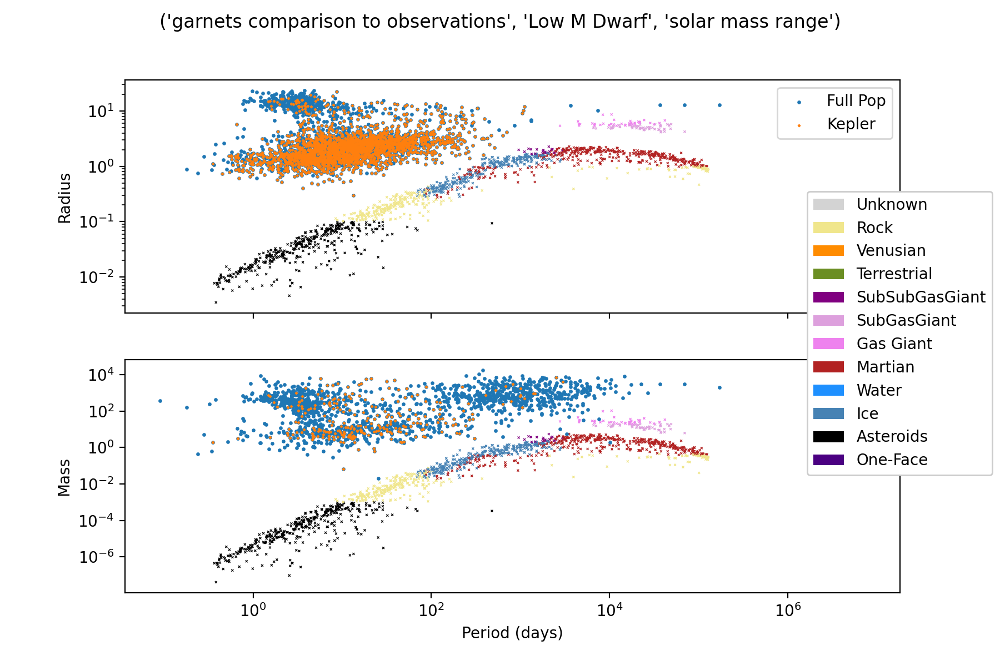

<IPython.core.display.Javascript object>


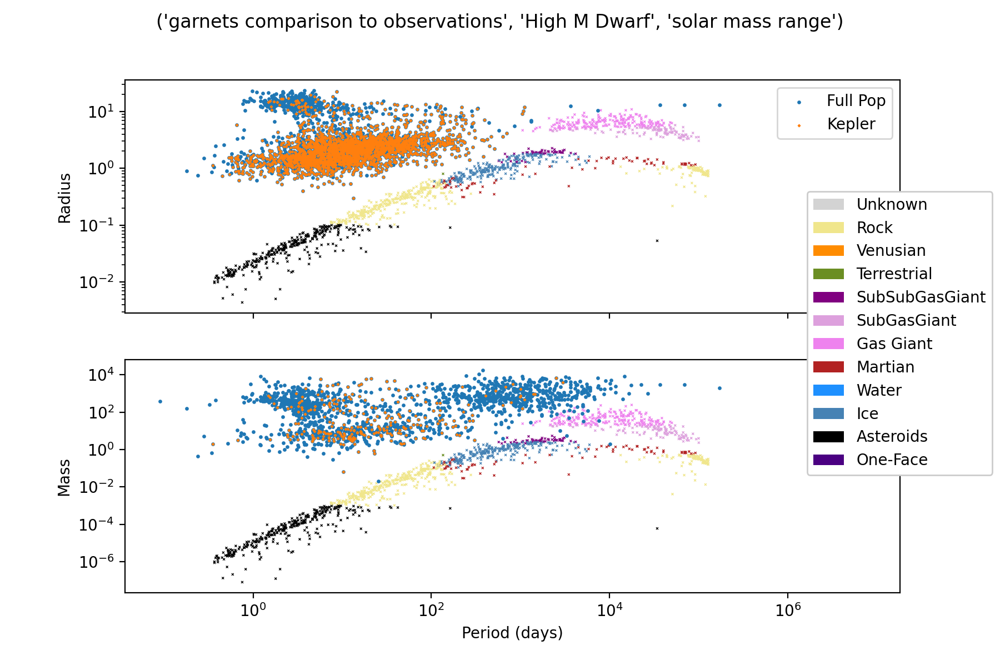

<IPython.core.display.Javascript object>


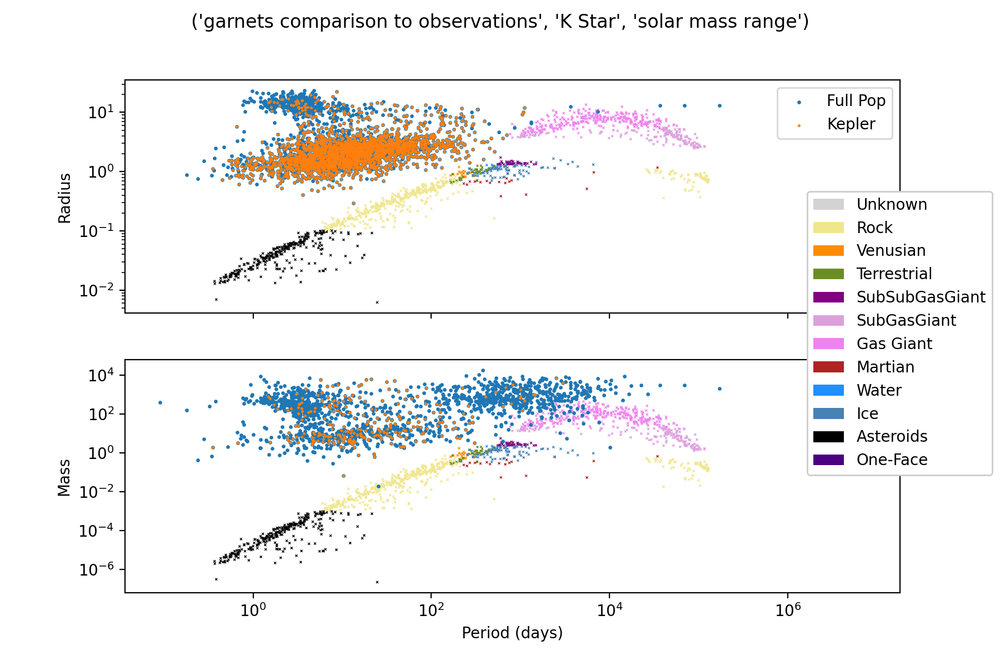

<IPython.core.display.Javascript object>


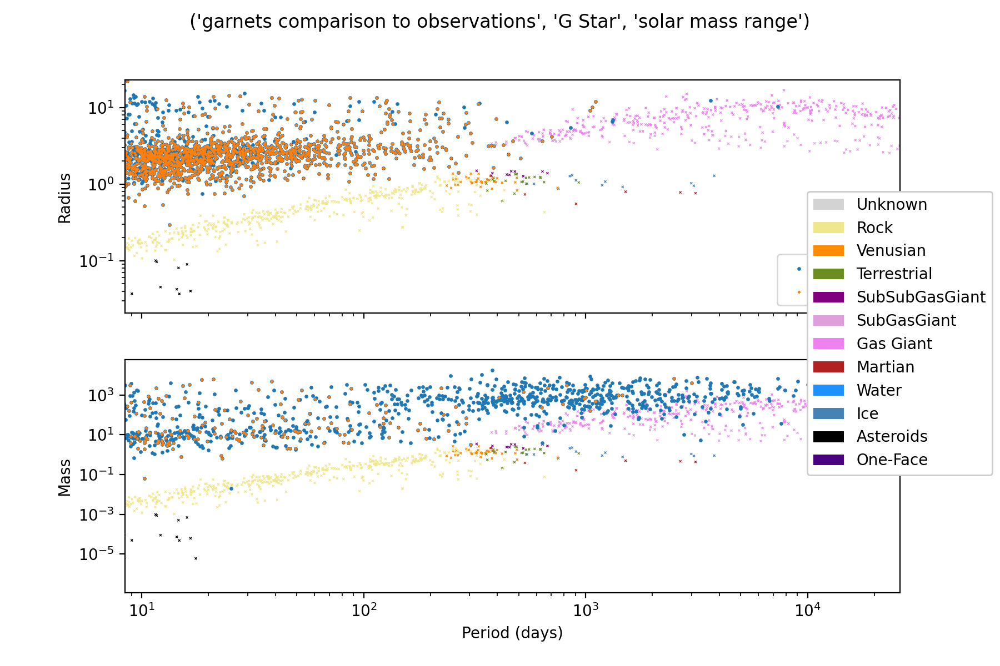

<IPython.core.display.Javascript object>


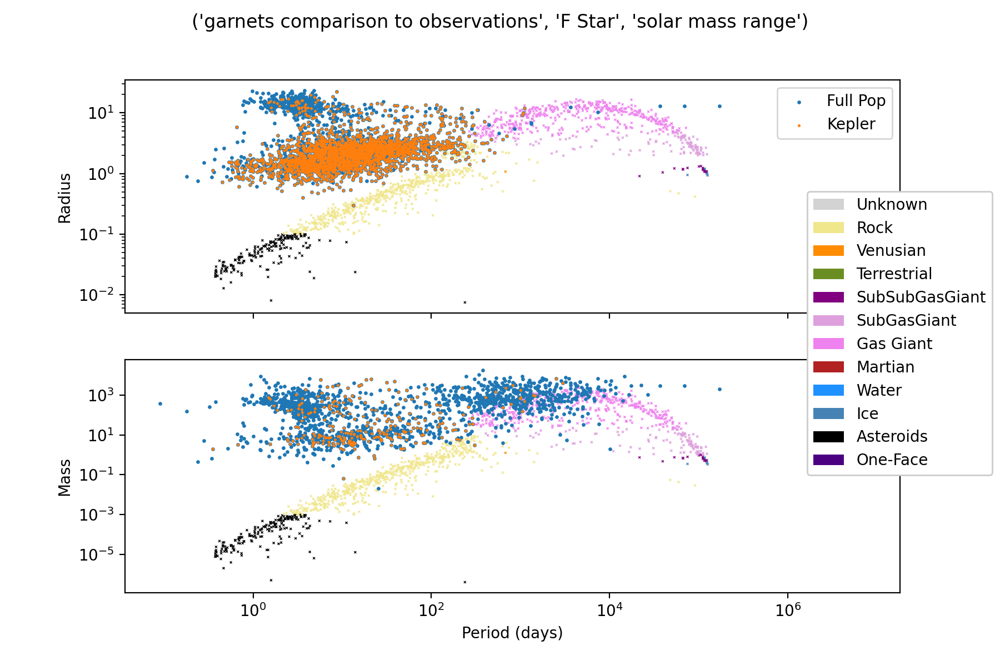

<IPython.core.display.Javascript object>


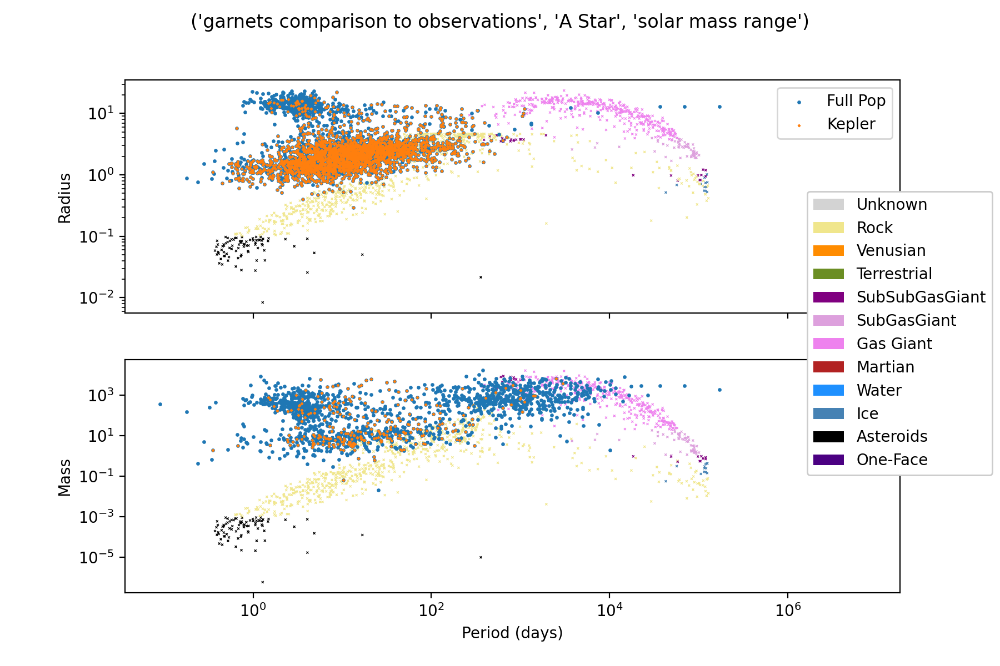

In [17]:
# This latest batch is plotting with the inner limit pushed inward; 
# and with the density coefficient of for the disk density function increased from 0.002 to 0.02.
#.    more rocky planets appear with higher density, but no other real change. 

# TODO: plot only observed exoplanets with same mass bins as garnets planets
# TODO: make parameters that are constants changeable. 

garnets_plotter(run1)
garnets_plotter(run2)
garnets_plotter(run3)
garnets_plotter(run4)
garnets_plotter(run5)
garnets_plotter(run6)

# Below here are some trial runs of code, plots, etc., to develop the code blocks above. Kept for archival purposes.

In [12]:
testrun = garnets_knob('Low M Dwarf')

mr = ([0.25,0.5], [0.5,0.75], [0.75,1.0], [1.0,1.5], [1.5,3.0],[3.0,15])
ar = [0.8, 1.2]

testrun.makesystems(mr[0], ar, 20)

INFO:root:Injecting planetesimal at 33.872715473914596 AU ...
INFO:root:New Protoplanet at 33.872715473914596AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.32582002286022 AU ...
INFO:root:New Protoplanet at 17.32582002286022AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 10.106856629179697 AU ...
INFO:root:New Protoplanet at 10.106856629179697AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.1875483161754135 AU ...
INFO:root:New Protoplanet at 5.1875483161754135AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0347748783882764 AU ...
INFO:root:New Protoplanet at 1.0347748783882764AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5278651131222919 AU ...
INFO:root:New Protoplanet at 0.5278651131222919AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.24670605813427324 AU ...
INFO:root:New Protoplanet at 0.24670605813427324AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12928737749362457 AU ...
INFO:r

3891642.975792915
43.41536991063365
1.5815685578804677
0.2675685908338827
0.061067735886929014
0.014929432878036622
0.0037116845304012184
0.0009266429154683142
0.00023158291412306338
5.789136206424139e-05
Accretion halted at  6.121211822984227e-07
OUTER
16129285.882445386
62.37293461399996
1.8214842465877874
0.2960522418565334
0.06698189107217617
0.016341546013655398
0.0040608378237139775
0.0010137303046647793
0.00025335211302967154
6.333596909795742e-05
Accretion halted at  4.075242284781928e-06
OUTER
Out of order 	Mass: 16.569508283636004 M_moon = attrib() Orbit: 33.872715473914596 AU, Moons: 0
 Planetesimal(orbit=a = 17.32582002286022 e = 0.047162487605252545, dust_mass=4.075242284781928e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74c0150>)
30347704.38005294
73.221804613053
1.935189525106848
0.30892708538315833
0.06962580179625844
0.016971669598061744
0.004216712916403152
0.001052650078540012
0.0002630924426123743
6.577506271161171e-05
Accretion halted at  9.

INFO:root:Injecting planetesimal at 2.688210735723435 AU ...
INFO:root:New Protoplanet at 2.688210735723435AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9806911776773081 AU ...
INFO:root:New Protoplanet at 0.9806911776773081AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.48893708945488645 AU ...
INFO:root:New Protoplanet at 0.48893708945488645AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.24330607676734733 AU ...
INFO:root:New Protoplanet at 0.24330607676734733AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.23078889263470806 AU ...
INFO:root:New Protoplanet at 0.23078889263470806AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17589735430690762 AU ...
INFO:root:New Protoplanet at 0.17589735430690762AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.032929323633703586 AU ...
INFO:root:New Protoplanet at 0.032929323633703586AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.025589943488559093 AU


calculate_surface_temp readout
----------------  -----------
AU                   0.246706
Surface Temp C    -101.519
Effective Temp C  -110.201
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0.703704
clouds_raw           0
Ice Cover            0
Albedo               0.386667
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                   0.246706
Surface Temp C    -104.413
Effective Temp C  -110.201
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0.802469
clouds_raw           0
Ice Cover            0
Albedo               0.431111
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                   0.246706
Surface Temp C    -106.342
Effective Temp C  -110.201
Greenhouse Temp      0
Water Cover          0
water_raw            0
Cloud Cover          0.868313
clouds_raw           0
Ice Cover            0
Albedo   

INFO:root:Injecting planetesimal at 16.231813978790097 AU ...
INFO:root:New Protoplanet at 16.231813978790097AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.3740957812119823 AU ...
INFO:root:New Protoplanet at 3.3740957812119823AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5335669974296933 AU ...
INFO:root:New Protoplanet at 0.5335669974296933AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.33972100283760076 AU ...
INFO:root:New Protoplanet at 0.33972100283760076AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.023237376684241036 AU ...
INFO:root:New Protoplanet at 0.023237376684241036AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.0076697691605125745 AU ...
INFO:root:New Protoplanet at 0.0076697691605125745AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 37.55055247289832 AU ...
INFO:root:New Protoplanet at 37.55055247289832AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.0896333554825393 AU .


calculate_surface_temp readout
----------------  --------------
AU                   0.488937
Surface Temp C    -130.897
Effective Temp C  -137.183
Greenhouse Temp      6.28626
Water Cover          0
water_raw            0.808345
Cloud Cover          0.000239995
clouds_raw           0.000239995
Ice Cover            1
Albedo               0.699957
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                   0.488937
Surface Temp C    -130.899
Effective Temp C  -137.188
Greenhouse Temp      6.28605
Water Cover          0
water_raw            0.808345
Cloud Cover          0.000167686
clouds_raw           2.30678e-05
Ice Cover            1
Albedo               0.69997
----------------  --------------
---------------  ----------
Initial temp     299.127
Solar Ecosphere    0.2209
AU                 0.243306
Albedo             0
---------------  ----------
Gas lifetimes:
---  ------------
H2    0.000167323
H2O   0.187139
N     0.020696

INFO:root:New Protoplanet at 4.095768616791118AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5320112279369188 AU ...
INFO:root:New Protoplanet at 0.5320112279369188AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.1854230931650105 AU ...
INFO:root:New Protoplanet at 0.1854230931650105AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17799714618725965 AU ...
INFO:root:Moon captured at 0.1854230931650105 AU. Planet Mass: 0.012156747353350348 earth masses Moon Mass: 0.0003220101609817663 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.15675247595996508 AU ...
INFO:root:New Protoplanet at 0.15675247595996508AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.11695658142353854 AU ...
INFO:root:New Protoplanet at 0.11695658142353854AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03555888685350832 AU ...
INFO:root:New Protoplanet at 0.03555888685350832AU.
INFO:root:	success.
INFO:root:Injecting planetesimal


78.34811311418898
1.98461268801962
0.31440648490568723
0.07074501956504727
0.017238039542377216
0.004282578374837863
0.0010690930619488823
0.00026720716384660386
6.680535066840863e-05
Accretion halted at  1.351680902851129e-05
OUTER
4428570.016193575
44.87392591777242
1.602505922953749
0.27013048582971405
0.061603310696920814
0.015057438124185531
0.003743319844626977
0.0009345269893008409
0.00023355187784753192
5.838334703240509e-05
Accretion halted at  7.27239706443714e-07
OUTER
Out of order 	Mass: 4.498064775220623 M_earth = attrib() Orbit: 4.095768616791118 AU, Moons: 0
 Planetesimal(orbit=a = 0.5320112279369188 e = 0.12662157766030768, dust_mass=7.27239706443714e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9eea96a10>)
469898.24375495804
25.181901660004893
1.2620401887119816
0.22638012908227467
0.0523405047628769
0.012835872369286478
0.003193638300218695
0.0007974556127363058
0.0001993044238657328
4.9822410425972354e-05
Accretion halted at  3.65313619511042e-08

INFO:root:Injecting planetesimal at 34.75764518914935 AU ...
INFO:root:New Protoplanet at 34.75764518914935AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.23777651539492 AU ...
INFO:root:New Protoplanet at 7.23777651539492AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.2846869112852906 AU ...
INFO:root:New Protoplanet at 6.2846869112852906AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.537064777135614 AU ...
INFO:root:New Protoplanet at 1.537064777135614AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09780016516116335 AU ...
INFO:root:New Protoplanet at 0.09780016516116335AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.049989724746314426 AU ...
INFO:root:New Protoplanet at 0.049989724746314426AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.792256600995383 AU ...
INFO:root:New Protoplanet at 22.792256600995383AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 6.580042990747034 AU ...
INFO:root:

Gas lifetimes:
---  ----------
H2   0.358313
H2O  0.0136254
N    0.0197335
N2   0.00713969
---  ----------
calculate_surface_temp readout
----------------  -----------
AU                  0.0408916
Surface Temp C    259.369
Effective Temp C  259.369
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
calculate_surface_temp readout
----------------  -----------
AU                  0.0408916
Surface Temp C    259.369
Effective Temp C  259.369
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  -----------
5164363.604020508
46.670996813530195
1.627628665889648
0.2731855979889509
0.06224145621433628
0.015210039120611323
0.0037810668314538737
0.0009439432614841857
0.0002359058078772222
5.8972105850682823e-05
Accretion halted at  8.926532

INFO:root:New Protoplanet at 0.20298575821391085AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.01005658386712311 AU ...
INFO:root:New Protoplanet at 0.01005658386712311AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 19.791723421056304 AU ...
INFO:root:New Protoplanet at 19.791723421056304AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 16.40824442612519 AU ...
INFO:root:New Protoplanet at 16.40824442612519AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 13.06813919234514 AU ...
INFO:root:New Protoplanet at 13.06813919234514AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.427713220499502 AU ...
INFO:root:New Protoplanet at 0.427713220499502AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2152273202804253 AU ...
INFO:root:New Protoplanet at 0.2152273202804253AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.17860908713695225 AU ...
INFO:root:New Protoplanet at 0.17860908713695225AU.
INFO:root:	success.

21.328027419091487
1.1737650243094373
0.21423614986636105
0.049725611247954514
0.012206097945256709
0.003037656024356386
0.0007585506257324703
0.00018958377528590953
4.739258429871517e-05
Accretion halted at  1.5626500732233554e-08
OUTER
Out of order 	Mass: 14.096821921421915 M_earth = attrib() Orbit: 22.792256600995383 AU, Moons: 0
 Planetesimal(orbit=a = 0.20298575821391085 e = 0.12363466261138445, dust_mass=1.5626500732233554e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9d0c48850>)
Out of order 	Mass: 42.80016515554903 M_earth = attrib() Orbit: 6.580042990747034 AU, Moons: 0
 Planetesimal(orbit=a = 0.20298575821391085 e = 0.12363466261138445, dust_mass=1.5626500732233554e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9d0c48850>)
Out of order 	Mass: 0.9273190037972913 M_earth = attrib() Orbit: 4.663751434471125 AU, Moons: 0
 Planetesimal(orbit=a = 0.20298575821391085 e = 0.12363466261138445, dust_mass=1.5626500732233554e-08, gas_mass=0.0, disk=

INFO:root:Injecting planetesimal at 1.8026640651157095 AU ...
INFO:root:New Protoplanet at 1.8026640651157095AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.28224473324363847 AU ...
INFO:root:New Protoplanet at 0.28224473324363847AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12849390124821441 AU ...
INFO:root:New Protoplanet at 0.12849390124821441AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.09751370358409533 AU ...
INFO:root:New Protoplanet at 0.09751370358409533AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05041111072200746 AU ...
INFO:root:New Protoplanet at 0.05041111072200746AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.038332947484244095 AU ...
INFO:root:New Protoplanet at 0.038332947484244095AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04338541432403693 AU ...
INFO:root:Did not capture potential moon at 0.05041111072200746 AU. Collision imminent.
INFO:root:Collision between two planete

---------------  ---------
Initial temp     38.905
Solar Ecosphere   0.200704
AU               13.0681
Albedo            0
---------------  ---------
Gas lifetimes:
---  ---
H2   inf
H2O  inf
N    inf
N2   inf
---  ---
calculate_surface_temp readout
----------------  --------------
AU                  13.0681
Surface Temp C    -240.061
Effective Temp C  -240.64
Greenhouse Temp      0.578989
Water Cover          0
water_raw            0.00166732
Cloud Cover          2.09467e-11
clouds_raw           2.09467e-11
Ice Cover            0.00250098
Albedo               0.151376
----------------  --------------
calculate_surface_temp readout
----------------  --------------
AU                  13.0681
Surface Temp C    -240.061
Effective Temp C  -240.64
Greenhouse Temp      0.578989
Water Cover          0
water_raw            0.00166732
Cloud Cover          2.17472e-11
clouds_raw           2.33482e-11
Ice Cover            0.00250098
Albedo               0.151376
----------------  --------------

INFO:root:Conglomerate is now 1.1211454045729659e-05 earth masses at 0.05008962156903455 AU.
INFO:root:Did not capture potential moon at 0.038332947484244095 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 1.1211454045729659e-05 earth masses at 0.03968817252031337 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.023353613864114064 AU ...
INFO:root:New Protoplanet at 0.023353613864114064AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.76859460734666 AU ...
INFO:root:New Protoplanet at 23.76859460734666AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.700567957652226 AU ...
INFO:root:New Protoplanet at 4.700567957652226AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.146547728784315 AU ...
INFO:root:New Protoplanet at 2.146547728784315AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.12870215756199985 AU ...
INFO:root:N

Accretion halted at  0
Out of order 	Mass: 0.002198252266142215 M_moon = attrib() Orbit: 0.038332947484244095 AU, Moons: 0
 Planetesimal(orbit=a = 0.04338541432403693 e = 0.25233011194575183, dust_mass=3.3690729422771626e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9eea96a10>)
-1.0
Accretion halted at  0
OUTER
2626.932622955904
6.159843944595361
0.6357837484597479
0.13091892657697377
0.031235530882927236
0.007719046390234165
0.0019242006479800082
0.00048070343733365954
0.00012015420208148058
3.003719715085335e-05
Accretion halted at  3.6264465997493086e-11
OUTER
Out of order 	Mass: 1.6246618652193436 M_earth = attrib() Orbit: 1.8026640651157095 AU, Moons: 0
 Planetesimal(orbit=a = 0.023353613864114064 e = 0.059527407982151614, dust_mass=3.6264465997493086e-11, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9eea96a10>)
Out of order 	Mass: 2.2132629512073376 M_moon = attrib() Orbit: 0.28224473324363847 AU, Moons: 0
 Planetesimal(orbit=a = 0.023353613864

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.047985720360175725 AU ...
INFO:root:New Protoplanet at 0.047985720360175725AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.05345091533483504 AU ...
INFO:root:	failed due to large neighbor.
INFO:root:Injecting planetesimal at 0.015661685003441988 AU ...
INFO:root:New Protoplanet at 0.015661685003441988AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.015276064416730364 AU ...
INFO:root:Did not capture potential moon at 0.015661685003441988 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new orbit and accumulating additional mass.
INFO:root:Conglomerate is now 6.02105589487121e-07 earth masses at 0.01561445305455249 AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.278824028820814 AU ...
INFO:root:New Protoplanet at 11.278824028820814AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.39597317876484556 AU ...
INFO:root:New Protoplanet at 0.3959731787

23769.512114446385
11.416798533704831
0.8771648313224323
0.1705112785033893
0.04014503613118458
0.009888612797868816
0.0024630384366599195
0.0006151916915866123
0.00015376245654876222
3.8438398221374076e-05
Accretion halted at  6.834590336624669e-10
OUTER
Out of order 	Mass: 1.5706181385515101 M_earth = attrib() Orbit: 23.76859460734666 AU, Moons: 0
 Planetesimal(orbit=a = 0.047985720360175725 e = 0.044892841781850046, dust_mass=6.834590336624669e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e73feed0>)
Out of order 	Mass: 6.043737141346076 M_earth = attrib() Orbit: 4.700567957652226 AU, Moons: 0
 Planetesimal(orbit=a = 0.047985720360175725 e = 0.044892841781850046, dust_mass=6.834590336624669e-10, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e73feed0>)
Out of order 	Mass: 1.4565973730762154 M_earth = attrib() Orbit: 2.146547728784315 AU, Moons: 0
 Planetesimal(orbit=a = 0.047985720360175725 e = 0.044892841781850046, dust_mass=6.834590336624669e-10,

INFO:root:Injecting planetesimal at 8.20085342539251 AU ...
INFO:root:New Protoplanet at 8.20085342539251AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.6647346162495988 AU ...
INFO:root:New Protoplanet at 1.6647346162495988AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.2451624347753056 AU ...
INFO:root:New Protoplanet at 1.2451624347753056AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.8606523605577832 AU ...
INFO:root:New Protoplanet at 0.8606523605577832AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3073543507150427 AU ...
INFO:root:New Protoplanet at 0.3073543507150427AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.285694985004533 AU ...
INFO:root:New Protoplanet at 0.285694985004533AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2747897297588641 AU ...
INFO:root:Did not capture potential moon at 0.285694985004533 AU. Collision imminent.
INFO:root:Collision between two planetesimals! Computing new


Gas lifetimes:
---  -----------
H2   0.000540871
H2O  0.000232769
N    0.000183799
N2   0.000555703
---  -----------
calculate_surface_temp readout
----------------  ----------
AU                  0.262935
Surface Temp C    -60.3514
Effective Temp C  -60.3514
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.262935
Surface Temp C    -60.3514
Effective Temp C  -60.3514
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  -----------
Initial temp     408.139
Solar Ecosphere    0.165277
AU                 0.0977838
Albedo             0
---------------  -----------
Gas lifetimes:
---  -----------
H2   0.00370205
H2O  0.00024540

INFO:root:Injecting planetesimal at 8.87276249205733 AU ...
INFO:root:New Protoplanet at 8.87276249205733AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 4.659896939951524 AU ...
INFO:root:New Protoplanet at 4.659896939951524AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.54064134075463 AU ...
INFO:root:New Protoplanet at 3.54064134075463AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.9486200503678788 AU ...
INFO:root:New Protoplanet at 2.9486200503678788AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.6249578250548975 AU ...
INFO:root:New Protoplanet at 2.6249578250548975AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.5504518480171765 AU ...
INFO:root:New Protoplanet at 1.5504518480171765AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6207696819337402 AU ...
INFO:root:New Protoplanet at 0.6207696819337402AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5075767589032852 AU ...
INFO:root:New Pro


calculate_surface_temp readout
----------------  ----------
AU                  0.278513
Surface Temp C    -77.4145
Effective Temp C  -77.4145
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
calculate_surface_temp readout
----------------  ----------
AU                  0.278513
Surface Temp C    -77.4145
Effective Temp C  -77.4145
Greenhouse Temp     0
Water Cover         0
water_raw           0
Cloud Cover         0
clouds_raw          0
Ice Cover           0
Albedo              0.07
----------------  ----------
---------------  ----------
Initial temp     262.329
Solar Ecosphere    0.148119
AU                 0.212122
Albedo             0
---------------  ----------
Gas lifetimes:
---  -----------
H2   0.000211744
H2O  0.0043969
N    0.00131731
N2   0.118374
---  -----------
calculate_surface_temp readout
----------------  ----------
AU          

INFO:root:New Protoplanet at 0.0672536456737463AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 7.563912151593748 AU ...
INFO:root:New Protoplanet at 7.563912151593748AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.03561934089110476 AU ...
INFO:root:New Protoplanet at 0.03561934089110476AU.
INFO:root:	success.


	Mass: 3.4424579627429517 M_earth = attrib() Orbit: 4.659896939951524 AU, Moons: 0
 Planetesimal(orbit=a = 0.0672536456737463 e = 0.11836504777217416, dust_mass=1.2181018643519074e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7504f50>)
Out of order 	Mass: 0.7992408799734692 M_earth = attrib() Orbit: 3.54064134075463 AU, Moons: 0
 Planetesimal(orbit=a = 0.0672536456737463 e = 0.11836504777217416, dust_mass=1.2181018643519074e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7504f50>)
Out of order 	Mass: 48.13209619312625 M_moon = attrib() Orbit: 2.9486200503678788 AU, Moons: 0
 Planetesimal(orbit=a = 0.0672536456737463 e = 0.11836504777217416, dust_mass=1.2181018643519074e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7504f50>)
Out of order 	Mass: 30.40038400030971 M_moon = attrib() Orbit: 2.6249578250548975 AU, Moons: 0
 Planetesimal(orbit=a = 0.0672536456737463 e = 0.11836504777217416, dust_mass=1.2181018643519074e-09, gas_m

INFO:root:Injecting planetesimal at 18.558026405041954 AU ...
INFO:root:New Protoplanet at 18.558026405041954AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 11.851832952319576 AU ...
INFO:root:New Protoplanet at 11.851832952319576AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 8.175720347499798 AU ...
INFO:root:New Protoplanet at 8.175720347499798AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 2.968628586329562 AU ...
INFO:root:New Protoplanet at 2.968628586329562AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3159952658949138 AU ...
INFO:root:New Protoplanet at 0.3159952658949138AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08231183362658918 AU ...
INFO:root:New Protoplanet at 0.08231183362658918AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.9166983597477761 AU ...
INFO:root:New Protoplanet at 0.9166983597477761AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.6843702693117116 AU ...
INFO:root


12916575.667960923
58.94968184518539
1.7825838443199422
0.2915607962664388
0.06605591199653335
0.016120860203051913
0.004006301123993446
0.0010001303074903063
0.00024995294479922405
6.248590354583617e-05
Accretion halted at  3.030602804288285e-06
OUTER
25779397.820058856
70.25546994235917
1.9053965705189937
0.3055786248794095
0.06893559436975705
0.01680603394199948
0.004175424712882939
0.0010422606016565789
0.0002604721140581162
6.511385578110822e-05
Accretion halted at  7.615395863421296e-06
OUTER
Out of order 	Mass: 1.0085107877828288 M_earth = attrib() Orbit: 18.558026405041954 AU, Moons: 0
 Planetesimal(orbit=a = 11.851832952319576 e = 0.06533892492359916, dust_mass=7.615395863421296e-06, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7504950>)
20246303.813825283
66.07898167544208
1.861856275197306
0.3006613365785744
0.06792833433237334
0.01656659965552191
0.004116351979540139
0.0010275501299241768
0.0002568003427076587
6.419684001482923e-05
Accretion halted at  5.

INFO:root:Injecting planetesimal at 0.5507154852225636 AU ...
INFO:root:New Protoplanet at 0.5507154852225636AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.5308746426430648 AU ...
INFO:root:Moon captured at 0.5507154852225636 AU. Planet Mass: 0.01983709988211977 earth masses Moon Mass: 0.017555459270440117 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.44731433194384695 AU ...
INFO:root:New Protoplanet at 0.44731433194384695AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.2880822752641047 AU ...
INFO:root:New Protoplanet at 0.2880822752641047AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04590998790404882 AU ...
INFO:root:New Protoplanet at 0.04590998790404882AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.010457754225634578 AU ...
INFO:root:New Protoplanet at 0.010457754225634578AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 23.368949827644588 AU ...
INFO:root:New Protoplanet at 23.368949827

678421.6874321623
27.69955037573612
1.3145620735613979
0.23343789982582233
0.053851348045021015
0.013199223519574022
0.0032836030629272623
0.0008198932970204968
0.00020491068794220184
5.1223824741590174e-05
Accretion halted at  5.961103367457957e-08
OUTER
Out of order 	Mass: 0.6443492653171953 M_earth = attrib() Orbit: 0.9166983597477761 AU, Moons: 0
 Planetesimal(orbit=a = 0.5507154852225636 e = 0.022643997033813257, dust_mass=5.961103367457957e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7504950>)
Out of order 	Mass: 6.6957933021541285 M_moon = attrib() Orbit: 0.6843702693117116 AU, Moons: 0
 Planetesimal(orbit=a = 0.5507154852225636 e = 0.022643997033813257, dust_mass=5.961103367457957e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e7504950>)
619013.5877615334
27.049506362173865
1.3013429901024867
0.23167293401114408
0.05347412762764559
0.013108538411085311
0.0032611514615344286
0.0008142937703488667
0.00020351157274222425
5.087407679601428

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.37768938587074674 AU ...
INFO:root:Moon captured at 0.40505245235773224 AU. Planet Mass: 0.08150520456490291 earth masses Moon Mass: 0.01384429726791572 earth masses.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3333474532073688 AU ...
INFO:root:New Protoplanet at 0.3333474532073688AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.22134957591654597 AU ...
INFO:root:New Protoplanet at 0.22134957591654597AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.04314721504916377 AU ...
INFO:root:New Protoplanet at 0.04314721504916377AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.006878562353321776 AU ...
INFO:root:New Protoplanet at 0.006878562353321776AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 22.024302389675686 AU ...
INFO:root:New Protoplanet at 22.024302389675686AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 32.87380220781938 AU ...
INFO:root:Moon captur

518017.08245635335
25.82787232628932
1.275865438383924
0.22824972480616837
0.052741348950747106
0.012932308963682207
0.0032175173890969327
0.0008034111513450411
0.0002007924350268589
5.019436233804242e-05
Accretion halted at  4.160249610793542e-08
Out of order 	Mass: 0.793172257213075 M_earth = attrib() Orbit: 23.368949827644588 AU, Moons: 0
 Planetesimal(orbit=a = 0.37768938587074674 e = 0.16600684682483324, dust_mass=4.160249610793542e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74f1450>)
Out of order 	Mass: 4.45742576554185 M_earth = attrib() Orbit: 7.898387603056312 AU, Moons: 0
 Planetesimal(orbit=a = 0.37768938587074674 e = 0.16600684682483324, dust_mass=4.160249610793542e-08, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74f1450>)
Out of order 	Mass: 2.873602737640131 M_earth = attrib() Orbit: 1.7489923599695374 AU, Moons: 1
 Planetesimal(orbit=a = 0.37768938587074674 e = 0.16600684682483324, dust_mass=4.160249610793542e-08, gas_mass=0.0, 

INFO:root:New Protoplanet at 0.10787090742772285AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.08570487275997218 AU ...
INFO:root:New Protoplanet at 0.08570487275997218AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.007750675545340598 AU ...
INFO:root:New Protoplanet at 0.007750675545340598AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 17.405207576056725 AU ...
INFO:root:New Protoplanet at 17.405207576056725AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 5.855822589863689 AU ...
INFO:root:New Protoplanet at 5.855822589863689AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 3.7171793664953583 AU ...
INFO:root:New Protoplanet at 3.7171793664953583AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.9539067991715855 AU ...
INFO:root:New Protoplanet at 1.9539067991715855AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 1.6587513119396051 AU ...
INFO:root:Moon captured at 1.9539067991715855 AU. Planet Mass: 2


14.679594532597829
0.9899112549617983
0.18770457298016316
0.04394377207378654
0.010809411903133092
0.0026914675648290376
0.0006721888545255873
0.0001680048763986974
4.199857469682328e-05
Accretion halted at  2.371990834656996e-09
OUTER
Out of order 	Mass: 1.0777714502388391 M_earth = attrib() Orbit: 22.024302389675686 AU, Moons: 1
 Planetesimal(orbit=a = 0.10787090742772285 e = 0.03906046409494657, dust_mass=2.371990834656996e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74f8310>)
Out of order 	Mass: 3.5005155451387227 M_earth = attrib() Orbit: 7.336953345602941 AU, Moons: 0
 Planetesimal(orbit=a = 0.10787090742772285 e = 0.03906046409494657, dust_mass=2.371990834656996e-09, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74f8310>)
Out of order 	Mass: 3.3280201222378762 M_earth = attrib() Orbit: 3.783240624335194 AU, Moons: 0
 Planetesimal(orbit=a = 0.10787090742772285 e = 0.03906046409494657, dust_mass=2.371990834656996e-09, gas_mass=0.0, disk=<ac

INFO:root:	success.
INFO:root:Injecting planetesimal at 0.36480901774174984 AU ...
INFO:root:New Protoplanet at 0.36480901774174984AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.3089495069797773 AU ...
INFO:root:New Protoplanet at 0.3089495069797773AU.
INFO:root:	success.
INFO:root:Injecting planetesimal at 0.10781226682252101 AU ...
INFO:root:New Protoplanet at 0.10781226682252101AU.
INFO:root:	success.


2213575.4145750217
37.57213094878625
1.4921174872929068
0.25644154536200414
0.058731027076222644
0.01437007809586523
0.003573332737316473
0.0008921415791776496
0.00022296156058668358
5.573591638036573e-05
Accretion halted at  2.8848181390614855e-07
OUTER
Out of order 	Mass: 13.62341823816521 M_earth = attrib() Orbit: 17.405207576056725 AU, Moons: 0
 Planetesimal(orbit=a = 0.36480901774174984 e = 0.12606435288043893, dust_mass=2.8848181390614855e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74f8310>)
Out of order 	Mass: 5.379906680470422 M_earth = attrib() Orbit: 5.855822589863689 AU, Moons: 0
 Planetesimal(orbit=a = 0.36480901774174984 e = 0.12606435288043893, dust_mass=2.8848181390614855e-07, gas_mass=0.0, disk=<accrete.CircumstellarDisk object at 0x7fb9e74f8310>)
Out of order 	Mass: 1.5414260659663324 M_earth = attrib() Orbit: 3.7171793664953583 AU, Moons: 0
 Planetesimal(orbit=a = 0.36480901774174984 e = 0.12606435288043893, dust_mass=2.8848181390614855e-07, ga

<IPython.core.display.Javascript object>


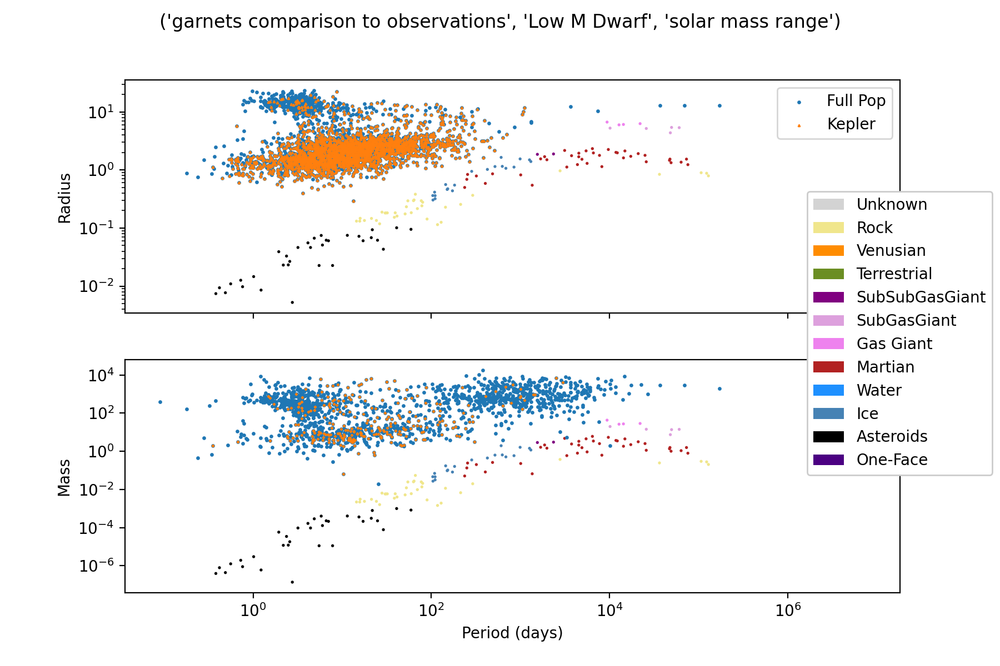

In [13]:
garnets_plotter(testrun)

<IPython.core.display.Javascript object>


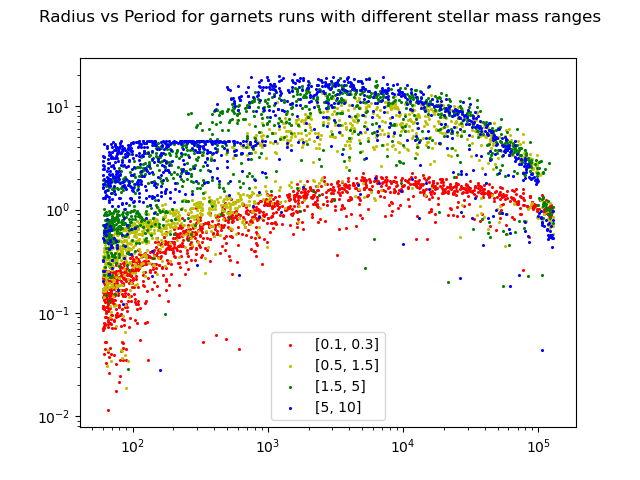

Text(0.5, 0.98, 'Radius vs Period for garnets runs with different stellar mass ranges')

In [96]:
fig, ax = plt.subplots()
runs = [run1, run2, run3, run4]
cols = ['r', 'y', 'g', 'b']
labs = ([0.1,0.3], [0.5,1.5], [1.5,5], [5,10])
for i in np.arange(len(runs)):
    ax.scatter(runs[i].per, runs[i].rad, c=cols[i], s = 1.5, label=labs[i])
ax.set_yscale('log')
ax.set_xscale('log')
ax.legend()
fig.suptitle('Radius vs Period for garnets runs with different stellar mass ranges')

<IPython.core.display.Javascript object>


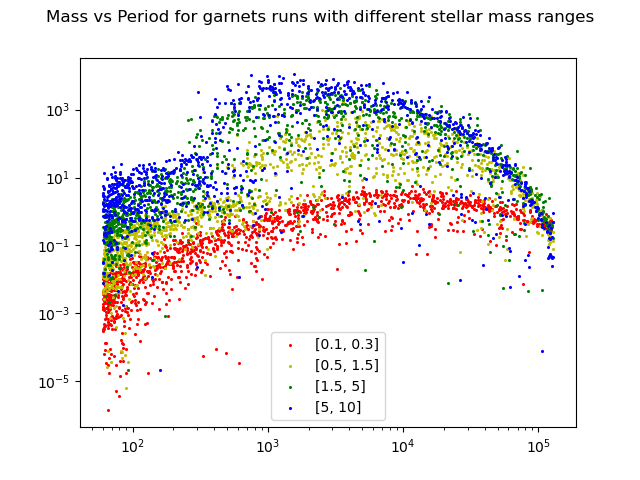

Text(0.5, 0.98, 'Mass vs Period for garnets runs with different stellar mass ranges')

In [97]:
fig, ax = plt.subplots()
runs = [run1, run2, run3, run4]
cols = ['r', 'y', 'g', 'b']
labs = ([0.1,0.3], [0.5,1.5], [1.5,5], [5,10])
for i in np.arange(len(runs)):
    ax.scatter(runs[i].per, runs[i].mass, c=cols[i], s = 1.5, label=labs[i])
ax.set_yscale('log')
ax.set_xscale('log')
ax.legend()
fig.suptitle('Mass vs Period for garnets runs with different stellar mass ranges')

In [136]:
starmassbins = [0.0,0.5,0.75,1.0,1.5,3.0,15.0,16.0]
counts, bins = np.histogram(star_mass, starmassbins)
kcounts, kbins = np.histogram(kstar_mass, starmassbins)
#labs = ('0 - 0.5', '0.5 - 0.75', '0.75 - 1.0', '1.0 - 1.5', '1.5 - 3.0', '3.0 - 15.0', '15.0 - 25.0')
labs = ('0', '0.5 \nM', '0.75 \nK', '1.0 \nG', '1.5 \nF', '3.0\nA', '15.0+')

<IPython.core.display.Javascript object>


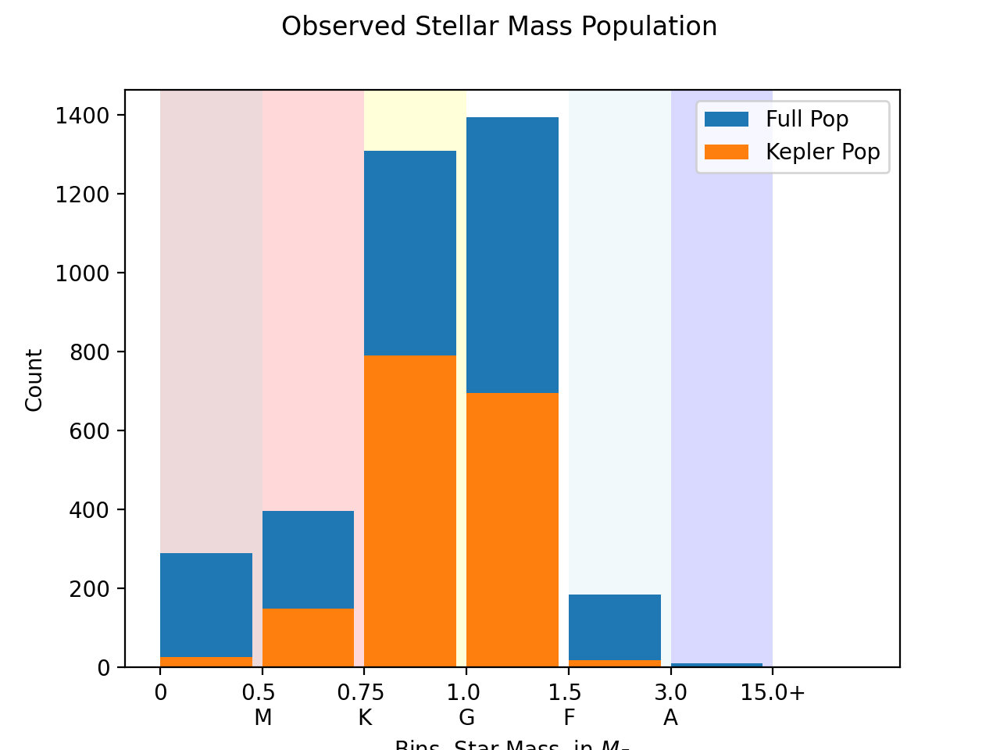

Text(0.5, 0.98, 'Observed Stellar Mass Population')

In [144]:
fig, ax = plt.subplots()

speccols = ['darkred', 'red', 'yellow', 'white', 'lightblue', 'blue']
for i in np.arange(len(counts)-1):
    ax.axvspan(i, i+1,facecolor=speccols[i], alpha=0.15)
    
    
ax.bar(np.arange(len(counts)), counts, tick_label=labs, align='edge', label='Full Pop', width=0.9)
ax.bar(np.arange(len(kcounts)), kcounts, tick_label=labs, align='edge', label='Kepler Pop', width=0.9)
ax.legend()
ax.set_ylabel('Count')
ax.set_xlabel('Bins, Star Mass, in $M_E$ ')

#ax.set_xticks([-1, 0, 1, 2, 3, 4 ,5])
ax.set_xticklabels(labs)

fig.suptitle("Observed Stellar Mass Population")

